## Camsense X1 chinese lidar

### search for open serial ports

In [6]:
import serial.tools.list_ports as port_list
ports = list(port_list.comports())
for p in ports:
    print (p)

COM6 - Standardmäßgige Seriell-über-Bluetooth-Verbindung (COM6)
COM3 - Standardmäßgige Seriell-über-Bluetooth-Verbindung (COM3)
COM9 - Standardmäßgige Seriell-über-Bluetooth-Verbindung (COM9)
COM7 - Standardmäßgige Seriell-über-Bluetooth-Verbindung (COM7)
COM12 - USB Serial Port (COM12)


### camsenseX1.py
https://github.com/Vidicon/camsense-X1 <br>

In [ ]:
import matplotlib.pyplot as plt
import math
import serial
import sys
import struct
import time
import threading

class Capture:
    def __init__(self, serialPort, dataSize = 460, isInvert = True):
        self.theta = [0] * dataSize
        self.distance = [0] * dataSize
        self.intensity = [0] * dataSize
        self.writePos = 0
        self.serial = serial.Serial(port = serialPort, baudrate = 115200)
        self.dataSize = dataSize
        self.thread = threading.Thread(target = self.getData)
        self.lock = threading.Lock()
        self.isInvert = isInvert
        self.dataObtained = False
        self.rpm = 0

    def getDataUnit(self):
        #First, read down to the header
        header = b"\x55\xAA\x03\x08"
        headerPos = 0
        while True:
            tmp = self.serial.read(1)
            if tmp[0] == header[headerPos]:
                headerPos += 1
                if headerPos == len(header):
                    break
            else:
                headerPos = 0

        tmp = self.serial.read(4)
        # "<" :Little endian, "H" :2-byte unsigned data, "B" :1-byte unsigned data
        (rotationSpeedTmp, startAngleTmp) = struct.unpack_from("<2H", tmp)
        self.rpm = rotationSpeedTmp / 64
        startAngle = (startAngleTmp - 0xa000) / 64
        #Prepare an array to store distance and intensity data
        distanceTmp = [0] * 8
        intensityTmp = [0] * 8
        for i in range(8):
            tmp = self.serial.read(3)
            (distanceTmp[i], intensityTmp[i]) = struct.unpack_from("<HB", tmp)
        tmp = self.serial.read(4)
        (endAngleTmp, crc) = struct.unpack_from("<2H", tmp)
        endAngle = (endAngleTmp - 0xa000) / 64

        return (distanceTmp, intensityTmp, startAngle, endAngle)

    def getData(self):
        preStartAngle = 0
        while True:
            (distanceTmp, intensityTmp, startAngle, endAngle) = self.getDataUnit()

            #If it is near 0 degrees, the magnitude relationship between the start angle and the end angle may be reversed, so add 360 degrees to the end angle to maintain the magnitude relationship.
            if endAngle < startAngle:
                endAngle += 360

            #When the start angle becomes small, it is a place of 0 degrees, so set the data update flag
            if (startAngle - preStartAngle < 0):
                self.dataObtained = True
            preStartAngle = startAngle

            #Convert angles to radians
            startAngleRad = startAngle * math.pi / 180 * (-1 if self.isInvert else 1)
            endAngleRad = endAngle * math.pi / 180 * (-1 if self.isInvert else 1)
            #Calculate the angle per step
            angleIncrement = (endAngleRad - startAngleRad) / len(distanceTmp)
            #Exclusive control start
            self.lock.acquire()
            for i in range(len(distanceTmp)):
                self.theta[self.writePos] = startAngleRad + angleIncrement * i
                self.distance[self.writePos] = distanceTmp[i]
                self.intensity[self.writePos] = intensityTmp[i]
                self.writePos += 1
                if self.writePos >= self.dataSize:
                    self.writePos = 0
            #Exclusive control end
            self.lock.release()

    def run(self):
        self.thread.start()

    def stop(self):
        self.thread.stop()

if __name__ == "__main__":
    if len(sys.argv) == 1:
        print("You must specify serial port! ex) " + sys.argv[0] + " COM2")
        quit()

    #Generate polar graph
    dist = plt.subplot(111, polar = True)
    #Set the initial value of the maximum distance to be displayed to 2000
    rmax = 2000

    capture = Capture("sys.argv[1]", dataSize = 480, isInvert = True)
    capture.run()
    preTime = time.time()

    while True:
        if capture.dataObtained:
            #Initialize drawing
            plt.cla()

            #Exclusive control start
            capture.lock.acquire()
            #Plot distance data(Draw as a scatter plot)
            dist.scatter(list(capture.theta), list(capture.distance), c = "blue", s = 5)
            #Plot intensity data(Draw by connecting with lines)
            dist.plot(list(capture.theta), list(capture.intensity), c = "orange", linewidth = 1)
            #Since the data has been drawn, lower the data acquisition flag.
            capture.dataObtained = False
            #Exclusive control start
            capture.lock.release()

            #Set the top of the screen to 0 degrees
            dist.set_theta_offset(math.pi / 2)
            #Set the maximum value of the distance value to be displayed
            dist.set_rmax(rmax)
            #Drawing process
            plt.pause(0.01)
            #Get the currently set maximum display distance value
            rmax = dist.get_rmax()

        else:
            time.sleep(0.01)

### data format
https://memotut.com/try-using-cheap-lidar-(camsense-x1)-819ac/ <br>

### raw output

In [21]:
import serial
import time

#open serial port
s = serial.Serial(port='COM12', baudrate=115200, bytesize=serial.EIGHTBITS, timeout=2)
while True:
    in_bin = s.read(2)
    in_int = int.from_bytes(in_bin,byteorder='little')
    in_hex = hex(in_int)
    print( in_bin, in_int, in_hex )
    #print( s.readline() )


b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\xf8\xcb' 52216 0xcbf8
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x0f\x02' 527 0x20f
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'!\x02' 545 0x221
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x02\x03' 770 0x302
b'\x89\xcd' 52617 0xcd89
b'+(' 10283 0x282b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\xc2\xcd' 52674 0xcdc2
b'\x00\x80' 32768 0x8000
b'\x00o' 28416 0x6f00
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x89' 35072 0x8900
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xa6' 42496 0xa600
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'S\xcf' 53075 0xcf53
b'1K' 19249 0x4b31
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\x8c\xcf' 53132 0xcf8c
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\x03\x

b'\t\x03' 777 0x309
b'^\t' 2398 0x95e
b'\x02\x8a' 35330 0x8a02
b'\t\x02' 521 0x209
b'\x8e\t' 2446 0x98e
b'\x04\x8a' 35332 0x8a04
b'\t\x02' 521 0x209
b'|\xa0' 41084 0xa07c
b')A' 16681 0x4129
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\xb5\xa0' 41141 0xa0b5
b'\xc5\t' 2501 0x9c5
b'\x04J' 18948 0x4a04
b'\t\x03' 777 0x309
b'A\t' 2369 0x941
b'\x02\xc5' 50434 0xc502
b'\t\x03' 777 0x309
b'\xa6\t' 2470 0x9a6
b'\x03\xa5' 42243 0xa503
b'\t\x02' 521 0x209
b'\xe9\t' 2537 0x9e9
b'\x01\xf5' 62721 0xf501
b'\t\x02' 521 0x209
b'F\xa2' 41542 0xa246
b'^$' 9310 0x245e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\x7f\xa2' 41599 0xa27f
b'c\n' 2659 0xa63
b'\x02>' 15874 0x3e02
b'\n\x04' 1034 0x40a
b'\xc9\n' 2761 0xac9
b'\x04\xc1' 49412 0xc104
b'\n\x02' 522 0x20a
b'\x99\n' 2713 0xa99
b'\x03\xb2' 45571 0xb203
b'\n\x02' 522 0x20a
b'\xf6\n' 2806 0xaf6
b'\x03\xec' 60419 0xec03
b'\n\x01' 266 0x10a
b'\x0f\xa4' 41999 0xa40f
b'\xb8\x0b' 3000 0xbb8
b'U\xaa' 43605 0xaa55
b'\x0

b'\x05\xb5' 46341 0xb505
b'\x08\x05' 1288 0x508
b'\xd8\x08' 2264 0x8d8
b'\x04\n' 2564 0xa04
b'\t\x02' 521 0x209
b'y\x06' 1657 0x679
b'\x02t' 29698 0x7402
b'\x06\x03' 774 0x306
b'p\x06' 1648 0x670
b'\x03q' 28931 0x7103
b'\x06\x04' 1030 0x406
b'(\xea' 59944 0xea28
b'\xees' 29678 0x73ee
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'b\xea' 60002 0xea62
b'n\x06' 1646 0x66e
b'\x03`' 24579 0x6003
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'c\x06' 1635 0x663
b'\x03c' 25347 0x6303
b'\x06\x02' 518 0x206
b'e\x06' 1637 0x665
b'\x03c' 25347 0x6303
b'\x06\x03' 774 0x306
b'\xf5\xeb' 60405 0xebf5
b'\x04"' 8708 0x2204
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'/\xec' 60463 0xec2f
b'a\x06' 1633 0x661
b'\x02b' 25090 0x6202
b'\x06\x01' 262 0x106
b'b\x06' 1634 0x662
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'6\t' 2358 0x936
b'\x00\xb2' 45568 0xb200
b'\x07\x05' 1287 0x507
b'\xb6\x07' 1974 0x7b6
b'\x06\xb8' 47110 0xb806
b'\x

b'0N' 20016 0x4e30
b'g\xd8' 55399 0xd867
b';\x04' 1083 0x43b
b'\x071' 12551 0x3107
b'\x04\x07' 1796 0x704
b"'\x04" 1063 0x427
b'\x06\x1d' 7430 0x1d06
b'\x04\x07' 1796 0x704
b'\x14\x04' 1044 0x414
b'\x07\t' 2311 0x907
b'\x04\x05' 1284 0x504
b'\xfa\x03' 1018 0x3fa
b'\x06\xfc' 64518 0xfc06
b'\x03\x07' 1795 0x703
b'\xf9\xd9' 55801 0xd9f9
b'\x16Z' 23062 0x5a16
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'2\xda' 55858 0xda32
b'\xfc\x03' 1020 0x3fc
b'\t\xfd' 64777 0xfd09
b'\x03\x08' 2051 0x803
b'\xfe\x03' 1022 0x3fe
b'\t\xff' 65289 0xff09
b'\x03\t' 2307 0x903
b'\x02\x04' 1026 0x402
b'\t\x04' 1033 0x409
b'\x04\x08' 2052 0x804
b'\x08\x04' 1032 0x408
b'\x07\x0c' 3079 0xc07
b'\x04\x07' 1796 0x704
b'\xc4\xdb' 56260 0xdbc4
b'\x87c' 25479 0x6387
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'1N' 20017 0x4e31
b'\x07\xdc' 56327 0xdc07
b'\x10\x04' 1040 0x410
b'\x07!' 8455 0x2107
b'\x04\x06' 1540 0x604
b'2\x04' 1074 0x432
b'\t7' 14089 0x3709
b'\x04\t' 2308 0x904
b'<\x04' 1084 0x43c


b'\x03\x08' 2051 0x803
b'7N' 20023 0x4e37
b'\x14\xa6' 42516 0xa614
b'\xb1\x0b' 2993 0xbb1
b'\x02\xc8' 51202 0xc802
b'\x0c\x01' 268 0x10c
b'\xdd\x0c' 3293 0xcdd
b'\x01\x0f' 3841 0xf01
b'\x0c\x01' 268 0x10c
b'\x08\x0c' 3080 0xc08
b'\x01\xda' 55809 0xda01
b'\x0c\x02' 524 0x20c
b'\xb9\x0c' 3257 0xcb9
b'\x02\x8a' 35330 0x8a02
b'\x0b\x02' 523 0x20b
b'\xa7\xa7' 42919 0xa7a7
b'N)' 10574 0x294e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'7N' 20023 0x4e37
b'\xe1\xa7' 42977 0xa7e1
b'\x92\x0b' 2962 0xb92
b'\x01\xeb' 60161 0xeb01
b'\x0b\x02' 523 0x20b
b'k\x0b' 2923 0xb6b
b'\x01\xa6' 42497 0xa601
b'\x0b\x02' 523 0x20b
b'\x87\x0b' 2951 0xb87
b'\x03y' 30979 0x7903
b'\x0b\x01' 267 0x10b
b'\xa6\x0b' 2982 0xba6
b'\x00\x96' 38400 0x9600
b'\x0b\x01' 267 0x10b
b't\xa9' 43380 0xa974
b'\xa4C' 17316 0x43a4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'7N' 20023 0x4e37
b'\xae\xa9' 43438 0xa9ae
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b':N' 20026 0x4e3a
b'\x9e\xcd' 52638 0xcd9e
b'\x00\x80' 32768 0x8000
b'\x00`' 24576 0x6000
b'\x02\x02' 514 0x202
b'o\x02' 623 0x26f
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'/\xcf' 53039 0xcf2f
b'\xc4\r' 3524 0xdc4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b':N' 20026 0x4e3a
b'h\xcf' 53096 0xcf68
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x03\x03' 771 0x303
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x03\x02' 515 0x203
b'\xa8\x03' 936 0x3a8
b'\x03\xc4' 50179 0xc403
b'\x03\x03' 771 0x303
b'\xfb\xd0' 53499 0xd0fb
b'\x9f\x14' 5279 0x149f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'9N' 20025 0x4e39
b'4\xd1' 53556 0xd134
b'\xd8\x03' 984 0x3d8
b'\x03\xec' 60419 0xec03
b'\x03\x04' 1027 0x403
b'\xfa\x03' 1018 0x3fa
b'\x03\x0f' 3843 0xf03
b'\x04\x04

b'\x8cJ' 19084 0x4a8c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'/N' 20015 0x4e2f
b'-\xf5' 62765 0xf52d
b'\x88\x08' 2184 0x888
b'\x04\x95' 38148 0x9504
b'\x08\x03' 776 0x308
b'7\x08' 2103 0x837
b'\x048' 14340 0x3804
b'\x08\x04' 1032 0x408
b'\xb8\x08' 2232 0x8b8
b'\x06\xbe' 48646 0xbe06
b'\x08\x04' 1032 0x408
b'\xa5\x08' 2213 0x8a5
b'\x03\x89' 35075 0x8903
b'\x08\x02' 520 0x208
b'\xbf\xf6' 63167 0xf6bf
b'\x9cu' 30108 0x759c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'/N' 20015 0x4e2f
b'\xf9\xf6' 63225 0xf6f9
b'`\x08' 2144 0x860
b'\x04\xd2' 53764 0xd204
b'\x08\x03' 776 0x308
b'\xc8\x08' 2248 0x8c8
b'\x02k' 27394 0x6b02
b'\x08\x05' 1288 0x508
b'\xbe\x08' 2238 0x8be
b'\x02\x9d' 40194 0x9d02
b'\x08\x02' 520 0x208
b'\x8e\x08' 2190 0x88e
b'\x07\xfa' 64007 0xfa07
b'\x08\x02' 520 0x208
b'\x8b\xf8' 63627 0xf88b
b'b ' 8290 0x2062
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'/N' 20015 0x4e2f
b'\xc4\xf8' 63684 0xf8c4
b';\t' 2363 0x93b
b'\x04\x1e' 7684 0x1e04
b'\t\x04' 1033 0x409
b'Z\t' 239

b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x01\r' 3329 0xd01
b'L\x01' 332 0x14c
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x81\xc2' 49793 0xc281
b'\xddM' 19933 0x4ddd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xbb\xc2' 49851 0xc2bb
b'J\x01' 330 0x14a
b'\x07I' 18695 0x4907
b'\x01\x0c' 3073 0xc01
b'J\x01' 330 0x14a
b'\tH' 18441 0x4809
b'\x01\x07' 1793 0x701
b'?\x01' 319 0x13f
b'\x0cT' 21516 0x540c
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00P' 20480 0x5000
b'\x01\x08' 2049 0x801
b'J\xc4' 50250 0xc44a
b'dI' 18788 0x4964
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\x83\xc4' 50307 0xc483
b'T\x01' 340 0x154
b'\x0bP' 20491 0x500b
b'\x01\x08' 2049 0x801
b'V\x01' 342 0x156
b'\tV' 22025 0x5609
b'\x01\x0b' 2817 0xb01
b'\\\x01' 348 0x15c
b'\td' 25609 0x6409
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x15\xc6' 50709 0xc615
b

b'\x04\x07' 1796 0x704
b'\x92\x04' 1170 0x492
b'\x08\x10' 4104 0x1008
b'\xe1=' 15841 0x3de1
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x081' 12552 0x3108
b'NI' 18766 0x494e
b'\xe1\x9a' 39649 0x9ae1
b'\x04\x07' 1796 0x704
b'\x9f\x04' 1183 0x49f
b'\x08\xa6' 42504 0xa608
b'\x04\x07' 1796 0x704
b'\xac\x04' 1196 0x4ac
b'\x07\xb2' 45575 0xb207
b'\x04\x07' 1796 0x704
b'\xbb\x04' 1211 0x4bb
b'\x08\xc2' 49672 0xc208
b'\x04\x08' 2052 0x804
b'\xc9\x04' 1225 0x4c9
b'\x06\xd8' 55302 0xd806
b'\xe27' 14306 0x37e2
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N\x11' 4430 0x114e
b'\xe3\xd1' 53731 0xd1e3
b'\x04\x06' 1540 0x604
b'\xdc\x04' 1244 0x4dc
b'\x07\xe5' 58631 0xe507
b'\x04\x07' 1796 0x704
b'\xef\x04' 1263 0x4ef
b'\x05\xf8' 63493 0xf805
b'\x04\x06' 1540 0x604
b'\x00\x80' 32768 0x8000
b'\x00\x0f' 3840 0xf00
b'\x05\x06' 1541 0x605
b'\x1a\x05' 1306 0x51a
b'\x06\xa0' 40966 0xa006
b'\xe4\x11' 4580 0x11e4
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N\xda' 558

b'\x03\x03' 771 0x303
b'\xcc\x03' 972 0x3cc
b'\x02\xb3' 45826 0xb302
b'\x03\x02' 515 0x203
b'\x86\x03' 902 0x386
b'\x02s' 29442 0x7302
b'\x03\x02' 515 0x203
b'W\x03' 855 0x357
b'\x024' 13314 0x3402
b'\x03\x03' 771 0x303
b'\t\x03' 777 0x309
b'\x02f' 26114 0x6602
b'\xaeB' 17070 0x42ae
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\x9f' 40782 0x9f4e
b'\xae\x00' 174 0xae
b'\x03\x03' 771 0x303
b'\xd8\x02' 728 0x2d8
b'\x02\xd1' 53506 0xd102
b'\x02\x02' 514 0x202
b'\xbb\x02' 699 0x2bb
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x9e\x02' 670 0x29e
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'z\x02' 634 0x27a
b'\x02.' 11778 0x2e02
b'\xb0\xa2' 41648 0xa2b0
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'Ng' 26446 0x674e
b'\xb0m' 28080 0x6db0
b'\x02\x03' 770 0x302
b'f\x02' 614 0x266
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'>\x02' 574 0x23e
b'\x04/' 12036 0x2f04
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8

b'\x020' 12290 0x3002
b'\t\x04' 1033 0x409
b'\x1d\t' 2333 0x91d
b'\x06<' 15366 0x3c06
b'\t\x02' 521 0x209
b'C\t' 2371 0x943
b'\x03\x15' 5379 0x1503
b'\t\x03' 777 0x309
b'f\t' 2406 0x966
b'\x02\xcf' 52994 0xcf02
b'\xf9\xfe' 65273 0xfef9
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x0f' 3918 0xf4e
b'\xa0\x82' 33440 0x82a0
b'\t\x02' 521 0x209
b'\x81\t' 2433 0x981
b'\x05\x90' 36869 0x9005
b'\t\x02' 521 0x209
b'\xc7\t' 2503 0x9c7
b'\x04@' 16388 0x4004
b'\t\x03' 777 0x309
b'Q\t' 2385 0x951
b'\x02\xd8' 55298 0xd802
b'\t\x02' 521 0x209
b'\x96\t' 2454 0x996
b'\x03\xa3' 41731 0xa303
b'\xa1\xe9' 59809 0xe9a1
b'0U' 21808 0x5530
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xdd' 56654 0xdd4e
b'\xa1\xaa' 43681 0xaaa1
b'\t\x03' 777 0x309
b'\xe0\t' 2528 0x9e0
b'\x02V' 22018 0x5602
b'\n\x02' 522 0x20a
b'V\n' 2646 0xa56
b'\x02H' 18434 0x4802
b'\n\x04' 1034 0x40a
b'\xda\n' 2778 0xada
b'\x03\xb3' 45827 0xb303
b'\n\x02' 522 0x20a
b'\x90\n' 2704 0xa90
b'\x04p' 28676 0x7004
b'\xa3

b'N\t' 2382 0x94e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9e' 40448 0x9e00
b'\xc7*' 10951 0x2ac7
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xd8' 55374 0xd84e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8e' 36352 0x8e00
b'\x01\x04' 1025 0x401
b'\x96\x01' 406 0x196
b'\x07m' 27911 0x6d07
b'\xc9\xec' 60617 0xecc9
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xa7' 42830 0xa74e
b'\xc9\xa2' 41673 0xa2c9
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xb2' 45568 0xb200
b'\x01\x05' 1281 0x501
b'\xba\x01' 442 0x1ba
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xc

b'\x07(' 10247 0x2807
b'\x04\x07' 1796 0x704
b'4\x04' 1076 0x434
b'\n8' 14346 0x380a
b'\x04\x08' 2052 0x804
b'=\x04' 1085 0x43d
b'\x08A' 16648 0x4108
b'\x04\x08' 2052 0x804
b'E\x04' 1093 0x445
b'\tr' 29193 0x7209
b'\xdd\x01' 477 0x1dd
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08P' 20488 0x5008
b'N\xab' 43854 0xab4e
b'\xddL' 19677 0x4cdd
b'\x04\t' 2308 0x904
b'Q\x04' 1105 0x451
b'\x07V' 22023 0x5607
b'\x04\x08' 2052 0x804
b']\x04' 1117 0x45d
b'\x06e' 25862 0x6506
b'\x04\x07' 1796 0x704
b'l\x04' 1132 0x46c
b'\x07q' 28935 0x7107
b'\x04\x07' 1796 0x704
b'{\x04' 1147 0x47b
b'\x07>' 15879 0x3e07
b'\xdfQ' 20959 0x51df
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08P' 20488 0x5008
b'Nx' 30798 0x784e
b'\xdf\x89' 35295 0x89df
b'\x04\x01' 260 0x104
b'h\x04' 1128 0x468
b'\x05l' 27653 0x6c05
b'\x04\x05' 1284 0x504
b'\x7f\x04' 1151 0x47f
b'\t\x83' 33545 0x8309
b'\x04\t' 2308 0x904
b'\x88\x04' 1160 0x488
b'\x08\x8c' 35848 0x8c08
b'\x04\x07' 1796 0x704
b'\x91\x04' 1169 0x491
b'\x08\x0b' 2824 0xb08


b'\x01\xd2' 53761 0xd201
b'\xaa\xce' 52906 0xceaa
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08@' 16392 0x4008
b'N\x0b' 2894 0xb4e
b'\xab}' 32171 0x7dab
b'\x06\x01' 262 0x106
b'8\x06' 1592 0x638
b'\x01\n' 2561 0xa01
b'\x04\r' 3332 0xd04
b'\x03\x04' 1027 0x403
b'\r\x00' 13 0xd
b'\x04\r' 3332 0xd04
b'\xfb\x03' 1019 0x3fb
b'\x0e\x11' 4366 0x110e
b'\x04\x00' 4 0x4
b'\x0b\x04' 1035 0x40b
b'\x02\x9e' 40450 0x9e02
b'\xacM' 19884 0x4dac
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08<' 15368 0x3c08
b'N\xd6' 54862 0xd64e
b'\xac\xfd' 64940 0xfdac
b'\x03\x02' 515 0x203
b'\xcc\x03' 972 0x3cc
b'\x02\xb3' 45826 0xb302
b'\x03\x02' 515 0x203
b'\x86\x03' 902 0x386
b'\x02s' 29442 0x7302
b'\x03\x02' 515 0x203
b'W\x03' 855 0x357
b'\x026' 13826 0x3602
b'\x03\x03' 771 0x303
b'\x00\x80' 32768 0x8000
b'\x00e' 25856 0x6500
b'\xaeW' 22446 0x57ae
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08<' 15368 0x3c08
b'N\x9e' 40526 0x9e4e
b'\xae\x00' 174 0xae
b'\x80\x00' 128 0x80
b'\xd9\x02' 729 0x2d9
b'\x02\xd2' 53762

b'\x04\x04' 1028 0x404
b' \x04' 1056 0x420
b'\x03\x14' 5123 0x1403
b'\xd2\xb9' 47570 0xb9d2
b'\x11U' 21777 0x5511
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'NM' 19790 0x4d4e
b'\xd22' 13010 0x32d2
b'\x04\x03' 772 0x304
b'B\x04' 1090 0x442
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xae\x05' 1454 0x5ae
b'\x03\x9c' 39939 0x9c03
b'\x05\x04' 1029 0x405
b'\x8c\x05' 1420 0x58c
b'\x04x' 30724 0x7804
b'\x05\x05' 1285 0x505
b'i\x05' 1385 0x569
b'\x03\xdb' 56067 0xdb03
b'\xd3\xa3' 41939 0xa3d3
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\x14' 5198 0x144e
b'\xd4X' 22740 0x58d4
b'\x05\x04' 1029 0x405
b'J\x05' 1354 0x54a
b'\x05<' 15365 0x3c05
b'\x05\x04' 1029 0x405
b'\x17\x05' 1303 0x517
b'\x04\x0b' 2820 0xb04
b'\x05\x05' 1285 0x505
b'\x18\x05' 1304 0x518
b'\x04\x04' 1028 0x404
b'\x05\x04' 1029 0x405
b'\xef\x04' 1263 0x4ef
b'\x04\xa2' 41476 0xa204
b'\xd5\x9a' 39637 0x9ad5
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xdb' 56142 0xdb4e
b'\xd5\xdd' 56789 0xddd5

b'\x04\xb2' 45572 0xb204
b'\xf9\xb0' 45305 0xb0f9
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xeb' 60238 0xeb4e
b'\xf9U' 22009 0x55f9
b'\t\x03' 777 0x309
b'p\t' 2416 0x970
b'\x04v' 30212 0x7604
b'\t\x02' 521 0x209
b'\xc2\t' 2498 0x9c2
b'\x03\xe4' 58371 0xe403
b'\t\x04' 1033 0x409
b'A\t' 2369 0x941
b'\x05\xd1' 53509 0xd105
b'\t\x03' 777 0x309
b'\xa4\t' 2468 0x9a4
b'\x03\x81' 33027 0x8103
b'\xa1\xfe' 65185 0xfea1
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xba' 47694 0xba4e
b'\xa1\x98' 39073 0x98a1
b'\t\x05' 1289 0x509
b'\x07\n' 2567 0xa07
b'\x01\xee' 60929 0xee01
b'\t\x02' 521 0x209
b'y\n' 2681 0xa79
b'\x02G' 18178 0x4702
b'\n\x02' 522 0x20a
b'm\n' 2669 0xa6d
b'\x03\xca' 51715 0xca03
b'\n\x02' 522 0x20a
b'\xa7\n' 2727 0xaa7
b'\x04L' 19460 0x4c04
b'\xa3m' 28067 0x6da3
b'bU' 21858 0x5562
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x86' 34382 0x864e
b'\xa3\x95' 38307 0x95a3
b'\n\x04' 1034 0x40a
b'\xe5\n' 2789 0xae5
b'\x02\xdd' 56578 0

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\xc7\x14' 5319 0x14c7
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xa1' 41294 0xa14e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x90\x01' 400 0x190
b'\x054' 13317 0x3405
b'\xc9.' 11977 0x2ec9
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'Nn' 28238 0x6e4e
b'\xc9\x96' 38601 0x96c9
b'\x01\x07' 1793 0x701
b'\xa0\x01' 416 0x1a0
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb8\x01' 440 0x1b8
b'\x04\xcb' 51972 0xcb04
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x02' 512 0x200
b'\xcb^' 24267 0x5ecb
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'

b'\xde\x15' 5598 0x15de
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x085' 13576 0x3508
b'N\xe9' 59726 0xe94e
b'\xdeo' 28638 0x6fde
b'\x04\x06' 1540 0x604
b'w\x04' 1143 0x477
b'\x08\x80' 32776 0x8008
b'\x04\x06' 1540 0x604
b'e\x04' 1125 0x465
b'\x07h' 26631 0x6807
b'\x04\x07' 1796 0x704
b'}\x04' 1149 0x47d
b'\t\x81' 33033 0x8109
b'\x04\t' 2308 0x904
b'\x87\x04' 1159 0x487
b'\x07\x7f' 32519 0x7f07
b'\xe0\x9f' 40928 0x9fe0
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x085' 13576 0x3508
b'N\xb9' 47438 0xb94e
b'\xe0\x8b' 35808 0x8be0
b'\x04\x07' 1796 0x704
b'\x91\x04' 1169 0x491
b'\x08\x97' 38664 0x9708
b'\x04\t' 2308 0x904
b'\x9d\x04' 1181 0x49d
b'\x08\xa4' 41992 0xa408
b'\x04\x07' 1796 0x704
b'\xaa\x04' 1194 0x4aa
b'\x07\xaf' 44807 0xaf07
b'\x04\x07' 1796 0x704
b'\xb7\x04' 1207 0x4b7
b'\x08N' 19976 0x4e08
b'\xe2k' 27618 0x6be2
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x087' 14088 0x3708
b'N\x88' 34894 0x884e
b'\xe2\xbf' 49122 0xbfe2
b'\x04\x08' 2052 0x804
b'\xc8\x04' 1224 0x4c8
b'\x07\xc

b'\xaa\x03' 938 0x3aa
b'\x08<' 15368 0x3c08
b'N\xb3' 45902 0xb34e
b'\xac\x04' 1196 0x4ac
b'\x04\x02' 516 0x204
b'\xef\x03' 1007 0x3ef
b'\x02\xcc' 52226 0xcc02
b'\x03\x02' 515 0x203
b'\x9a\x03' 922 0x39a
b'\x02\x88' 34818 0x8802
b'\x03\x02' 515 0x203
b'g\x03' 871 0x367
b'\x02;' 15106 0x3b02
b'\x03\x02' 515 0x203
b'\x1e\x03' 798 0x31e
b'\x02G' 18178 0x4702
b'\xae\xf8' 63662 0xf8ae
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08<' 15368 0x3c08
b'N\x81' 33102 0x814e
b'\xae\x00' 174 0xae
b'\x80\x00' 128 0x80
b'\xed\x02' 749 0x2ed
b'\x02\xd1' 53506 0xd102
b'\x02\x02' 514 0x202
b'\xc2\x02' 706 0x2c2
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xa4\x02' 676 0x2a4
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'z\x02' 634 0x27a
b'\x03\x15' 5379 0x1503
b'\xb0\x8c' 36016 0x8cb0
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08<' 15368 0x3c08
b'NN' 20046 0x4e4e
b'\xb0q' 29104 0x71b0
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'D\x02' 580 0x244
b'\x033' 13059 0x3303
b

b'\x03s' 29443 0x7303
b'\x05\x05' 1285 0x505
b'a\x05' 1377 0x561
b'\x04\xf6' 62980 0xf604
b'\xd3\x04' 1235 0x4d3
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x083' 13064 0x3308
b'N/' 12110 0x2f4e
b'\xd4T' 21716 0x54d4
b'\x05\x04' 1029 0x405
b'E\x05' 1349 0x545
b'\x047' 14084 0x3704
b'\x05\x05' 1285 0x505
b'\x16\x05' 1302 0x516
b'\x06\x11' 4358 0x1106
b'\x05\x03' 773 0x305
b'\x10\x05' 1296 0x510
b'\x05\xfc' 64517 0xfc05
b'\x04\x05' 1284 0x504
b'\xe7\x04' 1255 0x4e7
b'\x04\xc0' 49156 0xc004
b'\xd5p' 28885 0x70d5
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N\xf9' 63822 0xf94e
b'\xd5\xd5' 54741 0xd5d5
b'\x04\x05' 1284 0x504
b'\xc3\x04' 1219 0x4c3
b'\x05\xb3' 45829 0xb305
b'\x04\x05' 1284 0x504
b'\xa3\x04' 1187 0x4a3
b'\x05\x93' 37637 0x9305
b'\x04\x05' 1284 0x504
b'\x86\x04' 1158 0x486
b'\x05v' 30213 0x7605
b'\x04\x06' 1540 0x604
b'i\x04' 1129 0x469
b'\x06\x8c' 35846 0x8c06
b'\xd7\xb9' 47575 0xb9d7
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N\xc5' 

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x12' 4608 0x1200
b'\xc7x' 30919 0x78c7
b'"U' 21794 0x5522
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'NL' 19534 0x4c4e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xde' 56832 0xde00
b'\xc8\xb7' 47048 0xb7c8
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x17' 5966 0x174e
b'\xc9\x00' 201 0xc9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9b' 39680 0x9b00
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb4' 46080 0xb400
b'\x01\x06' 1537 0x601
b'\xbf\x01' 447 0x1bf
b'\x07\xa4' 41991 0xa407

b'\x04_' 24324 0x5f04
b'\x05\x04' 1029 0x405
b'O\x05' 1359 0x54f
b'\x05C' 17157 0x4305
b'\x05\x04' 1029 0x405
b'1\x05' 1329 0x531
b'\x04\x10' 4100 0x1004
b'\x05\x04' 1029 0x405
b'\x1a\x05' 1306 0x51a
b'\x04\t' 2308 0x904
b'\x05\x04' 1029 0x405
b'Z\xd5' 54618 0xd55a
b'\xea\x10' 4330 0x10ea
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\x93\xd5' 54675 0xd593
b'\xf5\x04' 1269 0x4f5
b'\x04\xe2' 57860 0xe204
b'\x04\x05' 1284 0x504
b'\xcf\x04' 1231 0x4cf
b'\x05\xbf' 48901 0xbf05
b'\x04\x05' 1284 0x504
b'\xad\x04' 1197 0x4ad
b'\x05\x9e' 40453 0x9e05
b'\x04\x05' 1284 0x504
b'\x8e\x04' 1166 0x48e
b'\x05\x82' 33285 0x8205
b'\x04\x05' 1284 0x504
b'-\xd7' 55085 0xd72d
b'\xa8\x18' 6312 0x18a8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'f\xd7' 55142 0xd766
b'q\x04' 1137 0x471
b'\x06f' 26118 0x6606
b'\x04\x06' 1540 0x604
b'Y\x04' 1113 0x459
b'\x07M' 19719 0x4d07
b'\x04\x07' 1796 0x704
b'A\x04' 1089 0x441
b'\x075' 13575 0x3507
b'\x04\x06' 1540 0x604
b'*\x04' 1

b'\n\x04' 1034 0x40a
b'\xe7\n' 2791 0xae7
b'\x02\xdd' 56578 0xdd02
b'\n\x03' 778 0x30a
b'\x92\x0b' 2962 0xb92
b'\x02\xd8' 55298 0xd802
b'\x0b\x02' 523 0x20b
b'\x1d\x0c' 3101 0xc1d
b'\x01\x9d' 40193 0x9d01
b'\x0c\x01' 268 0x10c
b'\xe3\xa4' 42211 0xa4e3
b'\xbf\x17' 6079 0x17bf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'\x1c\xa5' 42268 0xa51c
b'\xea\x0c' 3306 0xcea
b'\x02=' 15618 0x3d02
b'\x0b\x01' 267 0x10b
b'V\r' 3414 0xd56
b'\x01\xd0' 53249 0xd001
b'\x0c\x02' 524 0x20c
b'\x08\r' 3336 0xd08
b'\x01L' 19457 0x4c01
b'\x0c\x01' 268 0x10c
b'\xe4\x0c' 3300 0xce4
b'\x01\xf2' 61953 0xf201
b'\x0c\x02' 524 0x20c
b'\xb0\xa6' 42672 0xa6b0
b'Gp' 28743 0x7047
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'\xe9\xa6' 42729 0xa6e9
b'\xf8\x0b' 3064 0xbf8
b'\x03\x92' 37379 0x9203
b'\x0c\x02' 524 0x20c
b'\x89\x0c' 3209 0xc89
b'\x02\x9a' 39426 0x9a02
b'\x0b\x01' 267 0x10b
b'\x9c\x0b' 2972 0xb9c
b'\x02\x13' 4866 0x1302
b'\x0c\x02' 524 0x20c
b'\x11\x0c' 3089 0xc11
b'\

b'\x00\xd2' 53760 0xd200
b'\x01\x06' 1537 0x601
b'\xe2\x01' 482 0x1e2
b'\x04\xf0' 61444 0xf004
b'\x01\x04' 1025 0x401
b'\xf5\x01' 501 0x1f5
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x14' 5120 0x1400
b'\x02\x05' 1282 0x502
b'}\xcc' 52349 0xcc7d
b'\xacn' 28332 0x6eac
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'8N' 20024 0x4e38
b'\xb6\xcc' 52406 0xccb6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'+\x02' 555 0x22b
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'o\x02' 623 0x26f
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'G\xce' 52807 0xce47
b'\x0c\x0c' 3084 0xc0c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'8N' 20024 0x4e38
b'\x80\xce' 52864 0xce80
b'\x00\x80' 32768 0x8000
b'\x00\x9c' 39936 0x9c00
b'\x02\x01' 258 0x102
b'\xa7\x02' 679 0x2a7
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x03\x03' 771 0x303
b'\x02\x00' 2 0x2
b

b'F\xf2' 62022 0xf246
b'\xff<' 15615 0x3cff
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'/N' 20015 0x4e2f
b'\x80\xf2' 62080 0xf280
b'-\x08' 2093 0x82d
b'\x03*' 10755 0x2a03
b'\x08\x03' 776 0x308
b'P\x08' 2128 0x850
b'\x02\x93' 37634 0x9302
b'\x08\x03' 776 0x308
b'8\x08' 2104 0x838
b'\x03\\' 23555 0x5c03
b'\x08\x03' 776 0x308
b'w\x08' 2167 0x877
b'\x050' 12293 0x3005
b'\x08\x03' 776 0x308
b'\x12\xf4' 62482 0xf412
b'Zp' 28762 0x705a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'-N' 20013 0x4e2d
b'K\xf4' 62539 0xf44b
b'0\x08' 2096 0x830
b'\x05\x9e' 40453 0x9e05
b'\x08\x04' 1032 0x408
b'>\x08' 2110 0x83e
b'\x03=' 15619 0x3d03
b'\x08\x03' 776 0x308
b'\x8a\x08' 2186 0x88a
b'\x04\x92' 37380 0x9204
b'\x08\x03' 776 0x308
b'5\x08' 2101 0x835
b'\x05;' 15109 0x3b05
b'\x08\x03' 776 0x308
b'\xdd\xf5' 62941 0xf5dd
b'\xd1t' 29905 0x74d1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'-N' 20013 0x4e2d
b'\x16\xf6' 62998 0xf616
b'\xb5\x08' 2229 0x8b5
b'\x06\xbf' 48902 0xbf06
b'\x08\x04' 1032 0x408
b'\x

b'?\x01' 319 0x13f
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'>\x01' 318 0x13e
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\nC' 17162 0x430a
b'\x01\x0b' 2817 0xb01
b'\xcb\xbf' 49099 0xbfcb
b'\x8c\x0c' 3212 0xc8c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\x05\xc0' 49157 0xc005
b'B\x01' 322 0x142
b'\n>' 15882 0x3e0a
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\x0b' 2817 0xb01
b'\x97\xc1' 49559 0xc197
b'\xb3"' 8883 0x22b3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xd0\xc1' 49616 0xc1d0
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'K\x01' 331 0x14b
b'\x07I' 18695 0x4907
b'\x01\x0c' 3073 0xc01
b'J\x01' 330 0x14a
b'\tH' 18441 0x4809
b'\x01\t' 2305 0x901
b'b\xc3' 50018 0xc362
b'\xdc\x19' 6620 0x19dc
b'U\xaa' 43605

b'%\x04' 1061 0x425
b'\x034' 13315 0x3403
b'\x04\x03' 772 0x304
b'D\x04' 1092 0x444
b'\x02\xac' 44034 0xac02
b'\x05\x00' 5 0x5
b'\xac\x05' 1452 0x5ac
b'\x03\x99' 39171 0x9903
b'\x05\x04' 1029 0x405
b'\x8a\x05' 1418 0x58a
b'\x04t' 29700 0x7404
b'\xd3\x9a' 39635 0x9ad3
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xad' 44366 0xad4e
b'\xd3v' 30419 0x76d3
b'\x05\x05' 1285 0x505
b'g\x05' 1383 0x567
b'\x03V' 22019 0x5603
b'\x05\x05' 1285 0x505
b'I\x05' 1353 0x549
b'\x059' 14597 0x3905
b'\x05\x04' 1029 0x405
b'\x14\x05' 1300 0x514
b'\x05\x0e' 3589 0xe05
b'\x05\x05' 1285 0x505
b'\x12\x05' 1298 0x512
b'\x04>' 15876 0x3e04
b'\xd5\xf7' 63445 0xf7d5
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'Nw' 30542 0x774e
b'\xd5\xff' 65493 0xffd5
b'\x04\x05' 1284 0x504
b'\xeb\x04' 1259 0x4eb
b'\x04\xd8' 55300 0xd804
b'\x04\x05' 1284 0x504
b'\xc6\x04' 1222 0x4c6
b'\x05\xb6' 46597 0xb605
b'\x04\x05' 1284 0x504
b'\xa5\x04' 1189 0x4a5
b'\x05\x95' 38149 0x9505
b'\x04\x05' 

b'\x08+' 11016 0x2b08
b'N\x7f' 32590 0x7f4e
b'\xf9 ' 8441 0x20f9
b'\t\x02' 521 0x209
b'3\t' 2355 0x933
b'\x02~' 32258 0x7e02
b'\t\x03' 777 0x309
b'z\t' 2426 0x97a
b'\x04\x8b' 35588 0x8b04
b'\t\x02' 521 0x209
b'\xc6\t' 2502 0x9c6
b'\x03w' 30467 0x7703
b'\t\x03' 777 0x309
b'B\t' 2370 0x942
b'\x05\x1b' 6917 0x1b05
b'\xa1\xe0' 57505 0xe0a1
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08,' 11272 0x2c08
b'NU' 21838 0x554e
b'\xa1\xc9' 51617 0xc9a1
b'\t\x03' 777 0x309
b'\xa4\t' 2468 0x9a4
b'\x04\xa1' 41220 0xa104
b'\t\x04' 1033 0x409
b'\x15\n' 2581 0xa15
b'\x01\xe8' 59393 0xe801
b'\t\x03' 777 0x309
b'b\n' 2658 0xa62
b'\x03:' 14851 0x3a03
b'\n\x03' 778 0x30a
b'\xb7\n' 2743 0xab7
b'\x04\xe8' 59396 0xe804
b'\xa2\x00' 162 0xa2
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x08,' 11272 0x2c08
b'N"' 8782 0x224e
b'\xa3\xc8' 51363 0xc8a3
b'\n\x02' 522 0x20a
b'\xb3\n' 2739 0xab3
b'\x03\x9f' 40707 0x9f03
b'\n\x04' 1034 0x40a
b'\xea\n' 2794 0xaea
b'\x02\xe5' 58626 0xe502
b'\n\x02' 522 0x20a
b'\x99\x0b' 2969

b'\xaa\x03' 938 0x3aa
b'\x08+' 11016 0x2b08
b'N\x04' 1102 0x44e
b'\xeb\x00' 235 0xeb
b'\x80\x00' 128 0x80
b'i\x06' 1641 0x669
b'\x04d' 25604 0x6404
b'\x06\x02' 518 0x206
b'd\x06' 1636 0x664
b'\x03b' 25091 0x6203
b'\x06\x02' 518 0x206
b'd\x06' 1636 0x664
b'\x02a' 24834 0x6102
b'\x06\x01' 262 0x106
b'i\x06' 1641 0x669
b'\x01\x98' 38913 0x9801
b'\xec\n' 2796 0xaec
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08+' 11016 0x2b08
b'N\xd2' 53838 0xd24e
b'\xecn' 28396 0x6eec
b'\x06\x00' 6 0x6
b'7\n' 2615 0xa37
b'\x00\xb1' 45312 0xb100
b'\x07\x06' 1543 0x607
b'\xb8\x07' 1976 0x7b8
b'\x06\xbe' 48646 0xbe06
b'\x07\x05' 1287 0x507
b'\xbf\x07' 1983 0x7bf
b'\x06\xc3' 49926 0xc306
b'\x07\x05' 1287 0x507
b'\xc9\x07' 1993 0x7c9
b'\x05q' 28933 0x7105
b'\xee\xc1' 49646 0xc1ee
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08,' 11272 0x2c08
b'N\xab' 43854 0xab4e
b'\xee\xd4' 54510 0xd4ee
b'\x07\x05' 1287 0x507
b'A\x07' 1857 0x741
b'\x01\xb3' 45825 0xb301
b'\x06\x01' 262 0x106
b'[\x06' 1627 0x65b
b'\x01\x8c' 3

b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x8a' 35328 0x8a00
b'\xb8)' 10680 0x29b8
b'\x16U' 21782 0x5516
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\xc4' 50254 0xc44e
b'\xb8h' 26808 0x68b8
b'\x01\x08' 2049 0x801
b'c\x01' 355 0x163
b'\x06`' 24582 0x6006
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00`' 24576 0x6000
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00T' 21504 0x5400
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00T' 21504 0x5400
b'\xba{' 31674 0x7bba
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\x8d' 36174 0x8d4e
b'\xba\x00' 186 0xba
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\x07P' 20487 0x5007
b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'O\x01' 335 0x14f
b'\n\x1e' 7690 0x1e0a
b'\xbcV' 22204 0x56bc
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'NW' 22350 0x574e
b'\xbcI' 18876 0x49bc
b'\x01\x07' 1793 0x701
b'K\x

b'N\x90' 36942 0x904e
b'\xe5R' 21221 0x52e5
b'\x05\x06' 1541 0x605
b'c\x05' 1379 0x563
b'\x05p' 28677 0x7005
b'\x05\x05' 1285 0x505
b'\x82\x05' 1410 0x582
b'\x06\x94' 37894 0x9406
b'\x05\x05' 1285 0x505
b'\xa4\x05' 1444 0x5a4
b'\x05\xb9' 47365 0xb905
b'\x05\x05' 1285 0x505
b'\xcb\x05' 1483 0x5cb
b'\x04#' 8964 0x2304
b'\xe7\xfb' 64487 0xfbe7
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x084' 13320 0x3408
b'N\\' 23630 0x5c4e
b'\xe7\xdf' 57319 0xdfe7
b'\x05\x04' 1029 0x405
b'\xf8\x05' 1528 0x5f8
b'\x05\x0c' 3077 0xc05
b'\x06\x05' 1286 0x506
b'$\x06' 1572 0x624
b'\x04)' 10500 0x2904
b'\x06\x03' 774 0x306
b'x\x08' 2168 0x878
b'\x04\xa4' 41988 0xa404
b'\x08\x04' 1032 0x408
b'\xcb\x08' 2251 0x8cb
b'\x04\xee' 60932 0xee04
b'\xe8\xde' 57064 0xdee8
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x082' 12808 0x3208
b'N(' 10318 0x284e
b'\xe9\xed' 60905 0xede9
b'\x08\x05' 1288 0x508
b'\x82\x06' 1666 0x682
b'\x01w' 30465 0x7701
b'\x06\x02' 518 0x206
b'u\x06' 1653 0x675
b'\x03o' 28419 0x6f03
b'\x06\x03

b'\x05\x03' 773 0x305
b'\x0f\x05' 1295 0x50f
b'\x04\xfd' 64772 0xfd04
b'\x04\x05' 1284 0x504
b'\xe6\x04' 1254 0x4e6
b'\x04\xd3' 54020 0xd304
b'\x04\x05' 1284 0x504
b'\xc1\x04' 1217 0x4c1
b'\x05\xb0' 45061 0xb005
b'\x04\x05' 1284 0x504
b'\xa1\x04' 1185 0x4a1
b'\x05\xad' 44293 0xad05
b'\xd6\xba' 47830 0xbad6
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xe6' 58958 0xe64e
b'\xd6\x91' 37334 0x91d6
b'\x04\x05' 1284 0x504
b'\x83\x04' 1155 0x483
b'\x05u' 29957 0x7505
b'\x04\x06' 1540 0x604
b'g\x04' 1127 0x467
b'\x06[' 23302 0x5b06
b'\x04\x07' 1796 0x704
b'N\x04' 1102 0x44e
b'\x07C' 17159 0x4307
b'\x04\x07' 1796 0x704
b'7\x04' 1079 0x437
b'\x07y' 30983 0x7907
b'\xd8\xf6' 63192 0xf6d8
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xb3' 45902 0xb34e
b'\xd8.' 11992 0x2ed8
b'\x04\x06' 1540 0x604
b'#\x04' 1059 0x423
b'\x07\x19' 6407 0x1907
b'\x04\x07' 1796 0x704
b'\x11\x04' 1041 0x411
b'\x07\x01' 263 0x107
b'\x04\x06' 1540 0x604
b'\xfb\x03' 1019 0x3fb
b'\x06\

b'\xa2p' 28834 0x70a2
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\xe2' 57934 0xe24e
b'\xa2\x9b' 39842 0x9ba2
b'\n\x03' 778 0x30a
b'\xc8\n' 2760 0xac8
b'\x03\xad' 44291 0xad03
b'\n\x03' 778 0x30a
b'\x96\n' 2710 0xa96
b'\x04\xec' 60420 0xec04
b'\n\x02' 522 0x20a
b'\xe3\n' 2787 0xae3
b'\x02\x9d' 40194 0x9d02
b'\x0b\x01' 267 0x10b
b'\xd4\x0b' 3028 0xbd4
b'\x02w' 30466 0x7702
b'\xa4d' 25764 0x64a4
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\xb1' 45390 0xb14e
b'\xa4N' 20132 0x4ea4
b'\x0c\x02' 524 0x20c
b'\xb3\x0c' 3251 0xcb3
b'\x01\xd8' 55297 0xd801
b'\x0c\x03' 780 0x30c
b'\xce\x0c' 3278 0xcce
b'\x00O' 20224 0x4f00
b'\r\x01' 269 0x10d
b'\xd5\x0c' 3285 0xcd5
b'\x02\x08' 2050 0x802
b'\r\x00' 13 0xd
b'\xd3\x0c' 3283 0xcd3
b'\x01E' 17665 0x4501
b'\xa6\x04' 1190 0x4a6
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x081' 12552 0x3108
b'N\x7f' 32590 0x7f4e
b'\xa6\xe0' 57510 0xe0a6
b'\x0c\x01' 268 0x10c
b'_\x0c' 3167 0xc5f
b'\x02\x04' 1026 0x402
b'\x0c\x02'

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9b' 39680 0x9b00
b'\x01\x05' 1281 0x501
b'\xa8\x01' 424 0x1a8
b'\x05\xb1' 45317 0xb105
b'\x01\x05' 1281 0x501
b'\xb5\x01' 437 0x1b5
b'\x06<' 15366 0x3c06
b'\xcas' 29642 0x73ca
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x084' 13320 0x3408
b'Nu' 30030 0x754e
b'\xca\x00' 202 0xca
b'\x80\x00' 128 0x80
b'\xc2\x01' 450 0x1c2
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xd1\x01' 465 0x1d1
b'\x05\xe1' 57605 0xe105
b'\x01\x05' 1281 0x501
b'\xef\x01' 495 0x1ef
b'\x04\xf6' 62980 0xf604
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x05' 1280 0x500
b'\xcc\xd3' 54220 0xd3cc
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x084' 13320 0x3408
b'N>' 15950 0x3e4e
b'\xcc\xf7' 63436 0xf7cc
b'\x01\x02' 513 0x201
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'&\x02' 550 0x226
b'\x04*' 10756 0x2a04
b'\x02\x03' 770 0x302
b'(\x02' 552 0x228
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'c\x02' 611 0x

b'\t\x9c' 39945 0x9c09
b'\x04\x08' 2052 0x804
b']\xe1' 57693 0xe15d
b'\xfa3' 13306 0x33fa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'-N' 20013 0x4e2d
b'\x97\xe1' 57751 0xe197
b'\xa1\x04' 1185 0x4a1
b'\x07\xa8' 43015 0xa807
b'\x04\x07' 1796 0x704
b'\xb0\x04' 1200 0x4b0
b'\x07\xb6' 46599 0xb607
b'\x04\t' 2308 0x904
b'\xbe\x04' 1214 0x4be
b'\x08\xc6' 50696 0xc608
b'\x04\x07' 1796 0x704
b'\xce\x04' 1230 0x4ce
b'\x07\xd6' 54791 0xd607
b'\x04\x08' 2052 0x804
b'*\xe3' 58154 0xe32a
b'\xb9|' 31929 0x7cb9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'-N' 20013 0x4e2d
b'd\xe3' 58212 0xe364
b'\xe1\x04' 1249 0x4e1
b'\x07\xeb' 60167 0xeb07
b'\x04\x06' 1540 0x604
b'\xf5\x04' 1269 0x4f5
b'\x04\xfb' 64260 0xfb04
b'\x04\x05' 1284 0x504
b'\n\x05' 1290 0x50a
b'\x05\x16' 5637 0x1605
b'\x05\x06' 1541 0x605
b' \x05' 1312 0x520
b'\x05/' 12037 0x2f05
b'\x05\x06' 1541 0x605
b'\xf7\xe4' 58615 0xe4f7
b'\xb9\x0f' 4025 0xfb9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'-N' 20013 0x4e2d
b'0\xe5' 58672 0xe530


b'\x03l' 27651 0x6c03
b'\x03\x02' 515 0x203
b'N\x03' 846 0x34e
b'\x021' 12546 0x3102
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xcf\x02' 719 0x2cf
b'\x02\xc7' 50946 0xc702
b'\x02\x03' 770 0x302
b'\x1c\xaf' 44828 0xaf1c
b'>*' 10814 0x2a3e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'V\xaf' 44886 0xaf56
b'\xba\x02' 698 0x2ba
b'\x03\xac' 44035 0xac03
b'\x02\x02' 514 0x202
b'\x9c\x02' 668 0x29c
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b't\x02' 628 0x274
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'b\x02' 610 0x262
b'\x03H' 18435 0x4803
b'\x02\x04' 1026 0x402
b'\xea\xb0' 45290 0xb0ea
b'9\x07' 1849 0x739
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'#\xb1' 45347 0xb123
b'5\x02' 565 0x235
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x1a' 6656 0x1a00
b'\x02\x03' 770 0x302
b'\x10\x02' 528 0x210
b'\x04\x08' 2052 0x804
b'\x02\x04' 1026 0x402
b'\xf6\x01' 502 0x1f6
b'\x05\x00' 5 0x5
b'\x80\x00

b'\x05H' 18437 0x4805
b'\x05\x05' 1285 0x505
b'9\x05' 1337 0x539
b'\x04\x15' 5380 0x1504
b'\x05\x05' 1285 0x505
b'\xcb\xd4' 54475 0xd4cb
b'\x81[' 23425 0x5b81
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'\x04\xd5' 54532 0xd504
b'\x0e\x05' 1294 0x50e
b'\x05\x13' 4869 0x1305
b'\x05\x04' 1029 0x405
b'\x00\x05' 1280 0x500
b'\x05\xeb' 60165 0xeb05
b'\x04\x04' 1028 0x404
b'\xd8\x04' 1240 0x4d8
b'\x04\xc7' 50948 0xc704
b'\x04\x05' 1284 0x504
b'\xb6\x04' 1206 0x4b6
b'\x05\xa5' 42245 0xa505
b'\x04\x05' 1284 0x504
b'\x9e\xd6' 54942 0xd69e
b'Ja' 24906 0x614a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'\xd8\xd6' 55000 0xd6d8
b'\x96\x04' 1174 0x496
b'\x05\x87' 34565 0x8705
b'\x04\x05' 1284 0x504
b'w\x04' 1143 0x477
b'\x05l' 27653 0x6c05
b'\x04\x06' 1540 0x604
b'`\x04' 1120 0x460
b'\x05Q' 20741 0x5105
b'\x04\x06' 1540 0x604
b'F\x04' 1094 0x446
b'\x06:' 14854 0x3a06
b'\x04\x07' 1796 0x704
b'i\xd8' 55401 0xd869
b'HZ' 23112 0x5a48
b'U\xaa' 43605 0xaa55
b'\x03\

b'\t\x03' 777 0x309
b'v\t' 2422 0x976
b'\x03\xae' 44547 0xae03
b'\t\x02' 521 0x209
b'\x91\xa0' 41105 0xa091
b'\xf2\x0e' 3826 0xef2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\xcb\xa0' 41163 0xa0cb
b'\xd7\t' 2519 0x9d7
b'\x04@' 16388 0x4004
b'\t\x04' 1033 0x409
b'\xbe\t' 2494 0x9be
b'\x03\xbb' 47875 0xbb03
b'\t\x02' 521 0x209
b'\x97\t' 2455 0x997
b'\x04\xb7' 46852 0xb704
b'\t\x01' 265 0x109
b'\xf4\t' 2548 0x9f4
b'\x02o' 28418 0x6f02
b'\n\x03' 778 0x30a
b'\\\xa2' 41564 0xa25c
b'\x8f\x15' 5519 0x158f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\x96\xa2' 41622 0xa296
b'M\n' 2637 0xa4d
b'\x01L' 19457 0x4c01
b'\n\x03' 778 0x30a
b'\xda\n' 2778 0xada
b'\x02\xab' 43778 0xab02
b'\n\x03' 778 0x30a
b'\x8f\n' 2703 0xa8f
b'\x04\xdf' 57092 0xdf04
b'\n\x02' 522 0x20a
b'\xdf\n' 2783 0xadf
b'\x03\x88' 34819 0x8803
b'\x0b\x02' 523 0x20b
b"'\xa4" 42023 0xa427
b'r3' 13170 0x3372
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'`\xa4' 42080 0xa46

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x93\x01' 403 0x193
b'\x05\x98' 38917 0x9805
b'\x01\x06' 1537 0x601
b'\xa1\x01' 417 0x1a1
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xe7\xc9' 51687 0xc9e7
b'ue' 25973 0x6575
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'\x1f\xca' 51743 0xca1f
b'\xb4\x01' 436 0x1b4
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xba\x01' 442 0x1ba
b'\x04\xcc' 52228 0xcc04
b'\x01\x06' 1537 0x601
b'\xcd\x01' 461 0x1cd
b'\x04\xd8' 55300 0xd804
b'\x01\x05' 1281 0x501
b'\xe3\x01' 483 0x1e3
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xb1\xcb' 52145 0xcbb1
b'\x91\x18' 6289 0x1891
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'\xea\xcb' 52202 0xcbea
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x0b\x02' 523 0x20b
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00*' 10752 0x2a00
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 1

b'T\x06' 1620 0x654
b'\x01b' 25089 0x6201
b'\x06\x03' 774 0x306
b'f\x06' 1638 0x666
b'\x02d' 25602 0x6402
b'\x06\x03' 774 0x306
b'b\x06' 1634 0x662
b'\x02\x07' 1794 0x702
b'\xec\x81' 33260 0x81ec
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08,' 11272 0x2c08
b'NA' 16718 0x414e
b'\xecd' 25836 0x64ec
b'\x06\x01' 262 0x106
b'b\x06' 1634 0x662
b'\x01f' 26113 0x6601
b'\x06\x01' 262 0x106
b'\x12\n' 2578 0xa12
b'\x02D' 17410 0x4402
b'\t\x02' 521 0x209
b'\xb5\x07' 1973 0x7b5
b'\x06\xb9' 47366 0xb906
b'\x07\x06' 1543 0x607
b'\xbc\x07' 1980 0x7bc
b'\x05\xd2' 53765 0xd205
b'\xed\xb2' 45805 0xb2ed
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N\x17' 5966 0x174e
b'\xee\xc3' 50158 0xc3ee
b'\x07\x05' 1287 0x507
b'\xc9\x07' 1993 0x7c9
b'\x05\xce' 52741 0xce05
b'\x07\x05' 1287 0x507
b'\xa2\x07' 1954 0x7a2
b'\x01\x04' 1025 0x401
b'\x07\x01' 263 0x107
b'\x87\x06' 1671 0x687
b'\x01q' 28929 0x7101
b'\x06\x00' 6 0x6
b'\x94\x06' 1684 0x694
b'\x02\xab' 43778 0xab02
b'\xef\xc9' 51695 0

b'\x07b' 25095 0x6207
b'\x01\x05' 1281 0x501
b'`\x01' 352 0x160
b'\x08a' 24840 0x6108
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xa0' 40960 0xa000
b'\xb9>' 16057 0x3eb9
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x082' 12808 0x3208
b'N\xd9' 55630 0xd94e
b'\xb9b' 25273 0x62b9
b'\x01\x08' 2049 0x801
b'S\x01' 339 0x153
b'\x06P' 20486 0x5006
b'\x01\x07' 1793 0x701
b'V\x01' 342 0x156
b'\tO' 20233 0x4f09
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\x07M' 19719 0x4d07
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\xbb\xde' 57019 0xdebb
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x082' 12808 0x3208
b'N\xa1' 41294 0xa14e
b'\xbbH' 18619 0x48bb
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\x08G' 18184 0x4708
b'\x01\x06' 1537 0x601
b'A\x01' 321 0x141
b'\t0' 12297 0x3009
b'\xbd\xda' 55997 0xdabd
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x082'

b'\x96\x04' 1174 0x496
b'\t"' 8713 0x2209
b'\xe1\xb1' 45537 0xb1e1
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N[' 23374 0x5b4e
b'\xe1\x9c' 40161 0x9ce1
b'\x04\x08' 2052 0x804
b'\xa0\x04' 1184 0x4a0
b'\x08\xa7' 42760 0xa708
b'\x04\x07' 1796 0x704
b'\xaf\x04' 1199 0x4af
b'\x07\xb6' 46599 0xb607
b'\x04\x08' 2052 0x804
b'\xbd\x04' 1213 0x4bd
b'\x07\xc6' 50695 0xc607
b'\x04\x07' 1796 0x704
b'\xce\x04' 1230 0x4ce
b'\x07\xed' 60679 0xed07
b'\xe2\xa0' 41186 0xa0e2
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b"N'" 10062 0x274e
b'\xe3\xd5' 54755 0xd5e3
b'\x04\x08' 2052 0x804
b'\xe1\x04' 1249 0x4e1
b'\x08\xea' 59912 0xea08
b'\x04\x06' 1540 0x604
b'\xf3\x04' 1267 0x4f3
b'\x05\xfc' 64517 0xfc05
b'\x04\x05' 1284 0x504
b'\t\x05' 1289 0x509
b'\x05\x13' 4869 0x1305
b'\x05\x06' 1541 0x605
b'!\x05' 1313 0x521
b'\x04\xb8' 47108 0xb804
b'\xe4\xdf' 57316 0xdfe4
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xf2' 62030 0xf24e
b'\xe4.' 12004 0x2e

b'\x03\x03' 771 0x303
b'\xde\x03' 990 0x3de
b'\x02\xf0' 61442 0xf002
b'\x03\x04' 1027 0x403
b'\x02\x04' 1026 0x402
b'\x03\x18' 6147 0x1803
b'\x04\x04' 1028 0x404
b'(\x04' 1064 0x428
b'\x039' 14595 0x3903
b'\x04\x03' 772 0x304
b'G\x04' 1095 0x447
b'\x02\x9c' 39938 0x9c02
b'\xd2\xcf' 53202 0xcfd2
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2e08
b'N\xd6' 54862 0xd64e
b'\xd2\xb7' 47058 0xb7d2
b'\x05\x03' 773 0x305
b'\xa6\x05' 1446 0x5a6
b'\x04\x93' 37636 0x9304
b'\x05\x04' 1029 0x405
b'\x83\x05' 1411 0x583
b'\x03r' 29187 0x7203
b'\x05\x05' 1285 0x505
b'a\x05' 1377 0x561
b'\x04S' 21252 0x5304
b'\x05\x04' 1029 0x405
b'E\x05' 1349 0x545
b'\x04g' 26372 0x6704
b'\xd4\xf8' 63700 0xf8d4
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2e08
b'N\xa1' 41294 0xa14e
b'\xd46' 14036 0x36d4
b'\x05\x05' 1285 0x505
b'\x17\x05' 1303 0x517
b'\x05\x16' 5637 0x1605
b'\x05\x03' 773 0x305
b'\x0e\x05' 1294 0x50e
b'\x04\xfb' 64260 0xfb04
b'\x04\x04' 1028 0x404
b'\xe5\x04' 1253 0x4e5
b'\x0

b'E\xb0' 45125 0xb045
b'\xfcB' 17148 0x42fc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'~\xb0' 45182 0xb07e
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'F\x02' 582 0x246
b'\x045' 13572 0x3504
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00%' 9472 0x2500
b'\x02\x04' 1026 0x402
b'\x1c\x02' 540 0x21c
b'\x03\x08' 2051 0x803
b'\x02\x04' 1026 0x402
b'\x13\xb2' 45587 0xb213
b'\xc9\x1c' 7369 0x1cc9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'L\xb2' 45644 0xb24c
b'\t\x02' 521 0x209
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xe8' 59392 0xe800
b'\x01\x05' 1281 0x501
b'\xe4\x01' 484 0x1e4
b'\x05\xd8' 55301 0xd805
b'\x01\x04' 1025 0x401
b'\xdc\x01' 476 0x1dc
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xdf\xb3' 46047 0xb3df
b'\xa2\x1a' 6818 0x1aa2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'\x18\xb4' 46104 0xb418
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00

b'\x07/' 12039 0x2f07
b'\x04\x07' 1796 0x704
b'#\x04' 1059 0x423
b'\x07\x19' 6407 0x1907
b'\x04\x07' 1796 0x704
b'\x11\x04' 1041 0x411
b'\x07\x02' 519 0x207
b'\x04\x06' 1540 0x604
b'\x97\xd9' 55703 0xd997
b'g2' 12903 0x3267
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\xd1\xd9' 55761 0xd9d1
b'\xfb\x03' 1019 0x3fb
b'\x06\xfc' 64518 0xfc06
b'\x03\x07' 1795 0x703
b'\xfc\x03' 1020 0x3fc
b'\x08\xfd' 64776 0xfd08
b'\x03\x08' 2051 0x803
b'\x00\x04' 1024 0x400
b'\t\x01' 265 0x109
b'\x04\n' 2564 0xa04
b'\x04\x04' 1028 0x404
b'\t\x06' 1545 0x609
b'\x04\t' 2308 0x904
b'd\xdb' 56164 0xdb64
b'SA' 16723 0x4153
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\x9d\xdb' 56221 0xdb9d
b'\x08\x04' 1032 0x408
b'\x08\x0c' 3080 0xc08
b'\x04\x07' 1796 0x704
b'\x11\x04' 1041 0x411
b'\x06(' 10246 0x2806
b'\x04\x07' 1796 0x704
b'4\x04' 1076 0x434
b'\n8' 14346 0x380a
b'\x04\x08' 2052 0x804
b'=\x04' 1085 0x43d
b'\x08A' 16648 0x4108
b'\x04\x08' 2052 0x804
b';\xdd' 56635 0xdd3b

b'\x96\x0c' 3222 0xc96
b'\x02\xa2' 41474 0xa202
b'\x0c\x02' 524 0x20c
b'_\xa7' 42847 0xa75f
b'\xe5\x1e' 7909 0x1ee5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\x98\xa7' 42904 0xa798
b'\x96\x0b' 2966 0xb96
b'\x01\x99' 39169 0x9901
b'\x0b\x02' 523 0x20b
b'\x1f\x0c' 3103 0xc1f
b'\x02\r' 3330 0xd02
b'\x0c\x01' 268 0x10c
b'\x85\x0b' 2949 0xb85
b'\x02\xe7' 59138 0xe702
b'\x0b\x02' 523 0x20b
b'/\x0b' 2863 0xb2f
b'\x02\xb2' 45570 0xb202
b'\x0b\x00' 11 0xb
b'+\xa9' 43307 0xa92b
b'?@' 16447 0x403f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'd\xa9' 43364 0xa964
b'\x9d\x0b' 2973 0xb9d
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xf5\x06' 1781 0x6f5
b'\x01\x98' 38913 0x9801
b'\x06\x01' 262 0x106
b'\xf7\xaa' 43767 0xaaf7
b'\x88\x0e' 3720 0xe88
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'0\xab' 43824 0xab30
b'T\

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'/\xcd' 52527 0xcd2f
b'*\x02' 554 0x22a
b'\x043' 13060 0x3304
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00`' 24576 0x6000
b'\x02\x02' 514 0x202
b'o\x02' 623 0x26f
b'\x02\x7f' 32514 0x7f02
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xbd\xce' 52925 0xcebd
b'h\x12' 4712 0x1268
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'\xf6\xce' 52982 0xcef6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'x\x03' 888 0x378
b'\x02\x99' 39170 0x9902
b'\x03\x02' 515 0x203
b'\x87\xd0' 53383 0xd087
b'\x1bf' 26139 0x661b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\xbf\xd0' 53439 0xd0bf
b'\xa8\x03' 936 0x3a8
b'\x03\xc4' 50179 0xc403
b'\x03\x03' 771 0x303
b'\xd6\x03' 982 0x3d6
b'\x03\xea' 59907 0xea03
b'\x03

b'\x9b\x04' 1179 0x49b
b'\x08\xa0' 40968 0xa008
b'\x04\x08' 2052 0x804
b'\xa7\x04' 1191 0x4a7
b'\x07\xae' 44551 0xae07
b'\x04\x07' 1796 0x704
b'\xb6\x04' 1206 0x4b6
b'\x08\xbd' 48392 0xbd08
b'\x04\x07' 1796 0x704
b'w\xe2' 57975 0xe277
b'\xf8T' 21752 0x54f8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\xb0\xe2' 58032 0xe2b0
b'\xc6\x04' 1222 0x4c6
b'\x07\xcd' 52487 0xcd07
b'\x04\x06' 1540 0x604
b'\xd3\x04' 1235 0x4d3
b'\x06\xdf' 57094 0xdf06
b'\x04\x08' 2052 0x804
b'\xea\x04' 1258 0x4ea
b'\x07\xf3' 62215 0xf307
b'\x04\x05' 1284 0x504
b'\xfb\x04' 1275 0x4fb
b'\x05\x07' 1797 0x705
b'\x05\x05' 1285 0x505
b'A\xe4' 58433 0xe441
b'\xfa\x7f' 32762 0x7ffa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'z\xe4' 58490 0xe47a
b'\x13\x05' 1299 0x513
b'\x06"' 8710 0x2206
b'\x05\x04' 1029 0x405
b'+\x05' 1323 0x52b
b'\x059' 14597 0x3905
b'\x05\x05' 1285 0x505
b'D\x05' 1348 0x544
b'\x03W' 22275 0x5703
b'\x05\x06' 1541 0x605
b'f\x05' 1382 0x566
b'\x05t' 29701 0x7405


b'.\xb0' 45102 0xb02e
b'y\x02' 633 0x279
b'\x02m' 27906 0x6d02
b'\x02\x03' 770 0x302
b'f\x02' 614 0x266
b'\x03J' 18947 0x4a03
b'\x02\x03' 770 0x302
b'>\x02' 574 0x23e
b'\x040' 12292 0x3004
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x19' 6400 0x1900
b'\x02\x03' 770 0x302
b'\xbf\xb1' 45503 0xb1bf
b'\x9b[' 23451 0x5b9b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\xf8\xb1' 45560 0xb1f8
b'\x00\x80' 32768 0x8000
b'\x00\x07' 1792 0x700
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\xef' 61184 0xef00
b'\x01\x04' 1025 0x401
b'\xed\x01' 493 0x1ed
b'\x05\xe3' 58117 0xe305
b'\x01\x04' 1025 0x401
b'\xdb\x01' 475 0x1db
b'\x04\xdd' 56580 0xdd04
b'\x01\x03' 769 0x301
b'\x8e\xb3' 45966 0xb38e
b'\xd7%' 9687 0x25d7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\xc7\xb3' 46023 0xb3c7
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb0\x01' 432 0x1b0
b'\x06\xac' 4

b'\x93b' 25235 0x6293
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\x95\xd7' 55189 0xd795
b'h\x04' 1128 0x468
b'\x06[' 23302 0x5b06
b'\x04\x07' 1796 0x704
b'N\x04' 1102 0x44e
b'\x07C' 17159 0x4307
b'\x04\x07' 1796 0x704
b'6\x04' 1078 0x436
b'\x06.' 11782 0x2e06
b'\x04\x06' 1540 0x604
b'#\x04' 1059 0x423
b'\x07\x19' 6407 0x1907
b'\x04\x06' 1540 0x604
b'&\xd9' 55590 0xd926
b'\xaa^' 24234 0x5eaa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'`\xd9' 55648 0xd960
b'\x11\x04' 1041 0x411
b'\x07\x00' 7 0x7
b'\x04\x06' 1540 0x604
b'\xfa\x03' 1018 0x3fa
b'\x06\xfc' 64518 0xfc06
b'\x03\x06' 1539 0x603
b'\xfc\x03' 1020 0x3fc
b'\x08\xfd' 64776 0xfd08
b'\x03\x08' 2051 0x803
b'\xff\x03' 1023 0x3ff
b'\t\x01' 265 0x109
b'\x04\n' 2564 0xa04
b'\xf1\xda' 56049 0xdaf1
b'\xe0C' 17376 0x43e0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'*\xdb' 56106 0xdb2a
b'\x05\x04' 1029 0x405
b'\x08\x08' 2056 0x808
b'\x04\t' 2308 0x904
b'\t\x04' 1033 0x409
b'\x08

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'8\xa5' 42296 0xa538
b'\x1b\x0b' 2843 0xb1b
b'\x033' 13059 0x3303
b'\r\x01' 269 0x10d
b'\xf1\x0c' 3313 0xcf1
b'\x00\x13' 4864 0x1300
b'\r\x01' 269 0x10d
b'\xc9\x0b' 3017 0xbc9
b'\x04\xbb' 47876 0xbb04
b'\x0c\x02' 524 0x20c
b'\x0b\r' 3339 0xd0b
b'\x01L' 19457 0x4c01
b'\x0c\x01' 268 0x10c
b'\xd3\xa6' 42707 0xa6d3
b'\x84K' 19332 0x4b84
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\r\xa7' 42765 0xa70d
b'E\x0c' 3141 0xc45
b'\x01b' 25089 0x6201
b'\x0c\x03' 780 0x30c
b'h\x0c' 3176 0xc68
b'\x02\x9b' 39682 0x9b02
b'\x0b\x01' 267 0x10b
b'\xae\x0b' 2990 0xbae
b'\x01\x06' 1537 0x601
b'\x0c\x02' 524 0x20c
b'\x9b\x0b' 2971 0xb9b
b'\x02s' 29442 0x7302
b'\x0b\x01' 267 0x10b
b'\xa1\xa8' 43169 0xa8a1
b'0V' 22064 0x5630
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\xda\xa8' 43226 0xa8da
b'\t\x0c' 3081 0xc09
b'\x02\xb6' 46594 0xb602
b'\x0b\x00' 11 0xb
b'\xa7\x0b' 2983 0xba7
b'\x00\x9f' 40704 0x9f00
b

b'\x08 ' 8200 0x2008
b'\x04\x07' 1796 0x704
b'\x02\xd9' 55554 0xd902
b'&(' 10278 0x2826
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'<\xd9' 55612 0xd93c
b'\x16\x04' 1046 0x416
b'\x07\x0b' 2823 0xb07
b'\x04\x06' 1540 0x604
b'\xfc\x03' 1020 0x3fc
b'\x06\xfb' 64262 0xfb06
b'\x03\x06' 1539 0x603
b'\xfb\x03' 1019 0x3fb
b'\x07\xfd' 64775 0xfd07
b'\x03\x08' 2051 0x803
b'\xfe\x03' 1022 0x3fe
b'\t\x01' 265 0x109
b'\x04\n' 2564 0xa04
b'\xd1\xda' 56017 0xdad1
b'\x02X' 22530 0x5802
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\n\xdb' 56074 0xdb0a
b'\x01\x04' 1025 0x401
b'\t\x04' 1033 0x409
b'\x04\x08' 2052 0x804
b'\x07\x04' 1031 0x407
b'\x08\t' 2312 0x908
b'\x04\x07' 1796 0x704
b'\r\x04' 1037 0x40d
b'\x07\x19' 6407 0x1907
b'\x04\x06' 1540 0x604
b'1\x04' 1073 0x431
b'\x086' 13832 0x3608
b'\x04\t' 2308 0x904
b'\xab\xdc' 56491 0xdcab
b'v(' 10358 0x2876
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'\xe5\xdc' 56549 0xdce5
b';\x04' 1083 0x43b

b'\x00:' 14848 0x3a00
b'\r\x01' 269 0x10d
b'\xc7\x0b' 3015 0xbc7
b'\x04\xb4' 46084 0xb404
b'\x0c\x02' 524 0x20c
b'\xfa\x0c' 3322 0xcfa
b'\x01%' 9473 0x2501
b'\x0c\x01' 268 0x10c
b'\xce\xa6' 42702 0xa6ce
b'\xab(' 10411 0x28ab
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\x07\xa7' 42759 0xa707
b'3\x0c' 3123 0xc33
b'\x01\x92' 37377 0x9201
b'\x0c\x02' 524 0x20c
b'\xa3\x0c' 3235 0xca3
b'\x02\x8a' 35330 0x8a02
b'\x0b\x02' 523 0x20b
b'\x9d\x0b' 2973 0xb9d
b'\x01\x04' 1025 0x401
b'\x0c\x02' 524 0x20c
b'n\x0b' 2926 0xb6e
b'\x01i' 26881 0x6901
b'\x0b\x02' 523 0x20b
b'\x99\xa8' 43161 0xa899
b'W\x03' 855 0x357
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\xd3\xa8' 43219 0xa8d3
b'\xa8\x0b' 2984 0xba8
b'\x02\xa2' 41474 0xa202
b'\x0b\x01' 267 0x10b
b'\xa9\x0b' 2985 0xba9
b'\x00\x9a' 39424 0x9a00
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'e\xaa' 43621 0xaa

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'"\xce' 52770 0xce22
b'\xf7T' 21751 0x54f7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'[\xce' 52827 0xce5b
b'\x84\x02' 644 0x284
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xa4\x02' 676 0x2a4
b'\x02\xae' 44546 0xae02
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe9\xcf' 53225 0xcfe9
b'FM' 19782 0x4d46
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'$\xd0' 53284 0xd024
b'\x00\x80' 32768 0x8000
b'\x00}' 32000 0x7d00
b'\x03\x02' 515 0x203
b'\xa1\x03' 929 0x3a1
b'\x03\xb0' 45059 0xb003
b'\x03\x03' 771 0x303
b'\xc8\x03' 968 0x3c8
b'\x03\xde' 56835 0xde03
b'\x03\x02' 515 0x203
b'\xef\x03' 1007 0x3ef
b'\x04\x00' 4 0x4
b'\x04\x03' 772 0x304
b'\xb2\xd1' 53682 0xd1b2
b'\xa7-' 11687 0x2da7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\xeb\xd1' 5373

b'f7' 14182 0x3766
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\r\xf4' 62477 0xf40d
b'@\x08' 2112 0x840
b'\x02+' 11010 0x2b02
b'\x08\x05' 1288 0x508
b'\xa0\x08' 2208 0x8a0
b'\x04F' 17924 0x4604
b'\x08\x03' 776 0x308
b'Q\x08' 2129 0x851
b'\x04\x86' 34308 0x8604
b'\x08\x03' 776 0x308
b'\x95\x08' 2197 0x895
b'\x038' 14339 0x3803
b'\x08\x04' 1032 0x408
b'\x9e\xf5' 62878 0xf59e
b'\x1a\x05' 1306 0x51a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xd7\xf5' 62935 0xf5d7
b'9\x08' 2105 0x839
b'\x05\xb9' 47365 0xb905
b'\x08\x06' 1544 0x608
b'\xbe\x08' 2238 0x8be
b'\x04\xa6' 42500 0xa604
b'\x08\x04' 1032 0x408
b'\x8e\x08' 2190 0x88e
b'\x02f' 26114 0x6602
b'\x08\x04' 1032 0x408
b'\xca\x08' 2250 0x8ca
b'\x03\xd2' 53763 0xd203
b'\x08\x02' 520 0x208
b'h\xf7' 63336 0xf768
b'\xa49' 14756 0x39a4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xa2\xf7' 63394 0xf7a2
b'k\x08' 2155 0x86b
b'\x05\xa1' 41221 0xa105
b'\x08\x02' 520 0x208
b'\x

b'\x03+' 11011 0x2b03
b'\x02\x04' 1026 0x402
b';\x02' 571 0x23b
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xde' 56832 0xde00
b'\xcd\xf8' 63693 0xf8cd
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\x18' 6222 0x184e
b'\xce\x00' 206 0xce
b'\x80\x00' 128 0x80
b'\x82\x02' 642 0x282
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa8' 43008 0xa800
b'\xcfg' 26575 0x67cf
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xe1' 57678 0xe14e
b'\xcf\x04' 1231 0x4cf
b'\x03\x01' 259 0x103
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\x03\x02' 515 0x203
b'\xa1\x03' 929 0x3a1
b'\x03\xb2' 45571 0xb203
b'\x03\x02' 515 0x203
b'\xc8\x03' 968 0x3c8
b'\x03\xdf' 57091 0xdf03
b'\x03\x02' 515 0x203
b'\xef\x03' 1007 0x3ef
b'\x04w' 30468 0x7704
b'\xd1\x9a' 39633 0x9ad1
b'.U' 21806 0x552e
b'\xaa\x

b'I\x01' 329 0x149
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\x07\xce' 52743 0xce07
b'\xbd\\' 23741 0x5cbd
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x084' 13320 0x3408
b'N\x10' 4174 0x104e
b'\xbeA' 16830 0x41be
b'\x01\t' 2305 0x901
b'>\x01' 318 0x13e
b'\nC' 17162 0x430a
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b';\x01' 315 0x13b
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\t\xa3' 41737 0xa309
b'\xbf\xc3' 50111 0xc3bf
b'bU' 21858 0x5562
b'\xaa\x03' 938 0x3aa
b'\x084' 13320 0x3408
b'N\xdc' 56398 0xdc4e
b'\xbfC' 17343 0x43bf
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00?' 16128 0x3f00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\t@' 16393 0x4009
b'\x01\x0c' 3073 0xc01
b'E\x01' 325 0x145
b'\ro' 28429 0x6f0d
b'\xc1\xf6' 63169 0xf6c1
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x

b'N\xcb' 52046 0xcb4e
b'\xe3\xf3' 62435 0xf3e3
b'\x04\x05' 1284 0x504
b'\xfb\x04' 1275 0x4fb
b'\x05\x05' 1285 0x505
b'\x05\x04' 1029 0x405
b'\x14\x05' 1300 0x514
b'\x06 ' 8198 0x2006
b'\x05\x05' 1285 0x505
b'+\x05' 1323 0x52b
b'\x058' 14341 0x3805
b'\x05\x05' 1285 0x505
b'@\x05' 1344 0x540
b'\x02\\' 23554 0x5c02
b'\xe5*' 10981 0x2ae5
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08+' 11016 0x2b08
b'N\x95' 38222 0x954e
b'\xe5V' 22245 0x56e5
b'\x05\x06' 1541 0x605
b'd\x05' 1380 0x564
b'\x05r' 29189 0x7205
b'\x05\x06' 1541 0x605
b'\x85\x05' 1413 0x585
b'\x06\x96' 38406 0x9606
b'\x05\x05' 1285 0x505
b'\xa5\x05' 1445 0x5a5
b'\x05\xbc' 48133 0xbc05
b'\x05\x05' 1285 0x505
b'\xcd\x05' 1485 0x5cd
b'\x04&' 9732 0x2604
b'\xe7\xaa' 43751 0xaae7
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x08+' 11016 0x2b08
b'N`' 24654 0x604e
b'\xe7\xe2' 58087 0xe2e7
b'\x05\x05' 1285 0x505
b'\xfa\x05' 1530 0x5fa
b'\x05\x0f' 3845 0xf05
b'\x06\x05' 1286 0x506
b"'\x06" 1575 0x627
b'\x04+' 11012 0x2b04
b'\x06\x03' 774 0

b'\xb10' 12465 0x30b1
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00"' 8704 0x2200
b'\x02\x04' 1026 0x402
b'\x18\x02' 536 0x218
b'\x04\x04' 1028 0x404
b'\x02\x05' 1282 0x502
b'\x06\x02' 518 0x206
b'\x04\xf3' 62212 0xf304
b'\x01\x04' 1025 0x401
b'\xef\x01' 495 0x1ef
b'\x04\xd2' 53764 0xd204
b'\xb2\xda' 55986 0xdab2
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x0b' 2894 0xb4e
b'\xb3\x00' 179 0xb3
b'\x80\x00' 128 0x80
b'\xdc\x01' 476 0x1dc
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb4' 46080 0xb400
b'\x01\x04' 1025 0x401
b'\xa8\x01' 424 0x1a8
b'\x07\x9b' 39687 0x9b07
b'\xb4\xf3' 62388 0xf3b4
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xd4' 54350 0xd44e
b'\xb4\x00' 180 0xb4
b'\x80\x00' 128 0x80
b'\x9e\x01' 414 0x19e
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x06' 1537 0x601
b'\x9b\x01' 41

b'\x11\x04' 1041 0x411
b'\x07\x05' 1287 0x507
b'\x04\x06' 1540 0x604
b'\xfc\x03' 1020 0x3fc
b'\x06\xfd' 64774 0xfd06
b'\x03\x07' 1795 0x703
b'\xfb\x03' 1019 0x3fb
b'\t8' 14345 0x3809
b'\xda\xeb' 60378 0xebda
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'Nq' 29006 0x714e
b'\xda\xfd' 64986 0xfdda
b'\x03\x08' 2051 0x803
b'\xff\x03' 1023 0x3ff
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xd5' 54606 0xd54e
b'\xcdb' 25293 0x62cd
b'\x02\x02' 514 0x202
b'q\x02' 625 0x271
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x8e\x02' 654 0x28e
b'\x02\x9d' 40194 0x9d02
b'\x02\x01' 258 0x102
b'\xa8\x02' 680 0x2a8
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00e' 25856 0x6500
b'\xcf\xd7' 55247 0xd7cf
b'bU' 21858 0x5562
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x9e' 40526 0x9e4e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x98' 38912 0x9800
b'\x03\x0

b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N;' 15182 0x3b4e
b'\xf7\xdf' 57335 0xdff7
b'\x08\x05' 1288 0x508
b'\xab\x08' 2219 0x8ab
b'\x02o' 28418 0x6f02
b'\x08\x06' 1544 0x608
b'\x02\t' 2306 0x902
b'\x02\x96' 38402 0x9602
b'\x08\x02' 520 0x208
b'\x99\x08' 2201 0x899
b'\x053' 13061 0x3305
b'\t\x05' 1289 0x509
b'7\t' 2359 0x937
b'\x03\xcf' 52995 0xcf03
b'\xf8\x0c' 3320 0xcf8
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x08' 2126 0x84e
b'\xf9<' 15609 0x3cf9
b'\t\x03' 777 0x309
b'X\t' 2392 0x958
b'\x05%' 9477 0x2505
b'\t\x02' 521 0x209
b'!\t' 2337 0x921
b'\x03p' 28675 0x7003
b'\t\x04' 1033 0x409
b'w\t' 2423 0x977
b'\x04\x82' 33284 0x8204
b'\t\x02' 521 0x209
b'\xcc\t' 2508 0x9cc
b'\x03\xa3' 41731 0xa303
b'\xa0\xc1' 49568 0xc1a0
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xdc' 56398 0xdc4e
b'\xa0\xd6' 54944 0xd6a0
b'\t\x03' 777 0x309
b'A\t' 2369 0x941
b'\x05\xcf' 52997 0xcf05
b'\t\x04' 1033 0x409
b'\xa4\t' 2468 0x9a4
b'\x04\x99'

b'p\x06' 1648 0x670
b'\x03p' 28675 0x7003
b'\x06\x04' 1030 0x406
b'h\x06' 1640 0x668
b'\x00\x8b' 35584 0x8b00
b'\xea\xb3' 46058 0xb3ea
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x086' 13832 0x3608
b'N\xc4' 50254 0xc44e
b'\xea]' 24042 0x5dea
b'\x06\x00' 6 0x6
b'C\x06' 1603 0x643
b'\x00g' 26368 0x6700
b'\x06\x05' 1286 0x506
b'e\x06' 1637 0x665
b'\x03b' 25091 0x6203
b'\x06\x04' 1030 0x406
b'd\x06' 1636 0x664
b'\x03f' 26115 0x6603
b'\x06\x03' 774 0x306
b'a\x06' 1633 0x661
b'\x02U' 21762 0x5502
b'\xecz' 31468 0x7aec
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x086' 13832 0x3608
b'N\x8e' 36430 0x8e4e
b'\xecc' 25580 0x63ec
b'\x06\x02' 518 0x206
b'g\x06' 1639 0x667
b'\x01\x1e' 7681 0x1e01
b'\n\x03' 778 0x30a
b'\xaf\x07' 1967 0x7af
b'\x04\xb7' 46852 0xb704
b'\x07\x06' 1543 0x607
b'\xbb\x07' 1979 0x7bb
b'\x06\xc2' 49670 0xc206
b'\x07\x06' 1543 0x607
b'\xc4\x07' 1988 0x7c4
b'\x05(' 10245 0x2805
b'\xee\xc4' 50414 0xc4ee
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x084' 13320 0x3408
b'Na' 24910

b'\x03\x08' 2051 0x803
b'\xfd\x03' 1021 0x3fd
b'\x08\x00' 8 0x8
b'\x04\t' 2308 0x904
b'\x01\x04' 1025 0x401
b'\n\x05' 1290 0x50a
b'\x04\x08' 2052 0x804
b'\x08\x04' 1032 0x408
b'\t\n' 2569 0xa09
b'\x04\x08' 2052 0x804
b'\x0f\x04' 1039 0x40f
b'\x07\xda' 55815 0xda07
b'\xdb\xd6' 55003 0xd6db
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x1f' 8014 0x1f4e
b'\xdc\x12' 4828 0x12dc
b'\x04\x06' 1540 0x604
b'-\x04' 1069 0x42d
b'\x075' 13575 0x3507
b'\x04\t' 2308 0x904
b':\x04' 1082 0x43a
b'\t=' 15625 0x3d09
b'\x04\t' 2308 0x904
b'B\x04' 1090 0x442
b'\x08F' 17928 0x4608
b'\x04\t' 2308 0x904
b'M\x04' 1101 0x44d
b'\t\xb1' 45321 0xb109
b'\xdd\xa3' 41949 0xa3dd
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xeb' 60238 0xeb4e
b'\xddQ' 20957 0x51dd
b'\x04\x07' 1796 0x704
b'Y\x04' 1113 0x459
b'\t^' 24073 0x5e09
b'\x04\x07' 1796 0x704
b'f\x04' 1126 0x466
b'\x06m' 27910 0x6d06
b'\x04\x06' 1540 0x604
b's\x04' 1139 0x473
b'\x08}' 32008 0x7d08
b'\x04\x07' 1796 0x704
b'

b'\x03\xb2' 45571 0xb203
b'\n\x03' 778 0x30a
b'\xa5\n' 2725 0xaa5
b'\x04\xeb' 60164 0xeb04
b'\n\x02' 522 0x20a
b'\xe7\n' 2791 0xae7
b'\x02\x05' 1282 0x502
b'\xa4\x8c' 36004 0x8ca4
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N>' 15950 0x3e4e
b'\xa4\x9f' 40868 0x9fa4
b'\x0b\x01' 267 0x10b
b'\xd4\x0b' 3028 0xbd4
b'\x02X' 22530 0x5802
b'\x0c\x02' 524 0x20c
b'\xb9\x0c' 3257 0xcb9
b'\x01\xdc' 56321 0xdc01
b'\x0c\x03' 780 0x30c
b'\xd5\x0c' 3285 0xcd5
b'\x00Q' 20736 0x5100
b'\r\x01' 269 0x10d
b'\xd9\x0c' 3289 0xcd9
b'\x02\xd1' 53506 0xd102
b'\xa5\x11' 4517 0x11a5
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\x0c' 3150 0xc4e
b'\xa6\x16' 5798 0x16a6
b'\r\x00' 13 0xd
b'\xdc\x0c' 3292 0xcdc
b'\x01\xe5' 58625 0xe501
b'\x0c\x01' 268 0x10c
b'h\x0c' 3176 0xc68
b'\x02\xfa' 64002 0xfa02
b'\x0b\x02' 523 0x20b
b'\xb7\x0c' 3255 0xcb7
b'\x02\xa3' 41730 0xa302
b'\x0c\x02' 524 0x20c
b'\x98\x0b' 2968 0xb98
b'\x01\x9e' 40449 0x9e01
b'\xa7B' 17063 0x42a7
b'\rU' 21773 0x550

b'\x01\x05' 1281 0x501
b'\xe2\x01' 482 0x1e2
b'\x04\\' 23556 0x5c04
b'\xcb]' 24011 0x5dcb
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x95' 38222 0x954e
b'\xcb\x00' 203 0xcb
b'\x80\x00' 128 0x80
b'\xf5\x01' 501 0x1f5
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x13' 4864 0x1300
b'\x02\x05' 1282 0x502
b'\x00\x80' 32768 0x8000
b'\x00(' 10240 0x2800
b'\x02\x04' 1026 0x402
b'*\x02' 554 0x22a
b'\x03$' 9219 0x2403
b'\xcd\xf7' 63437 0xf7cd
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N]' 23886 0x5d4e
b'\xcd\x00' 205 0xcd
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00b' 25088 0x6200
b'\x02\x02' 514 0x202
b'q\x02' 625 0x271
b'\x02{' 31490 0x7b02
b'\x02\x02' 514 0x202
b'\x8e\x02' 654 0x28e
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xec' 60416 0xec00
b'\xce@' 16590 0x40ce
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N%' 9550 0x254e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\

b'\x08\x03' 776 0x308
b'\xaa\x08' 2218 0x8aa
b'\x03(' 10243 0x2803
b'\x08\x03' 776 0x308
b';\x08' 2107 0x83b
b'\x030' 12291 0x3003
b'\x08\x03' 776 0x308
b'd\x08' 2148 0x864
b'\x02\xff' 65282 0xff02
b'\xf2\xc4' 50418 0xc4f2
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N9' 14670 0x394e
b'\xf3\x93' 37875 0x93f3
b'\x08\x03' 776 0x308
b'5\x08' 2101 0x835
b'\x05o' 28421 0x6f05
b'\x08\x03' 776 0x308
b'{\x08' 2171 0x87b
b'\x04*' 10756 0x2a04
b'\x08\x04' 1032 0x408
b'8\x08' 2104 0x838
b'\x03\xa2' 41475 0xa203
b'\x08\x04' 1032 0x408
b'7\x08' 2103 0x837
b'\x03\xcc' 52227 0xcc03
b'\xf4\xc4' 50420 0xc4f4
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x05' 1358 0x54e
b'\xf5N' 20213 0x4ef5
b'\x08\x02' 520 0x208
b'\x8e\x08' 2190 0x88e
b'\x05\x8c' 35845 0x8c05
b'\x08\x03' 776 0x308
b'5\x08' 2101 0x835
b'\x05\x8c' 35845 0x8c05
b'\x08\x03' 776 0x308
b'\xb7\x08' 2231 0x8b7
b'\x05\xbc' 48133 0xbc05
b'\x08\x04' 1032 0x408
b'\x94\x08' 2196 0x894
b'\x03\x99' 39171 0x9

b'@\x01' 320 0x140
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\x07\xac' 44039 0xac07
b'\xc0\xdf' 57280 0xdfc0
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xe6' 58958 0xe64e
b'\xc0@' 16576 0x40c0
b'\x01\x07' 1793 0x701
b'@\x01' 320 0x140
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'K\x01' 331 0x14b
b'\nK' 19210 0x4b0a
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\x0cx' 30732 0x780c
b'\xc2\xc9' 51650 0xc9c2
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xb2' 45646 0xb24e
b'\xc2I' 18882 0x49c2
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\x0b' 2817 0xb01
b'H\x01' 328 0x148
b'\x07?' 16135 0x3f07
b'\x01\x0b' 2817 0xb01
b'W\x01' 343 0x157
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'O\x01' 335 0x14f
b'\x08E' 17672 0x4508
b'\xc4M' 19908 0x4dc4
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N~' 32334 0x7e4e
b'\xc4U' 21956 0x55c4


b'\x08\x1e' 7688 0x1e08
b'N\x99' 39246 0x994e
b'\xe6\x9e' 40678 0x9ee6
b'\x05\x05' 1285 0x505
b'\xb3\x05' 1459 0x5b3
b'\x05\xc5' 50437 0xc505
b'\x05\x04' 1029 0x405
b'\xd9\x05' 1497 0x5d9
b'\x05\xee' 60933 0xee05
b'\x05\x05' 1285 0x505
b'\x05\x06' 1541 0x605
b'\x04\x1d' 7428 0x1d04
b'\x06\x04' 1030 0x406
b'2\x06' 1586 0x632
b'\x03/' 12035 0x2f03
b'\xe8x' 30952 0x78e8
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'Nh' 26702 0x684e
b'\xe8\x00' 232 0xe8
b'\x80\x00' 128 0x80
b'\x9b\x08' 2203 0x89b
b'\x05\xc4' 50181 0xc405
b'\x08\x05' 1288 0x508
b'\xe1\x08' 2273 0x8e1
b'\x04{' 31492 0x7b04
b'\x06\x01' 262 0x106
b'|\x06' 1660 0x67c
b'\x02v' 30210 0x7602
b'\x06\x03' 774 0x306
b't\x06' 1652 0x674
b'\x03\xfa' 64003 0xfa03
b'\xe9\xc2' 49897 0xc2e9
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N3' 13134 0x334e
b'\x05\x04' 1029 0x405
b'H\xd4' 54344 0xd448
b'\x86*' 10886 0x2a86
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\x81\xd4' 54401

b'\t\x04' 1033 0x409
b'[\t' 2395 0x95b
b'\x02z' 31234 0x7a02
b'\t\x03' 777 0x309
b'\x1d\xa0' 40989 0xa01d
b'e%' 9573 0x2565
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'V\xa0' 41046 0xa056
b's\t' 2419 0x973
b'\x04\xaa' 43524 0xaa04
b'\t\x01' 265 0x109
b'\xd5\t' 2517 0x9d5
b'\x04?' 16132 0x3f04
b'\t\x04' 1033 0x409
b'\xa4\t' 2468 0x9a4
b'\x02\xd1' 53506 0xd102
b'\t\x02' 521 0x209
b'\xa0\t' 2464 0x9a0
b'\x04\xad' 44292 0xad04
b'\t\x02' 521 0x209
b'\xe6\xa1' 41446 0xa1e6
b'\xf3o' 28659 0x6ff3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'\x1f\xa2' 41503 0xa21f
b'\xeb\t' 2539 0x9eb
b'\x03h' 26627 0x6803
b'\n\x03' 778 0x30a
b'W\n' 2647 0xa57
b'\x02J' 18946 0x4a02
b'\n\x04' 1034 0x40a
b'\xe0\n' 2784 0xae0
b'\x02\xb4' 46082 0xb402
b'\n\x02' 522 0x20a
b'\x97\n' 2711 0xa97
b'\x04\xe0' 57348 0xe004
b'\n\x02' 522 0x20a
b'\xae\xa3' 41902 0xa3ae
b'\x89\x0f' 3977 0xf89
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'\xe8\xa3' 41960 0xa3e8
b'

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'-\xc9' 51501 0xc92d
b'\x1d\x1a' 6685 0x1a1d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'f\xc9' 51558 0xc966
b'\x97\x01' 407 0x197
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\xa3\x01' 419 0x1a3
b'\x06\xb0' 45062 0xb006
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xb4' 46080 0xb400
b'\x01\x05' 1281 0x501
b'\xca\x01' 458 0x1ca
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xf7\xca' 51959 0xcaf7
b'\x17\x17' 5911 0x1717
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'0\xcb' 52016 0xcb30
b'\xd6\x01' 470 0x1d6
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf8' 63488 0xf800
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x14\x02' 532 0x214
b'\x05\x1f' 7941 0x1f05
b'\x02\x04' 1026 0x402
b'\xbf\xcc' 52415 0xccbf
b'\xf4l' 27892 0x6cf4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803


b'\x87\x08' 2183 0x887
b'\x00I' 18688 0x4900
b'\x08\x02' 520 0x208
b':\x08' 2106 0x83a
b'\x02s' 29442 0x7302
b'\x08\x02' 520 0x208
b'\x9e\x08' 2206 0x89e
b'\x03\xa9' 43267 0xa903
b'\x08\x04' 1032 0x408
b'%\x08' 2085 0x825
b'\x042' 12804 0x3204
b'\x08\x03' 776 0x308
b'\x98\xf2' 62104 0xf298
b'){' 31529 0x7b29
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xd2\xf2' 62162 0xf2d2
b'F\x08' 2118 0x846
b'\x03\x82' 33283 0x8203
b'\x08\x02' 520 0x208
b'8\x08' 2104 0x838
b'\x03A' 16643 0x4103
b'\x08\x05' 1288 0x508
b'p\x08' 2160 0x870
b'\x05m' 27909 0x6d05
b'\x08\x04' 1032 0x408
b',\x08' 2092 0x82c
b'\x05\x8a' 35333 0x8a05
b'\x08\x03' 776 0x308
b'j\xf4' 62570 0xf46a
b'\x85:' 14981 0x3a85
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xa4\xf4' 62628 0xf4a4
b'\x9d\x08' 2205 0x89d
b'\x03E' 17667 0x4503
b'\x08\x05' 1288 0x508
b'z\x08' 2170 0x87a
b'\x02\x98' 38914 0x9802
b'\x08\x05' 1288 0x508
b'_\x08' 2143 0x85f
b'\x025' 13570 0x3502
b'\x08\x06' 1544 0x6

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'W\xc2' 49751 0xc257
b'N\x01' 334 0x14e
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'F\x01' 326 0x146
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\x08O' 20232 0x4f08
b'\x01\t' 2305 0x901
b'\xeb\xc3' 50155 0xc3eb
b'\xec\x1b' 7148 0x1bec
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'$\xc4' 50212 0xc424
b'K\x01' 331 0x14b
b'\x07T' 21511 0x5407
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\x01\x07' 1793 0x701
b'W\x01' 343 0x157
b'\nW' 22282 0x570a
b'\x01\t' 2305 0x901
b'[\x01' 347 0x15b
b'\ng' 26378 0x670a
b'\x01\x0b' 2817 0xb01
b'\xb7\xc5' 50615 0xc5b7
b'\x913' 13201 0x3391
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xf0\xc5' 50672 0xc5f0
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000


b'\x01\x06' 1537 0x601
b'\xb3\x01' 435 0x1b3
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xb9\x01' 441 0x1b9
b'\x04\xcc' 52228 0xcc04
b'\x01\x06' 1537 0x601
b'\xc8\xca' 51912 0xcac8
b'\xd0i' 27088 0x69d0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\x01\xcb' 51969 0xcb01
b'\xcd\x01' 461 0x1cd
b'\x04\xd9' 55556 0xd904
b'\x01\x04' 1025 0x401
b'\xe4\x01' 484 0x1e4
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xf8\x01' 504 0x1f8
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\n\x02' 522 0x20a
b'\x03\x19' 6403 0x1903
b'\x02\x04' 1026 0x402
b'\x92\xcc' 52370 0xcc92
b'\xe94' 13545 0x34e9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\xcb\xcc' 52427 0xcccb
b'"\x02' 546 0x222
b'\x05/' 12037 0x2f05
b'\x02\x04' 1026 0x402
b'.\x02' 558 0x22e
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x86' 34304 0x8600
b'\x02\x02' 514 0x202
b'[\xce' 52827 0xce5b
b'\xff}' 32255 0x7dff
b'U\xaa' 4360

b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'\xee\xf0' 61678 0xf0ee
b'\xca\x06' 1738 0x6ca
b'\x01\x9f' 40705 0x9f01
b'\x08\x01' 264 0x108
b'=\x08' 2109 0x83d
b'\x03_' 24323 0x5f03
b'\x08\x03' 776 0x308
b'\x97\x08' 2199 0x897
b'\x03\xa9' 43267 0xa903
b'\x08\x03' 776 0x308
b'4\x08' 2100 0x834
b'\x034' 13315 0x3403
b'\x08\x03' 776 0x308
b'\x83\xf2' 62083 0xf283
b'\xc6U' 21958 0x55c6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'\xbd\xf2' 62141 0xf2bd
b'.\x08' 2094 0x82e
b'\x03X' 22531 0x5803
b'\x08\x02' 520 0x208
b'\x98\x08' 2200 0x898
b'\x036' 13827 0x3603
b'\x08\x04' 1032 0x408
b'f\x08' 2150 0x866
b'\x03\x7f' 32515 0x7f03
b'\x08\x04' 1032 0x408
b'1\x08' 2097 0x831
b'\x046' 13828 0x3604
b'\x08\x04' 1032 0x408
b'Q\xf4' 62545 0xf451
b'\x1e\x07' 1822 0x71e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'/N' 20015 0x4e2f
b'\x8b\xf4' 62603 0xf48b
b'\x9f\x08' 2207 0x89f
b'\x04A' 16644 0x4104
b'\x08\x03' 776 0x308
b'A\x08' 2113 0x841
b'\x02\x8e' 36354 0x8e02
b'\x08\x05' 1288 0

b'\x01\x07' 1793 0x701
b'A\x01' 321 0x141
b'\t>' 15881 0x3e09
b'\x01\n' 2561 0xa01
b'W\xbe' 48727 0xbe57
b'\xd1P' 20689 0x50d1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'\x91\xbe' 48785 0xbe91
b'F\x01' 326 0x146
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b';\x01' 315 0x13b
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\tD' 17417 0x4409
b'\x01\t' 2305 0x901
b'A\x01' 321 0x141
b'\x08A' 16648 0x4108
b'\x01\x0b' 2817 0xb01
b'#\xc0' 49187 0xc023
b'm\n' 2669 0xa6d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b']\xc0' 49245 0xc05d
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\x0bA' 16651 0x410b
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x01\x0b' 2817 0xb01
b'\xef\xc1' 49647 0xc1ef
b'UH' 18517 0x4855
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'(\xc2' 49704 0xc228
b'\x00\x80' 32768 0x8000
b'\x00\x00'

b'\x8b\x0f' 3979 0xf8b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'$\xe4' 58404 0xe424
b'\x02\x05' 1282 0x502
b'\x02\x0f' 3842 0xf02
b'\x05\x06' 1541 0x605
b'\x19\x05' 1305 0x519
b'\x06$' 9222 0x2406
b'\x05\x06' 1541 0x605
b'2\x05' 1330 0x532
b'\x05>' 15877 0x3e05
b'\x05\x05' 1285 0x505
b'N\x05' 1358 0x54e
b'\x05]' 23813 0x5d05
b'\x05\x06' 1541 0x605
b'\xb5\xe5' 58805 0xe5b5
b'3k' 27443 0x6b33
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xee\xe5' 58862 0xe5ee
b'l\x05' 1388 0x56c
b'\x06|' 31750 0x7c06
b'\x05\x05' 1285 0x505
b'\x8f\x05' 1423 0x58f
b'\x05\x9d' 40197 0x9d05
b'\x05\x06' 1541 0x605
b'\xb3\x05' 1459 0x5b3
b'\x05\xc4' 50181 0xc405
b'\x05\x04' 1029 0x405
b'\xd8\x05' 1496 0x5d8
b'\x05\xee' 60933 0xee05
b'\x05\x05' 1285 0x505
b'\x7f\xe7' 59263 0xe77f
b'\xefv' 30447 0x76ef
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xb9\xe7' 59321 0xe7b9
b'\x04\x06' 1540 0x604
b'\x03\x1b' 6915 0x1b03
b'\x06\x04' 1030 0x406

b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x02\x04' 1026 0x402
b'5\x02' 565 0x235
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'`\xb1' 45408 0xb160
b'"4' 13346 0x3422
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x99\xb1' 45465 0xb199
b'%\x02' 549 0x225
b'\x05\x1c' 7173 0x1c05
b'\x02\x03' 770 0x302
b'\x0f\x02' 527 0x20f
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xf4\x01' 500 0x1f4
b'\x05\xef' 61189 0xef05
b'\x01\x04' 1025 0x401
b'\xe8\x01' 488 0x1e8
b'\x04\xe4' 58372 0xe404
b'\x01\x04' 1025 0x401
b'-\xb3' 45869 0xb32d
b'\xbal' 27834 0x6cba
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'f\xb3' 45926 0xb366
b'\xdb\x01' 475 0x1db
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb4\x01' 436 0x1b4
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xf7\xb4' 46327 0xb4f7
b'\xbb\x0e' 3771 0xebb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x8

b'\x05\xc1' 49413 0xc105
b'\x04\x05' 1284 0x504
b'\xaf\x04' 1199 0x4af
b'\x05\xa2' 41477 0xa205
b'\x04\x06' 1540 0x604
b'\x90\x04' 1168 0x490
b'\x05\x83' 33541 0x8305
b'\x04\x06' 1540 0x604
b'&\xd7' 55078 0xd726
b'tG' 18292 0x4774
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\x80\x00' 128 0x80
b'\r\x07' 1805 0x70d
b'\x00\xeb' 60160 0xeb00
b'\x06\x01' 262 0x106
b'\x83\x06' 1667 0x683
b'\x013' 13057 0x3301
b'\x06\x01' 262 0x106
b'\n\x04' 1034 0x40a
b'\r\x05' 1293 0x50d
b'\x04\x0e' 3588 0xe04
b'\x01\x04' 1025 0x401
b'\r\xe3' 58125 0xe30d
b'\xab\xb7' 47019 0xb7ab
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N#' 9038 0x234e
b'\xac\xfc' 64684 0xfcac
b'\x03\x0e' 3587 0xe03
b'\x14\x04' 1044 0x414
b'\x01\x0b' 2817 0xb01
b'\x04\x02' 516 0x204
b'\x00\x04' 1024 0x400
b'\x03\xca' 51715 0xca03
b'\x03\x02' 515 0x203
b'\xb6\x03' 950 0x3b6
b'\x02\x8a' 35330 0x8a02
b'\x03\x02' 515 0x203
b's\x03' 883 0x373
b'\x02\xb5' 46338 0xb502
b'\xad\xd7' 55213 0xd7ad
b'W

b'N\xca' 51790 0xca4e
b'\xd1\n' 2769 0xad1
b'\x04\x04' 1028 0x404
b'\x1e\x04' 1054 0x41e
b'\x03-' 11523 0x2d03
b'\x04\x03' 772 0x304
b'@\x04' 1088 0x440
b'\x03R' 20995 0x5203
b'\x04\x01' 260 0x104
b'\xb6\x05' 1462 0x5b6
b'\x04\xa1' 41220 0xa104
b'\x05\x04' 1029 0x405
b'\x90\x05' 1424 0x590
b'\x05Y' 22789 0x5905
b'\xd3\xdd' 56787 0xddd3
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x92' 37454 0x924e
b'\xd3}' 32211 0x7dd3
b'\x05\x04' 1029 0x405
b'o\x05' 1391 0x56f
b'\x04^' 24068 0x5e04
b'\x05\x04' 1029 0x405
b'O\x05' 1359 0x54f
b'\x04A' 16644 0x4104
b'\x05\x04' 1029 0x405
b'-\x05' 1325 0x52d
b'\x04\x0e' 3588 0xe04
b'\x05\x04' 1029 0x405
b'\x1a\x05' 1306 0x51a
b'\x04"' 8708 0x2204
b'\xd5e' 26069 0x65d5
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N[' 23374 0x5b4e
b'\xd5\t' 2517 0x9d5
b'\x05\x04' 1029 0x405
b'\xf4\x04' 1268 0x4f4
b'\x04\xe1' 57604 0xe104
b'\x04\x05' 1284 0x504
b'\xcf\x04' 1231 0x4cf
b'\x05\xbe' 48645 0xbe05
b'\x04\x05' 1284 0x5

b'\t\x02' 521 0x209
b'\xcd\t' 2509 0x9cd
b'\x03\xd1' 53507 0xd103
b'\t\x03' 777 0x309
b'D\t' 2372 0x944
b'\x05\x16' 5637 0x1605
b'\xa1|' 31905 0x7ca1
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'NP' 20558 0x504e
b'\xa1\xd3' 54177 0xd3a1
b'\t\x03' 777 0x309
b'\xa7\t' 2471 0x9a7
b'\x04\x9c' 39940 0x9c04
b'\t\x04' 1033 0x409
b' \n' 2592 0xa20
b'\x01\xef' 61185 0xef01
b'\t\x02' 521 0x209
b'i\n' 2665 0xa69
b'\x03=' 15619 0x3d03
b'\n\x02' 522 0x20a
b'\xa9\n' 2729 0xaa9
b'\x04\xe4' 58372 0xe404
b'\xa2\xf8' 63650 0xf8a2
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N\x1e' 7758 0x1e4e
b'\xa3\xcd' 52643 0xcda3
b'\n\x03' 778 0x30a
b'\xae\n' 2734 0xaae
b'\x03\x9c' 39939 0x9c03
b'\n\x04' 1034 0x40a
b'\xee\n' 2798 0xaee
b'\x02\xe4' 58370 0xe402
b'\n\x02' 522 0x20a
b'\x9f\x0b' 2975 0xb9f
b'\x01\xd2' 53761 0xd201
b'\x0b\x02' 523 0x20b
b'W\x0c' 3159 0xc57
b'\x02\xb2' 45570 0xb202
b'\xa4i' 27044 0x69a4
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0

b'\x02\xb7' 46850 0xb702
b'\x07\x06' 1543 0x607
b'\xba\x07' 1978 0x7ba
b'\x06\xbc' 48134 0xbc06
b'\x07\x05' 1287 0x507
b'\xc3\x07' 1987 0x7c3
b'\x05\xca' 51717 0xca05
b'\x07\x05' 1287 0x507
b'\xcd\x07' 1997 0x7cd
b'\x05\x86' 34309 0x8605
b'\xee\xaf' 45038 0xafee
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\xc0' 49230 0xc04e
b'\xee\xbe' 48878 0xbeee
b'\x07\x01' 263 0x107
b'\x11\x07' 1809 0x711
b'\x01\x8d' 36097 0x8d01
b'\x06\x01' 262 0x106
b'p\x06' 1648 0x670
b'\x01\x93' 37633 0x9301
b'\x06\x02' 518 0x206
b'\x96\x06' 1686 0x696
b'\x02\xa1' 41218 0xa102
b'\x06\x02' 518 0x206
b'\xa9\x06' 1705 0x6a9
b'\x01S' 21249 0x5301
b'\xf0|' 31984 0x7cf0
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\x8c' 35918 0x8c4e
b'\xf0\t' 2544 0x9f0
b'\x07\x02' 519 0x207
b'\xd0\x06' 1744 0x6d0
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x80\x08' 2176 0x880
b'\x03=' 15619 0x3d03
b'\x08\x03' 776 0x308
b'p\x08' 2160 0x870
b'\x02\x9b' 39682 0x9b02
b'\x08\x03' 776 0x308
b'\xab\

b'N\x01' 334 0x14e
b'\x06Q' 20742 0x5106
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\xfe' 65024 0xfe00
b'\xbb\xee' 61115 0xeebb
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N7' 14158 0x374e
b'\xbc\x00' 188 0xbc
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\x07H' 18439 0x4807
b'\x01\n' 2561 0xa01
b'\x04\r' 3332 0xd04
b'\xfb\x03' 1019 0x3fb
b'\x0e\x00' 14 0xe
b'\x80\x00' 128 0x80
b'\x0b\x04' 1035 0x40b
b'\x02\x00' 2 0x2
b'\x04\x02' 516 0x204
b'\xcb\x03' 971 0x3cb
b'\x02\xb3' 45826 0xb302
b'\x03\x02' 515 0x203
b'\x89\x03' 905 0x389
b'\x02\x80' 32770 0x8002
b'\xadE' 17837 0x45ad
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xba' 47694 0xba4e
b'\xadr' 29357 0x72ad
b'\x03\x01' 259 0x103
b'V\x03' 854 0x356
b'\x023' 13058 0x3302
b'\x03\x03' 771 0x303
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xd4\x02' 724 0x2d4
b'\x03\xcf' 52995 0xcf03
b'\x02\x02' 514 0x202
b'\xbb\x02' 699 0x2bb
b'\x03K' 19203 0x4b03
b'\xaf\x87' 34735 0

b'\x04\x15' 5380 0x1504
b'\xd3\xe4' 58579 0xe4d3
b'0U' 21808 0x5530
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'NN' 20046 0x4e4e
b'\xd3\x94' 38099 0x94d3
b'\x05\x04' 1029 0x405
b'\x83\x05' 1411 0x583
b'\x03r' 29187 0x7203
b'\x05\x05' 1285 0x505
b'a\x05' 1377 0x561
b'\x04S' 21252 0x5304
b'\x05\x04' 1029 0x405
b'G\x05' 1351 0x547
b'\x046' 13828 0x3604
b'\x05\x05' 1285 0x505
b'\x16\x05' 1302 0x516
b'\x05\xdc' 56325 0xdc05
b'\xd48' 14548 0x38d4
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\x15' 5454 0x154e
b'\xd5\x14' 5333 0x14d5
b'\x05\x03' 773 0x305
b'\x0f\x05' 1295 0x50f
b'\x04\xfc' 64516 0xfc04
b'\x04\x04' 1028 0x404
b'\xe6\x04' 1254 0x4e6
b'\x04\xd3' 54020 0xd304
b'\x04\x05' 1284 0x504
b'\xc2\x04' 1218 0x4c2
b'\x05\xb1' 45317 0xb105
b'\x04\x05' 1284 0x504
b'\xa2\x04' 1186 0x4a2
b'\x06\xad' 44294 0xad06
b'\xd6\xc4' 50390 0xc4d6
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xe6' 58958 0xe64e
b'\xd6\x91' 37334 0x91d6
b'\x04\x05' 1284 0x5

b'\x03p' 28675 0x7003
b'\xa2\x0f' 4002 0xfa2
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xaa' 43598 0xaa4e
b'\xa2<' 15522 0x3ca2
b'\n\x02' 522 0x20a
b'\xa9\n' 2729 0xaa9
b'\x03\xcd' 52483 0xcd03
b'\n\x03' 778 0x30a
b'\xac\n' 2732 0xaac
b'\x03\x9c' 39939 0x9c03
b'\n\x04' 1034 0x40a
b'\xf1\n' 2801 0xaf1
b'\x01\xe7' 59137 0xe701
b'\n\x02' 522 0x20a
b'\x9e\x0b' 2974 0xb9e
b'\x01;' 15105 0x3b01
b'\xa4\xd5' 54692 0xd5a4
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'Nt' 29774 0x744e
b'\xa4\xd0' 53412 0xd0a4
b'\x0b\x02' 523 0x20b
b'R\x0c' 3154 0xc52
b'\x02\xb3' 45826 0xb302
b'\x0c\x01' 268 0x10c
b'\xe0\x0c' 3296 0xce0
b'\x02\xcb' 51970 0xcb02
b'\x0c\x00' 12 0xc
b'W\r' 3415 0xd57
b'\x01\xe3' 58113 0xe301
b'\x0c\x02' 524 0x20c
b"'\r" 3367 0xd27
b'\x00\n' 2560 0xa00
b'\xa6j' 27302 0x6aa6
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'ND' 17486 0x444e
b'\xa6\xcc' 52390 0xcca6
b'\x0c\x00' 12 0xc
b'\xd1\x0c' 3281 0xcd1
b'\x01`' 24577 

b'\x00\x80' 32768 0x8000
b'\x00\x99' 39168 0x9900
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xa9' 43264 0xa900
b'\x01\x05' 1281 0x501
b'\xb0\x01' 432 0x1b0
b'\x06\t' 2310 0x906
b'\xca.' 11978 0x2eca
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'NC' 17230 0x434e
b'\xca\xb7' 47050 0xb7ca
b'\x01\x06' 1537 0x601
b'\xb4\x01' 436 0x1b4
b'\x07\xc4' 50183 0xc407
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xd3' 54016 0xd300
b'\x01\x05' 1281 0x501
b'\xe3\x01' 483 0x1e3
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xf7\x01' 503 0x1f7
b'\x05\xd4' 54277 0xd405
b'\xcb\x97' 38859 0x97cb
b'*U' 21802 0x552a
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\r' 3406 0xd4e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x15' 5376 0x1500
b'\x02\x05' 1282 0x502
b' \x02' 544 0x220
b'\x04+' 11012 0x2b04
b'\x02\x04' 1026 0x402
b'.\x02' 558 0x22e
b'\x047' 14084 0x3704
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x9f' 40704 0x9f00
b'\xcd\xe3' 5

b'0\x08' 2096 0x830
b'\x03f' 26115 0x6603
b'\x08\x02' 520 0x208
b'\x8b\x08' 2187 0x88b
b'\x039' 14595 0x3903
b'\x08\x06' 1544 0x608
b'r\x08' 2162 0x872
b'\x03\xae' 44547 0xae03
b'\xf3g' 26611 0x67f3
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x081' 12552 0x3108
b'N\xe8' 59470 0xe84e
b'\xf3v' 30451 0x76f3
b'\x08\x05' 1288 0x508
b',\x08' 2092 0x82c
b'\x05:' 14853 0x3a05
b'\x08\x03' 776 0x308
b'\xa0\x08' 2208 0x8a0
b'\x048' 14340 0x3804
b'\x08\x03' 776 0x308
b'Y\x08' 2137 0x859
b'\x01\x90' 36865 0x9001
b'\x08\x06' 1544 0x608
b'\x8e\x08' 2190 0x88e
b'\x03|' 31747 0x7c03
b'\xf5A' 16885 0x41f5
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x081' 12552 0x3108
b'N\xb6' 46670 0xb64e
b'\xf56' 14069 0x36f5
b'\x08\x04' 1032 0x408
b'\xb1\x08' 2225 0x8b1
b'\x04\xb6' 46596 0xb604
b'\x08\x05' 1288 0x508
b'\xba\x08' 2234 0x8ba
b'\x05\x8d' 36101 0x8d05
b'\x08\x03' 776 0x308
b'g\x08' 2151 0x867
b'\x02i' 26882 0x6902
b'\x08\x04' 1032 0x408
b'\xe8\x08' 2280 0x8e8
b'\x05K' 19205 0x4b05
b'\xf7\x01' 503 0x1f7
b'

b'\xa0\x0c' 3232 0xca0
b'\x01\xf0' 61441 0xf001
b'\x0c\x02' 524 0x20c
b'L\x0b' 2892 0xb4c
b'\x01^' 24065 0x5e01
b'\r\x01' 269 0x10d
b'\xd2\x0c' 3282 0xcd2
b'\x02\x16' 5634 0x1602
b'\r\x01' 269 0x10d
b'\x06\xa6' 42502 0xa606
b'\xb2U' 21938 0x55b2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'@\xa6' 42560 0xa640
b'\x8f\x0c' 3215 0xc8f
b'\x00\xe3' 58112 0xe300
b'\x0c\x01' 268 0x10c
b'\x94\x0c' 3220 0xc94
b'\x02\xfb' 64258 0xfb02
b'\x0b\x02' 523 0x20b
b'\xa7\x0c' 3239 0xca7
b'\x02\x98' 38914 0x9802
b'\x0c\x02' 524 0x20c
b'\x9d\x0b' 2973 0xb9d
b'\x01\x92' 37377 0x9201
b'\x0b\x02' 523 0x20b
b'\xd4\xa7' 42964 0xa7d4
b'\x94*' 10900 0x2a94
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\r\xa8' 43021 0xa80d
b'\x0c\x0c' 3084 0xc0c
b'\x02\xfc' 64514 0xfc02
b'\x0b\x01' 267 0x10b
b'\x81\x0b' 2945 0xb81
b'\x02\xa1' 41218 0xa102
b'\x0b\x02' 523 0x20b
b'<\x0b' 2876 0xb3c
b'\x02\xb6' 46594 0xb602
b'\x0b\x00' 11 0xb
b'\x9b\x0b' 2971 0xb9b
b'\x00\x00' 0 0x0
b'\x80\x0

b'\x04*' 10756 0x2a04
b'\x02\x03' 770 0x302
b'(\x02' 552 0x228
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x98\xcd' 52632 0xcd98
b'gn' 28263 0x6e67
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\xd2\xcd' 52690 0xcdd2
b'b\x02' 610 0x262
b'\x02t' 29698 0x7402
b'\x02\x02' 514 0x202
b'}\x02' 637 0x27d
b'\x02\x8f' 36610 0x8f02
b'\x02\x02' 514 0x202
b'\x9d\x02' 669 0x29d
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'c\xcf' 53091 0xcf63
b'\xcf4' 13519 0x34cf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\x9c\xcf' 53148 0xcf9c
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa7' 42752 0xa700
b'\x03\x03' 771 0x303
b'\xc4\x03' 964 0x3c4
b'\x03\xd7' 55043 0xd703
b'\x03\x03' 771 0x303
b'0\xd1' 53552 0xd130
b'\xb7k' 27575 0x6bb7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'2N' 20018 0x4e32
b

b'S\x08' 2131 0x853
b'\x02/' 12034 0x2f02
b'\x08\x05' 1288 0x508
b'\xa1\x08' 2209 0x8a1
b'\x04a' 24836 0x6104
b'\x08\x03' 776 0x308
b'e\x08' 2149 0x865
b'\x05\x88' 34821 0x8805
b'\x08\x03' 776 0x308
b'&\xf5' 62758 0xf526
b'\xc7\x1d' 7623 0x1dc7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'`\xf5' 62816 0xf560
b'\x98\x08' 2200 0x898
b'\x04=' 15620 0x3d04
b'\x08\x03' 776 0x308
b'9\x08' 2105 0x839
b'\x06\xba' 47622 0xba06
b'\x08\x06' 1544 0x608
b'\xbf\x08' 2239 0x8bf
b'\x05\xa5' 42245 0xa505
b'\x08\x05' 1288 0x508
b'\x91\x08' 2193 0x891
b'\x03\xbb' 47875 0xbb03
b'\x08\x05' 1288 0x508
b'\xf2\xf6' 63218 0xf6f2
b'Y\x16' 5721 0x1659
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b',\xf7' 63276 0xf72c
b'\x94\x08' 2196 0x894
b'\x02\xed' 60674 0xed02
b'\x08\x03' 776 0x308
b't\x08' 2164 0x874
b'\x03\x83' 33539 0x8303
b'\x08\x02' 520 0x208
b'\xa9\x08' 2217 0x8a9
b'\x02\x91' 37122 0x9102
b'\x08\x05' 1288 0x508
b'\xa9\x08' 2217 0x8a9
b'\x025' 13570 0x3502
b'\t\x0

b'B\x01' 322 0x142
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\nH' 18442 0x480a
b'\x01\n' 2561 0xa01
b'O\x01' 335 0x14f
b'\nH' 18442 0x480a
b'\x01\x0c' 3073 0xc01
b'\x92\xc2' 49810 0xc292
b'Cw' 30531 0x7743
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xcb\xc2' 49867 0xc2cb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00P' 20480 0x5000
b'\x01\n' 2561 0xa01
b'K\x01' 331 0x14b
b'\x06U' 21766 0x5506
b'\x01\n' 2561 0xa01
b']\xc4' 50269 0xc45d
b'\xafU' 21935 0x55af
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x96\xc4' 50326 0xc496
b'W\x01' 343 0x157
b'\x07R' 20999 0x5207
b'\x01\x07' 1793 0x701
b'W\x01' 343 0x157
b'\tX' 22537 0x5809
b'\x01\n' 2561 0xa01
b'[\x01' 347 0x15b
b'\th' 26633 0x6809
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80

b'\x8c\xe8' 59532 0xe88c
b'\x8a\x08' 2186 0x88a
b'\x05\xb4' 46085 0xb405
b'\x08\x05' 1288 0x508
b'\xd5\x08' 2261 0x8d5
b'\x04\xfe' 65028 0xfe04
b'\x08\x04' 1032 0x408
b'x\x06' 1656 0x678
b'\x01w' 30465 0x7701
b'\x06\x03' 774 0x306
b's\x06' 1651 0x673
b'\x03p' 28675 0x7003
b'\x06\x04' 1030 0x406
b'\x1e\xea' 59934 0xea1e
b'\xf4:' 15092 0x3af4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'X\xea' 59992 0xea58
b'r\x06' 1650 0x672
b'\x04_' 24324 0x5f04
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'j\x06' 1642 0x66a
b'\x04g' 26372 0x6704
b'\x06\x02' 518 0x206
b'b\x06' 1634 0x662
b'\x04e' 25860 0x6504
b'\x06\x02' 518 0x206
b'\xeb\xeb' 60395 0xebeb
b'\xaeq' 29102 0x71ae
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'$\xec' 60452 0xec24
b'c\x06' 1635 0x663
b'\x02c' 25346 0x6302
b'\x06\x01' 262 0x106
b'e\x06' 1637 0x665
b'\x02j' 27138 0x6a02
b'\x06\x00' 6 0x6
b'(\n' 2600 0xa28
b'\x01\xb3' 45825 0xb301
b'\x07\x06' 1543 0x

b'N\xe7' 59214 0xe74e
b'\xebe' 26091 0x65eb
b'\x06\x03' 774 0x306
b'f\x06' 1638 0x666
b'\x02a' 24834 0x6102
b'\x06\x01' 262 0x106
b'f\x06' 1638 0x666
b'\x02i' 26882 0x6902
b'\x06\x01' 262 0x106
b'%\n' 2597 0xa25
b'\x02\xb2' 45570 0xb202
b'\x07\x05' 1287 0x507
b'\xb7\x07' 1975 0x7b7
b'\x06w' 30470 0x7706
b'\xed\x17' 6125 0x17ed
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xb0' 45134 0xb04e
b'\xed\xbf' 49133 0xbfed
b'\x07\x05' 1287 0x507
b'\xc3\x07' 1987 0x7c3
b'\x06\xc7' 50950 0xc706
b'\x07\x05' 1287 0x507
b'\xcb\x07' 1995 0x7cb
b'\x05\xd2' 53765 0xd205
b'\x07\x05' 1287 0x507
b'f\x07' 1894 0x766
b'\x01\xd4' 54273 0xd401
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\xefY' 23023 0x59ef
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x86' 34382 0x864e
b'\xef\x82' 33519 0x82ef
b'\x06\x00' 6 0x6
b'\x97\x06' 1687 0x697
b'\x03\x9a' 39427 0x9a03
b'\x06\x02' 518 0x206
b'\x00\x80' 32768 0x8000
b'\x00\xf9' 63744 0xf900
b'\x0

b'\tO' 20233 0x4f09
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\x07\xf6' 62983 0xf607
b'\xbaF' 18106 0x46ba
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N/' 12110 0x2f4e
b'\xbbM' 19899 0x4dbb
b'\x01\x08' 2049 0x801
b'N\x01' 334 0x14e
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\n' 2561 0xa01
b'G\x01' 327 0x147
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\x08\xc0' 49160 0xc008
b'\xbc\xb3' 46012 0xb3bc
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xf9' 63822 0xf94e
b'\xbcG' 18364 0x47bc
b'\x01\x08' 2049 0x801
b'B\x01' 322 0x142
b'\n@' 16394 0x400a
b'\x01\x07' 1793 0x701
b'D\x01' 324 0x144
b'\nF' 17930 0x460a
b'\x01\t' 2305 0x901
b'A\x01' 321 0x141
b'\t?' 16137 0x3f09
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\xbe ' 8382 0x20be
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xd0' 53326 0xd04e
b'\xbeF' 18110 0x46be
b'\x01\r' 3329 

b'\x9c\x04' 1180 0x49c
b'\x07\xa1' 41223 0xa107
b'\x04\x08' 2052 0x804
b'\xa7\x04' 1191 0x4a7
b'\x08\xae' 44552 0xae08
b'\x04\x07' 1796 0x704
b'\xb5\x04' 1205 0x4b5
b'\x08\xbe' 48648 0xbe08
b'\x04\x07' 1796 0x704
b'\xc7\x04' 1223 0x4c7
b'\x07\xb0' 45063 0xb007
b'\xe2\x99' 39394 0x99e2
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xea' 59982 0xea4e
b'\xe2\xce' 52962 0xcee2
b'\x04\x07' 1796 0x704
b'\xd3\x04' 1235 0x4d3
b'\x07\xe0' 57351 0xe007
b'\x04\x08' 2052 0x804
b'\xeb\x04' 1259 0x4eb
b'\x07\xf4' 62471 0xf407
b'\x04\x05' 1284 0x504
b'\xfd\x04' 1277 0x4fd
b'\x05\n' 2565 0xa05
b'\x05\x05' 1285 0x505
b'\x14\x05' 1300 0x514
b'\x06~' 32262 0x7e06
b'\xe4\x7f' 32740 0x7fe4
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xb8' 47182 0xb84e
b'\xe4"' 8932 0x22e4
b'\x05\x04' 1029 0x405
b'-\x05' 1325 0x52d
b'\x06:' 14854 0x3a06
b'\x05\x04' 1029 0x405
b'F\x05' 1350 0x546
b'\x04X' 22532 0x5804
b'\x05\x06' 1541 0x605
b'g\x05' 1383 0x567
b'\x05w' 30469 0x770

b'\x08.' 11784 0x2e08
b'N\xa6' 42574 0xa64e
b'\xb0e' 26032 0x65b0
b'\x02\x03' 770 0x302
b'G\x02' 583 0x247
b'\x03:' 14851 0x3a03
b'\x02\x04' 1026 0x402
b'/\x02' 559 0x22f
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x1a\x02' 538 0x21a
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x06\x02' 518 0x206
b'\x048' 14340 0x3804
b'\xb2\xd9' 55730 0xd9b2
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'Nq' 29006 0x714e
b'\xb2\x01' 434 0x1b2
b'\x02\x03' 770 0x302
b'\xef\x01' 495 0x1ef
b'\x04\xeb' 60164 0xeb04
b'\x01\x04' 1025 0x401
b'\xe2\x01' 482 0x1e2
b'\x04\xda' 55812 0xda04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x03' 768 0x300
b'\xb4\r' 3508 0xdb4
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N<' 15438 0x3c4e
b'\xb4\x00' 180 0xb4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xae\x01' 430 0x1ae
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 

b',\x04' 1068 0x42c
b'\x075' 13575 0x3507
b'\x04\n' 2564 0xa04
b':\x04' 1082 0x43a
b'\t<' 15369 0x3c09
b'\x04\t' 2308 0x904
b'B\x04' 1090 0x442
b'\x08=' 15624 0x3d08
b'\xdd\xd2' 53981 0xd2dd
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'Nv' 30286 0x764e
b'\xddF' 18141 0x46dd
b'\x04\t' 2308 0x904
b'M\x04' 1101 0x44d
b'\tS' 21257 0x5309
b'\x04\x08' 2052 0x804
b'Y\x04' 1113 0x459
b'\t^' 24073 0x5e09
b'\x04\x06' 1540 0x604
b'f\x04' 1126 0x466
b'\x06m' 27910 0x6d06
b'\x04\x06' 1540 0x604
b't\x04' 1140 0x474
b'\x08\x08' 2056 0x808
b'\xdf\xbf' 49119 0xbfdf
b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'NA' 16718 0x414e
b'\xdf}' 32223 0x7ddf
b'\x04\x07' 1796 0x704
b'\x7f\x04' 1151 0x47f
b'\x01k' 27393 0x6b01
b'\x04\x05' 1284 0x504
b'p\x04' 1136 0x470
b'\x05\x81' 33029 0x8105
b'\x04\t' 2308 0x904
b'\x85\x04' 1157 0x485
b'\t\x89' 35081 0x8909
b'\x04\t' 2308 0x904
b'\x8e\x04' 1166 0x48e
b'\x07\xd3' 54023 0xd307
b'\xe0"' 8928 0x22e0
b'7U' 21815 0x5537
b'\xaa\x0

b'\x06\x02' 518 0x206
b'd\x06' 1636 0x664
b'\x02c' 25346 0x6302
b'\x06\x01' 262 0x106
b'i\x06' 1641 0x669
b'\x02o' 28418 0x6f02
b'\x06\x00' 6 0x6
b'3\n' 2611 0xa33
b'\x00\xb3' 45824 0xb300
b'\x07\x06' 1543 0x607
b'C\xed' 60739 0xed43
b'\xbb%' 9659 0x25bb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'}\xed' 60797 0xed7d
b'\xba\x07' 1978 0x7ba
b'\x06\xc0' 49158 0xc006
b'\x07\x05' 1287 0x507
b'\xc2\x07' 1986 0x7c2
b'\x06\xc6' 50694 0xc606
b'\x07\x05' 1287 0x507
b'\xcd\x07' 1997 0x7cd
b'\x05\xd2' 53765 0xd205
b'\x07\x05' 1287 0x507
b'T\x07' 1876 0x754
b'\x01\xc2' 49665 0xc201
b'\x06\x01' 262 0x106
b'\x1a\xef' 61210 0xef1a
b'\xcc_' 24524 0x5fcc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'S\xef' 61267 0xef53
b'\x00\x80' 32768 0x8000
b'\x00\x8b' 35584 0x8b00
b'\x06\x01' 262 0x106
b'\x97\x06' 1687 0x697
b'\x03\x9b' 39683 0x9b03
b'\x06\x02' 518 0x206
b'\x98\x06' 1688 0x698
b'\x00\xfe' 65024 0xfe00
b'\x06\x02' 518 0x206
b'\xf5\x06' 1781 0x6f5
b'\x00\xc5'

b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'S\x01' 339 0x153
b'\tO' 20233 0x4f09
b'\x01\x07' 1793 0x701
b'\xc2\xba' 47810 0xbac2
b'\xb1H' 18609 0x48b1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\xfb\xba' 47867 0xbafb
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8a\xbc' 48266 0xbc8a
b'\x99L' 19609 0x4c99
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\xc3\xbc' 48323 0xbcc3
b'F\x01' 326 0x146
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\nF' 17930 0x460a
b'\x01\x08' 2049 0x801
b'@\x01' 320 0x140
b'\x0b?' 16139 0x3f0b
b'\x01\x08' 2049 0x801
b'`\xbe' 48736 0xbe60
b'\x15^' 24085 0x5e15
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\

b'P\xe4' 58448 0xe450
b'\r\x05' 1293 0x50d
b'\x06\x17' 5894 0x1706
b'\x05\x06' 1541 0x605
b'"\x05' 1314 0x522
b'\x051' 12549 0x3105
b'\x05\x06' 1541 0x605
b'=\x05' 1341 0x53d
b'\x04L' 19460 0x4c04
b'\x05\x05' 1285 0x505
b'[\x05' 1371 0x55b
b'\x06j' 27142 0x6a06
b'\x05\x05' 1285 0x505
b'\xe2\xe5' 58850 0xe5e2
b'\x19B' 16921 0x4219
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\x1b\xe6' 58907 0xe61b
b'y\x05' 1401 0x579
b'\x05\x8c' 35845 0x8c05
b'\x05\x05' 1285 0x505
b'\x9d\x05' 1437 0x59d
b'\x05\xb1' 45317 0xb105
b'\x05\x04' 1029 0x405
b'\xc4\x05' 1476 0x5c4
b'\x04\xd7' 55044 0xd704
b'\x05\x05' 1285 0x505
b'\xec\x05' 1516 0x5ec
b'\x05\x02' 517 0x205
b'\x06\x04' 1030 0x406
b'\xad\xe7' 59309 0xe7ad
b'\x11?' 16145 0x3f11
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xe6\xe7' 59366 0xe7e6
b'\x19\x06' 1561 0x619
b'\x042' 12804 0x3204
b'\x06\x04' 1030 0x406
b'8\x06' 1592 0x638
b'\x01\x94' 37889 0x9401
b'\x08\x05' 1288 0x508
b'\xbf\x08' 2239 0x8bf
b'\x04

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\xea\xb1' 45546 0xb1ea
b'\x18\x02' 536 0x218
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x02\x02' 514 0x202
b'\x04\xf3' 62212 0xf304
b'\x01\x04' 1025 0x401
b'\xee\x01' 494 0x1ee
b'\x04\xe6' 58884 0xe604
b'\x01\x05' 1281 0x501
b'\xdb\x01' 475 0x1db
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'~\xb3' 45950 0xb37e
b'\xa4j' 27300 0x6aa4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\xb7\xb3' 46007 0xb3b7
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb3\x01' 435 0x1b3
b'\x03\xb4' 46083 0xb403
b'\x01\x04' 1025 0x401
b'\xa6\x01' 422 0x1a6
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'I\xb5' 46409 0xb549
b'u4' 13429 0x3475
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\x83\xb5' 46467 0xb583
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80

b' N' 20000 0x4e20
b'\x9a\xd7' 55194 0xd79a
b'i\x04' 1129 0x469
b'\x06\\' 23558 0x5c06
b'\x04\x07' 1796 0x704
b'N\x04' 1102 0x44e
b'\x07C' 17159 0x4307
b'\x04\x07' 1796 0x704
b'8\x04' 1080 0x438
b'\x07-' 11527 0x2d07
b'\x04\x06' 1540 0x604
b'#\x04' 1059 0x423
b'\x08\x18' 6152 0x1808
b'\x04\x08' 2052 0x804
b'-\xd9' 55597 0xd92d
b'eo' 28517 0x6f65
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'g\xd9' 55655 0xd967
b'\x10\x04' 1040 0x410
b'\x06\xfe' 65030 0xfe06
b'\x03\x06' 1539 0x603
b'\xfb\x03' 1019 0x3fb
b'\x06\xfb' 64262 0xfb06
b'\x03\x06' 1539 0x603
b'\xfd\x03' 1021 0x3fd
b'\x08\xfe' 65032 0xfe08
b'\x03\x08' 2051 0x803
b'\x00\x04' 1024 0x400
b'\t\x03' 777 0x309
b'\x04\t' 2308 0x904
b'\xfa\xda' 56058 0xdafa
b'\x0f@' 16399 0x400f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'3\xdb' 56115 0xdb33
b'\x06\x04' 1030 0x406
b'\x08\x08' 2056 0x808
b'\x04\t' 2308 0x904
b'\x0b\x04' 1035 0x40b
b'\x08\x0f' 3848 0xf08
b'\x04\x07' 1796 0x704
b'\x12\x04' 1042 0x4

b'\xd5\x00' 213 0xd5
b'\x05\x05' 1285 0x505
b'\xec\x04' 1260 0x4ec
b'\x04\xd9' 55556 0xd904
b'\x04\x04' 1028 0x404
b'\xc7\x04' 1223 0x4c7
b'\x05\xb6' 46597 0xb605
b'\x04\x05' 1284 0x504
b'\xa5\x04' 1189 0x4a5
b'\x05\x96' 38405 0x9605
b'\x04\x06' 1540 0x604
b'\x88\x04' 1160 0x488
b'\x06\x14' 5126 0x1406
b'\xd7\xb6' 46807 0xb6d7
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'NM' 19790 0x4d4e
b'\xd7x' 30935 0x78d7
b'\x04\x06' 1540 0x604
b'k\x04' 1131 0x46b
b'\x06_' 24326 0x5f06
b'\x04\x06' 1540 0x604
b'Q\x04' 1105 0x451
b'\x06G' 18182 0x4706
b'\x04\x06' 1540 0x604
b':\x04' 1082 0x43a
b'\x071' 12551 0x3107
b'\x04\x07' 1796 0x704
b'%\x04' 1061 0x425
b'\x07\xe0' 57351 0xe007
b'\xd8\x19' 6616 0x19d8
b'GU' 21831 0x5547
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x1a' 6734 0x1a4e
b'\xd9\x1c' 7385 0x1cd9
b'\x04\x06' 1540 0x604
b'\x12\x04' 1042 0x412
b'\x07\x05' 1287 0x507
b'\x04\x05' 1284 0x504
b'\xfc\x03' 1020 0x3fc
b'\x06\xfc' 64518 0xfc06
b'\x03\x08' 2051 0x803
b'\xf

b'\xa4\x0c' 3236 0xca4
b'\x02\xa3' 41730 0xa302
b'\x0c\x02' 524 0x20c
b'\x98\x0b' 2968 0xb98
b'\x01\x97' 38657 0x9701
b'\x0b\x02' 523 0x20b
b'\x1f\x0c' 3103 0xc1f
b'\x02\x00' 2 0x2
b'\x0c\x01' 268 0x10c
b'\x92\x0b' 2962 0xb92
b'\x02}' 32002 0x7d02
b'\xa8\x9b' 39848 0x9ba8
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\xb6' 46670 0xb64e
b'\xa8\xc3' 50088 0xc3a8
b'\x0b\x02' 523 0x20b
b'5\x0b' 2869 0xb35
b'\x02\xb7' 46850 0xb702
b'\x0b\x00' 11 0xb
b'\x9f\x0b' 2975 0xb9f
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\xaaG' 18346 0x47aa
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\x83' 33614 0x834e
b'\xaa1' 12714 0x31aa
b'\x07\x01' 263 0x107
b'\xf0\x06' 1776 0x6f0
b'\x01\x8c' 35841 0x8c01
b'\x06\x01' 262 0x106
b'<\x06' 1596 0x63c
b'\x01\x08' 2049 0x801
b'\x04\x0b' 2820 0xb04
b'\x07\x04' 1031 0x407
b'\x0e\x01' 270 0x10e
b'\x04\r' 3332 0xd04
b'

b'\xcf\xf0' 61647 0xf0cf
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N*' 10830 0x2a4e
b'\xd0\x00' 208 0xd0
b'\x80\x00' 128 0x80
b'\x7f\x03' 895 0x37f
b'\x03\xa3' 41731 0xa303
b'\x03\x02' 515 0x203
b'\xb4\x03' 948 0x3b4
b'\x02\xcd' 52482 0xcd02
b'\x03\x03' 771 0x303
b'\xe1\x03' 993 0x3e1
b'\x01\xf1' 61697 0xf101
b'\x03\x05' 1283 0x503
b'\x04\x04' 1028 0x404
b'\x03\xba' 47619 0xba03
b'\xd16' 14033 0x36d1
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xf3' 62286 0xf34e
b'\xd1\x19' 6609 0x19d1
b'\x04\x03' 772 0x304
b'(\x04' 1064 0x428
b'\x03:' 14851 0x3a03
b'\x04\x03' 772 0x304
b'I\x04' 1097 0x449
b'\x02\xb7' 46850 0xb702
b'\x05\x03' 773 0x305
b'\xa9\x05' 1449 0x5a9
b'\x04\x96' 38404 0x9604
b'\x05\x04' 1029 0x405
b'\x85\x05' 1413 0x585
b'\x04\x83' 33540 0x8304
b'\xd3\xee' 61139 0xeed3
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xbc' 48206 0xbc4e
b'\xd3t' 29907 0x74d3
b'\x05\x05' 1285 0x505
b'd\x05' 1380 0x564
b'\x04U' 21764

b'\x04\x91' 37124 0x9104
b'\xf7=' 15863 0x3df7
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xcb' 52046 0xcb4e
b'\xf7{' 31735 0x7bf7
b'\x08\x04' 1032 0x408
b'\xbf\x08' 2239 0x8bf
b'\x02\x93' 37634 0x9302
b'\x08\x05' 1288 0x508
b'\x9e\x08' 2206 0x89e
b'\x024' 13314 0x3402
b'\t\x03' 777 0x309
b'!\t' 2337 0x921
b'\x06C' 17158 0x4306
b'\t\x02' 521 0x209
b'I\t' 2377 0x949
b'\x04^' 24068 0x5e04
b'\xf9\xb5' 46585 0xb5f9
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\x98' 38990 0x984e
b'\xf9\x19' 6649 0x19f9
b'\t\x03' 777 0x309
b'i\t' 2409 0x969
b'\x02\x86' 34306 0x8602
b'\t\x02' 521 0x209
b'\x8e\t' 2446 0x98e
b'\x04\x93' 37636 0x9304
b'\t\x01' 265 0x109
b'\xcd\t' 2509 0x9cd
b'\x04J' 18948 0x4a04
b'\t\x03' 777 0x309
b'X\t' 2392 0x958
b'\x020' 12290 0x3002
b'\xa1\xfb' 64417 0xfba1
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'Nj' 27214 0x6a4e
b'\xa1\xdb' 56225 0xdba1
b'\t\x02' 521 0x209
b'\xa0\t' 2464 0x9a0
b'\x03\xaf' 44803 0xaf03
b'\t\

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xda' 55808 0xda00
b'\xc8\xbf' 49096 0xbfc8
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x082' 12808 0x3208
b'N\x13' 4942 0x134e
b'\xc9\x00' 201 0xc9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9a' 39424 0x9a00
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb6' 46592 0xb600
b'\x01\x06' 1537 0x601
b'\xc0\x01' 448 0x1c0
b'\x06\xa1' 41222 0xa106
b'\xca\xc8' 51402 0xc8ca
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x083' 13064 0x3308
b'N\xda' 55886 0xda4e
b'\xca\xce' 52938 0xceca
b'\x01\x04' 1025 0x401
b'\xd1\x01' 465 0x1d1
b'\x05\xde' 56837 0xde05
b'\x01\x05' 1281 0x501
b'\xe9\x01' 489 0x1e9
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xf8\x01' 504 0x1f8
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x11\x02' 529 0x211
b'\x04k' 27396 0x6b04
b'\xccV' 22220 0x

b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N(' 10318 0x284e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'\x0f\x02' 527 0x20f
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00+' 11008 0x2b00
b'\x02\x05' 1282 0x502
b'/\x02' 559 0x22f
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb7' 46848 0xb700
b'\xcd\x1c' 7373 0x1ccd
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xf0' 61518 0xf04e
b'\xcdm' 28109 0x6dcd
b'\x02\x01' 258 0x102
b'w\x02' 631 0x277
b'\x01\x8a' 35329 0x8a01
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xa7' 42752 0xa700
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\xd5' 54528 0xd500
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x80' 32768 0x8000
b'\xcfW' 22479 0x57cf
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xb9' 47438 0xb94e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x

b'\x08\x04' 1032 0x408
b'-\x08' 2093 0x82d
b'\x03J' 18947 0x4a03
b'\x08\x03' 776 0x308
b'\x8f\x08' 2191 0x88f
b'\x03:' 14851 0x3a03
b'\x08\x03' 776 0x308
b'P\x08' 2128 0x850
b'\x02\x98' 38914 0x9802
b'\xf3\x99' 39411 0x99f3
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xd1' 53582 0xd14e
b'\xf3{' 31731 0x7bf3
b'\x08\x05' 1288 0x508
b'N\x08' 2126 0x84e
b'\x031' 12547 0x3103
b'\x08\x05' 1288 0x508
b'\xa2\x08' 2210 0x8a2
b'\x04Y' 22788 0x5904
b'\x08\x03' 776 0x308
b'f\x08' 2150 0x866
b'\x04\x89' 35076 0x8904
b'\x08\x03' 776 0x308
b'\x98\x08' 2200 0x898
b'\x04c' 25348 0x6304
b'\xf5.' 12021 0x2ef5
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x9c' 40014 0x9c4e
b'\xf5=' 15861 0x3df5
b'\x08\x04' 1032 0x408
b':\x08' 2106 0x83a
b'\x06\xbf' 48902 0xbf06
b'\x08\x05' 1288 0x508
b'\xc6\x08' 2246 0x8c6
b'\x04\xa8' 43012 0xa804
b'\x08\x04' 1032 0x408
b'\x91\x08' 2193 0x891
b'\x02\x7f' 32514 0x7f02
b'\x08\x05' 1288 0x508
b'\xc5\x08' 2245 0x8c5
b'\x020' 12290 0

b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n=' 15626 0x3d0a
b'\x01\n' 2561 0xa01
b'D\x01' 324 0x144
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\xbfb' 25279 0x62bf
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xaa' 43598 0xaa4e
b'\xbfC' 17343 0x43bf
b'\x01\t' 2305 0x901
b'C\x01' 323 0x143
b'\x08C' 17160 0x4308
b'\x01\n' 2561 0xa01
b'?\x01' 319 0x13f
b'\tF' 17929 0x4609
b'\x01\x07' 1793 0x701
b'C\x01' 323 0x143
b'\nA' 16650 0x410a
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00<' 15360 0x3c00
b'\xc1;' 15297 0x3bc1
b'$U' 21796 0x5524
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'Nv' 30286 0x764e
b'\xc1\x00' 193 0xc1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00P' 20480 0x5000
b'\x01\x08' 2049 0x801
b'I\x01' 329 0x149
b'\x0bN' 19979 0x4e0b
b'\x01\x08' 2049 0x801
b'H\x01' 32

b'\xee\x02' 750 0x2ee
b'\x02\xcf' 52994 0xcf02
b'\x02\x02' 514 0x202
b'\xc0\x02' 704 0x2c0
b'\x03+' 11011 0x2b03
b'\xaf\xda' 55983 0xdaaf
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'Nd' 25678 0x644e
b'\xaf\xb7' 47023 0xb7af
b'\x02\x03' 770 0x302
b'\xa7\x02' 679 0x2a7
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'z\x02' 634 0x27a
b'\x03q' 28931 0x7103
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00`' 24576 0x6000
b'\x02\x02' 514 0x202
b'E\x02' 581 0x245
b'\x04\xf5' 62724 0xf504
b'\xb06' 14000 0x36b0
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N/' 12110 0x2f4e
b'\xb15' 13745 0x35b1
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b"\x00'" 9984 0x2700
b'\x02\x04' 1026 0x402
b'\x1d\x02' 541 0x21d
b'\x04\r' 3332 0xd04
b'\x02\x04' 1026 0x402
b'\n\x02' 522 0x20a
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xee\x01' 494 0x1ee
b'\x04\xbe' 48644 0xbe04
b'\xb2S' 21426 0x53b2
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xf7' 63310 0xf74e


b'\n\r' 3338 0xd0a
b'\x00=' 15616 0x3d00
b'\r\x01' 269 0x10d
b'\xe4\xa5' 42468 0xa5e4
b':|' 31802 0x7c3a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b' \xa6' 42528 0xa620
b'\xca\x0b' 3018 0xbca
b'\x04\xbb' 47876 0xbb04
b'\x0c\x02' 524 0x20c
b'\xef\x0c' 3311 0xcef
b'\x01+' 11009 0x2b01
b'\x0c\x01' 268 0x10c
b';\x0c' 3131 0xc3b
b'\x01\xa3' 41729 0xa301
b'\x0c\x03' 780 0x30c
b'\xb4\x0c' 3252 0xcb4
b'\x02\x8b' 35586 0x8b02
b'\x0b\x03' 779 0x30b
b'\xb1\xa7' 42929 0xa7b1
b'Po' 28496 0x6f50
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\xea\xa7' 42986 0xa7ea
b'\x9b\x0b' 2971 0xb9b
b'\x01\x13' 4865 0x1301
b'\x0c\x02' 524 0x20c
b'w\x0b' 2935 0xb77
b'\x01n' 28161 0x6e01
b'\x0b\x02' 523 0x20b
b'\xad\x0b' 2989 0xbad
b'\x02\x98' 38914 0x9802
b'\x0b\x01' 267 0x10b
b'\xae\x0b' 2990 0xbae
b'\x00\xa0' 40960 0xa000
b'\x0b\x00' 11 0xb
b'{\xa9' 43387 0xa97b
b']Q' 20829 0x515d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\xb5\xa9' 43445 0xa9b5
b'

b'\x04)' 10500 0x2904
b'\x02\x03' 770 0x302
b'W\xcd' 52567 0xcd57
b'\xe6F' 18150 0x46e6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x90\xcd' 52624 0xcd90
b'\x00\x80' 32768 0x8000
b'\x00c' 25344 0x6300
b'\x02\x02' 514 0x202
b't\x02' 628 0x274
b'\x02{' 31490 0x7b02
b'\x02\x02' 514 0x202
b'\x90\x02' 656 0x290
b'\x03\x9c' 39939 0x9c03
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x1f\xcf' 53023 0xcf1f
b'1F' 17969 0x4631
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'X\xcf' 53080 0xcf58
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'u\x03' 885 0x375
b'\x01\x89' 35073 0x8901
b'\x03\x02' 515 0x203
b'\xa5\x03' 933 0x3a5
b'\x03\xc1' 49411 0xc103
b'\x03\x03' 771 0x303
b'\xee\xd0' 53486 0xd0ee
b'y\x1f' 8057 0x1f79
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'(\xd1' 53544 0xd128
b'\xd4\x03' 980 0x3d4
b'

b'\x04-' 11524 0x2d04
b'\x08\x05' 1288 0x508
b'C\x08' 2115 0x843
b'\x03\xa4' 41987 0xa403
b'\x08\x04' 1032 0x408
b'9\x08' 2105 0x839
b'\x04[' 23300 0x5b04
b'\x08\x01' 264 0x108
b'\t\xf5' 62729 0xf509
b'\x1dn' 28189 0x6e1d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'C\xf5' 62787 0xf543
b'\x93\x08' 2195 0x893
b'\x05\x8c' 35845 0x8c05
b'\x08\x03' 776 0x308
b':\x08' 2106 0x83a
b'\x05\xb4' 46085 0xb405
b'\x08\x04' 1032 0x408
b'\xb8\x08' 2232 0x8b8
b'\x05\xb8' 47109 0xb805
b'\x08\x05' 1288 0x508
b'\x8f\x08' 2191 0x88f
b'\x04h' 26628 0x6804
b'\x08\x02' 520 0x208
b'\xd6\xf6' 63190 0xf6d6
b'K@' 16459 0x404b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\x10\xf7' 63248 0xf710
b'l\x08' 2156 0x86c
b'\x04\xe0' 57348 0xe004
b'\x08\x05' 1288 0x508
b'{\x08' 2171 0x87b
b'\x02v' 30210 0x7602
b'\x08\x05' 1288 0x508
b'\x01\t' 2305 0x901
b'\x01\x94' 37889 0x9401
b'\x08\x03' 776 0x308
b'\x9b\x08' 2203 0x89b
b'\x03;' 15107 0x3b03
b'\t\x05' 1289 0x509
b'\xa4\xf8

b'C\x01' 323 0x143
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'>\x01' 318 0x13e
b'\x07D' 17415 0x4407
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x01\t' 2305 0x901
b'\xf6\xc0' 49398 0xc0f6
b'\x99\x07' 1945 0x799
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'/\xc1' 49455 0xc12f
b'A\x01' 321 0x141
b'\nE' 17674 0x450a
b'\x01\x0e' 3585 0xe01
b'D\x01' 324 0x144
b'\nF' 17930 0x460a
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\nM' 19722 0x4d0a
b'\x01\t' 2305 0x901
b'I\x01' 329 0x149
b'\rL' 19469 0x4c0d
b'\x01\x08' 2049 0x801
b'\xc4\xc2' 49860 0xc2c4
b'\xff ' 8447 0x20ff
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'\xfe\xc2' 49918 0xc2fe
b'H\x01' 328 0x148
b'\x0cG' 18188 0x470c
b'\x01\x0b' 2817 0xb01
b'J\x01' 330 0x14a
b'\tC' 17161 0x4309
b'\x01\t' 2305 0x901
b'P\x01' 336 0x150
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'T\x01' 340 0x154
b'\tV' 22025 0x5609
b'\x01\x07' 1793 0x701
b'\x94\xc4' 50324 0xc494
b')\x0e' 3625 0xe29
b'U\xaa' 436

b'\x06h' 26630 0x6806
b'\x05\x05' 1285 0x505
b'x\x05' 1400 0x578
b'\x06\x8b' 35590 0x8b06
b'\x05\x05' 1285 0x505
b'\x9b\x05' 1435 0x59b
b'\x05\xad' 44293 0xad05
b'\x05\x04' 1029 0x405
b'\xbd\xe6' 59069 0xe6bd
b'\xcfr' 29391 0x72cf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'9N' 20025 0x4e39
b'\xf6\xe6' 59126 0xe6f6
b'\xc1\x05' 1473 0x5c1
b'\x04\xd4' 54276 0xd404
b'\x05\x05' 1285 0x505
b'\xeb\x05' 1515 0x5eb
b'\x05\x00' 5 0x5
b'\x06\x04' 1030 0x406
b'\x17\x06' 1559 0x617
b'\x04/' 12036 0x2f04
b'\x06\x04' 1030 0x406
b'1\x06' 1585 0x631
b'\x02\x8f' 36610 0x8f02
b'\x08\x05' 1288 0x508
b'\x91\xe8' 59537 0xe891
b'\xaat' 29866 0x74aa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'9N' 20025 0x4e39
b'\xcb\xe8' 59595 0xe8cb
b'\xb7\x08' 2231 0x8b7
b'\x05\xd9' 55557 0xd905
b'\x08\x04' 1032 0x408
b'\n\t' 2314 0x90a
b'\x03y' 30979 0x7903
b'\x06\x02' 518 0x206
b'x\x06' 1656 0x678
b'\x03u' 29955 0x7503
b'\x06\x03' 774 0x306
b's\x06' 1651 0x673
b'\x04p' 28676 0x7004
b'\x06\x04' 1030 0x406
b'^\xea' 5

b'\xc7\n' 2759 0xac7
b'\x02\x9d' 40194 0x9d02
b'\n\x03' 778 0x30a
b'\xd0\n' 2768 0xad0
b'\x01\xa6' 42497 0xa601
b'\xa3\x88' 34979 0x88a3
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xdf' 57166 0xdf4e
b'\xa3\xf9' 63907 0xf9a3
b'\n\x03' 778 0x30a
b'\x06\x0b' 2822 0xb06
b'\x01\xf3' 62209 0xf301
b'\x0b\x02' 523 0x20b
b'\xdf\x0b' 3039 0xbdf
b'\x03t' 29699 0x7403
b'\x0c\x01' 268 0x10c
b'\xc8\x0c' 3272 0xcc8
b'\x01\x1d' 7425 0x1d01
b'\x0b\x02' 523 0x20b
b'\x16\r' 3350 0xd16
b'\x00s' 29440 0x7300
b'\xa5\x84' 33957 0x84a5
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xac' 44110 0xac4e
b'\xa5\x08' 2213 0x8a5
b'\r\x00' 13 0xd
b'5\r' 3381 0xd35
b'\x01\xcb' 51969 0xcb01
b'\x0b\x04' 1035 0x40b
b'\xbe\x0c' 3262 0xcbe
b'\x02\xfa' 64002 0xfa02
b'\x0c\x01' 268 0x10c
b'5\x0c' 3125 0xc35
b'\x01D' 17409 0x4401
b'\x0c\x01' 268 0x10c
b'\xa3\x0c' 3235 0xca3
b'\x02A' 16642 0x4102
b'\xa7\xc5' 50599 0xc5a7
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7

b'\x00\xb7' 46848 0xb700
b'\x01\x05' 1281 0x501
b'\xb5\x01' 437 0x1b5
b'\x05\xc0' 49157 0xc005
b'\x01\x06' 1537 0x601
b'\xce\x01' 462 0x1ce
b'\x04\xd1' 53508 0xd104
b'\x01\x05' 1281 0x501
b'\xde\x01' 478 0x1de
b'\x05M' 19717 0x4d05
b'\xcbR' 21195 0x52cb
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x87' 34638 0x874e
b'\xcb\xea' 60107 0xeacb
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xf9' 63744 0xf900
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x11' 4352 0x1100
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00#' 8960 0x2300
b'\x02\x04' 1026 0x402
b'(\x02' 552 0x228
b'\x04\x18' 6148 0x1804
b'\xcd\xee' 61133 0xeecd
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'NQ' 20814 0x514e
b'\xcd,' 11469 0x2ccd
b'\x02\x05' 1282 0x502
b'L\x02' 588 0x24c
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xaa\x02' 68

b'\x06\x01' 262 0x106
b'j\x06' 1642 0x66a
b'\x02h' 26626 0x6802
b'\xef\xc7' 51183 0xc7ef
b'bU' 21858 0x5562
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xa2' 41550 0xa24e
b'\xef\x94' 38127 0x94ef
b'\x06\x02' 518 0x206
b'\x99\x06' 1689 0x699
b'\x02\xa0' 40962 0xa002
b'\x06\x02' 518 0x206
b'\xaa\x06' 1706 0x6aa
b'\x02\x0c' 3074 0xc02
b'\x07\x02' 519 0x207
b'\xd6\x06' 1750 0x6d6
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x94\x08' 2196 0x894
b'\x035' 13571 0x3503
b'\xf1\xb5' 46577 0xb5f1
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'No' 28494 0x6f4e
b'\xf1?' 16369 0x3ff1
b'\x08\x03' 776 0x308
b'm\x08' 2157 0x86d
b'\x03\x99' 39171 0x9903
b'\x08\x03' 776 0x308
b'\xac\x08' 2220 0x8ac
b'\x03%' 9475 0x2503
b'\x08\x03' 776 0x308
b'7\x08' 2103 0x837
b'\x035' 13571 0x3503
b'\x08\x03' 776 0x308
b'q\x08' 2161 0x871
b'\x02\x03' 770 0x302
b'\xf3\x85' 34291 0x85f3
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N<' 15438 0x3c4e
b'\xf3\x82' 33523 0x82f3
b'\x08\x03' 

b'\x80\x00' 128 0x80
b'>\x01' 318 0x13e
b'\nC' 17162 0x430a
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00\xbc' 48128 0xbc00
b'\xbe\x83' 33726 0x83be
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\xf5' 62798 0xf54e
b'\xbe\x00' 190 0xbe
b'\x80\x00' 128 0x80
b':\x01' 314 0x13a
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00?' 16128 0x3f00
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\n\x86' 34314 0x860a
b'\xc0R' 21184 0x52c0
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\xbf' 48974 0xbf4e
b'\xc0\x00' 192 0xc0
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\x08A' 16648 0x4108
b'\x01\x0b' 2817 0xb01
b'F\x01' 326 0x146
b'\x0bD' 17419 0x440b
b'\x01\n' 2561 0xa01
b'E\x01' 325 0x145
b'\nI' 18698 0x490a
b'\x01\n' 2561 0xa01
b'M\x01' 333 0x14d
b'\tO' 20233 0x4f09
b'\xc2\x86' 34498 0x86c2
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\x89' 35150 0x894e
b'

b'b\x05' 1378 0x562
b'\x06o' 28422 0x6f06
b'\x05\x06' 1541 0x605
b'\x80\x05' 1408 0x580
b'\x05.' 11781 0x2e05
b'\xe6\x11' 4582 0x11e6
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'Ng' 26446 0x674e
b'\xe6\x93' 37862 0x93e6
b'\x05\x05' 1285 0x505
b'\xa2\x05' 1442 0x5a2
b'\x05\xb7' 46853 0xb705
b'\x05\x05' 1285 0x505
b'\xca\x05' 1482 0x5ca
b'\x04\xdd' 56580 0xdd04
b'\x05\x04' 1029 0x405
b'\xf3\x05' 1523 0x5f3
b'\x05\x08' 2053 0x805
b'\x06\x04' 1030 0x406
b'"\x06' 1570 0x622
b'\x04\xf8' 63492 0xf804
b'\xe7+' 11239 0x2be7
b'\x1cU' 21788 0x551c
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N8' 14414 0x384e
b'\xe81' 12776 0x31e8
b'\x06\x03' 774 0x306
b'o\x08' 2159 0x86f
b'\x01\xa2' 41473 0xa201
b'\x08\x04' 1032 0x408
b'\xcb\x08' 2251 0x8cb
b'\x05\xe8' 59397 0xe805
b'\x08\x04' 1032 0x408
b'\x81\x06' 1665 0x681
b'\x01z' 31233 0x7a01
b'\x06\x02' 518 0x206
b'w\x06' 1655 0x677
b'\x02\xca' 51714 0xca02
b'\xe9\x02' 745 0x2e9
b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 

b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\xc5\xbc' 48325 0xbcc5
b'G\x01' 327 0x147
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\n?' 16138 0x3f0a
b'\x01\x07' 1793 0x701
b'C\x01' 323 0x143
b'\nE' 17674 0x450a
b'\x01\x08' 2049 0x801
b'@\x01' 320 0x140
b'\t?' 16137 0x3f09
b'\x01\x07' 1793 0x701
b'a\xbe' 48737 0xbe61
b'\xd3R' 21203 0x52d3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'\x9a\xbe' 48794 0xbe9a
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'>\x01' 318 0x13e
b'\t;' 15113 0x3b09
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'?\x01' 319 0x13f
b'\n@' 16394 0x400a
b'\x01\x0b' 2817 0xb01
b',\xc0' 49196 0xc02c
b'\x1d\x03' 797 0x31d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'e\xc0' 49253 0xc065
b'C\x01' 323 0x143
b'\x08G' 18184 0x4708
b'\x01\x07' 1793 0x701
b'@\x01' 320 0x140
b'\nA' 16650 0x410a
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128

b'\xfc\x03' 1020 0x3fc
b'\x0e\x11' 4366 0x110e
b'\x04\x01' 260 0x104
b'h\xac' 44136 0xac68
b'\xa3\x07' 1955 0x7a3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xa1\xac' 44193 0xaca1
b'\t\x04' 1033 0x409
b'\x02\xfb' 64258 0xfb02
b'\x03\x02' 515 0x203
b'\xca\x03' 970 0x3ca
b'\x02\xaa' 43522 0xaa02
b'\x03\x02' 515 0x203
b'\x85\x03' 901 0x385
b'\x03l' 27651 0x6c03
b'\x03\x02' 515 0x203
b'L\x03' 844 0x34c
b'\x02/' 12034 0x2f02
b'\x03\x02' 515 0x203
b'3\xae' 44595 0xae33
b'\xa0.' 11936 0x2ea0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'l\xae' 44652 0xae6c
b'\x00\x80' 32768 0x8000
b'\x00\x01' 256 0x100
b'\x03\x02' 515 0x203
b'\xcf\x02' 719 0x2cf
b'\x02\xc6' 50690 0xc602
b'\x02\x03' 770 0x302
b'\xba\x02' 698 0x2ba
b'\x03\xab' 43779 0xab03
b'\x02\x03' 770 0x302
b'\x9c\x02' 668 0x29c
b'\x03{' 31491 0x7b03
b'\x02\x03' 770 0x302
b'\xfe\xaf' 45054 0xaffe
b'6d' 25654 0x6436
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'8\xb0' 45112 0xb03

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'L\xd2' 53836 0xd24c
b'4\x04' 1076 0x434
b'\x03C' 17155 0x4303
b'\x04\x03' 772 0x304
b'\x00\x80' 32768 0x8000
b'\x00\xb0' 45056 0xb000
b'\x05\x03' 773 0x305
b'\x9c\x05' 1436 0x59c
b'\x04\x8d' 36100 0x8d04
b'\x05\x04' 1029 0x405
b'z\x05' 1402 0x57a
b'\x05k' 27397 0x6b05
b'\x05\x04' 1029 0x405
b'\xdc\xd3' 54236 0xd3dc
b'\xc9&' 9929 0x26c9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\x15\xd4' 54293 0xd415
b'Z\x05' 1370 0x55a
b'\x04K' 19204 0x4b04
b'\x05\x05' 1285 0x505
b'=\x05' 1341 0x53d
b'\x04\x16' 5636 0x1604
b'\x05\x04' 1029 0x405
b'\x0c\x05' 1292 0x50c
b'\x06\x17' 5894 0x1706
b'\x05\x04' 1029 0x405
b'\x04\x05' 1284 0x504
b'\x04\xf0' 61444 0xf004
b'\x04\x04' 1028 0x404
b'\xa5\xd5' 54693 0xd5a5
b'\x0c]' 23820 0x5d0c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\xde\xd5' 54750 0xd5de
b'\xdc\x04' 1244 0x4dc
b'\x04\xca' 51716 0xca04
b'\x04\x04' 1028 0x404
b'\xb9\x04' 1209 0x4b9
b'\x

b'C\t' 2371 0x943
b'\x04\x91' 37124 0x9104
b'\t\x02' 521 0x209
b'\xd2\t' 2514 0x9d2
b'\x02\x9b' 39682 0x9b02
b'\t\x04' 1033 0x409
b'\xac\xa1' 41388 0xa1ac
b'\xa66' 13990 0x36a6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'/N' 20015 0x4e2f
b'\xe6\xa1' 41446 0xa1e6
b'\xb8\t' 2488 0x9b8
b'\x02\xf2' 61954 0xf202
b'\t\x03' 777 0x309
b'j\n' 2666 0xa6a
b'\x03Z' 23043 0x5a03
b'\n\x02' 522 0x20a
b'M\n' 2637 0xa4d
b'\x04\xea' 59908 0xea04
b'\n\x02' 522 0x20a
b'\xb2\n' 2738 0xab2
b'\x02\x9a' 39426 0x9a02
b'\n\x04' 1034 0x40a
b'{\xa3' 41851 0xa37b
b'Z+' 11098 0x2b5a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'/N' 20015 0x4e2f
b'\xb5\xa3' 41909 0xa3b5
b'\xe6\n' 2790 0xae6
b'\x02\xe5' 58626 0xe502
b'\n\x03' 778 0x30a
b'\x89\x0b' 2953 0xb89
b'\x02\xfb' 64258 0xfb02
b'\x0b\x02' 523 0x20b
b'\xe4\x0b' 3044 0xbe4
b'\x02\x82' 33282 0x8202
b'\x0c\x01' 268 0x10c
b'\xd4\x0c' 3284 0xcd4
b'\x02+' 11010 0x2b02
b'\x0b\x03' 779 0x30b
b'J\xa5' 42314 0xa54a
b'OX' 22607 0x584f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa9\x01' 425 0x1a9
b'\x07\xae' 44551 0xae07
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x19' 6400 0x1900
b'\xb5\x0b' 2997 0xbb5
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'NR' 21070 0x524e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x9c\x01' 412 0x19c
b'\x05\x97' 38661 0x9705
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xe3' 58112 0xe300
b'\xb6/' 12214 0x2fb6
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\x1c' 7246 0x1c4e
b'\xb7}' 32183 0x7db7
b'\x01\x06' 1537 0x601
b'w\x01' 375 0x177
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'y\x01' 377 0x179
b'\x07t' 29703 0x7407
b'\x01\x07' 1793 0x701
b'o\x01' 367 0x16f
b'\x07k' 27399 0x6b07
b'\x01\x07' 1793 0x701
b'i\x01' 361 0x169
b'\x07\xa9' 43271 0xa907
b'\xb8\x08' 2232 0x8b8
b'%U' 21797 0x552

b'\xd1\x0b' 3025 0xbd1
b'\x04\xc4' 50180 0xc404
b'\x0c\x02' 524 0x20c
b'!\r' 3361 0xd21
b'\x01\x9e' 40449 0x9e01
b'\xa6f' 26278 0x66a6
b'HU' 21832 0x5548
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xd7' 55118 0xd74e
b'\xa6@' 16550 0x40a6
b'\x0c\x01' 268 0x10c
b'V\x0c' 3158 0xc56
b'\x01r' 29185 0x7201
b'\x0c\x03' 780 0x30c
b'f\x0c' 3174 0xc66
b'\x01\xa7' 42753 0xa701
b'\x0b\x01' 267 0x10b
b'\xb9\x0b' 3001 0xbb9
b'\x01\xda' 55809 0xda01
b'\x0b\x02' 523 0x20b
b'\xbf\x0b' 3007 0xbbf
b'\x02j' 27138 0x6a02
b'\xa8\x83' 33704 0x83a8
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xa4' 42062 0xa44e
b'\xa8\x82' 33448 0x82a8
b'\x0b\x01' 267 0x10b
b'-\x0c' 3117 0xc2d
b'\x03\xbd' 48387 0xbd03
b'\x0b\x00' 11 0xb
b'\xab\x0b' 2987 0xbab
b'\x00\xa6' 42496 0xa600
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x007' 14080 0x3700
b'\xaa\x06' 1706 0x6aa
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a0

b'\x03e' 25859 0x6503
b'\x06\x03' 774 0x306
b'b\x06' 1634 0x662
b'\x01e' 25857 0x6501
b'\x06\x01' 262 0x106
b'f\x06' 1638 0x666
b'\x02\xb6' 46594 0xb602
b'\xec\x9e' 40684 0x9eec
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xf0' 61518 0xf04e
b'\xec\x14' 5356 0x14ec
b'\n\x03' 778 0x30a
b'H\t' 2376 0x948
b'\x02\xb7' 46850 0xb702
b'\x07\x06' 1543 0x607
b'\xbb\x07' 1979 0x7bb
b'\x06\xbe' 48646 0xbe06
b'\x07\x05' 1287 0x507
b'\xc5\x07' 1989 0x7c5
b'\x05\xcb' 51973 0xcb05
b'\x07\x05' 1287 0x507
b'\xd1\x07' 2001 0x7d1
b'\x05\x8d' 36101 0x8d05
b'\xee\xbb' 48110 0xbbee
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xc6' 50766 0xc64e
b'\xee\x9e' 40686 0x9eee
b'\x07\x01' 263 0x107
b'\x00\x07' 1792 0x700
b'\x01\x86' 34305 0x8601
b'\x06\x01' 262 0x106
b'x\x06' 1656 0x678
b'\x00\x93' 37632 0x9300
b'\x06\x02' 518 0x206
b'\x99\x06' 1689 0x699
b'\x02\xa7' 42754 0xa702
b'\x06\x01' 262 0x106
b'\xae\x06' 1710 0x6ae
b'\x00Z' 23040 0x5a00
b'\xf0\xa7' 42992 0xa7f0

b'\x06m' 27910 0x6d06
b'\x04\x07' 1796 0x704
b's\x04' 1139 0x473
b'\x08|' 31752 0x7c08
b'\x04\x08' 2052 0x804
b'\x8a\x04' 1162 0x48a
b'\x01h' 26625 0x6801
b'\x04\x05' 1284 0x504
b'm\x04' 1133 0x46d
b'\x05\xe7' 59141 0xe705
b'\xdf ' 8415 0x20df
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N!' 8526 0x214e
b'\xe0\x81' 33248 0x81e0
b'\x04\t' 2308 0x904
b'\x86\x04' 1158 0x486
b'\t\x89' 35081 0x8909
b'\x04\t' 2308 0x904
b'\x8d\x04' 1165 0x48d
b'\x07\x93' 37639 0x9307
b'\x04\x08' 2052 0x804
b'\x9a\x04' 1178 0x49a
b'\x08\xa0' 40968 0xa008
b'\x04\x08' 2052 0x804
b'\xa7\x04' 1191 0x4a7
b'\x07\xb3' 45831 0xb307
b'\xe1A' 16865 0x41e1
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xec' 60494 0xec4e
b'\xe1\xad' 44513 0xade1
b'\x04\x07' 1796 0x704
b'\xb3\x04' 1203 0x4b3
b'\x08\xbd' 48392 0xbd08
b'\x04\x08' 2052 0x804
b'\xc4\x04' 1220 0x4c4
b'\x07\xcb' 51975 0xcb07
b'\x04\x06' 1540 0x604
b'\xd2\x04' 1234 0x4d2
b'\x06\xde' 56838 0xde06
b'\x04\x07' 1796 0x704
b'\x

b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'c\x02' 611 0x263
b'\x02\xd5' 54530 0xd502
b'\xcd\x06' 1741 0x6cd
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\x0e' 3662 0xe4e
b'\xceq' 29134 0x71ce
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xaa' 43520 0xaa00
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9f' 40704 0x9f00
b'\xcf\xe2' 58063 0xe2cf
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xd8' 55374 0xd84e
b'\xcf\x04' 1231 0x4cf
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9c\x03' 924 0x39c
b'\x02\xad' 44290 0xad02
b'\x03\x03' 771 0x303
b'\xc7\x03' 967 0x3c7
b'\x03\xdb' 56067 0xdb03
b'\x03\x03' 771 0x303
b'\xed\x03' 1005 0x3ed
b'\x04k' 27396 0x6b04
b'\xd18' 14545 0x38d1
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\

b'\x06i' 26886 0x6906
b'\x01\x08' 2049 0x801
b'd\x01' 356 0x164
b'\x06`' 24582 0x6006
b'\x01\x07' 1793 0x701
b'_\x01' 351 0x15f
b'\x07`' 24583 0x6007
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xe4' 58368 0xe400
b'\xb9\xbd' 48569 0xbdb9
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x1e' 7758 0x1e4e
b'\xbaU' 21946 0x55ba
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00P' 20480 0x5000
b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\x06\xad' 44294 0xad06
b'\xbbp' 28859 0x70bb
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xe6' 58958 0xe64e
b'\xbb\x00' 187 0xbb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\x07' 1793 0x701
b'F\x01' 326 0x146
b'\x07A' 16647 0x4107
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\x08v' 30

b'\x08#' 8968 0x2308
b'N&' 9806 0x264e
b'\xdc\x16' 5852 0x16dc
b'\x04\x06' 1540 0x604
b'0\x04' 1072 0x430
b'\x084' 13320 0x3408
b'\x04\x08' 2052 0x804
b':\x04' 1082 0x43a
b'\t?' 16137 0x3f09
b'\x04\t' 2308 0x904
b'C\x04' 1091 0x443
b'\tH' 18441 0x4809
b'\x04\t' 2308 0x904
b'N\x04' 1102 0x44e
b'\t\xba' 47625 0xba09
b'\xddw' 30685 0x77dd
b'\x1cU' 21788 0x551c
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xf3' 62286 0xf34e
b'\xddT' 21725 0x54dd
b'\x04\x08' 2052 0x804
b'Z\x04' 1114 0x45a
b'\ta' 24841 0x6109
b'\x04\x07' 1796 0x704
b'f\x04' 1126 0x466
b'\x06n' 28166 0x6e06
b'\x04\x06' 1540 0x604
b'w\x04' 1143 0x477
b'\t~' 32265 0x7e09
b'\x04\x06' 1540 0x604
b'i\x04' 1129 0x469
b'\x03\x87' 34563 0x8703
b'\xdf\xcf' 53215 0xcfdf
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xc1' 49486 0xc14e
b'\xdfh' 26847 0x68df
b'\x04\x05' 1284 0x504
b'z\x04' 1146 0x47a
b'\x08\x82' 33288 0x8208
b'\x04\x08' 2052 0x804
b'\x87\x04' 1159 0x487
b'\t\x8b' 35593 0x8b09
b'\x04\t' 2308 0x904
b'\x8

b'\x02\xbe' 48642 0xbe02
b'\x0b\x02' 523 0x20b
b'\xa3\x0b' 2979 0xba3
b'\x01\xae' 44545 0xae01
b'\x0b\x00' 11 0xb
b'\x9a\x0b' 2970 0xb9a
b'\x00\x7f' 32512 0x7f00
b'\xa9\x8b' 35753 0x8ba9
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\xb8' 47182 0xb84e
b'\xa9\x00' 169 0xa9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x06' 1536 0x600
b'\x07\x01' 263 0x107
b'\xdc\x06' 1756 0x6dc
b'\x00q' 28928 0x7100
b'\x06\x01' 262 0x106
b'&\x06' 1574 0x626
b'\x01I' 18689 0x4901
b'\xabP' 20651 0x50ab
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\x82' 33358 0x824e
b'\xab\x0b' 2987 0xbab
b'\x04\r' 3332 0xd04
b'\x04\x04' 1028 0x404
b'\x0e\x00' 14 0xe
b'\x04\r' 3332 0xd04
b'\xfc\x03' 1020 0x3fc
b'\x0e\x13' 4878 0x130e
b'\x04\x01' 260 0x104
b'\x08\x04' 1032 0x408
b'\x02\xf9' 63746 0xf902
b'\x03\x02' 515 0x203
b'\xc9\x03' 969 0x3c9
b'\x02\x18' 6146 0x1802
b'\xad\x83' 33709 0x83ad
b'BU' 21826 0x5542
b'

b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N!' 8526 0x214e
b'\xd1\xd6' 54993 0xd6d1
b'\x03\x02' 515 0x203
b'\xe6\x03' 998 0x3e6
b'\x02\xf9' 63746 0xf902
b'\x03\x03' 771 0x303
b'\x0b\x04' 1035 0x40b
b'\x04\x1f' 7940 0x1f04
b'\x04\x03' 772 0x304
b'/\x04' 1071 0x42f
b'\x03A' 16643 0x4103
b'\x04\x03' 772 0x304
b'R\x04' 1106 0x452
b'\x01\xb0' 45057 0xb001
b'\xd2Z' 23250 0x5ad2
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xe9' 59726 0xe94e
b'\xd2\xb6' 46802 0xb6d2
b'\x05\x04' 1029 0x405
b'\xa1\x05' 1441 0x5a1
b'\x04\x90' 36868 0x9004
b'\x05\x05' 1285 0x505
b'}\x05' 1405 0x57d
b'\x04n' 28164 0x6e04
b'\x05\x04' 1029 0x405
b']\x05' 1373 0x55d
b'\x04P' 20484 0x5004
b'\x05\x04' 1029 0x405
b'A\x05' 1345 0x541
b'\x04x' 30724 0x7804
b'\xd4u' 30164 0x75d4
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xb1' 45390 0xb14e
b'\xd4,' 11476 0x2cd4
b'\x05\x04' 1029 0x405
b'\x0e\x05' 1294 0x50e
b'\x04\x1b' 6916 0x1b04
b'\x05\x04' 1029 0x405
b'\t\x05

b'\x9b\x08' 2203 0x89b
b'\x02\x98' 38914 0x9802
b'\x08\x05' 1288 0x508
b'/\t' 2351 0x92f
b'\x05\x94' 37893 0x9405
b'\xf8\xac' 44280 0xacf8
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xcd' 52558 0xcd4e
b'\xf8?' 16376 0x3ff8
b'\t\x03' 777 0x309
b'8\t' 2360 0x938
b'\x03Z' 23043 0x5a03
b'\t\x05' 1289 0x509
b'*\t' 2346 0x92a
b'\x02\x1c' 7170 0x1c02
b'\t\x04' 1033 0x409
b'm\t' 2413 0x96d
b'\x03|' 31747 0x7c03
b'\t\x04' 1033 0x409
b'\x82\t' 2434 0x982
b'\x02e' 25858 0x6502
b'\xa0I' 18848 0x49a0
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x9f' 40782 0x9f4e
b'\xa0\xcf' 53152 0xcfa0
b'\t\x03' 777 0x309
b'\xf0\t' 2544 0x9f0
b'\x03H' 18435 0x4803
b'\t\x05' 1289 0x509
b'\xd4\t' 2516 0x9d4
b'\x03\xab' 43779 0xab03
b'\t\x03' 777 0x309
b'\xa0\t' 2464 0x9a0
b'\x05\x1e' 7685 0x1e05
b'\n\x01' 266 0x10a
b'\xf9\t' 2553 0x9f9
b'\x022' 12802 0x3202
b'\xa2\xa6' 42658 0xa6a2
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'Nk' 27470 0x6b4e
b'\xa2q' 

b'\r\x01' 269 0x10d
b'\xea\x0b' 3050 0xbea
b'\x01\xd7' 55041 0xd701
b'\x0c\x01' 268 0x10c
b'2\r' 3378 0xd32
b'\x02\xfe' 65026 0xfe02
b'\x0b\x02' 523 0x20b
b'\x85\x0c' 3205 0xc85
b'\x02\x83' 33538 0x8302
b'\x0c\x02' 524 0x20c
b'X\xa7' 42840 0xa758
b'\x10q' 28944 0x7110
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\x92\xa7' 42898 0xa792
b'\xce\x0b' 3022 0xbce
b'\x01\xc7' 50945 0xc701
b'\x0b\x03' 779 0x30b
b'\x08\x0c' 3080 0xc08
b'\x01\x03' 769 0x301
b'\x0c\x02' 524 0x20c
b'\xa9\x0b' 2985 0xba9
b'\x02\x14' 5122 0x1402
b'\x0c\x02' 524 0x20c
b'j\x0b' 2922 0xb6a
b'\x03\xbe' 48643 0xbe03
b'\x0b\x00' 11 0xb
b'$\xa9' 43300 0xa924
b'\xc8n' 28360 0x6ec8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'^\xa9' 43358 0xa95e
b'\xa3\x0b' 2979 0xba3
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xf9\x06' 1785 0x6f9
b'\x01\x91' 37121 0x9101
b'\x

b'M\xcd' 52557 0xcd4d
b'0\x02' 560 0x230
b'\x04N' 19972 0x4e04
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'x\x02' 632 0x278
b'\x02\x8a' 35330 0x8a02
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xa9' 43264 0xa900
b'\x02\x03' 770 0x302
b'\xde\xce' 52958 0xcede
b'\xc0=' 15808 0x3dc0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\x18\xcf' 53016 0xcf18
b'\x00\x80' 32768 0x8000
b'\x00\xd4' 54272 0xd400
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x81\x03' 897 0x381
b'\x03\xa4' 41987 0xa403
b'\x03\x02' 515 0x203
b'\xa6\xd0' 53414 0xd0a6
b"\xd7'" 10199 0x27d7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'\xdf\xd0' 53471 0xd0df
b'\xb9\x03' 953 0x3b9
b'\x03\xd3' 54019 0xd303
b'\x03\x03' 771 0x303
b'\xe1\x03' 993 0x3e1
b'\x01\xf5' 62721 0xf501
b'\x03\x04' 1027 0x403
b'\t\x04' 1033 0x409
b'\x04\x1d' 

b'\x08\x06' 1544 0x608
b'q\x08' 2161 0x871
b'\x045' 13572 0x3504
b'\x08\x06' 1544 0x608
b'\x93\x08' 2195 0x893
b'\x03\xa2' 41475 0xa203
b'\x08\x03' 776 0x308
b'\xa6\xf4' 62630 0xf4a6
b'\x1dA' 16669 0x411d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\xe0\xf4' 62688 0xf4e0
b'H\x08' 2120 0x848
b'\x05\x7f' 32517 0x7f05
b'\x08\x02' 520 0x208
b'\x9c\x08' 2204 0x89c
b'\x05p' 28677 0x7005
b'\x08\x02' 520 0x208
b'8\x08' 2104 0x838
b'\x06\xc7' 50950 0xc706
b'\x08\x05' 1288 0x508
b'\xbb\x08' 2235 0x8bb
b'\x06\xa9' 43270 0xa906
b'\x08\x05' 1288 0x508
b'q\xf6' 63089 0xf671
b'\xf5}' 32245 0x7df5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\xab\xf6' 63147 0xf6ab
b'\x91\x08' 2193 0x891
b'\x04\xab' 43780 0xab04
b'\x08\x04' 1032 0x408
b'o\x08' 2159 0x86f
b'\x02\xed' 60674 0xed02
b'\x08\x04' 1032 0x408
b'w\x08' 2167 0x877
b'\x03w' 30467 0x7703
b'\x08\x03' 776 0x308
b'\xd7\x08' 2263 0x8d7
b'\x02\x97' 38658 0x9702
b'\x08\x04' 1032 0x408
b'=\xf8' 63549 0xf83d
b'#5

b'\x01\t' 2305 0x901
b'D\x01' 324 0x144
b'\nA' 16650 0x410a
b'\x01\t' 2305 0x901
b'Z\xc0' 49242 0xc05a
b'\xb6\x13' 5046 0x13b6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\x93\xc0' 49299 0xc093
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\x08' 2049 0x801
b'K\x01' 331 0x14b
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'$\xc2' 49700 0xc224
b'\xf6\x1c' 7414 0x1cf6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b']\xc2' 49757 0xc25d
b'P\x01' 336 0x150
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'F\x01' 326 0x146
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'N\x01' 334 0x14e
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\xee\xc3' 50158 0xc3ee
b'\x03\x01' 259 0x103
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b"'\xc4" 50215 0xc427
b'K\x01' 331 0x14b
b'\x07U' 

b'G\x05' 1351 0x547
b'\x03P' 20483 0x5003
b'\x05\x05' 1285 0x505
b'b\x05' 1378 0x562
b'\x06o' 28422 0x6f06
b'\x05\x06' 1541 0x605
b'\xf6\xe5' 58870 0xe5f6
b'\x1cY' 22812 0x591c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'/\xe6' 58927 0xe62f
b'\x80\x05' 1408 0x580
b'\x05\x94' 37893 0x9405
b'\x05\x05' 1285 0x505
b'\xa3\x05' 1443 0x5a3
b'\x05\xb8' 47109 0xb805
b'\x05\x05' 1285 0x505
b'\xc9\x05' 1481 0x5c9
b'\x04\xdd' 56580 0xdd04
b'\x05\x04' 1029 0x405
b'\xf3\x05' 1523 0x5f3
b'\x05\n' 2565 0xa05
b'\x06\x04' 1030 0x406
b'\xbf\xe7' 59327 0xe7bf
b'+\r' 3371 0xd2b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\xf8\xe7' 59384 0xe7f8
b'!\x06' 1569 0x621
b'\x043' 13060 0x3304
b'\x06\x03' 774 0x306
b'h\x08' 2152 0x868
b'\x00\xa0' 40960 0xa000
b'\x08\x05' 1288 0x508
b'\xc9\x08' 2249 0x8c9
b'\x05\xe8' 59397 0xe805
b'\x08\x04' 1032 0x408
b'\x83\x06' 1667 0x683
b'\x01}' 32001 0x7d01
b'\x06\x02' 518 0x206
b'\x8c\xe9' 59788 0xe98c
b'\x80(' 10368 0x2880
b'

b'\x0b\x03' 779 0x30b
b'i\x0c' 3177 0xc69
b'\x01\xc6' 50689 0xc601
b'\x0c\x01' 268 0x10c
b'\xf7\xa4' 42231 0xa4f7
b':\x05' 1338 0x53a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'0\xa5' 42288 0xa530
b'\xc8\x0c' 3272 0xcc8
b'\x02\xf8' 63490 0xf802
b'\x0c\x01' 268 0x10c
b'*\r' 3370 0xd2a
b'\x00d' 25600 0x6400
b'\r\x01' 269 0x10d
b'\xc2\x0b' 3010 0xbc2
b'\x02\xc7' 50946 0xc702
b'\x0c\x02' 524 0x20c
b'\xe9\x0c' 3305 0xce9
b'\x01\x1f' 7937 0x1f01
b'\x0c\x01' 268 0x10c
b'\xc6\xa6' 42694 0xa6c6
b'\x8a\x17' 6026 0x178a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xff\xa6' 42751 0xa6ff
b'\x1d\x0c' 3101 0xc1d
b'\x01\xcb' 51969 0xcb01
b'\x0c\x02' 524 0x20c
b'\xb4\x0c' 3252 0xcb4
b'\x02\x90' 36866 0x9002
b'\x0b\x02' 523 0x20b
b'\x98\x0b' 2968 0xb98
b'\x01\xf2' 61953 0xf201
b'\x0b\x03' 779 0x30b
b'u\x0b' 2933 0xb75
b'\x01q' 28929 0x7101
b'\x0b\x02' 523 0x20b
b'\x91\xa8' 43153 0xa891
b'\xfe7' 14334 0x37fe
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b

b'\xfel' 27902 0x6cfe
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xf7\xca' 51959 0xcaf7
b'\xcd\x01' 461 0x1cd
b'\x05\xd6' 54789 0xd605
b'\x01\x05' 1281 0x501
b'\xe3\x01' 483 0x1e3
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xf9\x01' 505 0x1f9
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x15' 5376 0x1500
b'\x02\x05' 1282 0x502
b'\x87\xcc' 52359 0xcc87
b'\xbc\x1d' 7612 0x1dbc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xc0\xcc' 52416 0xccc0
b'"\x02' 546 0x222
b'\x04.' 11780 0x2e04
b'\x02\x04' 1026 0x402
b',\x02' 556 0x22c
b'\x04>' 15876 0x3e04
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00a' 24832 0x6100
b'\x02\x02' 514 0x202
b'n\x02' 622 0x26e
b'\x01\x85' 34049 0x8501
b'\x02\x02' 514 0x202
b'Q\xce' 52817 0xce51
b'\x03Z' 23043 0x5a03
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\x8a\xce' 52874 0xce8a
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'

b'\xcb\xf0' 61643 0xf0cb
b'\xc3\x06' 1731 0x6c3
b'\x00\x8a' 35328 0x8a00
b'\x08\x00' 8 0x8
b'B\x08' 2114 0x842
b'\x03?' 16131 0x3f03
b'\x08\x03' 776 0x308
b'w\x08' 2167 0x877
b'\x02\xa2' 41474 0xa202
b'\x08\x03' 776 0x308
b'\xa8\x08' 2216 0x8a8
b"\x04'" 9988 0x2704
b'\x08\x04' 1032 0x408
b'_\xf2' 62047 0xf25f
b'\x7fo' 28543 0x6f7f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\x99\xf2' 62105 0xf299
b'3\x08' 2099 0x833
b'\x03F' 17923 0x4603
b'\x08\x03' 776 0x308
b'\x85\x08' 2181 0x885
b'\x039' 14595 0x3903
b'\x08\x03' 776 0x308
b'D\x08' 2116 0x844
b'\x05t' 29701 0x7405
b'\x08\x05' 1288 0x508
b'n\x08' 2158 0x86e
b'\x041' 12548 0x3104
b'\x08\x05' 1288 0x508
b'/\xf4' 62511 0xf42f
b'\x83G' 18307 0x4783
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'i\xf4' 62569 0xf469
b'\x7f\x08' 2175 0x87f
b'\x03\xa0' 40963 0xa003
b'\x08\x03' 776 0x308
b'A\x08' 2113 0x841
b'\x05x' 30725 0x7805
b'\x08\x02' 520 0x208
b'\x9c\x08' 2204 0x89c
b'\x05{' 31493 0x7b05
b'\x08\x

b'\xfah' 26874 0x68fa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'q\xbe' 48753 0xbe71
b'A\x01' 321 0x141
b'\nA' 16650 0x410a
b'\x01\t' 2305 0x901
b'I\x01' 329 0x149
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\x0b' 2817 0xb01
b'D\x01' 324 0x144
b'\x0bD' 17419 0x440b
b'\x01\n' 2561 0xa01
b'\x05\xc0' 49157 0xc005
b'\xa26' 13986 0x36a2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'>\xc0' 49214 0xc03e
b'?\x01' 319 0x13f
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\rC' 17165 0x430d
b'\x01\x07' 1793 0x701
b'\xd2\xc1' 49618 0xc1d2
b'\x80\x1d' 7552 0x1d80
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\x0c\xc2' 49676 0xc20c
b'K\x01' 331 0x14b
b'\x0cL' 19468 0x4c0c
b'\x01\x0b' 2817 0xb01
b'I\x01' 329 0x149
b'\x0bK' 19211 0x4b0b
b'\x01\x07' 179

b'\x05\x06' 1541 0x605
b'\x1e\x05' 1310 0x51e
b'\x06+' 11014 0x2b06
b'\x05\x06' 1541 0x605
b'7\x05' 1335 0x537
b'\x05E' 17669 0x4505
b'\x05\x00' 5 0x5
b'S\x05' 1363 0x553
b'\x06d' 25606 0x6406
b'\x05\x06' 1541 0x605
b'\xc7\xe5' 58823 0xe5c7
b'\xfer' 29438 0x72fe
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'2N' 20018 0x4e32
b'\x01\xe6' 58881 0xe601
b'q\x05' 1393 0x571
b'\x06\x84' 33798 0x8406
b'\x05\x06' 1541 0x605
b'\x95\x05' 1429 0x595
b'\x05\xa5' 42245 0xa505
b'\x05\x05' 1285 0x505
b'\xba\x05' 1466 0x5ba
b'\x05\xcc' 52229 0xcc05
b'\x05\x04' 1029 0x405
b'\xe2\x05' 1506 0x5e2
b'\x04\xf8' 63492 0xf804
b'\x05\x05' 1285 0x505
b'\x94\xe7' 59284 0xe794
b'\xb8\x1d' 7608 0x1db8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'2N' 20018 0x4e32
b'\xcd\xe7' 59341 0xe7cd
b'\r\x06' 1549 0x60d
b'\x05(' 10245 0x2805
b'\x06\x05' 1286 0x506
b'-\x06' 1581 0x62d
b'\x03\x82' 33283 0x8203
b'\x08\x04' 1032 0x408
b'\xa9\x08' 2217 0x8a9
b'\x04\xce' 52740 0xce04
b'\x08\x05' 1288 0x508
b'\xf1\x08' 2289 0x8f1
b

b'\x0e\x04' 1038 0x40e
b'\x01\x01' 257 0x101
b'\x04\x02' 516 0x204
b'\xcd\x03' 973 0x3cd
b'\x02\xb9' 47362 0xb902
b'\x03\x01' 259 0x103
b'\x8c\x03' 908 0x38c
b'\x03v' 30211 0x7603
b'\xad\xd1' 53677 0xd1ad
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xaf' 44878 0xaf4e
b'\xadu' 30125 0x75ad
b'\x03\x02' 515 0x203
b'Z\x03' 858 0x35a
b'\x024' 13314 0x3402
b'\x03\x03' 771 0x303
b'\x16\x03' 790 0x316
b'\x03\x01' 259 0x103
b'\x03\x02' 515 0x203
b'\xdc\x02' 732 0x2dc
b'\x03\xce' 52739 0xce03
b'\x02\x02' 514 0x202
b'\xbb\x02' 699 0x2bb
b'\x03B' 16899 0x4203
b'\xaf\x9c' 40111 0x9caf
b'\x16U' 21782 0x5516
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N|' 31822 0x7c4e
b'\xaf\xb0' 45231 0xb0af
b'\x02\x02' 514 0x202
b'\x9b\x02' 667 0x29b
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'w\x02' 631 0x277
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x0e' 3584 0xe00
b'\xb1,' 11441 0x2cb1
b'"U

b'Y\x05' 1369 0x559
b'\x04I' 18692 0x4904
b'\x05\x05' 1285 0x505
b':\x05' 1338 0x53a
b'\x05\x15' 5381 0x1505
b'\x05\x05' 1285 0x505
b'\x11\x05' 1297 0x511
b'\x05\x06' 1541 0x605
b'\xd5,' 11477 0x2cd5
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N?' 16206 0x3f4e
b'\xd5\x14' 5333 0x14d5
b'\x05\x04' 1029 0x405
b'\xff\x04' 1279 0x4ff
b'\x05\xeb' 60165 0xeb05
b'\x04\x04' 1028 0x404
b'\xd8\x04' 1240 0x4d8
b'\x05\xc7' 50949 0xc705
b'\x04\x05' 1284 0x504
b'\xb6\x04' 1206 0x4b6
b'\x05\xa5' 42245 0xa505
b'\x04\x05' 1284 0x504
b'\x96\x04' 1174 0x496
b'\x05\xdd' 56581 0xdd05
b'\xd6\x85' 34262 0x85d6
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x16' 5710 0x164e
b'\xd7\x88' 35031 0x88d7
b'\x04\x06' 1540 0x604
b'y\x04' 1145 0x479
b'\x06l' 27654 0x6c06
b'\x04\x06' 1540 0x604
b'_\x04' 1119 0x45f
b'\x06R' 20998 0x5206
b'\x04\x06' 1540 0x604
b'H\x04' 1096 0x448
b'\x06;' 15110 0x3b06
b'\x04\x07' 1796 0x704
b'1\x04' 1073 0x431
b'\x07\xa9' 43271 0xa907
b'\xd8\xe

b'\x03\x9e' 40451 0x9e03
b'\t\x04' 1033 0x409
b'\x8e\t' 2446 0x98e
b'\x02\xca' 51714 0xca02
b'\t\x04' 1033 0x409
b'O\t' 2383 0x94f
b'\x03\xeb' 60163 0xeb03
b'\xa0C' 17312 0x43a0
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N$' 9294 0x244e
b'\xa1J' 19105 0x4aa1
b'\t\x03' 777 0x309
b'\xc7\t' 2503 0x9c7
b'\x03\xb1' 45315 0xb103
b'\t\x04' 1033 0x409
b'\xa2\t' 2466 0x9a2
b'\x03\xf7' 63235 0xf703
b'\t\x01' 265 0x109
b'\xf6\t' 2550 0x9f6
b'\x02i' 26882 0x6902
b'\n\x03' 778 0x30a
b'M\n' 2637 0xa4d
b'\x04\xb6' 46596 0xb604
b'\xa2y' 31138 0x79a2
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xef' 61262 0xef4e
b'\xa2\xd6' 54946 0xd6a2
b'\n\x04' 1034 0x40a
b'\xcc\n' 2764 0xacc
b'\x03\x9e' 40451 0x9e03
b'\n\x03' 778 0x30a
b'\xbb\n' 2747 0xabb
b'\x02\x06' 1538 0x602
b'\x0b\x02' 523 0x20b
b'\xfb\n' 2811 0xafb
b'\x02\xbf' 48898 0xbf02
b'\x0b\x01' 267 0x10b
b'\xdf\x0b' 3039 0xbdf
b'\x02\x81' 33026 0x8102
b'\xa4\x8d' 36260 0x8da4
b'\rU' 21773 0x550d
b'\xaa\x03

b'\x01\t' 2305 0x901
b'h\x01' 360 0x168
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8f' 36608 0x8f00
b'\xc6&' 9926 0x26c6
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xc8' 51278 0xc84e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00X' 22528 0x5800
b'\xc8\x14' 5320 0x14c8
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x91' 37198 0x914e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x96\x01' 406 0x196
b'\x04\x99' 39172 0x9904
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb6\x01' 438 0x1b6
b'\x04#' 8964 0x2304
b'\xca\xc9' 51658 0xc9ca
b

b'\xeaa' 25066 0x61ea
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'g\x06' 1639 0x667
b'\x02f' 26114 0x6602
b'\x06\x02' 518 0x206
b'g\x06' 1639 0x667
b'\x03e' 25859 0x6503
b'\x06\x03' 774 0x306
b'e\x06' 1637 0x665
b'\x018' 14337 0x3801
b'\xec\xbe' 48876 0xbeec
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'Nr' 29262 0x724e
b'\xece' 26092 0x65ec
b'\x06\x01' 262 0x106
b'g\x06' 1639 0x667
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'B\t' 2370 0x942
b'\x01\xb7' 46849 0xb701
b'\x07\x05' 1287 0x507
b'\xbb\x07' 1979 0x7bb
b'\x06\xbf' 48902 0xbf06
b'\x07\x05' 1287 0x507
b'\xc3\x07' 1987 0x7c3
b'\x05\r' 3333 0xd05
b'\xee[' 23534 0x5bee
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'NF' 17998 0x464e
b'\xee\xc8' 51438 0xc8ee
b'\x07\x05' 1287 0x507
b'\xcf\x07' 1999 0x7cf
b'\x05\xd6' 54789 0xd605
b'\x07\x02' 519 0x207
b' \x07' 1824 0x720
b'\x01\x97' 38657 0x9701
b'\x06\x01' 262 0x106
b'k\x06' 1643 0x66b
b'\x02\x95' 38146 

b'N\xbe' 48718 0xbe4e
b'\xa9\x00' 169 0xa9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x07\x01' 263 0x107
b'\xcf\x06' 1743 0x6cf
b'\x01c' 25345 0x6301
b'\x06\x01' 262 0x106
b'\x1b\x06' 1563 0x61b
b'\x01Q' 20737 0x5101
b'\xabc' 25515 0x63ab
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\x8b' 35662 0x8b4e
b'\xab\n' 2731 0xaab
b'\x04\r' 3332 0xd04
b'\x04\x04' 1028 0x404
b'\r\xff' 65293 0xff0d
b'\x03\x0e' 3587 0xe03
b'\xfe\x03' 1022 0x3fe
b'\x0e\x14' 5134 0x140e
b'\x04\x01' 260 0x104
b'\x03\x04' 1027 0x403
b'\x01\xeb' 60161 0xeb01
b'\x03\x02' 515 0x203
b'\xc7\x03' 967 0x3c7
b'\x02#' 8962 0x2302
b'\xadW' 22445 0x57ad
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N]' 23886 0x5d4e
b'\xad\x9b' 39853 0x9bad
b'\x03\x02' 515 0x203
b'\x87\x03' 903 0x387
b'\x02_' 24322 0x5f02
b'\x03\x02' 515 0x203
b':\x03' 826 0x33a
b'\x02\x1f' 7938 0x1f02
b'\x03\x02' 515 0x203
b'\x00\x80' 

b'\xd3\x9a' 39635 0x9ad3
b'\x05\x04' 1029 0x405
b'\x8b\x05' 1419 0x58b
b'\x04y' 30980 0x7904
b'\x05\x05' 1285 0x505
b'j\x05' 1386 0x56a
b'\x04X' 22532 0x5804
b'\x05\x04' 1029 0x405
b'I\x05' 1353 0x549
b'\x05<' 15365 0x3c05
b'\x05\x04' 1029 0x405
b'\x15\x05' 1301 0x515
b'\x05\xcb' 51973 0xcb05
b'\xd42' 13012 0x32d4
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\x04' 1102 0x44e
b'\xd5\x0f' 4053 0xfd5
b'\x05\x06' 1541 0x605
b'\x15\x05' 1301 0x515
b'\x04\x00' 4 0x4
b'\x05\x05' 1285 0x505
b'\xed\x04' 1261 0x4ed
b'\x05\xda' 55813 0xda05
b'\x04\x04' 1028 0x404
b'\xc8\x04' 1224 0x4c8
b'\x05\xb7' 46853 0xb705
b'\x04\x05' 1284 0x504
b'\xa6\x04' 1190 0x4a6
b'\x05\x9e' 40453 0x9e05
b'\xd6\xf9' 63958 0xf9d6
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x083' 13064 0x3308
b'N\xd7' 55118 0xd74e
b'\xd6\x97' 38870 0x97d6
b'\x04\x06' 1540 0x604
b'\x89\x04' 1161 0x489
b'\x05z' 31237 0x7a05
b'\x04\x06' 1540 0x604
b'l\x04' 1132 0x46c
b'\x06`' 24582 0x6006
b'\x04\x05' 1284 0x504
b'R\x04

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'O\x01' 335 0x14f
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'T\x01' 340 0x154
b'\t]' 23817 0x5d09
b'\xc4M' 19908 0x4dc4
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\x95' 38222 0x954e
b'\xc4\x00' 196 0xc4
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\x07W' 22279 0x5707
b'\x01\x08' 2049 0x801
b'W\x01' 343 0x157
b'\nZ' 23050 0x5a0a
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00#' 8960 0x2300
b'\xc6W' 22470 0x57c6
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\\' 23630 0x5c4e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xea' 59904 0xea00
b'\xc7\x8e' 36551 0x8ec7
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'

b'\xde\x08' 2270 0x8de
b'\x04\x14' 5124 0x1404
b'\t\x02' 521 0x209
b'}\x06' 1661 0x67d
b'\x02y' 30978 0x7902
b'\x06\x03' 774 0x306
b't\x06' 1652 0x674
b'\x03\xf2' 61955 0xf203
b'\xe9\xaf' 45033 0xafe9
b'mU' 21869 0x556d
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N+' 11086 0x2b4e
b'\xeas' 29674 0x73ea
b'\x06\x04' 1030 0x406
b'q\x06' 1649 0x671
b'\x03d' 25603 0x6403
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'g\x06' 1639 0x667
b'\x02d' 25602 0x6402
b'\x06\x02' 518 0x206
b'g\x06' 1639 0x667
b'\x03\xbc' 48131 0xbc03
b'\xeb\x04' 1259 0x4eb
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xf5' 62798 0xf54e
b'\xebe' 26091 0x65eb
b'\x06\x02' 518 0x206
b'f\x06' 1638 0x666
b'\x02f' 26114 0x6602
b'\x06\x01' 262 0x106
b'f\x06' 1638 0x666
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb7' 46848 0xb700
b'\x07\x06' 1543 0x607
b'\xbb\x07' 1979 0x7bb
b'\x06\x86' 34310 0x8606
b'\xed\x86' 34541 0x86ed
b'ZU' 2185

b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x06' 1614 0x64e
b'\xb6\x94' 38070 0x94b6
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x01\x06' 1537 0x601
b'}\x01' 381 0x17d
b'\x06w' 30470 0x7706
b'\x01\x06' 1537 0x601
b'u\x01' 373 0x175
b'\x08\x99' 39176 0x9908
b'\xb7\xd0' 53431 0xd0b7
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xd3' 54094 0xd34e
b'\xb7\x00' 183 0xb7
b'\x80\x00' 128 0x80
b'p\x01' 368 0x170
b'\x06n' 28166 0x6e06
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\x01\x07' 1793 0x701
b'b\x01' 354 0x162
b'\x07b' 25095 0x6207
b'\x01\x06' 1537 0x601
b'a\x01' 353 0x161
b'\x08c' 25352 0x6308
b'\xb9=' 15801 0x3db9
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x9c' 40014 0x9c4e
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xb1' 45390 0xb14e
b'\xae\xf6' 63150 0xf6ae
b'\x02\x02' 514 0x202
b'\xc

b'\xf2F' 18162 0x46f2
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x084' 13320 0x3408
b'N1' 12622 0x314e
b'\xf3\x9b' 39923 0x9bf3
b'\x08\x03' 776 0x308
b':\x08' 2106 0x83a
b'\x05k' 27397 0x6b05
b'\x08\x03' 776 0x308
b'\x80\x08' 2176 0x880
b'\x043' 13060 0x3304
b'\x08\x04' 1032 0x408
b'9\x08' 2105 0x839
b'\x04\xa2' 41476 0xa204
b'\x08\x04' 1032 0x408
b'A\x08' 2113 0x841
b'\x03\xc8' 51203 0xc803
b'\xf4d' 25844 0x64f4
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x086' 13832 0x3608
b'N\x01' 334 0x14e
b'\xf5N' 20213 0x4ef5
b'\x08\x02' 520 0x208
b'\x93\x08' 2195 0x893
b'\x05\x8f' 36613 0x8f05
b'\x08\x03' 776 0x308
b';\x08' 2107 0x83b
b'\x05r' 29189 0x7205
b'\x08\x03' 776 0x308
b'\xbc\x08' 2236 0x8bc
b'\x05\xc4' 50181 0xc405
b'\x08\x04' 1032 0x408
b'\x99\x08' 2201 0x899
b'\x03\x96' 38403 0x9603
b'\xf6x' 30966 0x78f6
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x086' 13832 0x3608
b'N\xcf' 53070 0xcf4e
b'\xf6p' 28918 0x70f6
b'\x08\x02' 520 0x208
b'h\x08' 2152 0x868
b'\x06\xe4' 58374 0xe406
b'\x08\

b'\x085' 13576 0x3508
b'N\xd6' 54862 0xd64e
b'\xc0B' 17088 0x42c0
b'\x01\x0b' 2817 0xb01
b'@\x01' 320 0x140
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\x0f\x00' 15 0xf
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00i' 26880 0x6900
b'\xc2m' 28098 0x6dc2
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x085' 13576 0x3508
b'N\xa2' 41550 0xa24e
b'\xc2G' 18370 0x47c2
b'\x01\n' 2561 0xa01
b'K\x01' 331 0x14b
b'\x0bH' 18443 0x480b
b'\x01\x0b' 2817 0xb01
b'H\x01' 328 0x148
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x006' 13824 0x3600
b'\xc4\xcf' 53188 0xcfc4
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x083' 13064 0x3308
b'No' 28494 0x6f4e
b'\xc4T' 21700 0x54c4
b'\x01\n' 2561 0xa01
b'T\x01' 340 0x154
b'\x07T' 21511 0x5407
b'\x01\t' 2305 0x901
b'\\\x01' 348 0x15c
b'\nZ' 23050 0x5a0a
b'\x01\x08' 2049 0x801
b'_\x01' 351 0x15f
b'\x07

b'N\x82' 33358 0x824e
b'\xe6\x9a' 39654 0x9ae6
b'\x05\x04' 1029 0x405
b'\xac\x05' 1452 0x5ac
b'\x04\xc1' 49412 0xc104
b'\x05\x04' 1029 0x405
b'\xd3\x05' 1491 0x5d3
b'\x05\xea' 59909 0xea05
b'\x05\x05' 1285 0x505
b'\xfe\x05' 1534 0x5fe
b'\x05\x16' 5637 0x1605
b'\x06\x04' 1030 0x406
b'-\x06' 1581 0x62d
b'\x04\x18' 6148 0x1804
b'\xe8\xd1' 53736 0xd1e8
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'NR' 21070 0x524e
b'\xe8/' 12264 0x2fe8
b'\x06\x03' 774 0x306
b'\x8c\x08' 2188 0x88c
b'\x05\xb7' 46853 0xb705
b'\x08\x05' 1288 0x508
b'\xd7\x08' 2263 0x8d7
b'\x04\xff' 65284 0xff04
b'\x08\x04' 1032 0x408
b'x\x06' 1656 0x678
b'\x01y' 30977 0x7901
b'\x06\x03' 774 0x306
b't\x06' 1652 0x674
b'\x03\xe4' 58371 0xe403
b'\xe9\xe3' 58345 0xe3e9
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\x1d' 7502 0x1d4e
b'\xeap' 28906 0x70ea
b'\x06\x03' 774 0x306
b's\x06' 1651 0x673
b'\x04c' 25348 0x6304
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x06\x00'

b'\xb2\x01' 434 0x1b2
b'\x03\xc5' 50435 0xc503
b'\xb3k' 27571 0x6bb3
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xfe' 65102 0xfe4e
b'\xb3\xb7' 47027 0xb7b3
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xac\x01' 428 0x1ac
b'\x08\xac' 44040 0xac08
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x99' 39168 0x9900
b'\x01\x04' 1025 0x401
b'\x9c\x01' 412 0x19c
b'\x05\x8f' 36613 0x8f05
b'\xb5$' 9397 0x24b5
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xc8' 51278 0xc84e
b'\xb5\x97' 38837 0x97b5
b'\x01\x05' 1281 0x501
b'\x94\x01' 404 0x194
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x7f\x01' 383 0x17f
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\x01\x06' 1537 0x601
b'w\x01' 375 0x177
b'\x07X' 22535 0x5807
b'\xb7\xf1' 61879 0xf1b7
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x92' 37454 0x924e
b'\xb7\x00' 183 0xb7
b'\x80\x00' 128 0

b'\x07\x05' 1287 0x507
b'\xb3\x07' 1971 0x7b3
b'\x01\xc0' 49153 0xc001
b'\xee\xbd' 48622 0xbdee
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xfa' 64078 0xfa4e
b'\xee\x0f' 4078 0xfee
b'\x07\x01' 263 0x107
b'\x8d\x06' 1677 0x68d
b'\x01v' 30209 0x7601
b'\x06\x01' 262 0x106
b'\x95\x06' 1685 0x695
b'\x02\x97' 38658 0x9702
b'\x06\x02' 518 0x206
b'\xa4\x06' 1700 0x6a4
b'\x02\xac' 44034 0xac02
b'\x06\x01' 262 0x106
b'\r\x07' 1805 0x70d
b'\x02\x8d' 36098 0x8d02
b'\xf0\x05' 1520 0x5f0
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xc7' 51022 0xc74e
b'\xf0\xcc' 52464 0xccf0
b'\x06\x00' 6 0x6
b'\x82\x08' 2178 0x882
b'\x00c' 25344 0x6300
b'\x08\x03' 776 0x308
b'>\x08' 2110 0x83e
b'\x03r' 29187 0x7203
b'\x08\x03' 776 0x308
b'\xa0\x08' 2208 0x8a0
b'\x03\xab' 43779 0xab03
b'\x08\x03' 776 0x308
b'(\x08' 2088 0x828
b'\x04Z' 23044 0x5a04
b'\xf2\xe2' 58098 0xe2f2
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x93' 37710 0x934e
b'\xf27' 14

b'g\x04' 1127 0x467
b'\x06k' 27398 0x6b06
b'\x04\x07' 1796 0x704
b'\x7f\x04' 1151 0x47f
b'\x08\x84' 33800 0x8408
b'\x04\n' 2564 0xa04
b'\x89\x04' 1161 0x489
b'\x08\x8c' 35848 0x8c08
b'\xe0\xb5' 46560 0xb5e0
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\xc6' 50766 0xc64e
b'\xe0\x8c' 36064 0x8ce0
b'\x04\x07' 1796 0x704
b'\x93\x04' 1171 0x493
b'\x08\x9a' 39432 0x9a08
b'\x04\t' 2308 0x904
b'\xa0\x04' 1184 0x4a0
b'\x07\xa6' 42503 0xa607
b'\x04\x08' 2052 0x804
b'\xac\x04' 1196 0x4ac
b'\x07\xb3' 45831 0xb307
b'\x04\x08' 2052 0x804
b'\xba\x04' 1210 0x4ba
b'\x08V' 22024 0x5608
b'\xe2^' 24290 0x5ee2
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N\x8f' 36686 0x8f4e
b'\xe2\xc4' 50402 0xc4e2
b'\x04\x07' 1796 0x704
b'\xca\x04' 1226 0x4ca
b'\x08\xd1' 53512 0xd108
b'\x04\x06' 1540 0x604
b'\xdb\x04' 1243 0x4db
b'\x08\xe6' 58888 0xe608
b'\x04\x07' 1796 0x704
b'\xf0\x04' 1264 0x4f0
b'\x06\xf8' 63494 0xf806
b'\x04\x05' 1284 0x504
b'\x04\x05' 1284 0x504
b'\x02"' 8706

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xd6' 54784 0xd600
b'\xc8\xb6' 46792 0xb6c8
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x10' 4174 0x104e
b'\xc9\x00' 201 0xc9
b'\x80\x00' 128 0x80
b'\x98\x01' 408 0x198
b'\x05\x99' 39173 0x9905
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb8\x01' 440 0x1b8
b'\x05\xb7' 46853 0xb705
b'\x01\x06' 1537 0x601
b'\xc0\x01' 448 0x1c0
b'\x06\x9f' 40710 0x9f06
b'\xca\xab' 43978 0xabca
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xd8' 55374 0xd84e
b'\xca\xce' 52938 0xceca
b'\x01\x04' 1025 0x401
b'\xd1\x01' 465 0x1d1
b'\x04\xde' 56836 0xde04
b'\x01\x05' 1281 0x501
b'\xea\x01' 490 0x1ea
b'\x05\xf9' 63749 0xf905
b'\x01\x06' 1537 0x601
b'\xf9\x01' 505 0x1f9
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00i' 2688

b'\n\x04' 1034 0x40a
b'\xb0\x07' 1968 0x7b0
b'\x01\xbd' 48385 0xbd01
b'\x07\x06' 1543 0x607
b'\xbd\x07' 1981 0x7bd
b'\x06\xc2' 49670 0xc206
b'\x07\x05' 1287 0x507
b'\xc8\x07' 1992 0x7c8
b'\x05\xcd' 52485 0xcd05
b'\x07\x05' 1287 0x507
b'\xd3\x07' 2003 0x7d3
b'\x05\x95' 38149 0x9505
b'\xeeU' 21998 0x55ee
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xce' 52814 0xce4e
b'\xee\x81' 33262 0x81ee
b'\x07\x01' 263 0x107
b'\xee\x06' 1774 0x6ee
b'\x01\x89' 35073 0x8901
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\x95' 38144 0x9500
b'\x06\x03' 774 0x306
b'\x99\x06' 1689 0x699
b'\x03\xa8' 43011 0xa803
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00b' 25088 0x6200
b'\xf01' 12784 0x31f0
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x9c' 40014 0x9c4e
b'\xf0\x16' 5872 0x16f0
b'\x07\x00' 7 0x7
b'\xc4\x06' 1732 0x6c4
b'\x01\x8e' 36353 0x8e01
b'\x08\x00' 8 0x8
b'>\x08' 2110 0x83e
b'\x03H' 18435 0x4803
b'\x08\x02' 520 0x208
b'\x81\x08' 2177 0x881
b'\x02\xa2' 4

b'\xdc8' 14556 0x38dc
b'\x04\t' 2308 0x904
b'<\x04' 1084 0x43c
b'\t@' 16393 0x4009
b'\x04\t' 2308 0x904
b'D\x04' 1092 0x444
b'\tK' 19209 0x4b09
b'\x04\t' 2308 0x904
b'P\x04' 1104 0x450
b'\tV' 22025 0x5609
b'\x04\t' 2308 0x904
b'\\\x04' 1116 0x45c
b'\x08;' 15112 0x3b08
b'\xdem' 28126 0x6dde
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'Nt' 29774 0x744e
b'\xdec' 25566 0x63de
b'\x04\x06' 1540 0x604
b'i\x04' 1129 0x469
b'\x07p' 28679 0x7007
b'\x04\x06' 1540 0x604
b'y\x04' 1145 0x479
b'\x08\x80' 32776 0x8008
b'\x04\x06' 1540 0x604
b'e\x04' 1125 0x465
b'\x07j' 27143 0x6a07
b'\x04\x08' 2052 0x804
b'\x7f\x04' 1151 0x47f
b'\t\t' 2313 0x909
b'\xe0`' 24800 0x60e0
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'NB' 16974 0x424e
b'\xe0\x84' 34016 0x84e0
b'\x04\x08' 2052 0x804
b'\x88\x04' 1160 0x488
b'\x08\x8c' 35848 0x8c08
b'\x04\x08' 2052 0x804
b'\x93\x04' 1171 0x493
b'\x08\x97' 38664 0x9708
b'\x04\t' 2308 0x904
b'\x9e\x04' 1182 0x49e
b'\x08\xa4' 41992 0xa408
b'\x

b'\xaa\x03' 938 0x3aa
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'l\xc8' 51308 0xc86c
b'1Y' 22833 0x5931
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xa6\xc8' 51366 0xc8a6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x98' 38912 0x9800
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb2\x01' 434 0x1b2
b'\x05\xb8' 47109 0xb805
b'\x01\x05' 1281 0x501
b'9\xca' 51769 0xca39
b'\xc9\x13' 5065 0x13c9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b's\xca' 51827 0xca73
b'\xb4\x01' 436 0x1b4
b'\x07\xc3' 49927 0xc307
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xd2' 53760 0xd200
b'\x01\x06' 1537 0x601
b'\xe3\x01' 483 0x1e3
b'\x04\xef' 61188 0xef04
b'\x01\x04' 1025 0x401
b'\xf6\x01' 502 0x1f6
b'\x05\xfa' 64005 0xfa05
b'\x01\x03' 769 0x301
b'\x05\xcc' 52229 0xcc05
b'\x80F' 18048 0x4680
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'>\xcc' 5228

b'\x06\xc1' 49414 0xc106
b'\x07\x05' 1287 0x507
b'\xc4\x07' 1988 0x7c4
b'\x05\xc8' 51205 0xc805
b'\x07\x05' 1287 0x507
b'<\xee' 60988 0xee3c
b'\xfck' 27644 0x6bfc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'u\xee' 61045 0xee75
b'\xd1\x07' 2001 0x7d1
b'\x05\xd9' 55557 0xd905
b'\x07\x04' 1031 0x407
b'>\x07' 1854 0x73e
b'\x01\xb1' 45313 0xb101
b'\x06\x01' 262 0x106
b'c\x06' 1635 0x663
b'\x01\x90' 36865 0x9001
b'\x06\x02' 518 0x206
b'\x99\x06' 1689 0x699
b'\x02\x9d' 40194 0x9d02
b'\x06\x02' 518 0x206
b'\x07\xf0' 61447 0xf007
b'\xda\x19' 6618 0x19da
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'A\xf0' 61505 0xf041
b'\xa2\x06' 1698 0x6a2
b'\x02\x08' 2050 0x802
b'\x07\x03' 775 0x307
b'\xee\x06' 1774 0x6ee
b'\x00\xcc' 52224 0xcc00
b'\x06\x01' 262 0x106
b'\xa3\x08' 2211 0x8a3
b'\x01?' 16129 0x3f01
b'\x08\x03' 776 0x308
b'a\x08' 2145 0x861
b'\x03\x99' 39171 0x9903
b'\x08\x03' 776 0x308
b'\xd3\xf1' 61907 0xf1d3
b'ef' 26213 0x6665
b'U\xaa' 43605 0xaa55
b'\

b'h\x01' 360 0x168
b'\x08d' 25608 0x6408
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00_' 24320 0x5f00
b'\x01\x06' 1537 0x601
b'`\x01' 352 0x160
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\xe4\xb9' 47588 0xb9e4
b'5\x0c' 3125 0xc35
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\x1d\xba' 47645 0xba1d
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\x06P' 20486 0x5006
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\tL' 19465 0x4c09
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\x07' 1793 0x701
b'\xac\xbb' 48044 0xbbac
b'q*' 10865 0x2a71
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xe5\xbb' 48101 0xbbe5
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\x07K' 19207 0x4b07
b'\x01\t' 2305 0x901
b'G\x01' 327 0x147
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\n@' 16394 0x400a
b'\x01\t' 2305 0x901
b't\xbd' 48500 0xbd74
b'Zz' 3

b'\x0b\x00' 11 0xb
b'\xa5\x0b' 2981 0xba5
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xba\xa9' 43450 0xa9ba
b'\x15>' 15893 0x3e15
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xf4\xa9' 43508 0xa9f4
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x07\x01' 263 0x107
b'\xcd\x06' 1741 0x6cd
b'\x01b' 25089 0x6201
b'\x06\x01' 262 0x106
b'\x18\x06' 1560 0x618
b'\x01\n' 2561 0xa01
b'\x04\r' 3332 0xd04
b'\x87\xab' 43911 0xab87
b'\xf4e' 26100 0x65f4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xc1\xab' 43969 0xabc1
b'\x04\x04' 1028 0x404
b'\r\xff' 65293 0xff0d
b'\x03\x0e' 3587 0xe03
b'\xff\x03' 1023 0x3ff
b'\r\x15' 5389 0x150d
b'\x04\x02' 516 0x204
b'\x03\x04' 1027 0x403
b'\x01\xe7' 59137 0xe701
b'\x03\x02' 515 0x203
b'\xc4\x03' 964 0x3c4
b'\x02\x99' 39170 0x9902
b'\x03\x02' 515 0x203
b'_\xad' 44383 0xad5f
b'\xaeU' 21934 0x55ae
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\

b'\xd2\x03' 978 0x3d2
b'\x03\xe5' 58627 0xe503
b'\x03\x02' 515 0x203
b'W\xd1' 53591 0xd157
b'\x85N' 20101 0x4e85
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'\x91\xd1' 53649 0xd191
b'\xf7\x03' 1015 0x3f7
b'\x03\n' 2563 0xa03
b'\x04\x04' 1028 0x404
b' \x04' 1056 0x420
b'\x03/' 12035 0x2f03
b'\x04\x03' 772 0x304
b'@\x04' 1088 0x440
b'\x04S' 21252 0x5304
b'\x04\x01' 260 0x104
b'\xb8\x05' 1464 0x5b8
b'\x04\xa3' 41732 0xa304
b'\x05\x04' 1029 0x405
b'"\xd3' 54050 0xd322
b'\xb4L' 19636 0x4cb4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'[\xd3' 54107 0xd35b
b'\x92\x05' 1426 0x592
b'\x05\x7f' 32517 0x7f05
b'\x05\x04' 1029 0x405
b'q\x05' 1393 0x571
b'\x04`' 24580 0x6004
b'\x05\x04' 1029 0x405
b'R\x05' 1362 0x552
b'\x04B' 16900 0x4204
b'\x05\x04' 1029 0x405
b'0\x05' 1328 0x530
b'\x04\x10' 4100 0x1004
b'\x05\x04' 1029 0x405
b'\xec\xd4' 54508 0xd4ec
b'\xa4\x02' 676 0x2a4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'%\xd5' 54565 0xd525
b

b'\x02N' 19970 0x4e02
b'\xa2\xf1' 61858 0xf1a2
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\x87' 34638 0x874e
b'\xa2]' 23970 0x5da2
b'\n\x02' 522 0x20a
b'Q\n' 2641 0xa51
b'\x05\xd9' 55557 0xd905
b'\n\x03' 778 0x30a
b'\xc2\n' 2754 0xac2
b'\x02\x9b' 39682 0x9b02
b'\n\x03' 778 0x30a
b'\xd5\n' 2773 0xad5
b'\x01\xfd' 64769 0xfd01
b'\n\x04' 1034 0x40a
b'3\x0b' 2867 0xb33
b'\x01\x1a' 6657 0x1a01
b'\xa4\xbf' 49060 0xbfa4
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'NT' 21582 0x544e
b'\xa4\xfb' 64420 0xfba4
b'\x0b\x02' 523 0x20b
b'\xdc\x0b' 3036 0xbdc
b'\x03y' 30979 0x7903
b'\x0c\x01' 268 0x10c
b'\xcb\x0c' 3275 0xccb
b'\x02%' 9474 0x2502
b'\x0b\x03' 779 0x30b
b'&\r' 3366 0xd26
b'\x01\x02' 513 0x201
b'\r\x00' 13 0xd
b'?\r' 3391 0xd3f
b'\x01\xe6' 58881 0xe601
b'\xa5\x8c' 36005 0x8ca5
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N$' 9294 0x244e
b'\xa6\xcf' 53158 0xcfa6
b'\x0b\x04' 1035 0x40b
b'\xc6\x0c' 3270 0xcc6
b'\x02\xfb' 64258 0

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x98\x01' 408 0x198
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xc9' 51456 0xc900
b'\xc9\x18' 6345 0x18c9
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x02' 590 0x24e
b'\xca\xb2' 45770 0xb2ca
b'\x01\x06' 1537 0x601
b'\xb7\x01' 439 0x1b7
b'\x05\xb5' 46341 0xb505
b'\x01\x07' 1793 0x701
b'\xc5\x01' 453 0x1c5
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xd2\x01' 466 0x1d2
b'\x05\xe3' 58117 0xe305
b'\x01\x05' 1281 0x501
b'\xf0\x01' 496 0x1f0
b'\x04\x92' 37380 0x9204
b'\xcbq' 29131 0x71cb
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xcb' 52046 0xcb4e
b'\xcb\xf6' 63179 0xf6cb
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x14\x02' 532 0x214
b'\x05\x1b' 6917 0x1b05
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00+' 11008 0x2b00
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00[' 23296 0x5b00


b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'Nv' 30286 0x764e
b'\xf1?' 16369 0x3ff1
b'\x08\x02' 520 0x208
b'v\x08' 2166 0x876
b'\x02\xa1' 41218 0xa102
b'\x08\x03' 776 0x308
b'\xa8\x08' 2216 0x8a8
b"\x04'" 9988 0x2704
b'\x08\x04' 1032 0x408
b'4\x08' 2100 0x834
b'\x03A' 16643 0x4103
b'\x08\x03' 776 0x308
b'\x84\x08' 2180 0x884
b'\x03\t' 2307 0x903
b'\xf3\n' 2803 0xaf3
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'NB' 16974 0x424e
b'\xf3>' 16115 0x3ef3
b'\x08\x03' 776 0x308
b'B\x08' 2114 0x842
b'\x05t' 29701 0x7405
b'\x08\x05' 1288 0x508
b'q\x08' 2161 0x871
b'\x053' 13061 0x3305
b'\x08\x05' 1288 0x508
b'p\x08' 2160 0x870
b'\x03\xa2' 41475 0xa203
b'\x08\x04' 1032 0x408
b'?\x08' 2111 0x83f
b'\x05\xd9' 55557 0xd905
b'\xf4\xf1' 61940 0xf1f4
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x12' 4686 0x124e
b'\xf5t' 29941 0x74f5
b'\x08\x02' 520 0x208
b'\x99\x08' 2201 0x899
b'\x06\x90' 36870 0x9006
b'\x08\x02' 520 0x208
b'<\x08' 2108

b'N0' 12366 0x304e
b'\xbdC' 17341 0x43bd
b'\x01\x0b' 2817 0xb01
b'>\x01' 318 0x13e
b'\x07D' 17415 0x4407
b'\x01\n' 2561 0xa01
b'F\x01' 326 0x146
b'\x08B' 16904 0x4208
b'\x01\t' 2305 0x901
b'>\x01' 318 0x13e
b'\tF' 17929 0x4609
b'\x01\t' 2305 0x901
b'D\x01' 324 0x144
b'\r\xca' 51725 0xca0d
b'\xbeE' 17854 0x45be
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x04' 1102 0x44e
b'\xbf:' 15039 0x3abf
b'\x01\t' 2305 0x901
b':\x01' 314 0x13a
b'\x08A' 16648 0x4108
b'\x01\t' 2305 0x901
b'D\x01' 324 0x144
b'\tA' 16649 0x4109
b'\x01\x08' 2049 0x801
b'@\x01' 320 0x140
b'\x0bA' 16651 0x410b
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\xc0\xbf' 49088 0xbfc0
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xcf' 53070 0xcf4e
b'\xc0C' 17344 0x43c0
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\t\x00' 9 0x9
b'\x80\x00' 1

b'\x1f\x05' 1311 0x51f
b'\x06\xac' 44038 0xac06
b'\xe4\xbe' 48868 0xbee4
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\xe6' 58958 0xe64e
b'\xe4-' 11748 0x2de4
b'\x05\x05' 1285 0x505
b':\x05' 1338 0x53a
b'\x05A' 16645 0x4105
b'\x05\x01' 261 0x105
b'W\x05' 1367 0x557
b'\x06f' 26118 0x6606
b'\x05\x05' 1285 0x505
b't\x05' 1396 0x574
b'\x06\x88' 34822 0x8806
b'\x05\x06' 1541 0x605
b'\x98\x05' 1432 0x598
b'\x05{' 31493 0x7b05
b'\xe6%' 9702 0x25e6
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\xb4' 46158 0xb44e
b'\xe6\xa7' 42982 0xa7e6
b'\x05\x05' 1285 0x505
b'\xbe\x05' 1470 0x5be
b'\x05\xd0' 53253 0xd005
b'\x05\x05' 1285 0x505
b'\xe6\x05' 1510 0x5e6
b'\x05\xfb' 64261 0xfb05
b'\x05\x05' 1285 0x505
b'\x12\x06' 1554 0x612
b'\x05)' 10501 0x2905
b'\x06\x04' 1030 0x406
b'+\x06' 1579 0x62b
b'\x03J' 18947 0x4a03
b'\xe8\x0c' 3304 0xce8
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\x84' 33870 0x844e
b'\xe8\x88' 35048 0x88e8
b'\x08\x05' 1288 0

b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N\x12' 4686 0x124e
b'\xabm' 28075 0x6dab
b'\x06\x01' 262 0x106
b' \x06' 1568 0x620
b'\x01\x0b' 2817 0xb01
b'\x04\r' 3332 0xd04
b'\x04\x04' 1028 0x404
b'\x0e\x00' 14 0xe
b'\x04\r' 3332 0xd04
b'\xfd\x03' 1021 0x3fd
b'\x0e\x14' 5134 0x140e
b'\x04\x02' 516 0x204
b'\x04\x04' 1028 0x404
b'\x02\xab' 43778 0xab02
b'\xac\xf3' 62380 0xf3ac
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2e08
b'N\xe5' 58702 0xe54e
b'\xac\xf4' 62636 0xf4ac
b'\x03\x02' 515 0x203
b'\xcb\x03' 971 0x3cb
b'\x02\x9e' 40450 0x9e02
b'\x03\x02' 515 0x203
b'\x87\x03' 903 0x387
b'\x03c' 25347 0x6303
b'\x03\x02' 515 0x203
b'@\x03' 832 0x340
b'\x02%' 9474 0x2502
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00w' 30464 0x7700
b'\xae\xc5' 50606 0xc5ae
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2e08
b'N\xb0' 45134 0xb04e
b'\xae\xf8' 63662 0xf8ae
b'\x02\x02' 514 0x202
b'\xce\x02' 718 0x2ce
b'\x02\xbe' 48642 0xbe02
b'\x02\x02' 514 0x202
b'\xb7\x02' 695 0x2b

b'N\xba' 47694 0xba4e
b'\xd0\xab' 43984 0xabd0
b'\x03\x03' 771 0x303
b'\xc5\x03' 965 0x3c5
b'\x03\xd8' 55299 0xd803
b'\x03\x03' 771 0x303
b'\xeb\x03' 1003 0x3eb
b'\x04\xfb' 64260 0xfb04
b'\x03\x04' 1027 0x403
b'\x0f\x04' 1039 0x40f
b'\x04"' 8708 0x2204
b'\x04\x03' 772 0x304
b'3\x04' 1075 0x433
b'\x03I' 18691 0x4903
b'\xd2,' 11474 0x2cd2
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\x82' 33358 0x824e
b'\xd2B' 17106 0x42d2
b'\x04\x03' 772 0x304
b'\x00\x80' 32768 0x8000
b'\x00\xb3' 45824 0xb300
b'\x05\x03' 773 0x305
b'\xa0\x05' 1440 0x5a0
b'\x04\x8e' 36356 0x8e04
b'\x05\x05' 1285 0x505
b'{\x05' 1403 0x57b
b'\x05l' 27653 0x6c05
b'\x05\x04' 1029 0x405
b'\\\x05' 1372 0x55c
b'\x04\x10' 4100 0x1004
b'\xd4\xe9' 59860 0xe9d4
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'NI' 18766 0x494e
b'\xd4N' 20180 0x4ed4
b'\x05\x05' 1285 0x505
b'?\x05' 1343 0x53f
b'\x04\x1e' 7684 0x1e04
b'\x05\x04' 1029 0x405
b'\r\x05' 1293 0x50d
b'\x05\x1b' 6917 0x1b05
b'\x05\x04' 1029 

b'\x08\x19' 6408 0x1908
b'Nr' 29262 0x724e
b'\xf6\xaa' 43766 0xaaf6
b'\x08\x05' 1288 0x508
b'\x94\x08' 2196 0x894
b'\x04\xac' 44036 0xac04
b'\x08\x04' 1032 0x408
b'n\x08' 2158 0x86e
b'\x02\xef' 61186 0xef02
b'\x08\x04' 1032 0x408
b'u\x08' 2165 0x875
b'\x03|' 31747 0x7c03
b'\x08\x04' 1032 0x408
b'\xce\x08' 2254 0x8ce
b'\x01\x03' 769 0x301
b'\xf8\xba' 47864 0xbaf8
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N<' 15438 0x3c4e
b'\xf8\x98' 39160 0x98f8
b'\x08\x04' 1032 0x408
b'\x9f\x08' 2207 0x89f
b'\x02>' 15874 0x3e02
b'\t\x04' 1033 0x409
b'%\t' 2341 0x925
b'\x06?' 16134 0x3f06
b'\t\x02' 521 0x209
b'L\t' 2380 0x94c
b'\x04 ' 8196 0x2004
b'\t\x03' 777 0x309
b'k\t' 2411 0x96b
b'\x02\xce' 52738 0xce02
b'\xf9k' 27641 0x6bf9
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x0b' 2894 0xb4e
b'\xa0\x96' 38560 0x96a0
b'\t\x03' 777 0x309
b'\x91\t' 2449 0x991
b'\x04\x94' 37892 0x9404
b'\t\x02' 521 0x209
b'\xd0\t' 2512 0x9d0
b'\x04N' 19972 0x4e04
b'\t\x03' 7

b'\x08\x18' 6152 0x1808
b'N$' 9294 0x244e
b'\xc2\x00' 194 0xc2
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\x08H' 18440 0x4808
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\x0bP' 20491 0x500b
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xb6' 46592 0xb600
b'\xc3>' 16067 0x3ec3
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xef' 61262 0xef4e
b'\xc3P' 20675 0x50c3
b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\x08S' 21256 0x5308
b'\x01\x0b' 2817 0xb01
b'T\x01' 340 0x154
b'\x07S' 21255 0x5307
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00Y' 22784 0x5900
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x88' 34816 0x8800
b'\xc5K' 19397 0x4bc5
b'GU' 21831 0x5547
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xc1' 49486 0xc14e
b'\xc5h' 26821 0x68c5
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 

b'\xf0\x08' 2288 0x8f0
b'\x05\x82' 33285 0x8205
b'\x06\x01' 262 0x106
b'x\x06' 1656 0x678
b'\x02\x97' 38658 0x9702
b'\xe9\xbf' 49129 0xbfe9
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xd1' 53582 0xd14e
b'\xe9v' 30441 0x76e9
b'\x06\x02' 518 0x206
b'r\x06' 1650 0x672
b'\x03q' 28931 0x7103
b'\x06\x04' 1030 0x406
b'v\x06' 1654 0x676
b'\x02^' 24066 0x5e02
b'\x06\x00' 6 0x6
b'@\x06' 1600 0x640
b'\x01g' 26369 0x6701
b'\x06\x04' 1030 0x406
b'e\x06' 1637 0x665
b'\x03e' 25859 0x6503
b'\xeb\xf6' 63211 0xf6eb
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x9f' 40782 0x9f4e
b'\xebh' 26859 0x68eb
b'\x06\x03' 774 0x306
b'f\x06' 1638 0x666
b'\x03f' 26115 0x6603
b'\x06\x03' 774 0x306
b'b\x06' 1634 0x662
b'\x01b' 25089 0x6201
b'\x06\x02' 518 0x206
b'f\x06' 1638 0x666
b'\x01\x1e' 7681 0x1e01
b'\n\x04' 1034 0x40a
b'\xae\x07' 1966 0x7ae
b'\x023' 13058 0x3302
b'\xedS' 21485 0x53ed
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'Nl' 27726 0x6c4e
b'\

b'\x08\x03' 776 0x308
b'<\x08' 2108 0x83c
b'\x05Y' 22789 0x5905
b'\x08\x02' 520 0x208
b'\xe7\xf5' 62951 0xf5e7
b'\x10}' 32016 0x7d10
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b' \xf6' 63008 0xf620
b'\xbf\x08' 2239 0x8bf
b'\x05\xc2' 49669 0xc205
b'\x08\x04' 1032 0x408
b'\xa6\x08' 2214 0x8a6
b'\x02w' 30466 0x7702
b'\x08\x02' 520 0x208
b'e\x08' 2149 0x865
b'\x06\xe2' 57862 0xe206
b'\x08\x05' 1288 0x508
b'\xa3\x08' 2211 0x8a3
b'\x01v' 30209 0x7601
b'\x08\x06' 1544 0x608
b'\xb2\xf7' 63410 0xf7b2
b'Se' 25939 0x6553
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xec\xf7' 63468 0xf7ec
b'\x02\t' 2306 0x902
b'\x02\x9a' 39426 0x9a02
b'\x08\x02' 520 0x208
b'\x9e\x08' 2206 0x89e
b'\x055' 13573 0x3505
b'\t\x05' 1289 0x509
b'<\t' 2364 0x93c
b'\x03@' 16387 0x4003
b'\t\x03' 777 0x309
b'[\t' 2395 0x95b
b'\x05%' 9477 0x2505
b'\t\x02' 521 0x209
b'~\xf9' 63870 0xf97e
b' \x7f' 32544 0x7f20
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xb8\xf9' 6

b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\x0b' 2817 0xb01
b'E\x01' 325 0x145
b'\rD' 17421 0x440d
b'\x01\t' 2305 0x901
b'\xa0\xc1' 49568 0xc1a0
b'\x85v' 30341 0x7685
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\xda\xc1' 49626 0xc1da
b'G\x01' 327 0x147
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\tH' 18441 0x4809
b'\x01\x0c' 3073 0xc01
b'L\x01' 332 0x14c
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'H\x01' 328 0x148
b'\x0cK' 19212 0x4b0c
b'\x01\t' 2305 0x901
b'l\xc3' 50028 0xc36c
b'gx' 30823 0x7867
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\xa5\xc3' 50085 0xc3a5
b'G\x01' 327 0x147
b'\tP' 20489 0x5009
b'\x01\t' 2305 0x901
b'N\x01' 334 0x14e
b'\nU' 21770 0x550a
b'\x01\x08' 2049 0x801
b'V\x01' 342 0x156
b'\x07P' 20487 0x5007
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00W' 22272 0x5700
b'\x01\n' 2561 0xa01
b'@\xc5' 50496 0xc540
b'%y' 31013 0x7925
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'y\xc5

b'\x05\x05' 1285 0x505
b'\xb2\x05' 1458 0x5b2
b'\x04\xc5' 50436 0xc504
b'\x05\x04' 1029 0x405
b'\xd8\x05' 1496 0x5d8
b'\x05\xee' 60933 0xee05
b'\x05\x05' 1285 0x505
b'u\xe7' 59253 0xe775
b'u\n' 2677 0xa75
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\xae\xe7' 59310 0xe7ae
b'\x04\x06' 1540 0x604
b'\x04\x1b' 6916 0x1b04
b'\x06\x04' 1030 0x406
b'3\x06' 1587 0x633
b'\x049' 14596 0x3904
b'\x06\x01' 262 0x106
b'\x98\x08' 2200 0x898
b'\x05\xc0' 49157 0xc005
b'\x08\x04' 1032 0x408
b'\xdf\x08' 2271 0x8df
b'\x04\x13' 4868 0x1304
b'\t\x02' 521 0x209
b'F\xe9' 59718 0xe946
b'\x7fM' 19839 0x4d7f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\x80\xe9' 59776 0xe980
b'~\x06' 1662 0x67e
b'\x02y' 30978 0x7902
b'\x06\x03' 774 0x306
b'u\x06' 1653 0x675
b'\x03s' 29443 0x7303
b'\x06\x04' 1030 0x406
b'o\x06' 1647 0x66f
b'\x04e' 25860 0x6504
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x13\xeb' 60179 0xeb13
b's8' 14451 0x3873


b'\x1aN' 19994 0x4e1a
b'j\xd5' 54634 0xd56a
b'\x05\x05' 1285 0x505
b'\x04\xf1' 61700 0xf104
b'\x04\x05' 1284 0x504
b'\xdf\x04' 1247 0x4df
b'\x05\xcd' 52485 0xcd05
b'\x04\x05' 1284 0x504
b'\xbc\x04' 1212 0x4bc
b'\x06\xac' 44038 0xac06
b'\x04\x05' 1284 0x504
b'\x9d\x04' 1181 0x49d
b'\x05\x8d' 36101 0x8d05
b'\x04\x05' 1284 0x504
b'\x05\xd7' 55045 0xd705
b'\xdd\t' 2525 0x9dd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'>\xd7' 55102 0xd73e
b'\x7f\x04' 1151 0x47f
b'\x05q' 28933 0x7105
b'\x04\x06' 1540 0x604
b'e\x04' 1125 0x465
b'\x06W' 22278 0x5706
b'\x04\x07' 1796 0x704
b'K\x04' 1099 0x44b
b'\x06@' 16390 0x4006
b'\x04\x07' 1796 0x704
b'4\x04' 1076 0x434
b'\x06*' 10758 0x2a06
b'\x04\x07' 1796 0x704
b'\xcf\xd8' 55503 0xd8cf
b'\x85p' 28805 0x7085
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x08\xd9' 55560 0xd908
b'!\x04' 1057 0x421
b'\x07\x16' 5639 0x1607
b'\x04\x07' 1796 0x704
b'\r\x04' 1037 0x40d
b'\x05\xfc' 64517 0xfc05
b'\x03\x06' 1539 0x603

b'\x03\x9a' 39427 0x9a03
b'\x08\x03' 776 0x308
b'\xd4\xf1' 61908 0xf1d4
b'\x17+' 11031 0x2b17
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\r\xf2' 61965 0xf20d
b'\xac\x08' 2220 0x8ac
b'\x03D' 17411 0x4403
b'\x08\x04' 1032 0x408
b':\x08' 2106 0x83a
b'\x032' 12803 0x3203
b'\x08\x03' 776 0x308
b'Y\x08' 2137 0x859
b'\x02\x9b' 39682 0x9b02
b'\x08\x03' 776 0x308
b'<\x08' 2108 0x83c
b'\x04f' 26116 0x6604
b'\x08\x03' 776 0x308
b'\x9f\xf3' 62367 0xf39f
b'\x0b\x14' 5131 0x140b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xd9\xf3' 62425 0xf3d9
b'\x80\x08' 2176 0x880
b'\x046' 13828 0x3604
b'\x08\x03' 776 0x308
b'<\x08' 2108 0x83c
b'\x05\xa3' 41733 0xa305
b'\x08\x04' 1032 0x408
b'H\x08' 2120 0x848
b'\x03B' 16899 0x4203
b'\x08\x03' 776 0x308
b'\x92\x08' 2194 0x892
b'\x04\x97' 38660 0x9704
b'\x08\x03' 776 0x308
b'm\xf5' 62829 0xf56d
b'\xbcF' 18108 0x46bc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xa6\xf5' 62886 0xf5a6
b'>\x08

b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b"'\xc1" 49447 0xc127
b'\xf5"' 8949 0x22f5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'`\xc1' 49504 0xc160
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00J' 18944 0x4a00
b'\x01\x0b' 2817 0xb01
b'L\x01' 332 0x14c
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\x0c' 3073 0xc01
b'\xf1\xc2' 49905 0xc2f1
b'Bk' 27458 0x6b42
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'*\xc3' 49962 0xc32a
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\x07' 1793 0x701
b'@\x01' 320 0x140
b'\nR' 21002 0x520a
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\x01\t' 2305 0x901
b'T\x01' 340 0x154
b'\x0bP' 20491 0x500b
b'\x01\x07' 1793 0x701
b'\xc1\xc4' 50369 0xc4c1
b'i&' 9833 0x2669
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 

b'\x05\x05' 1285 0x505
b'\xe4\xe6' 59108 0xe6e4
b'\x84\x19' 6532 0x1984
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\x1d\xe7' 59165 0xe71d
b'\xcd\x05' 1485 0x5cd
b'\x04\xe2' 57860 0xe204
b'\x05\x04' 1029 0x405
b'\xfa\x05' 1530 0x5fa
b'\x05\x0f' 3845 0xf05
b'\x06\x05' 1286 0x506
b'&\x06' 1574 0x626
b'\x04-' 11524 0x2d04
b'\x06\x03' 774 0x306
b'\x82\x08' 2178 0x882
b'\x04\xaa' 43524 0xaa04
b'\x08\x04' 1032 0x408
b'\xb5\xe8' 59573 0xe8b5
b'\x17d' 25623 0x6417
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xef\xe8' 59631 0xe8ef
b'\xd0\x08' 2256 0x8d0
b'\x04\xf5' 62724 0xf504
b'\x08\x05' 1288 0x508
b'\x85\x06' 1669 0x685
b'\x01z' 31233 0x7a01
b'\x06\x03' 774 0x306
b'v\x06' 1654 0x676
b'\x03t' 29699 0x7403
b'\x06\x04' 1030 0x406
b'r\x06' 1650 0x672
b'\x05x' 30725 0x7805
b'\x06\x01' 262 0x106
b'\x81\xea' 60033 0xea81
b'7\x1c' 7223 0x1c37
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xba\xea' 60090 0xeaba
b'a\x06' 1633 0x661
b'\x00

b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\xca\xb4' 46282 0xb4ca
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9b\x01' 411 0x19b
b'\x05\x98' 38917 0x9805
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b']\xb6' 46685 0xb65d
b'Z}' 32090 0x7d5a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\x96\xb6' 46742 0xb696
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x01\x05' 1281 0x501
b'u\x01' 373 0x175
b'\x07z' 31239 0x7a07
b'\x01\x08' 2049 0x801
b't\x01' 372 0x174
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b')\xb8' 47145 0xb829
b'\xa3s' 29603 0x73a3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'c\xb8' 47203 0xb863
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x07d' 25607 0x6407
b'\x01\x07' 1793 0x701
b'b\x01' 354 0x162
b'\x

b'\x04\t' 2308 0x904
b'\x02\x04' 1026 0x402
b'\n\x06' 1546 0x60a
b'\x04\x08' 2052 0x804
b'\x08\x04' 1032 0x408
b'\t\n' 2569 0xa09
b'\x04\x08' 2052 0x804
b'\x0e\x04' 1038 0x40e
b'\x07\x14' 5127 0x1407
b'\x04\x06' 1540 0x604
b'\x1b\xdc' 56347 0xdc1b
b'q7' 14193 0x3771
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'U\xdc' 56405 0xdc55
b'.\x04' 1070 0x42e
b'\x076' 13831 0x3607
b'\x04\t' 2308 0x904
b':\x04' 1082 0x43a
b'\t>' 15881 0x3e09
b'\x04\t' 2308 0x904
b'D\x04' 1092 0x444
b'\x08G' 18184 0x4708
b'\x04\t' 2308 0x904
b'N\x04' 1102 0x44e
b'\tT' 21513 0x5409
b'\x04\x08' 2052 0x804
b'\xe8\xdd' 56808 0xdde8
b'u)' 10613 0x2975
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'!\xde' 56865 0xde21
b'X\x04' 1112 0x458
b'\t_' 24329 0x5f09
b'\x04\x06' 1540 0x604
b'g\x04' 1127 0x467
b'\x06n' 28166 0x6e06
b'\x04\x06' 1540 0x604
b'u\x04' 1141 0x475
b'\x08~' 32264 0x7e08
b'\x04\x06' 1540 0x604
b'\x81\x04' 1153 0x481
b'\x01j' 27137 0x6a01
b'\x04\x04' 1028 0x404
b'\xb5

b'\xb9\x0c' 3257 0xcb9
b'\x01\xf2' 61953 0xf201
b'\x0c\x02' 524 0x20c
b'\xdd\x0c' 3293 0xcdd
b'\x01c' 25345 0x6301
b'\r\x01' 269 0x10d
b'\xec\x0c' 3308 0xcec
b'\x01\xd1' 53505 0xd101
b'\xa5r' 29349 0x72a5
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\n' 2638 0xa4e
b'\xa6.' 11942 0x2ea6
b'\r\x01' 269 0x10d
b'\xcb\x0c' 3275 0xccb
b'\x00\xe3' 58112 0xe300
b'\x0c\x01' 268 0x10c
b']\x0c' 3165 0xc5d
b'\x02\x08' 2050 0x802
b'\x0c\x02' 524 0x20c
b'\xbd\x0c' 3261 0xcbd
b'\x02\xa6' 42498 0xa602
b'\x0c\x02' 524 0x20c
b'\xa3\x0b' 2979 0xba3
b'\x01\x9c' 39937 0x9c01
b'\xa7\xad' 44455 0xada7
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xd5' 54606 0xd54e
b'\xa7\x91' 37287 0x91a7
b'\x0b\x02' 523 0x20b
b'\x14\x0c' 3092 0xc14
b'\x02\xd9' 55554 0xd902
b'\x0b\x01' 267 0x10b
b'\x88\x0b' 2952 0xb88
b'\x02\xac' 44034 0xac02
b'\x0b\x02' 523 0x20b
b'B\x0b' 2882 0xb42
b'\x02\xba' 47618 0xba02
b'\x0b\x00' 11 0xb
b'\xa3\x0b' 2979 0xba3
b'\x00g' 26368 0x6700
b'\xa9\x92' 

b'\x07\x00' 7 0x7
b'\xc3\x06' 1731 0x6c3
b'\x01\x95' 38145 0x9501
b'\x08\x00' 8 0x8
b'>\x08' 2110 0x83e
b'\x03K' 19203 0x4b03
b'\xf1\x0f' 4081 0xff1
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x85' 34126 0x854e
b'\xf1L' 19697 0x4cf1
b'\x08\x02' 520 0x208
b'\x85\x08' 2181 0x885
b'\x03\xa3' 41731 0xa303
b'\x08\x03' 776 0x308
b'\xad\x08' 2221 0x8ad
b'\x05%' 9477 0x2505
b'\x08\x04' 1032 0x408
b'.\x08' 2094 0x82e
b'\x03N' 19971 0x4e03
b'\x08\x03' 776 0x308
b'\x90\x08' 2192 0x890
b'\x02\x18' 6146 0x1802
b'\xf3\x0c' 3315 0xcf3
b'\x1cU' 21788 0x551c
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'NR' 21070 0x524e
b'\xf3<' 15603 0x3cf3
b'\x08\x05' 1288 0x508
b'M\x08' 2125 0x84d
b'\x03|' 31747 0x7c03
b'\x08\x06' 1544 0x608
b'l\x08' 2156 0x86c
b'\x022' 12802 0x3202
b'\x08\x05' 1288 0x508
b'\xa2\x08' 2210 0x8a2
b'\x04\x86' 34308 0x8604
b'\x08\x03' 776 0x308
b's\x08' 2163 0x873
b'\x05\xe9' 59653 0xe905
b'\xf4\x85' 34292 0x85f4
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08"' 871

b'\x08,' 11272 0x2c08
b'Na' 24910 0x614e
b'\xbd>' 16061 0x3ebd
b'\x01\x08' 2049 0x801
b'C\x01' 323 0x143
b'\tE' 17673 0x4509
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00=' 15616 0x3d00
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfc' 64512 0xfc00
b'\xbeG' 18366 0x47be
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N5' 13646 0x354e
b'\xbf9' 14783 0x39bf
b'\x01\x07' 1793 0x701
b'@\x01' 320 0x140
b'\x08C' 17160 0x4308
b'\x01\n' 2561 0xa01
b'C\x01' 323 0x143
b'\x08C' 17160 0x4308
b'\x01\x0b' 2817 0xb01
b'@\x01' 320 0x140
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xc8' 51200 0xc800
b'\xc0\x1f' 8128 0x1fc0
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N\x01' 334 0x14e
b'\xc1A' 16833 0x41c1
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\x0e' 3585 0xe01
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x01\x0b' 2817 0xb

b'\x08\x16' 5640 0x1608
b'N\xf4' 62542 0xf44e
b'\xac\xdd' 56748 0xddac
b'\x03\x02' 515 0x203
b'\xc0\x03' 960 0x3c0
b'\x02\x94' 37890 0x9402
b'\x03\x02' 515 0x203
b'\x83\x03' 899 0x383
b'\x02^' 24066 0x5e02
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00\x19' 6400 0x1900
b'\x03\x03' 771 0x303
b'\x00\x80' 32768 0x8000
b'\x00\x84' 33792 0x8400
b'\xae2' 12974 0x32ae
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xbd' 48462 0xbd4e
b'\xae\xea' 60078 0xeaae
b'\x02\x02' 514 0x202
b'\xcd\x02' 717 0x2cd
b'\x02\xbd' 48386 0xbd02
b'\x02\x03' 770 0x302
b'\xb5\x02' 693 0x2b5
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x8a\x02' 650 0x28a
b'\x03y' 30979 0x7903
b'\x02\x02' 514 0x202
b'o\x02' 623 0x26f
b'\x03M' 19715 0x4d03
b'\xb0\xc5' 50608 0xc5b0
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x86' 34382 0x864e
b'\xb0\x00' 176 0xb0
b'\x80\x00' 128 0x80
b'R\x02' 594 0x252
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b"\x00'" 9984 0x2700

b'F\x01' 326 0x146
b'\n\xa0' 40970 0xa00a
b'\xbcw' 30652 0x77bc
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xda' 55886 0xda4e
b'\xbcI' 18876 0x49bc
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00?' 16128 0x3f00
b'\x01\x08' 2049 0x801
b'@\x01' 320 0x140
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\x08?' 16136 0x3f08
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\x0bv' 30219 0x760b
b'\xbe$' 9406 0x24be
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xb0' 45134 0xb04e
b'\xbe@' 16574 0x40be
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00=' 15616 0x3d00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\t' 2305 0x901
b'D\x01' 324 0x144
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'?\x01' 319 0x13f
b'\x07D' 17415 0x4407
b'\xc0k' 27584 0x6bc0
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N~' 32334 0x7e4e
b'\xc0E' 17856 0x45c0
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00

b'\xe2\xcb' 52194 0xcbe2
b'\x04\x08' 2052 0x804
b'\xd0\x04' 1232 0x4d0
b'\x06\xda' 55814 0xda06
b'\x04\x08' 2052 0x804
b'\xe6\x04' 1254 0x4e6
b'\x07\xef' 61191 0xef07
b'\x04\x06' 1540 0x604
b'\xf8\x04' 1272 0x4f8
b'\x06\x04' 1030 0x406
b'\x05\x02' 517 0x205
b'\x11\x05' 1297 0x511
b'\x06Z' 23046 0x5a06
b'\xe4\xb0' 45284 0xb0e4
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x94' 37966 0x944e
b'\xe4\x1b' 7140 0x1be4
b'\x05\x06' 1541 0x605
b'&\x05' 1318 0x526
b'\x064' 13318 0x3406
b'\x05\x05' 1285 0x505
b'A\x05' 1345 0x541
b'\x04Q' 20740 0x5104
b'\x05\x04' 1029 0x405
b'a\x05' 1377 0x561
b'\x06n' 28166 0x6e06
b'\x05\x06' 1541 0x605
b'\x7f\x05' 1407 0x57f
b'\x04(' 10244 0x2804
b'\xe6\x1d' 7654 0x1de6
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'Na' 24910 0x614e
b'\xe6\x93' 37862 0x93e6
b'\x05\x04' 1029 0x405
b'\xa1\x05' 1441 0x5a1
b'\x05\xb6' 46597 0xb605
b'\x05\x05' 1285 0x505
b'\xca\x05' 1482 0x5ca
b'\x04\xdf' 57092 0xdf04
b'\x05\x04' 1029 0x405
b'\

b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'x\x02' 632 0x278
b'\x02\x19' 6402 0x1902
b'\xb0\xb0' 45232 0xb0b0
b'\x1fU' 21791 0x551f
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'NR' 21070 0x524e
b'\xb0o' 28592 0x6fb0
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x001' 12544 0x3100
b'\x02\x04' 1026 0x402
b"'\x02" 551 0x227
b'\x04%' 9476 0x2504
b'\x02\x04' 1026 0x402
b'\x1a\x02' 538 0x21a
b'\x03\xe2' 57859 0xe203
b'\xb1=' 15793 0x3db1
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\x1f' 8014 0x1f4e
b'\xb2\x01' 434 0x1b2
b'\x02\x05' 1282 0x502
b'\x02\x02' 514 0x202
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xed\x01' 493 0x1ed
b'\x04\xe8' 59396 0xe804
b'\x01\x05' 1281 0x501
b'\xde\x01' 478 0x1de
b'\x05\xd8' 55301 0xd805
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xaf' 44800 0xaf00
b'\xb3\x90' 37043 0x90b3
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xe8' 59470 0xe84e
b'\

b'\x02\x97' 38658 0x9702
b'\t\x04' 1033 0x409
b'\x99\t' 2457 0x999
b'\x01\xcd' 52481 0xcd01
b'\t\x05' 1289 0x509
b'I\t' 2377 0x949
b'\x04T' 21508 0x5404
b'\t\x02' 521 0x209
b'\xd5\t' 2517 0x9d5
b'\x03i' 26883 0x6903
b'\xa1\xf6' 63137 0xf6a1
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xa3' 41806 0xa34e
b'\xa1\xa3' 41889 0xa3a1
b'\t\x03' 777 0x309
b'\xba\t' 2490 0x9ba
b'\x02\xe9' 59650 0xe902
b'\t\x02' 521 0x209
b'Q\n' 2641 0xa51
b'\x03^' 24067 0x5e03
b'\n\x02' 522 0x20a
b'S\n' 2643 0xa53
b'\x05\xdb' 56069 0xdb05
b'\n\x03' 778 0x30a
b'\xc1\n' 2753 0xac1
b'\x027' 14082 0x3702
b'\xa3\x83' 33699 0x83a3
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'Nq' 29006 0x714e
b'\xa3\x99' 39331 0x99a3
b'\n\x03' 778 0x30a
b'\xdf\n' 2783 0xadf
b'\x01\xfd' 64769 0xfd01
b'\n\x04' 1034 0x40a
b';\x0b' 2875 0xb3b
b'\x01\x00' 1 0x1
b'\x0c\x02' 524 0x20c
b'\xde\x0b' 3038 0xbde
b'\x03w' 30467 0x7703
b'\x0c\x01' 268 0x10c
b'\xcd\x0c' 3277 0xccd
b'\x02\x05' 1282 0x502
b

b'\xc3W' 22467 0x57c3
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00P' 20480 0x5000
b'\x01\x08' 2049 0x801
b'U\x01' 341 0x155
b'\nQ' 20746 0x510a
b'\x01\x08' 2049 0x801
b'W\x01' 343 0x157
b'\x08Y' 22792 0x5908
b'\x01\t' 2305 0x901
b']\x01' 349 0x15d
b'\x08f' 26120 0x6608
b'\xc5\xde' 57029 0xdec5
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N\xa0' 41038 0xa04e
b'\xc5e' 26053 0x65c5
b'\x01\x08' 2049 0x801
b'g\x01' 359 0x167
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x004' 13312 0x3400
b'\xc7\x7f' 32711 0x7fc7
b'"U' 21794 0x5522
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'Nm' 27982 0x6d4e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 

b'\x04x' 30724 0x7804
b'\x06\x01' 262 0x106
b'a\x06' 1633 0x661
b'\x00A' 16640 0x4100
b'\x06\x01' 262 0x106
b'f\x06' 1638 0x666
b'\x04-' 11524 0x2d04
b'\xebZ' 23275 0x5aeb
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x089' 14600 0x3908
b'Ng' 26446 0x674e
b'\xebf' 26347 0x66eb
b'\x06\x02' 518 0x206
b'f\x06' 1638 0x666
b'\x02f' 26114 0x6602
b'\x06\x02' 518 0x206
b'g\x06' 1639 0x667
b'\x02c' 25346 0x6302
b'\x06\x01' 262 0x106
b'b\x06' 1634 0x662
b'\x02g' 26370 0x6702
b'\x06\x01' 262 0x106
b'\x1e\n' 2590 0xa1e
b'\x04\xf7' 63236 0xf704
b'\xecp' 28908 0x70ec
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x089' 14600 0x3908
b'N0' 12366 0x304e
b'\xedO' 20461 0x4fed
b'\t\x01' 265 0x109
b'\xbc\x07' 1980 0x7bc
b'\x06\xbe' 48646 0xbe06
b'\x07\x06' 1543 0x607
b'\xc2\x07' 1986 0x7c2
b'\x05\xc7' 50949 0xc705
b'\x07\x05' 1287 0x507
b'\xcd\x07' 1997 0x7cd
b'\x05\xd2' 53765 0xd205
b'\x07\x05' 1287 0x507
b'\x90\x07' 1936 0x790
b'\x01\xcb' 51969 0xcb01
b'\xee\xe3' 58350 0xe3ee
b'yU' 21881 0x5579
b'\xaa\x03' 9

b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\xf0' 61518 0xf04e
b'\xb6x' 30902 0x78b6
b'\x01\x05' 1281 0x501
b'{\x01' 379 0x17b
b'\x06v' 30214 0x7606
b'\x01\x06' 1537 0x601
b't\x01' 372 0x174
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'p\x01' 368 0x170
b'\x06n' 28166 0x6e06
b'\x01\t' 2305 0x901
b'h\x01' 360 0x168
b'\x06~' 32262 0x7e06
b'\xb8\x85' 34232 0x85b8
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xb7' 46926 0xb74e
b'\xb8g' 26552 0x67b8
b'\x01\x07' 1793 0x701
b'b\x01' 354 0x162
b'\x06a' 24838 0x6106
b'\x01\x06' 1537 0x601
b'b\x01' 354 0x162
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'T\x01' 340 0x154
b'\x06D' 17414 0x4406
b'\xbaL' 19642 0x4cba
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N}' 32078 0x7d4e
b'\xba\x00' 186 0xba
b'\x80\x00' 128 0x80
b'N\x01' 334 0x14e
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x8

b'\x04\t' 2308 0x904
b'B\x04' 1090 0x442
b'\x08G' 18184 0x4708
b'\x04\t' 2308 0x904
b'M\x04' 1101 0x44d
b'\tS' 21257 0x5309
b'\x04\x08' 2052 0x804
b'X\x04' 1112 0x458
b'\t\x14' 5129 0x1409
b'\xde\xf3' 62430 0xf3de
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'NM' 19790 0x4d4e
b'\xde^' 24286 0x5ede
b'\x04\x06' 1540 0x604
b'f\x04' 1126 0x466
b'\x07m' 27911 0x6d07
b'\x04\x07' 1796 0x704
b'q\x04' 1137 0x471
b'\x06|' 31750 0x7c06
b'\x04\x08' 2052 0x804
b'\x8d\x04' 1165 0x48d
b'\x02i' 26882 0x6902
b'\x04\x06' 1540 0x604
b'm\x04' 1133 0x46d
b'\x06\xe1' 57606 0xe106
b'\xdf\x1d' 7647 0x1ddf
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x1a' 6734 0x1a4e
b'\xe0\x81' 33248 0x81e0
b'\x04\t' 2308 0x904
b'\x86\x04' 1158 0x486
b'\t\x8a' 35337 0x8a09
b'\x04\x08' 2052 0x804
b'\x8d\x04' 1165 0x48d
b'\x07\x93' 37639 0x9307
b'\x04\x08' 2052 0x804
b'\x9a\x04' 1178 0x49a
b'\x08\xa1' 41224 0xa108
b'\x04\x07' 1796 0x704
b'\xa7\x04' 1191 0x4a7
b'\x07\xad' 44295 0xad07

b'\x00\x04' 1024 0x400
b'\x07\x01' 263 0x107
b'\xd3\x06' 1747 0x6d3
b'\x01j' 27137 0x6a01
b'\x06\x01' 262 0x106
b'\x13\x06' 1555 0x613
b'\x01\x0c' 3073 0xc01
b'\x04\r' 3332 0xd04
b'\x05\x04' 1029 0x405
b'\x0e\xbf' 48910 0xbf0e
b'\xabn' 28331 0x6eab
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xf8' 63566 0xf84e
b'\xab\x00' 171 0xab
b'\x04\r' 3332 0xd04
b'\xfd\x03' 1021 0x3fd
b'\x0e\x14' 5134 0x140e
b'\x04\x02' 516 0x204
b'\x02\x04' 1026 0x402
b'\x02\xee' 60930 0xee02
b'\x03\x02' 515 0x203
b'\xc7\x03' 967 0x3c7
b'\x02\x9d' 40194 0x9d02
b'\x03\x02' 515 0x203
b'\x87\x03' 903 0x387
b'\x03\x91' 37123 0x9103
b'\xad=' 15789 0x3dad
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xcb' 52046 0xcb4e
b'\xadd' 25773 0x64ad
b'\x03\x02' 515 0x203
b'>\x03' 830 0x33e
b'\x02"' 8706 0x2202
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00\xf5' 62720 0xf500
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xbe' 48640 0xbe00
b'\x02\x02' 514 0x202
b'

b'\x08+' 11016 0x2b08
b'N\xdb' 56142 0xdb4e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00m' 27904 0x6d00
b'\xc84' 13512 0x34c8
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08+' 11016 0x2b08
b'N\xa7' 42830 0xa74e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb2' 45568 0xb200
b'\x01\x05' 1281 0x501
b'\xb7\x01' 439 0x1b7
b'\x068' 14342 0x3806
b'\xca\x16' 5834 0x16ca
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2e08
b'Nq' 29006 0x714e
b'\xca\xb4' 46282 0xb4ca
b'\x01\x06' 1537 0x601
b'\xc4\x01' 452 0x1c4
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xd3\x01' 467 0x1d3
b'\x05\xe3' 58117 0xe305
b'\x01\x05' 1281 0x

b'\x05\xc6' 50693 0xc605
b'\x07\x05' 1287 0x507
b'\xcd\x07' 1997 0x7cd
b'\x05L' 19461 0x4c05
b'\xee\x82' 33518 0x82ee
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x085' 13576 0x3508
b'N\x86' 34382 0x864e
b'\xee\xcf' 53230 0xcfee
b'\x07\x05' 1287 0x507
b'\xbf\x07' 1983 0x7bf
b'\x01\x14' 5121 0x1401
b'\x07\x01' 263 0x107
b'\x8f\x06' 1679 0x68f
b'\x01r' 29185 0x7201
b'\x06\x01' 262 0x106
b'\x96\x06' 1686 0x696
b'\x02\x97' 38658 0x9702
b'\x06\x02' 518 0x206
b'\xa5\x06' 1701 0x6a5
b'\x02\x1a' 6658 0x1a02
b'\xf0\xad' 44528 0xadf0
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x085' 13576 0x3508
b'NS' 21326 0x534e
b'\xf0\xac' 44272 0xacf0
b'\x06\x01' 262 0x106
b'\x0e\x07' 1806 0x70e
b'\x02\xcd' 52482 0xcd02
b'\x06\x00' 6 0x6
b'\x81\x08' 2177 0x881
b'\x00e' 25856 0x6500
b'\x08\x03' 776 0x308
b'?\x08' 2111 0x83f
b'\x03u' 29955 0x7503
b'\x08\x03' 776 0x308
b'\x9e\x08' 2206 0x89e
b'\x03\xe7' 59139 0xe703
b'\xf1\xa5' 42481 0xa5f1
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x085' 13576 0x3508
b'N!' 

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xd3' 54016 0xd300
b'\xbb\xa1' 41403 0xa1bb
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N\x0c' 3150 0xc4e
b'\xbcM' 19900 0x4dbc
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\t' 2305 0x901
b'I\x01' 329 0x149
b'\x07G' 18183 0x4707
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\x08\x9a' 39432 0x9a08
b'\xbd\\' 23741 0x5cbd
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08+' 11016 0x2b08
b'N\xd3' 54094 0xd34e
b'\xbdD' 17597 0x44bd
b'\x01\x07' 1793 0x701
b'A\x01' 321 0x141
b'\t>' 15881 0x3e09
b'\x01\x0b' 2817 0xb01
b'C\x01' 323 0x143
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00;' 15104 0x3b00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00i' 26880 0x6900
b

b'\x01W' 22273 0x5701
b'\x05\x06' 1541 0x605
b'f\x05' 1382 0x566
b'\x05t' 29701 0x7405
b'\x05\x06' 1541 0x605
b'\x87\x05' 1415 0x587
b'\x06\x97' 38662 0x9706
b'\x05\x05' 1285 0x505
b'\xa7\x05' 1447 0x5a7
b'\x05\xad' 44293 0xad05
b'\xe6\xf3' 62438 0xf3e6
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xe6' 58958 0xe64e
b'\xe6\xbc' 48358 0xbce6
b'\x05\x05' 1285 0x505
b'\xcf\x05' 1487 0x5cf
b'\x05\xe2' 57861 0xe205
b'\x05\x04' 1029 0x405
b'\xfa\x05' 1530 0x5fa
b'\x05\x11' 4357 0x1105
b'\x06\x05' 1286 0x506
b'(\x06' 1576 0x628
b'\x05.' 11781 0x2e05
b'\x06\x03' 774 0x306
b'\x83\x08' 2179 0x883
b'\x04|' 31748 0x7c04
b'\xe8,' 11496 0x2ce8
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xb5' 46414 0xb54e
b'\xe8\xac' 44264 0xace8
b'\x08\x05' 1288 0x508
b'\xd1\x08' 2257 0x8d1
b'\x04\xf5' 62724 0xf504
b'\x08\x05' 1288 0x508
b'\x83\x06' 1667 0x683
b'\x01y' 30977 0x7901
b'\x06\x02' 518 0x206
b'x\x06' 1656 0x678
b'\x02p' 28674 0x7002
b'\x06\x03' 774 0x306
b'r

b'\xb4\xb2' 45748 0xb2b4
b'\x01\x04' 1025 0x401
b'\xa6\x01' 422 0x1a6
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xf9' 63744 0xf900
b'\xb5\xa0' 41141 0xa0b5
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'N3' 13134 0x334e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00}' 32000 0x7d00
b'\x01\x06' 1537 0x601
b'w\x01' 375 0x177
b'\x06t' 29702 0x7406
b'\x01\x07' 1793 0x701
b'y\x01' 377 0x179
b'\x08\xc5' 50440 0xc508
b'\xb7\xf9' 63927 0xf9b7
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N\xff' 65358 0xff4e
b'\xb7t' 29879 0x74b7
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x07d' 25607 0x6407
b'\x01\x07' 1793 0x701
b'd\x01' 356 0x164
b'\x05c' 25

b'\xa2\x01' 418 0x1a2
b'\x05\xa2' 41477 0xa205
b'\xc9\x87' 34761 0x87c9
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xdb' 56142 0xdb4e
b'\xc9\xa4' 42185 0xa4c9
b'\x01\x06' 1537 0x601
b'\xb1\x01' 433 0x1b1
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xcc' 52224 0xcc00
b'\x01\x06' 1537 0x601
b'\xce\x01' 462 0x1ce
b'\x05\xd8' 55301 0xd805
b'\x01\x05' 1281 0x501
b'\xe4\x01' 484 0x1e4
b'\x05l' 27653 0x6c05
b'\xcb\xf5' 62923 0xf5cb
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xa5' 42318 0xa54e
b'\xcb\x00' 203 0xcb
b'\x80\x00' 128 0x80
b'\xfa\x01' 506 0x1fa
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'#\x02' 547 0x223
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'.\x02' 558 0x22e
b'\x056' 13829 0x3605
b'\xcd\x11' 4557 0x11cd
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'No' 28494 0x6f4e
b'\xcdB' 17101 0x42cd
b'\x02\x04' 1026 0x402
b'\x00\x80' 32

b'N\xd0' 53326 0xd04e
b'\xef\x9b' 39919 0x9bef
b'\x06\x02' 518 0x206
b'\x9c\x06' 1692 0x69c
b'\x02\xa2' 41474 0xa202
b'\x06\x02' 518 0x206
b'\t\x07' 1801 0x709
b'\x03\xe3' 58115 0xe303
b'\x06\x00' 6 0x6
b'\xd0\x06' 1744 0x6d0
b'\x00\xaa' 43520 0xaa00
b'\x08\x02' 520 0x208
b'?\x08' 2111 0x83f
b'\x03f' 26115 0x6603
b'\xf16' 14065 0x36f1
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\xa0' 41038 0xa04e
b'\xf1j' 27377 0x6af1
b'\x08\x03' 776 0x308
b'\x9a\x08' 2202 0x89a
b'\x03\xad' 44291 0xad03
b'\x08\x03' 776 0x308
b',\x08' 2092 0x82c
b'\x038' 14339 0x3803
b'\x08\x03' 776 0x308
b'4\x08' 2100 0x834
b'\x03d' 25603 0x6403
b'\x08\x02' 520 0x208
b'\x9d\x08' 2205 0x89d
b'\x046' 13828 0x3604
b'\xf3\xd7' 55283 0xd7f3
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'Np' 28750 0x704e
b'\xf3=' 15859 0x3df3
b'\x08\x05' 1288 0x508
b'p\x08' 2160 0x870
b'\x03}' 32003 0x7d03
b'\x08\x04' 1032 0x408
b'2\x08' 2098 0x832
b'\x04A' 16644 0x4104
b'\x08\x04' 1032 0x408
b'\xa8\x0

b'N\x8e' 36430 0x8e4e
b'\xdfe' 26079 0x65df
b'\x04\x05' 1284 0x504
b'h\x04' 1128 0x468
b'\x07~' 32263 0x7e07
b'\x04\t' 2308 0x904
b'\x84\x04' 1156 0x484
b'\x08\x87' 34568 0x8708
b'\x04\x08' 2052 0x804
b'\x8c\x04' 1164 0x48c
b'\x08\x90' 36872 0x9008
b'\x04\x08' 2052 0x804
b'\x97\x04' 1175 0x497
b'\t ' 8201 0x2009
b'\xe1\x04' 1249 0x4e1
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'NY' 22862 0x594e
b'\xe1\x9d' 40417 0x9de1
b'\x04\x08' 2052 0x804
b'\xa3\x04' 1187 0x4a3
b'\x07\xa9' 43271 0xa907
b'\x04\x07' 1796 0x704
b'\xb0\x04' 1200 0x4b0
b'\x07\xb6' 46599 0xb607
b'\x04\x08' 2052 0x804
b'\xbf\x04' 1215 0x4bf
b'\x07\xc7' 50951 0xc707
b'\x04\x07' 1796 0x704
b'\xce\x04' 1230 0x4ce
b'\x07\xe8' 59399 0xe807
b'\xe2\xd0' 53474 0xd0e2
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08+' 11016 0x2b08
b'N!' 8526 0x214e
b'\xe3\xd5' 54755 0xd5e3
b'\x04\x07' 1796 0x704
b'\xe1\x04' 1249 0x4e1
b'\x07\xec' 60423 0xec07
b'\x04\x07' 1796 0x704
b'\xf5\x04' 1269 0x4f5
b'\x05\xfe' 65029 0xfe05

b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x0b' 2894 0xb4e
b'\xad\xcb' 52141 0xcbad
b'\x03\x02' 515 0x203
b'\xb5\x03' 949 0x3b5
b'\x02\x88' 34818 0x8802
b'\x03\x02' 515 0x203
b'p\x03' 880 0x370
b'\x02V' 22018 0x5602
b'\x03\x03' 771 0x303
b'1\x03' 817 0x331
b'\x03\t' 2307 0x903
b'\x03\x02' 515 0x203
b'\x00\x03' 768 0x300
b'\x02\x9b' 39682 0x9b02
b'\xaeU' 21934 0x55ae
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xd4' 54350 0xd44e
b'\xae\xd3' 54190 0xd3ae
b'\x02\x03' 770 0x302
b'\xcd\x02' 717 0x2cd
b'\x02\xb9' 47362 0xb902
b'\x02\x03' 770 0x302
b'\xa8\x02' 680 0x2a8
b'\x03\x99' 39171 0x9903
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x02\x03' 770 0x302
b'l\x02' 620 0x26c
b'\x03e' 25859 0x6503
b'\xb0\xe1' 57776 0xe1b0
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x9e' 40526 0x9e4e
b'\xb0\x00' 176 0xb0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00;' 15104 0x3b00
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0

b'\x04\x03' 772 0x304
b'J\x04' 1098 0x44a
b'\x02\xb9' 47362 0xb902
b'\x05\x04' 1029 0x405
b'\xa7\x05' 1447 0x5a7
b'\x04\x95' 38148 0x9504
b'\x05\x04' 1029 0x405
b'\x86\x05' 1414 0x586
b'\x04t' 29700 0x7404
b'\x05\x05' 1285 0x505
b'c\x05' 1379 0x563
b'\x04\xfb' 64260 0xfb04
b'\xd3f' 26323 0x66d3
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N4' 13390 0x344e
b'\xd4T' 21716 0x54d4
b'\x05\x04' 1029 0x405
b'G\x05' 1351 0x547
b'\x046' 13828 0x3604
b'\x05\x05' 1285 0x505
b'\x18\x05' 1304 0x518
b'\x05\x17' 5893 0x1705
b'\x05\x02' 517 0x205
b'\x0f\x05' 1295 0x50f
b'\x04\xfc' 64516 0xfc04
b'\x04\x05' 1284 0x504
b'\xe8\x04' 1256 0x4e8
b'\x05\xc5' 50437 0xc505
b'\xd5\xea' 60117 0xead5
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x06' 1614 0x64e
b'\xd6\xd4' 54486 0xd4d6
b'\x04\x05' 1284 0x504
b'\xc3\x04' 1219 0x4c3
b'\x05\xb1' 45317 0xb105
b'\x04\x05' 1284 0x504
b'\xa3\x04' 1187 0x4a3
b'\x06\x93' 37638 0x9306
b'\x04\x05' 1284 0x504
b'\x85\x04' 1157 0x485

b'\xa2\x08' 2210 0x8a2
b'\x02>' 15874 0x3e02
b'\t\x04' 1033 0x409
b'%\t' 2341 0x925
b'\x06A' 16646 0x4106
b'\t\x02' 521 0x209
b'M\t' 2381 0x94d
b'\x04"' 8708 0x2204
b'\t\x02' 521 0x209
b'k\t' 2411 0x96b
b'\x02\xd4' 54274 0xd402
b'\xf9/' 12281 0x2ff9
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x0b' 2894 0xb4e
b'\xa0\x93' 37792 0x93a0
b'\t\x03' 777 0x309
b'\x9b\t' 2459 0x99b
b'\x04\x95' 38148 0x9504
b'\t\x02' 521 0x209
b'\xc9\t' 2505 0x9c9
b'\x04S' 21252 0x5304
b'\t\x03' 777 0x309
b'K\t' 2379 0x94b
b'\x02\xd3' 54018 0xd302
b'\t\x03' 777 0x309
b'\xad\t' 2477 0x9ad
b'\x03\x9d' 40195 0x9d03
b'\xa1\x1e' 7841 0x1ea1
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xd7' 55118 0xd74e
b'\xa1\xb6' 46753 0xb6a1
b'\t\x02' 521 0x209
b'\xef\t' 2543 0x9ef
b'\x02$' 9218 0x2402
b'\n\x02' 522 0x20a
b'k\n' 2667 0xa6b
b'\x02Q' 20738 0x5102
b'\n\x05' 1290 0x50a
b'\xd9\n' 2777 0xad9
b'\x04\xc9' 51460 0xc904
b'\n\x02' 522 0x20a
b'\xad\n' 2733 0xaad
b'\x03i' 26883 0

b'\x00\x80' 32768 0x8000
b'\x00b' 25088 0x6200
b'\xc7\x0e' 3783 0xec7
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x9b' 39758 0x9b4e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00-' 11520 0x2d00
b'\xc9\x1e' 7881 0x1ec9
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'Nf' 26190 0x664e
b'\xc9\x97' 38857 0x97c9
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xa3' 41728 0xa300
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xcb' 51968 0xcb00
b'\x01\x05' 1281 0x501
b'\xce\x01' 462 0x1ce
b'\x05\xf8' 63493 0xf805
b'\xca\x03' 970 0x3ca
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N2' 12878 0x324e
b'\xcb\xd7' 55243 0xd7cb
b'\x01\x05' 1281 0x501
b'\x

b'k\x06' 1643 0x66b
b'\x00+' 11008 0x2b00
b'\n\x02' 522 0x20a
b'\xb5\x07' 1973 0x7b5
b'\x05A' 16645 0x4105
b'\xedD' 17645 0x44ed
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'Nz' 31310 0x7a4e
b'\xed\xba' 47853 0xbaed
b'\x07\x06' 1543 0x607
b'\xc2\x07' 1986 0x7c2
b'\x05\xc5' 50437 0xc505
b'\x07\x05' 1287 0x507
b'\xc9\x07' 1993 0x7c9
b'\x05\xce' 52741 0xce05
b'\x07\x05' 1287 0x507
b'\xd5\x07' 2005 0x7d5
b'\x05h' 26629 0x6805
b'\x07\x01' 263 0x107
b'\xd7\x06' 1751 0x6d7
b'\x01\x13' 4865 0x1301
b'\xef\xc9' 51695 0xc9ef
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'NM' 19790 0x4d4e
b'\xef\x00' 239 0xef
b'\x80\x00' 128 0x80
b'\x86\x06' 1670 0x686
b'\x00\x99' 39168 0x9900
b'\x06\x03' 774 0x306
b'\x9b\x06' 1691 0x69b
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xfc\x06' 1788 0x6fc
b'\x01\xff' 65281 0xff01
b'\x06\x00' 6 0x6
b'\xc9\x06' 1737 0x6c9
b'\x01\xe0' 57345 0xe001
b'\xf0\x10' 4336 0x10f0
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\x1

b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xca' 51790 0xca4e
b'\xaf\x97' 38831 0x97af
b'\x02\x03' 770 0x302
b'y\x02' 633 0x279
b'\x04p' 28676 0x7004
b'\x02\x03' 770 0x302
b'j\x02' 618 0x26a
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'D\x02' 580 0x244
b'\x033' 13059 0x3303
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00]' 23808 0x5d00
b'\xb1\x05' 1457 0x5b1
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x96' 38478 0x964e
b'\xb1\x00' 177 0xb1
b'\x80\x00' 128 0x80
b'\x1c\x02' 540 0x21c
b'\x03\t' 2307 0x903
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xe8' 59392 0xe800
b'\x01\x04' 1025 0x401
b'\xe3\x01' 483 0x1e3
b'\x041' 12548 0x3104
b'\xb3\xcd' 52659 0xcdb3
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'Nk' 27470 0x6b4e
b'\xb3\xd7' 55219 0xd7b3
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x0

b'Nq' 29006 0x714e
b'\xd7q' 29143 0x71d7
b'\x04\x05' 1284 0x504
b'e\x04' 1125 0x465
b'\x06X' 22534 0x5806
b'\x04\x07' 1796 0x704
b'K\x04' 1099 0x44b
b'\x06B' 16902 0x4206
b'\x04\x07' 1796 0x704
b'5\x04' 1077 0x435
b'\x06+' 11014 0x2b06
b'\x04\x07' 1796 0x704
b'!\x04' 1057 0x421
b'\x07\x04' 1031 0x407
b'\xd9\x89' 35289 0x89d9
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N=' 15694 0x3d4e
b'\xd9\x16' 5849 0x16d9
b'\x04\x07' 1796 0x704
b'\x0c\x04' 1036 0x40c
b'\x05\xfc' 64517 0xfc05
b'\x03\x06' 1539 0x603
b'\xfd\x03' 1021 0x3fd
b'\x07\xfe' 65031 0xfe07
b'\x03\x08' 2051 0x803
b'\xfe\x03' 1022 0x3fe
b'\t\x00' 9 0x9
b'\x04\t' 2308 0x904
b'\x03\x04' 1027 0x403
b'\t\xd0' 53257 0xd009
b'\xda\xfa' 64218 0xfada
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\n' 2638 0xa4e
b'\xdb\x03' 987 0x3db
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\t\t' 2313 0x909
b'\x04\x08' 2052 0x804
b'\x0c\x04' 1036 0x40c
b'\x08\x11' 4360 0x1108
b'\x04\x06' 1540 0x604
b'"\x04' 

b'\x01\xea' 59905 0xea01
b'\xa4\xd8' 55460 0xd8a4
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N#' 9038 0x234e
b'\xa5\xef' 61349 0xefa5
b'\x0c\x02' 524 0x20c
b'\xdf\x0c' 3295 0xcdf
b'\x01f' 26113 0x6601
b'\r\x01' 269 0x10d
b'\xeb\x0c' 3307 0xceb
b'\x028' 14338 0x3802
b'\r\x01' 269 0x10d
b'\xcb\x0c' 3275 0xccb
b'\x00\xe7' 59136 0xe700
b'\x0c\x01' 268 0x10c
b'J\x0c' 3146 0xc4a
b'\x02\xb7' 46850 0xb702
b'\xa6\xd3' 54182 0xd3a6
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xf0' 61518 0xf04e
b'\xa6\x0f' 4006 0xfa6
b'\x0c\x02' 524 0x20c
b'\xbe\x0c' 3262 0xcbe
b'\x02\xab' 43778 0xab02
b'\x0c\x02' 524 0x20c
b'\xa3\x0b' 2979 0xba3
b'\x01\x9a' 39425 0x9a01
b'\x0b\x02' 523 0x20b
b'$\x0c' 3108 0xc24
b'\x02\xf6' 62978 0xf602
b'\x0b\x01' 267 0x10b
b'\x93\x0b' 2963 0xb93
b'\x02\x81' 33026 0x8102
b'\xa8\xc6' 50856 0xc6a8
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xbb' 47950 0xbb4e
b'\xa8\xd2' 53928 0xd2a8
b'\x0b\x02' 523 0x20b
b'<\x0b' 

b'/\x02' 559 0x22f
b'\x05E' 17669 0x4505
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b's\x02' 627 0x273
b'\x01\x1e' 7681 0x1e01
b'\xce\xa0' 41166 0xa0ce
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'NW' 22350 0x574e
b'\xce\x88' 35022 0x88ce
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xa7' 42752 0xa700
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xe7' 59136 0xe700
b'\xcf\xe7' 59343 0xe7cf
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N$' 9294 0x244e
b'\xd0\x00' 208 0xd0
b'\x80\x00' 128 0x80
b'\x7f\x03' 895 0x37f
b'\x02\xa2' 41474 0xa202
b'\x03\x03' 771 0x303
b'\xb6\x03' 950 0x3b6
b'\x02\xcc' 52226 0xcc02
b'\x03\x03' 771 0x303
b'\xe0\x03' 992 0x3e0
b'\x02\xf2' 61954 0xf202
b'\x03\x05' 1283 0x503
b'\x04\x04' 1028 0x404
b'\x03\xb4' 46083 0xb403
b'\xd1\xf3' 62417 0xf3

b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x18' 6222 0x184e
b'\xf44' 13556 0x34f4
b'\x08\x04' 1032 0x408
b'9\x08' 2105 0x839
b'\x04\xa5' 42244 0xa504
b'\x08\x04' 1032 0x408
b'E\x08' 2117 0x845
b'\x03I' 18691 0x4903
b'\x08\x03' 776 0x308
b'\x92\x08' 2194 0x892
b'\x04\x94' 37892 0x9404
b'\x08\x03' 776 0x308
b'=\x08' 2109 0x83d
b'\x05\xaa' 43525 0xaa05
b'\xf5\xe1' 57845 0xe1f5
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xe3' 58190 0xe34e
b'\xf5K' 19445 0x4bf5
b'\x08\x02' 520 0x208
b'\xbd\x08' 2237 0x8bd
b'\x06\xc5' 50438 0xc506
b'\x08\x04' 1032 0x408
b'\xa5\x08' 2213 0x8a5
b'\x03\x7f' 32515 0x7f03
b'\x08\x02' 520 0x208
b'd\x08' 2148 0x864
b'\x06\xe3' 58118 0xe306
b'\x08\x05' 1288 0x508
b'\xc1\x08' 2241 0x8c1
b'\x02u' 29954 0x7502
b'\xf7\x0b' 3063 0xbf7
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xaf' 44878 0xaf4e
b'\xf7p' 28919 0x70f7
b'\x08\x05' 1288 0x508
b'\xf7\x08' 2295 0x8f7
b'\x02\x9d' 40194 0x9d02
b'\x08\x02' 

b'\x01\x03' 769 0x301
b'\xb3\x01' 435 0x1b3
b'\x05a' 24837 0x6105
b'\xb4\x95' 38324 0x95b4
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\x9b' 39758 0x9b4e
b'\xb4\xa7' 42932 0xa7b4
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x97\x01' 407 0x197
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00+' 11008 0x2b00
b'\xb6\xbf' 49078 0xbfb6
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'Nd' 25678 0x644e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\x01\x07' 1793 0x701
b'}\x01' 381 0x17d
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'u\x01' 373 0x175
b'\x07{' 31495 0x7b07
b'\x01\x08' 2049 0x801
b't\x01' 372 0x174
b'\x08\xf5' 62728 0xf508
b'\xb79' 14775 0x39b7
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N*' 10830 0x2a4e
b'\xb8p' 28856 0x70b8
b'\x01\x08' 2049 0x801


b'\x04\t' 2308 0x904
b'\x02\x04' 1026 0x402
b'\n\x06' 1546 0x60a
b'\x04\x08' 2052 0x804
b'\t\x04' 1033 0x409
b'\t\x0c' 3081 0xc09
b'\x04\x08' 2052 0x804
b'\x10\x04' 1040 0x410
b'\x07\xd9' 55559 0xd907
b'\xdb?' 16347 0x3fdb
b'\x11U' 21777 0x5511
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N ' 8270 0x204e
b'\xdc\x14' 5340 0x14dc
b'\x04\x06' 1540 0x604
b'0\x04' 1072 0x430
b'\x087' 14088 0x3708
b'\x04\t' 2308 0x904
b';\x04' 1083 0x43b
b'\t?' 16137 0x3f09
b'\x04\t' 2308 0x904
b'C\x04' 1091 0x443
b'\x08H' 18440 0x4808
b'\x04\t' 2308 0x904
b'O\x04' 1103 0x44f
b'\t\xb4' 46089 0xb409
b'\xddj' 27357 0x6add
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xee' 61006 0xee4e
b'\xddT' 21725 0x54dd
b'\x04\x08' 2052 0x804
b'[\x04' 1115 0x45b
b'\ta' 24841 0x6109
b'\x04\x07' 1796 0x704
b'h\x04' 1128 0x468
b'\x06o' 28422 0x6f06
b'\x04\x06' 1540 0x604
b'w\x04' 1143 0x477
b'\t\x80' 32777 0x8009
b'\x04\x06' 1540 0x604
b'j\x04' 1130 0x46a
b'\x03\x82' 33283 0x8203
b'\xdf&' 9951 0x26df


b'\xbf\x0c' 3263 0xcbf
b'\x02\x94' 37890 0x9402
b'\x0b\x02' 523 0x20b
b'\xb1\x0b' 2993 0xbb1
b'\x01\xef' 61185 0xef01
b'\xa7d' 25767 0x64a7
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N(' 10318 0x284e
b'\xa8:' 15016 0x3aa8
b'\x0c\x02' 524 0x20c
b'\x7f\x0b' 2943 0xb7f
b'\x02w' 30466 0x7702
b'\x0b\x02' 523 0x20b
b'\x08\x0c' 3080 0xc08
b'\x02\xbc' 48130 0xbc02
b'\x0b\x00' 11 0xb
b'\xad\x0b' 2989 0xbad
b'\x00\xa9' 43264 0xa900
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\xbd' 48384 0xbd00
b'\xa9x' 30889 0x78a9
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xf6' 63054 0xf64e
b'\xa9\x00' 169 0xa9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfb\x06' 1787 0x6fb
b'\x01\xcd' 52481 0xcd01
b'\x06\x01' 262 0x106
b'a\x06' 1633 0x661
b'\x01\x11' 4353 0x1101
b'\x06\x01' 262 0x106
b'\x0b\x04' 1035 0x40b
b'\r\x8a' 35341 0x8a0d
b'\xab3' 13227 0x33ab
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N

b'\x00\x8b' 35584 0x8b00
b'\xcfw' 30671 0x77cf
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\xc4' 50254 0xc44e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00w' 30464 0x7700
b'\x03\x01' 259 0x103
b'\x84\x03' 900 0x384
b'\x02\xa6' 42498 0xa602
b'\x03\x03' 771 0x303
b'\xbe\x03' 958 0x3be
b'\x02\xd3' 54018 0xd302
b'\x03\x03' 771 0x303
b'\xe6\x03' 998 0x3e6
b'\x02Y' 22786 0x5902
b'\xd1\x9f' 40913 0x9fd1
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x081' 12552 0x3108
b'N\x92' 37454 0x924e
b'\xd1\xf8' 63697 0xf8d1
b'\x03\x04' 1027 0x403
b'\x0b\x04' 1035 0x40b
b'\x04!' 8452 0x2104
b'\x04\x03' 772 0x304
b'0\x04' 1072 0x430
b'\x03A' 16643 0x4103
b'\x04\x04' 1028 0x404
b'S\x04' 1107 0x453
b'\x01\xb8' 47105 0xb801
b'\x05\x04' 1029 0x405
b'\xa2\x05' 1442 0x5a2
b'\x04#' 8964 0x2304
b'\xd3\x08' 2259 0x8d3
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x081' 12552 0x3108
b'N\\' 23630 0x5c4e
b'\xd3\x92' 37587 0x92d3
b'\x05\x05' 1285 0x505
b'~\x05' 1406 0x5

b'\x06\xab' 43782 0xab06
b'\x08\x05' 1288 0x508
b'\x93\x08' 2195 0x893
b'\x04\xb8' 47108 0xb804
b'\x08\x04' 1032 0x408
b's\x08' 2163 0x873
b'\x02 ' 8194 0x2002
b'\xf7\xa7' 42999 0xa7f7
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'NY' 22862 0x594e
b'\xf7\xf4' 62711 0xf4f7
b'\x08\x05' 1288 0x508
b'z\x08' 2170 0x87a
b'\x03}' 32003 0x7d03
b'\x08\x04' 1032 0x408
b'\xcc\x08' 2252 0x8cc
b'\x01\x95' 38145 0x9501
b'\x08\x04' 1032 0x408
b'\xa2\x08' 2210 0x8a2
b'\x02=' 15618 0x3d02
b'\t\x04' 1033 0x409
b'&\t' 2342 0x926
b'\x06\xeb' 60166 0xeb06
b'\xf8\x93' 37880 0x93f8
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N$' 9294 0x244e
b'\xf9@' 16633 0x40f9
b'\t\x02' 521 0x209
b'N\t' 2382 0x94e
b'\x04 ' 8196 0x2004
b'\t\x02' 521 0x209
b'n\t' 2414 0x96e
b'\x02\x98' 38914 0x9802
b'\t\x03' 777 0x309
b'\x9b\t' 2459 0x99b
b'\x05\x96' 38405 0x9605
b'\t\x01' 265 0x109
b'\xcf\t' 2511 0x9cf
b'\x04\xb8' 47108 0xb804
b'\xa0[' 23456 0x5ba0
b'\x0cU' 21772 0x550c
b'\xaa\x03' 93

b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\xa5' 42318 0xa54e
b'\xa9\x00' 169 0xa9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x08' 2048 0x800
b'\x07\x00' 7 0x7
b'\xe8\x06' 1768 0x6e8
b'\x01}' 32001 0x7d01
b'\x06\x01' 262 0x106
b'0\x06' 1584 0x630
b'\x016' 13825 0x3601
b'\xab\xfc' 64683 0xfcab
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'No' 28494 0x6f4e
b'\xab\x0c' 3243 0xcab
b'\x04\r' 3332 0xd04
b'\x06\x04' 1030 0x406
b'\x0e\x02' 526 0x20e
b'\x04\r' 3332 0xd04
b'\xfd\x03' 1021 0x3fd
b'\x0e\x00' 14 0xe
b'\x80\x00' 128 0x80
b'\x0c\x04' 1036 0x40c
b'\x02\xff' 65282 0xff02
b'\x03\x02' 515 0x203
b'\xcb\x03' 971 0x3cb
b'\x02\n' 2562 0xa02
b'\xad!' 8621 0x21ad
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'ND' 17486 0x444e
b'\xad\xb2' 45741 0xb2ad
b'\x03\x02' 515 0x203
b'\x87\x03' 903 0x387
b'\x02n' 28162 0x6e02
b'\x03\x02' 515 0x203
b'S\x03' 851 0x353
b'\x031' 

b"'\x04" 1063 0x427
b'\x03=' 15619 0x3d03
b'\x04\x04' 1028 0x404
b'H\x04' 1096 0x448
b'\x02\x99' 39170 0x9902
b'\xd2^' 24274 0x5ed2
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xd2' 53838 0xd24e
b'\xd2\xba' 47826 0xbad2
b'\x05\x02' 517 0x205
b'\xab\x05' 1451 0x5ab
b'\x04\x99' 39172 0x9904
b'\x05\x04' 1029 0x405
b'\x89\x05' 1417 0x589
b'\x04v' 30212 0x7604
b'\x05\x05' 1285 0x505
b'h\x05' 1384 0x568
b'\x03X' 22531 0x5803
b'\x05\x04' 1029 0x405
b'H\x05' 1352 0x548
b'\x05a' 24837 0x6105
b'\xd4m' 28116 0x6dd4
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x9a' 39502 0x9a4e
b'\xd4;' 15316 0x3bd4
b'\x05\x04' 1029 0x405
b'\x16\x05' 1302 0x516
b'\x06\x11' 4358 0x1106
b'\x05\x04' 1029 0x405
b'\x14\x05' 1300 0x514
b'\x04\x00' 4 0x4
b'\x05\x06' 1541 0x605
b'\xec\x04' 1260 0x4ec
b'\x04\xd8' 55300 0xd804
b'\x04\x05' 1284 0x504
b'\xc8\x04' 1224 0x4c8
b'\x05/' 12037 0x2f05
b'\xd6(' 10454 0x28d6
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x15

b'\t\x04' 1033 0x409
b'H\t' 2376 0x948
b'\x04\xd5' 54532 0xd504
b'\t\x02' 521 0x209
b'\xb9\t' 2489 0x9b9
b'\x02\x9e' 40450 0x9e02
b'\t\x05' 1289 0x509
b'\xca\t' 2506 0x9ca
b'\x02\xeb' 60162 0xeb02
b'\xa1\xb5' 46497 0xb5a1
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N$' 9294 0x244e
b'\xa2\xf9' 63906 0xf9a2
b'\t\x02' 521 0x209
b'w\n' 2679 0xa77
b'\x04^' 24068 0x5e04
b'\n\x02' 522 0x20a
b'S\n' 2643 0xa53
b'\x03\xf2' 61955 0xf203
b'\n\x02' 522 0x20a
b'\xb6\n' 2742 0xab6
b'\x03\x9c' 39939 0x9c03
b'\n\x04' 1034 0x40a
b'\xec\n' 2796 0xaec
b'\x02\xb6' 46594 0xb602
b'\xa38' 14499 0x38a3
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xf0' 61518 0xf04e
b'\xa3\xe6' 59043 0xe6a3
b'\n\x03' 778 0x30a
b'\x8c\x0b' 2956 0xb8c
b'\x02\xfe' 65026 0xfe02
b'\x0b\x02' 523 0x20b
b'\xe9\x0b' 3049 0xbe9
b'\x02\x87' 34562 0x8702
b'\x0c\x01' 268 0x10c
b'\xd5\x0c' 3285 0xcd5
b'\x023' 13058 0x3302
b'\x0b\x03' 779 0x30b
b'e\r' 3429 0xd65
b'\x01\x82' 33281 0x8201
b'\x

b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x95' 38144 0x9500
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00z' 31232 0x7a00
b'\xc94' 13513 0x34c9
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xb4' 46158 0xb44e
b'\xc9\xa2' 41673 0xa2c9
b'\x01\x04' 1025 0x401
b'\xa3\x01' 419 0x1a3
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xbb\x01' 443 0x1bb
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xcc\x01' 460 0x1cc
b'\x05\xd0' 53253 0xd005
b'\x01\x05' 1281 0x501
b'\xdc\x01' 476 0x1dc
b'\x04B' 16900 0x4204
b'\xcb\x12' 4811 0x12cb
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N|' 31822 0x7c4e
b'\xcb\xe8' 59595 0xe8cb
b'\x01\x06' 1537 0x601
b'\xf9\x01' 505 0x1f9
b'\x05\xfa' 64005 0xfa05
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x12' 4608 0x1200
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x

b'NS' 21326 0x534e
b'\xf1C' 17393 0x43f1
b'\x08\x03' 776 0x308
b'U\x08' 2133 0x855
b'\x02\x8a' 35330 0x8a02
b'\x08\x02' 520 0x208
b'\xa7\x08' 2215 0x8a7
b'\x03\xaf' 44803 0xaf03
b'\x08\x04' 1032 0x408
b'(\x08' 2088 0x828
b'\x050' 12293 0x3005
b'\x08\x03' 776 0x308
b'L\x08' 2124 0x84c
b'\x03\xe6' 58883 0xe603
b'\xf2E' 17906 0x45f2
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\x1f' 8014 0x1f4e
b'\xf3\x92' 37619 0x92f3
b'\x08\x02' 520 0x208
b'<\x08' 2108 0x83c
b'\x03O' 20227 0x4f03
b'\x08\x02' 520 0x208
b'~\x08' 2174 0x87e
b'\x05\\' 23557 0x5c05
b'\x08\x02' 520 0x208
b'6\x08' 2102 0x836
b'\x05\xa8' 43013 0xa805
b'\x08\x04' 1032 0x408
b'l\x08' 2156 0x86c
b'\x03\xb3' 45827 0xb303
b'\xf4~' 32500 0x7ef4
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xec' 60494 0xec4e
b'\xf4p' 28916 0x70f4
b'\x08\x04' 1032 0x408
b'\x8f\x08' 2191 0x88f
b'\x03\x9b' 39683 0x9b03
b'\x08\x04' 1032 0x408
b'@\x08' 2112 0x840
b'\x04=' 15620 0x3d04
b'\x08\x07' 1800 0x708
b'\xbd\x0

b'\x83\x0c' 3203 0xc83
b'\x02\xd5' 54530 0xd502
b'\x0b\x01' 267 0x10b
b'\xdb\x0b' 3035 0xbdb
b'\x03\x0f' 3843 0xf03
b'\x0c\x01' 268 0x10c
b'\xf4\x0b' 3060 0xbf4
b'\x02\xeb' 60162 0xeb02
b'\x0b\x02' 523 0x20b
b'2\x0c' 3122 0xc32
b'\x02\xa0' 40962 0xa002
b'\x0b\x03' 779 0x30b
b'\xea\xa8' 43242 0xa8ea
b'\x9e6' 13982 0x369e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'$\xa9' 43300 0xa924
b'\xbf\x0b' 3007 0xbbf
b'\x00\xad' 44288 0xad00
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf8' 63488 0xf800
b'\x06\x01' 262 0x106
b'\xb7\xaa' 43703 0xaab7
b'g-' 11623 0x2d67
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\xf1\xaa' 43761 0xaaf1
b'\x8e\x06' 1678 0x68e
b'\x01S' 21249 0x5301
b'\x06\x01' 262 0x106
b'\x05\x04' 1029 0x405
b'\x03\x08' 2051 0x803
b'\x04\r' 3332 0xd04
b'\x03\x04' 1027 0x403
b'\r\xfe' 65037 0xfe0d
b'\x03\x0e' 

b'.N' 20014 0x4e2e
b'\xef\xce' 52975 0xceef
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x04\x03' 772 0x304
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9b' 39680 0x9b00
b'\x03\x02' 515 0x203
b'\x83\xd0' 53379 0xd083
b']s' 29533 0x735d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'\xbd\xd0' 53437 0xd0bd
b'\xad\x03' 941 0x3ad
b'\x03\xc8' 51203 0xc803
b'\x03\x03' 771 0x303
b'\xd9\x03' 985 0x3d9
b'\x03\xed' 60675 0xed03
b'\x03\x04' 1027 0x403
b'\xfe\x03' 1022 0x3fe
b'\x04\x12' 4612 0x1204
b'\x04\x04' 1028 0x404
b'#\x04' 1059 0x423
b'\x034' 13315 0x3403
b'\x04\x03' 772 0x304
b'N\xd2' 53838 0xd24e
b'3[' 23347 0x5b33
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'\x87\xd2' 53895 0xd287
b'C\x04' 1091 0x443
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xb2\x05' 1458 0x5b2
b'\x03\x9f' 40707 0x9f03
b'\x05\x04' 1029 0x405
b'\x8f\x05' 1423 0x58f
b'\x04

b'R\xf6' 63058 0xf652
b'\x13g' 26387 0x6713
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\x8c\xf6' 63116 0xf68c
b'\xa9\x08' 2217 0x8a9
b'\x03\x82' 33283 0x8203
b'\x08\x02' 520 0x208
b'f\x08' 2150 0x866
b'\x05\xe1' 57605 0xe105
b'\x08\x04' 1032 0x408
b'\xcc\x08' 2252 0x8cc
b'\x02r' 29186 0x7202
b'\x08\x06' 1544 0x608
b'\xe8\x08' 2280 0x8e8
b'\x02\x9c' 39938 0x9c02
b'\x08\x02' 520 0x208
b'\x1e\xf8' 63518 0xf81e
b'\xf10' 12529 0x30f1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'W\xf8' 63575 0xf857
b'\x9c\x08' 2204 0x89c
b'\x07\x1a' 6663 0x1a07
b'\t\x03' 777 0x309
b'H\t' 2376 0x948
b'\x04.' 11780 0x2e04
b'\t\x04' 1033 0x409
b'c\t' 2403 0x963
b'\x04B' 16900 0x4204
b'\t\x02' 521 0x209
b'!\t' 2337 0x921
b'\x04_' 24324 0x5f04
b'\t\x03' 777 0x309
b'\xe9\xf9' 63977 0xf9e9
b'\xa7\x18' 6311 0x18a7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'&\xa0' 40998 0xa026
b'~\t' 2430 0x97e
b'\x04}' 32004 0x7d04
b'\t\x02' 521 0x209
b'\xca\t' 2506 

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b']\xc7' 51037 0xc75d
b'\rX' 22541 0x580d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'\x97\xc7' 51095 0xc797
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8e' 36352 0x8e00
b'\x01\x04' 1025 0x401
b"'\xc9" 51495 0xc927
b'"9' 14626 0x3922
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'`\xc9' 51552 0xc960
b'\x98\x01' 408 0x198
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb8\x01' 440 0x1b8
b'\x05\xb6' 46597 0xb605
b'\x01\x07' 1793 0x701
b'\xc9\x01' 457 0x1c9
b'\x05\xce' 52741 0xce05
b'\x01\x05' 1281 0x501
b'\xf1\xca' 51953 0xcaf1
b'\x87"' 8839 0x2287
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051

b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'1\xed' 60721 0xed31
b'O\t' 2383 0x94f
b'\x02\xbd' 48386 0xbd02
b'\x07\x06' 1543 0x607
b'\xc0\x07' 1984 0x7c0
b'\x05\xc3' 49925 0xc305
b'\x07\x05' 1287 0x507
b'\xc9\x07' 1993 0x7c9
b'\x05\xce' 52741 0xce05
b'\x07\x05' 1287 0x507
b'\xd5\x07' 2005 0x7d5
b'\x05\x8c' 35845 0x8c05
b'\x07\x01' 263 0x107
b'\xcc\xee' 61132 0xeecc
b'\x82u' 30082 0x7582
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x06\xef' 61190 0xef06
b'\xf6\x06' 1782 0x6f6
b'\x01\x87' 34561 0x8701
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x06\x02' 518 0x206
b'\x9b\x06' 1691 0x69b
b'\x03\xa9' 43267 0xa903
b'\x06\x00' 6 0x6
b'\xc3\x06' 1731 0x6c3
b'\x00\x16' 5632 0x1600
b'\x07\x01' 263 0x107
b'\x99\xf0' 61593 0xf099
b'jW' 22378 0x576a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xd2\xf0' 61650 0xf0d2
b'\xc7\x06' 1735 0x6c7
b'\x01\x87' 34561 0x8701
b'\x08\x00' 8 0x8
b'?\x08' 2111 0x83f
b'\x02H' 18434 0x4802
b'

b'\x06\x01' 262 0x106
b'\x98\x06' 1688 0x698
b'\x03\x9f' 40707 0x9f03
b'\x06\x03' 774 0x306
b'\x00\x80' 32768 0x8000
b'\x004' 13312 0x3400
b'\xf0~' 32496 0x7ef0
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'Nn' 28238 0x6e4e
b'\xf0\xff' 65520 0xfff0
b'\x06\x02' 518 0x206
b'\xfe\x06' 1790 0x6fe
b'\x00\xca' 51712 0xca00
b'\x06\x01' 262 0x106
b'\x9e\x08' 2206 0x89e
b'\x00C' 17152 0x4300
b'\x08\x03' 776 0x308
b'Y\x08' 2137 0x859
b'\x02\x8d' 36098 0x8d02
b'\x08\x02' 520 0x208
b'\xa8\x08' 2216 0x8a8
b'\x03\x01' 259 0x103
b'\xf2)' 10738 0x29f2
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N;' 15182 0x3b4e
b'\xf2\xab' 44018 0xabf2
b'\x08\x04' 1032 0x408
b'(\x08' 2088 0x828
b'\x042' 12804 0x3204
b'\x08\x03' 776 0x308
b'N\x08' 2126 0x84e
b'\x03\x93' 37635 0x9303
b'\x08\x03' 776 0x308
b'?\x08' 2111 0x83f
b'\x04\\' 23556 0x5c04
b'\x08\x02' 520 0x208
b'\x82\x08' 2178 0x882
b'\x05\xce' 52741 0xce05
b'\xf38' 14579 0x38f3
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3

b'N\x01' 334 0x14e
b'\x08M' 19720 0x4d08
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x10' 4096 0x1000
b'\xbc\xd9' 55740 0xd9bc
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'NJ' 19022 0x4a4e
b'\xbcG' 18364 0x47bc
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\x08' 2049 0x801
b'G\x01' 327 0x147
b'\x07C' 17159 0x4307
b'\x01\n' 2561 0xa01
b'?\x01' 319 0x13f
b'\x07D' 17415 0x4407
b'\x01\n' 2561 0xa01
b'F\x01' 326 0x146
b'\x08\xdb' 56072 0xdb08
b'\xbd[' 23485 0x5bbd
b'\x14U' 21780 0x5514
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x1f' 8014 0x1f4e
b'\xbe\x00' 190 0xbe
b'\x80\x00' 128 0x80
b'>\x01' 318 0x13e
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'F\x01' 326 0x146
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b';\x01' 315 0x13b
b'\x07B' 16903 0x4207
b'\x01\t' 2305 0x901
b'D\x01' 324 0x144
b'\n\xb3' 45834 0xb30a
b'\xbf\xbd' 48575 0xbdbf
b'lU' 21868 0x556c
b'\xaa\x03' 938

b'\x04\x08' 2052 0x804
b'\xbf\x04' 1215 0x4bf
b'\x08\xc6' 50696 0xc608
b'\x04\x07' 1796 0x704
b'\xcc\x04' 1228 0x4cc
b'\x07\xd5' 54535 0xd507
b'\x04\x06' 1540 0x604
b'\xe1\x04' 1249 0x4e1
b'\x08\xeb' 60168 0xeb08
b'\x04\x07' 1796 0x704
b'\xf4\x04' 1268 0x4f4
b'\x06\xc7' 50950 0xc706
b'\xe3\x8f' 36835 0x8fe3
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\x00' 78 0x4e
b'\xe4\xfd' 64996 0xfde4
b'\x04\x05' 1284 0x504
b'\x06\x05' 1286 0x506
b'\x04\x15' 5380 0x1504
b'\x05\x06' 1541 0x605
b'"\x05' 1314 0x522
b'\x05-' 11525 0x2d05
b'\x05\x05' 1285 0x505
b':\x05' 1338 0x53a
b'\x05E' 17669 0x4505
b'\x05\x02' 517 0x205
b'Y\x05' 1369 0x559
b'\x06\x93' 37638 0x9306
b'\xe5\xd2' 53989 0xd2e5
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xcd' 52558 0xcd4e
b'\xe5g' 26597 0x67e5
b'\x05\x05' 1285 0x505
b'v\x05' 1398 0x576
b'\x06\x89' 35078 0x8906
b'\x05\x06' 1541 0x605
b'\x99\x05' 1433 0x599
b'\x05\xaa' 43525 0xaa05
b'\x05\x05' 1285 0x505
b'\xc0\x05' 1472 0x5c0
b'

b'\x80\x00' 128 0x80
b'\x19\x02' 537 0x219
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x02\x04' 1026 0x402
b'\xee\x01' 494 0x1ee
b'\x04\xec' 60420 0xec04
b'\x01\x04' 1025 0x401
b'\xe2\x01' 482 0x1e2
b'\x04\x1d' 7428 0x1d04
b'\xb30' 12467 0x30b3
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'NV' 22094 0x564e
b'\xb3\xd8' 55475 0xd8b3
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xae' 44544 0xae00
b'\x01\x07' 1793 0x701
b'\xac\x01' 428 0x1ac
b'\x07\xe7' 59143 0xe707
b'\xb4\x92' 37556 0x92b4
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N!' 8526 0x214e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x98\x01' 408 0x198
b'\x05\x95' 38149 0x9505
b'\x01\x07' 1793 0x701
b'\x88\x01' 392 0x188
b'\x06\x81' 33030 0x8106
b'\x01\x

b'7\x04' 1079 0x437
b'\x07\x8e' 36359 0x8e07
b'\xd8k' 27608 0x6bd8
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xc7' 51022 0xc74e
b'\xd8+' 11224 0x2bd8
b'\x04\x08' 2052 0x804
b'"\x04' 1058 0x422
b'\x07\x17' 5895 0x1707
b'\x04\x08' 2052 0x804
b'\x0e\x04' 1038 0x40e
b'\x05\xfc' 64517 0xfc05
b'\x03\x06' 1539 0x603
b'\xfc\x03' 1020 0x3fc
b'\x07\xfe' 65031 0xfe07
b'\x03\x08' 2051 0x803
b'\xfe\x03' 1022 0x3fe
b'\x08V' 22024 0x5608
b'\xda\xa3' 41946 0xa3da
b'GU' 21831 0x5547
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x8f' 36686 0x8f4e
b'\xda\xff' 65498 0xffda
b'\x03\t' 2307 0x903
b'\x01\x04' 1025 0x401
b'\n\x04' 1034 0x40a
b'\x04\t' 2308 0x904
b'\x06\x04' 1030 0x406
b'\x08\x08' 2056 0x808
b'\x04\x08' 2052 0x804
b'\x0c\x04' 1036 0x40c
b'\x08\x10' 4104 0x1008
b'\x04\x07' 1796 0x704
b'\x1b\x04' 1051 0x41b
b'\x06-' 11526 0x2d06
b'\xdc|' 31964 0x7cdc
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'Nf' 26190 0x664e
b'\xdc2' 13020 0x32dc
b'\x04\x0

b'\x04\x07' 1796 0x704
b'\xa9\x04' 1193 0x4a9
b'\x08\xb1' 45320 0xb108
b'\x04\x07' 1796 0x704
b'\xb6\x04' 1206 0x4b6
b'\x08\xc0' 49160 0xc008
b'\x04\x07' 1796 0x704
b'\xc7\x04' 1223 0x4c7
b'\x07\xce' 52743 0xce07
b'\x04\x07' 1796 0x704
b'\xd5\x04' 1237 0x4d5
b'\x07\x1f' 7943 0x1f07
b'\xe3\x16' 5859 0x16e3
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'NY' 22862 0x594e
b'\xe3\xe2' 58083 0xe2e3
b'\x04\x07' 1796 0x704
b'\xec\x04' 1260 0x4ec
b'\x07\xf5' 62727 0xf507
b'\x04\x05' 1284 0x504
b'\xfe\x04' 1278 0x4fe
b'\x05\t' 2309 0x905
b'\x05\x05' 1285 0x505
b'\x15\x05' 1301 0x515
b'\x06#' 8966 0x2306
b'\x05\x05' 1285 0x505
b'.\x05' 1326 0x52e
b'\x05\xea' 59909 0xea05
b'\xe4\x91' 37348 0x91e4
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N#' 9038 0x234e
b'\xe5;' 15333 0x3be5
b'\x05\x05' 1285 0x505
b'E\x05' 1349 0x545
b'\x02Z' 23042 0x5a02
b'\x05\x06' 1541 0x605
b'g\x05' 1383 0x567
b'\x05v' 30213 0x7605
b'\x05\x06' 1541 0x605
b'\x89\x05' 1417 0x589
b'

b'\x03\xa5' 42243 0xa503
b'\x02\x02' 514 0x202
b'\x97\x02' 663 0x297
b'\x03y' 30979 0x7903
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00j' 27136 0x6a00
b'\x02\x03' 770 0x302
b'_\x02' 607 0x25f
b'\x03\xa8' 43011 0xa803
b'\xb0T' 21680 0x54b0
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xe2' 57934 0xe24e
b'\xb0B' 17072 0x42b0
b'\x02\x03' 770 0x302
b'2\x02' 562 0x232
b'\x03-' 11523 0x2d03
b'\x02\x04' 1026 0x402
b'$\x02' 548 0x224
b'\x04\x1a' 6660 0x1a04
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xf6\x01' 502 0x1f6
b'\x05~' 32261 0x7e05
b'\xb25' 13746 0x35b2
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xb8' 47182 0xb84e
b'\xb2\xef' 61362 0xefb2
b'\x01\x04' 1025 0x401
b'\xe8\x01' 488 0x1e8
b'\x04\xe2' 57860 0xe204
b'\x01\x05' 1281 0x501
b'\xda\x01' 474 0x1da
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00L

b'\x05\x89' 35077 0x8905
b'\xd6\xfa' 64214 0xfad6
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xc3' 49998 0xc34e
b'\xd6\x9e' 40662 0x9ed6
b'\x04\x05' 1284 0x504
b'\x8e\x04' 1166 0x48e
b'\x05\x81' 33029 0x8105
b'\x04\x05' 1284 0x504
b'q\x04' 1137 0x471
b'\x05f' 26117 0x6605
b'\x04\x06' 1540 0x604
b'Y\x04' 1113 0x459
b'\x07L' 19463 0x4c07
b'\x04\x07' 1796 0x704
b'B\x04' 1090 0x442
b'\x07W' 22279 0x5707
b'\xd8~' 32472 0x7ed8
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\x91' 37198 0x914e
b'\xd86' 14040 0x36d8
b'\x04\x07' 1796 0x704
b'*\x04' 1066 0x42a
b'\x08!' 8456 0x2108
b'\x04\x07' 1796 0x704
b'\x17\x04' 1047 0x417
b'\x08\r' 3336 0xd08
b'\x04\x05' 1284 0x504
b'\xfd\x03' 1021 0x3fd
b'\x07\xfd' 64775 0xfd07
b'\x03\x06' 1539 0x603
b'\xfe\x03' 1022 0x3fe
b'\x08%' 9480 0x2508
b'\xda\x19' 6618 0x19da
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N_' 24398 0x5f4e
b'\xda\xfe' 65242 0xfeda
b'\x03\x08' 2051 0x803
b'\x00\x04' 1024 0x400
b'

b'\xaa\x03' 938 0x3aa
b'\x084' 13320 0x3408
b'N\xc6' 50766 0xc64e
b'\xa2T' 21666 0x54a2
b'\n\x05' 1290 0x50a
b'\xdd\n' 2781 0xadd
b'\x03\xc3' 49923 0xc303
b'\n\x02' 522 0x20a
b'\x9c\n' 2716 0xa9c
b'\x04\xe2' 57860 0xe204
b'\n\x01' 266 0x10a
b'\xfc\n' 2812 0xafc
b'\x04I' 18692 0x4904
b'\x0b\x01' 267 0x10b
b'\x03\x0c' 3075 0xc03
b'\x02Z' 23042 0x5a02
b'\xa4W' 22436 0x57a4
b'"U' 21794 0x5522
b'\xaa\x03' 938 0x3aa
b'\x084' 13320 0x3408
b'N\x94' 37966 0x944e
b'\xa4\xdf' 57252 0xdfa4
b'\x0b\x03' 779 0x30b
b'y\x0c' 3193 0xc79
b'\x01\xd5' 54529 0xd501
b'\x0c\x02' 524 0x20c
b"'\x0b" 2855 0xb27
b'\x038' 14339 0x3803
b'\r\x01' 269 0x10d
b'\t\r' 3337 0xd09
b'\x00@' 16384 0x4000
b'\r\x01' 269 0x10d
b'\xd4\x0b' 3028 0xbd4
b'\x04%' 9476 0x2504
b'\xa6E' 17830 0x45a6
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x085' 13576 0x3508
b'N^' 24142 0x5e4e
b'\xa6\xc8' 51366 0xc8a6
b'\x0c\x03' 780 0x30c
b'\x03\r' 3331 0xd03
b'\x01@' 16385 0x4001
b'\x0c\x01' 268 0x10c
b'O\x0c' 3151 0xc4f
b'\x01}' 32001 0x7d01
b'\

b'\x05\xa1' 41221 0xa105
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x19' 6400 0x1900
b'\xca\xed' 60874 0xedca
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x086' 13832 0x3608
b'NS' 21326 0x534e
b'\xca\x00' 202 0xca
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xcc' 52224 0xcc00
b'\x01\x06' 1537 0x601
b'\xcd\x01' 461 0x1cd
b'\x05\xd7' 55045 0xd705
b'\x01\x05' 1281 0x501
b'\xe5\x01' 485 0x1e5
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xfb\x01' 507 0x1fb
b'\x04\xe3' 58116 0xe304
b'\xcb(' 10443 0x28cb
b'mU' 21869 0x556d
b'\xaa\x03' 938 0x3aa
b'\x086' 13832 0x3608
b'N\x1c' 7246 0x1c4e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'\x04\x02' 516 0x204
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'#\x02' 547 0x223
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'2\x02' 562 0x232
b'\x05G' 18181 0x4705
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\xac' 44032 0xac00
b'\xcd\xdb' 56269 0xdbcd
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x086' 13832 0x3608
b'N\xe5' 58702 0xe54e
b'\xcd\x00' 

b'[\x04' 1115 0x45b
b'\x07O' 20231 0x4f07
b'\x04\x06' 1540 0x604
b'\x0f\xd8' 55311 0xd80f
b'\x86I' 18822 0x4986
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'H\xd8' 55368 0xd848
b'E\x04' 1093 0x445
b'\x078' 14343 0x3807
b'\x04\x07' 1796 0x704
b'.\x04' 1070 0x42e
b'\x06#' 8966 0x2306
b'\x04\x08' 2052 0x804
b'\x19\x04' 1049 0x419
b'\x07\x11' 4359 0x1107
b'\x04\x06' 1540 0x604
b'\xff\x03' 1023 0x3ff
b'\x06\xfc' 64518 0xfc06
b'\x03\x07' 1795 0x703
b'\xd7\xd9' 55767 0xd9d7
b'\xd0y' 31184 0x79d0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\x10\xda' 55824 0xda10
b'\xfc\x03' 1020 0x3fc
b'\x06\xfd' 64774 0xfd06
b'\x03\x08' 2051 0x803
b'\xfe\x03' 1022 0x3fe
b'\x08\x01' 264 0x108
b'\x04\t' 2308 0x904
b'\x03\x04' 1027 0x403
b'\t\x05' 1289 0x509
b'\x04\x08' 2052 0x804
b'\x07\x04' 1031 0x407
b'\t\x0b' 2825 0xb09
b'\x04\x08' 2052 0x804
b'\xa0\xdb' 56224 0xdba0
b'\x1ag' 26394 0x671a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xd9\xdb' 56

b'\xe3\x0c' 3299 0xce3
b'\x01\xfc' 64513 0xfc01
b'\x0c\x01' 268 0x10c
b'\xdb\x0b' 3035 0xbdb
b'\x02\xd7' 55042 0xd702
b'\x0c\x02' 524 0x20c
b'>\r' 3390 0xd3e
b'\x02\x0f' 3842 0xf02
b'\x0c\x02' 524 0x20c
b'd\x0c' 3172 0xc64
b'\x02z' 31234 0x7a02
b'\x0c\x02' 524 0x20c
b'Q\xa7' 42833 0xa751
b'\x8fm' 28047 0x6d8f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x8a\xa7' 42890 0xa78a
b'*\x0c' 3114 0xc2a
b'\x01\xf7' 63233 0xf701
b'\x0b\x02' 523 0x20b
b'\xde\x0b' 3038 0xbde
b'\x01\xec' 60417 0xec01
b'\x0b\x02' 523 0x20b
b'\x1b\x0c' 3099 0xc1b
b'\x02\xe0' 57346 0xe002
b'\x0b\x02' 523 0x20b
b'W\x0c' 3159 0xc57
b'\x02\xc6' 50690 0xc602
b'\x0b\x00' 11 0xb
b'\x19\xa9' 43289 0xa919
b'\r#' 8973 0x230d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'R\xa9' 43346 0xa952
b'\xad\x0b' 2989 0xbad
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\

b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'\x17\xcd' 52503 0xcd17
b',\x02' 556 0x22c
b'\x05-' 11525 0x2d05
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\x02\x02' 514 0x202
b'\x92\x02' 658 0x292
b'\x02\x9f' 40706 0x9f02
b'\x02\x02' 514 0x202
b'\xa6\xce' 52902 0xcea6
b'\xf5O' 20469 0x4ff5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'\xdf\xce' 52959 0xcedf
b'\xac\x02' 684 0x2ac
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xdb\x02' 731 0x2db
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'y\x03' 889 0x379
b'\x01\x82' 33281 0x8201
b'\x03\x02' 515 0x203
b's\xd0' 53363 0xd073
b'Y_' 24409 0x5f59
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'\xac\xd0' 53420 0xd0ac
b'\xa7\x03' 935 0x3a7
b'\x03\xbe' 48643 0xbe03
b'\x03\x03' 771 0x303
b'\xd3\x03' 979 0x3d3
b'\x03\xe5' 58627 0xe503
b'\x03\x02' 515 0x203
b'

b'\x08\x02' 520 0x208
b'4\x08' 2100 0x834
b'\x06\xa6' 42502 0xa606
b'\x08\x04' 1032 0x408
b'~\xf4' 62590 0xf47e
b'\xb7\x15' 5559 0x15b7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'\xb7\xf4' 62647 0xf4b7
b'Q\x08' 2129 0x851
b'\x02e' 25858 0x6502
b'\x08\x04' 1032 0x408
b'\x88\x08' 2184 0x888
b'\x03\x9b' 39683 0x9b03
b'\x08\x03' 776 0x308
b'@\x08' 2112 0x840
b'\x04@' 16388 0x4004
b'\x08\x05' 1288 0x508
b'\xc2\x08' 2242 0x8c2
b'\x05\xc8' 51205 0xc805
b'\x08\x04' 1032 0x408
b'K\xf6' 63051 0xf64b
b'R\x06' 1618 0x652
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'\x85\xf6' 63109 0xf685
b'\xac\x08' 2220 0x8ac
b'\x05\x96' 38405 0x9605
b'\x08\x02' 520 0x208
b'k\x08' 2155 0x86b
b'\x04\xd9' 55556 0xd904
b'\x08\x03' 776 0x308
b'\xd7\x08' 2263 0x8d7
b'\x02s' 29442 0x7302
b'\x08\x06' 1544 0x608
b'\xbf\x08' 2239 0x8bf
b'\x02\xa8' 43010 0xa802
b'\x08\x02' 520 0x208
b'\x18\xf8' 63512 0xf818
b'\x82l' 27778 0x6c82
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803


b'\x00\xc4' 50176 0xc400
b'\xa3e' 26019 0x65a3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'9\xc4' 50233 0xc439
b'L\x01' 332 0x14c
b'\x08T' 21512 0x5408
b'\x01\n' 2561 0xa01
b'S\x01' 339 0x153
b'\x08V' 22024 0x5608
b'\x01\t' 2305 0x901
b']\x01' 349 0x15d
b'\t[' 23305 0x5b09
b'\x01\t' 2305 0x901
b'`\x01' 352 0x160
b'\x08e' 25864 0x6508
b'\x01\x0b' 2817 0xb01
b'\xcc\xc5' 50636 0xc5cc
b'6\x11' 4406 0x1136
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\x06\xc6' 50694 0xc606
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x99\xc7' 51097 0xc799
b'!X' 22561 0x5821
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xd3\xc7' 51155 0xc7d3
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x80

b'\t\x05' 1289 0x509
b'\x04\t' 2308 0x904
b'\x1e\xdb' 56094 0xdb1e
b'JV' 22090 0x564a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'/N' 20015 0x4e2f
b'X\xdb' 56152 0xdb58
b'\x08\x04' 1032 0x408
b'\t\t' 2313 0x909
b'\x04\x08' 2052 0x804
b'\x0e\x04' 1038 0x40e
b'\x07\x13' 4871 0x1307
b'\x04\x06' 1540 0x604
b',\x04' 1068 0x42c
b'\x066' 13830 0x3606
b'\x04\n' 2564 0xa04
b':\x04' 1082 0x43a
b'\t?' 16137 0x3f09
b'\x04\t' 2308 0x904
b'\xfa\xdc' 56570 0xdcfa
b'3r' 29235 0x7233
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'1N' 20017 0x4e31
b'4\xdd' 56628 0xdd34
b'C\x04' 1091 0x443
b'\x08H' 18440 0x4808
b'\x04\n' 2564 0xa04
b'N\x04' 1102 0x44e
b'\tR' 21001 0x5209
b'\x04\x07' 1796 0x704
b'Z\x04' 1114 0x45a
b'\t^' 24073 0x5e09
b'\x04\x06' 1540 0x604
b'g\x04' 1127 0x467
b'\x06m' 27910 0x6d06
b'\x04\x06' 1540 0x604
b'\xca\xde' 57034 0xdeca
b'I"' 8777 0x2249
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'1N' 20017 0x4e31
b'\x04\xdf' 57092 0xdf04
b'u\x04' 1141 0x475
b'\x08~' 32264 0x7e08
b'\x04\x07'

b'\xdf\xa8' 43231 0xa8df
b'\x9f3' 13215 0x339f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'2N' 20018 0x4e32
b'\x18\xa9' 43288 0xa918
b'\xbf\x0b' 3007 0xbbf
b'\x00\xae' 44544 0xae00
b'\x0b\x00' 11 0xb
b'\xad\x0b' 2989 0xbad
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfc' 64512 0xfc00
b'\x06\x01' 262 0x106
b'\xab\xaa' 43691 0xaaab
b'\x9b\x15' 5531 0x159b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'2N' 20018 0x4e32
b'\xe5\xaa' 43749 0xaae5
b'\xba\x06' 1722 0x6ba
b'\x01\\' 23553 0x5c01
b'\x06\x01' 262 0x106
b'\x06\x06' 1542 0x606
b'\x01\x0b' 2817 0xb01
b'\x04\r' 3332 0xd04
b'\x05\x04' 1029 0x405
b'\x0e\xff' 65294 0xff0e
b'\x03\x0e' 3587 0xe03
b'\xff\x03' 1023 0x3ff
b'\x0e\x15' 5390 0x150e
b'\x04\x02' 516 0x204
b'u\xac' 44149 0xac75
b'|\x0c' 3196 0xc7c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'\xae\xac' 44206 0xacae
b'\x02\x04' 1026 0x402
b'\x02\xed' 60674 0xed02
b'\x03\

b'\x03\xa6' 42499 0xa603
b'\x03\x03' 771 0x303
b'\xbb\x03' 955 0x3bb
b'\x03\xd3' 54019 0xd303
b'\x03\x03' 771 0x303
b'\xe5\x03' 997 0x3e5
b'\x01\xf5' 62721 0xf501
b'\x03\x04' 1027 0x403
b'\t\x04' 1033 0x409
b'\x04\x1d' 7428 0x1d04
b'\x04\x03' 772 0x304
b'\xfb\xd1' 53755 0xd1fb
b'$)' 10532 0x2924
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'4\xd2' 53812 0xd234
b'+\x04' 1067 0x42b
b'\x04>' 15876 0x3e04
b'\x04\x03' 772 0x304
b'K\x04' 1099 0x44b
b'\x02\xba' 47618 0xba02
b'\x05\x04' 1029 0x405
b'\xa7\x05' 1447 0x5a7
b'\x04\x95' 38148 0x9504
b'\x05\x04' 1029 0x405
b'\x86\x05' 1414 0x586
b'\x04u' 29956 0x7504
b'\x05\x05' 1285 0x505
b'\xc2\xd3' 54210 0xd3c2
b'\x99!' 8601 0x2199
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xfb\xd3' 54267 0xd3fb
b'd\x05' 1380 0x564
b'\x04U' 21764 0x5504
b'\x05\x04' 1029 0x405
b'H\x05' 1352 0x548
b'\x048' 14340 0x3804
b'\x05\x05' 1285 0x505
b'\x19\x05' 1305 0x519
b'\x05\x17' 5893 0x1705
b'\x05\x03' 773 0x305
b'\x10

b'\xa4\x08' 2212 0x8a4
b'\x02>' 15874 0x3e02
b'\t\x04' 1033 0x409
b"'\t" 2343 0x927
b'\x05B' 16901 0x4205
b'\t\x02' 521 0x209
b'O\t' 2383 0x94f
b'\x04 ' 8196 0x2004
b'\t\x03' 777 0x309
b'\x98\xf9' 63896 0xf998
b'\xc3\x00' 195 0xc3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xd2\xf9' 63954 0xf9d2
b'n\t' 2414 0x96e
b'\x02\x99' 39170 0x9902
b'\t\x03' 777 0x309
b'\x9d\t' 2461 0x99d
b'\x05\x9c' 39941 0x9c05
b'\t\x01' 265 0x109
b'\xcd\t' 2509 0x9cd
b'\x04P' 20484 0x5004
b'\t\x03' 777 0x309
b'M\t' 2381 0x94d
b'\x03\xd2' 53763 0xd203
b'\t\x03' 777 0x309
b'e\xa1' 41317 0xa165
b'?\x04' 1087 0x43f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\x9f\xa1' 41375 0xa19f
b'\xad\t' 2477 0x9ad
b'\x03\xb5' 46339 0xb503
b'\t\x02' 521 0x209
b'\xf1\t' 2545 0x9f1
b'\x025' 13570 0x3502
b'\n\x02' 522 0x20a
b'd\n' 2660 0xa64
b'\x02T' 21506 0x5402
b'\n\x05' 1290 0x50a
b'\xdd\n' 2781 0xadd
b'\x04\xcc' 52228 0xcc04
b'\n\x02' 522 0x20a
b'1\xa3' 41777 0xa331
b'\x8af' 2

b'\xd6\xc3' 50134 0xc3d6
b'T\x01' 340 0x154
b'\nV' 22026 0x560a
b'\x01\t' 2305 0x901
b'Q\x01' 337 0x151
b'\x08T' 21512 0x5408
b'\x01\x0b' 2817 0xb01
b'P\x01' 336 0x150
b'\x08W' 22280 0x5708
b'\x01\x08' 2049 0x801
b'W\x01' 343 0x157
b'\x0b\\' 23563 0x5c0b
b'\x01\x08' 2049 0x801
b'j\xc5' 50538 0xc56a
b'9?' 16185 0x3f39
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xa3\xc5' 50595 0xc5a3
b'f\x01' 358 0x166
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'5\xc7' 50997 0xc735
b'\xd5O' 20437 0x4fd5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'n\xc7' 51054 0xc76e
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 3276

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xa7\xc8' 51367 0xc8a7
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb3\x01' 435 0x1b3
b'\x06\xb8' 47110 0xb806
b'\x01\x05' 1281 0x501
b'9\xca' 51769 0xca39
b'\x152' 12821 0x3215
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'r\xca' 51826 0xca72
b'\xb5\x01' 437 0x1b5
b'\x07\xc4' 50183 0xc407
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xd3' 54016 0xd300
b'\x01\x05' 1281 0x501
b'\xe3\x01' 483 0x1e3
b'\x04\xef' 61188 0xef04
b'\x01\x04' 1025 0x401
b'\xf8\x01' 504 0x1f8
b'\x06\xfa' 64006 0xfa06
b'\x01\x04' 1025 0x401
b'\x02\xcc' 52226 0xcc02
b'\x968' 14486 0x3896
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'<\xcc' 52284 0xcc3c
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x0

b'\x06\x01' 262 0x106
b'\xab\x08' 2219 0x8ab
b'\x01B' 16897 0x4201
b'\x08\x03' 776 0x308
b'k\x08' 2155 0x86b
b'\x03\x9b' 39683 0x9b03
b'\x08\x03' 776 0x308
b'\xd6\xf1' 61910 0xf1d6
b'\xc4F' 18116 0x46c4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x10\xf2' 61968 0xf210
b'\xae\x08' 2222 0x8ae
b'\x036' 13827 0x3603
b'\x08\x03' 776 0x308
b'<\x08' 2108 0x83c
b'\x033' 13059 0x3303
b'\x08\x03' 776 0x308
b'`\x08' 2144 0x860
b'\x02\x9f' 40706 0x9f02
b'\x08\x04' 1032 0x408
b'@\x08' 2112 0x840
b'\x04m' 27908 0x6d04
b'\x08\x03' 776 0x308
b'\xa4\xf3' 62372 0xf3a4
b'\n\x05' 1290 0x50a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xde\xf3' 62430 0xf3de
b'\x84\x08' 2180 0x884
b'\x046' 13828 0x3604
b'\x08\x04' 1032 0x408
b'8\x08' 2104 0x838
b'\x04\xa5' 42244 0xa504
b'\x08\x04' 1032 0x408
b'D\x08' 2116 0x844
b'\x03M' 19715 0x4d03
b'\x08\x02' 520 0x208
b'\x96\x08' 2198 0x896
b'\x05\x94' 37893 0x9405
b'\x08\x03' 776 0x308
b'r\xf5' 62834 0xf572
b'\xf4`' 248

b'A\x01' 321 0x141
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'Y\xc1' 49497 0xc159
b'9=' 15673 0x3d39
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x92\xc1' 49554 0xc192
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\x0cI' 18700 0x490c
b'\x01\x08' 2049 0x801
b'I\x01' 329 0x149
b'\x0cI' 18700 0x490c
b'\x01\x0b' 2817 0xb01
b'%\xc3' 49957 0xc325
b'\xaf^' 24239 0x5eaf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'_\xc3' 50015 0xc35f
b'I\x01' 329 0x149
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\tT' 21513 0x5409
b'\x01\x0b' 2817 0xb01
b'Q\x01' 337 0x151
b'\tW' 22281 0x5709
b'\x01\t' 2305 0x901
b'\xf5\xc4' 50421 0xc4f5
b'\xaei' 27054 0x69ae
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'.\xc5' 50478 0xc52e
b'X\x01' 344 0x158
b'\x0b]' 23819 0x5d0b
b'\x0

b'&N' 20006 0x4e26
b'P\xe9' 59728 0xe950
b'\x80\x06' 1664 0x680
b'\x01\x81' 33025 0x8101
b'\x06\x03' 774 0x306
b'z\x06' 1658 0x67a
b'\x03v' 30211 0x7603
b'\x06\x03' 774 0x306
b't\x06' 1652 0x674
b'\x04q' 28932 0x7104
b'\x06\x03' 774 0x306
b'e\x06' 1637 0x665
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe4\xea' 60132 0xeae4
b'#o' 28451 0x6f23
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\x1d\xeb' 60189 0xeb1d
b'\x00\x80' 32768 0x8000
b'\x00i' 26880 0x6900
b'\x06\x02' 518 0x206
b'h\x06' 1640 0x668
b'\x02g' 26370 0x6702
b'\x06\x02' 518 0x206
b'f\x06' 1638 0x666
b'\x02g' 26370 0x6702
b'\x06\x01' 262 0x106
b'g\x06' 1639 0x667
b'\x01i' 26881 0x6901
b'\x06\x01' 262 0x106
b'\xb0\xec' 60592 0xecb0
b'K3' 13131 0x334b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\xea\xec' 60650 0xecea
b'\x0f\n' 2575 0xa0f
b'\x01E' 17665 0x4501
b'\t\x02' 521 0x209
b'\xbc\x07' 1980 0x7bc
b'\x06\xbf' 48902 0xbf06
b'\x07\x06' 1543 0x607
b'\xc1\x07' 1985 0x7c1
b'\x05\xc7' 50949 

b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b' \xb5' 46368 0xb520
b'\x00\x80' 32768 0x8000
b'\x00\x9a' 39424 0x9a00
b'\x01\x06' 1537 0x601
b'\x9c\x01' 412 0x19c
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x94\x01' 404 0x194
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb1\xb6' 46769 0xb6b1
b'{q' 29051 0x717b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xea\xb6' 46826 0xb6ea
b'\x00\x80' 32768 0x8000
b'\x00}' 32000 0x7d00
b'\x01\x07' 1793 0x701
b'x\x01' 376 0x178
b'\x06u' 29958 0x7506
b'\x01\x07' 1793 0x701
b'w\x01' 375 0x177
b'\x07r' 29191 0x7207
b'\x01\x07' 1793 0x701
b'o\x01' 367 0x16f
b'\x07j' 27143 0x6a07
b'\x01\x06' 1537 0x601
b'u\xb8' 47221 0xb875
b'\xd8\x0b' 3032 0xbd8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xae\xb8' 47278 0xb8ae
b'g\x01' 359 0x167
b'\x07d' 25607 0x6407
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00b' 25088 0x6200
b'\x01\t' 2305 0x901
b'\x00\x80' 3276

b'\x00H' 18432 0x4800
b'\x01\x08' 2049 0x801
b'\xae\xc2' 49838 0xc2ae
b'L-' 11596 0x2d4c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xe7\xc2' 49895 0xc2e7
b'H\x01' 328 0x148
b'\x0cI' 18700 0x490c
b'\x01\t' 2305 0x901
b'G\x01' 327 0x147
b'\x07D' 17415 0x4407
b'\x01\x0b' 2817 0xb01
b'X\x01' 344 0x158
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'N\x01' 334 0x14e
b'\tT' 21513 0x5409
b'\x01\t' 2305 0x901
b'z\xc4' 50298 0xc47a
b'\xa4c' 25508 0x63a4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xb3\xc4' 50355 0xc4b3
b'Q\x01' 337 0x151
b'\x08V' 22024 0x5608
b'\x01\t' 2305 0x901
b'\\\x01' 348 0x15c
b'\x08\\' 23560 0x5c08
b'\x01\x08' 2049 0x801
b'b\x01' 354 0x162
b'\x07e' 25863 0x6507
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'C\xc6' 50755 0xc643
b'\xd6\x00' 214 0xd6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'|\xc6' 50812 0xc67c
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00

b'\x03o' 28419 0x6f03
b'\x08\x01' 264 0x108
b'q\xe8' 59505 0xe871
b'h;' 15208 0x3b68
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\xab\xe8' 59563 0xe8ab
b'\xa5\x08' 2213 0x8a5
b'\x05\xce' 52741 0xce05
b'\x08\x05' 1288 0x508
b'\xee\x08' 2286 0x8ee
b'\x05\x81' 33029 0x8105
b'\x06\x01' 262 0x106
b'}\x06' 1661 0x67d
b'\x02z' 31234 0x7a02
b'\x06\x02' 518 0x206
b'v\x06' 1654 0x676
b'\x03s' 29443 0x7303
b'\x06\x04' 1030 0x406
b'=\xea' 59965 0xea3d
b'1[' 23345 0x5b31
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'w\xea' 60023 0xea77
b'r\x06' 1650 0x672
b'\x03c' 25347 0x6303
b'\x06\x00' 6 0x6
b'7\x06' 1591 0x637
b'\x00]' 23808 0x5d00
b'\x06\x01' 262 0x106
b'h\x06' 1640 0x668
b'\x02j' 27138 0x6a02
b'\x06\x02' 518 0x206
b'h\x06' 1640 0x668
b'\x02f' 26114 0x6602
b'\x06\x02' 518 0x206
b'\n\xec' 60426 0xec0a
b'G]' 23879 0x5d47
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'C\xec' 60483 0xec43
b'h\x06' 1640 0x668
b'\x01f' 26113 0x660

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'0\xb6' 46640 0xb630
b'\x92z' 31378 0x7a92
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'j\xb6' 46698 0xb66a
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00}' 32000 0x7d00
b'\x01\x07' 1793 0x701
b'w\x01' 375 0x177
b'\x07t' 29703 0x7407
b'\x01\x08' 2049 0x801
b'y\x01' 377 0x179
b'\x08t' 29704 0x7408
b'\x01\x07' 1793 0x701
b'\xff\xb7' 47103 0xb7ff
b'\x95E' 17813 0x4595
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'5\xb8' 47157 0xb835
b'\x00\x80' 32768 0x8000
b'\x00k' 27392 0x6b00
b'\x01\x06' 1537 0x601
b'h\x01' 360 0x168
b'\x07c' 25351 0x6307
b'\x01\x06' 1537 0x601
b'd\x01' 356 0x164
b'\x06c' 25350 0x6306
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00b' 25088 0x6200
b'\x01\x07' 1

b'\xfe\x03' 1022 0x3fe
b'\x08\x01' 264 0x108
b'\x04\n' 2564 0xa04
b'\x02\x04' 1026 0x402
b'\t\x04' 1033 0x409
b'\x04\x08' 2052 0x804
b'\x07\x04' 1031 0x407
b'\x08\t' 2312 0x908
b'\x04\x07' 1796 0x704
b'\x0e\x04' 1038 0x40e
b'\x07\x12' 4615 0x1207
b'\x04\x06' 1540 0x604
b'\x07\xdc' 56327 0xdc07
b'\xfe=' 15870 0x3dfe
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'@\xdc' 56384 0xdc40
b'(\x04' 1064 0x428
b'\x065' 13574 0x3506
b'\x04\x08' 2052 0x804
b'9\x04' 1081 0x439
b'\t>' 15881 0x3e09
b'\x04\t' 2308 0x904
b'B\x04' 1090 0x442
b'\x08G' 18184 0x4708
b'\x04\t' 2308 0x904
b'M\x04' 1101 0x44d
b'\tR' 21001 0x5209
b'\x04\x08' 2052 0x804
b'\xd5\xdd' 56789 0xddd5
b'\xc0V' 22208 0x56c0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\x0f\xde' 56847 0xde0f
b'X\x04' 1112 0x458
b'\t_' 24329 0x5f09
b'\x04\x07' 1796 0x704
b'f\x04' 1126 0x466
b'\x07l' 27655 0x6c07
b'\x04\x07' 1796 0x704
b's\x04' 1139 0x473
b'\x06|' 31750 0x7c06
b'\x04\x07' 1796 0x704
b'\x8a\x04' 1162

b'\xbc\xa7' 42940 0xa7bc
b'p$' 9328 0x2470
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\xf5\xa7' 42997 0xa7f5
b'\xca\x0b' 3018 0xbca
b'\x01\xeb' 60161 0xeb01
b'\x0b\x02' 523 0x20b
b'\xac\x0b' 2988 0xbac
b'\x02\x85' 34050 0x8502
b'\x0b\x01' 267 0x10b
b'1\x0c' 3121 0xc31
b'\x03\xce' 52739 0xce03
b'\x0b\x01' 267 0x10b
b'\xb5\x0b' 2997 0xbb5
b'\x00\xa9' 43264 0xa900
b'\x0b\x00' 11 0xb
b'\x86\xa9' 43398 0xa986
b'\x85\x1b' 7045 0x1b85
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\xbf\xa9' 43455 0xa9bf
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfa\x06' 1786 0x6fa
b'\x01\xc0' 49153 0xc001
b'\x06\x01' 262 0x106
b'f\x06' 1638 0x666
b'\x01\x0f' 3841 0xf01
b'\x06\x01' 262 0x106
b'O\xab' 43855 0xab4f
b'\xf9K' 19449 0x4bf9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\x88\xab' 43912 0xab88
b'\x0b\x04' 1035 0x40b
b'\r\x05' 1293 0x50d
b'\x04\x0e' 3588

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'B\xb2' 45634 0xb242
b'\x02\x02' 514 0x202
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xee\x01' 494 0x1ee
b'\x04\xe8' 59396 0xe804
b'\x01\x04' 1025 0x401
b'\xe2\x01' 482 0x1e2
b'\x04\xda' 55812 0xda04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xd6\xb3' 46038 0xb3d6
b'\x10\x01' 272 0x110
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\x10\xb4' 46096 0xb410
b'\xb1\x01' 433 0x1b1
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa2\x01' 418 0x1a2
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x05' 1281 0x501
b'\xa4\xb5' 46500 0xb5a4
b'\xeck' 27628 0x6bec
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xdd\xb5' 46557 0xb5dd
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8b\x01' 395 0x18b
b'\x05\x00' 5 0x5
b'\x80\x

b'\x07\x00' 7 0x7
b'\x04\x06' 1540 0x604
b'\x99\xd9' 55705 0xd999
b'\x1b[' 23323 0x5b1b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xd2\xd9' 55762 0xd9d2
b'\xfc\x03' 1020 0x3fc
b'\x07\xfd' 64775 0xfd07
b'\x03\x07' 1795 0x703
b'\xfd\x03' 1021 0x3fd
b'\x08\xfe' 65032 0xfe08
b'\x03\x08' 2051 0x803
b'\x02\x04' 1026 0x402
b'\n\x03' 778 0x30a
b'\x04\n' 2564 0xa04
b'\x06\x04' 1030 0x406
b'\x08\x08' 2056 0x808
b'\x04\t' 2308 0x904
b'd\xdb' 56164 0xdb64
b'\n\x04' 1034 0x40a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\x9d\xdb' 56221 0xdb9d
b'\x0b\x04' 1035 0x40b
b'\x08\x0f' 3848 0xf08
b'\x04\x07' 1796 0x704
b'\x14\x04' 1044 0x414
b'\x06/' 12038 0x2f06
b'\x04\x07' 1796 0x704
b'6\x04' 1078 0x436
b'\t;' 15113 0x3b09
b'\x04\t' 2308 0x904
b'?\x04' 1087 0x43f
b'\tD' 17417 0x4409
b'\x04\x08' 2052 0x804
b'<\xdd' 56636 0xdd3c
b'\x14k' 27412 0x6b14
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'v\xdd' 56694 0xdd76
b'H\x04' 1096 0x44

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xaa\xa5' 42410 0xa5aa
b'\x1d\r' 3357 0xd1d
b'\x00n' 28160 0x6e00
b'\r\x02' 525 0x20d
b'\xce\x0b' 3022 0xbce
b'\x03\xd8' 55299 0xd803
b'\x0c\x02' 524 0x20c
b'\xf8\x0c' 3320 0xcf8
b'\x015' 13569 0x3501
b'\x0c\x01' 268 0x10c
b'0\x0c' 3120 0xc30
b'\x01\xd3' 54017 0xd301
b'\x0c\x02' 524 0x20c
b';\xa7' 42811 0xa73b
b'k(' 10347 0x286b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b't\xa7' 42868 0xa774
b'\xbb\x0c' 3259 0xcbb
b'\x02\x91' 37122 0x9102
b'\x0b\x02' 523 0x20b
b'\x9d\x0b' 2973 0xb9d
b'\x01\x1b' 6913 0x1b01
b'\x0c\x03' 780 0x30c
b'y\x0b' 2937 0xb79
b'\x02o' 28418 0x6f02
b'\x0b\x02' 523 0x20b
b'\xa1\x0b' 2977 0xba1
b'\x02\x8a' 35330 0x8a02
b'\x0b\x01' 267 0x10b
b'\x06\xa9' 43270 0xa906
b'9u' 30009 0x7539
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'?\xa9' 43327 0xa93f
b'\xb2\x0b' 2994 0xbb2
b'\x00\xa2' 41472 0xa200
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0

b'\x07\x02' 519 0x207
b'\xfb\x06' 1787 0x6fb
b'\x00\xc8' 51200 0xc800
b'\x06\x01' 262 0x106
b'\xe4\xf0' 61668 0xf0e4
b'\xb3\x18' 6323 0x18b3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\x1d\xf1' 61725 0xf11d
b'\x9a\x08' 2202 0x89a
b'\x00C' 17152 0x4300
b'\x08\x03' 776 0x308
b'W\x08' 2135 0x857
b'\x02\x91' 37122 0x9102
b'\x08\x02' 520 0x208
b'\xaa\x08' 2218 0x8aa
b'\x03\xa6' 42499 0xa603
b'\x08\x04' 1032 0x408
b',\x08' 2092 0x82c
b'\x042' 12804 0x3204
b'\x08\x03' 776 0x308
b'\xb1\xf2' 62129 0xf2b1
b'i\x08' 2153 0x869
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\xea\xf2' 62186 0xf2ea
b'M\x08' 2125 0x84d
b'\x03\x95' 38147 0x9503
b'\x08\x03' 776 0x308
b'?\x08' 2111 0x83f
b'\x04[' 23300 0x5b04
b'\x08\x02' 520 0x208
b'\x80\x08' 2176 0x880
b'\x05N' 19973 0x4e05
b'\x08\x02' 520 0x208
b'2\x08' 2098 0x832
b'\x05\xa6' 42501 0xa605
b'\x08\x04' 1032 0x408
b'~\xf4' 62590 0xf47e
b'5q' 28981 0x7135
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4

b'./' 12078 0x2f2e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'\xe3\xbc' 48355 0xbce3
b'G\x01' 327 0x147
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'?\x01' 319 0x13f
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x01\t' 2305 0x901
b'?\x01' 319 0x13f
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'|\xbe' 48764 0xbe7c
b'(\\' 23592 0x5c28
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\xb5\xbe' 48821 0xbeb5
b'A\x01' 321 0x141
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\x08@' 16392 0x4008
b'\x01\x08' 2049 0x801
b'G\xc0' 49223 0xc047
b'|\x1a' 6780 0x1a7c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\x80\xc0' 49280 0xc080
b'D\x01' 324 0x144
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\n' 2561 0xa01
b'E\x01' 325 0x145
b'\r

b'\xd1\x1a' 6865 0x1ad1
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N(' 10318 0x284e
b'\xd2&' 9938 0x26d2
b'\x04\x03' 772 0x304
b'<\x04' 1084 0x43c
b'\x03I' 18691 0x4903
b'\x04\x02' 516 0x204
b'\xb9\x05' 1465 0x5b9
b'\x02\xac' 44034 0xac02
b'\x05\x04' 1029 0x405
b'\x99\x05' 1433 0x599
b'\x04\x87' 34564 0x8704
b'\x05\x04' 1029 0x405
b'v\x05' 1398 0x576
b'\x05\xb9' 47365 0xb905
b'\xd3\xb4' 46291 0xb4d3
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xf2' 62030 0xf24e
b'\xd3f' 26323 0x66d3
b'\x05\x03' 773 0x305
b'X\x05' 1368 0x558
b'\x04J' 18948 0x4a04
b'\x05\x04' 1029 0x405
b';\x05' 1339 0x53b
b'\x04\x18' 6148 0x1804
b'\x05\x06' 1541 0x605
b'\x14\x05' 1300 0x514
b'\x03\x15' 5379 0x1503
b'\x05\x04' 1029 0x405
b'\xfe\x04' 1278 0x4fe
b'\x05\x83' 33541 0x8305
b'\xd5{' 31701 0x7bd5
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xbc' 48206 0xbc4e
b'\xd5\xea' 60117 0xead5
b'\x04\x04' 1028 0x404
b'\xd9\x04' 1241 0x4d9
b'\x05\xc7' 50949

b'\x03J' 18947 0x4a03
b'\t\x05' 1289 0x509
b'\xdd\t' 2525 0x9dd
b'\x03N' 19971 0x4e03
b'\xa1\xb2' 45729 0xb2a1
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x87' 34638 0x874e
b'\xa1\xaf' 44961 0xafa1
b'\t\x04' 1033 0x409
b'\xab\t' 2475 0x9ab
b'\x06%' 9478 0x2506
b'\n\x01' 266 0x10a
b'\xfc\t' 2556 0x9fc
b'\x02x' 30722 0x7802
b'\n\x03' 778 0x30a
b'Y\n' 2649 0xa59
b'\x02\x91' 37122 0x9102
b'\n\x03' 778 0x30a
b'\xdd\n' 2781 0xadd
b'\x02\x18' 6146 0x1802
b'\xa3\xbc' 48291 0xbca3
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'NQ' 20814 0x514e
b'\xa3\xb7' 47011 0xb7a3
b'\n\x04' 1034 0x40a
b'\xaf\n' 2735 0xaaf
b'\x03\xff' 65283 0xff03
b'\n\x02' 522 0x20a
b'\xee\n' 2798 0xaee
b'\x03\x9f' 40707 0x9f03
b'\x0b\x02' 523 0x20b
b'\xec\x0b' 3052 0xbec
b'\x02)' 10498 0x2902
b'\x0c\x01' 268 0x10c
b'\xad\x0c' 3245 0xcad
b'\x01\xe1' 57601 0xe101
b'\xa49' 14756 0x39a4
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x1b' 6990 0x1b4e
b'\xa5\x01' 421 0

b'\x00\xe7' 59136 0xe700
b'\xc6\xa3' 41926 0xa3c6
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N ' 8270 0x204e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xaf' 44800 0xaf00
b'\xc8}' 32200 0x7dc8
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xe8' 59470 0xe84e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x99' 39168 0x9900
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb0\x01' 432 0x1b0
b'\x07\xb8' 47111 0xb807
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\xca\xcc' 52426 0xccca
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xb5' 46414 0xb54e
b'\xca\xc7' 51146 0xc7ca
b'\x01\x05' 1281 0x501
b'\x00\x80' 327

b'\x05n' 28165 0x6e05
b'\xee\xe1' 57838 0xe1ee
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xa8' 43086 0xa84e
b'\xee\xd8' 55534 0xd8ee
b'\x07\x05' 1287 0x507
b'R\x07' 1874 0x752
b'\x01\xc3' 49921 0xc301
b'\x06\x01' 262 0x106
b'Y\x06' 1625 0x659
b'\x00\x8e' 36352 0x8e00
b'\x06\x01' 262 0x106
b'\x99\x06' 1689 0x699
b'\x02\xa0' 40962 0xa002
b'\x06\x03' 774 0x306
b'\x9c\x06' 1692 0x69c
b'\x01;' 15105 0x3b01
b'\xf0\xd5' 54768 0xd5f0
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'Nu' 30030 0x754e
b'\xf0\x06' 1776 0x6f0
b'\x07\x03' 775 0x307
b'\xf5\x06' 1781 0x6f5
b'\x00\xcb' 51968 0xcb00
b'\x06\x01' 262 0x106
b'\xa0\x08' 2208 0x8a0
b'\x01C' 17153 0x4301
b'\x08\x03' 776 0x308
b'`\x08' 2144 0x860
b'\x03\x97' 38659 0x9703
b'\x08\x03' 776 0x308
b'\xac\x08' 2220 0x8ac
b'\x03\x08' 2051 0x803
b'\xf2\x01' 498 0x1f2
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'NA' 16718 0x414e
b'\xf2h' 26866 0x68f2
b'\x08\x04' 1032 0x408
b'/\x08' 20

b'\x03\x03' 771 0x303
b'\xe3\x03' 995 0x3e3
b'\x02E' 17666 0x4502
b'\xd1\xcf' 53201 0xcfd1
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x7f' 32590 0x7f4e
b'\xd1\xf1' 61905 0xf1d1
b'\x03\x05' 1283 0x503
b'\x06\x04' 1030 0x406
b'\x03\x19' 6403 0x1903
b'\x04\x04' 1028 0x404
b'(\x04' 1064 0x428
b'\x03<' 15363 0x3c03
b'\x04\x03' 772 0x304
b'J\x04' 1098 0x44a
b'\x02\xba' 47618 0xba02
b'\x05\x03' 773 0x305
b'\xaa\x05' 1450 0x5aa
b'\x04\x11' 4356 0x1104
b'\xd3*' 10963 0x2ad3
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'NJ' 19022 0x4a4e
b'\xd3\x97' 38867 0x97d3
b'\x05\x04' 1029 0x405
b'\x87\x05' 1415 0x587
b'\x04u' 29956 0x7504
b'\x05\x05' 1285 0x505
b'e\x05' 1381 0x565
b'\x04V' 22020 0x5604
b'\x05\x04' 1029 0x405
b'H\x05' 1352 0x548
b'\x04:' 14852 0x3a04
b'\x05\x05' 1285 0x505
b'\x18\x05' 1304 0x518
b'\x06\xdc' 56326 0xdc06
b'\xd4h' 26836 0x68d4
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x15' 5454 0x154e
b'\xd5\x14' 5333 0x14d5


b'\t\x02' 521 0x209
b'\x9a\x08' 2202 0x89a
b'\x03\xa0' 40963 0xa003
b'\x08\x05' 1288 0x508
b'9\t' 2361 0x939
b'\x05;' 15109 0x3b05
b'\t\x03' 777 0x309
b'H\t' 2376 0x948
b'\x03\x10' 4099 0x1003
b'\xf9\xcf' 53241 0xcff9
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'NJ' 19022 0x4a4e
b'\xf9\\' 23801 0x5cf9
b'\t\x05' 1289 0x509
b"'\t" 2343 0x927
b'\x02$' 9218 0x2402
b'\t\x03' 777 0x309
b'x\t' 2424 0x978
b'\x04\x80' 32772 0x8004
b'\t\x04' 1033 0x409
b'\x8d\t' 2445 0x98d
b'\x02\xd6' 54786 0xd602
b'\t\x03' 777 0x309
b'\xe0\t' 2528 0x9e0
b'\x03\xdd' 56579 0xdd03
b'\xa0D' 17568 0x44a0
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x16' 5710 0x164e
b'\xa1K' 19361 0x4ba1
b'\t\x05' 1289 0x509
b'\xd9\t' 2521 0x9d9
b'\x03\xae' 44547 0xae03
b'\t\x05' 1289 0x509
b'\xa5\t' 2469 0x9a5
b'\x05!' 8453 0x2105
b'\n\x01' 266 0x10a
b'\xf8\t' 2552 0x9f8
b'\x03r' 29187 0x7203
b'\n\x03' 778 0x30a
b'J\n' 2634 0xa4a
b'\x02\xab' 43778 0xab02
b'\xa2a' 24994 0x61a2
b'yU' 21881 0x5

b'\x08*' 10760 0x2a08
b'N\x10' 4174 0x104e
b'\xc5X' 22725 0x58c5
b'\x01\n' 2561 0xa01
b'Y\x01' 345 0x159
b'\x08^' 24072 0x5e08
b'\x01\t' 2305 0x901
b'h\x01' 360 0x168
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa1' 41216 0xa100
b'\xc6L' 19654 0x4cc6
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\xda' 55886 0xda4e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00j' 27136 0x6a00
b'\xc80' 12488 0x30c8
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\xa4' 42062 0xa44e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80'

b'z\x06' 1658 0x67a
b'\x01\x88' 34817 0x8801
b'\xea\x9f' 40938 0x9fea
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xc1' 49486 0xc14e
b'\xea_' 24554 0x5fea
b'\x06\x00' 6 0x6
b'D\x06' 1604 0x644
b'\x01i' 26881 0x6901
b'\x06\x04' 1030 0x406
b'g\x06' 1639 0x667
b'\x02g' 26370 0x6702
b'\x06\x02' 518 0x206
b'g\x06' 1639 0x667
b'\x02f' 26114 0x6602
b'\x06\x02' 518 0x206
b'd\x06' 1636 0x664
b'\x01S' 21249 0x5301
b'\xec\x88' 35052 0x88ec
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\x8c' 35918 0x8c4e
b'\xece' 26092 0x65ec
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x01"' 8705 0x2201
b'\n\x04' 1034 0x40a
b'\xaf\x07' 1967 0x7af
b'\x02\xbc' 48130 0xbc02
b'\x07\x06' 1543 0x607
b'\xbf\x07' 1983 0x7bf
b'\x05\xc4' 50181 0xc405
b'\x07\x05' 1287 0x507
b'\xca\x07' 1994 0x7ca
b'\x05!' 8453 0x2105
b'\xee!' 8686 0x21ee
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'NZ' 23118 0x5a4e
b'\xee\xce' 52974 0xceee
b'\x07\x05' 1287 0x507
b'\xd6\x07' 2006 

b'\x01\x06' 1537 0x601
b'\xb4\x01' 436 0x1b4
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xb9\x01' 441 0x1b9
b'\x04\xcd' 52484 0xcd04
b'\x01\x07' 1793 0x701
b'\xce\x01' 462 0x1ce
b'\x05\xd9' 55557 0xd905
b'\x01\x05' 1281 0x501
b'\xe5\x01' 485 0x1e5
b'\x06u' 29958 0x7506
b'\xcb\x84' 33995 0x84cb
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xae' 44622 0xae4e
b'\xcb\x00' 203 0xcb
b'\x80\x00' 128 0x80
b'\xfa\x01' 506 0x1fa
b'\x05\xfc' 64517 0xfc05
b'\x01\x02' 513 0x201
b'\x0b\x02' 523 0x20b
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'#\x02' 547 0x223
b'\x052' 12805 0x3205
b'\x02\x03' 770 0x302
b'2\x02' 562 0x232
b'\x05>' 15877 0x3e05
b'\xcd\xd8' 55501 0xd8cd
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'Nw' 30542 0x774e
b'\xcd\x00' 205 0xcd
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b't\x02' 628 0x274
b'\x01\x88' 34817 0x8801
b'\x02\x02' 514 0x202
b'\x9c\x02' 668 0x29c
b'\x02\xaa' 43522 0xaa02
b'\x02\x03' 770 

b'\x01\x8d' 36097 0x8d01
b'\x08\x00' 8 0x8
b'D\x08' 2116 0x844
b'\x03E' 17667 0x4503
b'\xf1\xd5' 54769 0xd5f1
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x7f' 32590 0x7f4e
b'\xf1G' 18417 0x47f1
b'\x08\x03' 776 0x308
b'\x82\x08' 2178 0x882
b'\x02\xa3' 41730 0xa302
b'\x08\x03' 776 0x308
b'\xb4\x08' 2228 0x8b4
b"\x05'" 9989 0x2705
b'\x08\x04' 1032 0x408
b'4\x08' 2100 0x834
b'\x03O' 20227 0x4f03
b'\x08\x03' 776 0x308
b'\x8b\x08' 2187 0x88b
b'\x02\x11' 4354 0x1102
b'\xf3`' 24819 0x60f3
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'NK' 19278 0x4b4e
b'\xf3:' 15091 0x3af3
b'\x08\x03' 776 0x308
b'D\x08' 2116 0x844
b'\x04x' 30724 0x7804
b'\x08\x06' 1544 0x608
b't\x08' 2164 0x874
b'\x04:' 14852 0x3a04
b'\x08\x06' 1544 0x608
b'\x9b\x08' 2203 0x89b
b'\x04\xa2' 41476 0xa204
b'\x08\x03' 776 0x308
b'V\x08' 2134 0x856
b'\x05\xe1' 57605 0xe105
b'\xf4\x00' 244 0xf4
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x1b' 6990 0x1b4e
b'\xf5\x8

b'G\x01' 327 0x147
b'\x0c\xda' 55820 0xda0c
b'\xbe\x0c' 3262 0xcbe
b'mU' 21869 0x556d
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\x13' 4942 0x134e
b'\xbf@' 16575 0x40bf
b'\x01\x08' 2049 0x801
b'=\x01' 317 0x13d
b'\x07C' 17159 0x4307
b'\x01\t' 2305 0x901
b'C\x01' 323 0x143
b'\x0c@' 16396 0x400c
b'\x01\n' 2561 0xa01
b'B\x01' 322 0x142
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa5' 42240 0xa500
b'\xc0\xdb' 56256 0xdbc0
b'\x1eU' 21790 0x551e
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xde' 56910 0xde4e
b'\xc0\x00' 192 0xc0
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\r\x00' 13 0xd
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\rJ' 18957 0x4a0d
b'\x01\n' 2561 0xa01
b'K\x01' 331 0x14b
b'\x0bp' 28683 0x700b
b'\xc2\xbf' 49090 0xbfc2
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xa9' 43342 0xa94e
b'\xc2H' 18626 0x48c2
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01

b'\x08"' 8712 0x2208
b'N\xd4' 54350 0xd44e
b'\xe4(' 10468 0x28e4
b'\x05\x06' 1541 0x605
b'7\x05' 1335 0x537
b'\x05D' 17413 0x4405
b'\x05\x03' 773 0x305
b'R\x05' 1362 0x552
b'\x04c' 25348 0x6304
b'\x05\x06' 1541 0x605
b'q\x05' 1393 0x571
b'\x06\x82' 33286 0x8206
b'\x05\x05' 1285 0x505
b'\x94\x05' 1428 0x594
b'\x05f' 26117 0x6605
b'\xe6\xf8' 63718 0xf8e6
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x9f' 40782 0x9f4e
b'\xe6\xa5' 42470 0xa5e6
b'\x05\x05' 1285 0x505
b'\xb8\x05' 1464 0x5b8
b'\x05\xcb' 51973 0xcb05
b'\x05\x04' 1029 0x405
b'\xe0\x05' 1504 0x5e0
b'\x04\xf4' 62468 0xf404
b'\x05\x05' 1285 0x505
b'\x0b\x06' 1547 0x60b
b'\x04#' 8964 0x2304
b'\x06\x04' 1030 0x406
b'3\x06' 1587 0x633
b'\x038' 14339 0x3803
b'\xe8\x94' 38120 0x94e8
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'Nq' 29006 0x714e
b'\xe8n' 28392 0x6ee8
b'\x08\x01' 264 0x108
b'\xa5\x08' 2213 0x8a5
b'\x05\xce' 52741 0xce05
b'\x08\x05' 1288 0x508
b'\xec\x08' 2284 0x8ec
b'\x04\x83' 33540 

b'\xb0h' 26800 0x68b0
b'\x02\x03' 770 0x302
b'F\x02' 582 0x246
b'\x04?' 16132 0x3f04
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x1a\x02' 538 0x21a
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x002' 12800 0x3200
b'\xb2Y' 22962 0x59b2
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'Nk' 27470 0x6b4e
b'\xb2\x04' 1202 0x4b2
b'\x02\x04' 1026 0x402
b'\xf0\x01' 496 0x1f0
b'\x04\xee' 60932 0xee04
b'\x01\x05' 1281 0x501
b'\xe3\x01' 483 0x1e3
b'\x04\xda' 55812 0xda04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xba\x01' 442 0x1ba
b'\x05\xfe' 65029 0xfe05
b'\xb3\x18' 6323 0x18b3
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N8' 14414 0x384e
b'\xb4\x00' 180 0xb4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xad' 44288 0xad00
b'\x01\x07' 1793 0x701
b'\xaf\x01' 431 0x1af
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x9a\x01' 410 0x19a
b'\x05\x00'

b'N\x91' 37198 0x914e
b'\xf4\xa8' 43252 0xa8f4
b'\x08\x04' 1032 0x408
b'C\x08' 2115 0x843
b'\x04T' 21508 0x5404
b'\x08\x02' 520 0x208
b'\x98\x08' 2200 0x898
b'\x05\x91' 37125 0x9105
b'\x08\x03' 776 0x308
b'<\x08' 2108 0x83c
b'\x05\x81' 33029 0x8105
b'\x08\x02' 520 0x208
b'\xbf\x08' 2239 0x8bf
b'\x05"' 8709 0x2205
b'\xf6\x18' 6390 0x18f6
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N[' 23374 0x5b4e
b'\xf6\xbf' 49142 0xbff6
b'\x08\x04' 1032 0x408
b'\x9f\x08' 2207 0x89f
b'\x03s' 29443 0x7303
b'\x08\x02' 520 0x208
b'i\x08' 2153 0x869
b'\x07\xe6' 58887 0xe607
b'\x08\x06' 1544 0x608
b'\xa0\x08' 2208 0x8a0
b'\x01|' 31745 0x7c01
b'\x08\x06' 1544 0x608
b'\n\t' 2314 0x90a
b'\x02\xec' 60418 0xec02
b'\xf7P' 20727 0x50f7
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N%' 9550 0x254e
b'\xf8\x9a' 39672 0x9af8
b'\x08\x03' 776 0x308
b'\x9c\x08' 2204 0x89c
b'\x057' 14085 0x3705
b'\t\x05' 1289 0x509
b'=\t' 2365 0x93d
b'\x04C' 17156 0x4304
b'\t\x03' 777 0x309
b'^\

b']\x04' 1117 0x45d
b'\x08e' 25864 0x6508
b'\x04\x06' 1540 0x604
b'j\x04' 1130 0x46a
b'\x08\xaf' 44808 0xaf08
b'\xde\xe5' 58846 0xe5de
b'\x1cU' 21788 0x551c
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xe9' 59726 0xe94e
b'\xdep' 28894 0x70de
b'\x04\x06' 1540 0x604
b'{\x04' 1147 0x47b
b'\x07\x83' 33543 0x8307
b'\x04\x06' 1540 0x604
b'f\x04' 1126 0x466
b'\x08j' 27144 0x6a08
b'\x04\x08' 2052 0x804
b'\x7f\x04' 1151 0x47f
b'\x08\x84' 33800 0x8408
b'\x04\x08' 2052 0x804
b'\x89\x04' 1161 0x489
b'\x07}' 32007 0x7d07
b'\xe0\x82' 33504 0x82e0
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xb7' 46926 0xb74e
b'\xe0\x8d' 36320 0x8de0
b'\x04\x08' 2052 0x804
b'\x92\x04' 1170 0x492
b'\x08\x98' 38920 0x9808
b'\x04\t' 2308 0x904
b'\xa0\x04' 1184 0x4a0
b'\x08\xa5' 42248 0xa508
b'\x04\x07' 1796 0x704
b'\xab\x04' 1195 0x4ab
b'\x07\xb1' 45319 0xb107
b'\x04\x08' 2052 0x804
b'\xb9\x04' 1209 0x4b9
b'\x08K' 19208 0x4b08
b'\xe2\xc8' 51426 0xc8e2
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x0

b'f\x02' 614 0x266
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x7f\x02' 639 0x27f
b'\x02B' 16898 0x4202
b'\xce\xc0' 49358 0xc0ce
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N{' 31566 0x7b4e
b'\xce\x97' 38862 0x97ce
b'\x02\x02' 514 0x202
b'\xa1\x02' 673 0x2a1
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x01' 256 0x100
b'\x03\x01' 259 0x103
b'\x00\x80' 32768 0x8000
b'\x00\x0b' 2816 0xb00
b'\xd0\x1c' 7376 0x1cd0
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'ND' 17486 0x444e
b'\xd0{' 31696 0x7bd0
b'\x03\x01' 259 0x103
b'\x94\x03' 916 0x394
b'\x02\xad' 44290 0xad02
b'\x03\x03' 771 0x303
b'\xc6\x03' 966 0x3c6
b'\x03\xd7' 55043 0xd703
b'\x03\x03' 771 0x303
b'\xe8\x03' 1000 0x3e8
b'\x03\xfb' 64259 0xfb03
b'\x03\x04' 1027 0x403
b'\x0f\x04' 1039 0x40f
b'\x04\xd2' 53764 0xd204
b'\xd1\xf7' 63441 0xf7d1
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x180

b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xce' 52814 0xce4e
b'\xe5h' 26853 0x68e5
b'\x05\x05' 1285 0x505
b'v\x05' 1398 0x576
b'\x06\x8a' 35334 0x8a06
b'\x05\x06' 1541 0x605
b'\x99\x05' 1433 0x599
b'\x05\xaa' 43525 0xaa05
b'\x05\x05' 1285 0x505
b'\xc1\x05' 1473 0x5c1
b'\x05\xd2' 53765 0xd205
b'\x05\x05' 1285 0x505
b'\xe8\x05' 1512 0x5e8
b'\x05a' 24837 0x6105
b'\xe7\xf9' 63975 0xf9e7
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\x9b' 39758 0x9b4e
b'\xe7\xfe' 65255 0xfee7
b'\x05\x05' 1285 0x505
b'\x14\x06' 1556 0x614
b'\x04,' 11268 0x2c04
b'\x06\x05' 1286 0x506
b'-\x06' 1581 0x62d
b'\x03\x8a' 35331 0x8a03
b'\x08\x05' 1288 0x508
b'\xb5\x08' 2229 0x8b5
b'\x05\xd6' 54789 0xd605
b'\x08\x04' 1032 0x408
b'\x00\t' 2304 0x900
b'\x041' 12548 0x3104
b'\xe9\x13' 5097 0x13e9
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'Nk' 27470 0x6b4e
b'\xe9\x80' 33001 0x80e9
b'\x06\x01' 262 0x106
b'{\x06' 1659 0x67b
b'\x03w' 30467 0x7703
b'\x06\x03' 774

b'.\x02' 558 0x22e
b'\x031' 12547 0x3103
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\n' 2560 0xa00
b'\xce\x92' 37582 0x92ce
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'NC' 17230 0x434e
b'\xce\x80' 32974 0x80ce
b'\x02\x02' 514 0x202
b'\x9a\x02' 666 0x29a
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x01\x03' 769 0x301
b'\x01\xd3' 54017 0xd301
b'\xcfu' 30159 0x75cf
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x0c' 3150 0xc4e
b'\xd0\x00' 208 0xd0
b'\x80\x00' 128 0x80
b'y\x03' 889 0x379
b'\x01\x99' 39169 0x9901
b'\x03\x02' 515 0x203
b'\xb0\x03' 944 0x3b0
b'\x03\xc8' 51203 0xc803
b'\x03\x03' 771 0x303
b'\xda\x03' 986 0x3da
b'\x03\xea' 59907 0xea03
b'\x03\x04' 1027 0x403
b'\xfc\x03' 1020 0x3fc
b'\x04\x9b' 39684 0x9b04
b'\xd1!' 8657 0x21d1
b'\x1eU' 2

b'\x9b\x02' 667 0x29b
b'\x03{' 31491 0x7b03
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x04' 1024 0x400
b'\xb1v' 30385 0x76b1
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N>' 15950 0x3e4e
b'\xb10' 12465 0x30b1
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00 ' 8192 0x2000
b'\x02\x03' 770 0x302
b'\x17\x02' 535 0x217
b'\x03\x02' 515 0x203
b'\x02\x04' 1026 0x402
b'\x05\x02' 517 0x205
b'\x04\xf3' 62212 0xf304
b'\x01\x04' 1025 0x401
b'\xef\x01' 495 0x1ef
b'\x04\xd8' 55300 0xd804
b'\xb2<' 15538 0x3cb2
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x12' 4686 0x124e
b'\xb3\xe5' 58803 0xe5b3
b'\x01\x05' 1281 0x501
b'\xda\x01' 474 0x1da
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xbb' 47872 0xbb00
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xb3' 45824 0xb300
b'\x01\

b'\x04\x02' 516 0x204
b'\x03\x04' 1027 0x403
b'\x01\xea' 59905 0xea01
b'\x03\x02' 515 0x203
b'\xc5\x03' 965 0x3c5
b'\x02\x99' 39170 0x9902
b'\x03\x02' 515 0x203
b'[\xad' 44379 0xad5b
b'\xban' 28346 0x6eba
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'1N' 20017 0x4e31
b'\x94\xad' 44436 0xad94
b'\x86\x03' 902 0x386
b'\x02_' 24322 0x5f02
b'\x03\x02' 515 0x203
b'=\x03' 829 0x33d
b'\x02$' 9218 0x2402
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00\xf5' 62720 0xf500
b'\x02\x03' 770 0x302
b'\xcf\x02' 719 0x2cf
b'\x02\xbb' 47874 0xbb02
b'\x02\x02' 514 0x202
b'%\xaf' 44837 0xaf25
b'\xc0u' 30144 0x75c0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'1N' 20017 0x4e31
b'^\xaf' 44894 0xaf5e
b'\xb7\x02' 695 0x2b7
b'\x03\xa4' 41987 0xa403
b'\x02\x03' 770 0x302
b'\x93\x02' 659 0x293
b'\x03z' 31235 0x7a03
b'\x02\x04' 1026 0x402
b'o\x02' 623 0x26f
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x02\x03' 770 0x302
b'\xef\xb0' 45295 0xb0ef
b'n\\' 23662 0x5c6e

b'\x8e\x05' 1422 0x58e
b'\x04}' 32004 0x7d04
b'\x05\x04' 1029 0x405
b'l\x05' 1388 0x56c
b'\x04]' 23812 0x5d04
b'\x05\x04' 1029 0x405
b'L\x05' 1356 0x54c
b'\x04?' 16132 0x3f04
b'\x05\x04' 1029 0x405
b'\x8c\xd4' 54412 0xd48c
b'\xbc9' 14780 0x39bc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\xc5\xd4' 54469 0xd4c5
b'\x18\x05' 1304 0x518
b'\x04\x0e' 3588 0xe04
b'\x05\x05' 1285 0x505
b'\x1a\x05' 1306 0x51a
b'\x04\x06' 1540 0x604
b'\x05\x04' 1029 0x405
b'\xf3\x04' 1267 0x4f3
b'\x05\xdf' 57093 0xdf05
b'\x04\x05' 1284 0x504
b'\xcd\x04' 1229 0x4cd
b'\x05\xbb' 47877 0xbb05
b'\x04\x05' 1284 0x504
b'X\xd6' 54872 0xd658
b'\xfd)' 10749 0x29fd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\x91\xd6' 54929 0xd691
b'\xac\x04' 1196 0x4ac
b'\x05\x9d' 40197 0x9d05
b'\x04\x05' 1284 0x504
b'\x8c\x04' 1164 0x48c
b'\x05\x80' 32773 0x8005
b'\x04\x05' 1284 0x504
b'o\x04' 1135 0x46f
b'\x06e' 25862 0x6506
b'\x04\x06' 1540 0x604
b'X\x04' 1112 0x458
b'\x06K' 19206 0x4b06
b

b'>\t' 2366 0x93e
b"\x05'" 9989 0x2705
b'\t\x05' 1289 0x509
b'P\t' 2384 0x950
b'\x02P' 20482 0x5002
b'\t\x02' 521 0x209
b'\x1c\t' 2332 0x91c
b'\x03_' 24323 0x5f03
b'\t\x02' 521 0x209
b'\x84\t' 2436 0x984
b'\x03\x81' 33027 0x8103
b'\t\x03' 777 0x309
b'S\xa0' 41043 0xa053
b'\x937' 14227 0x3793
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\x8c\xa0' 41100 0xa08c
b'\xac\t' 2476 0x9ac
b'\x02\xcf' 52994 0xcf02
b'\t\x05' 1289 0x509
b'E\t' 2373 0x945
b'\x04\xa0' 40964 0xa004
b'\t\x02' 521 0x209
b'\xd8\t' 2520 0x9d8
b'\x02\xa0' 40962 0xa002
b'\t\x04' 1033 0x409
b'\xbc\t' 2492 0x9bc
b'\x02\xf3' 62210 0xf302
b'\t\x03' 777 0x309
b'\x1f\xa2' 41503 0xa21f
b'0;' 15152 0x3b30
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'Y\xa2' 41561 0xa259
b's\n' 2675 0xa73
b'\x04b' 25092 0x6204
b'\n\x02' 522 0x20a
b'V\n' 2646 0xa56
b'\x03\xeb' 60163 0xeb03
b'\n\x02' 522 0x20a
b'\xbf\n' 2751 0xabf
b'\x02\xa4' 41986 0xa402
b'\n\x04' 1034 0x40a
b'\xed\n' 2797 0xaed
b'\x02\x

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'.\xc6' 50734 0xc62e
b'Up' 28757 0x7055
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'g\xc6' 50791 0xc667
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfa\xc7' 51194 0xc7fa
b'\x9b8' 14491 0x389b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'3\xc8' 51251 0xc833
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8c\x01' 396 0x18c
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xc5\xc9' 51653 0xc9c5
b'\xfa\x1d' 7674 0x1dfa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\x02\xca' 51714 0xca02
b'\xb2\x01' 434 0x1b

b'\xe1\x95' 38369 0x95e1
b'\x04\x08' 2052 0x804
b'\x9b\x04' 1179 0x49b
b'\x08\xa2' 41480 0xa208
b'\x04\x07' 1796 0x704
b'\xa8\x04' 1192 0x4a8
b'\x08\xae' 44552 0xae08
b'\x04\x07' 1796 0x704
b'\xb5\x04' 1205 0x4b5
b'\x08\xbf' 48904 0xbf08
b'\x04\x08' 2052 0x804
b'\xc6\x04' 1222 0x4c6
b'\x07\x9d' 40199 0x9d07
b'\xe2\x82' 33506 0x82e2
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xd6' 54862 0xd64e
b'\xe2\xcd' 52706 0xcde2
b'\x04\x07' 1796 0x704
b'\xd3\x04' 1235 0x4d3
b'\x06\xe0' 57350 0xe006
b'\x04\x07' 1796 0x704
b'\xe9\x04' 1257 0x4e9
b'\x07\xf3' 62215 0xf307
b'\x04\x06' 1540 0x604
b'\xfc\x04' 1276 0x4fc
b'\x06\xfc' 64518 0xfc06
b'\x04\x00' 4 0x4
b'\x12\x05' 1298 0x512
b'\x06h' 26630 0x6806
b'\xe4\xae' 44772 0xaee4
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xa2' 41550 0xa24e
b'\xe4\x1d' 7652 0x1de4
b'\x05\x06' 1541 0x605
b'+\x05' 1323 0x52b
b'\x067' 14086 0x3706
b'\x05\x05' 1285 0x505
b'K\x05' 1355 0x54b
b'\x01U' 21761 0x5501
b'\x05\x0

b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x88' 34816 0x8800
b'\x01\x03' 769 0x301
b'\x97\x01' 407 0x197
b'\x05H' 18437 0x4805
b'\xc9\x88' 35017 0x88c9
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x81' 33102 0x814e
b'\xc9\x00' 201 0xc9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xbb\x01' 443 0x1bb
b'\x05\xb7' 46853 0xb705
b'\x01\x06' 1537 0x601
b'\xc1\x01' 449 0x1c1
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xd3\x01' 467 0x1d3
b'\x05\x16' 5637 0x1605
b'\xcb\x02' 715 0x2cb
b'*U' 21802 0x552a
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'NO' 20302 0x4f4e
b'\xcb\xe1' 57803 0xe1cb
b'\x01\x05' 1281 0x501
b'\xed\x01' 493 0x1ed
b'\x06\xf9' 63750 0xf906
b'\x01\x06' 1537 0x601
b'\xf9\x01' 505 0x1f9
b'\x04\x00' 4 0x4
b'\x02\x02' 514 0x202
b'\x12\x02' 530 0x212
b'\x04\x00'

b'\x08 ' 8200 0x2008
b'N\x99' 39246 0x994e
b'\xed\xc0' 49389 0xc0ed
b'\x07\x06' 1543 0x607
b'\xc2\x07' 1986 0x7c2
b'\x05\xca' 51717 0xca05
b'\x07\x05' 1287 0x507
b'\xcf\x07' 1999 0x7cf
b'\x05\xd3' 54021 0xd305
b'\x07\x05' 1287 0x507
b'\xbf\x07' 1983 0x7bf
b'\x01\x11' 4353 0x1101
b'\x07\x01' 263 0x107
b'\x90\x06' 1680 0x690
b'\x014' 13313 0x3401
b'\xef|' 31983 0x7cef
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'Nm' 27982 0x6d4e
b'\xefx' 30959 0x78ef
b'\x06\x01' 262 0x106
b'\x98\x06' 1688 0x698
b'\x02\x98' 38914 0x9802
b'\x06\x02' 518 0x206
b'\xa5\x06' 1701 0x6a5
b'\x02\xaf' 44802 0xaf02
b'\x06\x01' 262 0x106
b'\x11\x07' 1809 0x711
b'\x02\xcd' 52482 0xcd02
b'\x06\x00' 6 0x6
b'\x86\x08' 2182 0x886
b'\x00\x02' 512 0x200
b'\xf17' 14321 0x37f1
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N<' 15438 0x3c4e
b'\xf1f' 26353 0x66f1
b'\x08\x03' 776 0x308
b'F\x08' 2118 0x846
b'\x03w' 30467 0x7703
b'\x08\x02' 520 0x208
b'\xa2\x08' 2210 0x8a2
b'\x03\xaf' 44803 0xa

b'N{' 31566 0x7b4e
b'\xb9^' 24249 0x5eb9
b'\x01\x06' 1537 0x601
b'a\x01' 353 0x161
b'\x08\\' 23560 0x5c08
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00R' 20992 0x5200
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x0b' 2816 0xb00
b'\xbb\x95' 38331 0x95bb
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'ND' 17486 0x444e
b'\xbbN' 20155 0x4ebb
b'\x01\n' 2561 0xa01
b'J\x01' 330 0x14a
b'\x07K' 19207 0x4b07
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x01\n' 2561 0xa01
b'J\x01' 330 0x14a
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xd4' 54272 0xd400
b'\xbcZ' 23228 0x5abc
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\r' 3406 0xd4e
b'\xbd\x00' 189 0xbd
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\x08' 2049 0x801
b'E\x01' 325 0x145
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\x0b@

b'\xe0\x8e' 36576 0x8ee0
b'\x04\x07' 1796 0x704
b'\x94\x04' 1172 0x494
b'\x08\x9d' 40200 0x9d08
b'\x04\x08' 2052 0x804
b'\xa3\x04' 1187 0x4a3
b'\x08\xa8' 43016 0xa808
b'\x04\x08' 2052 0x804
b'\xaf\x04' 1199 0x4af
b'\x06\xb4' 46086 0xb406
b'\x04\x08' 2052 0x804
b'\xbe\x04' 1214 0x4be
b'\x08e' 25864 0x6508
b'\xe2\x06' 1762 0x6e2
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x9e' 40526 0x9e4e
b'\xe2\xc6' 50914 0xc6e2
b'\x04\x07' 1796 0x704
b'\xcd\x04' 1229 0x4cd
b'\x07\xd4' 54279 0xd407
b'\x04\x06' 1540 0x604
b'\xdf\x04' 1247 0x4df
b'\x07\xe9' 59655 0xe907
b'\x04\x07' 1796 0x704
b'\xf2\x04' 1266 0x4f2
b'\x06\xfc' 64518 0xfc06
b'\x04\x06' 1540 0x604
b'\xfd\x04' 1277 0x4fd
b'\x00.' 11776 0x2e00
b'\xe4\xb2' 45796 0xb2e4
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'Ng' 26446 0x674e
b'\xe4\x12' 4836 0x12e4
b'\x05\x06' 1541 0x605
b'\x1d\x05' 1309 0x51d
b'\x06+' 11014 0x2b06
b'\x05\x06' 1541 0x605
b'8\x05' 1336 0x538
b'\x05H' 18437 0x4805
b'\x05

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'r\x02' 626 0x272
b'\x02{' 31490 0x7b02
b'\x02\x01' 258 0x102
b'.\xce' 52782 0xce2e
b'\x01P' 20481 0x5001
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'g\xce' 52839 0xce67
b'\x8e\x02' 654 0x28e
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xac\x02' 684 0x2ac
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xd8\x02' 728 0x2d8
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xf9\xcf' 53241 0xcff9
b'\xd61' 12758 0x31d6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'5\xd0' 53301 0xd035
b'z\x03' 890 0x37a
b'\x01\x84' 33793 0x8401
b'\x03\x02' 515 0x203
b'\xa8\x03' 936 0x3a8
b'\x02\xc0' 49154 0xc002
b'\x03\x03' 771 0x303
b'\xd5\x03' 981 0x3d5
b'\x03\xe5' 58627 0xe503
b'\x03\x02' 515 0x203
b'\xf7\x03' 1015 0x3f7
b'\x04\x0c' 3076 0xc04
b'\x04\x04' 1028 0x404
b'\xc6\xd1' 53702 0xd1c6
b';I' 18747 0x493b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0

b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'$\xb7' 46884 0xb724
b'}\x01' 381 0x17d
b'\x05w' 30469 0x7705
b'\x01\x07' 1793 0x701
b'u\x01' 373 0x175
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'q\x01' 369 0x171
b'\x06n' 28166 0x6e06
b'\x01\x08' 2049 0x801
b'i\x01' 361 0x169
b'\x05g' 26373 0x6705
b'\x01\x07' 1793 0x701
b'\xb3\xb8' 47283 0xb8b3
b'\xaeq' 29102 0x71ae
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'\xec\xb8' 47340 0xb8ec
b'b\x01' 354 0x162
b'\x07b' 25095 0x6207
b'\x01\x07' 1793 0x701
b'c\x01' 355 0x163
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'c\x01' 355 0x163
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'T\x01' 340 0x154
b'\x06X' 22534 0x5806
b'\x01\x08' 2049 0x801
b'}\xba' 47741 0xba7d
b'f:' 14950 0x3a66
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'\xb6\xba' 47798 0xbab6
b'N\x01' 334 0x14e
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\x07N' 19975 0x4e07
b'\x01\x08' 2049 0x801
b'L\x01' 332 0x14c
b'\tQ' 20745 0x5109
b'\x01\x08' 2049 0x

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xab' 43776 0xab00
b'\xc6\xe0' 57542 0xe0c6
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xe4' 58446 0xe44e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00v' 30208 0x7600
b'\xc8:' 15048 0x3ac8
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xaf' 44878 0xaf4e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb0' 45056 0xb000
b'\x01\x06' 1537 0x601
b'\xb8\x01' 440 0x1b8
b'\x05C' 17157 0x4305
b'\xca\x11' 455

b'\x05\xbd' 48389 0xbd05
b'\x07\x06' 1543 0x607
b'\xc3\x07' 1987 0x7c3
b'\x05\xc6' 50693 0xc605
b'\x07\x05' 1287 0x507
b'\xcb\x07' 1995 0x7cb
b'\x05*' 10757 0x2a05
b'\xee\xd8' 55534 0xd8ee
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'Nc' 25422 0x634e
b'\xee\xd0' 53486 0xd0ee
b'\x07\x05' 1287 0x507
b'\xd8\x07' 2008 0x7d8
b'\x05o' 28421 0x6f05
b'\x07\x01' 263 0x107
b'\xe1\x06' 1761 0x6e1
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x87\x06' 1671 0x687
b'\x00\x99' 39168 0x9900
b'\x06\x03' 774 0x306
b'\x9e\x06' 1694 0x69e
b'\x03\xf4' 62467 0xf403
b'\xefw' 30703 0x77ef
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N-' 11598 0x2d4e
b'\xf0\x00' 240 0xf0
b'\x80\x00' 128 0x80
b'\xf6\x06' 1782 0x6f6
b'\x00\x15' 5376 0x1500
b'\x07\x00' 7 0x7
b'\xc7\x06' 1735 0x6c7
b'\x01\x9a' 39425 0x9a01
b'\x08\x00' 8 0x8
b'D\x08' 2116 0x844
b'\x03O' 20227 0x4f03
b'\x08\x02' 520 0x208
b'\x88\x08' 2184 0x888
b'\x03\xbe' 48643 0xbe03
b'\xf1?' 16369 0x3ff1
b'wU' 21879 0x5577
b'\xaa

b'\x01\x08' 2049 0x801
b'T\x01' 340 0x154
b'\x06W' 22278 0x5706
b'\x01\t' 2305 0x901
b'N\x01' 334 0x14e
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9a' 39424 0x9a00
b'\xbb\xe7' 59323 0xe7bb
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xd3' 54094 0xd34e
b'\xbb\x00' 187 0xbb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\x08D' 17416 0x4408
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00b' 25088 0x6200
b'\xbd\xc3' 50109 0xc3bd
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x9b' 39758 0x9b4e
b'\xbdC' 17341 0x43bd
b'\x01\t' 2305 0x901
b'E\x01' 325 0x145
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'>\x01' 318 0x13e
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0

b'\xac\x04' 1196 0x4ac
b'\x07\xb3' 45831 0xb307
b'\x04\x08' 2052 0x804
b'\xbb\x04' 1211 0x4bb
b'\x08\xc4' 50184 0xc408
b'\x04\x07' 1796 0x704
b'\xcb\x04' 1227 0x4cb
b'\x08\xd1' 53512 0xd108
b'\x04\x06' 1540 0x604
b'\xdb\x04' 1243 0x4db
b'\x08:' 14856 0x3a08
b'\xe3\x85' 34275 0x85e3
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'Ns' 29518 0x734e
b'\xe3\xe7' 59363 0xe7e3
b'\x04\x07' 1796 0x704
b'\xf1\x04' 1265 0x4f1
b'\x07\xf9' 63751 0xf907
b'\x04\x06' 1540 0x604
b'\x02\x05' 1282 0x502
b'\x02\x10' 4098 0x1002
b'\x05\x06' 1541 0x605
b'\x1a\x05' 1306 0x51a
b'\x06&' 9734 0x2606
b'\x05\x06' 1541 0x605
b'4\x05' 1332 0x534
b'\x05\x07' 1797 0x705
b'\xe5\x90' 37093 0x90e5
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'NA' 16718 0x414e
b'\xe5A' 16869 0x41e5
b'\x05\x05' 1285 0x505
b'Q\x05' 1361 0x551
b'\x04a' 24836 0x6104
b'\x05\x06' 1541 0x605
b'n\x05' 1390 0x56e
b'\x06\x7f' 32518 0x7f06
b'\x05\x04' 1029 0x405
b'\x93\x05' 1427 0x593
b'\x05\xa2' 41477 0xa205
b'\x0

b'\xca\x02' 714 0x2ca
b'\x03\x06' 1539 0x603
b'\xaf\xb6' 46767 0xb6af
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N?' 16206 0x3f4e
b'\xaf\xb8' 47279 0xb8af
b'\x02\x03' 770 0x302
b'\xab\x02' 683 0x2ab
b'\x03\x98' 38915 0x9803
b'\x02\x03' 770 0x302
b'{\x02' 635 0x27b
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00i' 26880 0x6900
b'\x02\x03' 770 0x302
b'G\x02' 583 0x247
b'\x04\xcf' 52996 0xcf04
b'\xb0\x19' 6576 0x19b0
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x08' 2126 0x84e
b'\xb1\x00' 177 0xb1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x1b\x02' 539 0x21b
b'\x03\x16' 5635 0x1603
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x03' 768 0x300
b'\x02\x05' 1282 0x502
b'\xf0\x01' 496 0x1f0
b'\x04\xa2' 41476 0xa204
b'\xb2\xf6' 63154 0xf6b2
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xdb' 56142 0xdb4e
b'\xb2\xee' 61106 0xeeb2
b'\x01\x04' 1025 0x401
b'\xe

b'\t\x01' 265 0x109
b'\x9a\x08' 2202 0x89a
b'\x03\xa0' 40963 0xa003
b'\x08\x03' 776 0x308
b'o\xf8' 63599 0xf86f
b"'G" 18215 0x4727
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xa8\xf8' 63656 0xf8a8
b'@\t' 2368 0x940
b'\x05.' 11781 0x2e05
b'\t\x05' 1289 0x509
b'C\t' 2371 0x943
b'\x02Q' 20738 0x5102
b'\t\x04' 1033 0x409
b'*\t' 2346 0x92a
b'\x03^' 24067 0x5e03
b'\t\x02' 521 0x209
b'\x9c\t' 2460 0x99c
b'\x03\x97' 38659 0x9703
b'\t\x04' 1033 0x409
b'<\xa0' 41020 0xa03c
b'-\x1c' 7213 0x1c2d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'u\xa0' 41077 0xa075
b'\x95\t' 2453 0x995
b'\x02\xd5' 54530 0xd502
b'\t\x04' 1033 0x409
b'P\t' 2384 0x950
b'\x03N' 19971 0x4e03
b'\t\x04' 1033 0x409
b'\xd2\t' 2514 0x9d2
b'\x03\xba' 47619 0xba03
b'\t\x05' 1289 0x509
b'\xa8\t' 2472 0x9a8
b'\x03\t' 2307 0x903
b'\n\x01' 266 0x10a
b'\x06\xa2' 41478 0xa206
b'\xcca' 25036 0x61cc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'?\xa2' 41535 0xa23f
b'\

b'G\xc4' 50247 0xc447
b'O\x01' 335 0x14f
b'\x08T' 21512 0x5408
b'\x01\n' 2561 0xa01
b'Q\x01' 337 0x151
b'\x08X' 22536 0x5808
b'\x01\x07' 1793 0x701
b'Z\x01' 346 0x15a
b'\x0b]' 23819 0x5d0b
b'\x01\x08' 2049 0x801
b'c\x01' 355 0x163
b'\x08f' 26120 0x6608
b'\x01\x08' 2049 0x801
b'\xd6\xc5' 50646 0xc5d6
b'\xe1*' 10977 0x2ae1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\x0f\xc6' 50703 0xc60f
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9e\xc7' 51102 0xc79e
b'+x' 30763 0x782b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xd7\xc7' 51159 0xc7d7
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b

b'\x8a\xeb' 60298 0xeb8a
b'\xad\x0e' 3757 0xead
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'\xc4\xeb' 60356 0xebc4
b'i\x06' 1641 0x669
b'\x03g' 26371 0x6703
b'\x06\x02' 518 0x206
b'g\x06' 1639 0x667
b'\x01h' 26625 0x6801
b'\x06\x01' 262 0x106
b'j\x06' 1642 0x66a
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'@\t' 2368 0x940
b'\x00\xbb' 47872 0xbb00
b'\x07\x06' 1543 0x607
b'U\xed' 60757 0xed55
b'\xf5j' 27381 0x6af5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'\x8f\xed' 60815 0xed8f
b'\xbf\x07' 1983 0x7bf
b'\x06\xc0' 49158 0xc006
b'\x07\x05' 1287 0x507
b'\xc5\x07' 1989 0x7c5
b'\x05\xcd' 52485 0xcd05
b'\x07\x05' 1287 0x507
b'\xcf\x07' 1999 0x7cf
b'\x05\xd9' 55557 0xd905
b'\x07\x04' 1031 0x407
b'2\x07' 1842 0x732
b'\x01\xa6' 42497 0xa601
b'\x06\x01' 262 0x106
b'&\xef' 61222 0xef26
b'XT' 21592 0x5458
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'`\xef' 61280 0xef60
b'i\x06' 1641 0x669
b'\x02\x94' 37890 0x9402
b'\x06\x02' 518 0x206
b'\

b'\x01\x06' 1537 0x601
b'\x1d\xb9' 47389 0xb91d
b'ow' 30575 0x776f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'W\xb9' 47447 0xb957
b'd\x01' 356 0x164
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'c\x01' 355 0x163
b'\x07X' 22535 0x5807
b'\x01\x07' 1793 0x701
b'W\x01' 343 0x157
b'\x07W' 22279 0x5707
b'\x01\x08' 2049 0x801
b'N\x01' 334 0x14e
b'\x08Q' 20744 0x5108
b'\x01\x05' 1281 0x501
b'\xe8\xba' 47848 0xbae8
b'\xc3r' 29379 0x72c3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'!\xbb' 47905 0xbb21
b'R\x01' 338 0x152
b'\x07M' 19719 0x4d07
b'\x01\x07' 1793 0x701
b'O\x01' 335 0x14f
b'\x06Q' 20742 0x5106
b'\x01\x08' 2049 0x801
b'O\x01' 335 0x14f
b'\nH' 18442 0x480a
b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\xb2\xbc' 48306 0xbcb2
b'@F' 17984 0x4640
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xeb\xbc' 48363 0xbceb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'>\x01' 318 0x1

b'\x05\xaa' 43525 0xaa05
b'\t\x04' 1033 0x409
b'\xc7\xa1' 41415 0xa1c7
b')\x1d' 7465 0x1d29
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x01\xa2' 41473 0xa201
b'\x1d\n' 2589 0xa1d
b'\x01\xf4' 62465 0xf401
b'\t\x03' 777 0x309
b's\n' 2675 0xa73
b'\x03B' 16899 0x4203
b'\n\x03' 778 0x30a
b'\xcd\n' 2765 0xacd
b'\x04\xd6' 54788 0xd604
b'\n\x02' 522 0x20a
b'\xb4\n' 2740 0xab4
b'\x03\xb6' 46595 0xb603
b'\n\x03' 778 0x30a
b'\x93\xa3' 41875 0xa393
b'}3' 13181 0x337d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xcc\xa3' 41932 0xa3cc
b'\x05\x0b' 2821 0xb05
b'\x02\xf5' 62722 0xf502
b'\n\x02' 522 0x20a
b'\xaa\x0b' 2986 0xbaa
b'\x01\xde' 56833 0xde01
b'\x0b\x02' 523 0x20b
b'k\x0c' 3179 0xc6b
b'\x02\xbe' 48642 0xbe02
b'\x0c\x01' 268 0x10c
b'\xef\x0c' 3311 0xcef
b'\x03\xef' 61187 0xef03
b'\x0c\x01' 268 0x10c
b'^\xa5' 42334 0xa55e
b'\xd5X' 22741 0x58d5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x97\xa5' 42391 0xa597
b'[\r' 3419

b'\x04\x02' 516 0x204
b'\xfc\x03' 1020 0x3fc
b'\x02\xca' 51714 0xca02
b'\x03\x02' 515 0x203
b'\xb1\x03' 945 0x3b1
b'\x02\x88' 34818 0x8802
b'\x03\x02' 515 0x203
b'o\x03' 879 0x36f
b'\x02S' 21250 0x5302
b'\x03\x03' 771 0x303
b'1\x03' 817 0x331
b'\x03-' 11523 0x2d03
b'\xae\x97' 38830 0x97ae
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'Nf' 26190 0x664e
b'\xae\x07' 1966 0x7ae
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00\xd3' 54016 0xd300
b'\x02\x02' 514 0x202
b'\xc9\x02' 713 0x2c9
b'\x03\xb9' 47363 0xb903
b'\x02\x03' 770 0x302
b'\xa8\x02' 680 0x2a8
b'\x03\x9b' 39683 0x9b03
b'\x02\x02' 514 0x202
b'{\x02' 635 0x27b
b'\x03\xf6' 62979 0xf603
b'\xaf-' 11695 0x2daf
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N/' 12110 0x2f4e
b'\xb0\x00' 176 0xb0
b'\x80\x00' 128 0x80
b'l\x02' 620 0x26c
b'\x03d' 25603 0x6403
b'\x02\x03' 770 0x302
b'D\x02' 580 0x244
b'\x038' 14339 0x3803
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b"\x00'" 9984 0x2700
b'\x02\x0

b'\xd3p' 28883 0x70d3
b'\x05\x04' 1029 0x405
b'a\x05' 1377 0x561
b'\x04S' 21252 0x5304
b'\x05\x04' 1029 0x405
b'D\x05' 1348 0x544
b'\x041' 12548 0x3104
b'\x05\x04' 1029 0x405
b'\x13\x05' 1299 0x513
b'\x03\x1d' 7427 0x1d03
b'\x05\x04' 1029 0x405
b'\x0c\x05' 1292 0x50c
b'\x04]' 23812 0x5d04
b"\xd5'" 10197 0x27d5
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x95' 38222 0x954e
b'\xd5\xf8' 63701 0xf8d5
b'\x04\x05' 1284 0x504
b'\xe5\x04' 1253 0x4e5
b'\x05\xd1' 53509 0xd105
b'\x04\x05' 1284 0x504
b'\xc2\x04' 1218 0x4c2
b'\x05\xaf' 44805 0xaf05
b'\x04\x05' 1284 0x504
b'\xa1\x04' 1185 0x4a1
b'\x06\x91' 37126 0x9106
b'\x04\x05' 1284 0x504
b'\x84\x04' 1156 0x484
b'\x05-' 11525 0x2d05
b'\xd7v' 30423 0x76d7
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'Ne' 25934 0x654e
b'\xd7u' 30167 0x75d7
b'\x04\x06' 1540 0x604
b'h\x04' 1128 0x468
b'\x05\\' 23557 0x5c05
b'\x04\x07' 1796 0x704
b'O\x04' 1103 0x44f
b'\x07D' 17415 0x4407
b'\x04\x07' 1796 0x704
b'9\x04' 108

b'\xa1\xd4' 54433 0xd4a1
b'\t\x03' 777 0x309
b'\xb8\t' 2488 0x9b8
b'\x05\xaa' 43525 0xaa05
b'\t\x03' 777 0x309
b'\x0b\n' 2571 0xa0b
b'\x01\x03' 769 0x301
b'\n\x02' 522 0x20a
b'r\n' 2674 0xa72
b'\x03P' 20483 0x5003
b'\n\x04' 1034 0x40a
b'\xdc\n' 2780 0xadc
b'\x04\xec' 60420 0xec04
b'\xa2\x86' 34466 0x86a2
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N%' 9550 0x254e
b'\xa3\xcf' 53155 0xcfa3
b'\n\x02' 522 0x20a
b'\xb0\n' 2736 0xab0
b'\x03\xbc' 48131 0xbc03
b'\n\x02' 522 0x20a
b'\x0b\x0b' 2827 0xb0b
b'\x02\x08' 2050 0x802
b'\x0b\x02' 523 0x20b
b'\xc1\x0b' 3009 0xbc1
b'\x01\xe9' 59649 0xe901
b'\x0b\x02' 523 0x20b
b'u\x0c' 3189 0xc75
b'\x02\xb8' 47106 0xb802
b'\xa4\xff' 65444 0xffa4
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xf1' 61774 0xf14e
b'\xa4\xcb' 52132 0xcba4
b'\x0c\x01' 268 0x10c
b'\xe4\x0c' 3300 0xce4
b'\x02\xf1' 61698 0xf102
b'\x0c\x01' 268 0x10c
b'E\r' 3397 0xd45
b'\x01;' 15105 0x3b01
b'\r\x02' 525 0x20d
b'\xc9\x0b' 3017 0xbc9
b'

b'\x01\x06' 1537 0x601
b'\xc2\x01' 450 0x1c2
b'\x06\xa4' 41990 0xa406
b'\xca\xe5' 58826 0xe5ca
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xde' 56910 0xde4e
b'\xca\x00' 202 0xca
b'\x80\x00' 128 0x80
b'\xd3\x01' 467 0x1d3
b'\x06\xe2' 57862 0xe206
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xf9' 63744 0xf900
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x14\x02' 532 0x214
b'\x05r' 29189 0x7205
b'\xcc]' 24012 0x5dcc
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xab' 43854 0xab4e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'(\x02' 552 0x228
b'\x04.' 11780 0x2e04
b'\x02\x03' 770 0x302
b'/\x02' 559 0x22f
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'h\x02' 616 0x268
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x81\x02' 641 0x281
b'\x03@' 16387 0x4003
b'\xce\xbe' 48846 0xbece
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'Ny' 31054 0x794e
b'\xce\x00' 206 0xce
b'\x80\x00' 128 0x80
b'\xa1

b'\x03M' 19715 0x4d03
b'\x08\x03' 776 0x308
b'}\x08' 2173 0x87d
b'\x06p' 28678 0x7006
b'\x08\x03' 776 0x308
b'7\x08' 2103 0x837
b'\x05;' 15109 0x3b05
b'\xf4G' 18420 0x47f4
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'Nt' 29774 0x744e
b'\xf4\xa3' 41972 0xa3f4
b'\x08\x04' 1032 0x408
b'\x88\x08' 2184 0x888
b'\x03t' 29699 0x7403
b'\x08\x04' 1032 0x408
b'\x8d\x08' 2189 0x88d
b'\x03\xa5' 42243 0xa503
b'\x08\x04' 1032 0x408
b'F\x08' 2118 0x846
b'\x03>' 15875 0x3e03
b'\x08\x07' 1800 0x708
b'\xc6\x08' 2246 0x8c6
b'\x05\x08' 2053 0x805
b'\xf6K' 19446 0x4bf6
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'NA' 16718 0x414e
b'\xf6\xc1' 49654 0xc1f6
b'\x08\x05' 1288 0x508
b'\xab\x08' 2219 0x8ab
b'\x05\x98' 38917 0x9805
b'\x08\x03' 776 0x308
b'\xbc\x08' 2236 0x8bc
b'\x05\x80' 32773 0x8005
b'\x08\x02' 520 0x208
b'\xf8\x08' 2296 0x8f8
b'\x03~' 32259 0x7e03
b'\x08\x04' 1032 0x408
b'\x86\x08' 2182 0x886
b'\x03\xd4' 54275 0xd403
b'\xf7\xcd' 52727 0xcdf7
b'(U' 21800 0x552

b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'Nk' 27470 0x6b4e
b'\xc1E' 17857 0x45c1
b'\x01\r' 3329 0xd01
b'D\x01' 324 0x144
b'\x08I' 18696 0x4908
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\nN' 19978 0x4e0a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\n\xfb' 64266 0xfb0a
b'\xc2\x8c' 36034 0x8cc2
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N4' 13390 0x344e
b'\xc3I' 18883 0x49c3
b'\x01\x0c' 3073 0xc01
b'K\x01' 331 0x14b
b'\x08E' 17672 0x4508
b'\x01\t' 2305 0x901
b'Q\x01' 337 0x151
b'\tP' 20489 0x5009
b'\x01\t' 2305 0x901
b'U\x01' 341 0x155
b'\tU' 21769 0x5509
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\xc9' 51456 0xc900
b'\xc4\xb5' 46532 0xb5c4
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x02' 590 0x24e
b'\xc5W' 22469 0x57c5
b'\x01\x08' 2049 0x801
b'W\x01' 343 0x157
b'\x0bZ' 23051 0x5a0b
b'\x01\t' 2305 0x901
b'h\x01' 360 0x168
b'\n\x00' 10 0xa
b'\x80\

b'\x06\x01' 262 0x106
b'{\x06' 1659 0x67b
b'\x02{' 31490 0x7b02
b'\x06\x02' 518 0x206
b'v\x06' 1654 0x676
b'\x03u' 29955 0x7503
b'\x06\x04' 1030 0x406
b't\x06' 1652 0x674
b'\x03}' 32003 0x7d03
b'\xeaK' 19434 0x4bea
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\xb7' 46926 0xb74e
b'\xeaa' 25066 0x61ea
b'\x06\x00' 6 0x6
b'>\x06' 1598 0x63e
b'\x01c' 25345 0x6301
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x02j' 27138 0x6a02
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x02f' 26114 0x6602
b'\x06\x02' 518 0x206
b'c\x06' 1635 0x663
b'\x01J' 18945 0x4a01
b'\xec\xd4' 54508 0xd4ec
b'\x1fU' 21791 0x551f
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\x83' 33614 0x834e
b'\xeci' 27116 0x69ec
b'\x06\x01' 262 0x106
b'h\x06' 1640 0x668
b'\x01\x1c' 7169 0x1c01
b'\n\x03' 778 0x30a
b'S\t' 2387 0x953
b'\x02\xbc' 48130 0xbc02
b'\x07\x06' 1543 0x607
b'\xc2\x07' 1986 0x7c2
b'\x05\xc3' 49925 0xc305
b'\x07\x05' 1287 0x507
b'\xcc\x07' 1996 0x7cc
b'\x05\x1b' 6917 0x1b05
b'\xee=' 15854 0

b'\xb8\x00' 184 0xb8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\x07' 1793 0x701
b'd\x01' 356 0x164
b'\x06a' 24838 0x6106
b'\x01\x08' 2049 0x801
b'b\x01' 354 0x162
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xdf' 57088 0xdf00
b'\xb9r' 29369 0x72b9
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x18' 6222 0x184e
b'\xbaU' 21946 0x55ba
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00T' 21504 0x5400
b'\x01\t' 2305 0x901
b'P\x01' 336 0x150
b'\x08P' 20488 0x5008
b'\x01\x08' 2049 0x801
b'M\x01' 333 0x14d
b'\nL' 19466 0x4c0a
b'\x01\x08' 2049 0x801
b'H\x01' 328 0x148
b'\x07\xaa' 43527 0xaa07
b'\xbb\xec' 60603 0xecbb
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xe4' 58446 0xe44e
b'\xbb\x00' 187 0xbb
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\x08H' 18440 0x4808
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\x07B' 16903 0x4207
b'\x

b'\x06f' 26118 0x6606
b'\x04\x07' 1796 0x704
b'm\x04' 1133 0x46d
b'\x07r' 29191 0x7207
b'\x04\x06' 1540 0x604
b'|\x04' 1148 0x47c
b'\x08\x8e' 36360 0x8e08
b'\x04\x02' 516 0x204
b'j\x04' 1130 0x46a
b'\x05\xa7' 42757 0xa705
b'\xdf\xbc' 48351 0xbcdf
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xe0' 57422 0xe04e
b'\xdfm' 28127 0x6ddf
b'\x04\x06' 1540 0x604
b'\x81\x04' 1153 0x481
b'\t\x86' 34313 0x8609
b'\x04\t' 2308 0x904
b'\x8a\x04' 1162 0x48a
b'\x08\x8e' 36360 0x8e08
b'\x04\x07' 1796 0x704
b'\x94\x04' 1172 0x494
b'\x08\x9c' 39944 0x9c08
b'\x04\x08' 2052 0x804
b'\xa0\x04' 1184 0x4a0
b'\x07u' 29959 0x7507
b'\xe1\x13' 5089 0x13e1
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xaf' 44878 0xaf4e
b'\xe1\xa8' 43233 0xa8e1
b'\x04\x07' 1796 0x704
b'\xad\x04' 1197 0x4ad
b'\x07\xb6' 46599 0xb607
b'\x04\x08' 2052 0x804
b'\xbd\x04' 1213 0x4bd
b'\x08\xc5' 50440 0xc508
b'\x04\x07' 1796 0x704
b'\xcd\x04' 1229 0x4cd
b'\x07\xd2' 53767 0xd207
b'\x04\x06' 154

b',\x06' 1580 0x62c
b'\x01\x0b' 2817 0xb01
b'\x04\n' 2564 0xa04
b'\x08\x04' 1032 0x408
b'\r\xaa' 43533 0xaa0d
b'\xab\t' 2475 0x9ab
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xe3' 58190 0xe34e
b'\xab\x02' 683 0x2ab
b'\x04\r' 3332 0xd04
b'\xfe\x03' 1022 0x3fe
b'\x0e\x0f' 3854 0xf0e
b'\x04\x01' 260 0x104
b'\x0b\x04' 1035 0x40b
b'\x02\x00' 2 0x2
b'\x04\x03' 772 0x304
b'\xcb\x03' 971 0x3cb
b'\x02\xb5' 46338 0xb502
b'\x03\x02' 515 0x203
b'\x8b\x03' 907 0x38b
b'\x02y' 30978 0x7902
b'\xad\xad' 44461 0xadad
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xb3' 45902 0xb34e
b'\xadr' 29357 0x72ad
b'\x03\x02' 515 0x203
b'U\x03' 853 0x355
b'\x033' 13059 0x3303
b'\x03\x03' 771 0x303
b'\x0f\x03' 783 0x30f
b'\x03\x01' 259 0x103
b'\x03\x03' 771 0x303
b'\xd7\x02' 727 0x2d7
b'\x02\xcc' 52226 0xcc02
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\xafZ' 23215 0x5aaf
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\x81' 3310

b'\x08H' 18440 0x4808
b'\x01\x07' 1793 0x701
b'D\x01' 324 0x144
b'\n/' 12042 0x2f0a
b'\xbd\xbe' 48829 0xbebd
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'Nh' 26702 0x684e
b'\xbd?' 16317 0x3fbd
b'\x01\x08' 2049 0x801
b'C\x01' 323 0x143
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\n>' 15882 0x3e0a
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\xfe' 65024 0xfe00
b'\xbe\xd9' 55742 0xd9be
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N7' 14158 0x374e
b'\xbf9' 14783 0x39bf
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'D\x01' 324 0x144
b'\x08C' 17160 0x4308
b'\x01\x0b' 2817 0xb01
b'@\x01' 320 0x140
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\n\xc8' 51210 0xc80a
b'\xc0\xe5' 58816 0xe5c0
b'"U' 21794 0x5522
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\x01' 334 0x14e
b'\xc1A' 16833 0x41c1
b'\x01\t' 2305 0

b'\r\x05' 1293 0x50d
b'\x06\x18' 6150 0x1806
b'\x05\x07' 1797 0x705
b'$\x05' 1316 0x524
b'\x05\xbd' 48389 0xbd05
b'\xe4\x8f' 36836 0x8fe4
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xf7' 63310 0xf74e
b'\xe42' 13028 0x32e4
b'\x05\x06' 1541 0x605
b'>\x05' 1342 0x53e
b'\x04L' 19460 0x4c04
b'\x05\x05' 1285 0x505
b']\x05' 1373 0x55d
b'\x06j' 27142 0x6a06
b'\x05\x05' 1285 0x505
b'{\x05' 1403 0x57b
b'\x06\x8d' 36102 0x8d06
b'\x05\x05' 1285 0x505
b'\x9d\x05' 1437 0x59d
b'\x05\x89' 35077 0x8905
b'\xe6\xa0' 41190 0xa0e6
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xc3' 49998 0xc34e
b'\xe6\xaf' 45030 0xafe6
b'\x05\x04' 1029 0x405
b'\xc3\x05' 1475 0x5c3
b'\x04\xd7' 55044 0xd704
b'\x05\x05' 1285 0x505
b'\xee\x05' 1518 0x5ee
b'\x05\x02' 517 0x205
b'\x06\x04' 1030 0x406
b'\x18\x06' 1560 0x618
b'\x041' 12548 0x3104
b'\x06\x04' 1030 0x406
b'3\x06' 1587 0x633
b'\x02U' 21762 0x5502
b'\xe8T' 21736 0x54e8
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08!' 845

b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'Nn' 28238 0x6e4e
b'\xf1H' 18673 0x48f1
b'\x08\x03' 776 0x308
b'r\x08' 2162 0x872
b'\x03\x9f' 40707 0x9f03
b'\x08\x03' 776 0x308
b'\xb1\x08' 2225 0x8b1
b'\x04*' 10756 0x2a04
b'\x08\x03' 776 0x308
b'<\x08' 2108 0x83c
b'\x04<' 15364 0x3c04
b'\x08\x03' 776 0x308
b'v\x08' 2166 0x876
b'\x02\x03' 770 0x302
b'\xf3Y' 23027 0x59f3
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N=' 15694 0x3d4e
b'\xf3y' 31219 0x79f3
b'\x08\x03' 776 0x308
b'E\x08' 2117 0x845
b'\x06|' 31750 0x7c06
b'\x08\x04' 1032 0x408
b'u\x08' 2165 0x875
b'\x057' 14085 0x3705
b'\x08\x05' 1288 0x508
b'R\x08' 2130 0x852
b'\x02\xa5' 42242 0xa502
b'\x08\x03' 776 0x308
b'B\x08' 2114 0x842
b'\x04\xd2' 53764 0xd204
b'\xf4>' 16116 0x3ef4
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x0c' 3150 0xc4e
b'\xf5h' 26869 0x68f5
b'\x08\x01' 264 0x108
b'\x9b\x08' 2203 0x89b
b'\x06\x96' 38406 0x9606
b'\x08\x03' 776 0x308
b'=\x08' 2109 0x83d
b

b'e\x08' 2149 0x865
b'\x06\xe6' 58886 0xe606
b'\x08\x04' 1032 0x408
b'\xd2\x08' 2258 0x8d2
b'\x02u' 29954 0x7502
b'\x08\x06' 1544 0x608
b'\xe9\x08' 2281 0x8e9
b'\x02\xa7' 42754 0xa702
b'\x08\x02' 520 0x208
b'\x1d\xf8' 63517 0xf81d
b'\xfe\x15' 5630 0x15fe
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'V\xf8' 63574 0xf856
b'\x98\x08' 2200 0x898
b'\x05\x15' 5381 0x1505
b'\t\x02' 521 0x209
b'J\t' 2378 0x94a
b'\x05/' 12037 0x2f05
b'\t\x04' 1033 0x409
b'e\t' 2405 0x965
b'\x04C' 17156 0x4304
b'\t\x02' 521 0x209
b'\x1c\t' 2332 0x91c
b'\x04b' 25092 0x6204
b'\t\x02' 521 0x209
b'\xe8\xf9' 63976 0xf9e8
b'\xa2W' 22434 0x57a2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'"\xa0' 40994 0xa022
b'\x85\t' 2437 0x985
b'\x03\x82' 33283 0x8203
b'\t\x02' 521 0x209
b'\xc8\t' 2504 0x9c8
b'\x02\xde' 56834 0xde02
b'\t\x04' 1033 0x409
b'G\t' 2375 0x947
b'\x05\xe4' 58373 0xe405
b'\t\x03' 777 0x309
b'\xb8\t' 2488 0x9b8
b'\x03\xa5' 42243 0xa503
b'\t\x05' 1289 0x509
b'\xb2

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xeb\xc3' 50155 0xc3eb
b'P\x01' 336 0x150
b'\nL' 19466 0x4c0a
b'\x01\x07' 1793 0x701
b'U\x01' 341 0x155
b'\tV' 22025 0x5609
b'\x01\x07' 1793 0x701
b'R\x01' 338 0x152
b'\x06X' 22534 0x5806
b'\x01\t' 2305 0x901
b'X\x01' 344 0x158
b'\t\\' 23561 0x5c09
b'\x01\n' 2561 0xa01
b'}\xc5' 50557 0xc57d
b'\xe0\x1b' 7136 0x1be0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xb6\xc5' 50614 0xc5b6
b'h\x01' 360 0x168
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'G\xc7' 51015 0xc747
b"\xeb'" 10219 0x27eb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\x80\xc7' 51072 0xc780
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x18\xed' 60696 0xed18
b'\xb9N' 20153 0x4eb9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'Q\xed' 60753 0xed51
b'\xbb\x07' 1979 0x7bb
b'\x06\xc0' 49158 0xc006
b'\x07\x06' 1543 0x607
b'\xc4\x07' 1988 0x7c4
b'\x05\xc8' 51205 0xc805
b'\x07\x05' 1287 0x507
b'\xce\x07' 1998 0x7ce
b'\x05\xd4' 54277 0xd405
b'\x07\x05' 1287 0x507
b'\xde\x07' 2014 0x7de
b'\x05;' 15109 0x3b05
b'\x07\x01' 263 0x107
b'\xe9\xee' 61161 0xeee9
b'3\x1b' 6963 0x1b33
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'#\xef' 61219 0xef23
b'\xaf\x06' 1711 0x6af
b'\x01j' 27137 0x6a01
b'\x06\x01' 262 0x106
b'\x93\x06' 1683 0x693
b'\x02\x9c' 39938 0x9c02
b'\x06\x02' 518 0x206
b'\xa0\x06' 1696 0x6a0
b'\x03\xa6' 42499 0xa603
b'\x06\x02' 518 0x206
b'\n\x07' 1802 0x70a
b'\x03\xec' 60419 0xec03
b'\x06\x00' 6 0x6
b'\xb7\xf0' 61623 0xf0b7
b'jE' 17770 0x456a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\

b'\tM' 19721 0x4d09
b'\x01\n' 2561 0xa01
b'J\x01' 330 0x14a
b'\x08K' 19208 0x4b08
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x01\x0b' 2817 0xb01
b'J\x01' 330 0x14a
b'\x07K' 19207 0x4b07
b'\x01\t' 2305 0x901
b'\x9a\xbc' 48282 0xbc9a
b'Z&' 9818 0x265a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xd3\xbc' 48339 0xbcd3
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\x07A' 16647 0x4107
b'\x01\t' 2305 0x901
b'E\x01' 325 0x145
b'\nE' 17674 0x450a
b'\x01\t' 2305 0x901
b'@\x01' 320 0x140
b'\t@' 16393 0x4009
b'\x01\t' 2305 0x901
b'j\xbe' 48746 0xbe6a
b'9\x08' 2105 0x839
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xa3\xbe' 48803 0xbea3
b'D\x01' 324 0x144
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'?\x01' 319 0x13f
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\tC' 17161 0x4309
b'\x01\x0c' 3073 0xc01
b'A\x01' 321 0x141
b'\nB' 16906 0x420a
b'\x01\n' 2561 0xa01
b'5\xc0' 492

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\x99\xe2' 58009 0xe299
b'\xc5\x04' 1221 0x4c5
b'\x07\xcd' 52487 0xcd07
b'\x04\x07' 1796 0x704
b'\xd3\x04' 1235 0x4d3
b'\x06\xde' 56838 0xde06
b'\x04\x08' 2052 0x804
b'\xe9\x04' 1257 0x4e9
b'\x07\xf2' 61959 0xf207
b'\x04\x06' 1540 0x604
b'\xfc\x04' 1276 0x4fc
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'+\xe4' 58411 0xe42b
b'\x9eZ' 23198 0x5a9e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'd\xe4' 58468 0xe464
b'\x11\x05' 1297 0x511
b'\x06\x1d' 7430 0x1d06
b'\x05\x06' 1541 0x605
b'(\x05' 1320 0x528
b'\x067' 14086 0x3706
b'\x05\x05' 1285 0x505
b'G\x05' 1351 0x547
b'\x03Q' 20739 0x5103
b'\x05\x05' 1285 0x505
b'd\x05' 1380 0x564
b'\x06r' 29190 0x7206
b'\x05\x06' 1541 0x605
b'\xf6\xe5' 58870 0xe5f6
b'CT' 21571 0x5443
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'/\xe6' 58927 0xe62f
b'\x83\x05' 1411 0x583
b'\x05\x95' 38149 0x9505
b'\x05\x05' 1285 0x505
b'\xa4\x05' 1444 0x5a4
b'\x05\x

b'\x07C' 17159 0x4307
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'D\x01' 324 0x144
b'\x07\xd2' 53767 0xd207
b'\xbd\x02' 701 0x2bd
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x12' 4686 0x124e
b'\xbeA' 16830 0x41be
b'\x01\t' 2305 0x901
b'>\x01' 318 0x13e
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b':\x01' 314 0x13a
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\t\xa2' 41481 0xa209
b'\xbf\xa4' 42175 0xa4bf
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xdb' 56142 0xdb4e
b'\xbf\x00' 191 0xbf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00?' 16128 0x3f00
b'\x01\t' 2305 0x901
b'E\x01' 325 0x145
b'\nG' 18186 0x470a
b'\x01\x06' 1537 0x601
b'A\x01' 321 0x141
b'\x0bA' 16651 0x410b
b'\x01\x0b' 2817 0xb01
b'E\x01' 325 0x145
b'\rj' 27149 0x6a0d
b'\xc1\x11' 4545 0x11c1
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0

b'\xed\x04' 1261 0x4ed
b'\x06\x9a' 39430 0x9a06
b'\xe3~' 32483 0x7ee3
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xd4' 54350 0xd44e
b'\xe3\xf6' 63203 0xf6e3
b'\x04\x05' 1284 0x504
b'\xfe\x04' 1278 0x4fe
b'\x05\r' 3333 0xd05
b'\x05\x05' 1285 0x505
b'\x18\x05' 1304 0x518
b'\x07#' 8967 0x2307
b'\x05\x04' 1029 0x405
b'1\x05' 1329 0x531
b'\x06=' 15622 0x3d06
b'\x05\x04' 1029 0x405
b'K\x05' 1355 0x54b
b'\x05g' 26373 0x6705
b'\xe5,' 11493 0x2ce5
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xa1' 41294 0xa14e
b'\xe5\\' 23781 0x5ce5
b'\x05\x06' 1541 0x605
b'j\x05' 1386 0x56a
b'\x05|' 31749 0x7c05
b'\x05\x05' 1285 0x505
b'\x8e\x05' 1422 0x58e
b'\x06\x9e' 40454 0x9e06
b'\x05\x05' 1285 0x505
b'\xb0\x05' 1456 0x5b0
b'\x04\xc4' 50180 0xc404
b'\x05\x04' 1029 0x405
b'\xd6\x05' 1494 0x5d6
b'\x055' 13573 0x3505
b'\xe7c' 25575 0x63e7
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'Nn' 28238 0x6e4e
b'\xe7\xee' 61159 0xeee7
b'\x05\x05' 1285

b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xfb\x01' 507 0x1fb
b'\x04\xf3' 62212 0xf304
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xe7' 59136 0xe700
b'\x01\x05' 1281 0x501
b'\xda\x01' 474 0x1da
b'\x04@' 16388 0x4004
b'\xb3\x1f' 8115 0x1fb3
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'Nz' 31310 0x7a4e
b'\xb3\xd8' 55475 0xd8b3
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb3' 45824 0xb300
b'\x01\x05' 1281 0x501
b'\xa4\x01' 420 0x1a4
b'\x08\xb0' 45064 0xb008
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x0f' 3840 0xf00
b'\xb5!' 8629 0x21b5
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'NI' 18766 0x494e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x80

b'\x08/' 12040 0x2f08
b'NF' 17998 0x464e
b'\xd9\x16' 5849 0x16d9
b'\x04\x07' 1796 0x704
b'\x08\x04' 1032 0x408
b'\x05\xfd' 64773 0xfd05
b'\x03\x06' 1539 0x603
b'\xfd\x03' 1021 0x3fd
b'\x07\xfe' 65031 0xfe07
b'\x03\x08' 2051 0x803
b'\xff\x03' 1023 0x3ff
b'\x08\x01' 264 0x108
b'\x04\n' 2564 0xa04
b'\x01\x04' 1025 0x401
b'\t\xd8' 55305 0xd809
b'\xda\xd7' 55258 0xd7da
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N\x12' 4686 0x124e
b'\xdb\x04' 1243 0x4db
b'\x04\x08' 2052 0x804
b'\x07\x04' 1031 0x407
b'\x08\n' 2568 0xa08
b'\x04\x07' 1796 0x704
b'\x0e\x04' 1038 0x40e
b'\x07\x12' 4615 0x1207
b'\x04\x06' 1540 0x604
b"'\x04" 1063 0x427
b'\x065' 13574 0x3506
b'\x04\t' 2308 0x904
b':\x04' 1082 0x43a
b'\t\xb4' 46089 0xb409
b'\xdc\x05' 1500 0x5dc
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\xee' 61006 0xee4e
b'\xdc>' 16092 0x3edc
b'\x04\t' 2308 0x904
b'B\x04' 1090 0x442
b'\x08G' 18184 0x4708
b'\x04\t' 2308 0x904
b'N\x04' 1102 0x44e
b'\tS' 21257 0x5309
b'\x04

b'\x7f\x0c' 3199 0xc7f
b'\x01\xd5' 54529 0xd501
b'\xa4_' 24484 0x5fa4
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x0e' 3662 0xe4e
b'\xa5\xd9' 55717 0xd9a5
b'\x0c\x02' 524 0x20c
b'2\x0b' 2866 0xb32
b'\x03b' 25091 0x6203
b'\r\x01' 269 0x10d
b'\xea\x0c' 3306 0xcea
b'\x01\xf5' 62721 0xf501
b'\x0c\x01' 268 0x10c
b'\xdd\x0b' 3037 0xbdd
b'\x04\xd7' 55044 0xd704
b'\x0c\x02' 524 0x20c
b'3\r' 3379 0xd33
b'\x01\x9f' 40705 0x9f01
b'\xa6\xae' 44710 0xaea6
b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xd8' 55374 0xd84e
b'\xa6?' 16294 0x3fa6
b'\x0c\x01' 268 0x10c
b'U\x0c' 3157 0xc55
b'\x01|' 31745 0x7c01
b'\x0c\x02' 524 0x20c
b'\x96\x0c' 3222 0xc96
b'\x02\x9c' 39938 0x9c02
b'\x0b\x02' 523 0x20b
b'\xb4\x0b' 2996 0xbb4
b'\x013' 13057 0x3301
b'\x0c\x02' 524 0x20c
b'{\x0b' 2939 0xb7b
b'\x02h' 26626 0x6802
b'\xa8\xfd' 64936 0xfda8
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xa1' 41294 0xa14e
b'\xa8\x80' 32936 0x80a8
b'\x0b\x01' 267 0x10b


b' \x03' 800 0x320
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xf0\x02' 752 0x2f0
b'\x02\xcf' 52994 0xcf02
b'\x02\x02' 514 0x202
b'\xbd\x02' 701 0x2bd
b"\x03'" 9987 0x2703
b'\xaf\xbf' 49071 0xbfaf
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'Na' 24910 0x614e
b'\xaf\x00' 175 0xaf
b'\x80\x00' 128 0x80
b'\xa3\x02' 675 0x2a3
b'\x03\x8f' 36611 0x8f03
b'\x02\x03' 770 0x302
b'z\x02' 634 0x27a
b'\x03o' 28419 0x6f03
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00R' 20992 0x5200
b'\x02\x03' 770 0x302
b'C\x02' 579 0x243
b'\x03\xf3' 62211 0xf303
b'\xb0\x95' 38320 0x95b0
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N,' 11342 0x2c4e
b'\xb12' 12977 0x32b1
b'\x02\x04' 1026 0x402
b"'\x02" 551 0x227
b'\x04%' 9476 0x2504
b'\x02\x04' 1026 0x402
b'\x1b\x02' 539 0x21b
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x01\x02' 513 0x201
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xed\x01' 493 0x1ed
b'\x03\xce' 52739 0xce03
b'\xb2`' 24754 0x60b2
b'WU' 21847 0x5557
b'\xaa\

b'\xd4R' 21204 0x52d4
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x1c' 7246 0x1c4e
b'\xd5\x18' 6357 0x18d5
b'\x05\x03' 773 0x305
b'\x11\x05' 1297 0x511
b'\x05\xfc' 64517 0xfc05
b'\x04\x05' 1284 0x504
b'\xe7\x04' 1255 0x4e7
b'\x05\xd6' 54789 0xd605
b'\x04\x05' 1284 0x504
b'\xc5\x04' 1221 0x4c5
b'\x05\xb2' 45573 0xb205
b'\x04\x05' 1284 0x504
b'\xa4\x04' 1188 0x4a4
b'\x06\xb1' 45318 0xb106
b'\xd6\xba' 47830 0xbad6
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xea' 59982 0xea4e
b'\xd6\x94' 38102 0x94d6
b'\x04\x05' 1284 0x504
b'\x86\x04' 1158 0x486
b'\x06v' 30214 0x7606
b'\x04\x06' 1540 0x604
b'k\x04' 1131 0x46b
b'\x06^' 24070 0x5e06
b'\x04\x07' 1796 0x704
b'P\x04' 1104 0x450
b'\x06E' 17670 0x4506
b'\x04\x06' 1540 0x604
b'9\x04' 1081 0x439
b'\x07{' 31495 0x7b07
b'\xd8\x01' 472 0x1d8
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xb4' 46158 0xb44e
b'\xd80' 12504 0x30d8
b'\x04\x07' 1796 0x704
b'%\x04' 1061 0x425
b'\x08\x1b'

b'\xcf\t' 2511 0x9cf
b'\x04\xa8' 43012 0xa804
b'\xa0|' 31904 0x7ca0
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xe1' 57678 0xe14e
b'\xa0d' 25760 0x64a0
b'\t\x02' 521 0x209
b'N\t' 2382 0x94e
b'\x05\xd4' 54277 0xd405
b'\t\x03' 777 0x309
b'\xb2\t' 2482 0x9b2
b'\x05\xaa' 43525 0xaa05
b'\t\x04' 1033 0x409
b' \n' 2592 0xa20
b'\x01\xf6' 62977 0xf601
b'\t\x03' 777 0x309
b'u\n' 2677 0xa75
b'\x03t' 29699 0x7403
b'\xa2+' 11170 0x2ba2
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xad' 44366 0xad4e
b'\xa2D' 17570 0x44a2
b'\n\x03' 778 0x30a
b'\xd2\n' 2770 0xad2
b'\x04\xda' 55812 0xda04
b'\n\x02' 522 0x20a
b'\xb8\n' 2744 0xab8
b'\x03\xb8' 47107 0xb803
b'\n\x03' 778 0x30a
b'\x06\x0b' 2822 0xb06
b'\x02\x00' 2 0x2
b'\x0b\x02' 523 0x20b
b'\xa9\x0b' 2985 0xba9
b'\x01@' 16385 0x4001
b'\xa4\x06' 1700 0x6a4
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'Ny' 31054 0x794e
b'\xa4\xe2' 58020 0xe2a4
b'\x0b\x02' 523 0x20b
b'j\x0c' 3178 0xc6a
b'

b'\x08\x1c' 7176 0x1c08
b'N\x92' 37454 0x924e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00$' 9216 0x2400
b'\xc8\xd1' 53704 0xd1c8
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N^' 24142 0x5e4e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x05' 1281 0x501
b'\x9a\x01' 410 0x19a
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf0' 61440 0xf000
b'\xc9h' 26825 0x68c9
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N+' 11086 0x2b4e
b'\xca\xba' 47818 0xbaca
b'\x01\x04' 1025 0x401
b'\xba\x01' 442 0x1ba
b'\x04\xc1' 49412 0xc104
b'\x01\x06' 1537 0x601
b'\xcf\x01' 463 0x1cf
b'\x05\xd3' 54021 0xd305


b'\x06\x02' 518 0x206
b'h\x06' 1640 0x668
b'\x02+' 11010 0x2b02
b'\xec\x92' 37612 0x92ec
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'Nd' 25678 0x644e
b'\xeci' 27116 0x69ec
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x02p' 28674 0x7002
b'\x06\x00' 6 0x6
b'9\n' 2617 0xa39
b'\x00\xbb' 47872 0xbb00
b'\x07\x06' 1543 0x607
b'\xc1\x07' 1985 0x7c1
b'\x06\xc4' 50182 0xc406
b'\x07\x05' 1287 0x507
b'\xc9\x07' 1993 0x7c9
b'\x05\xf8' 63493 0xf805
b'\xed\x87' 34797 0x87ed
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N3' 13134 0x334e
b'\xee\xcd' 52718 0xcdee
b'\x07\x05' 1287 0x507
b'\xd3\x07' 2003 0x7d3
b'\x05\xd8' 55301 0xd805
b'\x07\x06' 1543 0x607
b'U\x07' 1877 0x755
b'\x01\xc4' 50177 0xc401
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x8f' 36608 0x8f00
b'\x06\x01' 262 0x106
b'\x9a\x06' 1690 0x69a
b'\x02\xc6' 50690 0xc602
b'\xef_' 24559 0x5fef
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x00' 78 0x4e
b'\xf0\xa0' 41200 0xa0f0


b'\x07\xfa' 64007 0xfa07
b'\xb7\xf9' 63927 0xf9b7
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N.' 11854 0x2e4e
b'\xb8p' 28856 0x70b8
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00i' 26880 0x6900
b'\x01\x07' 1793 0x701
b'f\x01' 358 0x166
b'\x08d' 25608 0x6408
b'\x01\x06' 1537 0x601
b'd\x01' 356 0x164
b'\x08^' 24072 0x5e08
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xbf' 48896 0xbf00
b'\xb9\x07' 1977 0x7b9
b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xf8' 63566 0xf84e
b'\xb9\x00' 185 0xb9
b'\x80\x00' 128 0x80
b'\x02\x02' 514 0x202
b'\x0c\x03' 780 0x30c
b'\xaf\x0c' 3247 0xcaf
b'\x02\xb7' 46850 0xb702
b'\x0c\x02' 524 0x20c
b'\xab\x0b' 2987 0xbab
b'\x01\x98' 38913 0x9801
b'\xa7\x08' 2215 0x8a7
b'\x1eU' 21790 0x551e
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xd2' 53838 0xd24e
b'\xa7\xa5' 42407 0xa5a7
b'\x0b\x02' 523 0x20b
b'7\x0c' 3127 0xc37
b'\x02\x00' 2 0x2
b'\x0c\x01' 268 0x10c
b'\xb8\x0b' 3000 0xbb8
b'\x03*' 10755 0x2a

b'\x01\x06' 1537 0x601
b'\xfa\x01' 506 0x1fa
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x14\x02' 532 0x214
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00,' 11264 0x2c00
b'\x02\x03' 770 0x302
b'*\x02' 554 0x22a
b'\x03[' 23299 0x5b03
b'\xcd\xe6' 59085 0xe6cd
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08,' 11272 0x2c08
b'N\x94' 37966 0x944e
b'\xcd\x00' 205 0xcd
b'\x80\x00' 128 0x80
b'f\x02' 614 0x266
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x98' 38912 0x9800
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xb4' 46080 0xb400
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00%' 9472 0x2500
b'\xcf\xb0' 45263 0xb0cf
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08,' 11272 0x2c08
b'N^' 24142 0x5e4e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x02' 512 0x200
b'\x03\x01' 259 0x103
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\x03\x01' 259 0x103
b'\x91\x03' 913 0x391
b'\x02\xad' 44290 0xad02
b'\x03\x03'

b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N?' 16206 0x3f4e
b'\xf3i' 27123 0x69f3
b'\x08\x03' 776 0x308
b'D\x08' 2116 0x844
b'\x06~' 32262 0x7e06
b'\x08\x04' 1032 0x408
b'x\x08' 2168 0x878
b'\x057' 14085 0x3705
b'\x08\x05' 1288 0x508
b'N\x08' 2126 0x84e
b'\x02\xa8' 43010 0xa802
b'\x08\x03' 776 0x308
b'C\x08' 2115 0x843
b'\x04\xd1' 53508 0xd104
b'\xf4L' 19700 0x4cf4
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\n' 2638 0xa4e
b'\xf5d' 25845 0x64f5
b'\x08\x01' 264 0x108
b'\x9d\x08' 2205 0x89d
b'\x05\x92' 37381 0x9205
b'\x08\x03' 776 0x308
b'B\x08' 2114 0x842
b'\x05\xb8' 47109 0xb805
b'\x08\x03' 776 0x308
b'\xbf\x08' 2239 0x8bf
b'\x05\xc1' 49413 0xc105
b'\x08\x04' 1032 0x408
b'\x95\x08' 2197 0x895
b'\x03\x9a' 39427 0x9a03
b'\xf6\x8e' 36598 0x8ef6
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xd3' 54094 0xd34e
b'\xf6r' 29430 0x72f6
b'\x08\x02' 520 0x208
b'm\x08' 2157 0x86d
b'\x05\xe9' 59653 0xe905
b'\x08\x06' 1544 0x608
b'\x87\x08

b'@\x01' 320 0x140
b'\t=' 15625 0x3d09
b'\x01\x07' 1793 0x701
b'D\x01' 324 0x144
b'\nD' 17418 0x440a
b'\x01\r' 3329 0xd01
b'B\x01' 322 0x142
b'\nC' 17162 0x430a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00o' 28416 0x6f00
b'\xc0j' 27328 0x6ac0
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xa8' 43086 0xa84e
b'\xc0H' 18624 0x48c0
b'\x01\x07' 1793 0x701
b'A\x01' 321 0x141
b'\nA' 16650 0x410a
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\x0e' 3585 0xe01
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\r' 3329 0xd01
b'J\x01' 330 0x14a
b'\n8' 14346 0x380a
b'\xc2F' 18114 0x46c2
b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'Nq' 29006 0x714e
b'\xc2J' 19138 0x4ac2
b'\x01\r' 3329 0xd01
b'H\x01' 328 0x148
b'\tI' 18697 0x4909
b'\x01\r' 3329 0xd01
b'I\x01' 329 0x149
b'\nH' 18442 0x480a
b'\x01\x07' 1793 0x701
b'L\x01' 332 0x14c
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'R\x01' 338 0x152
b'\x08\x04' 1032 0x408
b'\xc4\x8

b'\x06p' 28678 0x7006
b'\x05\x06' 1541 0x605
b'\x82\x05' 1410 0x582
b'\x05(' 10245 0x2805
b'\xe6\xce' 52966 0xcee6
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'Nb' 25166 0x624e
b'\xe6\x94' 38118 0x94e6
b'\x05\x05' 1285 0x505
b'\xa3\x05' 1443 0x5a3
b'\x06\xb8' 47110 0xb806
b'\x05\x05' 1285 0x505
b'\xcb\x05' 1483 0x5cb
b'\x04\xe0' 57348 0xe004
b'\x05\x04' 1029 0x405
b'\xf4\x05' 1524 0x5f4
b'\x04\x0b' 2820 0xb04
b'\x06\x04' 1030 0x406
b'#\x06' 1571 0x623
b'\x04\xf4' 62468 0xf404
b'\xe7\x11' 4583 0x11e7
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N4' 13390 0x344e
b'\xe86' 14056 0x36e8
b'\x06\x03' 774 0x306
b'j\x08' 2154 0x86a
b'\x00\xa6' 42496 0xa600
b'\x08\x05' 1288 0x508
b'\xcc\x08' 2252 0x8cc
b'\x05\xef' 61189 0xef05
b'\x08\x05' 1288 0x508
b'\x85\x06' 1669 0x685
b'\x01~' 32257 0x7e01
b'\x06\x02' 518 0x206
b'{\x06' 1659 0x67b
b'\x02\xc7' 50946 0xc702
b'\xe9\xa4' 42217 0xa4e9
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\

b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xc6' 50766 0xc64e
b'\xc5g' 26565 0x67c5
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00W' 22272 0x5700
b'\xc7\x04' 1223 0x4c7
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\x90' 36942 0x904e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00 ' 8192 0x2000
b'\xc9\x12' 4809 0x12c9
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'NZ' 23118 0x5a4e
b'\xc9\x9a' 39625 0x9ac9
b'\x01\x05' 1281 0x501
b'\x9f\x01' 415 0x19f
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xb0\x01' 432 0x1b0
b'\x0

b'u\x01' 373 0x175
b'\x07z' 31239 0x7a07
b'\x01\x08' 2049 0x801
b't\x01' 372 0x174
b'\x08p' 28680 0x7008
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'f\x01' 358 0x166
b'\x08\xdd' 56584 0xdd08
b'\xb8\x89' 35256 0x89b8
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x16' 5710 0x164e
b'\xb9e' 26041 0x65b9
b'\x01\x06' 1537 0x601
b'e\x01' 357 0x165
b'\x08^' 24072 0x5e08
b'\x01\x06' 1537 0x601
b'c\x01' 355 0x163
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'V\x01' 342 0x156
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\x08\xa6' 42504 0xa608
b'\xba*' 10938 0x2aba
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xe0' 57422 0xe04e
b'\xbaQ' 20922 0x51ba
b'\x01\x08' 2049 0x801
b'Q\x01' 337 0x151
b'\nN' 19978 0x4e0a
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00J' 18944 0x4a00
b'\x01\n' 2561 0xa01
b'K\x01' 331 0x14b
b'\x07p' 28679 0x70

b'\x05\x83' 33541 0x8305
b'\x04\t' 2308 0x904
b'\x87\x04' 1159 0x487
b'\t^' 24073 0x5e09
b'\xe06' 14048 0x36e0
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x97' 38734 0x974e
b'\xe0\x8b' 35808 0x8be0
b'\x04\t' 2308 0x904
b'\x90\x04' 1168 0x490
b'\x08\x95' 38152 0x9508
b'\x04\x08' 2052 0x804
b'\x9d\x04' 1181 0x49d
b'\x07\xa3' 41735 0xa307
b'\x04\x07' 1796 0x704
b'\xa9\x04' 1193 0x4a9
b'\x07\xae' 44551 0xae07
b'\x04\x07' 1796 0x704
b'\xb6\x04' 1206 0x4b6
b'\x080' 12296 0x3008
b'\xe2\xdd' 56802 0xdde2
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'Nj' 27214 0x6a4e
b'\xe2\xbf' 49122 0xbfe2
b'\x04\x08' 2052 0x804
b'\xc7\x04' 1223 0x4c7
b'\x07\xcd' 52487 0xcd07
b'\x04\x07' 1796 0x704
b'\xd5\x04' 1237 0x4d5
b'\x06\xe0' 57350 0xe006
b'\x04\x08' 2052 0x804
b'\xeb\x04' 1259 0x4eb
b'\x07\xf3' 62215 0xf307
b'\x04\x06' 1540 0x604
b'\xfe\x04' 1278 0x4fe
b'\x06\xfe' 65030 0xfe06
b'\xe3\x95' 38371 0x95e3
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08\x18'

b'\x03\x02' 515 0x203
b'\xb9\x03' 953 0x3b9
b'\x02\x91' 37122 0x9102
b'\x03\x02' 515 0x203
b'w\x03' 887 0x377
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'6\x03' 822 0x336
b'\x02\x16' 5634 0x1602
b'\xae]' 23982 0x5dae
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'NP' 20558 0x504e
b'\xae\x18' 6318 0x18ae
b'\x03\x03' 771 0x303
b'\x04\x03' 772 0x304
b'\x03\xe4' 58371 0xe403
b'\x02\x03' 770 0x302
b'\xcc\x02' 716 0x2cc
b'\x02\xbd' 48386 0xbd02
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x99' 39168 0x9900
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\xe2' 57856 0xe200
b'\xaf\r' 3503 0xdaf
b'\x1fU' 21791 0x551f
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\x1c' 7246 0x1c4e
b'\xb0w' 30640 0x77b0
b'\x02\x03' 770 0x302
b'n\x02' 622 0x26e
b'\x03j' 27139 0x6a03
b'\x02\x03' 770 0x302
b'I\x02' 585 0x249
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'/\x02' 559 0x22f
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'"\x02' 546 0x222
b'\x03\xae' 44547 0xae03
b'\xb1\xd6' 54961 0xd6

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xd3\xd8' 55507 0xd8d3
b'+\x04' 1067 0x42b
b'\x06 ' 8198 0x2006
b'\x04\x08' 2052 0x804
b'\x16\x04' 1046 0x416
b'\x07\x0b' 2823 0xb07
b'\x04\x05' 1284 0x504
b'\xfd\x03' 1021 0x3fd
b'\x06\xfd' 64774 0xfd06
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x08\xfe' 65032 0xfe08
b'\x03\x08' 2051 0x803
b'd\xda' 55908 0xda64
b'\xd5T' 21717 0x54d5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\x9d\xda' 55965 0xda9d
b'\x01\x04' 1025 0x401
b'\t\x04' 1033 0x409
b'\x04\t' 2308 0x904
b'\x04\x04' 1028 0x404
b'\x08\x07' 1800 0x708
b'\x04\t' 2308 0x904
b'\t\x04' 1033 0x409
b'\x08\r' 3336 0xd08
b'\x04\x08' 2052 0x804
b'\x11\x04' 1041 0x411
b'\x06"' 8710 0x2206
b'\x04\x06' 1540 0x604
b'8\xdc' 56376 0xdc38
b'\xf9\t' 2553 0x9f9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'q\xdc' 56433 0xdc71
b'3\x04' 1075 0x433
b'\x089' 14600 0x3908
b'\x04\t' 2308 0x904
b'>\x04' 1086 0x43e
b'\t@' 16393 0x400

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'v\xc8' 51318 0xc876
b'39' 14643 0x3933
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xb0\xc8' 51376 0xc8b0
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8f\x01' 399 0x18f
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'H\xca' 51784 0xca48
b'\x7f{' 31615 0x7b7f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x82\xca' 51842 0xca82
b'\x00\x80' 32768 0x8000
b'\x00\xcc' 52224 0xcc00
b'\x01\x05' 1281 0x501
b'\xcf\x01' 463 0x1cf
b'\x05\xd9' 55557 0xd905
b'\x01\x05' 1281 0x501
b'\xe4\x01' 484 0x1e4
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 

b'l\x02' 620 0x26c
b'\x03b' 25091 0x6203
b'\x02\x03' 770 0x302
b'B\x02' 578 0x242
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x15\xb1' 45333 0xb115
b'[\r' 3419 0xd5b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'N\xb1' 45390 0xb14e
b'/\x02' 559 0x22f
b'\x04&' 9732 0x2604
b'\x02\x04' 1026 0x402
b'\x19\x02' 537 0x219
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x02\x02' 514 0x202
b'\x04\xfc' 64516 0xfc04
b'\x01\x04' 1025 0x401
b'\xee\x01' 494 0x1ee
b'\x04\xea' 59908 0xea04
b'\x01\x04' 1025 0x401
b'\xe6\xb2' 45798 0xb2e6
b'\xa3s' 29603 0x73a3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b' \xb3' 45856 0xb320
b'\xe1\x01' 481 0x1e1
b'\x04\xd9' 55556 0xd904
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb0\xb4' 46256 0xb4b0
b'e2' 12901 0x3265
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%

b'\x03\x9e' 40451 0x9e03
b'\x08\x03' 776 0x308
b'C\x08' 2115 0x843
b'\x05F' 17925 0x4605
b'\x08\x05' 1288 0x508
b'\xc4\x08' 2244 0x8c4
b'\x06\xc8' 51206 0xc806
b'\x08\x04' 1032 0x408
b'\xb0\x08' 2224 0x8b0
b'\x04\x91' 37124 0x9104
b'\x08\x02' 520 0x208
b'\xbe\xf6' 63166 0xf6be
b'\x98*' 10904 0x2a98
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xf8\xf6' 63224 0xf6f8
b'd\x08' 2148 0x864
b'\x05\xe0' 57349 0xe005
b'\x08\x03' 776 0x308
b'\xd9\x08' 2265 0x8d9
b'\x02x' 30722 0x7802
b'\x08\x06' 1544 0x608
b'\xe9\x08' 2281 0x8e9
b'\x02\xa7' 42754 0xa702
b'\x08\x02' 520 0x208
b'\xa1\x08' 2209 0x8a1
b'\x06\x1a' 6662 0x1a06
b'\t\x02' 521 0x209
b'\x8b\xf8' 63627 0xf88b
b'\xa0v' 30368 0x76a0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xc4\xf8' 63684 0xf8c4
b'K\t' 2379 0x94b
b'\x04/' 12036 0x2f04
b'\t\x04' 1033 0x409
b'b\t' 2402 0x962
b'\x04>' 15876 0x3e04
b'\t\x02' 521 0x209
b'!\t' 2337 0x921
b'\x04a' 24836 0x6104
b'\t\x03' 777 0x309
b'\x85\t' 2437 0

b'\x80\x00' 128 0x80
b'N\x01' 334 0x14e
b'\tU' 21769 0x5509
b'\x01\n' 2561 0xa01
b'w\xc4' 50295 0xc477
b'\xd1=' 15825 0x3dd1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xb0\xc4' 50352 0xc4b0
b'S\x01' 339 0x153
b'\x08V' 22024 0x5608
b'\x01\t' 2305 0x901
b']\x01' 349 0x15d
b'\t\\' 23561 0x5c09
b'\x01\t' 2305 0x901
b'b\x01' 354 0x162
b'\x08f' 26120 0x6608
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'B\xc6' 50754 0xc642
b'\xfdC' 17405 0x43fd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'|\xc6' 50812 0xc67c
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\r\xc8' 51213 0xc80d
b'\xba\x18' 6330 0x18ba
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'G\xc8' 51271 0xc847
b'\x00\x80' 3276

b'~\x06' 1662 0x67e
b'\x02z' 31234 0x7a02
b'\x06\x02' 518 0x206
b'v\x06' 1654 0x676
b'\x03t' 29699 0x7403
b'\x06\x04' 1030 0x406
b'=\xea' 59965 0xea3d
b'\xa3w' 30627 0x77a3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'w\xea' 60023 0xea77
b's\x06' 1651 0x673
b'\x03a' 24835 0x6103
b'\x06\x00' 6 0x6
b'7\x06' 1591 0x637
b'\x00Z' 23040 0x5a00
b'\x06\x00' 6 0x6
b'k\x06' 1643 0x66b
b'\x02i' 26882 0x6902
b'\x06\x02' 518 0x206
b'g\x06' 1639 0x667
b'\x02h' 26626 0x6802
b'\x06\x02' 518 0x206
b'\x08\xec' 60424 0xec08
b'\xe5\x15' 5605 0x15e5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'A\xec' 60481 0xec41
b'h\x06' 1640 0x668
b'\x01g' 26369 0x6701
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01\x11' 4353 0x1101
b'\n\x01' 266 0x10a
b'J\t' 2378 0x94a
b'\x02\xbf' 48898 0xbf02
b'\x07\x06' 1543 0x607
b'\xc1\x07' 1985 0x7c1
b'\x06\xc3' 49926 0xc306
b'\x07\x05' 1287 0x507
b'\xd2\xed' 60882 0xedd2
b'\xc49' 14788 0x39c4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b

b'\xebq' 29163 0x71eb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xe4\xb7' 47076 0xb7e4
b't\x01' 372 0x174
b'\x08p' 28680 0x7008
b'\x01\x08' 2049 0x801
b'l\x01' 364 0x16c
b'\x08f' 26120 0x6608
b'\x01\x07' 1793 0x701
b'h\x01' 360 0x168
b'\x08d' 25608 0x6408
b'\x01\x06' 1537 0x601
b'`\x01' 352 0x160
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'q\xb9' 47473 0xb971
b'>_' 24382 0x5f3e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xaa\xb9' 47530 0xb9aa
b'`\x01' 352 0x160
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'U\x01' 341 0x155
b'\x07O' 20231 0x4f07
b'\x01\x08' 2049 0x801
b'Q\x01' 337 0x151
b'\x07P' 20487 0x5007
b'\x01\x07' 1793 0x701
b'P\x01' 336 0x150
b'\tL' 19465 0x4c09
b'\x01\x0b' 2817 0xb01
b'9\xbb' 47929 0xbb39
b'\xafu' 30127 0x75af
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'r\xbb' 47986 0xbb72
b'K\x01' 331 0x14b
b'\x07H' 18439 0x4807
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'I

b'\x19N' 19993 0x4e19
b'b\xb7' 46946 0xb762
b'v\x01' 374 0x176
b'\x06t' 29702 0x7406
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\x01\x07' 1793 0x701
b'n\x01' 366 0x16e
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x07c' 25351 0x6307
b'\x01\x06' 1537 0x601
b'\xf3\xb8' 47347 0xb8f3
b'v\x11' 4470 0x1176
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b',\xb9' 47404 0xb92c
b'a\x01' 353 0x161
b'\x08b' 25096 0x6208
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00c' 25344 0x6300
b'\x01\x06' 1537 0x601
b'T\x01' 340 0x154
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'X\x01' 344 0x158
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\xbc\xba' 47804 0xbabc
b'\x1bt' 29723 0x741b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xf6\xba' 47862 0xbaf6
b'P\x01' 336 0x150
b'\tM' 19721 0x4d09
b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'R\x01' 338 0x152
b'\x07P' 20487 0x5007
b'\x01\n' 2561 0xa

b'\tC' 17161 0x4309
b'\x04\x08' 2052 0x804
b'J\x04' 1098 0x44a
b'\nP' 20490 0x500a
b'\x04\t' 2308 0x904
b'T\x04' 1108 0x454
b'\x08[' 23304 0x5b08
b'\x04\t' 2308 0x904
b'`\x04' 1120 0x460
b'\x07h' 26631 0x6807
b'\x04\x07' 1796 0x704
b'\x98\xde' 56984 0xde98
b'\xc9~' 32457 0x7ec9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xd2\xde' 57042 0xded2
b'p\x04' 1136 0x470
b'\x06x' 30726 0x7806
b'\x04\t' 2308 0x904
b'\x81\x04' 1153 0x481
b'\x06m' 27910 0x6d06
b'\x04\x02' 516 0x204
b'j\x04' 1130 0x46a
b'\x05{' 31493 0x7b05
b'\x04\x07' 1796 0x704
b'\x84\x04' 1156 0x484
b'\x08\x88' 34824 0x8808
b'\x04\x08' 2052 0x804
b'e\xe0' 57445 0xe065
b'\xe8n' 28392 0x6ee8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x9f\xe0' 57503 0xe09f
b'\x8c\x04' 1164 0x48c
b'\x08\x91' 37128 0x9108
b'\x04\x08' 2052 0x804
b'\x97\x04' 1175 0x497
b'\x08\x9c' 39944 0x9c08
b'\x04\x07' 1796 0x704
b'\xa4\x04' 1188 0x4a4
b'\x08\xa9' 43272 0xa908
b'\x04\x07' 1796 0x704
b'\xb0\x04' 12

b'\xf2\x06' 1778 0x6f2
b'\x01\x87' 34561 0x8701
b'\x06\x01' 262 0x106
b'C\x06' 1603 0x643
b'\x01\t' 2305 0x901
b'\x04\x06' 1540 0x604
b'\n\x04' 1034 0x40a
b'\r\x03' 781 0x30d
b'\x04\r' 3332 0xd04
b'\xfe\x03' 1022 0x3fe
b'\x0e\n' 2574 0xa0e
b'\x04\x03' 772 0x304
b'S\xac' 44115 0xac53
b'\xdbo' 28635 0x6fdb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x8d\xac' 44173 0xac8d
b'\x0e\x04' 1038 0x40e
b'\x01\x00' 1 0x1
b'\x04\x02' 516 0x204
b'\xcd\x03' 973 0x3cd
b'\x02\xba' 47618 0xba02
b'\x03\x02' 515 0x203
b'\x8c\x03' 908 0x38c
b'\x02r' 29186 0x7202
b'\x03\x02' 515 0x203
b'V\x03' 854 0x356
b'\x033' 13059 0x3303
b'\x03\x02' 515 0x203
b' \xae' 44576 0xae20
b'\xe9B' 17129 0x42e9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'Y\xae' 44633 0xae59
b'\x15\x03' 789 0x315
b'\x03\x00' 3 0x3
b'\x03\x03' 771 0x303
b'\xdf\x02' 735 0x2df
b'\x03\xcc' 52227 0xcc03
b'\x02\x02' 514 0x202
b'\xb9\x02' 697 0x2b9
b'\x03\xab' 43779 0xab03
b'\x02\x04' 1026 0x402
b'\x99\

b'\x03B' 16899 0x4203
b'\x08\x05' 1288 0x508
b'j\x08' 2154 0x86a
b'\x01\x9a' 39425 0x9a01
b'\x08\x06' 1544 0x608
b'\x94\x08' 2196 0x894
b'\x03?' 16131 0x3f03
b'\x08\x05' 1288 0x508
b'\xc1\x08' 2241 0x8c1
b'\x04\xbe' 48644 0xbe04
b'\x08\x05' 1288 0x508
b'+\xf6' 63019 0xf62b
b'\xeb\x1c' 7403 0x1ceb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'd\xf6' 63076 0xf664
b'\xbe\x08' 2238 0x8be
b'\x05\x93' 37637 0x9305
b'\x08\x04' 1032 0x408
b'q\x08' 2161 0x871
b'\x02n' 28162 0x6e02
b'\x08\x04' 1032 0x408
b'\xea\x08' 2282 0x8ea
b'\x06\x85' 34054 0x8506
b'\x08\x02' 520 0x208
b'|\x08' 2172 0x87c
b'\x06\x08' 2054 0x806
b'\t\x02' 521 0x209
b'\xf6\xf7' 63478 0xf7f6
b'\xa78' 14503 0x38a7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'/\xf8' 63535 0xf82f
b'\x9c\x08' 2204 0x89c
b'\x04\xa2' 41476 0xa204
b'\x08\x03' 776 0x308
b'=\t' 2365 0x93d
b'\x054' 13317 0x3405
b'\t\x05' 1289 0x509
b'N\t' 2382 0x94e
b'\x02T' 21506 0x5402
b'\t\x04' 1033 0x409
b'+\t' 2347 0x92

b'\x00\x17' 5888 0x1700
b'\x02\x02' 514 0x202
b'\x15\x02' 533 0x215
b'\x03\x00' 3 0x3
b'\x02\x03' 770 0x302
b'\xfd\x01' 509 0x1fd
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xeb\x01' 491 0x1eb
b'\x04\xe1' 57604 0xe104
b'\x01\x04' 1025 0x401
b'\x19\xb3' 45849 0xb319
b'\xf4M' 19956 0x4df4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'S\xb3' 45907 0xb353
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xac\x01' 428 0x1ac
b'\x07\xa9' 43271 0xa907
b'\x01\x08' 2049 0x801
b'\xe4\xb4' 46308 0xb4e4
b'=a' 24893 0x613d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x1d\xb5' 46365 0xb51d
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x05' 1281 0x501
b'\x93\x01' 403 0x193
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'}\x01' 381 0x17d
b'\x06\x00

b'"\xd7' 55074 0xd722
b'\x87\x04' 1159 0x487
b'\x06w' 30470 0x7706
b'\x04\x06' 1540 0x604
b'k\x04' 1131 0x46b
b'\x07_' 24327 0x5f07
b'\x04\x07' 1796 0x704
b'Q\x04' 1105 0x451
b'\x06F' 17926 0x4606
b'\x04\x07' 1796 0x704
b'9\x04' 1081 0x439
b'\x071' 12551 0x3107
b'\x04\x07' 1796 0x704
b'\xb2\xd8' 55474 0xd8b2
b'|c' 25468 0x637c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\xeb\xd8' 55531 0xd8eb
b'%\x04' 1061 0x425
b'\x08\x1b' 6920 0x1b08
b'\x04\x07' 1796 0x704
b'\x13\x04' 1043 0x413
b'\x07\x00' 7 0x7
b'\x04\x06' 1540 0x604
b'\xfd\x03' 1021 0x3fd
b'\x07\xfe' 65031 0xfe07
b'\x03\x07' 1795 0x703
b'\xfd\x03' 1021 0x3fd
b'\x08\xfe' 65032 0xfe08
b'\x03\x08' 2051 0x803
b'{\xda' 55931 0xda7b
b'\x99^' 24217 0x5e99
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\xb5\xda' 55989 0xdab5
b'\x02\x04' 1026 0x402
b'\n\x03' 778 0x30a
b'\x04\n' 2564 0xa04
b'\x06\x04' 1030 0x406
b'\x08\x08' 2056 0x808
b'\x04\t' 2308 0x904
b'\x0c\x04' 1036 0x40c
b'\x08\x0f' 3848

b'\xf0\xa4' 42224 0xa4f0
b'\xc9\x0c' 3273 0xcc9
b'\x01\xf5' 62721 0xf501
b'\x0c\x03' 780 0x30c
b'\xf6\x0c' 3318 0xcf6
b'\x01X' 22529 0x5801
b'\r\x01' 269 0x10d
b'\r\r' 3341 0xd0d
b'\x02\x96' 38402 0x9602
b'\x0c\x01' 268 0x10c
b'\xea\x0c' 3306 0xcea
b'\x01\xdf' 57089 0xdf01
b'\x0c\x01' 268 0x10c
b'\x83\xa6' 42627 0xa683
b'\xc1Z' 23233 0x5ac1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xbc\xa6' 42684 0xa6bc
b'#\x0c' 3107 0xc23
b'\x01\x1c' 7169 0x1c01
b'\x0c\x01' 268 0x10c
b'\xef\x0c' 3311 0xcef
b'\x02\xc3' 49922 0xc302
b'\x0c\x02' 524 0x20c
b'\x9f\x0b' 2975 0xb9f
b'\x02\xa7' 42754 0xa702
b'\x0b\x02' 523 0x20b
b'\x04\x0c' 3076 0xc04
b'\x02\x9a' 39426 0x9a02
b'\x0b\x01' 267 0x10b
b'O\xa8' 43087 0xa84f
b'\xe6\x1b' 7142 0x1be6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\x89\xa8' 43145 0xa889
b'\x97\x0b' 2967 0xb97
b'\x02\xa4' 41986 0xa402
b'\x0b\x02' 523 0x20b
b'[\x0b' 2907 0xb5b
b'\x01\xbd' 48385 0xbd01
b'\x0b\x00' 11 0xb
b'\xa5\x0b' 2981 

b'\xd8\x01' 472 0x1d8
b'\x04\xe4' 58372 0xe404
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xfa' 64000 0xfa00
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'O\xcc' 52303 0xcc4f
b'\xeb\x1a' 6891 0x1aeb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\x88\xcc' 52360 0xcc88
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x002' 12800 0x3200
b'\x02\x04' 1026 0x402
b'H\x02' 584 0x248
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'd\x02' 612 0x264
b'\x02q' 28930 0x7102
b'\x02\x01' 258 0x102
b'\x19\xce' 52761 0xce19
b'\x1a\x0c' 3098 0xc1a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'R\xce' 52818 0xce52
b'\x86\x02' 646 0x286
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xa3\x02' 675 0x2a3
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe3\xcf' 53219 0

b'\x03K' 19203 0x4b03
b'\x08\x03' 776 0x308
b'\x82\x08' 2178 0x882
b'\x03\xa6' 42499 0xa603
b'\x08\x03' 776 0x308
b'\xf2\xf1' 61938 0xf1f2
b'\xf3\x19' 6643 0x19f3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'+\xf2' 61995 0xf22b
b'\xb6\x08' 2230 0x8b6
b'\x05,' 11269 0x2c05
b'\x08\x04' 1032 0x408
b'7\x08' 2103 0x837
b'\x03O' 20227 0x4f03
b'\x08\x03' 776 0x308
b'\x8a\x08' 2186 0x88a
b'\x02B' 16898 0x4202
b'\x08\x04' 1032 0x408
b'G\x08' 2119 0x847
b'\x04}' 32004 0x7d04
b'\x08\x06' 1544 0x608
b'\xbc\xf3' 62396 0xf3bc
b'p\x1b' 7024 0x1b70
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xf5\xf3' 62453 0xf3f5
b'x\x08' 2168 0x878
b'\x059' 14597 0x3905
b'\x08\x05' 1288 0x508
b'\x9a\x08' 2202 0x89a
b'\x04\xa6' 42500 0xa604
b'\x08\x03' 776 0x308
b'R\x08' 2130 0x852
b'\x05\x86' 34309 0x8605
b'\x08\x02' 520 0x208
b'\xa3\x08' 2211 0x8a3
b'\x05q' 28933 0x7105
b'\x08\x02' 520 0x208
b'\x8a\xf5' 62858 0xf58a
b'\x84c' 25476 0x6384
b'U\xaa' 43605 0xaa55
b'\x03\x08

b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xab' 43854 0xab4e
b'\xd82' 13016 0x32d8
b'\x04\x07' 1796 0x704
b'&\x04' 1062 0x426
b'\x07\x1b' 6919 0x1b07
b'\x04\x06' 1540 0x604
b'\x13\x04' 1043 0x413
b'\x08\x01' 264 0x108
b'\x04\x05' 1284 0x504
b'\xfd\x03' 1021 0x3fd
b'\x07\xfd' 64775 0xfd07
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x08>' 15880 0x3e08
b'\xda\xe8' 59610 0xe8da
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'Nw' 30542 0x774e
b'\xda\xff' 65498 0xffda
b'\x03\x08' 2051 0x803
b'\x02\x04' 1026 0x402
b'\n\x02' 522 0x20a
b'\x04\n' 2564 0xa04
b'\x06\x04' 1030 0x406
b'\t\x08' 2057 0x809
b'\x04\t' 2308 0x904
b'\x0b\x04' 1035 0x40b
b'\x08\x0f' 3848 0xf08
b'\x04\x07' 1796 0x704
b'\x12\x04' 1042 0x412
b'\x07\x15' 5383 0x1507
b'\xdc\x88' 35036 0x88dc
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'NO' 20302 0x4f4e
b'\xdc-' 11740 0x2ddc
b'\x04\x07' 1796 0x704
b'7\x04' 1079 0x437
b'\t;' 15113 0x3b09
b'\x04\t' 2308 0x904
b'?\x04' 1087 0x43f
b'

b'\x0b\x03' 779 0x30b
b'\x9f\x0b' 2975 0xb9f
b'\x01\xe5' 58625 0xe501
b'\xa7i' 27047 0x69a7
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x1e' 7758 0x1e4e
b'\xa8\x0f' 4008 0xfa8
b'\x0c\x02' 524 0x20c
b'y\x0b' 2937 0xb79
b'\x01\x8c' 35841 0x8c01
b'\x0b\x02' 523 0x20b
b'\x9e\x0b' 2974 0xb9e
b'\x02q' 28930 0x7102
b'\x0b\x01' 267 0x10b
b'\xb7\x0b' 2999 0xbb7
b'\x00\xa7' 42752 0xa700
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\xae' 44544 0xae00
b'\xa9\xfb' 64425 0xfba9
b'HU' 21832 0x5548
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xe7' 59214 0xe74e
b'\xa9\x00' 169 0xa9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\n\x07' 1802 0x70a
b'\x00\xe2' 57856 0xe200
b'\x06\x01' 262 0x106
b'w\x06' 1655 0x677
b'\x01$' 9217 0x2401
b'\x06\x01' 262 0x106
b'\x0c\x04' 1036 0x40c
b'\x0bx' 30731 0x780b
b'\xab\x9a' 39595 0x9aab
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xb1' 45390 0xb14e
b'\xab\x08' 2219 0x8ab
b'\

b'N\x94' 37966 0x944e
b'\xcdZ' 23245 0x5acd
b'\x02\x02' 514 0x202
b'h\x02' 616 0x268
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x7f\x02' 639 0x27f
b'\x02\x99' 39170 0x9902
b'\x02\x02' 514 0x202
b'\xa2\x02' 674 0x2a2
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00#' 8960 0x2300
b'\xcf\xfc' 64719 0xfccf
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\\' 23630 0x5c4e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x02' 512 0x200
b'\x03\x01' 259 0x103
b'\x00\x80' 32768 0x8000
b'\x00}' 32000 0x7d00
b'\x03\x01' 259 0x103
b'\x99\x03' 921 0x399
b'\x02\xb0' 45058 0xb002
b'\x03\x03' 771 0x303
b'\xc8\x03' 968 0x3c8
b'\x03\xee' 60931 0xee03
b'\xd0\xe4' 58576 0xe4d0
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b"N'" 10062 0x274e
b'\xd1\xd9' 55761 0xd9d1
b'\x03\x03' 771 0x303
b'\xea\x03' 1002 0x3ea
b'\x03\xfc' 64515 0xfc03
b'\x03\x03' 771 0x303
b'\x10\x04' 1040 0x410
b'\x04"' 8708 0x2204
b'\x04\x03' 772 0x304
b'4\x

b'\x08\x02' 520 0x208
b'x\x08' 2168 0x878
b'\x05\xef' 61189 0xef05
b'\xf4\xe5' 58868 0xe5f4
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N)' 10574 0x294e
b'\xf5\x91' 37365 0x91f5
b'\x08\x03' 776 0x308
b'\x9d\x08' 2205 0x89d
b'\x03D' 17411 0x4403
b'\x08\x04' 1032 0x408
b'C\x08' 2115 0x843
b'\x06\xc4' 50182 0xc406
b'\x08\x05' 1288 0x508
b'\xc7\x08' 2247 0x8c7
b'\x04\xaf' 44804 0xaf04
b'\x08\x05' 1288 0x508
b'\x93\x08' 2195 0x893
b'\x03\xbb' 47875 0xbb03
b'\xf6`' 24822 0x60f6
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xf5' 62798 0xf54e
b'\xf6n' 28406 0x6ef6
b'\x08\x05' 1288 0x508
b'\xd8\x08' 2264 0x8d8
b'\x03\xdd' 56579 0xdd03
b'\x08\x02' 520 0x208
b'o\x08' 2159 0x86f
b'\x05\xb0' 45061 0xb005
b'\x08\x02' 520 0x208
b'\xaa\x08' 2218 0x8aa
b'\x02\x9b' 39682 0x9b02
b'\x08\x06' 1544 0x608
b'\xf2\x08' 2290 0x8f2
b'\x02\x87' 34562 0x8702
b'\xf8\xa4' 42232 0xa4f8
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xc0' 49230 0xc04e


b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\x08N' 19976 0x4e08
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\x08' 2049 0x801
b'H\x01' 328 0x148
b'\x0b\xa2' 41483 0xa20b
b'\xc2\x1b' 7106 0x1bc2
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xdc' 56398 0xdc4e
b'\xc2L' 19650 0x4cc2
b'\x01\r' 3329 0xd01
b'H\x01' 328 0x148
b'\x0cH' 18444 0x480c
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x93\xb9' 47507 0xb993
b']\x01' 349 0x15d
b'\x06c' 25350 0x6306
b'\x01\x06' 1537 0x601
b'U\x01' 341 0x155
b'\x07U' 21767 0x5507
b'\x01\x07' 1793 0x701
b'V\x01' 342 0x156
b'\tN' 19977 0x4e09
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\x07P' 20487 0x5007
b'\x01\x08' 2049 0x801
b'&\xbb' 47910 0xbb26
b'p{' 31600 0x7b70
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'`\xbb' 47968 0xbb60
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x01\n' 2561 0xa01
b

b'0N' 20016 0x4e30
b'A\xe1' 57665 0xe141
b'\x9c\x04' 1180 0x49c
b'\x08\xa2' 41480 0xa208
b'\x04\x07' 1796 0x704
b'\xa9\x04' 1193 0x4a9
b'\x08\xaf' 44808 0xaf08
b'\x04\x07' 1796 0x704
b'\xb5\x04' 1205 0x4b5
b'\x08\xc0' 49160 0xc008
b'\x04\x08' 2052 0x804
b'\xc6\x04' 1222 0x4c6
b'\x07\xcd' 52487 0xcd07
b'\x04\x07' 1796 0x704
b'\xd5\xe2' 58069 0xe2d5
b'^N' 20062 0x4e5e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'\x0f\xe3' 58127 0xe30f
b'\xd3\x04' 1235 0x4d3
b'\x06\xe0' 57350 0xe006
b'\x04\x08' 2052 0x804
b'\xe8\x04' 1256 0x4e8
b'\x07\xf2' 61959 0xf207
b'\x04\x06' 1540 0x604
b'\xfd\x04' 1277 0x4fd
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x12\x05' 1298 0x512
b'\x06\x1c' 7174 0x1c06
b'\x05\x06' 1541 0x605
b'\xa3\xe4' 58531 0xe4a3
b'\xbbG' 18363 0x47bb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'0N' 20016 0x4e30
b'\xdc\xe4' 58588 0xe4dc
b'*\x05' 1322 0x52a
b'\x068' 14342 0x3806
b'\x05\x05' 1285 0x505
b'E\x05' 1349 0x545
b'\x03U' 21763 0x5503
b'\x05\x05' 1285 0x505
b'

b'y\x02' 633 0x279
b'\x03q' 28931 0x7103
b'\x02\x03' 770 0x302
b';\xb0' 45115 0xb03b
b'3<' 15411 0x3c33
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b't\xb0' 45172 0xb074
b'i\x02' 617 0x269
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x001' 12544 0x3100
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00$' 9216 0x2400
b'\x02\x04' 1026 0x402
b'\x16\x02' 534 0x216
b'\x03\x0c' 3075 0xc03
b'\x02\x04' 1026 0x402
b'\n\xb2' 45578 0xb20a
b'\xc7V' 22215 0x56c7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'C\xb2' 45635 0xb243
b'\x02\x02' 514 0x202
b'\x04\xf4' 62468 0xf404
b'\x01\x05' 1281 0x501
b'\xed\x01' 493 0x1ed
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xe1\x01' 481 0x1e1
b'\x04\xd8' 55300 0xd804
b'\x01\x04' 1025 0x401
b'\xdd\x01' 477 0x1dd
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xd3\xb3' 46035 0xb3d3
b'\xcd>' 16077 0x3ecd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\x0c\xb4' 46092 0xb40c
b'\x00\x80'

b'\x03\x10' 4099 0x1003
b'\x05\x05' 1285 0x505
b'\xfb\x04' 1275 0x4fb
b'\x04\xe8' 59396 0xe804
b'\x04\x05' 1284 0x504
b'\xcb\xd5' 54731 0xd5cb
b'\x88\x17' 6024 0x1788
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x08\xd6' 54792 0xd608
b'\xd6\x04' 1238 0x4d6
b'\x05\xc5' 50437 0xc505
b'\x04\x05' 1284 0x504
b'\xb3\x04' 1203 0x4b3
b'\x05\xa5' 42245 0xa505
b'\x04\x06' 1540 0x604
b'\x94\x04' 1172 0x494
b'\x05\x86' 34309 0x8605
b'\x04\x06' 1540 0x604
b'w\x04' 1143 0x477
b'\x06k' 27398 0x6b06
b'\x04\x06' 1540 0x604
b'\x98\xd7' 55192 0xd798
b"'F" 17959 0x4627
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xd1\xd7' 55249 0xd7d1
b'^\x04' 1118 0x45e
b'\x07P' 20487 0x5007
b'\x04\x07' 1796 0x704
b'E\x04' 1093 0x445
b'\x079' 14599 0x3907
b'\x04\x07' 1796 0x704
b'0\x04' 1072 0x430
b'\x07$' 9223 0x2407
b'\x04\x08' 2052 0x804
b'\x1b\x04' 1051 0x41b
b'\x07\x13' 4871 0x1307
b'\x04\x06' 1540 0x604
b'a\xd9' 55649 0xd961
b'\x84z' 31364 0x7a84
b'U\xaa' 43605 0xaa

b'\xdb\x0c' 3291 0xcdb
b'\x022' 12802 0x3202
b'\x0b\x03' 779 0x30b
b'H\xa5' 42312 0xa548
b'^g' 26462 0x675e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x82\xa5' 42370 0xa582
b'a\r' 3425 0xd61
b'\x01\xf4' 62465 0xf401
b'\x0c\x00' 12 0xc
b'\xf2\x0c' 3314 0xcf2
b'\x01\xde' 56833 0xde01
b'\x0b\x03' 779 0x30b
b'\xd7\x0c' 3287 0xcd7
b'\x02L' 19458 0x4c02
b'\r\x01' 269 0x10d
b'%\x0c' 3109 0xc25
b'\x02g' 26370 0x6702
b'\x0c\x01' 268 0x10c
b'\x15\xa7' 42773 0xa715
b'\xc1\x1f' 8129 0x1fc1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'N\xa7' 42830 0xa74e
b'\x8a\x0c' 3210 0xc8a
b'\x02\x88' 34818 0x8802
b'\x0c\x01' 268 0x10c
b'\xe4\x0b' 3044 0xbe4
b'\x02\xca' 51714 0xca02
b'\x0b\x01' 267 0x10b
b'\xe9\x0b' 3049 0xbe9
b'\x02\xdc' 56322 0xdc02
b'\x0b\x02' 523 0x20b
b'\xa9\x0b' 2985 0xba9
b'\x01\\' 23553 0x5c01
b'\x0c\x02' 524 0x20c
b'\xe1\xa8' 43233 0xa8e1
b'\x9f~' 32415 0x7e9f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x1a\xa

b'\xb8c' 25528 0x63b8
b'\x01\x06' 1537 0x601
b'`\x01' 352 0x160
b'\x07`' 24583 0x6007
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'T\x01' 340 0x154
b'\t\x88' 34825 0x8809
b'\xba:' 15034 0x3aba
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xc1' 49486 0xc14e
b'\xba\x00' 186 0xba
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\n' 2561 0xa01
b'M\x01' 333 0x14d
b'\x07H' 18439 0x4807
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\n' 2561 0xa01
b'H\x01' 328 0x148
b'\x07P' 20487 0x5007
b'\xbcl' 27836 0x6cbc
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x89' 35150 0x894e
b'\xbc\x00' 188 0xbc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\x07' 1793 0x701
b'B\x01' 322 0x142
b'\n@' 16394 0x400a
b'\x01\x08' 2049 0x801
b'E\x01' 325 0x145
b'\x0bG' 18187 0x470b

b'\x99\x04' 1177 0x499
b'\t\x9e' 40457 0x9e09
b'\x04\x08' 2052 0x804
b'\xa4\x04' 1188 0x4a4
b'\x08\xaa' 43528 0xaa08
b'\x04\x07' 1796 0x704
b'\xb3\x04' 1203 0x4b3
b'\x07\x08' 2055 0x807
b'\xe27' 14306 0x37e2
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'NA' 16718 0x414e
b'\xe2\xb9' 47586 0xb9e2
b'\x04\x08' 2052 0x804
b'\xc0\x04' 1216 0x4c0
b'\x07\xc8' 51207 0xc807
b'\x04\x07' 1796 0x704
b'\xd1\x04' 1233 0x4d1
b'\x07\xd7' 55047 0xd707
b'\x04\x08' 2052 0x804
b'\xe4\x04' 1252 0x4e4
b'\x07\xed' 60679 0xed07
b'\x04\x06' 1540 0x604
b'\xf7\x04' 1271 0x4f7
b'\x05\xd5' 54533 0xd505
b'\xe3|' 31971 0x7ce3
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x0e' 3662 0xe4e
b'\xe4\xfe' 65252 0xfee4
b'\x04\x05' 1284 0x504
b'\x0e\x05' 1294 0x50e
b'\x05\x18' 6149 0x1805
b'\x05\x07' 1797 0x705
b'$\x05' 1316 0x524
b'\x041' 12548 0x3104
b'\x05\x06' 1541 0x605
b'>\x05' 1342 0x53e
b'\x04K' 19204 0x4b04
b'\x05\x05' 1285 0x505
b']\x05' 1373 0x55d
b'\x06\xa1' 41222 0xa106
b'\xe

b'\xb1%' 9649 0x25b1
b'\x02\x03' 770 0x302
b'\x19\x02' 537 0x219
b'\x03\x01' 259 0x103
b'\x02\x05' 1282 0x502
b'\x00\x02' 512 0x200
b'\x04\xf4' 62468 0xf404
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xdb\x01' 475 0x1db
b'\x04C' 17156 0x4304
b'\xb3\xf4' 62643 0xf4b3
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N|' 31822 0x7c4e
b'\xb3\x00' 179 0xb3
b'\x80\x00' 128 0x80
b'\xbd\x01' 445 0x1bd
b'\x05\xba' 47621 0xba05
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xb3' 45824 0xb300
b'\x01\x05' 1281 0x501
b'\xa4\x01' 420 0x1a4
b'\x08\xaf' 44808 0xaf08
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x10' 4096 0x1000
b'\xb5\xd5' 54709 0xd5b5
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'NI' 18766 0x494e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x

b'\n\xb3' 45834 0xb30a
b'\xda\xe5' 58842 0xe5da
b'tU' 21876 0x5574
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xec' 60494 0xec4e
b'\xda\x02' 730 0x2da
b'\x04\t' 2308 0x904
b'\x06\x04' 1030 0x406
b'\x08\x07' 1800 0x708
b'\x04\t' 2308 0x904
b'\x0b\x04' 1035 0x40b
b'\x08\x0e' 3592 0xe08
b'\x04\x07' 1796 0x704
b'\x13\x04' 1043 0x413
b'\x06.' 11782 0x2e06
b'\x04\x07' 1796 0x704
b'7\x04' 1079 0x437
b'\t\x88' 34825 0x8809
b'\xdc\x8a' 35548 0x8adc
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xc1' 49486 0xc14e
b'\xdc:' 15068 0x3adc
b'\x04\t' 2308 0x904
b'?\x04' 1087 0x43f
b'\tD' 17417 0x4409
b'\x04\x08' 2052 0x804
b'H\x04' 1096 0x448
b'\nO' 20234 0x4f0a
b'\x04\n' 2564 0xa04
b'S\x04' 1107 0x453
b'\x08Z' 23048 0x5a08
b'\x04\t' 2308 0x904
b'_\x04' 1119 0x45f
b'\x05T' 21509 0x5405
b'\xde\x00' 222 0xde
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x8e' 36430 0x8e4e
b'\xdeg' 26590 0x67de
b'\x04\x07' 1796 0x704
b'n\x04' 1134 0x46e
b'\x07u' 29959 0x7

b'\xa8\xb3' 45992 0xb3a8
b'\x0b\x02' 523 0x20b
b'\x15\x0c' 3093 0xc15
b'\x02A' 16642 0x4102
b'\x0b\x02' 523 0x20b
b'\xc2\x0b' 3010 0xbc2
b'\x00\xad' 44288 0xad00
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x13' 4864 0x1300
b'\xaaA' 16810 0x41aa
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'NL' 19534 0x4c4e
b'\xaa\x00' 170 0xaa
b'\x80\x00' 128 0x80
b'\x13\x07' 1811 0x713
b'\x00\xeb' 60160 0xeb00
b'\x06\x01' 262 0x106
b'~\x06' 1662 0x67e
b'\x016' 13825 0x3601
b'\x06\x01' 262 0x106
b'\x07\x04' 1031 0x407
b'\x06\t' 2310 0x906
b'\x04\r' 3332 0xd04
b'\x03\x04' 1027 0x403
b'\r\xde' 56845 0xde0d
b'\xab\xdc' 56491 0xdcab
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x18' 6222 0x184e
b'\xac\xfe' 65196 0xfeac
b'\x03\x0e' 3587 0xe03
b'\t\x04' 1033 0x409
b'\x04\x0e' 3588 0xe04
b'\x04\x02' 516 0x204
b'\x00\x04' 1024 0x400
b'\x02\xcc' 52226 0xcc02
b'\x03\x02' 515 0x203
b'\xba\x03' 954 0x

b'\x8d%' 9613 0x258d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'q\xaf' 44913 0xaf71
b'\xb2\x02' 690 0x2b2
b'\x03\x98' 38915 0x9803
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00w' 30464 0x7700
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00j' 27136 0x6a00
b'\x02\x03' 770 0x302
b'I\x02' 585 0x249
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x01\xb1' 45313 0xb101
b'MR' 21069 0x524d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b':\xb1' 45370 0xb13a
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b' \x02' 544 0x220
b'\x03\x14' 5123 0x1403
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x01' 256 0x100
b'\x02\x04' 1026 0x402
b'\xf2\x01' 498 0x1f2
b'\x04\xee' 60932 0xee04
b'\x01\x04' 1025 0x401
b'\xd6\xb2' 45782 0xb2d6
b"#'" 10019 0x2723
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\x10\xb3' 45840 0xb310
b'\xe5\x01' 485 0x1e5
b'\x05\xda' 55813 0xda05
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768

b'@\x05' 1344 0x540
b'\x04\x1d' 7428 0x1d04
b'\x05\x04' 1029 0x405
b'\xc3\xd4' 54467 0xd4c3
b'\x0c\x1b' 6924 0x1b0c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xfc\xd4' 54524 0xd4fc
b'\x0e\x05' 1294 0x50e
b'\x05\x1c' 7173 0x1c05
b'\x05\x04' 1029 0x405
b'\x07\x05' 1287 0x507
b'\x04\xf4' 62468 0xf404
b'\x04\x05' 1284 0x504
b'\xe2\x04' 1250 0x4e2
b'\x05\xce' 52741 0xce05
b'\x04\x05' 1284 0x504
b'\xbe\x04' 1214 0x4be
b'\x05\xad' 44293 0xad05
b'\x04\x06' 1540 0x604
b'\x8f\xd6' 54927 0xd68f
b'\xb4s' 29620 0x73b4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xc8\xd6' 54984 0xd6c8
b'\x9e\x04' 1182 0x49e
b'\x05\x8d' 36101 0x8d05
b'\x04\x05' 1284 0x504
b'\x81\x04' 1153 0x481
b'\x05q' 28933 0x7105
b'\x04\x05' 1284 0x504
b'f\x04' 1126 0x466
b'\x06Z' 23046 0x5a06
b'\x04\x07' 1796 0x704
b'L\x04' 1100 0x44c
b'\x07A' 16647 0x4107
b'\x04\x07' 1796 0x704
b'X\xd8' 55384 0xd858
b'h<' 15464 0x3c68
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 

b'\xd7\xa0' 41175 0xa0d7
b'\xf5\t' 2549 0x9f5
b'\x03L' 19459 0x4c03
b'\t\x05' 1289 0x509
b'\xe5\t' 2533 0x9e5
b'\x03\xae' 44547 0xae03
b'\t\x03' 777 0x309
b'\xa4\t' 2468 0x9a4
b'\x04!' 8452 0x2104
b'\n\x01' 266 0x10a
b'\xff\t' 2559 0x9ff
b'\x02y' 30978 0x7902
b'\n\x03' 778 0x30a
b'k\xa2' 41579 0xa26b
b'\xcfg' 26575 0x67cf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xa5\xa2' 41637 0xa2a5
b'_\n' 2655 0xa5f
b'\x02\x8c' 35842 0x8c02
b'\n\x02' 522 0x20a
b'\xdf\n' 2783 0xadf
b'\x02\xb6' 46594 0xb602
b'\n\x04' 1034 0x40a
b'\xb2\n' 2738 0xab2
b'\x03\x03' 771 0x303
b'\x0b\x02' 523 0x20b
b'\xf5\n' 2805 0xaf5
b'\x02\xa4' 41986 0xa402
b'\x0b\x01' 267 0x10b
b':\xa4' 42042 0xa43a
b'\xb8\x00' 184 0xb8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b's\xa4' 42099 0xa473
b'\xe3\x0b' 3043 0xbe3
b'\x02Q' 20738 0x5102
b'\x0c\x02' 524 0x20c
b'\xbf\x0c' 3263 0xcbf
b'\x01\x07' 1793 0x701
b'\r\x02' 525 0x20d
b'b\x0b' 2914 0xb62
b'\x00j' 27136 0x6a00
b'\r\x01' 269 

b'\x01\x06' 1537 0x601
b'\xc9\x01' 457 0x1c9
b'\x05\xce' 52741 0xce05
b'\x01\x05' 1281 0x501
b'\xd5\x01' 469 0x1d5
b'\x06\xe4' 58374 0xe406
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xf8' 63488 0xf800
b'\x01\x04' 1025 0x401
b'\xd7\xcb' 52183 0xcbd7
b'*i' 26922 0x692a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\x11\xcc' 52241 0xcc11
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x17\x02' 535 0x217
b'\x05!' 8453 0x2105
b'\x02\x05' 1282 0x502
b'\x00\x80' 32768 0x8000
b'\x000' 12288 0x3000
b'\x02\x04' 1026 0x402
b'C\x02' 579 0x243
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xa2\xcd' 52642 0xcda2
b'K|' 31819 0x7c4b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xdb\xcd' 52699 0xcddb
b'f\x02' 614 0x266
b'\x02r' 29186 0x7202
b'\x02\x01' 258 0x102
b'\x85\x02' 645 0x285
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\

b'F\x08' 2118 0x846
b'\x04p' 28676 0x7004
b'\x08\x03' 776 0x308
b'\x9e\xf1' 61854 0xf19e
b'\xdcK' 19420 0x4bdc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xd7\xf1' 61911 0xf1d7
b'\x9f\x08' 2207 0x89f
b'\x03\xb2' 45571 0xb203
b'\x08\x04' 1032 0x408
b'2\x08' 2098 0x832
b'\x039' 14595 0x3903
b'\x08\x03' 776 0x308
b';\x08' 2107 0x83b
b'\x03d' 25603 0x6403
b'\x08\x02' 520 0x208
b'\xa4\x08' 2212 0x8a4
b'\x03?' 16131 0x3f03
b'\x08\x05' 1288 0x508
b'i\xf3' 62313 0xf369
b'}.' 11901 0x2e7d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xa2\xf3' 62370 0xf3a2
b'n\x08' 2158 0x86e
b'\x03\x84' 33795 0x8403
b'\x08\x04' 1032 0x408
b'6\x08' 2102 0x836
b'\x04A' 16644 0x4104
b'\x08\x05' 1288 0x508
b'\xb0\x08' 2224 0x8b0
b'\x04H' 18436 0x4804
b'\x08\x03' 776 0x308
b'K\x08' 2123 0x84b
b'\x02\x9a' 39426 0x9a02
b'\x08\x05' 1288 0x508
b'7\xf5' 62775 0xf537
b'z\x1d' 7546 0x1d7a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'p\xf5' 62832 0xf5

b'\x01\x88' 34817 0x8801
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00z' 31232 0x7a00
b'\xef\xfd' 65007 0xfdef
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\xb4' 46158 0xb44e
b'\xef\x98' 39151 0x98ef
b'\x06\x02' 518 0x206
b'\x9b\x06' 1691 0x69b
b'\x03\xab' 43779 0xab03
b'\x06\x00' 6 0x6
b'\xee\x06' 1774 0x6ee
b'\x00\x18' 6144 0x1800
b'\x07\x00' 7 0x7
b'\xc7\x06' 1735 0x6c7
b'\x01\x8f' 36609 0x8f01
b'\x08\x00' 8 0x8
b'A\x08' 2113 0x841
b'\x03G' 18179 0x4703
b'\xf1\xa7' 42993 0xa7f1
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\x81' 33102 0x814e
b'\xf1N' 20209 0x4ef1
b'\x08\x02' 520 0x208
b'\x86\x08' 2182 0x886
b'\x03\xa8' 43011 0xa803
b'\x08\x03' 776 0x308
b'\xb0\x08' 2224 0x8b0
b'\x05-' 11525 0x2d05
b'\x08\x04' 1032 0x408
b'5\x08' 2101 0x835
b'\x03S' 21251 0x5303
b'\x08\x03' 776 0x308
b'\x91\x08' 2193 0x891
b'\x03\x14' 5123 0x1403
b'\xf3J' 19187 0x4af3
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'NN' 20046 0x4e4e
b'\xf3B

b'\t@' 16393 0x4009
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\xe2' 57856 0xe200
b'\xbe\xfb' 64446 0xfbbe
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x1b' 6990 0x1b4e
b'\xbf@' 16575 0x40bf
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\t' 2305 0x901
b'C\x01' 323 0x143
b'\x0cA' 16652 0x410c
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\x07\xac' 44039 0xac07
b'\xc0#' 9152 0x23c0
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xe6' 58958 0xe64e
b'\xc0@' 16576 0x40c0
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\r\x00' 13 0xd
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\rJ' 18957 0x4a0d
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00w' 30464 0x7700
b'\xc2\xeb' 60354 0xebc2
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x

b'\x06\x97' 38662 0x9706
b'\xe4\x03' 996 0x3e4
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xd1' 53582 0xd14e
b'\xe4(' 10468 0x28e4
b'\x05\x07' 1797 0x705
b'5\x05' 1333 0x535
b'\x05B' 16901 0x4205
b'\x05\x05' 1285 0x505
b'R\x05' 1362 0x552
b'\x04b' 25092 0x6204
b'\x05\x06' 1541 0x605
b'o\x05' 1391 0x56f
b'\x06\x81' 33030 0x8106
b'\x05\x05' 1285 0x505
b'\x93\x05' 1427 0x593
b'\x05d' 25605 0x6405
b'\xe6\x89' 35302 0x89e6
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x9d' 40270 0x9d4e
b'\xe6\xa3' 41958 0xa3e6
b'\x05\x05' 1285 0x505
b'\xb8\x05' 1464 0x5b8
b'\x05\xca' 51717 0xca05
b'\x05\x04' 1029 0x405
b'\xdf\x05' 1503 0x5df
b'\x05\xf4' 62469 0xf405
b'\x05\x05' 1285 0x505
b'\n\x06' 1546 0x60a
b'\x04!' 8452 0x2104
b'\x06\x04' 1030 0x406
b'5\x06' 1589 0x635
b'\x030' 12291 0x3003
b'\xe8w' 30696 0x77e8
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'Nj' 27214 0x6a4e
b'\xe8\x00' 232 0xe8
b'\x80\x00' 128 0x80
b'\xa4\x08' 2212 0x8a

b'\x02\x04' 1026 0x402
b'\x82\x02' 642 0x282
b'\x03y' 30979 0x7903
b'\x02\x03' 770 0x302
b'o\x02' 623 0x26f
b'\x03R' 20995 0x5203
b'\xb0\x94' 38064 0x94b0
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x8c' 35918 0x8c4e
b'\xb0\x00' 176 0xb0
b'\x80\x00' 128 0x80
b'L\x02' 588 0x24c
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'1\x02' 561 0x231
b"\x03'" 9987 0x2703
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x17' 5888 0x1700
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00"' 8704 0x2200
b'\xb2K' 19378 0x4bb2
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\\' 23630 0x5c4e
b'\xb2\xfd' 64946 0xfdb2
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe7\x01' 487 0x1e7
b'\x05\xdb' 56069 0xdb05
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xee' 60928 0xee00
b'\xb3 ' 8371 0x20b3
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x1b

b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\x88' 34894 0x884e
b'\xf8\xf0' 61688 0xf0f8
b'\x08\x02' 520 0x208
b'H\t' 2376 0x948
b'\x04+' 11012 0x2b04
b'\t\x05' 1289 0x509
b'c\t' 2403 0x963
b'\x04C' 17156 0x4304
b'\t\x02' 521 0x209
b'\x1b\t' 2331 0x91b
b'\x04b' 25092 0x6204
b'\t\x02' 521 0x209
b'\x85\t' 2437 0x985
b'\x03!' 8451 0x2103
b'\xa0\xfb' 64416 0xfba0
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'NZ' 23118 0x5a4e
b'\xa0\x82' 33440 0x82a0
b'\t\x03' 777 0x309
b'\xc9\t' 2505 0x9c9
b'\x02\xe3' 58114 0xe302
b'\t\x04' 1033 0x409
b'J\t' 2378 0x94a
b'\x04\xe0' 57348 0xe004
b'\t\x03' 777 0x309
b'\xc3\t' 2499 0x9c3
b'\x02\xab' 43778 0xab02
b'\t\x05' 1289 0x509
b'\xc7\t' 2503 0x9c7
b'\x02\xef' 61186 0xef02
b'\xa1\x81' 33185 0x81a1
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N(' 10318 0x284e
b'\x04\x08' 2052 0x804
b'\xc6\x04' 1222 0x4c6
b'\x07\xcd' 52487 0xcd07
b'\x04\x07' 1796 0x704
b'\xd5\x04' 1237 0x4d5
b'\x07\xe0' 57351 0xe007
b'\x04\x07' 1796 

b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x0b' 2816 0xb00
b'\x04\r' 3332 0xd04
b'\x04\x04' 1028 0x404
b'\r\xff' 65293 0xff0d
b'\x03\x0e' 3587 0xe03
b'\x04\x04' 1028 0x404
b'\x08G' 18184 0x4708
b'\xac=' 15788 0x3dac
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x81' 33102 0x814e
b'\xac\x15' 5548 0x15ac
b'\x04\x02' 516 0x204
b'\xfd\x03' 1021 0x3fd
b'\x02\xdb' 56066 0xdb02
b'\x03\x02' 515 0x203
b'\xbc\x03' 956 0x3bc
b'\x02\x92' 37378 0x9202
b'\x03\x02' 515 0x203
b'\x7f\x03' 895 0x37f
b'\x02[' 23298 0x5b02
b'\x03\x02' 515 0x203
b'8\x03' 824 0x338
b'\x02\x14' 5122 0x1402
b'\xaeV' 22190 0x56ae
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'NM' 19790 0x4d4e
b'\xae\x18' 6318 0x18ae
b'\x03\x03' 771 0x303
b'\x00\x80' 32768 0x8000
b'\x00\xe4' 58368 0xe400
b'\x02\x03' 770 0x302
b'\xcd\x02' 717 0x2cd
b'\x02\xbe' 48642 0xbe02
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x9d' 40192 0x9d00
b'\x02\x03' 770 0x302
b'\x82\x02' 642 0x282
b'

b'\x05\x04' 1029 0x405
b'm\x05' 1389 0x56d
b'\x04\xe7' 59140 0xe704
b'\xd3\x90' 37075 0x90d3
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N ' 8270 0x204e
b'\xd4\\' 23764 0x5cd4
b'\x05\x04' 1029 0x405
b'L\x05' 1356 0x54c
b'\x04>' 15876 0x3e04
b'\x05\x04' 1029 0x405
b'\x18\x05' 1304 0x518
b'\x05\x11' 4357 0x1105
b'\x05\x06' 1541 0x605
b'\x19\x05' 1305 0x519
b'\x04\x05' 1284 0x504
b'\x05\x04' 1029 0x405
b'\xf2\x04' 1266 0x4f2
b'\x05\xb2' 45573 0xb205
b'\xd5r' 29397 0x72d5
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\xeb' 60238 0xeb4e
b'\xd5\xdf' 57301 0xdfd5
b'\x04\x04' 1028 0x404
b'\xcd\x04' 1229 0x4cd
b'\x05\xbb' 47877 0xbb05
b'\x04\x06' 1540 0x604
b'\xab\x04' 1195 0x4ab
b'\x05\x9b' 39685 0x9b05
b'\x04\x05' 1284 0x504
b'\x8b\x04' 1163 0x48b
b'\x05}' 32005 0x7d05
b'\x04\x05' 1284 0x504
b'o\x04' 1135 0x46f
b'\x06}' 32006 0x7d06
b'\xd7\x88' 35031 0x88d7
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\xb6' 46670 0xb64e
b'\xd7e' 26

b'\t\x03' 777 0x309
b'y\n' 2681 0xa79
b'\x04e' 25860 0x6504
b'\n\x02' 522 0x20a
b'Z\n' 2650 0xa5a
b'\x03\xfc' 64515 0xfc03
b'\n\x02' 522 0x20a
b'\xbf\n' 2751 0xabf
b'\x03E' 17667 0x4503
b'\xa3\xa1' 41379 0xa1a3
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x7f' 32590 0x7f4e
b'\xa3\xac' 44195 0xaca3
b'\n\x04' 1034 0x40a
b'\xf4\n' 2804 0xaf4
b'\x02\xeb' 60162 0xeb02
b'\n\x03' 778 0x30a
b'\x8e\x0b' 2958 0xb8e
b'\x02\x08' 2050 0x802
b'\x0c\x02' 524 0x20c
b'\xea\x0b' 3050 0xbea
b'\x02\x7f' 32514 0x7f02
b'\x0c\x01' 268 0x10c
b'\xd8\x0c' 3288 0xcd8
b'\x02\x10' 4098 0x1002
b'\xa5h' 26789 0x68a5
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'NI' 18766 0x494e
b'\xa53' 13221 0x33a5
b'\x0b\x04' 1035 0x40b
b'_\r' 3423 0xd5f
b'\x01\xf3' 62209 0xf301
b'\x0c\x00' 12 0xc
b'\xf8\x0c' 3320 0xcf8
b'\x01\xdc' 56321 0xdc01
b'\x0b\x04' 1035 0x40b
b'\xd0\x0c' 3280 0xcd0
b'\x02/' 12034 0x2f02
b'\r\x02' 525 0x20d
b':\x0c' 3130 0xc3a
b'\x01\xd7' 55041 0xd701
b'\xa6~' 32

b'\x00\xa6' 42496 0xa600
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xbf\x01' 447 0x1bf
b'\x06\x98' 38918 0x9806
b'\xca[' 23498 0x5bca
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xd1' 53582 0xd14e
b'\xca\xce' 52938 0xceca
b'\x01\x05' 1281 0x501
b'\xd2\x01' 466 0x1d2
b'\x06\xdd' 56582 0xdd06
b'\x01\x05' 1281 0x501
b'\xea\x01' 490 0x1ea
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xfa\x01' 506 0x1fa
b'\x05\x01' 261 0x105
b'\x02\x03' 770 0x302
b'\x14\x02' 532 0x214
b'\x03`' 24579 0x6003
b'\xcca' 25036 0x61cc
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x99' 39246 0x994e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'#\x02' 547 0x223
b'\x040' 12292 0x3004
b'\x02\x05' 1282 0x502
b'7\x02' 567 0x237
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00n' 28160 0x6e00
b'\x02\x01' 258 0x102
b'y\x02' 633 0x279
b'\x01(' 10241 0x2801
b'\xce\x8f' 36814 0x8fce
b'gU' 21863 0x5567
b'\xaa\x03' 938 

b'\x08\x03' 776 0x308
b's\x08' 2163 0x873
b'\x02\x87' 34562 0x8702
b'\x08\x03' 776 0x308
b'C\x08' 2115 0x843
b'\x06|' 31750 0x7c06
b'\x08\x03' 776 0x308
b'x\x08' 2168 0x878
b'\x05\xe3' 58117 0xe305
b'\xf3\xbf' 49139 0xbff3
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N"' 8782 0x224e
b'\xf43' 13300 0x33f4
b'\x08\x05' 1288 0x508
b'G\x08' 2119 0x847
b'\x03\xa9' 43267 0xa903
b'\x08\x03' 776 0x308
b'A\x11' 4417 0x1141
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x1a\xe9' 59674 0xe91a
b'\xeb\x08' 2283 0x8eb
b'\x04\x84' 33796 0x8404
b'\x06\x01' 262 0x106
b'\x81\x06' 1665 0x681
b'\x02|' 31746 0x7c02
b'\x06\x03' 774 0x306
b'y\x06' 1657 0x679
b'\x03u' 29955 0x7503
b'\x06\x03' 774 0x306
b's\x06' 1651 0x673
b'\x03e' 25859 0x6503
b'\x06\x00' 6 0x6
b'\xac\xea' 60076 0xeaac
b'\xf9\x18' 6393 0x18f9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xe5\xea' 60133 0xeae5
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'

b'\x05\x97' 38661 0x9705
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'b\xb6' 46690 0xb662
b'R]' 23890 0x5d52
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x9c\xb6' 46748 0xb69c
b'\x00\x80' 32768 0x8000
b'\x00w' 30464 0x7700
b'\x01\x08' 2049 0x801
b'~\x01' 382 0x17e
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'u\x01' 373 0x175
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b't\x01' 372 0x174
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'+\xb8' 47147 0xb82b
b'!z' 31265 0x7a21
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'd\xb8' 47204 0xb864
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\x06' 1537 0x601
b'g\x01' 359 0x167
b'\te' 25865 0x6509
b'\x01\x07' 1793 0x701
b'b\x01' 354 0x162
b'\x07^' 24071 0x5e07
b'\x01\x06' 1537 0x601
b'a\x01' 353 0x161
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\xf5\xb9' 47605 0xb9f5
b'z$' 9338 0x247a
b'U\xaa' 43605 0xaa5

b'<\x04' 1084 0x43c
b'\tA' 16649 0x4109
b'\x04\t' 2308 0x904
b'D\x04' 1092 0x444
b'\tK' 19209 0x4b09
b'\x04\t' 2308 0x904
b'Q\x04' 1105 0x451
b'\tV' 22025 0x5609
b'\x04\x08' 2052 0x804
b'\xf4\xdd' 56820 0xddf4
b'\xc2]' 24002 0x5dc2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'.\xde' 56878 0xde2e
b'\\\x04' 1116 0x45c
b'\td' 25609 0x6409
b'\x04\x07' 1796 0x704
b'i\x04' 1129 0x469
b'\x07p' 28679 0x7007
b'\x04\x06' 1540 0x604
b'y\x04' 1145 0x479
b'\x08\x81' 33032 0x8108
b'\x04\x06' 1540 0x604
b'f\x04' 1126 0x466
b'\x05j' 27141 0x6a05
b'\x04\x07' 1796 0x704
b'\xc2\xdf' 57282 0xdfc2
b'\xfa\x0e' 3834 0xefa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xfc\xdf' 57340 0xdffc
b'\x80\x04' 1152 0x480
b'\t\x85' 34057 0x8509
b'\x04\x07' 1796 0x704
b'\x89\x04' 1161 0x489
b'\x08\x8e' 36360 0x8e08
b'\x04\t' 2308 0x904
b'\x92\x04' 1170 0x492
b'\x08\x99' 39176 0x9908
b'\x04\t' 2308 0x904
b'\x9f\x04' 1183 0x49f
b'\x08\xa4' 41992 0xa408
b'\x04\x08' 2052 0x804

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'P\xa8' 43088 0xa850
b'\xa8\x0b' 2984 0xba8
b'\x01\x8f' 36609 0x8f01
b'\x0b\x02' 523 0x20b
b'\xb9\x0b' 3001 0xbb9
b'\x03]' 23811 0x5d03
b'\x0b\x01' 267 0x10b
b'\xc1\x0b' 3009 0xbc1
b'\x00\xb0' 45056 0xb000
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe2\xa9' 43490 0xa9e2
b'\xc1\x03' 961 0x3c1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\x1b\xaa' 43547 0xaa1b
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x18\x07' 1816 0x718
b'\x00\xe9' 59648 0xe900
b'\x06\x01' 262 0x106
b'|\x06' 1660 0x67c
b'\x01(' 10241 0x2801
b'\x06\x01' 262 0x106
b'\x0b\x04' 1035 0x40b
b'\n\t' 2314 0x90a
b'\x04\r' 3332 0xd04
b'\xad\xab' 43949 0xabad
b'\xff\x0c' 3327 0xcff
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xe6\xab' 44006 0xabe6
b'\x03\x04' 1027 0x403
b'\r\xfe' 65037 0xfe0d
b'\x03\x0e' 3587 0xe03
b'\x0f\x04' 1039 0x40f
b'\x02\x0c' 3074 0xc

b'\xa8\x03' 936 0x3a8
b'\x03\xbd' 48387 0xbd03
b'\x03\x03' 771 0x303
b'\xd3\x03' 979 0x3d3
b'\x03\xe8' 59395 0xe803
b'\x03\x01' 259 0x103
b'I\xd1' 53577 0xd149
b'\xf9\x18' 6393 0x18f9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'\x82\xd1' 53634 0xd182
b'\xf4\x03' 1012 0x3f4
b'\x04\x0b' 2820 0xb04
b'\x04\x04' 1028 0x404
b'\x1c\x04' 1052 0x41c
b'\x04+' 11012 0x2b04
b'\x04\x04' 1028 0x404
b'>\x04' 1086 0x43e
b'\x03K' 19203 0x4b03
b'\x04\x02' 516 0x204
b'\xbd\x05' 1469 0x5bd
b'\x03\xac' 44035 0xac03
b'\x05\x04' 1029 0x405
b'\x10\xd3' 54032 0xd310
b'!1' 12577 0x3121
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'I\xd3' 54089 0xd349
b'\x97\x05' 1431 0x597
b'\x04\x88' 34820 0x8804
b'\x05\x04' 1029 0x405
b'w\x05' 1399 0x577
b'\x05h' 26629 0x6805
b'\x05\x04' 1029 0x405
b'X\x05' 1368 0x558
b'\x05J' 18949 0x4a05
b'\x05\x04' 1029 0x405
b'<\x05' 1340 0x53c
b'\x04\x1a' 6660 0x1a04
b'\x05\x06' 1541 0x605
b'\xd8\xd4' 54488 0xd4d8
b"'\x06" 1575 0x627
b'U\xaa' 436

b'\x05\x97' 38661 0x9705
b'\x08\x04' 1032 0x408
b'l\x08' 2156 0x86c
b'\x02q' 28930 0x7102
b'\x08\x03' 776 0x308
b'\x11\xf7' 63249 0xf711
b'\xe6\r' 3558 0xde6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'J\xf7' 63306 0xf74a
b'\xec\x08' 2284 0x8ec
b'\x05\x87' 34565 0x8705
b'\x08\x02' 520 0x208
b'{\x08' 2171 0x87b
b'\x05\x06' 1541 0x605
b'\t\x02' 521 0x209
b'\x9d\x08' 2205 0x89d
b'\x03\xa1' 41219 0xa103
b'\x08\x03' 776 0x308
b':\t' 2362 0x93a
b'\x05-' 11525 0x2d05
b'\t\x05' 1289 0x509
b'\xdc\xf8' 63708 0xf8dc
b'\xfdK' 19453 0x4bfd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x15\xf9' 63765 0xf915
b'A\t' 2369 0x941
b'\x02Q' 20738 0x5102
b'\t\x04' 1033 0x409
b',\t' 2348 0x92c
b'\x03e' 25859 0x6503
b'\t\x02' 521 0x209
b'\xa1\t' 2465 0x9a1
b'\x03\x9a' 39427 0x9a03
b'\t\x04' 1033 0x409
b'\x99\t' 2457 0x999
b'\x02\xd3' 54018 0xd302
b'\t\x04' 1033 0x409
b'\xb1\xa0' 41137 0xa0b1
b'\xbfw' 30655 0x77bf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\

b'\x85\x0b' 2949 0xb85
b'\x01@' 16385 0x4001
b'\x0c\x02' 524 0x20c
b'\xca\x0b' 3018 0xbca
b'\x00\xba' 47616 0xba00
b'\x0b\x00' 11 0xb
b'N\xa9' 43342 0xa94e
b'\xe6%' 9702 0x25e6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x87\xa9' 43399 0xa987
b'\xb0\x0b' 2992 0xbb0
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x01' 256 0x100
b'\x07\x01' 263 0x107
b'\xc7\x06' 1735 0x6c7
b'\x01f' 26113 0x6601
b'\x06\x01' 262 0x106
b'\x17\xab' 43799 0xab17
b'\xa8}' 32168 0x7da8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'P\xab' 43856 0xab50
b'\x11\x06' 1553 0x611
b'\x01\r' 3329 0xd01
b'\x04\r' 3332 0xd04
b'\x06\x04' 1030 0x406
b'\x0e\x00' 14 0xe
b'\x04\r' 3332 0xd04
b'\xfe\x03' 1022 0x3fe
b'\x0e\x14' 5134 0x140e
b'\x04\x02' 516 0x204
b'\x03\x04' 1027 0x403
b'\x02\xf1' 61698 0xf102
b'\x03\x02' 515 0x203
b'\xe0\xac' 44256 0xace0
b'9+' 11065 0x2b39
b'U\xaa' 43605 0xaa55


b'\x03\x01' 259 0x103
b'\x9e\x03' 926 0x39e
b'\x03\xb3' 45827 0xb303
b'\x03\x03' 771 0x303
b'\xb9\xd0' 53433 0xd0b9
b'\xd6y' 31190 0x79d6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xf2\xd0' 53490 0xd0f2
b'\xc9\x03' 969 0x3c9
b'\x03\xdd' 56579 0xdd03
b'\x03\x03' 771 0x303
b'\xef\x03' 1007 0x3ef
b'\x04\xfe' 65028 0xfe04
b'\x03\x04' 1027 0x403
b'\x12\x04' 1042 0x412
b'\x04$' 9220 0x2404
b'\x04\x03' 772 0x304
b'5\x04' 1077 0x435
b'\x03C' 17155 0x4303
b'\x04\x03' 772 0x304
b'\x82\xd2' 53890 0xd282
b'r\x1b' 7026 0x1b72
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xbc\xd2' 53948 0xd2bc
b'\x00\x80' 32768 0x8000
b'\x00\xb4' 46080 0xb400
b'\x05\x03' 773 0x305
b'\xa3\x05' 1443 0x5a3
b'\x04\x91' 37124 0x9104
b'\x05\x05' 1285 0x505
b'\x7f\x05' 1407 0x57f
b'\x04o' 28420 0x6f04
b'\x05\x04' 1029 0x405
b'_\x05' 1375 0x55f
b'\x04O' 20228 0x4f04
b'\x05\x04' 1029 0x405
b'L\xd4' 54348 0xd44c
b'\x8d9' 14733 0x398d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x8

b'\t\x02' 521 0x209
b'\x9e\x08' 2206 0x89e
b'\x03\xa2' 41475 0xa203
b'\x08\x05' 1288 0x508
b'Z\xf8' 63578 0xf85a
b'U\x16' 5717 0x1655
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\x93\xf8' 63635 0xf893
b'<\t' 2364 0x93c
b'\x05>' 15877 0x3e05
b'\t\x04' 1033 0x409
b'H\t' 2376 0x948
b'\x03^' 24067 0x5e03
b'\t\x05' 1289 0x509
b'-\t' 2349 0x92d
b'\x03*' 10755 0x2a03
b'\t\x03' 777 0x309
b'\x82\t' 2434 0x982
b'\x03\x86' 34307 0x8603
b'\t\x04' 1033 0x409
b'1\xa0' 41009 0xa031
b'\x10\x14' 5136 0x1410
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'k\xa0' 41067 0xa06b
b'\x92\t' 2450 0x992
b'\x02\xd7' 55042 0xd702
b'\t\x03' 777 0x309
b'\xd3\t' 2515 0x9d3
b'\x03K' 19203 0x4b03
b'\t\x05' 1289 0x509
b'\xdb\t' 2523 0x9db
b'\x03\xb3' 45827 0xb303
b'\t\x05' 1289 0x509
b'\xa5\t' 2469 0x9a5
b"\x04'" 9988 0x2704
b'\n\x01' 266 0x10a
b'\xff\xa1' 41471 0xa1ff
b'\x01\x12' 4609 0x1201
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'9\xa2' 41529 

b'T\x01' 340 0x154
b'\tS' 21257 0x5309
b'\x01\x08' 2049 0x801
b'U\x01' 341 0x155
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'[\x01' 347 0x15b
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'f\x01' 358 0x166
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x02\xc6' 50690 0xc602
b'\xb8J' 19128 0x4ab8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b';\xc6' 50747 0xc63b
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xcc\xc7' 51148 0xc7cc
b'cx' 30819 0x7863
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\x05\xc8' 51205 0xc805
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x91' 37120 0x9100
b'\x01\x04' 1025 0x401
b'\x9a\x01' 410 0x19a
b'\x05\x00' 5 

b'\xfe\xe9' 59902 0xe9fe
b'BD' 17474 0x4442
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'7\xea' 59959 0xea37
b'u\x06' 1653 0x675
b'\x04s' 29444 0x7304
b'\x06\x03' 774 0x306
b'g\x06' 1639 0x667
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00k' 27392 0x6b00
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x02j' 27138 0x6a02
b'\x06\x02' 518 0x206
b'\xc9\xeb' 60361 0xebc9
b'_\x08' 2143 0x85f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x03\xec' 60419 0xec03
b'h\x06' 1640 0x668
b'\x02i' 26882 0x6902
b'\x06\x01' 262 0x106
b'i\x06' 1641 0x669
b'\x01k' 27393 0x6b01
b'\x06\x01' 262 0x106
b'\xff\t' 2559 0x9ff
b'\x00H' 18432 0x4800
b'\t\x01' 265 0x109
b'\xbd\x07' 1981 0x7bd
b'\x05\xc1' 49413 0xc105
b'\x07\x06' 1543 0x607
b'\x94\xed' 60820 0xed94
b'\x1fq' 28959 0x711f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xce\xed' 60878 0xedce
b'\xc4\x07' 1988 0x7c4
b'\x05\xc9' 51461 0xc905
b'\x07\x05' 1287 0x507
b'

b'\x08\x04' 1032 0x408
b'h\xf4' 62568 0xf468
b'\xabm' 28075 0x6dab
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'\xa2\xf4' 62626 0xf4a2
b'\xa7\x08' 2215 0x8a7
b'\x03H' 18435 0x4803
b'\x08\x05' 1288 0x508
b'\x84\x08' 2180 0x884
b'\x02\xa3' 41730 0xa302
b'\x08\x06' 1544 0x608
b'}\x08' 2173 0x87d
b'\x02?' 16130 0x3f02
b'\x08\x06' 1544 0x608
b'\xce\x08' 2254 0x8ce
b'\x05\xc1' 49413 0xc105
b'\x08\x05' 1288 0x508
b'5\xf6' 63029 0xf635
b'\xf7(' 10487 0x28f7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'o\xf6' 63087 0xf66f
b'\xae\x08' 2222 0x8ae
b'\x05\x96' 38405 0x9605
b'\x08\x03' 776 0x308
b'\xba\x08' 2234 0x8ba
b'\x04t' 29700 0x7404
b'\x08\x02' 520 0x208
b'\xf6\x08' 2294 0x8f6
b'\x04\x7f' 32516 0x7f04
b'\x08\x03' 776 0x308
b'\x85\x08' 2181 0x885
b'\x03\xd7' 55043 0xd703
b'\x08\x02' 520 0x208
b'\x02\xf8' 63490 0xf802
b'\xe8{' 31720 0x7be8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'<\xf8' 63548 0xf83c
b'\x9e\x08' 2206 0x89e
b'\x04

b'\x065' 13574 0x3506
b'\x05\x05' 1285 0x505
b'?\x05' 1343 0x53f
b'\x05Q' 20741 0x5105
b'\x05\x04' 1029 0x405
b'`\x05' 1376 0x560
b'\x06n' 28166 0x6e06
b'\x05\x06' 1541 0x605
b'\xe8\xe5' 58856 0xe5e8
b'\x1b:' 14875 0x3a1b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'"\xe6' 58914 0xe622
b'~\x05' 1406 0x57e
b'\x05\x92' 37381 0x9205
b'\x05\x05' 1285 0x505
b'\xa1\x05' 1441 0x5a1
b'\x05\xb6' 46597 0xb605
b'\x05\x05' 1285 0x505
b'\xc8\x05' 1480 0x5c8
b'\x04\xdc' 56324 0xdc04
b'\x05\x05' 1285 0x505
b'\xf3\x05' 1523 0x5f3
b'\x05\x08' 2053 0x805
b'\x06\x04' 1030 0x406
b'\xb5\xe7' 59317 0xe7b5
b'\xbb0' 12475 0x30bb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xee\xe7' 59374 0xe7ee
b'!\x06' 1569 0x621
b'\x047' 14084 0x3704
b'\x06\x03' 774 0x306
b'?\x06' 1599 0x63f
b'\x00\xa2' 41472 0xa200
b'\x08\x05' 1288 0x508
b'\xca\x08' 2250 0x8ca
b'\x05\xe6' 58885 0xe605
b'\x08\x04' 1032 0x408
b'\x1d\t' 2333 0x91d
b'\x01\x81' 33025 0x8101
b'\x06\x03' 774 0x306


b'\x04p' 28676 0x7004
b'\x05\x04' 1029 0x405
b'\xd4\xd3' 54228 0xd3d4
b'Hm' 27976 0x6d48
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\r\xd4' 54285 0xd40d
b'_\x05' 1375 0x55f
b'\x04R' 20996 0x5204
b'\x05\x04' 1029 0x405
b'D\x05' 1348 0x544
b'\x04)' 10500 0x2904
b'\x05\x04' 1029 0x405
b'\x11\x05' 1297 0x511
b'\x04\x1d' 7428 0x1d04
b'\x05\x04' 1029 0x405
b'\x0b\x05' 1291 0x50b
b'\x04\xf6' 62980 0xf604
b'\x04\x04' 1028 0x404
b'\x9d\xd5' 54685 0xd59d
b'\xcc\x14' 5324 0x14cc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xd6\xd5' 54742 0xd5d6
b'\xe4\x04' 1252 0x4e4
b'\x05\xd1' 53509 0xd105
b'\x04\x05' 1284 0x504
b'\xc1\x04' 1217 0x4c1
b'\x05\xae' 44549 0xae05
b'\x04\x06' 1540 0x604
b'\xa0\x04' 1184 0x4a0
b'\x05\x90' 36869 0x9005
b'\x04\x05' 1284 0x504
b'\x83\x04' 1155 0x483
b'\x05s' 29445 0x7305
b'\x04\x05' 1284 0x504
b'n\xd7' 55150 0xd76e
b'/T' 21551 0x542f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xa7\xd7' 55207 0xd7a7
b'g\

b'\xde\x04' 1246 0x4de
b'\x08\xe8' 59400 0xe808
b'\x04\x07' 1796 0x704
b'\xf2\x04' 1266 0x4f2
b'\x07\xb0' 45063 0xb007
b'\xe3$' 9443 0x24e3
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xea' 59982 0xea4e
b'\xe3\xfa' 64227 0xfae3
b'\x04\x06' 1540 0x604
b'\x08\x05' 1288 0x508
b'\x01\x11' 4353 0x1101
b'\x05\x06' 1541 0x605
b'\x1b\x05' 1307 0x51b
b'\x06)' 10502 0x2906
b'\x05\x06' 1541 0x605
b'7\x05' 1335 0x537
b'\x05C' 17157 0x4305
b'\x05\x04' 1029 0x405
b'T\x05' 1364 0x554
b'\x04~' 32260 0x7e04
b'\xe5\xc3' 50149 0xc3e5
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xb8' 47182 0xb84e
b'\xe5c' 25573 0x63e5
b'\x05\x06' 1541 0x605
b'r\x05' 1394 0x572
b'\x06\x82' 33286 0x8206
b'\x05\x05' 1285 0x505
b'\x96\x05' 1430 0x596
b'\x05\xa6' 42501 0xa605
b'\x05\x05' 1285 0x505
b'\xbb\x05' 1467 0x5bb
b'\x05\xcd' 52485 0xcd05
b'\x05\x04' 1029 0x405
b'\xe1\x05' 1505 0x5e1
b'\x04M' 19716 0x4d04
b'\xe7g' 26599 0x67e7
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x0

b'\x80\x00' 128 0x80
b'j\x02' 618 0x26a
b'\x03^' 24067 0x5e03
b'\x02\x03' 770 0x302
b'A\x02' 577 0x241
b'\x032' 12803 0x3203
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\\' 23552 0x5c00
b'\xb1\x95' 38321 0x95b1
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x95' 38222 0x954e
b'\xb1#' 9137 0x23b1
b'\x02\x04' 1026 0x402
b'\x18\x02' 536 0x218
b'\x03\x06' 1539 0x603
b'\x02\x05' 1282 0x502
b'\x01\x02' 513 0x201
b'\x04\xf2' 61956 0xf204
b'\x01\x04' 1025 0x401
b'\xec\x01' 492 0x1ec
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xe0\x01' 480 0x1e0
b'\x05.' 11781 0x2e05
b'\xb3\x9a' 39603 0x9ab3
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'Nh' 26702 0x684e
b'\xb3\xd6' 54963 0xd6b3
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa1\x01' 417 0x1a1
b'\x06\xfb' 64262 0xfb06
b'\xb4"' 8884

b'\x04\x05' 1284 0x504
b'\x92\x04' 1170 0x492
b'\x05\xf1' 61701 0xf105
b'\xd6=' 15830 0x3dd6
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N*' 10830 0x2a4e
b'\xd7\x87' 34775 0x87d7
b'\x04\x06' 1540 0x604
b'v\x04' 1142 0x476
b'\x06i' 26886 0x6906
b'\x04\x06' 1540 0x604
b']\x04' 1117 0x45d
b'\x07P' 20487 0x5007
b'\x04\x06' 1540 0x604
b'E\x04' 1093 0x445
b'\x079' 14599 0x3907
b'\x04\x07' 1796 0x704
b'.\x04' 1070 0x42e
b'\x06\xba' 47622 0xba06
b'\xd86' 14040 0x36d8
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xf3' 62286 0xf34e
b'\xd8%' 9688 0x25d8
b'\x04\x08' 2052 0x804
b'\x1a\x04' 1050 0x41a
b'\x07\x14' 5127 0x1407
b'\x04\x05' 1284 0x504
b'\xff\x03' 1023 0x3ff
b'\x06\xfd' 64774 0xfd06
b'\x03\x07' 1795 0x703
b'\xfd\x03' 1021 0x3fd
b'\x07\xfe' 65031 0xfe07
b'\x03\x08' 2051 0x803
b'\x00\x04' 1024 0x400
b'\x08\x83' 33544 0x8308
b'\xda\x17' 6106 0x17da
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xbc' 48206 0xbc4e
b'\xda\x

b'\x02~' 32258 0x7e02
b'\n\x04' 1034 0x40a
b'a\n' 2657 0xa61
b'\x02\xa4' 41986 0xa402
b'\xa2\x0b' 2978 0xba2
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xdd' 56654 0xdd4e
b'\xa2h' 26786 0x68a2
b'\n\x02' 522 0x20a
b'\xee\n' 2798 0xaee
b'\x02\xba' 47618 0xba02
b'\n\x04' 1034 0x40a
b'\xaf\n' 2735 0xaaf
b'\x03\xf3' 62211 0xf303
b'\n\x02' 522 0x20a
b'\xec\n' 2796 0xaec
b'\x03\xa0' 40963 0xa003
b'\x0b\x02' 523 0x20b
b'\xf1\x0b' 3057 0xbf1
b'\x02p' 28674 0x7002
b'\xa4\xaf' 44964 0xafa4
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xa9' 43342 0xa94e
b'\xa4\x0e' 3748 0xea4
b'\x0c\x01' 268 0x10c
b'\xa1\x0c' 3233 0xca1
b'\x01\xf5' 62721 0xf501
b'\x0c\x02' 524 0x20c
b'?\x0b' 2879 0xb3f
b'\x03m' 27907 0x6d03
b'\r\x01' 269 0x10d
b'\xe0\x0c' 3296 0xce0
b'\x01\x03' 769 0x301
b'\r\x01' 269 0x10d
b'\xe3\x0b' 3043 0xbe3
b'\x024' 13314 0x3402
b'\xa6}' 32166 0x7da6
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'Nm' 27982 0x6d4e
b'\xa6\

b'Na' 24910 0x614e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf0' 61440 0xf000
b'\xc9I' 18889 0x49c9
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N0' 12366 0x304e
b'\xca\xb8' 47306 0xb8ca
b'\x01\x05' 1281 0x501
b'\xb6\x01' 438 0x1b6
b'\x05\xc2' 49669 0xc205
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xd3' 54016 0xd300
b'\x01\x05' 1281 0x501
b'\xe1\x01' 481 0x1e1
b'\x05\xed' 60677 0xed05
b'\x01\x06' 1537 0x601
b'\xfa\x01' 506 0x1fa
b'\x06\xc0' 49158 0xc006
b'\xcb\xf9' 63947 0xf9cb
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xf9' 63822 0xf94e
b'\xcb\xfa' 64203 0xfacb
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x13' 4864 0x1300
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00%' 9472 0x2500
b'

b'\xf3m' 28147 0x6df3
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\x93' 37710 0x934e
b'\xf3S' 21491 0x53f3
b'\x08\x02' 520 0x208
b'\x81\x08' 2177 0x881
b'\x05]' 23813 0x5d05
b'\x08\x02' 520 0x208
b';\x08' 2107 0x83b
b'\x06\xa9' 43270 0xa906
b'\x08\x04' 1032 0x408
b'i\x08' 2153 0x869
b'\x03\x86' 34307 0x8603
b'\x08\x05' 1288 0x508
b'\x91\x08' 2193 0x891
b"\x03'" 9987 0x2703
b'\xf5d' 25845 0x64f5
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'Na' 24910 0x614e
b'\xf5\x9f' 40949 0x9ff5
b'\x08\x04' 1032 0x408
b'F\x08' 2118 0x846
b'\x04C' 17156 0x4304
b'\x08\x06' 1544 0x608
b'\xc4\x08' 2244 0x8c4
b'\x06\xc9' 51462 0xc906
b'\x08\x04' 1032 0x408
b'\xad\x08' 2221 0x8ad
b'\x05\x93' 37637 0x9305
b'\x08\x03' 776 0x308
b'\x91\x08' 2193 0x891
b'\x06\xf3' 62214 0xf306
b'\xf6y' 31222 0x79f6
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N-' 11598 0x2d4e
b'\xf7\xbd' 48631 0xbdf7
b'\x08\x02' 520 0x208
b'\xec\x08' 2284 0x8ec
b'\x03n' 28163 0x6e03


b'\nB' 16906 0x420a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\t\xe5' 58633 0xe509
b'\xc0\xf4' 62656 0xf4c0
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N\x1e' 7758 0x1e4e
b'\xc1@' 16577 0x40c1
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x01\r' 3329 0xd01
b'J\x01' 330 0x14a
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'H\x01' 328 0x148
b'\t\xb0' 45065 0xb009
b'\xc2z' 31426 0x7ac2
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N\xe9' 59726 0xe94e
b'\xc2H' 18626 0x48c2
b'\x01\x0c' 3073 0xc01
b'H\x01' 328 0x148
b'\x0cH' 18444 0x480c
b'\x01\x08' 2049 0x801
b'F\x01' 326 0x146
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x01\x08' 2049 0x801
b'T\x01' 340 0x154
b'\x08z' 31240 0x7a08
b'\xc4\xf5' 62916 0xf5c4
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2

b'\x1e\x06' 1566 0x61e
b'\x047' 14084 0x3704
b'\x06\x04' 1030 0x406
b'<\x06' 1596 0x63c
b'\x01`' 24577 0x6001
b'\xe8-' 11752 0x2de8
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\x99' 39246 0x994e
b'\xe8\x9c' 40168 0x9ce8
b'\x08\x05' 1288 0x508
b'\xc2\x08' 2242 0x8c2
b'\x04\xe2' 57860 0xe204
b'\x08\x04' 1032 0x408
b'\x16\t' 2326 0x916
b'\x02\x80' 32770 0x8002
b'\x06\x03' 774 0x306
b'}\x06' 1661 0x67d
b'\x03y' 30979 0x7903
b'\x06\x03' 774 0x306
b'v\x06' 1654 0x676
b'\x04*' 10756 0x2a04
b'\xea\xff' 65514 0xffea
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'Nd' 25678 0x644e
b'\xeau' 30186 0x75ea
b'\x06\x04' 1030 0x406
b'g\x06' 1639 0x667
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00k' 27392 0x6b00
b'\x06\x03' 774 0x306
b'j\x06' 1642 0x66a
b'\x02i' 26882 0x6902
b'\x06\x03' 774 0x306
b'h\x06' 1640 0x668
b'\x02\xf5' 62722 0xf502
b'\xeb\x9a' 39659 0x9aeb
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N/' 1211

b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'NA' 16718 0x414e
b'\xb4\x00' 180 0xb4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa3\x01' 419 0x1a3
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x96\x01' 406 0x196
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x97\x01' 407 0x197
b'\x04\xd2' 53764 0xd204
b'\xb5\xf1' 61877 0xf1b5
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x0b' 2894 0xb4e
b'\xb6\x91' 37302 0x91b6
b'\x01\x07' 1793 0x701
b'\x89\x01' 393 0x189
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x01\x05' 1281 0x501
b'}\x01' 381 0x17d
b'\x05w' 30469 0x7705
b'\x01\x06' 1537 0x601
b't\x01' 372 0x174
b'\x08\x9c' 39944 0x9c08
b'\xb7h' 26807 0x68b7
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xd6' 54862 0xd64e
b'\xb7\x00' 183 0xb7
b'\x80\x00' 128 0x80
b'p\x01' 368 0x170
b'\x07n' 28167 0x6e07
b'\x01\t' 2305 0x901
b'h\x01' 360 0x168
b'\x05g' 26373 0x6705
b'\x01\x0

b'\x06\xbf' 48902 0xbf06
b'\xd9H' 18649 0x48d9
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xf8' 63566 0xf84e
b'\xd9\xfd' 64985 0xfdd9
b'\x03\x08' 2051 0x803
b'\xfe\x03' 1022 0x3fe
b'\x08\x00' 8 0x8
b'\x04\x08' 2052 0x804
b'\x02\x04' 1026 0x402
b'\n\x02' 522 0x20a
b'\x04\x08' 2052 0x804
b'\x05\x04' 1029 0x405
b'\x08\x06' 1544 0x608
b'\x04\x08' 2052 0x804
b'\n\x04' 1034 0x40a
b'\x07\x8b' 35591 0x8b07
b'\xdb\x9b' 39899 0x9bdb
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xc4' 50254 0xc44e
b'\xdb\x0e' 3803 0xedb
b'\x04\x07' 1796 0x704
b'\x13\x04' 1043 0x413
b'\x06)' 10502 0x2906
b'\x04\x06' 1540 0x604
b'6\x04' 1078 0x436
b'\t:' 14857 0x3a09
b'\x04\t' 2308 0x904
b'>\x04' 1086 0x43e
b'\tC' 17161 0x4309
b'\x04\x08' 2052 0x804
b'G\x04' 1095 0x447
b'\tb' 25097 0x6209
b'\xdd\xa7' 42973 0xa7dd
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x9b' 39758 0x9b4e
b'\xddM' 19933 0x4ddd
b'\x04\t' 2308 0x904
b'S\x04' 1107 0x453

b'\x033' 13059 0x3303
b'\x08\x03' 776 0x308
b'\xb2\xf2' 62130 0xf2b2
b'\x14\x1b' 6932 0x1b14
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xeb\xf2' 62187 0xf2eb
b'U\x08' 2133 0x855
b'\x02\x9d' 40194 0x9d02
b'\x08\x03' 776 0x308
b'A\x08' 2113 0x841
b'\x04\\' 23556 0x5c04
b'\x08\x03' 776 0x308
b'\x82\x08' 2178 0x882
b'\x05@' 16389 0x4005
b'\x08\x02' 520 0x208
b'<\x08' 2108 0x83c
b'\x05\xa5' 42245 0xa505
b'\x08\x04' 1032 0x408
b'\x81\xf4' 62593 0xf481
b'\x86\n' 2694 0xa86
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xba\xf4' 62650 0xf4ba
b'K\x08' 2123 0x84b
b'\x03k' 27395 0x6b03
b'\x08\x04' 1032 0x408
b'\x93\x08' 2195 0x893
b'\x04\x9f' 40708 0x9f04
b'\x08\x03' 776 0x308
b'F\x08' 2118 0x846
b'\x05D' 17413 0x4405
b'\x08\x05' 1288 0x508
b'\xc4\x08' 2244 0x8c4
b'\x06\xc7' 50950 0xc706
b'\x08\x04' 1032 0x408
b'J\xf6' 63050 0xf64a
b'xc' 25464 0x6378
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x84\xf6' 63108 0xf684
b'\xb0

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x83\xbe' 48771 0xbe83
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00;' 15104 0x3b00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'E\x01' 325 0x145
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x12\xc0' 49170 0xc012
b'\x1eb' 25118 0x621e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'K\xc0' 49227 0xc04b
b'?\x01' 319 0x13f
b'\x08H' 18440 0x4808
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'A\x01' 321 0x141
b'\x0bE' 17675 0x450b
b'\x01\x0e' 3585 0xe01
b'E\x01' 325 0x145
b'\x0bE' 17675 0x450b
b'\x01\t' 2305 0x901
b'\xdb\xc1' 49627 0xc1db
b'\xb4\x13' 5044 0x13b4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x14\xc2' 49684 0xc214
b'J\x01' 330 0x14a
b'\x0bM' 19723 0x4d0b
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\x0c\x00' 12 0xc
b'\x80\x00' 128

b'\x08\xea' 59912 0xea08
b'\x04\x07' 1796 0x704
b'\xf3\x04' 1267 0x4f3
b'\x06\xfc' 64518 0xfc06
b'\x04\x06' 1540 0x604
b'\xf4\xe3' 58356 0xe3f4
b'r>' 15986 0x3e72
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'.\xe4' 58414 0xe42e
b'\xfe\x04' 1278 0x4fe
b'\x00\x13' 4864 0x1300
b'\x05\x06' 1541 0x605
b'\x1e\x05' 1310 0x51e
b'\x06-' 11526 0x2d06
b'\x05\x06' 1541 0x605
b'9\x05' 1337 0x539
b'\x05P' 20485 0x5005
b'\x05\x01' 261 0x105
b'W\x05' 1367 0x557
b'\x05f' 26117 0x6605
b'\x05\x05' 1285 0x505
b'\xc0\xe5' 58816 0xe5c0
b'\x97I' 18839 0x4997
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xfa\xe5' 58874 0xe5fa
b's\x05' 1395 0x573
b'\x05\x86' 34309 0x8605
b'\x05\x06' 1541 0x605
b'\x97\x05' 1431 0x597
b'\x05\xa7' 42757 0xa705
b'\x05\x05' 1285 0x505
b'\xbc\x05' 1468 0x5bc
b'\x05\xcf' 52997 0xcf05
b'\x05\x04' 1029 0x405
b'\xe4\x05' 1508 0x5e4
b'\x04\xfb' 64260 0xfb04
b'\x05\x05' 1285 0x505
b'\x8d\xe7' 59277 0xe78d
b'SF' 18003 0x4653
b'U\xaa' 43605 0x

b'\x04\x0f' 3844 0xf04
b'\x05\x05' 1285 0x505
b'\x1c\x05' 1308 0x51c
b'\x04\x06' 1540 0x604
b'\x05\x04' 1029 0x405
b'\xf3\x04' 1267 0x4f3
b'\x05\xe0' 57349 0xe005
b'\x04\x05' 1284 0x504
b'\xe1\xd5' 54753 0xd5e1
b'\xc5+' 11205 0x2bc5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'!\xd6' 54817 0xd621
b'\xcd\x04' 1229 0x4cd
b'\x05\xbc' 48133 0xbc05
b'\x04\x06' 1540 0x604
b'\xac\x04' 1196 0x4ac
b'\x05\x9d' 40197 0x9d05
b'\x04\x05' 1284 0x504
b'\x8c\x04' 1164 0x48c
b'\x05\x7f' 32517 0x7f05
b'\x04\x05' 1284 0x504
b'o\x04' 1135 0x46f
b'\x06f' 26118 0x6606
b'\x04\x06' 1540 0x604
b'\xb3\xd7' 55219 0xd7b3
b'u\x01' 373 0x175
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xed\xd7' 55277 0xd7ed
b'W\x04' 1111 0x457
b'\x07K' 19207 0x4b07
b'\x04\x07' 1796 0x704
b'@\x04' 1088 0x440
b'\x073' 13063 0x3307
b'\x04\x06' 1540 0x604
b',\x04' 1068 0x42c
b'\x06!' 8454 0x2106
b'\x04\x08' 2052 0x804
b'\x17\x04' 1047 0x417
b'\x07\x08' 2055 0x807
b'\x04\x05' 1284 0x504
b'\x7f\

b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\xd2\xa1' 41426 0xa1d2
b'\xb0\t' 2480 0x9b0
b'\x03\xf9' 63747 0xf903
b'\t\x01' 265 0x109
b'\x01\n' 2561 0xa01
b'\x01t' 29697 0x7401
b'\n\x03' 778 0x30a
b'U\n' 2645 0xa55
b'\x04\xe4' 58372 0xe404
b'\n\x04' 1034 0x40a
b'\xd3\n' 2771 0xad3
b'\x02\xb1' 45314 0xb102
b'\n\x03' 778 0x30a
b'c\xa3' 41827 0xa363
b'\xd2\\' 23762 0x5cd2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\x9c\xa3' 41884 0xa39c
b'\xbf\n' 2751 0xabf
b'\x02\x15' 5378 0x1502
b'\x0b\x02' 523 0x20b
b'\x06\x0b' 2822 0xb06
b'\x02\xb7' 46850 0xb702
b'\x0b\x01' 267 0x10b
b'\xe5\x0b' 3045 0xbe5
b'\x02x' 30722 0x7802
b'\x0c\x02' 524 0x20c
b'\xd1\x0c' 3281 0xcd1
b'\x01\xf1' 61697 0xf101
b'\x0c\x03' 780 0x30c
b',\xa5' 42284 0xa52c
b'\xb7`' 24759 0x60b7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'f\xa5' 42342 0xa566
b'\xd1\x07' 2001 0x7d1
b'\x05\xd5' 54533 0xd505
b'\x07\x05' 1287 0x507
b'w\xee' 61047 0xee77
b'qG' 18289 0x4771
b'U\xaa' 43605 0xaa55
b'

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8b\x01' 395 0x18b
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x96\xb6' 46742 0xb696
b'\tq' 28937 0x7109
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xd0\xb6' 46800 0xb6d0
b'v\x01' 374 0x176
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00v' 30208 0x7600
b'\x01\x06' 1537 0x601
b'y\x01' 377 0x179
b'\tt' 29705 0x7409
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00j' 27136 0x6a00
b'\x01\x07' 1793 0x701
b']\xb8' 47197 0xb85d
b'\t#' 8969 0x2309
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\x96\xb8' 47254 0xb896
b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\x01\n' 2561 0xa01
b'd\x01' 356 0x164
b'\x08`' 24584 0x6008
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00a' 24832 0x6100
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00U' 21760 0x5500
b'\x01\x08' 2049 0x801
b"'\xba" 47655 0xba27
b'\x85\\' 23685 0x5c85
b'U\xaa' 43605 0xaa55
b'\x03

b'\x08[' 23304 0x5b08
b'\x04\t' 2308 0x904
b'\x1d\xde' 56861 0xde1d
b'\xb4#' 9140 0x23b4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'W\xde' 56919 0xde57
b'`\x04' 1120 0x460
b'\x06h' 26630 0x6806
b'\x04\x06' 1540 0x604
b'o\x04' 1135 0x46f
b'\x06v' 30214 0x7606
b'\x04\x08' 2052 0x804
b'\x80\x04' 1152 0x480
b'\x06\x82' 33286 0x8206
b'\x04\x01' 260 0x104
b'k\x04' 1131 0x46b
b'\x04t' 29700 0x7404
b'\x04\x05' 1284 0x504
b'\xeb\xdf' 57323 0xdfeb
b'\x0cX' 22540 0x580c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'%\xe0' 57381 0xe025
b'\x85\x04' 1157 0x485
b'\x08\x88' 34824 0x8808
b'\x04\x08' 2052 0x804
b'\x8b\x04' 1163 0x48b
b'\x08\x91' 37128 0x9108
b'\x04\x08' 2052 0x804
b'\x97\x04' 1175 0x497
b'\x08\x9e' 40456 0x9e08
b'\x04\x06' 1540 0x604
b'\xa4\x04' 1188 0x4a4
b'\x07\xa8' 43015 0xa807
b'\x04\x07' 1796 0x704
b'\xb9\xe1' 57785 0xe1b9
b'vb' 25206 0x6276
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\tN' 19977 0x4e09
b'\xf2\xe1' 57842 0xe1f2
b'\

b'\x0e\xff' 65294 0xff0e
b'\x03\x0e' 3587 0xe03
b'\x01\xac' 44033 0xac01
b'\xd1E' 17873 0x45d1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b';\xac' 44091 0xac3b
b'\xff\x03' 1023 0x3ff
b'\x0e\x14' 5134 0x140e
b'\x04\x02' 516 0x204
b'\x00\x04' 1024 0x400
b'\x02\xe8' 59394 0xe802
b'\x03\x02' 515 0x203
b'\xc2\x03' 962 0x3c2
b'\x02\x99' 39170 0x9902
b'\x03\x02' 515 0x203
b'\x86\x03' 902 0x386
b'\x02]' 23810 0x5d02
b'\x03\x01' 259 0x103
b'\xcd\xad' 44493 0xadcd
b')7' 14121 0x3729
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\x07\xae' 44551 0xae07
b':\x03' 826 0x33a
b'\x02\x1f' 7938 0x1f02
b'\x03\x03' 771 0x303
b'\x03\x03' 771 0x303
b'\x03\xee' 60931 0xee03
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xbb' 47872 0xbb00
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9a\xaf' 44954 0xaf9a
b'\xcdZ' 23245 0x5acd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\xd3\xaf' 45011 0xafd3
b'\x8c

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'3N' 20019 0x4e33
b'\xf5\xd1' 53749 0xd1f5
b'\x1c\x04' 1052 0x41c
b'\x04+' 11012 0x2b04
b'\x04\x04' 1028 0x404
b'>\x04' 1086 0x43e
b'\x03K' 19203 0x4b03
b'\x04\x02' 516 0x204
b'\xbe\x05' 1470 0x5be
b'\x03\xab' 43779 0xab03
b'\x05\x04' 1029 0x405
b'\x98\x05' 1432 0x598
b'\x04\x89' 35076 0x8904
b'\x05\x04' 1029 0x405
b'\x84\xd3' 54148 0xd384
b'\x03J' 18947 0x4a03
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'3N' 20019 0x4e33
b'\xbd\xd3' 54205 0xd3bd
b'w\x05' 1399 0x577
b'\x05g' 26373 0x6705
b'\x05\x04' 1029 0x405
b'X\x05' 1368 0x558
b'\x05I' 18693 0x4905
b'\x05\x04' 1029 0x405
b'<\x05' 1340 0x53c
b'\x04\x1a' 6660 0x1a04
b'\x05\x06' 1541 0x605
b'\x14\x05' 1300 0x514
b'\x03\x14' 5123 0x1403
b'\x05\x04' 1029 0x405
b'M\xd5' 54605 0xd54d
b'\x00J' 18944 0x4a00
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'3N' 20019 0x4e33
b'\x86\xd5' 54662 0xd586
b'\x00\x05' 1280 0x500
b'\x05\xeb' 60165 0xeb05
b'\x04\x05' 1284 0x504
b'\xda\x04' 1242 0x4da
b'\x05\

b'\x8a\x08' 2186 0x88a
b'\x02~' 32258 0x7e02
b'\x08\x05' 1288 0x508
b'\x0c\t' 2316 0x90c
b'\x02\xa2' 41474 0xa202
b'\x08\x04' 1032 0x408
b'\xa2\x08' 2210 0x8a2
b'\x03C' 17155 0x4303
b'\t\x05' 1289 0x509
b'4\t' 2356 0x934
b'\x05K' 19205 0x4b05
b'\t\x02' 521 0x209
b'\x13\xf9' 63763 0xf913
b'\x89\x06' 1673 0x689
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'L\xf9' 63820 0xf94c
b'U\t' 2389 0x955
b'\x04.' 11780 0x2e04
b'\t\x03' 777 0x309
b'W\t' 2391 0x957
b'\x01\x98' 38913 0x9801
b'\t\x03' 777 0x309
b'\x93\t' 2451 0x993
b'\x03\x97' 38659 0x9703
b'\t\x02' 521 0x209
b'\xd5\t' 2517 0x9d5
b'\x04W' 22276 0x5704
b'\t\x02' 521 0x209
b'\xe5\xa0' 41189 0xa0e5
b'\x9bD' 17563 0x449b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\x1e\xa1' 41246 0xa11e
b'O\t' 2383 0x94f
b'\x04\xd5' 54532 0xd504
b'\t\x03' 777 0x309
b'\xb4\t' 2484 0x9b4
b'\x05\xa9' 43269 0xa905
b'\t\x03' 777 0x309
b'\x1e\n' 2590 0xa1e
b'\x01\xf7' 63233 0xf701
b'\t\x03' 777 0x309
b's\n' 2675 0xa73
b'

b'\xb1\t' 2481 0x9b1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xb6\xbb' 48054 0xbbb6
b'L\x01' 332 0x14c
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'N\x01' 334 0x14e
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'J\xbd' 48458 0xbd4a
b'\x88r' 29320 0x7288
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x84\xbd' 48516 0xbd84
b'A\x01' 321 0x141
b'\x08E' 17672 0x4508
b'\x01\n' 2561 0xa01
b'D\x01' 324 0x144
b'\x08@' 16392 0x4008
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'H\x01' 328 0x148
b'\n?' 16138 0x3f0a
b'\x01\t' 2305 0x901
b'\x1d\xbf' 48925 0xbf1d
b'\xd7M' 19927 0x4dd7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'W\xbf' 48983 0xbf57
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\x0b' 2817 0xb01
b'E\x01' 325 0x145
b'\nC' 17162 0x430a
b'\x01\n' 2561 0xa01
b'A\x01' 321

b'\x17N' 19991 0x4e17
b'\x93\xe1' 57747 0xe193
b'\xa5\x04' 1189 0x4a5
b'\x08\xac' 44040 0xac08
b'\x04\x07' 1796 0x704
b'\xb3\x04' 1203 0x4b3
b'\x07\xbb' 47879 0xbb07
b'\x04\x08' 2052 0x804
b'\xc2\x04' 1218 0x4c2
b'\x07\xc8' 51207 0xc807
b'\x04\x07' 1796 0x704
b'\xd1\x04' 1233 0x4d1
b'\x07\xd9' 55559 0xd907
b'\x04\x08' 2052 0x804
b'+\xe3' 58155 0xe32b
b'\xf0\x17' 6128 0x17f0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'e\xe3' 58213 0xe365
b'\xe4\x04' 1252 0x4e4
b'\x08\xee' 60936 0xee08
b'\x04\x06' 1540 0x604
b'\xf8\x04' 1272 0x4f8
b'\x04\xff' 65284 0xff04
b'\x04\x06' 1540 0x604
b'\x0f\x05' 1295 0x50f
b'\x06\x1a' 6662 0x1a06
b'\x05\x07' 1797 0x705
b'%\x05' 1317 0x525
b'\x052' 12805 0x3205
b'\x05\x06' 1541 0x605
b'\xf9\xe4' 58617 0xe4f9
b'tK' 19316 0x4b74
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'3\xe5' 58675 0xe533
b'?\x05' 1343 0x53f
b'\x04N' 19972 0x4e04
b'\x05\x05' 1285 0x505
b'_\x05' 1375 0x55f
b'\x06k' 27398 0x6b06
b'\x05\x05' 1285 

b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'(\xaf' 44840 0xaf28
b'\xbb\x02' 699 0x2bb
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xa3\x02' 675 0x2a3
b'\x03\x8e' 36355 0x8e03
b'\x02\x04' 1026 0x402
b'z\x02' 634 0x27a
b'\x04o' 28420 0x6f04
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb9\xb0' 45241 0xb0b9
b'\x0f\\' 23567 0x5c0f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\xf2\xb0' 45298 0xb0f2
b'B\x02' 578 0x242
b'\x033' 13059 0x3303
b'\x02\x03' 770 0x302
b'*\x02' 554 0x22a
b'\x04$' 9220 0x2404
b'\x02\x05' 1282 0x502
b'\x1a\x02' 538 0x21a
b'\x03\x03' 771 0x303
b'\x02\x05' 1282 0x502
b'\x00\x80' 32768 0x8000
b'\x00\xf3' 62208 0xf300
b'\x01\x05' 1281 0x501
b'\x85\xb2' 45701 0xb285
b'|\x0c' 3196 0xc7c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\xbe\xb2' 45758 0xb2be
b'\xec\x01' 492 0x1ec
b'\x04\xe8' 59396 0xe804
b'\x01\x04' 1025 0x401
b'\xe0\x01' 480 0x1e0
b'\x05\xd6' 54789 0xd605
b'\x01\x05' 1281 0x501
b

b'\x05\x04' 1029 0x405
b'\x1a\x05' 1306 0x51a
b'\x03\x10' 4099 0x1003
b'\x05\x05' 1285 0x505
b'\xfb\x04' 1275 0x4fb
b'\x05\xe8' 59397 0xe805
b'\x04\x05' 1284 0x504
b'\xd6\x04' 1238 0x4d6
b'\x05\xc6' 50693 0xc605
b'\x04\x05' 1284 0x504
b'@\xd6' 54848 0xd640
b'\xe9g' 26601 0x67e9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'y\xd6' 54905 0xd679
b'\xb3\x04' 1203 0x4b3
b'\x05\xa5' 42245 0xa505
b'\x04\x06' 1540 0x604
b'\x95\x04' 1173 0x495
b'\x05\x87' 34565 0x8705
b'\x04\x06' 1540 0x604
b'w\x04' 1143 0x477
b'\x06k' 27398 0x6b06
b'\x04\x06' 1540 0x604
b'^\x04' 1118 0x45e
b'\x07P' 20487 0x5007
b'\x04\x06' 1540 0x604
b'\t\xd8' 55305 0xd809
b'\x95d' 25749 0x6495
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'B\xd8' 55362 0xd842
b'F\x04' 1094 0x446
b'\x079' 14599 0x3907
b'\x04\x07' 1796 0x704
b'1\x04' 1073 0x431
b'\x06%' 9478 0x2506
b'\x04\x07' 1796 0x704
b'\x1b\x04' 1051 0x41b
b'\x06\x13' 4870 0x1306
b'\x04\x07' 1796 0x704
b'\x00\x04' 1024 0x400
b'\x

b'\x01\xd3' 54017 0xd301
b'\t\x05' 1289 0x509
b'Q\t' 2385 0x951
b'\x04l' 27652 0x6c04
b'\t\x02' 521 0x209
b'\xe6\t' 2534 0x9e6
b'\x02\xa9' 43266 0xa902
b'\t\x04' 1033 0x409
b'\xbf\t' 2495 0x9bf
b'\x02\xf1' 61698 0xf102
b'\t\x03' 777 0x309
b'\x1b\xa2' 41499 0xa21b
b'\x9df' 26269 0x669d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'T\xa2' 41556 0xa254
b'f\n' 2662 0xa66
b'\x02l' 27650 0x6c02
b'\n\x02' 522 0x20a
b']\n' 2653 0xa5d
b'\x04\xe4' 58372 0xe404
b'\n\x03' 778 0x30a
b'\xc6\n' 2758 0xac6
b'\x02\xa7' 42754 0xa702
b'\n\x04' 1034 0x40a
b'\xea\n' 2794 0xaea
b'\x01\xf9' 63745 0xf901
b'\n\x04' 1034 0x40a
b'\xe9\xa3' 41961 0xa3e9
b'JK' 19274 0x4b4a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'"\xa4' 42018 0xa422
b'W\x0b' 2903 0xb57
b'\x02\x05' 1282 0x502
b'\x0c\x02' 524 0x20c
b'\xe9\x0b' 3049 0xbe9
b'\x03\x83' 33539 0x8303
b'\x0c\x01' 268 0x10c
b'\xdb\x0c' 3291 0xcdb
b'\x023' 13058 0x3302
b'\x0b\x03' 779 0x30b
b'?\r' 3391 0xd3f
b'\x01\xff' 652

b'\x00g' 26368 0x6700
b'\x01\x08' 2049 0x801
b'b\x01' 354 0x162
b'\x07a' 24839 0x6107
b'\x01\x07' 1793 0x701
b'a\x01' 353 0x161
b'\x07g' 26375 0x6707
b'\xb9n' 28345 0x6eb9
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\xa1' 41294 0xa14e
b'\xb9\x00' 185 0xb9
b'\x80\x00' 128 0x80
b'c\x01' 355 0x163
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00V' 22016 0x5600
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\t2' 12809 0x3209
b'\xbbi' 27067 0x69bb
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'Nl' 27726 0x6c4e
b'\xbbM' 19899 0x4dbb
b'\x01\x08' 2049 0x801
b'H\x01' 328 0x148
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\t' 2305 0x901
b'G\x01' 327 0x147
b'\x08\xfe' 65032 0xfe08
b'\xbc\x9e' 40636 0x9ebc
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x

b'\x04\x08' 2052 0x804
b'\x91\x04' 1169 0x491
b'\x08\xcf' 53000 0xcf08
b'\xe0\xb8' 47328 0xb8e0
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\x08' 2126 0x84e
b'\xe1\x95' 38369 0x95e1
b'\x04\x08' 2052 0x804
b'\x9d\x04' 1181 0x49d
b'\x08\xa4' 41992 0xa408
b'\x04\x08' 2052 0x804
b'\xa9\x04' 1193 0x4a9
b'\x08\xaf' 44808 0xaf08
b'\x04\x07' 1796 0x704
b'\xb5\x04' 1205 0x4b5
b'\x08\xc0' 49160 0xc008
b'\x04\x08' 2052 0x804
b'\xc6\x04' 1222 0x4c6
b'\x07\x9c' 39943 0x9c07
b'\xe2\xf0' 61666 0xf0e2
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xd5' 54606 0xd54e
b'\xe2\xcd' 52706 0xcde2
b'\x04\x07' 1796 0x704
b'\xd4\x04' 1236 0x4d4
b'\x06\xe0' 57350 0xe006
b'\x04\x08' 2052 0x804
b'\xe9\x04' 1257 0x4e9
b'\x07\xf3' 62215 0xf307
b'\x04\x06' 1540 0x604
b'\xfd\x04' 1277 0x4fd
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x12\x05' 1298 0x512
b'\x06e' 25862 0x6506
b'\xe4\xe8' 59620 0xe8e4
b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\x9e' 40526

b'\xff\x03' 1023 0x3ff
b'\x03\xcb' 51971 0xcb03
b'\x03\x02' 515 0x203
b'\xb7\x03' 951 0x3b7
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'm\x03' 877 0x36d
b'\x02S' 21250 0x5302
b'\x03\x03' 771 0x303
b'6\x03' 822 0x336
b'\x02\x1d' 7426 0x1d02
b'\xae\xba' 47790 0xbaae
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'NV' 22094 0x564e
b'\xae\x00' 174 0xae
b'\x80\x00' 128 0x80
b'\xfd\x02' 765 0x2fd
b'\x03\xdb' 56067 0xdb03
b'\x02\x03' 770 0x302
b'\xcb\x02' 715 0x2cb
b'\x02\xba' 47618 0xba02
b'\x02\x02' 514 0x202
b'\xb2\x02' 690 0x2b2
b'\x03\x96' 38403 0x9603
b'\x02\x03' 770 0x302
b'y\x02' 633 0x279
b'\x02\xe4' 58370 0xe402
b'\xaf\x91' 37295 0x91af
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x1c' 7246 0x1c4e
b'\xb0w' 30640 0x77b0
b'\x02\x03' 770 0x302
b'm\x02' 621 0x26d
b'\x03j' 27139 0x6a03
b'\x02\x03' 770 0x302
b'I\x02' 585 0x249
b'\x04?' 16132 0x3f04
b'\x02\x03' 770 0x302
b'/\x02' 559 0x22f
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'"\x02' 546 0x222
b'\

b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\xea' 59982 0xea4e
b'\xd3i' 27091 0x69d3
b'\x05\x03' 773 0x305
b'Z\x05' 1370 0x55a
b'\x04K' 19204 0x4b04
b'\x05\x04' 1029 0x405
b'>\x05' 1342 0x53e
b'\x04\x18' 6148 0x1804
b'\x05\x06' 1541 0x605
b'\x12\x05' 1298 0x512
b'\x05\x15' 5381 0x1505
b'\x05\x04' 1029 0x405
b'\x01\x05' 1281 0x501
b'\x06{' 31494 0x7b06
b'\xd5\x86' 34517 0x86d5
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\xb4' 46158 0xb44e
b'\xd5\xed' 60885 0xedd5
b'\x04\x04' 1028 0x404
b'\xdb\x04' 1243 0x4db
b'\x04\xca' 51716 0xca04
b'\x04\x04' 1028 0x404
b'\xb8\x04' 1208 0x4b8
b'\x06\xa7' 42758 0xa706
b'\x04\x06' 1540 0x604
b'\x98\x04' 1176 0x498
b'\x06\x8a' 35334 0x8a06
b'\x04\x06' 1540 0x604
b'|\x04' 1148 0x47c
b'\x06N' 19974 0x4e06
b'\xd7\xc3' 50135 0xc3d7
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\x88' 34894 0x884e
b'\xd7m' 28119 0x6dd7
b'\x04\x06' 1540 0x604
b'`\x04' 1120 0x460
b'\x06T' 21510 0x5406
b'\x04\x06' 1540 0x604
b'I\x04

b'N\xb6' 46670 0xb64e
b'\xa1\xa5' 42401 0xa5a1
b'\t\x05' 1289 0x509
b'\xed\t' 2541 0x9ed
b'\x01\xfa' 64001 0xfa01
b'\t\x02' 521 0x209
b'z\n' 2682 0xa7a
b'\x04j' 27140 0x6a04
b'\n\x02' 522 0x20a
b'j\n' 2666 0xa6a
b'\x02\xec' 60418 0xec02
b'\n\x02' 522 0x20a
b'\xba\n' 2746 0xaba
b'\x04L' 19460 0x4c04
b'\xa3\x9f' 40867 0x9fa3
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\x86' 34382 0x864e
b'\xa3\xb2' 45731 0xb2a3
b'\n\x03' 778 0x30a
b'\xfb\n' 2811 0xafb
b'\x02\xfa' 64002 0xfa02
b'\n\x03' 778 0x30a
b'\xa2\x0b' 2978 0xba2
b'\x02\xee' 60930 0xee02
b'\x0b\x02' 523 0x20b
b'J\x0c' 3146 0xc4a
b'\x02\xbf' 48898 0xbf02
b'\x0c\x01' 268 0x10c
b'\x0c\r' 3340 0xd0c
b'\x02\x1c' 7170 0x1c02
b'\xa5l' 27813 0x6ca5
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'NV' 22094 0x564e
b'\xa5d' 25765 0x64a5
b'\x0b\x01' 267 0x10b
b'n\r' 3438 0xd6e
b'\x01\xe8' 59393 0xe801
b'\x0c\x02' 524 0x20c
b'2\r' 3378 0xd32
b'\x01\x84' 33793 0x8401
b'\x0c\x00' 12 0xc
b'\xec\x0c' 3308 0

b'\xbc6' 14012 0x36bc
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N\x86' 34382 0x864e
b'\xbc\x00' 188 0xbc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\x08' 2049 0x801
b'C\x01' 323 0x143
b'\n?' 16138 0x3f0a
b'\x01\x08' 2049 0x801
b'C\x01' 323 0x143
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\t\x18' 6153 0x1809
b'\xbe\x06' 1726 0x6be
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'NQ' 20814 0x514e
b'\xbe=' 15806 0x3dbe
b'\x01\n' 2561 0xa01
b'E\x01' 325 0x145
b'\x0cC' 17164 0x430c
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\xe0' 57344 0xe000
b'\xbf\x9b' 39871 0x9bbf
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N\x19' 6478 0x194e
b'\xc0\x00' 192 0xc0
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8

b'\xe3\xf7' 63459 0xf7e3
b'\x04\x05' 1284 0x504
b'\xff\x04' 1279 0x4ff
b'\x05\r' 3333 0xd05
b'\x05\x05' 1285 0x505
b'\x17\x05' 1303 0x517
b'\x06$' 9222 0x2406
b'\x05\x04' 1029 0x405
b'/\x05' 1327 0x52f
b'\x06>' 15878 0x3e06
b'\x05\x04' 1029 0x405
b'F\x05' 1350 0x546
b'\x03a' 24835 0x6103
b'\xe5\x7f' 32741 0x7fe5
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x9a' 39502 0x9a4e
b'\xe5[' 23525 0x5be5
b'\x05\x06' 1541 0x605
b'i\x05' 1385 0x569
b'\x05x' 30725 0x7805
b'\x05\x06' 1541 0x605
b'\x8a\x05' 1418 0x58a
b'\x06\x9a' 39430 0x9a06
b'\x05\x05' 1285 0x505
b'\xab\x05' 1451 0x5ab
b'\x05\xc1' 49413 0xc105
b'\x05\x05' 1285 0x505
b'\xd3\x05' 1491 0x5d3
b'\x05*' 10757 0x2a05
b'\xe7.' 12007 0x2ee7
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'Nc' 25422 0x634e
b'\xe7\xe9' 59879 0xe9e7
b'\x05\x05' 1285 0x505
b'\xff\x05' 1535 0x5ff
b'\x05\x15' 5381 0x1505
b'\x06\x04' 1030 0x406
b'.\x06' 1582 0x62e
b'\x040' 12292 0x3004
b'\x06\x03' 774 0x306
b'\x8b\x08' 2187 0x8

b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'w\x02' 631 0x277
b'\x03n' 28163 0x6e03
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x02\x03' 770 0x302
b'@\x02' 576 0x240
b'\x03\xfc' 64515 0xfc03
b'\xb0\x9e' 40624 0x9eb0
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N5' 13646 0x354e
b'\xb1\x00' 177 0xb1
b'\x80\x00' 128 0x80
b"'\x02" 551 0x227
b'\x04%' 9476 0x2504
b'\x02\x03' 770 0x302
b'\x17\x02' 535 0x217
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xfe\x01' 510 0x1fe
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xec\x01' 492 0x1ec
b'\x04\xd0' 53252 0xd004
b'\xb2=' 15794 0x3db2
b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\n' 2638 0xa4e
b'\xb3\xe7' 59315 0xe7b3
b'\x01\x04' 1025 0x401
b'\xdb\x01' 475 0x1db
b'\x04\xd9' 55556 0xd904
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb3' 45824 0xb300
b'\x01\x05' 1281 0x501
b'\xa5\x01' 421 0x1a5
b'\x08\x9b' 39688 0x9b08
b

b'\xa2=' 15778 0x3da2
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N ' 8270 0x204e
b'\xa3\xdb' 56227 0xdba3
b'\n\x02' 522 0x20a
b'\xbc\n' 2748 0xabc
b'\x03\xb8' 47107 0xb803
b'\n\x03' 778 0x30a
b'\n\x0b' 2826 0xb0a
b'\x02\x02' 514 0x202
b'\x0b\x02' 523 0x20b
b'\xac\x0b' 2988 0xbac
b'\x01\xe4' 58369 0xe401
b'\x0b\x02' 523 0x20b
b'p\x0c' 3184 0xc70
b'\x02\xb5' 46338 0xb502
b'\xa4\x11' 4516 0x11a4
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xef' 61262 0xef4e
b'\xa4\xc9' 51620 0xc9a4
b'\x0c\x01' 268 0x10c
b'\xf9\x0c' 3321 0xcf9
b'\x03\xf7' 63235 0xf703
b'\x0c\x01' 268 0x10c
b'W\r' 3415 0xd57
b'\x01)' 10497 0x2901
b'\r\x02' 525 0x20d
b'd\x0c' 3172 0xc64
b'\x01\xef' 61185 0xef01
b'\x0c\x01' 268 0x10c
b'\xe7\x0c' 3303 0xce7
b'\x01\x84' 33793 0x8401
b'\xa6\x1b' 7078 0x1ba6
b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xbe' 48718 0xbe4e
b'\xa6#' 9126 0x23a6
b'\x0c\x01' 268 0x10c
b' \x0c' 3104 0xc20
b'\x01\xf6' 62977 0xf601
b'

b'\x02\xba' 47618 0xba02
b'\x03\x02' 515 0x203
b'4\xad' 44340 0xad34
b'-b' 25133 0x622d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'm\xad' 44397 0xad6d
b'\x8f\x03' 911 0x38f
b'\x02v' 30210 0x7602
b'\x03\x02' 515 0x203
b'[\x03' 859 0x35b
b'\x027' 14082 0x3702
b'\x03\x03' 771 0x303
b'\x17\x03' 791 0x317
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xe2\x02' 738 0x2e2
b'\x03\xcb' 51971 0xcb03
b'\x02\x03' 770 0x302
b'\xfb\xae' 44795 0xaefb
b'A#' 9025 0x2341
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'4\xaf' 44852 0xaf34
b'\xbe\x02' 702 0x2be
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x99\x02' 665 0x299
b'\x04\x7f' 32516 0x7f04
b'\x02\x03' 770 0x302
b'x\x02' 632 0x278
b'\x03p' 28675 0x7003
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x02\x04' 1026 0x402
b'\xc3\xb0' 45251 0xb0c3
b'fK' 19302 0x4b66
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'\xfc\xb0' 45308 0xb0fc
b'\x00\x80' 32768 0x8000
b'\x001' 12544 0x

b'\x04\x06' 1540 0x604
b'i\xd6' 54889 0xd669
b'\x80g' 26496 0x6780
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xa2\xd6' 54946 0xd6a2
b'\xa7\x04' 1191 0x4a7
b'\x06\x99' 39174 0x9906
b'\x04\x06' 1540 0x604
b'\x8a\x04' 1162 0x48a
b'\x06|' 31750 0x7c06
b'\x04\x06' 1540 0x604
b'm\x04' 1133 0x46d
b'\x06a' 24838 0x6106
b'\x04\x06' 1540 0x604
b'U\x04' 1109 0x455
b'\x07J' 18951 0x4a07
b'\x04\x07' 1796 0x704
b'3\xd8' 55347 0xd833
b')^' 24105 0x5e29
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'l\xd8' 55404 0xd86c
b'=\x04' 1085 0x43d
b'\x063' 13062 0x3306
b'\x04\x07' 1796 0x704
b'(\x04' 1064 0x428
b'\x07\x1e' 7687 0x1e07
b'\x04\x07' 1796 0x704
b'\x13\x04' 1043 0x413
b'\x07\x04' 1031 0x407
b'\x04\x05' 1284 0x504
b'\xfd\x03' 1021 0x3fd
b'\x07\xfd' 64775 0xfd07
b'\x03\x08' 2051 0x803
b'\xfd\xd9' 55805 0xd9fd
b'\x0f;' 15119 0x3b0f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'6\xda' 55862 0xda36
b'\xfe\x03' 1022 0x3fe
b'\x08\xff'

b'\x02\xc4' 50178 0xc402
b'\n\x02' 522 0x20a
b'\xab\n' 2731 0xaab
b'\x04\xf3' 62212 0xf304
b'\n\x01' 266 0x10a
b'\xed\n' 2797 0xaed
b'\x03\x82' 33283 0x8203
b'\x0b\x02' 523 0x20b
b'%\xa4' 42021 0xa425
b'\x06`' 24582 0x6006
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'_\xa4' 42079 0xa45f
b'\r\x0c' 3085 0xc0d
b'\x02\xed' 60674 0xed02
b'\x0b\x02' 523 0x20b
b'\x81\x0c' 3201 0xc81
b'\x01\xdd' 56577 0xdd01
b'\x0c\x02' 524 0x20c
b'5\x0b' 2869 0xb35
b'\x04e' 25860 0x6504
b'\r\x01' 269 0x10d
b'\xec\x0c' 3308 0xcec
b'\x00\xef' 61184 0xef00
b'\x0c\x01' 268 0x10c
b'\xf3\xa5' 42483 0xa5f3
b'C~' 32323 0x7e43
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'.\xa6' 42542 0xa62e
b'\xe1\x0b' 3041 0xbe1
b'\x04\xdb' 56068 0xdb04
b'\x0c\x02' 524 0x20c
b'N\r' 3406 0xd4e
b'\x02\x1f' 7938 0x1f02
b'\x0c\x02' 524 0x20c
b'd\x0c' 3172 0xc64
b'\x02\x91' 37122 0x9102
b'\x0c\x02' 524 0x20c
b'~\x0c' 3198 0xc7e
b'\x02\xff' 65282 0xff02
b'\x0b\x02' 523 0x20b
b'\xc1\xa7' 42945

b'\x01\x06' 1537 0x601
b'\xa2\x01' 418 0x1a2
b'\x05\xa5' 42245 0xa505
b'\x01\x05' 1281 0x501
b'\xe4\xc9' 51684 0xc9e4
b'X#' 9048 0x2358
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'%\xca' 51749 0xca25
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xce' 52736 0xce00
b'\x01\x05' 1281 0x501
b'\xd1\x01' 465 0x1d1
b'\x05\xde' 56837 0xde05
b'\x01\x05' 1281 0x501
b'\xeb\x01' 491 0x1eb
b'\x06\xfa' 64006 0xfa06
b'\x01\x06' 1537 0x601
b'\xb6\xcb' 52150 0xcbb6
b'\xbf~' 32447 0x7ebf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\xef\xcb' 52207 0xcbef
b'\xfa\x01' 506 0x1fa
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x12\x02' 530 0x212
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00.' 11776 0x2e00
b'\x02\x04' 1026 0x402
b'3\x02' 563 0x233
b'\x04P' 20484 0x5004
b'\x02\x02' 514 0x202
b'\x80\xcd' 52608 0xcd80
b'\x9a*' 10906 0x2a9a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 199

b'x\x1b' 7032 0x1b78
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xa7\xf1' 61863 0xf1a7
b'u\x08' 2165 0x875
b'\x02\xa1' 41218 0xa102
b'\x08\x03' 776 0x308
b'\xb6\x08' 2230 0x8b6
b'\x03-' 11523 0x2d03
b'\x08\x03' 776 0x308
b':\x08' 2106 0x83a
b'\x03<' 15363 0x3c03
b'\x08\x03' 776 0x308
b't\x08' 2164 0x874
b'\x02\x91' 37122 0x9102
b'\x08\x03' 776 0x308
b'8\xf3' 62264 0xf338
b'C\x1f' 8003 0x1f43
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'q\xf3' 62321 0xf371
b'E\x08' 2117 0x845
b'\x06v' 30214 0x7606
b'\x08\x03' 776 0x308
b'{\x08' 2171 0x87b
b'\x045' 13572 0x3504
b'\x08\x04' 1032 0x408
b'K\x08' 2123 0x84b
b'\x03\xab' 43779 0xab03
b'\x08\x03' 776 0x308
b'F\x08' 2118 0x846
b'\x04Y' 22788 0x5904
b'\x08\x02' 520 0x208
b'\x04\xf5' 62724 0xf504
b'\xce\n' 2766 0xace
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'=\xf5' 62781 0xf53d
b'\x9a\x08' 2202 0x89a
b'\x05\x96' 38405 0x9605
b'\x08\x03' 776 0x308
b'B\x08' 2114 0x842
b'\x0

b'\xa7\xbc' 48295 0xbca7
b'\x0c\x02' 524 0x20c
b'\x95\x0b' 2965 0xb95
b'\x03\xa8' 43011 0xa803
b'\x0b\x01' 267 0x10b
b'\x10\x0c' 3088 0xc10
b'\x02{' 31490 0x7b02
b'\x0b\x02' 523 0x20b
b's\x0b' 2931 0xb73
b'\x02\xab' 43778 0xab02
b'\x0b\x02' 523 0x20b
b'\x9b\x0b' 2971 0xb9b
b'\x01\x08' 2049 0x801
b'\xa9>' 16041 0x3ea9
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'NB' 16974 0x424e
b'\xa9\xc0' 49321 0xc0a9
b'\x0b\x00' 11 0xb
b'\xa8\x0b' 2984 0xba8
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x04' 1024 0x400
b'\x07\x01' 263 0x107
b'\xcd\x06' 1741 0x6cd
b'\x01\xd6' 54785 0xd601
b'\xaaX' 22698 0x58aa
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x10' 4174 0x104e
b'\xabk' 27563 0x6bab
b'\x06\x01' 262 0x106
b'\x18\x06' 1560 0x618
b'\x01\x0e' 3585 0xe01
b'\x04\x0e' 3588 0xe04
b'\x06\x04' 1030 0x406
b'\x0e\x03' 782 0x30e
b'\x04\r' 3332 0xd04
b'\xfd\x03' 1021 0x3f

b'\x03\x96' 38403 0x9603
b'\xd0u' 30160 0x75d0
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xd0' 53326 0xd04e
b'\xd0\xb9' 47568 0xb9d0
b'\x03\x03' 771 0x303
b'\xd0\x03' 976 0x3d0
b'\x03\xe5' 58627 0xe503
b'\x03\x02' 515 0x203
b'\xf3\x03' 1011 0x3f3
b'\x05\t' 2309 0x905
b'\x04\x04' 1028 0x404
b'\x1a\x04' 1050 0x41a
b'\x04)' 10500 0x2904
b'\x04\x03' 772 0x304
b'=\x04' 1085 0x43d
b'\x04a' 24836 0x6104
b'\xd2\xc0' 49362 0xc0d2
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x9a' 39502 0x9a4e
b'\xd2J' 19154 0x4ad2
b'\x04\x02' 516 0x204
b'\xbc\x05' 1468 0x5bc
b'\x03\xad' 44291 0xad03
b'\x05\x04' 1029 0x405
b'\x9a\x05' 1434 0x59a
b'\x04\x8a' 35332 0x8a04
b'\x05\x04' 1029 0x405
b'x\x05' 1400 0x578
b'\x05i' 26885 0x6905
b'\x05\x03' 773 0x305
b'Y\x05' 1369 0x559
b'\x04+' 11012 0x2b04
b'\xd4\x8f' 36820 0x8fd4
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'Nd' 25678 0x644e
b'\xd4J' 19156 0x4ad4
b'\x05\x04' 1029 0x405
b'=\x05' 1341

b'\xf6\x9a' 39670 0x9af6
b'\x08\x04' 1032 0x408
b'x\x08' 2168 0x878
b'\x02r' 29186 0x7202
b'\x08\x03' 776 0x308
b'\xee\x08' 2286 0x8ee
b'\x06\x85' 34054 0x8506
b'\x08\x02' 520 0x208
b'\x80\x08' 2176 0x880
b'\x05\xff' 65285 0xff05
b'\x08\x02' 520 0x208
b'\x9a\x08' 2202 0x89a
b'\x034' 13315 0x3403
b'\xf8|' 31992 0x7cf8
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'Nm' 27982 0x6d4e
b'\xf8\xa3' 41976 0xa3f8
b'\x08\x03' 776 0x308
b'@\t' 2368 0x940
b'\x040' 12292 0x3004
b'\t\x05' 1289 0x509
b'@\t' 2368 0x940
b'\x02S' 21250 0x5302
b'\t\x04' 1033 0x409
b'+\t' 2347 0x92b
b'\x03h' 26627 0x6803
b'\t\x02' 521 0x209
b'\x9d\t' 2461 0x99d
b'\x03\x05' 1283 0x503
b'\xa0x' 30880 0x78a0
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N?' 16206 0x3f4e
b'\xa0\x9f' 40864 0x9fa0
b'\t\x03' 777 0x309
b'\x98\t' 2456 0x998
b'\x02\xd4' 54274 0xd402
b'\t\x04' 1033 0x409
b'Q\t' 2385 0x951
b'\x03R' 20995 0x5203
b'\t\x03' 777 0x309
b'\xd1\t' 2513 0x9d1
b'\x03\xbb' 47875 0xbb03


b'\xe6\x8c' 36070 0x8ce6
b'\x05\x06' 1541 0x605
b'\x9d\x05' 1437 0x59d
b'\x05\xaf' 44805 0xaf05
b'\x05\x04' 1029 0x405
b'\xc4\x05' 1476 0x5c4
b'\x04\xd5' 54532 0xd504
b'\x05\x05' 1285 0x505
b'\xec\x05' 1516 0x5ec
b'\x05\x00' 5 0x5
b'\x06\x04' 1030 0x406
b'\x19\x06' 1561 0x619
b'\x04\xdd' 56580 0xdd04
b'\xe7\x88' 35047 0x88e7
b'\x1cU' 21788 0x551c
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x17' 5966 0x174e
b'\xe80' 12520 0x30e8
b'\x06\x04' 1030 0x406
b'1\x06' 1585 0x631
b'\x03\x92' 37379 0x9203
b'\x08\x05' 1288 0x508
b'\xbd\x08' 2237 0x8bd
b'\x05\xdc' 56325 0xdc05
b'\x08\x04' 1032 0x408
b'\x04\t' 2308 0x904
b'\x04|' 31748 0x7c04
b'\x06\x01' 262 0x106
b'}\x06' 1661 0x67d
b'\x03\xa9' 43267 0xa903
b'\xe9\x08' 2281 0x8e9
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xe3' 58190 0xe34e
b'\xe9w' 30697 0x77e9
b'\x06\x03' 774 0x306
b't\x06' 1652 0x674
b'\x04v' 30212 0x7604
b'\x06\x04' 1030 0x406
b'e\x06' 1637 0x665
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'N\x06' 1614 0x64

b'B\x08' 2114 0x842
b'\x07\xc9' 51463 0xc907
b'\xf5M' 19957 0x4df5
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x02' 590 0x24e
b'\xf6\xcd' 52726 0xcdf6
b'\x08\x05' 1288 0x508
b'\xc4\x08' 2244 0x8c4
b'\x05\xaf' 44805 0xaf05
b'\x08\x05' 1288 0x508
b'\x9b\x08' 2203 0x89b
b'\x03\xcc' 52227 0xcc03
b'\x08\x05' 1288 0x508
b'~\x08' 2174 0x87e
b'\x02\xfa' 64002 0xfa02
b'\x08\x03' 776 0x308
b'\x81\x08' 2177 0x881
b'\x04\x96' 38404 0x9604
b'\xf7\xe1' 57847 0xe1f7
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xcf' 53070 0xcf4e
b'\xf7\x8c' 36087 0x8cf7
b'\x08\x03' 776 0x308
b'\xb7\x08' 2231 0x8b7
b'\x02\x99' 39170 0x9902
b'\x08\x05' 1288 0x508
b'\xae\x08' 2222 0x8ae
b'\x028' 14338 0x3802
b'\t\x04' 1033 0x409
b'+\t' 2347 0x92b
b'\x05S' 21253 0x5305
b'\t\x02' 521 0x209
b'X\t' 2392 0x958
b'\x03c' 25347 0x6303
b'\xf9\xf6' 63225 0xf6f9
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x9c' 40014 0x9c4e
b'\xf9\x1e' 7929 0x1ef9
b'\t\x

b'\x01\x0b' 2817 0xb01
b'Z\x01' 346 0x15a
b'\x08P' 20488 0x5008
b'\xc5\xa6' 42693 0xa6c5
b'\x06U' 21766 0x5506
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x89' 35150 0x894e
b'\xc5_' 24517 0x5fc5
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x1b' 6912 0x1b00
b'\xc7\xb3' 46023 0xb3c7
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'NT' 21582 0x544e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xe5' 58624 0xe500
b'\xc8\xc3' 50120 0xc3c8
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x1f' 8014 0x1f4e
b'\xc9\x8e' 36553 0x8ec9
b'\

b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N0' 12366 0x304e
b'\xedQ' 20973 0x51ed
b'\t\x02' 521 0x209
b'\xc1\x07' 1985 0x7c1
b'\x06\xc5' 50438 0xc506
b'\x07\x05' 1287 0x507
b'\xc6\x07' 1990 0x7c6
b'\x05\xcd' 52485 0xcd05
b'\x07\x05' 1287 0x507
b'\xd2\x07' 2002 0x7d2
b'\x05\xd5' 54533 0xd505
b'\x07\x05' 1287 0x507
b'\xaf\x07' 1967 0x7af
b'\x01\xc3' 49921 0xc301
b'\xee\xc3' 50158 0xc3ee
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xfc' 64590 0xfc4e
b'\xee\x14' 5358 0x14ee
b'\x07\x01' 263 0x107
b'\x91\x06' 1681 0x691
b'\x01~' 32257 0x7e01
b'\x06\x00' 6 0x6
b'\x9a\x06' 1690 0x69a
b'\x02\x9a' 39426 0x9a02
b'\x06\x02' 518 0x206
b'\xa7\x06' 1703 0x6a7
b'\x01\xaf' 44801 0xaf01
b'\x06\x01' 262 0x106
b'\x15\x07' 1813 0x715
b'\x02\x8e' 36354 0x8e02
b'\xf00' 12528 0x30f0
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xc7' 51022 0xc74e
b'\xf0\xd5' 54768 0xd5f0
b'\x06\x00' 6 0x6
b'\x80\x08' 2176 0x880
b'\x00r' 29184 0x7200
b'\x08\x03' 7

b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00a' 24832 0x6100
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00U' 21760 0x5500
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00W' 22272 0x5700
b'\xba\xcf' 53178 0xcfba
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x90' 36942 0x904e
b'\xbaQ' 20922 0x51ba
b'\x01\x07' 1793 0x701
b'P\x01' 336 0x150
b'\x08P' 20488 0x5008
b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x1e' 7680 0x1e00
b'\xbc}' 32188 0x7dbc
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'NW' 22350 0x574e
b'\xbcI' 18876 0x49bc
b'\x01\x07' 1793 0x701
b'L\x01' 332 0x14c
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\x08' 2049 0x801
b'@\x01' 320 0x140
b'\tD' 17417 0x4409
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\xe5' 58624 0xe500
b'\xbd\x18' 6333

b'\x06\xe3' 58118 0xe306
b'\xdf\x02' 735 0x2df
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x1c' 7246 0x1c4e
b'\xe0\x82' 33504 0x82e0
b'\x04\t' 2308 0x904
b'\x87\x04' 1159 0x487
b'\t\x8b' 35593 0x8b09
b'\x04\t' 2308 0x904
b'\x91\x04' 1169 0x491
b'\x08\x95' 38152 0x9508
b'\x04\x08' 2052 0x804
b'\x9d\x04' 1181 0x49d
b'\x08\xa3' 41736 0xa308
b'\x04\x07' 1796 0x704
b'\xa8\x04' 1192 0x4a8
b'\x08\xae' 44552 0xae08
b'\xe1\xe2' 58081 0xe2e1
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xe7' 59214 0xe74e
b'\xe1\xb0' 45281 0xb0e1
b'\x04\x06' 1540 0x604
b'\xb5\x04' 1205 0x4b5
b'\x08\xbf' 48904 0xbf08
b'\x04\x08' 2052 0x804
b'\xc6\x04' 1222 0x4c6
b'\x07\xce' 52743 0xce07
b'\x04\x06' 1540 0x604
b'\xd4\x04' 1236 0x4d4
b'\x06\xe0' 57350 0xe006
b'\x04\x08' 2052 0x804
b'\xe9\x04' 1257 0x4e9
b'\x07\x82' 33287 0x8207
b'\xe3k' 27619 0x6be3
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xbc' 48206 0xbc4e
b'\xe3\xf3' 62435 0xf3e3
b'\x04\x

b'\xf7\xf2' 62199 0xf2f7
b'\x08\x05' 1288 0x508
b'\x81\x08' 2177 0x881
b'\x03\x80' 32771 0x8003
b'\x08\x05' 1288 0x508
b'\xfe\x08' 2302 0x8fe
b'\x02\x9c' 39938 0x9c02
b'\x08\x04' 1032 0x408
b'\xa4\x08' 2212 0x8a4
b'\x03A' 16643 0x4103
b'\t\x04' 1033 0x409
b'1\t' 2353 0x931
b'\x05\xe0' 57349 0xe005
b'\xf8+' 11256 0x2bf8
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x19' 6478 0x194e
b'\xf9A' 16889 0x41f9
b'\t\x02' 521 0x209
b'T\t' 2388 0x954
b'\x04+' 11012 0x2b04
b'\t\x03' 777 0x309
b'k\t' 2411 0x96b
b'\x02\x9f' 40706 0x9f02
b'\t\x03' 777 0x309
b'\x9e\t' 2462 0x99e
b'\x04\x9c' 39940 0x9c04
b'\t\x02' 521 0x209
b'\xd1\t' 2513 0x9d1
b'\x04\xb2' 45572 0xb204
b'\xa0\x92' 37536 0x92a0
b'mU' 21869 0x556d
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xec' 60494 0xec4e
b'\xa0Q' 20896 0x51a0
b'\t\x03' 777 0x309
b'T\t' 2388 0x954
b'\x03\xd1' 53507 0xd103
b'\t\x02' 521 0x209
b'\xbb\t' 2491 0x9bb
b'\x05\xb2' 45573 0xb205
b'\t\x03' 777 0x309
b'\xfc\t' 2556 0x9fc
b'\x01\x06' 

b'H\x01' 328 0x148
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00P' 20480 0x5000
b'\x01\t' 2305 0x901
b'M\x01' 333 0x14d
b'\tT' 21513 0x5409
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\xa9' 43264 0xa900
b'\xc4*' 10948 0x2ac4
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xe3' 58190 0xe34e
b'\xc4U' 21956 0x55c4
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00[' 23296 0x5b00
b'\x01\x08' 2049 0x801
b'a\x01' 353 0x161
b'\x07g' 26375 0x6707
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00t' 29696 0x7400
b'\xc6\x11' 4550 0x11c6
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xae' 44622 0xae4e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0

b'\x08\x04' 1032 0x408
b'\x04\t' 2308 0x904
b'\x04{' 31492 0x7b04
b'\x06\x00' 6 0x6
b'|\x06' 1660 0x67c
b'\x03y' 30979 0x7903
b'\x06\x03' 774 0x306
b'v\x06' 1654 0x676
b'\x04v' 30212 0x7604
b'\x06\x04' 1030 0x406
b'n\x06' 1646 0x66e
b'\x00\x8f' 36608 0x8f00
b'\xea\x14' 5354 0x14ea
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08,' 11272 0x2c08
b'N\xc8' 51278 0xc84e
b'\xea\x00' 234 0xea
b'\x80\x00' 128 0x80
b'Q\x06' 1617 0x651
b'\x00n' 28160 0x6e00
b'\x06\x04' 1030 0x406
b'j\x06' 1642 0x66a
b'\x02h' 26626 0x6802
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x02j' 27138 0x6a02
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x01\\' 23553 0x5c01
b'\xec\xf8' 63724 0xf8ec
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08,' 11272 0x2c08
b'N\x96' 38478 0x964e
b'\xeck' 27628 0x6bec
b'\x06\x02' 518 0x206
b'n\x06' 1646 0x66e
b'\x01/' 12033 0x2f01
b'\n\x02' 522 0x20a
b'\xb8\x07' 1976 0x7b8
b'\x04\xc0' 49156 0xc004
b'\x07\x06' 1543 0x607
b'\xc5\x07' 1989 0x7c5
b'\x05\xc8' 51205 0xc805
b'\x07\x05' 1287 0x5

b'\x00{' 31488 0x7b00
b'\x01\x08' 2049 0x801
b't\x01' 372 0x174
b'\x08\xf9' 63752 0xf908
b'\xb7\x17' 6071 0x17b7
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N.' 11854 0x2e4e
b'\xb8p' 28856 0x70b8
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\x07' 1793 0x701
b'f\x01' 358 0x166
b'\te' 25865 0x6509
b'\x01\x06' 1537 0x601
b'b\x01' 354 0x162
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'a\x01' 353 0x161
b'\x08\xbc' 48136 0xbc08
b'\xb9I' 18873 0x49b9
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xf5' 62798 0xf54e
b'\xb9X' 22713 0x58b9
b'\x01\x08' 2049 0x801
b'U\x01' 341 0x155
b'\tR' 21001 0x5209
b'\x01\x07' 1793 0x701
b'L\x01' 332 0x14c
b'\x07R' 20999 0x5207
b'\x01\x06' 1537 0x601
b'Q\x01' 337 0x151
b'\tL' 19465 0x4c09
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x82' 33280 0x8200
b'\xbb\x93' 37819 0x93bb
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xbb' 47950 0xbb4e
b'\xbbL' 19643 0x4c

b'\x06\x04' 1030 0x406
b's\x06' 1651 0x673
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'I\x06' 1609 0x649
b'\x01m' 27905 0x6d01
b'\x06\x04' 1030 0x406
b'j\x06' 1642 0x66a
b'\x02i' 26882 0x6902
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x02\xe4' 58370 0xe402
b'\xebe' 26091 0x65eb
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x1e' 7758 0x1e4e
b'\xeci' 27116 0x69ec
b'\x06\x02' 518 0x206
b'g\x06' 1639 0x667
b'\x01k' 27393 0x6b01
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x01.' 11777 0x2e01
b'\n\x03' 778 0x30a
b'\xba\x07' 1978 0x7ba
b'\x03\xc2' 49667 0xc203
b'\x07\x06' 1543 0x607
b'\xc4\x07' 1988 0x7c4
b'\x05\xaf' 44805 0xaf05
b'\xedl' 27885 0x6ced
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xe9' 59726 0xe94e
b'\xed\xca' 51949 0xcaed
b'\x07\x05' 1287 0x507
b'\xd2\x07' 2002 0x7d2
b'\x05\xd5' 54533 0xd505
b'\x07\x05' 1287 0x507
b'\xdb\x07' 2011 0x7db
b'\x06\x89' 35078 0x8906
b'\x07\x01' 263 0x107
b'\xef\x06' 1775 0x6ef
b'\x01\x8b' 35585 0x8b01


b'\x01\x07' 1793 0x701
b'b\x01' 354 0x162
b'\x07f' 26119 0x6607
b'\xb9\x8b' 35769 0x8bb9
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x9f' 40782 0x9f4e
b'\xb9\x00' 185 0xb9
b'\x80\x00' 128 0x80
b'c\x01' 355 0x163
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\x07W' 22279 0x5707
b'\x01\n' 2561 0xa01
b'O\x01' 335 0x14f
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'N\x01' 334 0x14e
b'\t/' 12041 0x2f09
b'\xbb\x10' 4283 0x10bb
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'Nh' 26702 0x684e
b'\xbbM' 19899 0x4dbb
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\tH' 18441 0x4809
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\x07' 1793 0x701
b'I\x01' 329 0x149
b'\x07\xf8' 63495 0xf807
b'\xbcq' 29116 0x71bc
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N2' 12878 0x324e
b'\xbdD' 17597 0x44bd
b'\x01\n' 2561 0xa01
b'@\x01' 320 0x140
b'\x08D' 17416 0x

b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x04' 1102 0x44e
b'\xe1\x95' 38369 0x95e1
b'\x04\x08' 2052 0x804
b'\x9d\x04' 1181 0x49d
b'\x08\xa3' 41736 0xa308
b'\x04\x07' 1796 0x704
b'\xa9\x04' 1193 0x4a9
b'\x08\xaf' 44808 0xaf08
b'\x04\x07' 1796 0x704
b'\xb5\x04' 1205 0x4b5
b'\x08\xc0' 49160 0xc008
b'\x04\x08' 2052 0x804
b'\xc7\x04' 1223 0x4c7
b'\x07\x9a' 39431 0x9a07
b'\xe2\xed' 60898 0xede2
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xd3' 54094 0xd34e
b'\xe2\xce' 52962 0xcee2
b'\x04\x07' 1796 0x704
b'\xd4\x04' 1236 0x4d4
b'\x06\xe0' 57350 0xe006
b'\x04\x08' 2052 0x804
b'\xe9\x04' 1257 0x4e9
b'\x07\xf2' 61959 0xf207
b'\x04\x06' 1540 0x604
b'\xfd\x04' 1277 0x4fd
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x14\x05' 1300 0x514
b'\x05d' 25605 0x6405
b'\xe4\xa7' 42980 0xa7e4
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\x9e' 40526 0x9e4e
b'\xe4\x1d' 7652 0x1de4
b'\x05\x06' 1541 0x605
b',\x05' 1324 0x52c
b'\x069' 14598 0x3906
b'\x05\x05' 1285 0

b'\x08\x1b' 6920 0x1b08
b'N\x7f' 32590 0x7f4e
b'\xae\x00' 174 0xae
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xcd' 52480 0xcd00
b'\x02\x02' 514 0x202
b'\xbd\x02' 701 0x2bd
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xa1\x02' 673 0x2a1
b'\x03\x8a' 35331 0x8a03
b'\x02\x03' 770 0x302
b'z\x02' 634 0x27a
b'\x03\x0f' 3843 0xf03
b'\xb0\xe2' 58032 0xe2b0
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'NH' 18510 0x484e
b'\xb0n' 28336 0x6eb0
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x002' 12800 0x3200
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00%' 9472 0x2500
b'\x02\x04' 1026 0x402
b'\x1a\x02' 538 0x21a
b'\x03\xd8' 55299 0xd803
b'\xb1\x16' 5809 0x16b1
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x1e' 7758 0x1e4e
b'\xb2\x00' 178 0xb2
b'\x80\x00' 128 0x80
b'\xfc\x01' 508 0x1fc
b'\x04\xf4' 62468 0xf404
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xe7' 5913

b'N\r' 3406 0xd4e
b'\xd6\xd3' 54230 0xd3d6
b'\x04\x05' 1284 0x504
b'\xc3\x04' 1219 0x4c3
b'\x05\xb2' 45573 0xb205
b'\x04\x05' 1284 0x504
b'\xa3\x04' 1187 0x4a3
b'\x05\x93' 37637 0x9305
b'\x04\x05' 1284 0x504
b'\x86\x04' 1158 0x486
b'\x06v' 30214 0x7606
b'\x04\x06' 1540 0x604
b'i\x04' 1129 0x469
b'\x06\x9f' 40710 0x9f06
b'\xd7\xc1' 49623 0xc1d7
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xd8' 55374 0xd84e
b'\xd7]' 24023 0x5dd7
b'\x04\x07' 1796 0x704
b'P\x04' 1104 0x450
b'\x07D' 17415 0x4407
b'\x04\x07' 1796 0x704
b'9\x04' 1081 0x439
b'\x07.' 11783 0x2e07
b'\x04\x07' 1796 0x704
b'$\x04' 1060 0x424
b'\x08\x1a' 6664 0x1a08
b'\x04\x07' 1796 0x704
b'\x10\x04' 1040 0x410
b'\x05j' 27141 0x6a05
b'\xd9\x05' 1497 0x5d9
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xa3' 41806 0xa34e
b'\xd9\xfe' 65241 0xfed9
b'\x03\x07' 1795 0x703
b'\xfd\x03' 1021 0x3fd
b'\x07\xfd' 64775 0xfd07
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x08\x00' 8 0x8
b'\x04\x08

b'\x00\x18' 6144 0x1800
b'\xed\x0c' 3309 0xced
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'NR' 21070 0x524e
b'\xed\xbe' 48877 0xbeed
b'\x07\x06' 1543 0x607
b'\xc2\x07' 1986 0x7c2
b'\x06\xc8' 51206 0xc806
b'\x07\x05' 1287 0x507
b'\xca\x07' 1994 0x7ca
b'\x05\xd0' 53253 0xd005
b'\x07\x05' 1287 0x507
b'\xd8\x07' 2008 0x7d8
b'\x05\xde' 56837 0xde05
b'\x07\x05' 1287 0x507
b'@\x07' 1856 0x740
b'\x01\xea' 59905 0xea01
b'\xee\xde' 57070 0xdeee
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N$' 9294 0x244e
b'\xef\xb3' 46063 0xb3ef
b'\x06\x01' 262 0x106
b'i\x06' 1641 0x669
b'\x01\x94' 37889 0x9401
b'\x06\x02' 518 0x206
b'\x9d\x06' 1693 0x69d
b'\x02\xa1' 41218 0xa102
b'\x06\x03' 774 0x306
b'\xa7\x06' 1703 0x6a7
b'\x01\r' 3329 0xd01
b'\x07\x03' 775 0x307
b'\xed\x06' 1773 0x6ed
b'\x00\xb9' 47360 0xb900
b'\xf0\xbd' 48624 0xbdf0
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\xf3' 62286 0xf34e
b'\xf0\xce' 52976 0xcef0
b'\x06\x00' 6 0x6
b'\xad\x

b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\x07v' 30215 0x7607
b'\xbc\x11' 4540 0x11bc
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\xaf' 44878 0xaf4e
b'\xbcH' 18620 0x48bc
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\n' 2561 0xa01
b'@\x01' 320 0x140
b'\x0bB' 16907 0x420b
b'\x01\x07' 1793 0x701
b'D\x01' 324 0x144
b'\x08B' 16904 0x4208
b'\x01\x08' 2049 0x801
b'?\x01' 319 0x13f
b'\n>' 15882 0x3e0a
b'\xbe!' 8638 0x21be
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'Nx' 30798 0x784e
b'\xbe\x00' 190 0xbe
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\tI' 18697 0x4909
b'\x01\t' 2305 0x901
b'>\x01' 318 0x13e
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\t\x07' 1801 0x709
b'\xc08' 14528 0x38c0
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N@' 16462 0x404e
b'\xc0?' 16320 0x3fc0
b'\x01\x08' 2049 0x801
b'G\x01' 327 0x147
b'\x08H' 18440 0x4808
b'\

b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x0c' 3150 0xc4e
b'\xe4\xff' 65508 0xffe4
b'\x04\x05' 1284 0x504
b'\x0f\x05' 1295 0x50f
b'\x05\x18' 6149 0x1805
b'\x05\x07' 1797 0x705
b'%\x05' 1317 0x525
b'\x041' 12548 0x3104
b'\x05\x06' 1541 0x605
b'>\x05' 1342 0x53e
b'\x04L' 19460 0x4c04
b'\x05\x04' 1029 0x405
b']\x05' 1373 0x55d
b'\x06\x9e' 40454 0x9e06
b'\xe5\xd8' 55525 0xd8e5
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xd7' 55118 0xd74e
b'\xe5j' 27365 0x6ae5
b'\x05\x05' 1285 0x505
b'z\x05' 1402 0x57a
b'\x06\x8d' 36102 0x8d06
b'\x05\x06' 1541 0x605
b'\x9e\x05' 1438 0x59e
b'\x05\xb0' 45061 0xb005
b'\x05\x04' 1029 0x405
b'\xc4\x05' 1476 0x5c4
b'\x04\xd6' 54788 0xd604
b'\x05\x05' 1285 0x505
b'\xee\x05' 1518 0x5ee
b'\x05i' 26885 0x6905
b'\xe7\xca' 51943 0xcae7
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xa2' 41550 0xa24e
b'\xe7\x02' 743 0x2e7
b'\x06\x04' 1030 0x406
b'\x19\x06' 1561 0x619
b'\x041' 12548 0x3104
b'\x06\x

b'\x00\x80' 32768 0x8000
b'\x00/' 12032 0x2f00
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\xb1\xad' 44465 0xadb1
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xb1' 45390 0xb14e
b'\xb1 ' 8369 0x20b1
b'\x02\x03' 770 0x302
b'\x16\x02' 534 0x216
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x02\x02' 514 0x202
b'\x05\xf1' 61701 0xf105
b'\x01\x04' 1025 0x401
b'\xef\x01' 495 0x1ef
b'\x04\xe4' 58372 0xe404
b'\x01\x04' 1025 0x401
b'\xda\x01' 474 0x1da
b'\x04K' 19204 0x4b04
b'\xb3~' 32435 0x7eb3
b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x85' 34126 0x854e
b'\xb3\x00' 179 0xb3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb2' 45568 0xb200
b'\x01\x05' 1281 0x501
b'\xa9\x01' 425 0x1a9
b'\x08\xae' 44552 0xae08
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x18' 6144 0x1800
b'\xb5\xa1' 41397 0xa1b5
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x08\x1b

b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x7f' 32590 0x7f4e
b'\xd7o' 28631 0x6fd7
b'\x04\x06' 1540 0x604
b'f\x04' 1126 0x466
b'\x05W' 22277 0x5705
b'\x04\x07' 1796 0x704
b'K\x04' 1099 0x44b
b'\x06@' 16390 0x4006
b'\x04\x07' 1796 0x704
b'5\x04' 1077 0x435
b'\x06,' 11270 0x2c06
b'\x04\x06' 1540 0x604
b'!\x04' 1057 0x421
b'\x08\x10' 4104 0x1008
b'\xd9$' 9433 0x24d9
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'NI' 18766 0x494e
b'\xd9\x17' 6105 0x17d9
b'\x04\x07' 1796 0x704
b'\x07\x04' 1031 0x407
b'\x05\xfe' 65029 0xfe05
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x07\x00' 7 0x7
b'\x04\x08' 2052 0x804
b'\xff\x03' 1023 0x3ff
b'\t\x01' 265 0x109
b'\x04\n' 2564 0xa04
b'\x03\x04' 1027 0x403
b'\x08\xda' 55816 0xda08
b'\xdaE' 17882 0x45da
b'"U' 21794 0x5522
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x13' 4942 0x134e
b'\xdb\x04' 1243 0x4db
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\x08\n' 2568 0xa08
b'\x04\x08' 2052 0x804
b'\x0e\x04' 1038 0

b'\x85\x04' 1157 0x485
b'\x08\x88' 34824 0x8808
b'\x04\t' 2308 0x904
b'\x8c\x04' 1164 0x48c
b'\x08\x8f' 36616 0x8f08
b'\x04\x07' 1796 0x704
b'\x96\x04' 1174 0x496
b'\x08\x9e' 40456 0x9e08
b'\x04\x07' 1796 0x704
b'\xa4\x04' 1188 0x4a4
b'\x07\x80' 32775 0x8007
b'\xe1\xa9' 43489 0xa9e1
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xb9' 47438 0xb94e
b'\xe1\xaa' 43745 0xaae1
b'\x04\x07' 1796 0x704
b'\xaf\x04' 1199 0x4af
b'\x07\xb6' 46599 0xb607
b'\x04\x08' 2052 0x804
b'\xc0\x04' 1216 0x4c0
b'\x08\xc8' 51208 0xc808
b'\x04\x07' 1796 0x704
b'\xcd\x04' 1229 0x4cd
b'\x06\xd6' 54790 0xd606
b'\x04\x06' 1540 0x604
b'\xe1\x04' 1249 0x4e1
b'\x08P' 20488 0x5008
b'\xe3\xff' 65507 0xffe3
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x89' 35150 0x894e
b'\xe3\xeb' 60387 0xebe3
b'\x04\x07' 1796 0x704
b'\xf3\x04' 1267 0x4f3
b'\x06\xff' 65286 0xff06
b'\x04\x05' 1284 0x504
b'\x08\x05' 1288 0x508
b'\x03\x14' 5123 0x1403
b'\x05\x06' 1541 0x605
b'!\x05' 1313 0x

b'\x0e\x01' 270 0x10e
b'\x04\r' 3332 0xd04
b'\x15\x04' 1045 0x415
b'\x02\xff' 65282 0xff02
b'\x03\x02' 515 0x203
b'\xe3\x03' 995 0x3e3
b'\x02\xc0' 49154 0xc002
b'\x03\x02' 515 0x203
b'\x98\x03' 920 0x398
b'\x02_' 24322 0x5f02
b'\xad\xa9' 43437 0xa9ad
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x98' 38990 0x984e
b'\xad\x87' 34733 0x87ad
b'\x03\x02' 515 0x203
b'^\x03' 862 0x35e
b'\x028' 14338 0x3802
b'\x03\x02' 515 0x203
b'\x1c\x03' 796 0x31c
b'\x03\x04' 1027 0x403
b'\x03\x03' 771 0x303
b'\xe8\x02' 744 0x2e8
b'\x02\xcc' 52226 0xcc02
b'\x02\x03' 770 0x302
b'\xbb\x02' 699 0x2bb
b'\x02*' 10754 0x2a02
b'\xaf\xa5' 42415 0xa5af
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'Nc' 25422 0x634e
b'\xaf\xb3' 45999 0xb3af
b'\x02\x03' 770 0x302
b'\xa2\x02' 674 0x2a2
b'\x02\x88' 34818 0x8802
b'\x02\x03' 770 0x302
b'y\x02' 633 0x279
b'\x03o' 28419 0x6f03
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'A\x02' 577 0x2

b'\x05\x04' 1029 0x405
b'\xa5\x05' 1445 0x5a5
b'\x04$' 9220 0x2404
b'\xd3\x99' 39379 0x99d3
b'\x11U' 21777 0x5511
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N^' 24142 0x5e4e
b'\xd3\x94' 38099 0x94d3
b'\x05\x04' 1029 0x405
b'\x81\x05' 1409 0x581
b'\x04r' 29188 0x7204
b'\x05\x04' 1029 0x405
b'd\x05' 1380 0x564
b'\x04S' 21252 0x5304
b'\x05\x04' 1029 0x405
b'E\x05' 1349 0x545
b'\x042' 12804 0x3204
b'\x05\x04' 1029 0x405
b'\x14\x05' 1300 0x514
b'\x03\xef' 61187 0xef03
b'\xd4\x14' 5332 0x14d4
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N(' 10318 0x284e
b'\xd5\x1e' 7893 0x1ed5
b'\x05\x04' 1029 0x405
b'\r\x05' 1293 0x50d
b'\x04\xf9' 63748 0xf904
b'\x04\x04' 1028 0x404
b'\xe5\x04' 1253 0x4e5
b'\x05\xd3' 54021 0xd305
b'\x04\x05' 1284 0x504
b'\xc2\x04' 1218 0x4c2
b'\x05\xb0' 45061 0xb005
b'\x04\x05' 1284 0x504
b'\xa1\x04' 1185 0x4a1
b'\x05\xbf' 48901 0xbf05
b'\xd6\xaf' 45014 0xafd6
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xf8' 63566 0xf84e
b

b'\x04\x02' 516 0x204
b'\xf9\xb6' 46841 0xb6f9
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N;' 15182 0x3b4e
b'\xf9d' 25849 0x64f9
b'\t\x04' 1033 0x409
b'@\t' 2368 0x940
b'\x02$' 9218 0x2402
b'\t\x04' 1033 0x409
b'e\t' 2405 0x965
b'\x03\x86' 34307 0x8603
b'\t\x04' 1033 0x409
b'\x82\t' 2434 0x982
b'\x02\xd1' 53506 0xd102
b'\t\x03' 777 0x309
b'\xf6\t' 2550 0x9f6
b'\x04\xd3' 54020 0xd304
b'\xa0\xf1' 61856 0xf1a0
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\x0c' 3150 0xc4e
b'\xa1N' 20129 0x4ea1
b'\t\x05' 1289 0x509
b'\xe5\t' 2533 0x9e5
b'\x03\xbb' 47875 0xbb03
b'\t\x03' 777 0x309
b'\xad\t' 2477 0x9ad
b'\x05\x0f' 3845 0xf05
b'\n\x01' 266 0x10a
b'\xfb\t' 2555 0x9fb
b'\x02{' 31490 0x7b02
b'\n\x04' 1034 0x40a
b'j\n' 2666 0xa6a
b'\x02\x9e' 40450 0x9e02
b'\xa2\xeb' 60322 0xeba2
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xd8' 55374 0xd84e
b'\xa2d' 25762 0x64a2
b'\n\x02' 522 0x20a
b'\xf6\n' 2806 0xaf6
b'\x02\xbd' 48386 0xbd

b'\x00\x80' 32768 0x8000
b'\x00Y' 22784 0x5900
b'\x01\x08' 2049 0x801
b'\\\x01' 348 0x15c
b'\nh' 26634 0x680a
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00`' 24576 0x6000
b'\xc6Q' 20934 0x51c6
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x99' 39246 0x994e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00&' 9728 0x2600
b'\xc8\xd6' 54984 0xd6c8
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N_' 24398 0x5f4e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x87\x01' 391 0x187
b'\x04\x97' 38660 0x9704
b'\x01\x05' 1281 0x501
b'\x9b\x01' 411 0x19b
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8

b'\x08\x17' 5896 0x1708
b'N\x1b' 6990 0x1b4e
b'\x04\x92' 37380 0x9204
b'\x05\x05' 1285 0x505
b'\x80\x05' 1408 0x580
b'\x04p' 28676 0x7004
b'\x05\x04' 1029 0x405
b'a\x05' 1377 0x561
b'\x04R' 20996 0x5204
b'\x05\x04' 1029 0x405
b'D\x05' 1348 0x544
b'\x04\x80' 32772 0x8004
b'\xd4S' 21460 0x53d4
b'HU' 21832 0x5548
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xb9' 47438 0xb94e
b'\xd4+' 11220 0x2bd4
b'\x05\x04' 1029 0x405
b'\x12\x05' 1298 0x512
b'\x04\x1c' 7172 0x1c04
b'\x05\x04' 1029 0x405
b'\x0b\x05' 1291 0x50b
b'\x04\xf6' 62980 0xf604
b'\x04\x04' 1028 0x404
b'\xe4\x04' 1252 0x4e4
b'\x05\xd1' 53509 0xd105
b'\x04\x05' 1284 0x504
b'\xc2\x04' 1218 0x4c2
b'\x05P' 20485 0x5005
b'\xd6\xf6' 63190 0xf6d6
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x89' 35150 0x894e
b'\xd6\xaf' 45014 0xafd6
b'\x04\x05' 1284 0x504
b'\xa0\x04' 1184 0x4a0
b'\x05\x90' 36869 0x9005
b'\x04\x05' 1284 0x504
b'\x84\x04' 1156 0x484
b'\x05t' 29701 0x7405
b'\x04\x05' 1284 0x504
b'g\x04' 1127 0x467

b'\x08\x1d' 7432 0x1d08
b'N\xa1' 41294 0xa14e
b'\xa0\xda' 55968 0xdaa0
b'\t\x03' 777 0x309
b'\xfe\t' 2558 0x9fe
b'\x02L' 19458 0x4c02
b'\t\x05' 1289 0x509
b'\xe1\t' 2529 0x9e1
b'\x03\xb5' 46339 0xb503
b'\t\x04' 1033 0x409
b'\xa6\t' 2470 0x9a6
b'\x04*' 10756 0x2a04
b'\n\x01' 266 0x10a
b'\xff\t' 2559 0x9ff
b'\x025' 13570 0x3502
b'\xa2\x9d' 40354 0x9da2
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'No' 28494 0x6f4e
b'\xa2y' 31138 0x79a2
b'\n\x03' 778 0x30a
b'T\n' 2644 0xa54
b'\x02\xb7' 46850 0xb702
b'\n\x03' 778 0x30a
b'\xd9\n' 2777 0xad9
b'\x02\xb9' 47362 0xb902
b'\n\x03' 778 0x30a
b'\xb8\n' 2744 0xab8
b'\x03\x06' 1539 0x603
b'\x0b\x02' 523 0x20b
b'\x06\x0b' 2822 0xb06
b'\x02\x02' 514 0x202
b'\xa4\x9b' 39844 0x9ba4
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N<' 15438 0x3c4e
b'\xa4\xaf' 44964 0xafa4
b'\x0b\x01' 267 0x10b
b'\xe4\x0b' 3044 0xbe4
b'\x02i' 26882 0x6902
b'\x0c\x02' 524 0x20c
b'\xcd\x0c' 3277 0xccd
b'\x01\x01' 257 0x101
b'\r\x02' 

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf1' 61696 0xf100
b'\xc7\x98' 39111 0x98c7
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N+' 11086 0x2b4e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x89' 35072 0x8900
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa8\x01' 424 0x1a8
b'\x04\xbb' 47876 0xbb04
b'\xc9\\' 23753 0x5cc9
b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\xf4' 62542 0xf44e
b'\xc9\xb3' 46025 0xb3c9
b'\x01\x05' 1281 0x501
b'\xba\x01' 442 0x1ba
b'\x05\xb5' 46341 0xb505
b'\x01\x06' 1537 0x601
b'\xc4\x01' 452 0x1c4
b'\x05\xcf' 52997 0xcf05
b'\x01\x05' 1281 0x501
b'\xd4\x01' 468 0x1d4
b'\x06\xe5' 58630 0xe506
b'\x01\x04' 1025 0x401
b'\xef\x01' 495 0x1ef
b'\x04\x8b' 35588 0x8b04
b'\xcb\xc6' 50891 0xc6cb
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08*

b'\x05\xa3' 41733 0xa305
b'\x07\x01' 263 0x107
b'\x03\x07' 1795 0x703
b'\x01\x8e' 36353 0x8e01
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00s' 29440 0x7300
b'\xef\xcb' 52207 0xcbef
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xad' 44366 0xad4e
b'\xef\x99' 39407 0x99ef
b'\x06\x02' 518 0x206
b'\x9c\x06' 1692 0x69c
b'\x02\xaa' 43522 0xaa02
b'\x06\x01' 262 0x106
b'\xb5\x06' 1717 0x6b5
b'\x01\x17' 5889 0x1701
b'\x07\x01' 263 0x107
b'\xce\x06' 1742 0x6ce
b'\x00\x93' 37632 0x9300
b'\x08\x00' 8 0x8
b'P\x08' 2128 0x850
b'\x02?' 16130 0x3f02
b'\xf18' 14577 0x38f1
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'Nx' 30798 0x784e
b'\xf1F' 18161 0x46f1
b'\x08\x03' 776 0x308
b'z\x08' 2170 0x87a
b'\x02\xa7' 42754 0xa702
b'\x08\x03' 776 0x308
b'\xb5\x08' 2229 0x8b5
b'\x04,' 11268 0x2c04
b'\x08\x04' 1032 0x408
b'9\x08' 2105 0x839
b'\x03E' 17667 0x4503
b'\x08\x03' 776 0x308
b'\x86\x08' 2182 0x886
b'\x03\n' 2563 0xa03
b'\xf3\xd0' 53491 0xd0f3
b'fU' 21862 0x55

b'NG' 18254 0x474e
b'\xbbM' 19899 0x4dbb
b'\x01\n' 2561 0xa01
b'K\x01' 331 0x14b
b'\x08L' 19464 0x4c08
b'\x01\x08' 2049 0x801
b'Q\x01' 337 0x151
b'\x06M' 19718 0x4d06
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\xd7' 55040 0xd700
b'\xbcx' 30908 0x78bc
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x10' 4174 0x104e
b'\xbdE' 17853 0x45bd
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\x08' 2049 0x801
b'E\x01' 325 0x145
b'\nE' 17674 0x450a
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\x0bA' 16651 0x410b
b'\x01\t' 2305 0x901
b'C\x01' 323 0x143
b'\x07\xa5' 42247 0xa507
b'\xbe|' 31934 0x7cbe
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xdf' 57166 0xdf4e
b'\xbeH' 18622 0x48be
b'\x01\x0c' 3073 0xc01
b'@\x01' 320 0x140
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\nC' 17162 0x430a
b'\x01\x0c' 3073 0xc01
b'A\x01' 321 0x141
b'\nB' 16906 0

b'\x06p' 28678 0x7006
b'\xe4U' 21988 0x55e4
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xaa' 43598 0xaa4e
b'\xe4!' 8676 0x21e4
b'\x05\x06' 1541 0x605
b'.\x05' 1326 0x52e
b'\x05<' 15365 0x3c05
b'\x05\x05' 1285 0x505
b'B\x05' 1346 0x542
b'\x01Y' 22785 0x5901
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x1f' 8014 0x1f4e
b'\xd6\xce' 52950 0xced6
b'\x04\x05' 1284 0x504
b'\xbd\x04' 1213 0x4bd
b'\x06\xac' 44038 0xac06
b'\x04\x05' 1284 0x504
b'\x9e\x04' 1182 0x49e
b'\x05\x8d' 36101 0x8d05
b'\x04\x05' 1284 0x504
b'\x81\x04' 1153 0x481
b'\x05p' 28677 0x7005
b'\x04\x06' 1540 0x604
b'f\x04' 1126 0x466
b'\x06\xb0' 45062 0xb006
b'\xd7\xca' 51927 0xcad7
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xe9' 59726 0xe94e
b'\xd7Z' 23255 0x5ad7
b'\x04\x07' 1796 0x704
b'L\x04' 1100 0x44c
b'\x07A' 16647 0x4107
b'\x04\x07' 1796 0x704
b'6\x04' 1078 0x436
b'\x06-' 11526 0x2d06
b'\x04\x07' 1796 0x704
b'"\x04' 1058 0x422
b'\x08\x18' 6152 0x

b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x96' 38478 0x964e
b'\xa3\xba' 47779 0xbaa3
b'\n\x02' 522 0x20a
b'\x05\x0b' 2821 0xb05
b'\x02\x03' 770 0x302
b'\x0b\x02' 523 0x20b
b'\xab\x0b' 2987 0xbab
b'\x01\xe4' 58369 0xe401
b'\x0b\x02' 523 0x20b
b'k\x0c' 3179 0xc6b
b'\x02\xcd' 52482 0xcd02
b'\x0c\x01' 268 0x10c
b'\x03\r' 3331 0xd03
b'\x02&' 9730 0x2602
b'\xa5*' 10917 0x2aa5
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N_' 24398 0x5f4e
b'\xa5\xec' 60581 0xeca5
b'\x0c\x01' 268 0x10c
b'n\r' 3438 0xd6e
b'\x01\xfd' 64769 0xfd01
b'\x0c\x01' 268 0x10c
b'I\r' 3401 0xd49
b'\x01\xcf' 52993 0xcf01
b'\x0c\x00' 12 0xc
b'\xe3\x0c' 3299 0xce3
b'\x01\x82' 33281 0x8201
b'\x0c\x02' 524 0x20c
b'\x11\x0c' 3089 0xc11
b'\x02\xee' 60930 0xee02
b'\xa6\xc0' 49318 0xc0a6
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b"N'" 10062 0x274e
b'\xa7\xb1' 45479 0xb1a7
b'\x0c\x02' 524 0x20c
b'\xc4\x0c' 3268 0xcc4
b'\x02\xa6' 42498 0xa602
b'\x0b\x01' 267 0x10b
b'\x9f\x0b' 2975 

b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xb3' 45824 0xb300
b'\x01\x06' 1537 0x601
b'\xb7\x01' 439 0x1b7
b'\x06\xb5' 46342 0xb506
b'\x01\x06' 1537 0x601
b'\xc3\x01' 451 0x1c3
b'\x06\xa9' 43270 0xa906
b'\xcam' 28106 0x6dca
b'\x1fU' 21791 0x551f
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xe2' 57934 0xe24e
b'\xca\x00' 202 0xca
b'\x80\x00' 128 0x80
b'\xd4\x01' 468 0x1d4
b'\x06\xe3' 58118 0xe306
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xf9' 63744 0xf900
b'\x01\x06' 1537 0x601
b'\xfb\x01' 507 0x1fb
b'\x04\xff' 65284 0xff04
b'\x01\x02' 513 0x201
b'\x15\x02' 533 0x215
b'\x04p' 28676 0x7004
b'\xcc\xb0' 45260 0xb0cc
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xa9' 43342 0xa94e
b'\xcc\x1b' 7116 0x1bcc
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00/' 12032 0x2f00
b'\x02\x04' 1026 0x402
b',\x02' 556 0x22c
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'i\x02' 617 0x269
b'\x02v' 30210 0x7602
b'\x02\x02' 514 0x202
b'\x81\x02' 641 0x281
b'\x0

b'N\xe7' 59214 0xe74e
b'\xb1\x15' 5553 0x15b1
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x01' 256 0x100
b'\x02\x04' 1026 0x402
b'\xf2\x01' 498 0x1f2
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xe5\x01' 485 0x1e5
b'\x04\xda' 55812 0xda04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x85' 34048 0x8500
b'\xb3\xdb' 56243 0xdbb3
b'$U' 21796 0x5524
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xbf' 48974 0xbf4e
b'\xb3\xb3' 46003 0xb3b3
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb3\x01' 435 0x1b3
b'\x04\xa9' 43268 0xa904
b'\x01\x08' 2049 0x801
b'\xad\x01' 429 0x1ad
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x9a\x01' 410 0x19a
b'\x05T' 21509 0x5405
b'\xb5\xaf' 44981 0xafb5
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x8e' 36430 0x8e4e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x96\x01' 406 0x196
b'\x05\x94' 37893 0x9405
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00}' 32000 0x7d00
b'\x01\x0

b'\xa6\x04' 1190 0x4a6
b'\x06\x97' 38662 0x9706
b'\x04\x06' 1540 0x604
b'\x89\x04' 1161 0x489
b'\x07\x1a' 6663 0x1a07
b'\xd7\r' 3543 0xdd7
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2e08
b'NS' 21326 0x534e
b'\xd7{' 31703 0x7bd7
b'\x04\x06' 1540 0x604
b'n\x04' 1134 0x46e
b'\x06a' 24838 0x6106
b'\x04\x06' 1540 0x604
b'U\x04' 1109 0x455
b'\x07I' 18695 0x4907
b'\x04\x06' 1540 0x604
b'>\x04' 1086 0x43e
b'\x063' 13062 0x3306
b'\x04\x07' 1796 0x704
b'(\x04' 1064 0x428
b'\x07\xe2' 57863 0xe207
b'\xd8\xee' 61144 0xeed8
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2e08
b'N\x1b' 6990 0x1b4e
b'\xd9\x1f' 8153 0x1fd9
b'\x04\x08' 2052 0x804
b'\x15\x04' 1045 0x415
b'\x07\x04' 1031 0x407
b'\x04\x05' 1284 0x504
b'\xfe\x03' 1022 0x3fe
b'\x07\xfd' 64775 0xfd07
b'\x03\x08' 2051 0x803
b'\xff\x03' 1023 0x3ff
b'\x08\xff' 65288 0xff08
b'\x03\x08' 2051 0x803
b'\x02\x04' 1026 0x402
b'\n\xab' 43786 0xab0a
b'\xda*' 10970 0x2ada
b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2

b'\x08\r' 3336 0xd08
b'N\xd8' 55374 0xd84e
b'\xbdF' 18109 0x46bd
b'\x01\x08' 2049 0x801
b'B\x01' 322 0x142
b'\n>' 15882 0x3e0a
b'\x01\n' 2561 0xa01
b'E\x01' 325 0x145
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b';\x01' 315 0x13b
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00q' 28928 0x7100
b'\xbf\xb6' 46783 0xb6bf
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xab' 43854 0xab4e
b'\xbf\x00' 191 0xbf
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\tC' 17161 0x4309
b'\x01\x0b' 2817 0xb01
b'B\x01' 322 0x142
b'\tG' 18185 0x4709
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00<' 15360 0x3c00
b'\xc1\x12' 4801 0x12c1
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'Nu' 30030 0x754e
b'\xc1\x00' 193 0xc1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x01\t' 2305 0x901
b'H\x01' 328 0x148
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\nN' 1

b'\x05\xbd' 48389 0xbd05
b'\x05\x05' 1285 0x505
b'\xce\x05' 1486 0x5ce
b'\x04\x1c' 7172 0x1c04
b'\xe7;' 15335 0x3be7
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'NV' 22094 0x564e
b'\xe7\xe4' 58599 0xe4e7
b'\x05\x04' 1029 0x405
b'\xfc\x05' 1532 0x5fc
b'\x05\x12' 4613 0x1205
b'\x06\x05' 1286 0x506
b'+\x06' 1579 0x62b
b'\x042' 12804 0x3204
b'\x06\x03' 774 0x306
b'\x88\x08' 2184 0x888
b'\x04\xb2' 45572 0xb204
b'\x08\x05' 1288 0x508
b'\xd6\x08' 2262 0x8d6
b'\x04\xf0' 61444 0xf004
b'\xe8\xd4' 54504 0xd4e8
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N*' 10830 0x2a4e
b'\xe9\xfd' 65001 0xfde9
b'\x08\x05' 1288 0x508
b'\x86\x06' 1670 0x686
b'\x01|' 31745 0x7c01
b'\x06\x03' 774 0x306
b'y\x06' 1657 0x679
b'\x03v' 30211 0x7603
b'\x06\x04' 1030 0x406
b'u\x06' 1653 0x675
b'\x04|' 31748 0x7c04
b'\x06\x01' 262 0x106
b'`\x06' 1632 0x660
b'\x00\xbf' 48896 0xbf00
b'\xea\xcd' 52714 0xcdea
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xf9' 

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xc4' 50176 0xc400
b'\xb6G' 18358 0x47b6
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08+' 11016 0x2b08
b'N\xfd' 64846 0xfd4e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00v' 30208 0x7600
b'\x01\x07' 1793 0x701
b'v\x01' 374 0x176
b'\x07t' 29703 0x7407
b'\x01\x08' 2049 0x801
b'p\x01' 368 0x170
b'\tl' 27657 0x6c09
b'\x01\x08' 2049 0x801
b'f\x01' 358 0x166
b'\x06\x8e' 36358 0x8e06
b'\xb8A' 16824 0x41b8
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2e08
b'N\xc7' 51022 0xc74e
b'\xb8h' 26808 0x68b8
b'\x01\x07' 1793 0x701
b'd\x01' 356 0x164
b'\x07`' 24583 0x6007
b'\x01\x07' 1793 0x701
b'_\x01' 351 0x15f
b'\x06a' 24838 0x6106
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00U' 21760 0x5500
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00Z' 23040 0x5a00
b'\xba%' 9658 0x25ba
b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b'\x08.' 11784 0x2e08
b'N\x93' 37710 0x934e
b'\xba\x00' 186 0xb

b'\x04\t' 2308 0x904
b'E\x04' 1093 0x445
b'\tK' 19209 0x4b09
b'\x04\t' 2308 0x904
b'P\x04' 1104 0x450
b'\tU' 21769 0x5509
b'\x04\x08' 2052 0x804
b'[\x04' 1115 0x45b
b'\t&' 9737 0x2609
b'\xdeP' 20702 0x50de
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N_' 24398 0x5f4e
b'\xdea' 25054 0x61de
b'\x04{' 31492 0x7b04
b'\x08\x05' 1288 0x508
b'9\x08' 2105 0x839
b'\x05R' 20997 0x5205
b'\x08\x03' 776 0x308
b'\xb0\x08' 2224 0x8b0
b'\x04H' 18436 0x4804
b'\x08\x04' 1032 0x408
b'\xd1\xf4' 62673 0xf4d1
b'lA' 16748 0x416c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\tN' 19977 0x4e09
b'\x0b\xf5' 62731 0xf50b
b'l\x08' 2156 0x86c
b'\x02\xa2' 41474 0xa202
b'\x08\x06' 1544 0x608
b'\x98\x08' 2200 0x898
b'\x03B' 16899 0x4203
b'\x08\x05' 1288 0x508
b'\xc2\x08' 2242 0x8c2
b'\x04\xc5' 50436 0xc504
b'\x08\x05' 1288 0x508
b'\xc2\x08' 2242 0x8c2
b'\x04\x97' 38660 0x9704
b'\x08\x04' 1032 0x408
b'\x9d\xf6' 63133 0xf69d
b'\x88V' 22152 0x5688
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\tN'

b'\x80\x00' 128 0x80
b'\xc7\xc0' 49351 0xc0c7
b'\x995' 13721 0x3599
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\x00\xc1' 49408 0xc100
b'B\x01' 322 0x142
b'\t@' 16393 0x4009
b'\x01\x0c' 3073 0xc01
b'E\x01' 325 0x145
b'\rD' 17421 0x440d
b'\x01\x08' 2049 0x801
b'K\x01' 331 0x14b
b'\x08I' 18696 0x4908
b'\x01\t' 2305 0x901
b'O\x01' 335 0x14f
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x94\xc2' 49812 0xc294
b'\xa9\x0e' 3753 0xea9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xcd\xc2' 49869 0xc2cd
b'N\x01' 334 0x14e
b'\x08I' 18696 0x4908
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00S' 21248 0x5300
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00X' 22528 0x5800
b'\x01\n' 2561 0xa01
b'_\xc4' 50271 0xc45f
b'CH' 18499 0x4843
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\x98\xc4' 50328 0xc498
b'W\x01' 343 0x157
b'\x08S' 21256 0x5308
b'\x01\x07' 1793 0x701
b'

b'\x05\xa5' 42245 0xa505
b'\x05\x05' 1285 0x505
b'\x9e\xe6' 59038 0xe69e
b'\xbeO' 20414 0x4fbe
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xd8\xe6' 59096 0xe6d8
b'\xbb\x05' 1467 0x5bb
b'\x05\xcd' 52485 0xcd05
b'\x05\x04' 1029 0x405
b'\xe2\x05' 1506 0x5e2
b'\x04\xf6' 62980 0xf604
b'\x05\x05' 1285 0x505
b'\r\x06' 1549 0x60d
b'\x04%' 9476 0x2504
b'\x06\x04' 1030 0x406
b'5\x06' 1589 0x635
b'\x03p' 28675 0x7003
b'\x08\x01' 264 0x108
b'p\xe8' 59504 0xe870
b'\x05D' 17413 0x4405
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xaa\xe8' 59562 0xe8aa
b'\xac\x08' 2220 0x8ac
b'\x05\xd2' 53765 0xd205
b'\x08\x05' 1288 0x508
b'\xf3\x08' 2291 0x8f3
b'\x05\x85' 34053 0x8505
b'\x06\x01' 262 0x106
b'\x80\x06' 1664 0x680
b'\x02|' 31746 0x7c02
b'\x06\x02' 518 0x206
b'w\x06' 1655 0x677
b'\x03u' 29955 0x7503
b'\x06\x04' 1030 0x406
b'>\xea' 59966 0xea3e
b'H>' 15944 0x3e48
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'w\xea' 60023 0xea77
b't

b'&N' 20006 0x4e26
b'\x9c\xb2' 45724 0xb29c
b'\xf2\x01' 498 0x1f2
b'\x04\xed' 60676 0xed04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xdb' 56064 0xdb00
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb2' 45568 0xb200
b'\x01\x03' 769 0x301
b'-\xb4' 46125 0xb42d
b'M\x12' 4685 0x124d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'f\xb4' 46182 0xb466
b'\xb2\x01' 434 0x1b2
b'\x05\xa4' 41989 0xa405
b'\x01\x08' 2049 0x801
b'\xae\x01' 430 0x1ae
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x9b\x01' 411 0x19b
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x94\x01' 404 0x194
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xf6\xb5' 46582 0xb5f6
b'\xa3\x1c' 7331 0x1ca3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'0\xb6' 46640 0xb630
b'\x00\x80' 32768 0x8000
b'\x00\x86' 34304 0x8600
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'|\x01' 380 0x17c
b'\x

b'\x04\x07' 1796 0x704
b'6\x04' 1078 0x436
b'\x06,' 11270 0x2c06
b'\x04\x07' 1796 0x704
b'"\x04' 1058 0x422
b'\x07\x18' 6151 0x1807
b'\x04\x08' 2052 0x804
b'\r\x04' 1037 0x40d
b'\x05\xfe' 65029 0xfe05
b'\x03\x07' 1795 0x703
b'\xb1\xd9' 55729 0xd9b1
b'\xfd\x04' 1277 0x4fd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\xea\xd9' 55786 0xd9ea
b'\xfe\x03' 1022 0x3fe
b'\x07\xff' 65287 0xff07
b'\x03\x08' 2051 0x803
b'\xff\x03' 1023 0x3ff
b'\t\x01' 265 0x109
b'\x04\t' 2308 0x904
b'\x03\x04' 1027 0x403
b'\n\x05' 1290 0x50a
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\x08\t' 2312 0x908
b'\x04\x08' 2052 0x804
b'z\xdb' 56186 0xdb7a
b'\x1b\n' 2587 0xa1b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\xb3\xdb' 56243 0xdbb3
b'\r\x04' 1037 0x40d
b'\x08\x11' 4360 0x1108
b'\x04\x07' 1796 0x704
b'\x1e\x04' 1054 0x41e
b'\x064' 13318 0x3406
b'\x04\x08' 2052 0x804
b'8\x04' 1080 0x438
b'\t=' 15625 0x3d09
b'\x04\t' 2308 0x904
b'C\x04' 1091 0x443
b'\tE' 17673 0x4509
b

b'\x99\x0c' 3225 0xc99
b'\x00\xf9' 63744 0xf900
b'\x0c\x02' 524 0x20c
b'A\x0b' 2881 0xb41
b'\x02r' 29186 0x7202
b'\r\x01' 269 0x10d
b'\x89\xa5' 42377 0xa589
b'n\x0b' 2926 0xb6e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xc3\xa5' 42435 0xa5c3
b'\xee\x0c' 3310 0xcee
b'\x01\x05' 1281 0x501
b'\r\x01' 269 0x10d
b'\xec\x0b' 3052 0xbec
b'\x02\xe1' 57602 0xe102
b'\x0c\x02' 524 0x20c
b'f\r' 3430 0xd66
b'\x02\x12' 4610 0x1202
b'\x0c\x02' 524 0x20c
b'\x81\x0c' 3201 0xc81
b'\x02\x8d' 36098 0x8d02
b'\x0c\x02' 524 0x20c
b'V\xa7' 42838 0xa756
b'#K' 19235 0x4b23
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x90\xa7' 42896 0xa790
b'\xde\x0b' 3038 0xbde
b'\x01\xf9' 63745 0xf901
b'\x0b\x02' 523 0x20b
b'\x00\x0c' 3072 0xc00
b'\x01\xec' 60417 0xec01
b'\x0b\x01' 267 0x10b
b'\xff\x0b' 3071 0xbff
b'\x02M' 19714 0x4d02
b'\x0c\x02' 524 0x20c
b'\x04\x0c' 3076 0xc04
b'\x03\xcb' 51971 0xcb03
b'\x0b\x00' 11 0xb
b'"\xa9' 43298 0xa922
b'\x87Q' 20871 0x5187
b'U\xaa' 4

b'\x08/' 12040 0x2f08
b'Nt' 29774 0x744e
b'\xd4H' 18644 0x48d4
b'\x05\x05' 1285 0x505
b'9\x05' 1337 0x539
b'\x05\x19' 6405 0x1905
b'\x05\x04' 1029 0x405
b'\x1a\x05' 1306 0x51a
b'\x03\x11' 4355 0x1103
b'\x05\x05' 1285 0x505
b'\xfc\x04' 1276 0x4fc
b'\x05\xe9' 59653 0xe905
b'\x04\x05' 1284 0x504
b'\xd6\x04' 1238 0x4d6
b'\x05\x08' 2053 0x805
b'\xd6\xe5' 58838 0xe5d6
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'NA' 16718 0x414e
b'\xd6\xc5' 50646 0xc5d6
b'\x04\x05' 1284 0x504
b'\xb4\x04' 1204 0x4b4
b'\x05\xa5' 42245 0xa505
b'\x04\x05' 1284 0x504
b'\x94\x04' 1172 0x494
b'\x05\x87' 34565 0x8705
b'\x04\x06' 1540 0x604
b'x\x04' 1144 0x478
b'\x06l' 27654 0x6c06
b'\x04\x06' 1540 0x604
b'^\x04' 1118 0x45e
b'\x07\xd1' 53511 0xd107
b'\xd7\xcc' 52439 0xccd7
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\n' 2638 0xa4e
b'\xd8Q' 20952 0x51d8
b'\x04\x06' 1540 0x604
b'F\x04' 1094 0x446
b'\x07:' 14855 0x3a07
b'\x04\x07' 1796 0x704
b'1\x04' 1073 0x431
b'\x07&' 9735 0x2

b'\x08"' 8712 0x2208
b'N\xcf' 53070 0xcf4e
b'\xa1\xb1' 45473 0xb1a1
b'\t\x03' 777 0x309
b'\xfa\t' 2554 0x9fa
b'\x01\x05' 1281 0x501
b'\n\x01' 266 0x10a
b'w\n' 2679 0xa77
b'\x03U' 21763 0x5503
b'\n\x04' 1034 0x40a
b'\xe2\n' 2786 0xae2
b'\x04\xd4' 54276 0xd404
b'\n\x02' 522 0x20a
b'\xb1\n' 2737 0xab1
b'\x03`' 24579 0x6003
b'\xa3\xeb' 60323 0xeba3
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x99' 39246 0x994e
b'\xa3\xc3' 50083 0xc3a3
b'\n\x02' 522 0x20a
b'\x1a\x0b' 2842 0xb1a
b'\x02\x0c' 3074 0xc02
b'\x0b\x01' 267 0x10b
b'\xb8\x0b' 3000 0xbb8
b'\x01\xe9' 59649 0xe901
b'\x0b\x02' 523 0x20b
b'}\x0c' 3197 0xc7d
b'\x02\xd7' 55042 0xd702
b'\x0c\x01' 268 0x10c
b'\xf2\x0c' 3314 0xcf2
b'\x02*' 10754 0x2a02
b'\xa57' 14245 0x37a5
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'Nc' 25422 0x634e
b'\xa5\xfc' 64677 0xfca5
b'\x0c\x01' 268 0x10c
b'N\r' 3406 0xd4e
b'\x00\x12' 4608 0x1200
b'\r\x02' 525 0x20d
b'i\x0c' 3177 0xc69
b'\x02\xf1' 61698 0xf102
b'\x0c\x01' 268 0

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xda' 55808 0xda00
b'\xc8\xb1' 45512 0xb1c8
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x13' 4942 0x134e
b'\xc9\x8b' 35785 0x8bc9
b'\x01\x04' 1025 0x401
b'\x98\x01' 408 0x198
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xba\x01' 442 0x1ba
b'\x05\xb6' 46597 0xb605
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xa9' 43264 0xa900
b'\xca\xc7' 51146 0xc7ca
b'\x1fU' 21791 0x551f
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xe2' 57934 0xe24e
b'\xca\xd0' 53450 0xd0ca
b'\x01\x05' 1281 0x501
b'\xd4\x01' 468 0x1d4
b'\x06\xe5' 58630 0xe506
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xfa' 64000 0xfa00
b'\x01\x06' 1537 0x601
b'\xfb\x01' 507 0x1fb
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00q' 28928 0x7100
b'\xcc+' 11212 0x2bcc
b'+U' 21803 0x552b
b'\xaa

b'\x07\x05' 1287 0x507
b'\xdf\x07' 2015 0x7df
b'\x05\xb2' 45573 0xb205
b'\xeeG' 18414 0x47ee
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\xeb' 60238 0xeb4e
b'\xee=' 15854 0x3dee
b'\x07\x01' 263 0x107
b'\xb2\x06' 1714 0x6b2
b'\x01i' 26881 0x6901
b'\x06\x01' 262 0x106
b'\x94\x06' 1684 0x694
b'\x02\x9e' 40450 0x9e02
b'\x06\x02' 518 0x206
b'\xa1\x06' 1697 0x6a1
b'\x03\xa7' 42755 0xa703
b'\x06\x02' 518 0x206
b'\r\x07' 1805 0x70d
b'\x03\x80' 32771 0x8003
b'\xf0\xdd' 56816 0xddf0
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\xba' 47694 0xba4e
b'\xf0\xee' 61168 0xeef0
b'\x06\x00' 6 0x6
b'\xd1\x06' 1745 0x6d1
b'\x00\xb2' 45568 0xb200
b'\x08\x01' 264 0x108
b'F\x08' 2118 0x846
b'\x03r' 29187 0x7203
b'\x08\x03' 776 0x308
b'\xa0\x08' 2208 0x8a0
b'\x03\xb7' 46851 0xb703
b'\x08\x03' 776 0x308
b'3\x08' 2099 0x833
b'\x03N' 19971 0x4e03
b'\xf23' 13298 0x33f2
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\x88' 34894 0x884e
b'\xf2<' 156

b'P\x01' 336 0x150
b'\x07I' 18695 0x4907
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x80' 32768 0x8000
b'\xbc0' 12476 0x30bc
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xba' 47694 0xba4e
b'\xbc\x00' 188 0xbc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'>\x01' 318 0x13e
b'\x08C' 17160 0x4308
b'\x01\t' 2305 0x901
b'E\x01' 325 0x145
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'>\x01' 318 0x13e
b'\nN' 19978 0x4e0a
b'\xbeJ' 19134 0x4abe
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x87' 34638 0x874e
b'\xbe\x00' 190 0xbe
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b':\x01' 314 0x13a
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\tD' 17417 0x4409
b'\x01\n' 2561 0xa01
b'E\x01' 325 0x145
b'\x0b\x1b' 6923 0x1b0b
b'\xc0#' 9152 0x23c0
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'NU' 21838 0x554e
b'\xc0A' 16832 0x41c0
b'\x01\t' 2

b'\x03\x03' 771 0x303
b'\xf3\x03' 1011 0x3f3
b'\x05\x08' 2053 0x805
b'\x04\x04' 1028 0x404
b'\xae\xd1' 53678 0xd1ae
b'\x92k' 27538 0x6b92
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'-N' 20013 0x4e2d
b'\xe7\xd1' 53735 0xd1e7
b'\x19\x04' 1049 0x419
b"\x04'" 9988 0x2704
b'\x04\x02' 516 0x204
b':\x04' 1082 0x43a
b'\x04H' 18436 0x4804
b'\x04\x02' 516 0x204
b'\xb8\x05' 1464 0x5b8
b'\x00\xb0' 45056 0xb000
b'\x05\x03' 773 0x305
b'\x9e\x05' 1438 0x59e
b'\x04\x8f' 36612 0x8f04
b'\x05\x04' 1029 0x405
b'v\xd3' 54134 0xd376
b'\xe9x' 30953 0x78e9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'-N' 20013 0x4e2d
b'\xaf\xd3' 54191 0xd3af
b'{\x05' 1403 0x57b
b'\x04n' 28164 0x6e04
b'\x05\x04' 1029 0x405
b']\x05' 1373 0x55d
b'\x05M' 19717 0x4d05
b'\x05\x04' 1029 0x405
b'?\x05' 1343 0x53f
b'\x05\x18' 6149 0x1805
b'\x05\x05' 1285 0x505
b'\x11\x05' 1297 0x511
b'\x06\x1a' 6662 0x1a06
b'\x05\x05' 1285 0x505
b'>\xd5' 54590 0xd53e
b'6\x17' 5942 0x1736
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'-N' 20013 0x

b'\x08\x04' 1032 0x408
b'\xd1\x08' 2257 0x8d1
b'\x02\x9e' 40450 0x9e02
b'\x08\x05' 1288 0x508
b'\xa9\x08' 2217 0x8a9
b'\x02>' 15874 0x3e02
b'\t\x04' 1033 0x409
b',\t' 2348 0x92c
b'\x05L' 19461 0x4c05
b'\t\x02' 521 0x209
b'!\xf9' 63777 0xf921
b'g\x06' 1639 0x667
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'Z\xf9' 63834 0xf95a
b'U\t' 2389 0x955
b'\x04"' 8708 0x2204
b'\t\x03' 777 0x309
b'{\t' 2427 0x97b
b'\x02\x99' 39170 0x9902
b'\t\x03' 777 0x309
b'\xa1\t' 2465 0x9a1
b'\x05\xa0' 40965 0xa005
b'\t\x01' 265 0x109
b'\xd2\t' 2514 0x9d2
b'\x05O' 20229 0x4f05
b'\t\x03' 777 0x309
b'\xf5\xa0' 41205 0xa0f5
b'\x9eB' 17054 0x429e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'.\xa1' 41262 0xa12e
b']\t' 2397 0x95d
b'\x02\xd8' 55298 0xd802
b'\t\x03' 777 0x309
b'\xb1\t' 2481 0x9b1
b'\x04\xbf' 48900 0xbf04
b'\t\x02' 521 0x209
b'\xeb\t' 2539 0x9eb
b'\x03G' 18179 0x4703
b'\n\x02' 522 0x20a
b'm\n' 2669 0xa6d
b'\x02]' 23810 0x5d02
b'\n\x05' 1290 0x50a
b'\xbf\xa2' 

b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa3\xc6' 50851 0xc6a3
b'M*' 10829 0x2a4d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\xdc\xc6' 50908 0xc6dc
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'l\xc8' 51308 0xc86c
b'&\x19' 6438 0x1926
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\xa5\xc8' 51365 0xc8a5
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x99' 39168 0x9900
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xa8' 43008 0xa800
b'\x01\x05' 1281 0x501
b'\xb2\x01' 434 0x1b2
b'\x06\xb7' 46854 0xb706
b'\x01\x05' 1281 0x501
b'>\xca' 51774 0xca3e
b'\x038' 14339 0x380

b'\x06\x02' 518 0x206
b'g\x06' 1639 0x667
b'\x01j' 27137 0x6a01
b'\x06\x02' 518 0x206
b'\x8f\xec' 60559 0xec8f
b'\xa5V' 22181 0x56a5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xc9\xec' 60617 0xecc9
b'l\x06' 1644 0x66c
b'\x01.' 11777 0x2e01
b'\n\x03' 778 0x30a
b'\xb9\x07' 1977 0x7b9
b'\x04\xc0' 49156 0xc004
b'\x07\x06' 1543 0x607
b'\xc5\x07' 1989 0x7c5
b'\x05\xcb' 51973 0xcb05
b'\x07\x05' 1287 0x507
b'\xce\x07' 1998 0x7ce
b'\x05\xd4' 54277 0xd405
b'\x07\x05' 1287 0x507
b'c\xee' 61027 0xee63
b'Zw' 30554 0x775a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x9d\xee' 61085 0xee9d
b'\xdb\x07' 2011 0x7db
b'\x06v' 30214 0x7606
b'\x07\x01' 263 0x107
b'\xe3\x06' 1763 0x6e3
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x8c\x06' 1676 0x68c
b'\x00\x9b' 39680 0x9b00
b'\x06\x02' 518 0x206
b'\xa1\x06' 1697 0x6a1
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'1\xf0' 61489 0xf031
b'\xb2t' 29874 0x74b2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x

b'\x01\x07' 1793 0x701
b'v\x01' 374 0x176
b'\x07t' 29703 0x7407
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\x01\x07' 1793 0x701
b'n\x01' 366 0x16e
b'\ti' 26889 0x6909
b'\x01\x06' 1537 0x601
b'\x7f\xb8' 47231 0xb87f
b'\xa0\x16' 5792 0x16a0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'\xb8\xb8' 47288 0xb8b8
b'h\x01' 360 0x168
b'\x06b' 25094 0x6206
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00c' 25344 0x6300
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00c' 25344 0x6300
b'\x01\x06' 1537 0x601
b'U\x01' 341 0x155
b'\x07R' 20999 0x5207
b'\x01\x08' 2049 0x801
b'J\xba' 47690 0xba4a
b':M' 19770 0x4d3a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'.N' 20014 0x4e2e
b'\x83\xba' 47747 0xba83
b'W\x01' 343 0x157
b'\nO' 20234 0x4f0a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00J' 18944 0x4a00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xb0\xcb' 52144 0xcbb0
b'\xf9\x01' 505 0x1f9
b'\x05\xfb' 64261 0xfb05
b'\x01\x05' 1281 0x501
b'\x01\x02' 513 0x201
b'\x03\x13' 4867 0x1303
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00#' 8960 0x2300
b'\x02\x04' 1026 0x402
b'1\x02' 561 0x231
b'\x059' 14597 0x3905
b'\x02\x04' 1026 0x402
b'A\xcd' 52545 0xcd41
b':4' 13370 0x343a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'z\xcd' 52602 0xcd7a
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b't\x02' 628 0x274
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x90\x02' 656 0x290
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xad\x02' 685 0x2ad
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x0b\xcf' 53003 0xcf0b
b'\xe2\x02' 738 0x2e2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'E\xcf' 53061 0xcf45
b'\xdb\x02' 731 0x2db
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b

b'\x18N' 19992 0x4e18
b'\x89\xf3' 62345 0xf389
b'L\x08' 2124 0x84c
b'\x04~' 32260 0x7e04
b'\x08\x06' 1544 0x608
b'u\x08' 2165 0x875
b'\x04:' 14852 0x3a04
b'\x08\x06' 1544 0x608
b'\xa4\x08' 2212 0x8a4
b'\x04\x9d' 40196 0x9d04
b'\x08\x03' 776 0x308
b'z\x08' 2170 0x87a
b'\x04\x8c' 35844 0x8c04
b'\x08\x02' 520 0x208
b'\x1e\xf5' 62750 0xf51e
b'\x91C' 17297 0x4391
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'X\xf5' 62808 0xf558
b'\xa6\x08' 2214 0x8a6
b'\x04I' 18692 0x4904
b'\x08\x03' 776 0x308
b'D\x08' 2116 0x844
b'\x07\xca' 51719 0xca07
b'\x08\x05' 1288 0x508
b'\xc4\x08' 2244 0x8c4
b'\x05\xae' 44549 0xae05
b'\x08\x05' 1288 0x508
b'\x99\x08' 2201 0x899
b'\x03\xc0' 49155 0xc003
b'\x08\x05' 1288 0x508
b'\xed\xf6' 63213 0xf6ed
b'\xb0C' 17328 0x43b0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b"'\xf7" 63271 0xf727
b'\x8c\x08' 2188 0x88c
b'\x02\xf4' 62466 0xf402
b'\x08\x03' 776 0x308
b'}\x08' 2173 0x87d
b'\x04\x90' 36868 0x9004
b'\x08\x02' 520 0x208


b'\x1eN' 19998 0x4e1e
b'\x80\xbf' 49024 0xbf80
b'B\x01' 322 0x142
b'\x08D' 17416 0x4408
b'\x01\x0b' 2817 0xb01
b'A\x01' 321 0x141
b'\tC' 17161 0x4309
b'\x01\x0c' 3073 0xc01
b'D\x01' 324 0x144
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n@' 16394 0x400a
b'\x01\t' 2305 0x901
b'\x13\xc1' 49427 0xc113
b'\xdd_' 24541 0x5fdd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'L\xc1' 49484 0xc14c
b'B\x01' 322 0x142
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\x08M' 19720 0x4d08
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\x01\x0c' 3073 0xc01
b'\xdf\xc2' 49887 0xc2df
b'\xb5R' 21173 0x52b5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x19\xc3' 49945 0xc319
b'H\x01' 328 0x148
b'\nH' 18442 0x480a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\tM' 19721 0x4d09
b'\x01\t' 23

b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\x12\xe5' 58642 0xe512
b'8\x05' 1336 0x538
b'\x05G' 18181 0x4705
b'\x05\x03' 773 0x305
b'U\x05' 1365 0x555
b'\x05d' 25605 0x6405
b'\x05\x06' 1541 0x605
b's\x05' 1395 0x573
b'\x06\x83' 33542 0x8306
b'\x05\x05' 1285 0x505
b'\x96\x05' 1430 0x596
b'\x05\xa6' 42501 0xa605
b'\x05\x05' 1285 0x505
b'\xa3\xe6' 59043 0xe6a3
b'\x02t' 29698 0x7402
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xdd\xe6' 59101 0xe6dd
b'\xbb\x05' 1467 0x5bb
b'\x05\xce' 52741 0xce05
b'\x05\x04' 1029 0x405
b'\xe2\x05' 1506 0x5e2
b'\x04\xf5' 62724 0xf504
b'\x05\x04' 1029 0x405
b'\x0b\x06' 1547 0x60b
b'\x04$' 9220 0x2404
b'\x06\x04' 1030 0x406
b'9\x06' 1593 0x639
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'k\xe8' 59499 0xe86b
b'\xa0B' 17056 0x42a0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\xa4\xe8' 59556 0xe8a4
b'\xa9\x08' 2217 0x8a9
b'\x05\xcd' 52485 0xcd05
b'\x08\x05' 1288 0x508
b'\xee\x08' 2286 0x8ee
b'\x05\x83' 33541 0x8305
b'\x06\x0

b'\x03\x03' 771 0x303
b'\x02\x05' 1282 0x502
b'\x13\xb2' 45587 0xb213
b'\x7f(' 10367 0x287f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'L\xb2' 45644 0xb24c
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xec\x01' 492 0x1ec
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xe0\x01' 480 0x1e0
b'\x05\xd6' 54789 0xd605
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xda\xb3' 46042 0xb3da
b'#\x1a' 6691 0x1a23
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x13\xb4' 46099 0xb413
b'\xb2\x01' 434 0x1b2
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa1\x01' 417 0x1a1
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x05' 1281 0x501
b'\xa1\xb5' 46497 0xb5a1
b'\xab\x1f' 8107 0x1fab
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xda\xb5' 46554 0xb5da
b'\x00\x80' 32768 0x80

b'\x01\x04' 1025 0x401
b'\x11\xc9' 51473 0xc911
b'\xf2\x04' 1266 0x4f2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x00N' 19968 0x4e00
b'K\xc9' 51531 0xc94b
b'\x97\x01' 407 0x197
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xa8\x01' 424 0x1a8
b'\x04\xb4' 46084 0xb404
b'\x01\x04' 1025 0x401
b'\xb8\x01' 440 0x1b8
b'\x06\xb4' 46086 0xb406
b'\x01\x05' 1281 0x501
b'\xc5\x01' 453 0x1c5
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xe1\xca' 51937 0xcae1
b'F\x1d' 7494 0x1d46
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x02N' 19970 0x4e02
b'\x1a\xcb' 51994 0xcb1a
b'\xd3\x01' 467 0x1d3
b'\x06\xe3' 58118 0xe306
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xf8' 63488 0xf800
b'\x01\x06' 1537 0x601
b'\xfa\x01' 506 0x1fa
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x15\x02' 533 0x215
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xab\xcc' 52395 0xccab
b'\xdfR' 21215 0x52df
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x02N' 19970 0x4e02
b'\xe5\xcc' 52453 0xcce5
b'\x00\x80' 32768 0x8000
b'\x00.' 11

b'\x05\xcf' 52997 0xcf05
b'\x07\x05' 1287 0x507
b'\xd3\x07' 2003 0x7d3
b'\x05\xdc' 56325 0xdc05
b'\x07\x05' 1287 0x507
b'o\x07' 1903 0x76f
b'\x01\xe0' 57345 0xe001
b'\x06\x01' 262 0x106
b'\x12\xef' 61202 0xef12
b'\x867' 14214 0x3786
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'L\xef' 61260 0xef4c
b'\x00\x80' 32768 0x8000
b'\x00\x8a' 35328 0x8a00
b'\x06\x00' 6 0x6
b'\x9b\x06' 1691 0x69b
b'\x02\xa1' 41218 0xa102
b'\x06\x03' 774 0x306
b'\x00\x80' 32768 0x8000
b'\x00\x03' 768 0x300
b'\x07\x01' 263 0x107
b'\x06\x07' 1798 0x706
b'\x00\xcc' 52224 0xcc00
b'\x06\x01' 262 0x106
b'\xe1\xf0' 61665 0xf0e1
b'b8' 14434 0x3862
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x1b\xf1' 61723 0xf11b
b'\xa3\x08' 2211 0x8a3
b'\x00E' 17664 0x4500
b'\x08\x03' 776 0x308
b'[\x08' 2139 0x85b
b'\x02\x8e' 36354 0x8e02
b'\x08\x03' 776 0x308
b'\xac\x08' 2220 0x8ac
b'\x03\xb6' 46595 0xb603
b'\x08\x03' 776 0x308
b'3\x08' 2099 0x833
b'\x048' 14340 0x3804
b'\x08\x03' 776 0x3

b'\x80\x00' 128 0x80
b'\xfe\xba' 47870 0xbafe
b'f\r' 3430 0xd66
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'7\xbb' 47927 0xbb37
b'L\x01' 332 0x14c
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\x08' 2049 0x801
b'M\x01' 333 0x14d
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\xc9\xbc' 48329 0xbcc9
b'\x81E' 17793 0x4581
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'4N' 20020 0x4e34
b'\x03\xbd' 48387 0xbd03
b'G\x01' 327 0x147
b'\x07C' 17159 0x4307
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\x08' 2049 0x801
b'@\x01' 320 0x140
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x99\xbe' 48793 0xbe99
b'\xdcp' 28892 0x70dc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'7N' 20023 0x4e37
b'\xd2\xbe' 48850 0xbed2
b'F\x01' 326 0x146
b'\x0e\x00' 14 0xe
b'\x80\x00' 128 0x80
b';\x01' 315

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'7N' 20023 0x4e37
b'\xd1\xe0' 57553 0xe0d1
b'\x90\x04' 1168 0x490
b'\x08\x95' 38152 0x9508
b'\x04\x08' 2052 0x804
b'\x9e\x04' 1182 0x49e
b'\x08\xa4' 41992 0xa408
b'\x04\x08' 2052 0x804
b'\xaa\x04' 1194 0x4aa
b'\x07\xb1' 45319 0xb107
b'\x04\x06' 1540 0x604
b'\xb6\x04' 1206 0x4b6
b'\x08\xc0' 49160 0xc008
b'\x04\x08' 2052 0x804
b'e\xe2' 57957 0xe265
b'\x96\x01' 406 0x196
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'5N' 20021 0x4e35
b'\x9e\xe2' 58014 0xe29e
b'\xc7\x04' 1223 0x4c7
b'\x07\xcd' 52487 0xcd07
b'\x04\x07' 1796 0x704
b'\xd6\x04' 1238 0x4d6
b'\x06\xe1' 57606 0xe106
b'\x04\x08' 2052 0x804
b'\xeb\x04' 1259 0x4eb
b'\x07\xf4' 62471 0xf407
b'\x04\x06' 1540 0x604
b'\xfe\x04' 1278 0x4fe
b'\x06\xfe' 65030 0xfe06
b'\x04\x01' 260 0x104
b'.\xe4' 58414 0xe42e
b'VZ' 23126 0x5a56
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'5N' 20021 0x4e35
b'g\xe4' 58471 0xe467
b'\x14\x05' 1300 0x514
b'\x06\x1e' 7686 0x1e06
b'\x05\x06' 1541 0x605
b'-\x05' 1325 

b'\r\xfe' 65037 0xfe0d
b'\x03\x0e' 3587 0xe03
b' \xac' 44064 0xac20
b'^\x7f' 32606 0x7f5e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'Y\xac' 44121 0xac59
b'\x0f\x04' 1039 0x40f
b'\x01\x0c' 3073 0xc01
b'\x04\x02' 516 0x204
b'\xfe\x03' 1022 0x3fe
b'\x02\xc9' 51458 0xc902
b'\x03\x02' 515 0x203
b'\xb6\x03' 950 0x3b6
b'\x01\x8a' 35329 0x8a01
b'\x03\x02' 515 0x203
b'k\x03' 875 0x36b
b'\x02R' 20994 0x5202
b'\x03\x03' 771 0x303
b'\xe7\xad' 44519 0xade7
b'\x8d~' 32397 0x7e8d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b' \xae' 44576 0xae20
b'2\x03' 818 0x332
b'\x03\x14' 5123 0x1403
b'\x03\x02' 515 0x203
b'\xfb\x02' 763 0x2fb
b'\x02\xd6' 54786 0xd602
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\xb6' 46592 0xb600
b'\x02\x03' 770 0x302
b'\xac\x02' 684 0x2ac
b'\x04\x93' 37636 0x9304
b'\x02\x03' 770 0x302
b'\xaf\xaf' 44975 0xafaf
b'l7' 14188 0x376c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xe7\xaf' 45031 0xafe7
b'y\

b'\xa6p' 28838 0x70a6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xdb\xbf' 49115 0xbfdb
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\x08' 2049 0x801
b'@\x01' 320 0x140
b'\x08G' 18184 0x4708
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\x0c' 3073 0xc01
b'o\xc1' 49519 0xc16f
b'B\x03' 834 0x342
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xa9\xc1' 49577 0xc1a9
b'E\x01' 325 0x145
b'\nI' 18698 0x490a
b'\x01\t' 2305 0x901
b'J\x01' 330 0x14a
b'\nO' 20234 0x4f0a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\x01\x08' 2049 0x801
b'I\x01' 329 0x149
b'\nH' 18442 0x480a
b'\x01\x0c' 3073 0xc01
b'=\xc3' 49981 0xc33d
b'aB' 16993 0x4261
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'w\xc3' 50039 0xc377
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\x0b\x00' 11 0xb
b

b'F\x05' 1350 0x546
b'\x03V' 22019 0x5603
b'\x05\x05' 1285 0x505
b'\x83\xe5' 58755 0xe583
b'(\x1d' 7464 0x1d28
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xbd\xe5' 58813 0xe5bd
b'f\x05' 1382 0x566
b'\x05t' 29701 0x7405
b'\x05\x06' 1541 0x605
b'\x85\x05' 1413 0x585
b'\x06\x97' 38662 0x9706
b'\x05\x05' 1285 0x505
b'\xa9\x05' 1449 0x5a9
b'\x05\xbc' 48133 0xbc05
b'\x05\x05' 1285 0x505
b'\xcf\x05' 1487 0x5cf
b'\x04\xe4' 58372 0xe404
b'\x05\x04' 1029 0x405
b'Q\xe7' 59217 0xe751
b']>' 15965 0x3e5d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x8b\xe7' 59275 0xe78b
b'\xf9\x05' 1529 0x5f9
b'\x05\r' 3333 0xd05
b'\x06\x05' 1286 0x506
b'(\x06' 1576 0x628
b'\x045' 13572 0x3504
b'\x06\x03' 774 0x306
b'\x85\x08' 2181 0x885
b'\x02\xae' 44546 0xae02
b'\x08\x05' 1288 0x508
b'\xd2\x08' 2258 0x8d2
b'\x05\xfb' 64261 0xfb05
b'\x08\x04' 1032 0x408
b'#\xe9' 59683 0xe923
b'\xeb\\' 23787 0x5ceb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b

b'\x01\x04' 1025 0x401
b'\x1d\xb3' 45853 0xb31d
b'\xabs' 29611 0x73ab
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'V\xb3' 45910 0xb356
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xaf\x01' 431 0x1af
b'\x06\xa9' 43270 0xa906
b'\x01\x07' 1793 0x701
b'\xe9\xb4' 46313 0xb4e9
b'^\x7f' 32606 0x7f5e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'"\xb5' 46370 0xb522
b'\x00\x80' 32768 0x8000
b'\x00\x98' 38912 0x9800
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x05' 1281 0x501
b'\x92\x01' 402 0x192
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x86' 34304 0x8600
b'\x01\x06' 1537 0x601
b'\xb5\xb6' 46773 0xb6b5
b'\xb3\x1a' 6835 0x1ab3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\xee\xb6' 46830 0xb6ee
b'w\x01' 375 0x177
b'\x06|' 317

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'\xdf\xd8' 55519 0xd8df
b')\x04' 1065 0x429
b'\x06 ' 8198 0x2006
b'\x04\x08' 2052 0x804
b'\x16\x04' 1046 0x416
b'\x07\x06' 1543 0x607
b'\x04\x05' 1284 0x504
b'\xfe\x03' 1022 0x3fe
b'\x07\xfe' 65031 0xfe07
b'\x03\x08' 2051 0x803
b'\xfe\x03' 1022 0x3fe
b'\x08\xff' 65288 0xff08
b'\x03\x08' 2051 0x803
b'o\xda' 55919 0xda6f
b'Ci' 26947 0x6943
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'\xa8\xda' 55976 0xdaa8
b'\x02\x04' 1026 0x402
b'\n\x02' 522 0x20a
b'\x04\x08' 2052 0x804
b'\x05\x04' 1029 0x405
b'\x08\x06' 1544 0x608
b'\x04\x08' 2052 0x804
b'\n\x04' 1034 0x40a
b'\x07\x0f' 3847 0xf07
b'\x04\x07' 1796 0x704
b'\x14\x04' 1044 0x414
b'\x06+' 11014 0x2b06
b'\x04\x06' 1540 0x604
b'?\xdc' 56383 0xdc3f
b'\x1bX' 22555 0x581b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'y\xdc' 56441 0xdc79
b'6\x04' 1078 0x436
b'\n;' 15114 0x3b0a
b'\x04\t' 2308 0x904
b'?\x04' 1087 0x43f
b'\tB' 16905 0x4209
b'\x0

b'\x0b\x02' 523 0x20b
b'\xad\x0b' 2989 0xbad
b'\x01\xf0' 61441 0xf001
b'\x0b\x02' 523 0x20b
b's\xa4' 42099 0xa473
b'\x1b5' 13595 0x351b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\xad\xa4' 42157 0xa4ad
b'X\x0c' 3160 0xc58
b'\x02\xc9' 51458 0xc902
b'\x0c\x01' 268 0x10c
b'\x0f\r' 3343 0xd0f
b'\x02n' 28162 0x6e02
b'\x0b\x00' 11 0xb
b'r\r' 3442 0xd72
b'\x01\xe9' 59649 0xe901
b'\x0c\x02' 524 0x20c
b'C\r' 3395 0xd43
b'\x01\xb2' 45569 0xb201
b'\x0c\x00' 12 0xc
b'A\xa6' 42561 0xa641
b'\xba7' 14266 0x37ba
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'z\xa6' 42618 0xa67a
b'\xeb\x0c' 3307 0xceb
b'\x01\xa4' 41985 0xa401
b'\x0c\x02' 524 0x20c
b'\x0e\x0c' 3086 0xc0e
b'\x02\xc3' 49922 0xc302
b'\x0c\x02' 524 0x20c
b'\xc3\x0c' 3267 0xcc3
b'\x02\xa8' 43010 0xa802
b'\x0b\x01' 267 0x10b
b'\xa5\x0b' 2981 0xba5
b'\x02E' 17666 0x4502
b'\x0c\x02' 524 0x20c
b'\r\xa8' 43021 0xa80d
b';f' 26171 0x663b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'F\xa

b'\x80\x00' 128 0x80
b'\xb5\x01' 437 0x1b5
b'\x05\xb9' 47365 0xb905
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N&' 9806 0x264e
b'\xc1B' 17089 0x42c1
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\x08L' 19464 0x4c08
b'\x01\x0c' 3073 0xc01
b'M\x01' 333 0x14d
b'\nI' 18698 0x490a
b'\x01\r' 3329 0xd01
b'J\x01' 330 0x14a
b'\x08\xb7' 46856 0xb708
b'\xc2\x1c' 7362 0x1cc2
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xf0' 61518 0xf04e
b'\xc2\x00' 194 0xc2
b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\tI' 18697 0x4909
b'\x01\x08' 2049 0x801
b'@\x01' 320 0x140
b'\x0bX' 22539 0x580b
b'\x01\x08' 2049 0x801
b'V\x01' 342 0x156
b'\tP' 20489 0x5009
b'\x01\t' 2305 0x901
b'V\x01' 342 0x156
b'\x0b\x81' 33035 0x810b
b'\xc4\xc0' 49348 0xc0c4
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xba' 47694 0xba4e
b'\xc4Q' 20932 0x51c4
b'\x01\x07' 1793 0x701
b'X\x01' 344 0x158
b'\tZ' 23

b'\x06\x04' 1030 0x406
b'-\x06' 1581 0x62d
b'\x040' 12292 0x3004
b'\x06\x03' 774 0x306
b'\x8d\x08' 2189 0x88d
b'\x05\x83' 33541 0x8305
b'\xe8f' 26344 0x66e8
b'\x11U' 21777 0x5511
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xbd' 48462 0xbd4e
b'\xe8\xb7' 47080 0xb7e8
b'\x08\x05' 1288 0x508
b'\xd9\x08' 2265 0x8d9
b'\x04\x02' 516 0x204
b'\t\x04' 1033 0x409
b'\x83\x06' 1667 0x683
b'\x01}' 32001 0x7d01
b'\x06\x03' 774 0x306
b'z\x06' 1658 0x67a
b'\x03w' 30467 0x7703
b'\x06\x03' 774 0x306
b'w\x06' 1655 0x677
b'\x04P' 20484 0x5004
b'\xea(' 10474 0x28ea
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\x8a' 35406 0x8a4e
b'\xeax' 30954 0x78ea
b'\x06\x00' 6 0x6
b'b\x06' 1634 0x662
b'\x00I' 18688 0x4900
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x04l' 27652 0x6c04
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x02j' 27138 0x6a02
b'\x06\x02' 518 0x206
b'j\x06' 1642 0x66a
b'\x02\x1d' 7426 0x1d02
b'\xec\x8b' 35820 0x8bec
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0

b'\x01\x04' 1025 0x401
b'\xac\x01' 428 0x1ac
b'\x07\xa6' 42503 0xa607
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x04' 1025 0x401
b'\x92\x01' 402 0x192
b'\x07\x01' 263 0x107
b'\xb6@' 16566 0x40b6
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N:' 14926 0x3a4e
b'\xb6\x89' 35254 0x89b6
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x86' 34304 0x8600
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00}' 32000 0x7d00
b'\x01\x07' 1793 0x701
b'w\x01' 375 0x177
b'\x07u' 29959 0x7507
b'\x01\x07' 1793 0x701
b'w\x01' 375 0x177
b'\x08\xc9' 51464 0xc908
b'\xb7j' 27319 0x6ab7
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x05' 1358 0x54e
b'\xb8r' 29368 0x72b8
b'\x01\x07' 1793 0x701
b'n\x01' 366 0x16e
b'\x07i' 26887 0x6907
b'\x01\x06' 1537 0x601
b'g\x01' 359 0x167
b'\x07b' 25095 0x6207
b'\x01\x06' 1537 0x601
b'd\x01' 356 0x164
b'\x07c' 253

b'\xd9\xfd' 64985 0xfdd9
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xea' 59982 0xea4e
b'\xd9\xfe' 65241 0xfed9
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x08\xff' 65288 0xff08
b'\x03\t' 2307 0x903
b'\x01\x04' 1025 0x401
b'\n\x02' 522 0x20a
b'\x04\n' 2564 0xa04
b'\x05\x04' 1029 0x405
b'\x08\x06' 1544 0x608
b'\x04\x08' 2052 0x804
b'\n\x04' 1034 0x40a
b'\x08z' 31240 0x7a08
b'\xdb\xd4' 54491 0xd4db
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xb3' 45902 0xb34e
b'\xdb\r' 3547 0xddb
b'\x04\x07' 1796 0x704
b'\x11\x04' 1041 0x411
b'\x07\x1f' 7943 0x1f07
b'\x04\x06' 1540 0x604
b'4\x04' 1076 0x434
b'\x089' 14600 0x3908
b'\x04\t' 2308 0x904
b'=\x04' 1085 0x43d
b'\tC' 17161 0x4309
b'\x04\t' 2308 0x904
b'F\x04' 1094 0x446
b'\tQ' 20745 0x5109
b'\xdd7' 14301 0x37dd
b'$U' 21796 0x5524
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\x8a' 35406 0x8a4e
b'\xddM' 19933 0x4ddd
b'\x04\t' 2308 0x904
b'S\x04' 1107 0x453
b'\tX' 22537 0x5809
b'\x04\t' 230

b'D\x0c' 3140 0xc44
b'\x01\xcb' 51969 0xcb01
b'\x0c\x02' 524 0x20c
b'\xce\x0c' 3278 0xcce
b'\x02y' 30978 0x7902
b'\xa7\xab' 43943 0xaba7
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xb2' 45646 0xb24e
b'\xa7\x9f' 40871 0x9fa7
b'\x0b\x03' 779 0x30b
b'\xb5\x0b' 2997 0xbb5
b'\x01E' 17665 0x4501
b'\x0c\x02' 524 0x20c
b's\x0b' 2931 0xb73
b'\x02{' 31490 0x7b02
b'\x0b\x02' 523 0x20b
b'\x17\x0c' 3095 0xc17
b'\x02\xc6' 50690 0xc602
b'\x0b\x00' 11 0xb
b'\xbd\x0b' 3005 0xbbd
b'\x00G' 18176 0x4700
b'\xa9i' 27049 0x69a9
b'\x1cU' 21788 0x551c
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x81' 33102 0x814e
b'\xa9\xb1' 45481 0xb1a9
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfb\x06' 1787 0x6fb
b'\x01\xab' 43777 0xab01
b'\x06\x01' 262 0x106
b']\x06' 1629 0x65d
b'\x01\x16' 5633 0x1601
b'\xab\xf3' 62379 0xf3ab
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x

b'\xd3\x03' 979 0x3d3
b'\x03\x0c' 3075 0xc03
b'\xd1\x1c' 7377 0x1cd1
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'NF' 17998 0x464e
b'\xd1\xe7' 59345 0xe7d1
b'\x03\x01' 259 0x103
b'\xf4\x03' 1012 0x3f4
b'\x05\n' 2565 0xa05
b'\x04\x04' 1028 0x404
b'\x1b\x04' 1051 0x41b
b'\x04*' 10756 0x2a04
b'\x04\x03' 772 0x304
b'=\x04' 1085 0x43d
b'\x04K' 19204 0x4b04
b'\x04\x02' 516 0x204
b'\xbd\x05' 1469 0x5bd
b'\x03\xd9' 55555 0xd903
b'\xd2\xbe' 48850 0xbed2
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\x13' 4942 0x134e
b'p\xc9' 51568 0xc970
b'\x99\x01' 409 0x199
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xa4\x01' 420 0x1a4
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xce\x01' 462 0x1ce
b'\x05\xcf' 52997 0xcf05
b'\x01\x05' 1281 0x501
b'\x04\xcb' 51972 0xcb04
b')l' 27689 0x6c29
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'=\xcb' 52029 0xcb3d
b'\xd9\x01' 473 0x1d9
b'\x04\xe6' 58

b'\x01o' 28417 0x6f01
b'\x06\x02' 518 0x206
b'\x99\x06' 1689 0x699
b'\x02\x9d' 40194 0x9d02
b'\x06\x02' 518 0x206
b'\xa3\x06' 1699 0x6a3
b'\x03\xab' 43779 0xab03
b'\x06\x02' 518 0x206
b'\x11\x07' 1809 0x711
b'\x03\xe5' 58627 0xe503
b'\x06\x00' 6 0x6
b'\xbf\xf0' 61631 0xf0bf
b'\xc8\x06' 1736 0x6c8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xf8\xf0' 61688 0xf0f8
b'\xd4\x06' 1748 0x6d4
b'\x00\xad' 44288 0xad00
b'\x08\x02' 520 0x208
b'I\x08' 2121 0x849
b'\x03s' 29443 0x7303
b'\x08\x03' 776 0x308
b'\xa0\x08' 2208 0x8a0
b'\x03\xb5' 46339 0xb503
b'\x08\x04' 1032 0x408
b'3\x08' 2099 0x833
b'\x03>' 15875 0x3e03
b'\x08\x03' 776 0x308
b'\x8a\xf2' 62090 0xf28a
b'\x13\x01' 275 0x113
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xc3\xf2' 62147 0xf2c3
b'9\x08' 2105 0x839
b'\x03h' 26627 0x6803
b'\x08\x02' 520 0x208
b'\xa3\x08' 2211 0x8a3
b'\x03F' 17923 0x4603
b'\x08\x05' 1288 0x508
b's\x08' 2163 0x873
b'\x03\x84' 33795 0x8403
b'\x08\x04' 1032 0x408
b'

b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\n?' 16138 0x3f0a
b'\x01\n' 2561 0xa01
b'I\xbe' 48713 0xbe49
b'\xebw' 30699 0x77eb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x82\xbe' 48770 0xbe82
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00:' 14848 0x3a00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x15\xc0' 49173 0xc015
b'\xd37' 14291 0x37d3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'O\xc0' 49231 0xc04f
b'A\x01' 321 0x141
b'\x08G' 18184 0x4708
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'A\x01' 321 0x141
b'\x0cE' 17676 0x450c
b'\x01\x0c' 3073 0xc01
b'E\x01' 325 0x145
b'\tJ' 18953 0x4a09
b'\x01\t' 2305 0x901
b'\xe2\xc1' 49634 0xc1e2
b"\xc5'" 10181 0x27c5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x1b\xc2'

b'!\xe6' 58913 0xe621
b'\x81\x05' 1409 0x581
b'\x04\x94' 37892 0x9404
b'\x05\x05' 1285 0x505
b'\xa3\x05' 1443 0x5a3
b'\x05\xb7' 46853 0xb705
b'\x05\x05' 1285 0x505
b'\xca\x05' 1482 0x5ca
b'\x04\xdf' 57092 0xdf04
b'\x05\x04' 1029 0x405
b'\xf4\x05' 1524 0x5f4
b'\x05\x0b' 2821 0xb05
b'\x06\x04' 1030 0x406
b'\xb5\xe7' 59317 0xe7b5
b'`\x19' 6496 0x1960
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\xee\xe7' 59374 0xe7ee
b'#\x06' 1571 0x623
b'\x048' 14340 0x3804
b'\x06\x03' 774 0x306
b'\x00\x80' 32768 0x8000
b'\x00\xa8' 43008 0xa800
b'\x08\x05' 1288 0x508
b'\xce\x08' 2254 0x8ce
b'\x05\xf0' 61445 0xf005
b'\x08\x05' 1288 0x508
b'\x84\x06' 1668 0x684
b'\x01\x83' 33537 0x8301
b'\x06\x02' 518 0x206
b'\x8a\xe9' 59786 0xe98a
b'\x03d' 25603 0x6403
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\xc4\xe9' 59844 0xe9c4
b'}\x06' 1661 0x67d
b'\x03{' 31491 0x7b03
b'\x06\x03' 774 0x306
b'u\x06' 1653 0x675
b'\x03t' 29699 0x7403
b'\x06\x03' 774 0x306
b'e\x06' 1637

b'\x06\xa8' 43014 0xa806
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'Y\xb5' 46425 0xb559
b"\xf7'" 10231 0x27f7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\x92\xb5' 46482 0xb592
b'\x99\x01' 409 0x199
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x91\x01' 401 0x191
b'\x07\x89' 35079 0x8907
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\x01\x07' 1793 0x701
b'$\xb7' 46884 0xb724
b'hQ' 20840 0x5168
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b']\xb7' 46941 0xb75d
b'v\x01' 374 0x176
b'\x06u' 29958 0x7506
b'\x01\x08' 2049 0x801
b'v\x01' 374 0x176
b'\x08p' 28680 0x7008
b'\x01\x07' 1793 0x701
b'n\x01' 366 0x16e
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'g\x01' 359 0x167
b'\x07b' 25095 0x6207
b'\x01\x06' 1537 0x601
b'\xee\xb8' 47342 0xb8ee
b'g_' 24423 0x5f67
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\x0e\xc9' 51470 0xc90e
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb8' 47104 0xb800
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa0\xca' 51872 0xcaa0
b'\xce\x01' 462 0x1ce
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xd9\xca' 51929 0xcad9
b'\xcd\x01' 461 0x1cd
b'\x05\xd2' 53765 0xd205
b'\x01\x05' 1281 0x501
b'\xdf\x01' 479 0x1df
b'\x04\xeb' 60164 0xeb04
b'\x01\x06' 1537 0x601
b'\xf9\x01' 505 0x1f9
b'\x06\xf9' 63750 0xf906
b'\x01\x05' 1281 0x501
b'\x01\x02' 513 0x201
b'\x03\x12' 4611 0x1203
b'\x02\x04' 1026 0x402
b'h\xcc' 52328 0xcc68
b'.\x00' 46 0x2e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xa1\xcc' 52385 0xcca1
b'\x1c\x02' 540 0x21c
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b',\x02' 556 0x22c
b'\x052' 12805

b'>\xf0' 61502 0xf03e
b'\xd1b' 25297 0x62d1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'w\xf0' 61559 0xf077
b'\n\x07' 1802 0x70a
b'\x03\xf7' 63235 0xf703
b'\x06\x00' 6 0x6
b'\xcc\x06' 1740 0x6cc
b'\x01\xa0' 40961 0xa001
b'\x08\x00' 8 0x8
b'G\x08' 2119 0x847
b'\x03a' 24835 0x6103
b'\x08\x02' 520 0x208
b'\x98\x08' 2200 0x898
b'\x02\xac' 44034 0xac02
b'\x08\x03' 776 0x308
b'\x08\xf2' 61960 0xf208
b'(^' 24104 0x5e28
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'A\xf2' 62017 0xf241
b'\x8b\x08' 2187 0x88b
b'\x042' 12804 0x3204
b'\x08\x04' 1032 0x408
b'5\x08' 2101 0x835
b'\x03X' 22531 0x5803
b'\x08\x03' 776 0x308
b'\x9c\x08' 2204 0x89c
b'\x03E' 17667 0x4503
b'\x08\x04' 1032 0x408
b'\\\x08' 2140 0x85c
b'\x02\x84' 33794 0x8402
b'\x08\x05' 1288 0x508
b'\xd2\xf3' 62418 0xf3d2
b'5\x1f' 7989 0x1f35
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x0b\xf4' 62475 0xf40b
b'N\x08' 2126 0x84e
b'\x02=' 15618 0x3d02
b'\x08\x06' 1544 0x60

b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\x07' 1793 0x701
b'C\x01' 323 0x143
b'\n?' 16138 0x3f0a
b'\x01\x07' 1793 0x701
b'C\x01' 323 0x143
b'\nF' 17930 0x460a
b'\x01\x07' 1793 0x701
b'\xdb\xbd' 48603 0xbddb
b'R~' 32338 0x7e52
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x17\xbe' 48663 0xbe17
b'A\x01' 321 0x141
b'\t>' 15881 0x3e09
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\t' 2305 0x901
b'\xaa\xbf' 49066 0xbfaa
b'\x91\x1f' 8081 0x1f91
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xe3\xbf' 49123 0xbfe3
b'D\x01' 324 0x144
b'\nF' 17930 0x460a
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x0

b'!N' 20001 0x4e21
b'\xa5\xe5' 58789 0xe5a5
b'_\x05' 1375 0x55f
b'\x06l' 27654 0x6c06
b'\x05\x05' 1285 0x505
b'}\x05' 1405 0x57d
b'\x05\x91' 37125 0x9105
b'\x05\x06' 1541 0x605
b'\xa0\x05' 1440 0x5a0
b'\x05\xb3' 45829 0xb305
b'\x05\x05' 1285 0x505
b'\xc8\x05' 1480 0x5c8
b'\x04\xd8' 55300 0xd804
b'\x05\x05' 1285 0x505
b'7\xe7' 59191 0xe737
b'3t' 29747 0x7433
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'p\xe7' 59248 0xe770
b'\xf1\x05' 1521 0x5f1
b'\x05\x05' 1285 0x505
b'\x06\x05' 1286 0x506
b'\x1c\x06' 1564 0x61c
b'\x045' 13572 0x3504
b'\x06\x04' 1030 0x406
b'7\x06' 1591 0x637
b'\x02\x9a' 39426 0x9a02
b'\x08\x05' 1288 0x508
b'\xc2\x08' 2242 0x8c2
b'\x04\xe0' 57348 0xe004
b'\x08\x04' 1032 0x408
b'\x05\xe9' 59653 0xe905
b'?d' 25663 0x643f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'?\xe9' 59711 0xe93f
b'\x11\t' 2321 0x911
b'\x03~' 32259 0x7e03
b'\x06\x02' 518 0x206
b'}\x06' 1661 0x67d
b'\x03|' 31747 0x7c03
b'\x06\x03' 774 0x306
b'v\x06' 1654 0x676

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb0\x01' 432 0x1b0
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xb1\xb4' 46257 0xb4b1
b'\xf8_' 24568 0x5ff8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xeb\xb4' 46315 0xb4eb
b'\xa5\x01' 421 0x1a5
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x96\x01' 406 0x196
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x91' 37120 0x9100
b'\x01\x08' 2049 0x801
b'\x87\x01' 391 0x187
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'{\xb6' 46715 0xb67b
b'y6' 13945 0x3679
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xb4\xb6' 46772 0xb6b4
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x01\x05' 1281 0x501
b'{\x01' 379 0x17b
b'\x06v' 30214 0x7606
b'\x01\x06' 1537 0x601
b'u\x01' 373 0x175
b'\x08u' 29960 0x7508
b'\x01\x08' 2049 0x801
b'o\x01' 367 0x16f
b'\x08m' 27912 0x6d08
b'\x01\t' 2305 0x901
b'I\xb8' 47177 0xb849
b'\xdc\x12' 4828 0x12dc
b'

b'\x08\x14' 5128 0x1408
b'NK' 19278 0x4b4e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'v\x01' 374 0x176
b'\x06u' 29958 0x7506
b'\x01\x07' 1793 0x701
b't\x01' 372 0x174
b'\x07\xde' 56839 0xde07
b'\xb7e' 26039 0x65b7
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x16' 5710 0x164e
b'\xb8p' 28856 0x70b8
b'\x01\x08' 2049 0x801
b'm\x01' 365 0x16d
b'\x08g' 26376 0x6708
b'\x01\x06' 1537 0x601
b'h\x01' 360 0x168
b'\x07c' 25351 0x6307
b'\x01\x06' 1537 0x601
b'`\x01' 352 0x160
b'\x08a' 24840 0x6108
b'\x01\x06' 1537 0x601
b'a\x01' 353 0x161
b'\x07\xa8' 43015 0xa807
b'\xb9\xd0' 53433 0xd0b9
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xe1' 57678 0xe14e
b'\xb9\x00' 185 0xb9
b'\x80\x00' 128 0x80
b'U\x01' 341 0x155
b'\x07O' 20231 0x4f07
b'\x01\x06' 1537 0x601
b'R\x01' 338 0x152
b'\tP' 20489 0x5009
b'\x01\x08' 2049 0x801
b'P\x01' 3

b'\x06n' 28166 0x6e06
b'\x04\x07' 1796 0x704
b'u\x04' 1141 0x475
b'\x08~' 32264 0x7e08
b'\x04\x08' 2052 0x804
b'\x8e\x04' 1166 0x48e
b'\x01q' 28929 0x7101
b'\xdf\xe9' 59871 0xe9df
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xaa' 43598 0xaa4e
b'\xdfl' 27871 0x6cdf
b'\x04\x05' 1284 0x504
b'o\x04' 1135 0x46f
b'\x05\x84' 33797 0x8405
b'\x04\x08' 2052 0x804
b'\x88\x04' 1160 0x488
b'\t\x8b' 35593 0x8b09
b'\x04\x08' 2052 0x804
b'\x91\x04' 1169 0x491
b'\x08\x96' 38408 0x9608
b'\x04\x08' 2052 0x804
b'\x9d\x04' 1181 0x49d
b'\x08=' 15624 0x3d08
b'\xe1\xb6' 46817 0xb6e1
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'Nv' 30286 0x764e
b'\xe1\xa3' 41953 0xa3e1
b'\x04\x07' 1796 0x704
b'\xa9\x04' 1193 0x4a9
b'\x08\xb0' 45064 0xb008
b'\x04\x06' 1540 0x604
b'\xb6\x04' 1206 0x4b6
b'\x08\xc0' 49160 0xc008
b'\x04\x08' 2052 0x804
b'\xc6\x04' 1222 0x4c6
b'\x07\xcd' 52487 0xcd07
b'\x04\x06' 1540 0x604
b'\xd5\x04' 1237 0x4d5
b'\x06\x0e' 3590 0xe06
b'\xe3\x13' 5091 0

b'\xadJ' 19117 0x4aad
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'NQ' 20814 0x514e
b'\xad\xa4' 42157 0xa4ad
b'\x03\x03' 771 0x303
b'\x86\x03' 902 0x386
b'\x02c' 25346 0x6302
b'\x03\x02' 515 0x203
b'D\x03' 836 0x344
b'\x02+' 11010 0x2b02
b'\x03\x02' 515 0x203
b'\x05\x03' 773 0x305
b'\x02\xfd' 64770 0xfd02
b'\x02\x03' 770 0x302
b'\xcd\x02' 717 0x2cd
b'\x02\xe1' 57602 0xe102
b'\xae ' 8366 0x20ae
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x1a' 6734 0x1a4e
b'\xaf\xbe' 48815 0xbeaf
b'\x02\x03' 770 0x302
b'\xb8\x02' 696 0x2b8
b'\x03\xa4' 41987 0xa403
b'\x02\x03' 770 0x302
b'\x99\x02' 665 0x299
b'\x02z' 31234 0x7a02
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00k' 27392 0x6b00
b'\x02\x03' 770 0x302
b'a\x02' 609 0x261
b'\x03\xab' 43779 0xab03
b'\xb0\xa9' 43440 0xa9b0
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xe4' 58446 0xe44e
b'\xb0\x00' 176 0xb0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\

b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xb5' 46414 0xb54e
b'\xd45' 13780 0x35d4
b'\x05\x04' 1029 0x405
b'\x14\x05' 1300 0x514
b'\x03\x1f' 7939 0x1f03
b'\x05\x04' 1029 0x405
b'\x0e\x05' 1294 0x50e
b'\x04\xf9' 63748 0xf904
b'\x04\x04' 1028 0x404
b'\xe7\x04' 1255 0x4e7
b'\x05\xd3' 54021 0xd305
b'\x04\x05' 1284 0x504
b'\xc3\x04' 1219 0x4c3
b'\x05I' 18693 0x4905
b'\xd6\xdc' 56534 0xdcd6
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x83' 33614 0x834e
b'\xd6\xb0' 45270 0xb0d6
b'\x04\x05' 1284 0x504
b'\xa3\x04' 1187 0x4a3
b'\x05\x92' 37381 0x9205
b'\x04\x05' 1284 0x504
b'\x86\x04' 1158 0x486
b'\x06v' 30214 0x7606
b'\x04\x06' 1540 0x604
b'h\x04' 1128 0x468
b'\x06]' 23814 0x5d06
b'\x04\x07' 1796 0x704
b'O\x04' 1103 0x44f
b'\x07\x13' 4871 0x1307
b'\xd8-' 11736 0x2dd8
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'NL' 19534 0x4c4e
b'\xd8D' 17624 0x44d8
b'\x04\x07' 1796 0x704
b'9\x04' 1081 0x439
b'\x07.' 11783 0x2e07
b'\x04\x07' 1796 0x704
b'%

b'\x02\xc3' 49922 0xc302
b'\n\x02' 522 0x20a
b'\xad\n' 2733 0xaad
b'\x04\xf5' 62724 0xf504
b'\n\x02' 522 0x20a
b'\xea\n' 2794 0xaea
b'\x03\xea' 59907 0xea03
b'\xa3\xeb' 60323 0xeba3
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N$' 9294 0x244e
b'\xa4\x8c' 36004 0x8ca4
b'\x0b\x02' 523 0x20b
b'\x0e\x0c' 3086 0xc0e
b'\x02\xf1' 61698 0xf102
b'\x0b\x02' 523 0x20b
b'\x7f\x0c' 3199 0xc7f
b'\x01\xe4' 58369 0xe401
b'\x0c\x02' 524 0x20c
b'4\x0b' 2868 0xb34
b'\x03f' 26115 0x6603
b'\r\x01' 269 0x10d
b'\xef\x0c' 3311 0xcef
b'\x00\xb7' 46848 0xb700
b'\xa5a' 24997 0x61a5
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xf1' 61774 0xf14e
b'\xa5\xf9' 63909 0xf9a5
b'\x0c\x01' 268 0x10c
b'\xe2\x0b' 3042 0xbe2
b'\x04\xdc' 56324 0xdc04
b'\x0c\x02' 524 0x20c
b'R\r' 3410 0xd52
b'\x02+' 11010 0x2b02
b'\x0c\x02' 524 0x20c
b'e\x0c' 3173 0xc65
b'\x01\x8f' 36609 0x8f01
b'\x0c\x02' 524 0x20c
b'\x88\x0c' 3208 0xc88
b'\x02\x87' 34562 0x8702
b'\xa7q' 29095 0x71a7
b'NU' 21838 

b'\x06\x01' 262 0x106
b'\xa7\xaa' 43687 0xaaa7
b'g\x14' 5223 0x1467
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xe0\xaa' 43744 0xaae0
b'\xa7\x06' 1703 0x6a7
b'\x01]' 23809 0x5d01
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x0c' 3072 0xc00
b'\x04\r' 3332 0xd04
b'\x06\x04' 1030 0x406
b'\x0e\xff' 65294 0xff0e
b'\x03\x0e' 3587 0xe03
b'\xff\x03' 1023 0x3ff
b'\x0e\x14' 5134 0x140e
b'\x04\x02' 516 0x204
b'u\xac' 44149 0xac75
b'\xa1-' 11681 0x2da1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\xae\xac' 44206 0xacae
b'\x01\x04' 1025 0x401
b'\x02\xec' 60418 0xec02
b'\x03\x02' 515 0x203
b'\xc8\x03' 968 0x3c8
b'\x02\x9b' 39682 0x9b02
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00_' 24320 0x5f00
b'\x03\x02' 515 0x203
b'=\x03' 829 0x33d
b'\x02"' 8706 0x2202
b'\x03\x02' 515 0x203
b'@\xae' 44608 0xae40
b'\xb9S' 21433 0x53b9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'y\xae' 44665 0xae79
b'\x04\x03' 772 0x304
b'\

b'\x124' 13330 0x3412
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'N\xd4' 54350 0xd44e
b'O\x05' 1359 0x54f
b'\x04B' 16900 0x4204
b'\x05\x04' 1029 0x405
b' \x05' 1312 0x520
b'\x04\x11' 4356 0x1104
b'\x05\x05' 1285 0x505
b'\x1c\x05' 1308 0x51c
b'\x04\x08' 2052 0x804
b'\x05\x04' 1029 0x405
b'\xf5\x04' 1269 0x4f5
b'\x05\xe1' 57605 0xe105
b'\x04\x05' 1284 0x504
b'\xe1\xd5' 54753 0xd5e1
b'\xf7;' 15351 0x3bf7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\x1f\xd6' 54815 0xd61f
b'\xcf\x04' 1231 0x4cf
b'\x05\xbe' 48645 0xbe05
b'\x04\x05' 1284 0x504
b'\xad\x04' 1197 0x4ad
b'\x05\x9e' 40453 0x9e05
b'\x04\x05' 1284 0x504
b'\x8d\x04' 1165 0x48d
b'\x05\x80' 32773 0x8005
b'\x04\x05' 1284 0x504
b'p\x04' 1136 0x470
b'\x06g' 26374 0x6706
b'\x04\x06' 1540 0x604
b'\xb2\xd7' 55218 0xd7b2
b'\xd4\x07' 2004 0x7d4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xeb\xd7' 55275 0xd7eb
b'X\x04' 1112 0x458
b'\x07K' 19207 0x4b07
b'\x04\x07' 1796 0

b'\x05\xab' 43781 0xab05
b'\t\x03' 777 0x309
b'\xc7\xa1' 41415 0xa1c7
b'\xa6~' 32422 0x7ea6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\x01\xa2' 41473 0xa201
b'\x18\n' 2584 0xa18
b'\x01\x04' 1025 0x401
b'\n\x02' 522 0x20a
b'x\n' 2680 0xa78
b'\x03U' 21763 0x5503
b'\n\x03' 778 0x30a
b'\xe0\n' 2784 0xae0
b'\x04\xd9' 55556 0xd904
b'\n\x02' 522 0x20a
b'\xbb\n' 2747 0xabb
b'\x03\xbd' 48387 0xbd03
b'\n\x02' 522 0x20a
b'\x94\xa3' 41876 0xa394
b'\x98!' 8600 0x2198
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xcd\xa3' 41933 0xa3cd
b'\x10\x0b' 2832 0xb10
b'\x02\x02' 514 0x202
b'\x0b\x02' 523 0x20b
b'\xbb\x0b' 3003 0xbbb
b'\x01\xe9' 59649 0xe901
b'\x0b\x02' 523 0x20b
b'{\x0c' 3195 0xc7b
b'\x02\xd3' 54018 0xd302
b'\x0c\x01' 268 0x10c
b'\xf8\x0c' 3320 0xcf8
b'\x02\xfa' 64002 0xfa02
b'\x0c\x01' 268 0x10c
b'`\xa5' 42336 0xa560
b'\x0cP' 20492 0x500c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\x9a\xa5' 42394 0xa59a
b'F\r' 3398 0xd46
b'\

b'\x90\xe2' 58000 0xe290
b'\xc6\x04' 1222 0x4c6
b'\x07\xcd' 52487 0xcd07
b'\x04\x07' 1796 0x704
b'\xd3\x04' 1235 0x4d3
b'\x06\xde' 56838 0xde06
b'\x04\x08' 2052 0x804
b'\xe8\x04' 1256 0x4e8
b'\x07\xf2' 61959 0xf207
b'\x04\x07' 1796 0x704
b'\xfb\x04' 1275 0x4fb
b'\x06\x07' 1798 0x706
b'\x05\x02' 517 0x205
b'#\xe4' 58403 0xe423
b'W9' 14679 0x3957
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\\\xe4' 58460 0xe45c
b'\x12\x05' 1298 0x512
b'\x06\x1c' 7174 0x1c06
b'\x05\x06' 1541 0x605
b'+\x05' 1323 0x52b
b'\x067' 14086 0x3706
b'\x05\x05' 1285 0x505
b'D\x05' 1348 0x544
b'\x04T' 21508 0x5404
b'\x05\x04' 1029 0x405
b'd\x05' 1380 0x564
b'\x06r' 29190 0x7206
b'\x05\x06' 1541 0x605
b'\xee\xe5' 58862 0xe5ee
b'\x8by' 31115 0x798b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'(\xe6' 58920 0xe628
b'\x83\x05' 1411 0x583
b'\x05\x95' 38149 0x9505
b'\x05\x05' 1285 0x505
b'\xa6\x05' 1446 0x5a6
b'\x05\xba' 47621 0xba05
b'\x05\x05' 1285 0x505
b'\xcd\x05' 1485 0x5

b'\x0b\x02' 523 0x20b
b'\xe5\x0b' 3045 0xbe5
b'\x03P' 20483 0x5003
b'\x0b\x02' 523 0x20b
b'\xc0\x0b' 3008 0xbc0
b'\x00\xb8' 47104 0xb800
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x17' 5888 0x1700
b'\xaa\x06' 1706 0x6aa
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'NQ' 20814 0x514e
b'\xaa\x00' 170 0xaa
b'\x80\x00' 128 0x80
b'\x0f\x07' 1807 0x70f
b'\x00\xe5' 58624 0xe500
b'\x06\x01' 262 0x106
b'y\x06' 1657 0x679
b'\x01+' 11009 0x2b01
b'\x06\x01' 262 0x106
b'\t\x04' 1033 0x409
b'\x08\n' 2568 0xa08
b'\x04\r' 3332 0xd04
b'\x03\x04' 1027 0x403
b'\r\xe1' 57613 0xe10d
b'\xab\xdc' 56491 0xdcab
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\x18' 6222 0x184e
b'\xac\xff' 65452 0xffac
b'\x03\x0e' 3587 0xe03
b'\t\x04' 1033 0x409
b'\x04\x0f' 3844 0xf04
b'\x04\x02' 516 0x204
b'\xfe\x03' 1022 0x3fe
b'\x02\xcf' 52994 0xcf02
b'\x03\x02' 515 0x203
b'\xb9\x03' 953 0x3b9
b'\x01\x90' 36865 0x9001
b

b'\x9b\x06' 1691 0x69b
b'\x02\xa0' 40962 0xa002
b'\x06\x03' 774 0x306
b'\x9a\x06' 1690 0x69a
b'\x00;' 15104 0x3b00
b'\xf0\xf4' 62704 0xf4f0
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'Nu' 30030 0x754e
b'\xf0\x06' 1776 0x6f0
b'\x07\x02' 519 0x207
b'\xfe\x06' 1790 0x6fe
b'\x00\xcd' 52480 0xcd00
b'\x06\x01' 262 0x106
b'\x9e\x08' 2206 0x89e
b'\x00@' 16384 0x4000
b'\x08\x03' 776 0x308
b'^\x08' 2142 0x85e
b'\x02\x94' 37890 0x9402
b'\x08\x03' 776 0x308
b'\xae\x08' 2222 0x8ae
b'\x03\n' 2563 0xa03
b'\xf2\xb6' 46834 0xb6f2
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'ND' 17486 0x444e
b'\xf2\xa0' 41202 0xa0f2
b'\x08\x04' 1032 0x408
b'2\x08' 2098 0x832
b'\x044' 13316 0x3404
b'\x08\x03' 776 0x308
b'W\x08' 2135 0x857
b'\x03\x9d' 40195 0x9d03
b'\x08\x03' 776 0x308
b'D\x08' 2116 0x844
b'\x04_' 24324 0x5f04
b'\x08\x02' 520 0x208
b'\x85\x08' 2181 0x885
b'\x05\xda' 55813 0xda05
b'\xf3\x95' 38387 0x95f3
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 56

b'N*' 10830 0x2a4e
b'\xbeB' 17086 0x42be
b'\x01\n' 2561 0xa01
b'@\x01' 320 0x140
b'\x07F' 17927 0x4607
b'\x01\t' 2305 0x901
b'G\x01' 327 0x147
b'\r?' 16141 0x3f0d
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\x0b\xbc' 48139 0xbc0b
b'\xbf\xa0' 41151 0xa0bf
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xf5' 62798 0xf54e
b'\xbf@' 16575 0x40bf
b'\x01\n' 2561 0xa01
b'B\x01' 322 0x142
b'\x0cE' 17676 0x450c
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\t' 2305 0x901
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x87' 34560 0x8700
b'\xc1x' 30913 0x78c1
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xc1' 49486 0xc14e
b'\xc1C' 17345 0x43c1
b'\x01\t' 2305 0x901
b'M\x01' 333 0x14d
b'\x0bI' 18699 0x490b
b'\x01\n' 2561 0xa01
b'O\x01' 335 0x14f
b'\nH' 18442 0x480a
b'\x01\n' 2561 0xa01
b'L\x01' 332 0x14c
b'\rH' 18445 0x4

b'N_' 24398 0x5f4e
b'\xe7\xea' 60135 0xeae7
b'\x05\x05' 1285 0x505
b'\xff\x05' 1535 0x5ff
b'\x05\x15' 5381 0x1505
b'\x06\x04' 1030 0x406
b'.\x06' 1582 0x62e
b'\x040' 12292 0x3004
b'\x06\x03' 774 0x306
b'\x8e\x08' 2190 0x88e
b'\x05\xb9' 47365 0xb905
b'\x08\x05' 1288 0x508
b'\xdb\x08' 2267 0x8db
b'\x04\xf5' 62724 0xf504
b'\xe8\xd1' 53736 0xd1e8
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N/' 12110 0x2f4e
b'\xe9\x01' 489 0x1e9
b'\t\x05' 1289 0x509
b'\x87\x06' 1671 0x687
b'\x01~' 32257 0x7e01
b'\x06\x03' 774 0x306
b'z\x06' 1658 0x67a
b'\x02w' 30466 0x7702
b'\x06\x03' 774 0x306
b'v\x06' 1654 0x676
b'\x04|' 31748 0x7c04
b'\x06\x01' 262 0x106
b'f\x06' 1638 0x666
b'\x00\xbf' 48896 0xbf00
b'\xea\x03' 1002 0x3ea
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xf8' 63566 0xf84e
b'\xeaA' 16874 0x41ea
b'\x06\x01' 262 0x106
b'i\x06' 1641 0x669
b'\x03k' 27395 0x6b03
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02h' 26626 0x6802
b'\x06\x02' 518 0x206
b'l

b'\n\x98' 38922 0x980a
b'\xc2m' 28098 0x6dc2
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xd2' 53838 0xd24e
b'\xc2N' 20162 0x4ec2
b'\x01\t' 2305 0x901
b'H\x01' 328 0x148
b'\x0bG' 18187 0x470b
b'\x01\x0b' 2817 0xb01
b'N\x01' 334 0x14e
b'\tO' 20233 0x4f09
b'\x01\t' 2305 0x901
b'P\x01' 336 0x150
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'W\x01' 343 0x157
b'\n_' 24330 0x5f0a
b'\xc4\x07' 1988 0x7c4
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\x98' 38990 0x984e
b'\xc4W' 22468 0x57c4
b'\x01\x07' 1793 0x701
b'S\x01' 339 0x153
b'\x08X' 22536 0x5808
b'\x01\x08' 2049 0x801
b'Z\x01' 346 0x15a
b'\x08]' 23816 0x5d08
b'\x01\x0b' 2817 0xb01
b'i\x01' 361 0x169
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b"\x00'" 9984 0x2700
b'\xc6\xb3' 46022 0xb3c6
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N`' 24654 0x604e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80'

b'\xea\x9b' 39914 0x9bea
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'Nt' 29774 0x744e
b'\xeau' 30186 0x75ea
b'\x06\x03' 774 0x306
b'e\x06' 1637 0x665
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'_\x06' 1631 0x65f
b'\x00l' 27648 0x6c00
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02j' 27138 0x6a02
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02\t' 2306 0x902
b'\xecc' 25580 0x63ec
b'\x16U' 21782 0x5516
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'NC' 17230 0x434e
b'\xecl' 27884 0x6cec
b'\x06\x01' 262 0x106
b'i\x06' 1641 0x669
b'\x01l' 27649 0x6c01
b'\x06\x01' 262 0x106
b'\x1d\n' 2589 0xa1d
b'\x02Q' 20738 0x5102
b'\t\x02' 521 0x209
b'\xc3\x07' 1987 0x7c3
b'\x05\xc4' 50181 0xc405
b'\x07\x05' 1287 0x507
b'\xc7\x07' 1991 0x7c7
b'\x05\xd7' 55045 0xd705
b'\xed\xcc' 52461 0xcced
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x16' 5710 0x164e
b'\xee\xce' 52974 0xceee
b'\x07\x05' 1287 0x507
b'\xd4\x07' 2004 0x7d4
b'\x05\xd7' 55045 0xd705
b'\x07\x05' 1

b'\x00\x80' 32768 0x8000
b'\x00\xf7' 63232 0xf700
b'\xb7q' 29111 0x71b7
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N4' 13390 0x344e
b'\xb8\x00' 184 0xb8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00i' 26880 0x6900
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00e' 25856 0x6500
b'\x01\x06' 1537 0x601
b'd\x01' 356 0x164
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'c\x01' 355 0x163
b'\x07\xc7' 50951 0xc707
b'\xb9\xd9' 55737 0xd9b9
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\x00' 78 0x4e
b'\xba\x00' 186 0xba
b'\x80\x00' 128 0x80
b'V\x01' 342 0x156
b'\x07V' 22023 0x5607
b'\x01\x08' 2049 0x801
b'M\x01' 333 0x14d
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x93' 37632 0x9300
b'\xbb\x02' 699 0x2bb
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\xcd' 52558 0xcd4e
b'\xbb\x00' 187 0xbb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00H' 1

b'\xdf%' 9695 0x25df
b'\x14U' 21780 0x5514
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xa8' 43086 0xa84e
b'\xdfk' 27615 0x6bdf
b'\x04\x05' 1284 0x504
b'o\x04' 1135 0x46f
b'\x06\x82' 33286 0x8206
b'\x04\t' 2308 0x904
b'\x88\x04' 1160 0x488
b'\t\x8c' 35849 0x8c09
b'\x04\x08' 2052 0x804
b'\x91\x04' 1169 0x491
b'\x08\x95' 38152 0x9508
b'\x04\x08' 2052 0x804
b'\x9d\x04' 1181 0x49d
b'\x088' 14344 0x3808
b'\xe1\xfa' 64225 0xfae1
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'Nq' 29006 0x714e
b'\xe1\xa3' 41953 0xa3e1
b'\x04\x07' 1796 0x704
b'\xa9\x04' 1193 0x4a9
b'\x08\xb0' 45064 0xb008
b'\x04\x06' 1540 0x604
b'\xb5\x04' 1205 0x4b5
b'\x08\xc0' 49160 0xc008
b'\x04\x08' 2052 0x804
b'\xc7\x04' 1223 0x4c7
b'\x07\xce' 52743 0xce07
b'\x04\x07' 1796 0x704
b'\xd5\x04' 1237 0x4d5
b'\x06\x0e' 3590 0xe06
b'\xe3&' 9955 0x26e3
b'tU' 21876 0x5574
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'NG' 18254 0x474e
b'\xe3\xe0' 57571 0xe0e3
b'\x04\x08' 2052 0x804
b'\xea\x04' 1258 0x4ea
b'\x07\xf4

b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\x16' 5710 0x164e
b'\xad\xc7' 51117 0xc7ad
b'\x03\x02' 515 0x203
b'\xa6\x03' 934 0x3a6
b'\x03\x86' 34307 0x8603
b'\x03\x02' 515 0x203
b'h\x03' 872 0x368
b'\x02H' 18434 0x4802
b'\x03\x03' 771 0x303
b',\x03' 812 0x32c
b'\x03\x06' 1539 0x603
b'\x03\x02' 515 0x203
b'\xff\x02' 767 0x2ff
b'\x02\xa5' 42242 0xa502
b'\xae\xd2' 53934 0xd2ae
b'\x1fU' 21791 0x551f
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xde' 56910 0xde4e
b'\xae\xce' 52910 0xceae
b'\x02\x02' 514 0x202
b'\xc1\x02' 705 0x2c1
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xa3\x02' 675 0x2a3
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\x02\x02' 514 0x202
b'l\x02' 620 0x26c
b'\x03n' 28163 0x6e03
b'\xb0\x9d' 40368 0x9db0
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xa7' 42830 0xa74e
b'\xb0a' 25008 0x61b0
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'.\x02' 5

b'\xd5\xb1' 45525 0xb1d5
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x17' 5966 0x174e
b'\xd6\xd2' 53974 0xd2d6
b'\x04\x05' 1284 0x504
b'\xc2\x04' 1218 0x4c2
b'\x05\xb0' 45061 0xb005
b'\x04\x06' 1540 0x604
b'\x9f\x04' 1183 0x49f
b'\x05\x90' 36869 0x9005
b'\x04\x05' 1284 0x504
b'\x84\x04' 1156 0x484
b'\x05t' 29701 0x7405
b'\x04\x05' 1284 0x504
b'h\x04' 1128 0x468
b'\x06\xa8' 43014 0xa806
b'\xd7\xe1' 57815 0xe1d7
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xe1' 57678 0xe14e
b'\xd7\\' 23767 0x5cd7
b'\x04\x07' 1796 0x704
b'N\x04' 1102 0x44e
b'\x07D' 17415 0x4407
b'\x04\x07' 1796 0x704
b'8\x04' 1080 0x438
b'\x07-' 11527 0x2d07
b'\x04\x07' 1796 0x704
b'$\x04' 1060 0x424
b'\x08\x19' 6408 0x1908
b'\x04\x08' 2052 0x804
b'\r\x04' 1037 0x40d
b'\x05r' 29189 0x7205
b'\xd9\xab' 43993 0xabd9
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xab' 43854 0xab4e
b'\xd9\xfe' 65241 0xfed9
b'\x03\x06' 1539 0x603
b'\xfd\x03' 1021 0x3fd
b'\x0

b'\x0b\x02' 523 0x20b
b'\xc5\x0b' 3013 0xbc5
b'\x01\xee' 60929 0xee01
b'\x0b\x02' 523 0x20b
b'}\x0c' 3197 0xc7d
b'\x02\xd6' 54786 0xd602
b'\x0c\x01' 268 0x10c
b'\xf5\x0c' 3317 0xcf5
b'\x02*' 10754 0x2a02
b'\xa5\xbb' 48037 0xbba5
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'Nd' 25678 0x644e
b'\xa5\x01' 421 0x1a5
b'\r\x01' 269 0x10d
b'U\r' 3413 0xd55
b'\x01$' 9217 0x2401
b'\r\x02' 525 0x20d
b'4\x0c' 3124 0xc34
b'\x02\xf1' 61698 0xf102
b'\x0c\x01' 268 0x10c
b'\xe7\x0c' 3303 0xce7
b'\x01/' 12033 0x2f01
b'\x0c\x01' 268 0x10c
b'\x19\x0c' 3097 0xc19
b'\x01\xf8' 63489 0xf801
b'\xa6\x97' 38822 0x97a6
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N1' 12622 0x314e
b'\xa7\xf5' 62887 0xf5a7
b'\x0c\x02' 524 0x20c
b'\xcb\x0c' 3275 0xccb
b'\x02\x9c' 39938 0x9c02
b'\x0b\x02' 523 0x20b
b'\xab\x0b' 2987 0xbab
b'\x01\x11' 4353 0x1101
b'\x0c\x02' 524 0x20c
b'\x9b\x0b' 2971 0xb9b
b'\x01\x9e' 40449 0x9e01
b'\x0b\x02' 523 0x20b
b'\xbf\x0b' 3007 0xbbf
b'\x03\xc2' 4966

b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x97' 38734 0x974e
b'\xce\x00' 206 0xce
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xd6\x02' 726 0x2d6
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00/' 12032 0x2f00
b'\xd0\x89' 35280 0x89d0
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'Nh' 26702 0x684e
b'\xd0\x85' 34256 0x85d0
b'\x03\x03' 771 0x303
b'\xa9\x03' 937 0x3a9
b'\x03\xbe' 48643 0xbe03
b'\x03\x03' 771 0x303
b'\xd5\x03' 981 0x3d5
b'\x03\xe6' 58883 0xe603
b'\x03\x01' 259 0x103
b'\xf8\x03' 1016 0x3f8
b'\x04\r' 3332 0xd04
b'\x04\x04' 1028 0x404
b' \x04' 1056 0x420
b'\x04\xfa' 64004 0xfa04
b'\xd1\xb6' 46801 0xb6d1
b'mU' 21869 0x556d
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N4' 13390 0x344e
b'\xd2.' 11986 0x2ed2
b'\x04\x04' 1028 0x404
b'?\x04' 1087 0x43f
b'\x03N' 19971 0x4e03
b'\x04\x02' 516 0x204
b'\xbe\x05' 1470 0x5be
b'\x

b'\x05\x88' 34821 0x8805
b'\x08\x02' 520 0x208
b'\xfa\x08' 2298 0x8fa
b'\x03}' 32003 0x7d03
b'\x08\x04' 1032 0x408
b'\x8b\x08' 2187 0x88b
b'\x02\xd2' 53762 0xd202
b'\xf7C' 17399 0x43f7
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x0c' 3150 0xc4e
b'\xf8\xb7' 47096 0xb7f8
b'\x08\x02' 520 0x208
b'\x9c\x08' 2204 0x89c
b'\x05\xae' 44549 0xae05
b'\x08\x02' 520 0x208
b':\t' 2362 0x93a
b'\x04-' 11524 0x2d04
b'\t\x05' 1289 0x509
b'R\t' 2386 0x952
b'\x02X' 22530 0x5802
b'\t\x03' 777 0x309
b'"\t' 2338 0x922
b'\x03\x9e' 40451 0x9e03
b'\xf9\xde' 57081 0xdef9
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xd8' 55374 0xd84e
b'\xf9l' 27897 0x6cf9
b'\t\x02' 521 0x209
b'\x8a\t' 2442 0x98a
b'\x02\x8e' 36354 0x8e02
b'\t\x03' 777 0x309
b'\xba\t' 2490 0x9ba
b'\x02\xd9' 55554 0xd902
b'\t\x04' 1033 0x409
b'M\t' 2381 0x94d
b'\x04\xa4' 41988 0xa404
b'\t\x02' 521 0x209
b'\xdc\t' 2524 0x9dc
b'\x02q' 28930 0x7102
b'\xa1D' 17569 0x44a1
b'\x1fU' 21791 0x551f
b'\xaa\x0

b'\x01\t' 2305 0x901
b'g\x01' 359 0x167
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00/' 12032 0x2f00
b'\xc7m' 28103 0x6dc7
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'Nh' 26702 0x684e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf8' 63488 0xf800
b'\xc8\xd7' 55240 0xd7c8
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N1' 12622 0x314e
b'\xc9\x94' 38089 0x94c9
b'\x01\x04' 1025 0x401
b'\x99\x01' 409 0x199
b'\x05\xa4' 41989 0xa405
b'\x01\x06' 1537 0x601
b'\xa5\x01' 421 0x1a5
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xdb\xcf' 53211 0xcfdb
b'\xcdB' 17101 0x42cd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\x18\xd0' 53272 0xd018
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\x03\x02' 515 0x203
b'\xa6\x03' 934 0x3a6
b'\x03\xb9' 47363 0xb903
b'\x03\x03' 771 0x303
b'\xcd\x03' 973 0x3cd
b'\x03\xe0' 57347 0xe003
b'\x03\x03' 771 0x303
b'\xf4\x03' 1012 0x3f4
b'\x05\x05' 1285 0x505
b'\x04\x04' 1028 0x404
b'\xa7\xd1' 53671 0xd1a7
b'\x07\x1f' 7943 0x1f07
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xe0\xd1' 53728 0xd1e0
b'\x16\x04' 1046 0x416
b"\x05'" 9989 0x2705
b'\x04\x03' 772 0x304
b'8\x04' 1080 0x438
b'\x03F' 17923 0x4603
b'\x04\x02' 516 0x204
b'\x00\x80' 32768 0x8000
b'\x00\xb3' 45824 0xb300
b'\x05\x03' 773 0x305
b'\xa2\x05' 1442 0x5a2
b'\x04\x90' 36868 0x9004
b'\x05\x04' 1029 0x405
b'n\xd3' 54126 0xd36e
b'<b' 25148 0x623c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xa7\xd3' 54183 0xd3a7
b'\x7f\x

b'\x17N' 19991 0x4e17
b'}\xf7' 63357 0xf77d
b'\x90\x08' 2192 0x890
b'\x01\x81' 33025 0x8101
b'\x08\x06' 1544 0x608
b'\x10\t' 2320 0x910
b'\x02\x9d' 40194 0x9d02
b'\x08\x03' 776 0x308
b'\xa5\x08' 2213 0x8a5
b'\x04@' 16388 0x4004
b'\t\x05' 1289 0x509
b'<\t' 2364 0x93c
b'\x03R' 20995 0x5203
b'\t\x03' 777 0x309
b'\r\xf9' 63757 0xf90d
b'\xc0\x05' 1472 0x5c0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'F\xf9' 63814 0xf946
b'^\t' 2398 0x95e
b'\x044' 13316 0x3404
b'\t\x03' 777 0x309
b'8\t' 2360 0x938
b'\x02\x84' 33794 0x8402
b'\t\x03' 777 0x309
b'\x8c\t' 2444 0x98c
b'\x03\x96' 38403 0x9603
b'\t\x02' 521 0x209
b'\xd9\t' 2521 0x9d9
b'\x03\xb6' 46595 0xb603
b'\t\x03' 777 0x309
b'\xde\xa0' 41182 0xa0de
b'$t' 29732 0x7424
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\x17\xa1' 41239 0xa117
b'O\t' 2383 0x94f
b'\x05\xe2' 57861 0xe205
b'\t\x03' 777 0x309
b'\xba\t' 2490 0x9ba
b'\x05\xaa' 43525 0xaa05
b'\t\x04' 1033 0x409
b'+\n' 2603 0xa2b
b'\x01\xff' 65281

b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'?\xe7' 59199 0xe73f
b'\xdf\x05' 1503 0x5df
b'\x05\xf3' 62213 0xf305
b'\x05\x05' 1285 0x505
b'\n\x06' 1546 0x60a
b'\x04#' 8964 0x2304
b'\x06\x04' 1030 0x406
b'9\x06' 1593 0x639
b'\x03@' 16387 0x4003
b'\x06\x00' 6 0x6
b'\xa7\x08' 2215 0x8a7
b'\x05\xcc' 52229 0xcc05
b'\x08\x05' 1288 0x508
b'\xda\xe8' 59610 0xe8da
b'Pl' 27728 0x6c50
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x14\xe9' 59668 0xe914
b'\xec\x08' 2284 0x8ec
b'\x05\x81' 33029 0x8105
b'\x06\x01' 262 0x106
b'\x83\x06' 1667 0x683
b'\x03\x7f' 32515 0x7f03
b'\x06\x03' 774 0x306
b'z\x06' 1658 0x67a
b'\x03x' 30723 0x7803
b'\x06\x04' 1030 0x406
b'u\x06' 1653 0x675
b'\x03k' 27395 0x6b03
b'\x06\x01' 262 0x106
b'\xa7\xea' 60071 0xeaa7
b'\x1c\x00' 28 0x1c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xe1\xea' 60129 0xeae1
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'j\x06' 1642 0x66a
b'\x02k' 27394 0x6b02
b'\x06\x02' 518 0x

b'4\x07' 1844 0x734
b'\x00\xf3' 62208 0xf300
b'\x06\x01' 262 0x106
b'\x85\x06' 1669 0x685
b'\x01A' 16641 0x4101
b'\x06\x01' 262 0x106
b'-\xab' 43821 0xab2d
b'0\x03' 816 0x330
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'f\xab' 43878 0xab66
b'\x06\x04' 1030 0x406
b'\x03\n' 2563 0xa03
b'\x04\r' 3332 0xd04
b'\x04\x04' 1028 0x404
b'\r\xff' 65293 0xff0d
b'\x03\x0e' 3587 0xe03
b'\x06\x04' 1030 0x406
b'\x05\x12' 4613 0x1205
b'\x04\x01' 260 0x104
b'\xfc\x03' 1020 0x3fc
b'\x02\xd6' 54786 0xd602
b'\x03\x02' 515 0x203
b'\xf7\xac' 44279 0xacf7
b'\x0eL' 19470 0x4c0e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'0\xad' 44336 0xad30
b'\xb8\x03' 952 0x3b8
b'\x02\x92' 37378 0x9202
b'\x03\x02' 515 0x203
b'{\x03' 891 0x37b
b'\x02]' 23810 0x5d02
b'\x03\x02' 515 0x203
b'7\x03' 823 0x337
b'\x02\x19' 6402 0x1902
b'\x03\x03' 771 0x303
b'\x02\x03' 770 0x302
b'\x03\xe1' 57603 0xe103
b'\x02\x03' 770 0x302
b'\xc0\xae' 44736 0xaec0
b'\x18~' 32280 0x7e18
b'U\xaa' 43605

b'[\x10' 4187 0x105b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x0c\xf5' 62732 0xf50c
b'j\x08' 2154 0x86a
b'\x01\xa1' 41217 0xa101
b'\x08\x06' 1544 0x608
b'\x9b\x08' 2203 0x89b
b'\x03D' 17411 0x4403
b'\x08\x05' 1288 0x508
b'\xcf\x08' 2255 0x8cf
b'\x04\xc6' 50692 0xc604
b'\x08\x05' 1288 0x508
b'\xb9\x08' 2233 0x8b9
b'\x05\x9f' 40709 0x9f05
b'\x08\x04' 1032 0x408
b'\xa0\xf6' 63136 0xf6a0
b'\x7fW' 22399 0x577f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xda\xf6' 63194 0xf6da
b'\x80\x08' 2176 0x880
b'\x03u' 29955 0x7503
b'\x08\x03' 776 0x308
b'\xf5\x08' 2293 0x8f5
b'\x05\x85' 34053 0x8505
b'\x08\x03' 776 0x308
b'~\x08' 2174 0x87e
b'\x04\xf1' 61700 0xf104
b'\x08\x02' 520 0x208
b'\x9f\x08' 2207 0x89f
b'\x04\xa1' 41220 0xa104
b'\x08\x02' 520 0x208
b'n\xf8' 63598 0xf86e
b'c\\' 23651 0x5c63
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xa8\xf8' 63656 0xf8a8
b'C\t' 2371 0x943
b'\x04,' 11268 0x2c04
b'\t\x05' 1289 0x509
b

b'\x01\n' 2561 0xa01
b'C\x01' 323 0x143
b'\x0cD' 17420 0x440c
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\n' 2561 0xa01
b'\xdb\xc0' 49371 0xc0db
b'pI' 18800 0x4970
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x14\xc1' 49428 0xc114
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\nI' 18698 0x490a
b'\x01\t' 2305 0x901
b'N\x01' 334 0x14e
b'\nH' 18442 0x480a
b'\x01\x0b' 2817 0xb01
b'\xa9\xc2' 49833 0xc2a9
b'\xbfN' 20159 0x4ebf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xe3\xc2' 49891 0xc2e3
b'L\x01' 332 0x14c
b'\x0cH' 18444 0x480c
b'\x01\x0b' 2817 0xb01
b'I\x01' 329 0x149
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\x01\t' 2305 0x901
b'M\x01' 333 0x14d
b'\nV' 22026 0x560a
b'\x01\n' 2561 0xa01
b'q\xc4' 50289 0xc471
b'\xe9\x03' 1001 0x3e9
b'U\xaa' 43605 0xaa55
b'\x0

b'\x92p' 28818 0x7092
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'\xe1\xe6' 59105 0xe6e1
b'\xbe\x05' 1470 0x5be
b'\x05\xd0' 53253 0xd005
b'\x05\x05' 1285 0x505
b'\xe6\x05' 1510 0x5e6
b'\x04\xfc' 64516 0xfc04
b'\x05\x05' 1285 0x505
b'\x11\x06' 1553 0x611
b'\x05+' 11013 0x2b05
b'\x06\x05' 1286 0x506
b'1\x06' 1585 0x631
b'\x03\x88' 34819 0x8803
b'\x08\x03' 776 0x308
b'z\xe8' 59514 0xe87a
b'bQ' 20834 0x5162
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'\xb4\xe8' 59572 0xe8b4
b'\xb1\x08' 2225 0x8b1
b'\x05\xd4' 54277 0xd405
b'\x08\x05' 1288 0x508
b'\xfb\x08' 2299 0x8fb
b'\x04\x86' 34308 0x8604
b'\x06\x01' 262 0x106
b'~\x06' 1662 0x67e
b'\x02|' 31746 0x7c02
b'\x06\x02' 518 0x206
b'v\x06' 1654 0x676
b'\x03u' 29955 0x7503
b'\x06\x04' 1030 0x406
b'G\xea' 59975 0xea47
b'\xf7\\' 23799 0x5cf7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'\x81\xea' 60033 0xea81
b'y\x06' 1657 0x679
b'\x02e' 25858 0x6502
b'\x06\x00' 6 0x6
b'B\x06' 1602 0x64

b'N\xdd' 56654 0xdd4e
b'\xa8]' 23976 0x5da8
b'\x0c\x02' 524 0x20c
b'\xd8\x0b' 3032 0xbd8
b'\x01\xb8' 47105 0xb801
b'\x0b\x00' 11 0xb
b'\xba\x0b' 3002 0xbba
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00l' 27648 0x6c00
b'\xaa\xd9' 55722 0xd9aa
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xa5' 42318 0xa54e
b'\xaa\xfd' 64938 0xfdaa
b'\x06\x01' 262 0x106
b'\xb2\x06' 1714 0x6b2
b'\x01c' 25345 0x6301
b'\x06\x01' 262 0x106
b'\x03\x06' 1539 0x603
b'\x01\x0e' 3585 0xe01
b'\x04\x0e' 3588 0xe04
b'\x07\x04' 1031 0x407
b'\x0e\x00' 14 0xe
b'\x04\r' 3332 0xd04
b'\xfe\x03' 1022 0x3fe
b'\x0e6' 13838 0x360e
b'\xac\x86' 34476 0x86ac
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'No' 28494 0x6f4e
b'\xac\x13' 5036 0x13ac
b'\x04\x02' 516 0x204
b'\x02\x04' 1026 0x402
b'\x02\xec' 60418 0xec02
b'\x03\x02' 515 0x203
b'\xc5\x03' 965 0x3c5
b'\x02\xa1' 41218 0xa102
b'\x03\x03' 771 0x30

b'\x00\x1b' 6912 0x1b00
b'\xd0\xe3' 58320 0xe3d0
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'NT' 21582 0x544e
b'\xd0}' 32208 0x7dd0
b'\x03\x02' 515 0x203
b'\xa6\x03' 934 0x3a6
b'\x03\xbb' 47875 0xbb03
b'\x03\x03' 771 0x303
b'\xce\x03' 974 0x3ce
b'\x03\xe2' 57859 0xe203
b'\x03\x03' 771 0x303
b'\xf3\x03' 1011 0x3f3
b'\x05\x08' 2053 0x805
b'\x04\x04' 1028 0x404
b'\x19\x04' 1049 0x419
b'\x05\xe6' 58885 0xe605
b'\xd1h' 26833 0x68d1
b'tU' 21876 0x5574
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'N\x1f' 8014 0x1f4e
b'\xd2(' 10450 0x28d2
b'\x04\x02' 516 0x204
b':\x04' 1082 0x43a
b'\x03J' 18947 0x4a03
b'\x04\x02' 516 0x204
b'\xbb\x05' 1467 0x5bb
b'\x01\xb0' 45057 0xb001
b'\x05\x04' 1029 0x405
b'\x9e\x05' 1438 0x59e
b'\x04\x8c' 35844 0x8c04
b'\x05\x04' 1029 0x405
b'z\x05' 1402 0x57a
b'\x04\xb1' 45316 0xb104
b'\xd3\xa6' 42707 0xa6d3
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'N\xeb' 60238 0xeb4e
b'\xd3k' 27603 0x6bd3
b'\x05\x03' 773 0x305
b'\\\x05' 1372 

b'J\x08' 2122 0x84a
b'\x05y' 30981 0x7905
b'\x08\x02' 520 0x208
b'\xa6\x08' 2214 0x8a6
b'\x06\x92' 37382 0x9206
b'\x08\x02' 520 0x208
b'E\x08' 2117 0x845
b'\x05\xd2' 53765 0xd205
b'\x08\x05' 1288 0x508
b'\xc1\x08' 2241 0x8c1
b'\x052' 12805 0x3205
b'\xf6r' 29430 0x72f6
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'Nl' 27726 0x6c4e
b'\xf6\xb4' 46326 0xb4f6
b'\x08\x05' 1288 0x508
b'\x9b\x08' 2203 0x89b
b'\x04\xa5' 42244 0xa504
b'\x08\x04' 1032 0x408
b'v\x08' 2166 0x876
b'\x02\xfd' 64770 0xfd02
b'\x08\x04' 1032 0x408
b'\x82\x08' 2178 0x882
b'\x03\x81' 33027 0x8103
b'\x08\x04' 1032 0x408
b'\xde\x08' 2270 0x8de
b'\x02\x01' 258 0x102
b'\xf8\xdf' 57336 0xdff8
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N;' 15182 0x3b4e
b'\xf8\x9f' 40952 0x9ff8
b'\x08\x05' 1288 0x508
b'\xab\x08' 2219 0x8ab
b'\x02A' 16642 0x4102
b'\t\x04' 1033 0x409
b'.\t' 2350 0x92e
b'\x05N' 19973 0x4e05
b'\t\x02' 521 0x209
b'X\t' 2392 0x958
b'\x04#' 8964 0x2304
b'\t\x03' 777 0x

b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\t\xfa' 64009 0xfa09
b'\xc3\xc4' 50371 0xc4c3
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N1' 12622 0x314e
b'\xc4\x00' 196 0xc4
b'\x80\x00' 128 0x80
b'U\x01' 341 0x155
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'U\x01' 341 0x155
b'\x07Z' 23047 0x5a07
b'\x01\n' 2561 0xa01
b'Y\x01' 345 0x159
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'i\x01' 361 0x169
b'\n\xc1' 49418 0xc10a
b'\xc5^' 24261 0x5ec5
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xfa' 64078 0xfa4e
b'\xc5\x00' 197 0xc5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8b' 35584 0x8b00
b'\xc7\x18' 6343 0x18c7
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08(' 10248 0x2808
b'N\xc4' 50254 0xc44e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x80

b'\x03w' 30467 0x7703
b'\x06\x04' 1030 0x406
b'u\x06' 1653 0x675
b'\x04h' 26628 0x6804
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'l\x06' 1644 0x66c
b'\x02K' 19202 0x4b02
b'\xeb7' 14315 0x37eb
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x84' 33870 0x844e
b'\xebj' 27371 0x6aeb
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x02h' 26626 0x6802
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x01k' 27393 0x6b01
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x13' 4864 0x1300
b'\xedx' 30957 0x78ed
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'NM' 19790 0x4d4e
b'\xed\xbe' 48877 0xbeed
b'\x07\x06' 1543 0x607
b'\xc3\x07' 1987 0x7c3
b'\x06\xc9' 51462 0xc906
b'\x07\x05' 1287 0x507
b'\xcc\x07' 1996 0x7cc
b'\x05\xd0' 53253 0xd005
b'\x07\x05' 1287 0x507
b'\xd9\x07' 2009 0x7d9
b'\x05\xdd' 56581 0xdd05
b'\x07\x06' 1543 0x607
b'T\x07' 1876 0x754
b'\x01\xe3' 5

b'N3' 13134 0x334e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x8e' 36352 0x8e00
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'x\x01' 376 0x178
b'\x07\xc2' 49671 0xc207
b'\xb6#' 9142 0x23b6
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xfa' 64078 0xfa4e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00v' 30208 0x7600
b'\x01\x07' 1793 0x701
b'w\x01' 375 0x177
b'\x08t' 29704 0x7408
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00l' 27648 0x6c00
b'\x01\x08' 2049 0x801
b'f\x01' 358 0x166
b'\x07\x8f' 36615 0x8f07
b'\xb8\x0f' 4024 0xfb8
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xc8' 51278 0xc84e
b'\xb8i' 27064 0x69b8
b'\x01\x07' 1793 0x701
b'd\x01' 356 0x164
b'\x07`' 24583 0x6007
b'\x01\x07' 1793 0x701
b'_\x01' 351 0x15f
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'^\x01' 3

b'\x05\xa7' 42757 0xa705
b'\x04\x06' 1540 0x604
b'\x98\x04' 1176 0x498
b'\x05\x8a' 35333 0x8a05
b'\x04\x06' 1540 0x604
b'\x17\xd7' 55063 0xd717
b'\x9a#' 9114 0x239a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'Q\xd7' 55121 0xd751
b'|\x04' 1148 0x47c
b'\x06o' 28422 0x6f06
b'\x04\x06' 1540 0x604
b'a\x04' 1121 0x461
b'\x06T' 21510 0x5406
b'\x04\x06' 1540 0x604
b'J\x04' 1098 0x44a
b'\x06=' 15622 0x3d06
b'\x04\x06' 1540 0x604
b'3\x04' 1075 0x433
b'\x06(' 10246 0x2806
b'\x04\x07' 1796 0x704
b'\xe2\xd8' 55522 0xd8e2
b'*(' 10282 0x282a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\x1b\xd9' 55579 0xd91b
b'\x1e\x04' 1054 0x41e
b'\x08\x14' 5128 0x1408
b'\x04\x06' 1540 0x604
b'\x02\x04' 1026 0x402
b'\x05\xfe' 65029 0xfe05
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x08\xff' 65288 0xff08
b'\x03\x08' 2051 0x803
b'\x00\x04' 1024 0x400
b'\x08\x02' 520 0x208
b'\x04\n' 2564 0xa04
b'\xad\xda' 55981 0xdaad
b'O\x10' 4175 0x104f
b'U\xaa' 43605 0xaa55
b'\x

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'q\xc8' 51313 0xc871
b':y' 31034 0x793a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\xaa\xc8' 51370 0xc8aa
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb8' 47104 0xb800
b'\x01\x05' 1281 0x501
b'<\xca' 51772 0xca3c
b'~D' 17534 0x447e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'u\xca' 51829 0xca75
b'\xb7\x01' 439 0x1b7
b'\x06\xc7' 50950 0xc706
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xd5' 54528 0xd500
b'\x01\x05' 1281 0x501
b'\xe5\x01' 485 0x1e5
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xf8\x01' 504 0x1f8
b'\x05\xfa' 64005 0xfa05
b'\x01\x03' 769 0x301
b'\x04\xcc' 52228 0xcc04
b'\x02\x17' 5890 0x1702
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'=\xcc' 52285 0xcc3d
b'\x00

b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x02\x9a' 39426 0x9a02
b'\x06\x02' 518 0x206
b'\x9c\x06' 1692 0x69c
b'\x02\xa2' 41474 0xa202
b'\x06\x03' 774 0x306
b'\x10\xf0' 61456 0xf010
b'\xed\x1e' 7917 0x1eed
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'J\xf0' 61514 0xf04a
b'\xaa\x06' 1706 0x6aa
b'\x02\x11' 4354 0x1102
b'\x07\x03' 775 0x307
b'\xe7\x06' 1767 0x6e7
b'\x00\xd3' 54016 0xd300
b'\x06\x00' 6 0x6
b'\xaa\x08' 2218 0x8aa
b'\x02I' 18690 0x4902
b'\x08\x03' 776 0x308
b's\x08' 2163 0x873
b'\x03\xa4' 41987 0xa403
b'\x08\x03' 776 0x308
b'\xdd\xf1' 61917 0xf1dd
b'\x81g' 26497 0x6781
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\x16\xf2' 61974 0xf216
b'\xb8\x08' 2232 0x8b8
b'\x031' 12547 0x3103
b'\x08\x03' 776 0x308
b'<\x08' 2108 0x83c
b'\x03=' 15619 0x3d03
b'\x08\x03' 776 0x308
b'm\x08' 2157 0x86d
b'\x02\xa1' 41218 0xa102
b'\x08\x03' 776 0x308
b'D\x08' 2116 0x844
b'\x05u' 29957 0x7505
b'\x08\x03' 776 0x308
b'\xa9\xf3' 62377 0xf3a9
b'B8' 14402 0x

b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'H\x01' 328 0x148
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'?\x01' 319 0x13f
b'\nB' 16906 0x420a
b'\x01\x08' 2049 0x801
b'\x95\xbd' 48533 0xbd95
b'%H' 18469 0x4825
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xce\xbd' 48590 0xbdce
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\t' 2305 0x901
b'>\x01' 318 0x13e
b'\tC' 17161 0x4309
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b';\x01' 315 0x13b
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'g\xbf' 48999 0xbf67
b';d' 25659 0x643b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xa0\xbf' 49056 0xbfa0
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\t' 2305 0x901
b'G\x01' 327 0x147
b'\t@' 16393 0x4009
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\tA' 16649 0x4109
b'\x01\x0c' 3073 0xc01
b'2\xc1' 49458 0

b'\xd0\x03' 976 0x3d0
b'\x03\x07' 1795 0x703
b'\xd1J' 19153 0x4ad1
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'NA' 16718 0x414e
b'\xd1\xe3' 58321 0xe3d1
b'\x03\x02' 515 0x203
b'\xf4\x03' 1012 0x3f4
b'\x05\t' 2309 0x905
b'\x04\x04' 1028 0x404
b'\x1a\x04' 1050 0x41a
b'\x04)' 10500 0x2904
b'\x04\x03' 772 0x304
b'=\x04' 1085 0x43d
b'\x04J' 18948 0x4a04
b'\x04\x02' 516 0x204
b'\xbe\x05' 1470 0x5be
b'\x02\xd1' 53506 0xd102
b'\xd2f' 26322 0x66d2
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\n' 2638 0xa4e
b'\xd3\xae' 44755 0xaed3
b'\x05\x04' 1029 0x405
b'\x9e\x05' 1438 0x59e
b'\x04\x8c' 35844 0x8c04
b'\x05\x04' 1029 0x405
b'z\x05' 1402 0x57a
b'\x04k' 27396 0x6b04
b'\x05\x03' 773 0x305
b'\\\x05' 1372 0x55c
b'\x04K' 19204 0x4b04
b'\x05\x04' 1029 0x405
b'>\x05' 1342 0x53e
b'\x04\x9a' 39428 0x9a04
b'\xd4^' 24276 0x5ed4
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xd3' 54094 0xd34e
b'\xd4\x18' 6356 0x18d4
b'\x05\x06' 1541 0x605
b'\x13\x05

b'\x08\x02' 520 0x208
b'\xa6\x08' 2214 0x8a6
b'\x06\x94' 37894 0x9406
b'\x08\x02' 520 0x208
b'F\x08' 2118 0x846
b'\x05\xd0' 53253 0xd005
b'\x08\x05' 1288 0x508
b'\xc2\x08' 2242 0x8c2
b'\x05\xb7' 46853 0xb705
b'\x08\x05' 1288 0x508
b'\x9d\x08' 2205 0x89d
b'\x04\xa1' 41220 0xa104
b"\xf6'" 10230 0x27f6
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xda' 55886 0xda4e
b'\xf6{' 31734 0x7bf6
b'\x08\x03' 776 0x308
b's\x08' 2163 0x873
b'\x03\xf3' 62211 0xf303
b'\x08\x05' 1288 0x508
b'\x86\x08' 2182 0x886
b'\x02\x82' 33282 0x8202
b'\x08\x05' 1288 0x508
b'\x08\t' 2312 0x908
b'\x02\x9e' 40450 0x9e02
b'\x08\x03' 776 0x308
b'\xa3\x08' 2211 0x8a3
b'\x03j' 27139 0x6a03
b'\xf8*' 11000 0x2af8
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xa3' 41806 0xa34e
b'\xf8D' 17656 0x44f8
b'\t\x05' 1289 0x509
b'1\t' 2353 0x931
b'\x05D' 17413 0x4405
b'\t\x02' 521 0x209
b'V\t' 2390 0x956
b'\x04-' 11524 0x2d04
b'\t\x03' 777 0x309
b'f\t' 2406 0x966
b'\x02\xa4' 41986 0xa402
b

b'\x00\x80' 32768 0x8000
b'\x00 ' 8192 0x2000
b'\xc4\xb1' 45508 0xb1c4
b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'NY' 22862 0x594e
b'\xc4W' 22468 0x57c4
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'W\x01' 343 0x157
b'\tY' 22793 0x5909
b'\x01\n' 2561 0xa01
b'\\\x01' 348 0x15c
b'\nh' 26634 0x680a
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\xea' 59904 0xea00
b'\xc5.' 11973 0x2ec5
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N$' 9294 0x244e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb5' 46336 0xb500
b'\xc7A' 16839 0x41c7
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xee' 61006 0xee4e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8

b'\x00^' 24064 0x5e00
b'\x06\x00' 6 0x6
b'k\x06' 1643 0x66b
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x02\xd2' 53762 0xd202
b'\xeb\xf2' 62187 0xf2eb
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x0c' 3150 0xc4e
b'\xecj' 27372 0x6aec
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x01i' 26881 0x6901
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01\x1f' 7937 0x1f01
b'\n\x02' 522 0x20a
b'P\t' 2384 0x950
b'\x02\xc3' 49922 0xc302
b'\x07\x05' 1287 0x507
b'\xc5\x07' 1989 0x7c5
b'\x05\xa1' 41221 0xa105
b'\xed\xe0' 57581 0xe0ed
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xdb' 56142 0xdb4e
b'\xed\xc7' 51181 0xc7ed
b'\x07\x05' 1287 0x507
b'\xcd\x07' 1997 0x7cd
b'\x05\xd4' 54277 0xd405
b'\x07\x05' 1287 0x507
b'\xd6\x07' 2006 0x7d6
b'\x05\xb2' 45573 0xb205
b'\x07\x01' 263 0x107
b'\x12\x07' 1810 0x712
b'\x01\x90' 36865 0x9001
b'\x06\x01' 262 0x106
b'y\x06' 1657 0x679
b'\x00p' 28672 0x7000
b'\xef\x90' 37103 0x90ef
b'XU' 21848 0x

b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xfc' 64590 0xfc4e
b'\xb7s' 29623 0x73b7
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'f\x01' 358 0x166
b'\x07d' 25607 0x6407
b'\x01\x07' 1793 0x701
b'd\x01' 356 0x164
b'\x07c' 25351 0x6307
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x8f' 36608 0x8f00
b'\xb9\x17' 6073 0x17b9
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xc8' 51278 0xc84e
b'\xb9c' 25529 0x63b9
b'\x01\x06' 1537 0x601
b'U\x01' 341 0x155
b'\x07U' 21767 0x5507
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\x01\x07' 1793 0x701
b'L\x01' 332 0x14c
b'\x07[' 23303 0x5b07
b'\xbb\xed' 60859 0xedbb
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x95' 38222 0x954e
b'\xbb\x00' 187 0xbb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'I\x01' 

b'\x89o' 28553 0x6f89
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'>\xd2' 53822 0xd23e
b'4\x04' 1076 0x434
b'\x03E' 17667 0x4503
b'\x04\x03' 772 0x304
b'X\x04' 1112 0x458
b'\x00\xbb' 47872 0xbb00
b'\x05\x04' 1029 0x405
b'\xa6\x05' 1446 0x5a6
b'\x04\x95' 38148 0x9504
b'\x05\x04' 1029 0x405
b'\x82\x05' 1410 0x582
b'\x04r' 29188 0x7204
b'\x05\x04' 1029 0x405
b'\xd0\xd3' 54224 0xd3d0
b'\xbcs' 29628 0x73bc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\t\xd4' 54281 0xd409
b'c\x05' 1379 0x563
b'\x04S' 21252 0x5304
b'\x05\x04' 1029 0x405
b'E\x05' 1349 0x545
b'\x040' 12292 0x3004
b'\x05\x04' 1029 0x405
b'\x14\x05' 1300 0x514
b'\x03 ' 8195 0x2003
b'\x05\x04' 1029 0x405
b'\r\x05' 1293 0x50d
b'\x04\xf8' 63492 0xf804
b'\x04\x04' 1028 0x404
b'\x9b\xd5' 54683 0xd59b
b'\x92\x7f' 32658 0x7f92
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xd4\xd5' 54740 0xd5d4
b'\xe4\x04' 1252 0x4e4
b'\x05\xd3' 54021 0xd305
b'\x04\x05' 1284 0x504
b'

b'\t\x04' 1033 0x409
b'\xa0\xa1' 41376 0xa1a0
b'Jq' 29002 0x714a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xda\xa1' 41434 0xa1da
b'\xbb\t' 2491 0x9bb
b'\x02\xf5' 62722 0xf502
b'\t\x03' 777 0x309
b'W\n' 2647 0xa57
b'\x02n' 28162 0x6e02
b'\n\x02' 522 0x20a
b'\\\n' 2652 0xa5c
b'\x05\xe5' 58629 0xe505
b'\n\x03' 778 0x30a
b'\xce\n' 2766 0xace
b'\x02\xaa' 43522 0xaa02
b'\n\x03' 778 0x30a
b'n\xa3' 41838 0xa36e
b"X'" 10072 0x2758
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xa8\xa3' 41896 0xa3a8
b'\xf2\n' 2802 0xaf2
b'\x01\xf6' 62977 0xf601
b'\n\x04' 1034 0x40a
b'M\x0b' 2893 0xb4d
b'\x01\x0b' 2817 0xb01
b'\x0c\x02' 524 0x20c
b'\xef\x0b' 3055 0xbef
b'\x03\x80' 32771 0x8003
b'\x0c\x01' 268 0x10c
b'\xdf\x0c' 3295 0xcdf
b'\x022' 12802 0x3202
b'\x0b\x03' 779 0x30b
b'<\xa5' 42300 0xa53c
b'$\x16' 5668 0x1624
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'u\xa5' 42357 0xa575
b'T\r' 3412 0xd54
b'\x01\x00' 1 0x1
b'\r\x00' 13 0xd


b'\x80\x00' 128 0x80
b'D\xc7' 51012 0xc744
b'\xb6W' 22454 0x57b6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'}\xc7' 51069 0xc77d
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x0b\xc9' 51467 0xc90b
b'\xee9' 14830 0x39ee
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'C\xc9' 51523 0xc943
b'\x97\x01' 407 0x197
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xaa' 43520 0xaa00
b'\x01\x05' 1281 0x501
b'\xbb\x01' 443 0x1bb
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xc0\x01' 448 0x1c0
b'\x04\xce' 52740 0xce04
b'\x01\x04' 1025 0x401
b'\xd5\xca' 51925 0xcad5
b'G\n' 2631 0xa47
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x0e\xcb' 51982 0xcb0e
b'\xd2\x01' 466 0x1d2
b'\x05\xdf' 57093 0xdf05
b'\x01\

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xf6\xee' 61174 0xeef6
b'!\x07' 1825 0x721
b'\x01\x98' 38913 0x9801
b'\x06\x01' 262 0x106
b'q\x06' 1649 0x671
b'\x01\x9a' 39425 0x9a01
b'\x06\x02' 518 0x206
b'\x9d\x06' 1693 0x69d
b'\x02\xa6' 42498 0xa602
b'\x06\x02' 518 0x206
b'\xaf\x06' 1711 0x6af
b'\x02\x15' 5378 0x1502
b'\x07\x02' 519 0x207
b'\x89\xf0' 61577 0xf089
b"W'" 10071 0x2757
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xc3\xf0' 61635 0xf0c3
b'\xdd\x06' 1757 0x6dd
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x97\x08' 2199 0x897
b'\x03H' 18435 0x4803
b'\x08\x03' 776 0x308
b's\x08' 2163 0x873
b'\x03\xa2' 41475 0xa203
b'\x08\x03' 776 0x308
b'\xb4\x08' 2228 0x8b4
b'\x04-' 11524 0x2d04
b'\x08\x03' 776 0x308
b'W\xf2' 62039 0xf257
b'd&' 9828 0x2664
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\x90\xf2' 62096 0xf290
b':\x08' 2106 0x83a
b'\x03=' 15619 0x3d03
b'\x08\x03' 776 0x308
b'z\x08' 2170 0x87a
b'\x02\x8a' 35330 0x

b'\xb0\xbc' 48304 0xbcb0
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\x07' 1793 0x701
b'E\x01' 325 0x145
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\t=' 15625 0x3d09
b'\x01\n' 2561 0xa01
b'J\xbe' 48714 0xbe4a
b'|G' 18300 0x477c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\x83\xbe' 48771 0xbe83
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00:' 14848 0x3a00
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\t' 2305 0x901
b'\x18\xc0' 49176 0xc018
b'\xc6X' 22726 0x58c6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'R\xc0' 49234 0xc052
b'@\x01' 320 0x140
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\x0bE' 17675 0x450b
b'\x01\r' 3329 0xd01
b'D\x01' 3

b'\x0e\x04' 1038 0x40e
b'\x04"' 8708 0x2204
b'\x04\x03' 772 0x304
b'0\x04' 1072 0x430
b'\x04C' 17156 0x4304
b'\x04\x03' 772 0x304
b'R\x04' 1106 0x452
b'\x02\xbc' 48130 0xbc02
b'\x05\x04' 1029 0x405
b'\xab\x05' 1451 0x5ab
b'\x04\x1c' 7172 0x1c04
b'\xd3\xa0' 41171 0xa0d3
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'NV' 22094 0x564e
b'\xd3\x96' 38611 0x96d3
b'\x05\x04' 1029 0x405
b'\x87\x05' 1415 0x587
b'\x04v' 30212 0x7604
b'\x05\x05' 1285 0x505
b'f\x05' 1382 0x566
b'\x04X' 22532 0x5804
b'\x05\x04' 1029 0x405
b'I\x05' 1353 0x549
b'\x04:' 14852 0x3a04
b'\x05\x05' 1285 0x505
b'\x1c\x05' 1308 0x51c
b'\x04\xe7' 59140 0xe704
b'\xd4\xf0' 61652 0xf0d4
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N!' 8526 0x214e
b'\xd5\x1a' 6869 0x1ad5
b'\x05\x03' 773 0x305
b'\x12\x05' 1298 0x512
b'\x05\xfd' 64773 0xfd05
b'\x04\x05' 1284 0x504
b'\xe9\x04' 1257 0x4e9
b'\x05\xd6' 54789 0xd605
b'\x04\x05' 1284 0x504
b'\xc7\x04' 1223 0x4c7
b'\x05\xb4' 46085 0xb405
b'\x04\x

b'\x05\xb2' 45573 0xb205
b'\x08\x05' 1288 0x508
b'\x9c\x08' 2204 0x89c
b'\x03\xa4' 41987 0xa403
b'\x08\x03' 776 0x308
b's\x08' 2163 0x873
b'\x02\x1b' 6914 0x1b02
b'\xf7F' 18167 0x46f7
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'NT' 21582 0x544e
b'\xf7\xfc' 64759 0xfcf7
b'\x08\x04' 1032 0x408
b'\x81\x08' 2177 0x881
b'\x03\x7f' 32515 0x7f03
b'\x08\x04' 1032 0x408
b'\xe6\x08' 2278 0x8e6
b'\x02\x9c' 39938 0x9c02
b'\x08\x04' 1032 0x408
b'\xa8\x08' 2216 0x8a8
b'\x02D' 17410 0x4402
b'\t\x04' 1033 0x409
b',\t' 2348 0x92c
b'\x05\xe5' 58629 0xe505
b'\xf8\x1c' 7416 0x1cf8
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x1f' 8014 0x1f4e
b'\xf9H' 18681 0x48f9
b'\t\x02' 521 0x209
b'U\t' 2389 0x955
b'\x04)' 10500 0x2904
b'\t\x03' 777 0x309
b'y\t' 2425 0x979
b'\x02\x9c' 39938 0x9c02
b'\t\x02' 521 0x209
b'\xa9\t' 2473 0x9a9
b'\x04\xa0' 40964 0xa004
b'\t\x02' 521 0x209
b'\xd6\t' 2518 0x9d6
b'\x05\xb8' 47109 0xb805
b'\xa0\n' 2720 0xaa0
b'OU' 21839 0x554f
b'\

b'\x01\n' 2561 0xa01
b'J\x01' 330 0x14a
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'W\x01' 343 0x157
b'\tW' 22281 0x5709
b'\x01\t' 2305 0x901
b'P\x01' 336 0x150
b'\x08V' 22024 0x5608
b'\x01\x0b' 2817 0xb01
b'R\x01' 338 0x152
b'\t\xbc' 48137 0xbc09
b'\xc4b' 25284 0x62c4
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\xf6' 63054 0xf64e
b'\xc4W' 22468 0x57c4
b'\x01\t' 2305 0x901
b'Z\x01' 346 0x15a
b'\n]' 23818 0x5d0a
b'\x01\x08' 2049 0x801
b'e\x01' 357 0x165
b'\ng' 26378 0x670a
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x87' 34560 0x8700
b'\xc6\x96' 38598 0x96c6
b'$U' 21796 0x5524
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\xc1' 49486 0xc14e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8

b'\xea\x1d' 7658 0x1dea
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xd6' 54862 0xd64e
b'\xea\x00' 234 0xea
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00m' 27904 0x6d00
b'\x06\x03' 774 0x306
b'j\x06' 1642 0x66a
b'\x02l' 27650 0x6c02
b'\x06\x03' 774 0x306
b'i\x06' 1641 0x669
b'\x02j' 27138 0x6a02
b'\x06\x01' 262 0x106
b'k\x06' 1643 0x66b
b'\x01i' 26881 0x6901
b'\xec\x0e' 3820 0xeec
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xa2' 41550 0xa24e
b'\xecl' 27884 0x6cec
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xc0\x07' 1984 0x7c0
b'\x06\xc3' 49926 0xc306
b'\x07\x05' 1287 0x507
b'\xca\x07' 1994 0x7ca
b'\x05\xce' 52741 0xce05
b'\x07\x05' 1287 0x507
b'\xd1\x07' 2001 0x7d1
b'\x056' 13829 0x3605
b'\xee\x90' 37102 0x90ee
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'Np' 28750 0x704e
b'\xee\xd7' 55278 0xd7ee
b'\x07\x05' 1287 0x507
b'\xdd\x07' 2013 0x7dd
b'\x06S' 21254 0x530

b'\xb6\xe8' 59574 0xe8b6
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x8e' 36430 0x8e4e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'w\x01' 375 0x177
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00v' 30208 0x7600
b'\x01\x06' 1537 0x601
b'w\x01' 375 0x177
b'\x08t' 29704 0x7408
b'\x01\x08' 2049 0x801
b'p\x01' 368 0x170
b'\t\x1d' 7433 0x1d09
b'\xb8\\' 23736 0x5cb8
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'NV' 22094 0x564e
b'\xb8l' 27832 0x6cb8
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\x08' 2049 0x801
b'd\x01' 356 0x164
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xe5' 58624 0xe500
b'\xb9\x86' 34489 0x86b9
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\x1e' 7758 0x1e4e
b'\xbaV' 22202 0x56ba
b'\x01\x07' 1793 0x701
b'P\x01' 336 0x150
b'\x08R' 21000 0x5208
b'\x01\x07' 1793 0x701
b

b'\xbf\x04' 1215 0x4bf
b'\x08\xc6' 50696 0xc608
b'\x04\x07' 1796 0x704
b'\xce\x04' 1230 0x4ce
b'\x07\xd0' 53255 0xd007
b'\xe2\xd8' 55522 0xd8e2
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\t' 2382 0x94e
b'\xe3\xd3' 54243 0xd3e3
b'\x04\x06' 1540 0x604
b'\xe0\x04' 1248 0x4e0
b'\x08\xea' 59912 0xea08
b'\x04\x07' 1796 0x704
b'\xf3\x04' 1267 0x4f3
b'\x06\xfc' 64518 0xfc06
b'\x04\x06' 1540 0x604
b'\x0f\x05' 1295 0x50f
b'\x01\x12' 4609 0x1201
b'\x05\x06' 1541 0x605
b'\x1d\x05' 1309 0x51d
b'\x06\x9b' 39686 0x9b06
b'\xe4\xba' 47844 0xbae4
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xd4' 54350 0xd44e
b'\xe4+' 11236 0x2be4
b'\x05\x06' 1541 0x605
b'9\x05' 1337 0x539
b'\x05F' 17925 0x4605
b'\x05\x03' 773 0x305
b'T\x05' 1364 0x554
b'\x04d' 25604 0x6404
b'\x05\x06' 1541 0x605
b's\x05' 1395 0x573
b'\x06\x83' 33542 0x8306
b'\x05\x06' 1541 0x605
b'\x96\x05' 1430 0x596
b'\x05e' 25861 0x6505
b'\xe6a' 25062 0x61e6
b'\x16U' 21782 0x5516
b'\xaa\x03' 938 0x3aa


b'L\x04' 1100 0x44c
b'\x02\x9f' 40706 0x9f02
b'\xd2\xdc' 56530 0xdcd2
b'$U' 21796 0x5524
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\xd8' 55374 0xd84e
b'\xd2\xbe' 48850 0xbed2
b'\x05\x03' 773 0x305
b'\xad\x05' 1453 0x5ad
b'\x04\x99' 39172 0x9904
b'\x05\x04' 1029 0x405
b'\x89\x05' 1417 0x589
b'\x04x' 30724 0x7804
b'\x05\x05' 1285 0x505
b'h\x05' 1384 0x568
b'\x04Y' 22788 0x5904
b'\x05\x05' 1285 0x505
b'J\x05' 1354 0x54a
b'\x04i' 26884 0x6904
b'\xd4+' 11220 0x2bd4
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\xa3' 41806 0xa34e
b'\xd4<' 15572 0x3cd4
b'\x05\x04' 1029 0x405
b'\x1a\x05' 1306 0x51a
b'\x06\x15' 5382 0x1506
b'\x05\x03' 773 0x305
b'\x14\x05' 1300 0x514
b'\x04\x01' 260 0x104
b'\x05\x06' 1541 0x605
b'\xeb\x04' 1259 0x4eb
b'\x05\xd9' 55557 0xd905
b'\x04\x05' 1284 0x504
b'\xc8\x04' 1224 0x4c8
b'\x056' 13829 0x3605
b'\xd6\xc1' 49622 0xc1d6
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'No' 28494 0x6f4e
b'\xd6\xb7' 47062 0xb7d6
b'\x04\x05' 1284 0

b'\t\x03' 777 0x309
b'\xc2\t' 2498 0x9c2
b'\x02\xdc' 56322 0xdc02
b'\t\x04' 1033 0x409
b'J\t' 2378 0x94a
b'\x04\xc1' 49412 0xc104
b'\t\x02' 521 0x209
b'\xd6\t' 2518 0x9d6
b'\x02\xa6' 42498 0xa602
b'\t\x05' 1289 0x509
b'\xc1\t' 2497 0x9c1
b'\x02\xe5' 58626 0xe502
b'\xa1\xff' 65441 0xffa1
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x1e' 7758 0x1e4e
b'\xa2\xf4' 62626 0xf4a2
b'\t\x03' 777 0x309
b'v\n' 2678 0xa76
b'\x04j' 27140 0x6a04
b'\n\x02' 522 0x20a
b'\\\n' 2652 0xa5c
b'\x04\xef' 61188 0xef04
b'\n\x02' 522 0x20a
b'\xc3\n' 2755 0xac3
b'\x02\xaa' 43522 0xaa02
b'\n\x03' 778 0x30a
b'\xf8\n' 2808 0xaf8
b'\x01\xae' 44545 0xae01
b'\xa3\xe6' 59043 0xe6a3
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xe7' 59214 0xe74e
b'\xa3\xf2' 62115 0xf2a3
b'\n\x04' 1034 0x40a
b'~\x0b' 2942 0xb7e
b'\x02\x0c' 3074 0xc02
b'\x0c\x02' 524 0x20c
b'\xee\x0b' 3054 0xbee
b'\x02\x80' 32770 0x8002
b'\x0c\x01' 268 0x10c
b'\xe1\x0c' 3297 0xce1
b'\x024' 13314 0x3402
b'\x0b\

b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\tM' 19721 0x4d09
b'\x01\x0c' 3073 0xc01
b'\x00\xc2' 49664 0xc200
b'\x8a\x10' 4234 0x108a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b':\xc2' 49722 0xc23a
b'J\x01' 330 0x14a
b'\x0bN' 19979 0x4e0b
b'\x01\n' 2561 0xa01
b'H\x01' 328 0x148
b'\tK' 19209 0x4b09
b'\x01\x0e' 3585 0xe01
b'H\x01' 328 0x148
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xcd\xc3' 50125 0xc3cd
b'\xe3o' 28643 0x6fe3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x06\xc4' 50182 0xc406
b'R\x01' 338 0x152
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'U\x01' 341 0x155
b'\nU' 21770 0x550a
b'\x01\x08' 2049 0x801
b'V\x01' 342 0x156
b'\x08\\' 23560 0x5c08
b'\x01\n' 2561 0xa01
b'Z\x01' 346 0x15a
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x8e\xc5' 50574 0xc58e
b'JZ' 2311

b'\x9d\x06' 1693 0x69d
b'\x02\xa3' 41730 0xa302
b'\x06\x03' 774 0x306
b'\xae\x06' 1710 0x6ae
b'\x02\x12' 4610 0x1202
b'\x07\x03' 775 0x307
b'\x85\xf0' 61573 0xf085
b'\xa9d' 25769 0x64a9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xbe\xf0' 61630 0xf0be
b'\xe0\x06' 1760 0x6e0
b'\x00\xda' 55808 0xda00
b'\x06\x00' 6 0x6
b'\xac\x08' 2220 0x8ac
b'\x02F' 17922 0x4602
b'\x08\x04' 1032 0x408
b's\x08' 2163 0x873
b'\x03\xa2' 41475 0xa203
b'\x08\x03' 776 0x308
b'\xb8\x08' 2232 0x8b8
b'\x034' 13315 0x3403
b'\x08\x03' 776 0x308
b'O\xf2' 62031 0xf24f
b'\x0f!' 8463 0x210f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x88\xf2' 62088 0xf288
b'<\x08' 2108 0x83c
b'\x038' 14339 0x3803
b'\x08\x03' 776 0x308
b'g\x08' 2151 0x867
b'\x02\xa6' 42498 0xa602
b'\x08\x03' 776 0x308
b'G\x08' 2119 0x847
b'\x05u' 29957 0x7505
b'\x08\x03' 776 0x308
b'\x87\x08' 2183 0x887
b'\x04>' 15876 0x3e04
b'\x08\x04' 1032 0x408
b'\x17\xf4' 62487 0xf417
b'\xdc-' 11740 0x2ddc
b'U\xaa' 

b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\x0bF' 17931 0x460b
b'\x01\x08' 2049 0x801
b'\xea\xbd' 48618 0xbdea
b'\x9cC' 17308 0x439c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b',\xbe' 48684 0xbe2c
b'B\x01' 322 0x142
b'\n@' 16394 0x400a
b'\x01\x07' 1793 0x701
b'F\x01' 326 0x146
b'\tG' 18185 0x4709
b'\x01\x0e' 3585 0xe01
b'@\x01' 320 0x140
b'\x08=' 15624 0x3d08
b'\x01\x07' 1793 0x701
b'C\x01' 323 0x143
b'\x08D' 17416 0x4408
b'\x01\x0b' 2817 0xb01
b'\xbc\xbf' 49084 0xbfbc
b'\xde\x12' 4830 0x12de
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xf5\xbf' 49141 0xbff5
b'@\x01' 320 0x140
b'\nC' 17162 0x430a
b'\x01\x0c' 3073 0xc01
b'F\x01' 326 0x146
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'\x86\xc1' 49542 0xc186
b'\xba%' 9658 0x25ba
b'U\xaa' 43605 0xaa55
b'\x03

b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'i\xe9' 59753 0xe969
b'\x86\x06' 1670 0x686
b'\x01~' 32257 0x7e01
b'\x06\x03' 774 0x306
b'y\x06' 1657 0x679
b'\x02w' 30466 0x7702
b'\x06\x03' 774 0x306
b'v\x06' 1654 0x676
b'\x04u' 29956 0x7504
b'\x06\x00' 6 0x6
b'a\x06' 1633 0x661
b'\x00N' 19968 0x4e00
b'\x06\x01' 262 0x106
b'\xfe\xea' 60158 0xeafe
b'}u' 30077 0x757d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'8\xeb' 60216 0xeb38
b'n\x06' 1646 0x66e
b'\x03l' 27651 0x6c03
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02i' 26882 0x6902
b'\x06\x02' 518 0x206
b'j\x06' 1642 0x66a
b'\x02i' 26882 0x6902
b'\x06\x01' 262 0x106
b'o\x06' 1647 0x66f
b'\x01q' 28929 0x7101
b'\x06\x00' 6 0x6
b'\xce\xec' 60622 0xecce
b'\xaba' 25003 0x61ab
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x08\xed' 60680 0xed08
b'1\n' 2609 0xa31
b'\x01\xbc' 48129 0xbc01
b'\x07\x05' 1287 0x507
b'\xc2\x07' 1986 0x7c2
b'\x06\xc6' 50694 0xc606
b'\x07\x05' 1287 0x507
b'\xce\x07' 1998 

b'\x00\xdc' 56320 0xdc00
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x85' 34048 0x8500
b'\xcf\x91' 37327 0x91cf
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xbe' 48718 0xbe4e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x89\x03' 905 0x389
b'\x02\xae' 44546 0xae02
b'\x03\x03' 771 0x303
b'\xc4\x03' 964 0x3c4
b'\x03\xd7' 55043 0xd703
b'\x03\x03' 771 0x303
b'\xea\x03' 1002 0x3ea
b'\x02W' 22274 0x5702
b'\xd1\xb3' 46033 0xb3d1
b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x90' 36942 0x904e
b'\xd1\xfc' 64721 0xfcd1
b'\x03\x03' 771 0x303
b'\x0e\x04' 1038 0x40e
b'\x03"' 8707 0x2203
b'\x04\x03' 772 0x304
b'3\x04' 1075 0x433
b'\x03C' 17155 0x4303
b'\x04\x03' 772 0x304
b'V\x04' 1110 0x456
b'\x01\xbc' 48129 0xbc01
b'\x05\x04' 1029 0x405
b'\xaa\x05' 1450 0x5aa
b'\x04!' 8452 0x2104
b'\xd3\xad' 44499 0xadd3
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'NZ' 23118 0x5a4e
b

b'\x08\x1b' 6920 0x1b08
b'Nl' 27726 0x6c4e
b'\xf7\xdc' 56567 0xdcf7
b'\x08\x02' 520 0x208
b'w\x08' 2167 0x877
b'\x06\xe0' 57350 0xe006
b'\x08\x02' 520 0x208
b'\xa5\x08' 2213 0x8a5
b'\x02\xa2' 41474 0xa202
b'\x08\x06' 1544 0x608
b'\x1d\t' 2333 0x91d
b'\x02O' 20226 0x4f02
b'\t\x04' 1033 0x409
b'4\t' 2356 0x934
b'\x04\xff' 65284 0xff04
b'\xf89' 14840 0x39f8
b'GU' 21831 0x5547
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N9' 14670 0x394e
b'\xf9h' 26873 0x68f9
b'\t\x04' 1033 0x409
b'@\t' 2368 0x940
b'\x02 ' 8194 0x2002
b'\t\x04' 1033 0x409
b'a\t' 2401 0x961
b'\x02\x89' 35074 0x8902
b'\t\x03' 777 0x309
b'\x84\t' 2436 0x984
b'\x03\xd2' 53763 0xd203
b'\t\x02' 521 0x209
b'\xf1\t' 2545 0x9f1
b'\x04\xd1' 53508 0xd104
b'\xa0\x89' 35232 0x89a0
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x0b' 2894 0xb4e
b'\xa1J' 19105 0x4aa1
b'\t\x05' 1289 0x509
b'\xec\t' 2540 0x9ec
b'\x03\xbd' 48387 0xbd03
b'\t\x03' 777 0x309
b'\xad\t' 2477 0x9ad
b'\x05\t' 2309 0x905
b'\n\x01' 266 0x1

b'\x02\x15' 5378 0x1502
b'\x05\x06' 1541 0x605
b'!\x05' 1313 0x521
b'\x06/' 12038 0x2f06
b'\x05\x06' 1541 0x605
b'<\x05' 1340 0x53c
b'\x05\x1b' 6917 0x1b05
b'\xe5e' 26085 0x65e5
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'NU' 21838 0x554e
b'\xe5A' 16869 0x41e5
b'\x05\x00' 5 0x5
b'Z\x05' 1370 0x55a
b'\x06h' 26630 0x6806
b'\x05\x05' 1285 0x505
b'v\x05' 1398 0x576
b'\x06\x89' 35078 0x8906
b'\x05\x06' 1541 0x605
b'\x99\x05' 1433 0x599
b'\x05\xac' 44037 0xac05
b'\x05\x04' 1029 0x405
b'\xc0\x05' 1472 0x5c0
b'\x05\xe7' 59141 0xe705
b'\xe6\xf2' 62182 0xf2e6
b'\x11U' 21777 0x5511
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N ' 8270 0x204e
b'\xe7\xd3' 54247 0xd3e7
b'\x05\x05' 1285 0x505
b'\xe8\x05' 1512 0x5e8
b'\x05\xfe' 65029 0xfe05
b'\x05\x05' 1285 0x505
b'\x14\x06' 1556 0x614
b'\x05,' 11269 0x2c05
b'\x06\x04' 1030 0x406
b'2\x06' 1586 0x632
b'\x03\x8d' 36099 0x8d03
b'\x08\x05' 1288 0x508
b'\xb6\x08' 2230 0x8b6
b'\x05\xba' 47621 0xba05
b'\xe8h' 26856 0x68e8
b'\x08U' 2

b'\x03P' 20483 0x5003
b'\x08\x03' 776 0x308
b'\x8c\x08' 2188 0x88c
b'\x02\x17' 5890 0x1702
b'\xf3Y' 23027 0x59f3
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'NQ' 20814 0x514e
b'\xf3C' 17395 0x43f3
b'\x08\x04' 1032 0x408
b'N\x08' 2126 0x84e
b'\x04~' 32260 0x7e04
b'\x08\x05' 1288 0x508
b'z\x08' 2170 0x87a
b'\x05@' 16389 0x4005
b'\x08\x06' 1544 0x608
b'\x8a\x08' 2186 0x88a
b'\x03\xab' 43779 0xab03
b'\x08\x03' 776 0x308
b'I\x08' 2121 0x849
b'\x05\xdb' 56069 0xdb05
b'\xf4l' 27892 0x6cf4
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x14' 5198 0x144e
b'\xf5\x85' 34293 0x85f5
b'\x08\x02' 520 0x208
b'\xa7\x08' 2215 0x8a7
b'\x06\x8e' 36358 0x8e06
b'\x08\x02' 520 0x208
b'D\x08' 2116 0x844
b'\x05\xd2' 53765 0xd205
b'\x08\x05' 1288 0x508
b'\xc4\x08' 2244 0x8c4
b'\x05\xb5' 46341 0xb505
b'\x08\x05' 1288 0x508
b'\x9d\x08' 2205 0x89d
b'\x04\xa3' 41732 0xa304
b'\xf6\xaa' 43766 0xaaf6
b'mU' 21869 0x556d
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xdc' 56

b'\x01\x06' 1537 0x601
b'F\x01' 326 0x146
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\x0b@' 16395 0x400b
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\x07\xa4' 41991 0xa407
b'\xbeh' 26814 0x68be
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'N\xdd' 56654 0xdd4e
b'\xbeG' 18366 0x47be
b'\x01\x0c' 3073 0xc01
b'A\x01' 321 0x141
b'\t=' 15625 0x3d09
b'\x01\x07' 1793 0x701
b'D\x01' 324 0x144
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\nC' 17162 0x430a
b'\x01\n' 2561 0xa01
b'E\x01' 325 0x145
b'\tm' 27913 0x6d09
b'\xc0\x14' 5312 0x14c0
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'N\xa6' 42574 0xa64e
b'\xc0\x00' 192 0xc0
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\tB' 16905 0x4209
b'\x01\t' 2305 0x901
b'C\x01' 323 0x143
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\x0c' 3073 0xc01
b'J\x01' 330 0x14a
b'\n6' 13834 0x360a
b'\xc2S' 21442 0x53c2
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b

b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\x9b' 39758 0x9b4e
b'\xe4\x1d' 7652 0x1de4
b'\x05\x07' 1797 0x705
b',\x05' 1324 0x52c
b'\x069' 14598 0x3906
b'\x05\x05' 1285 0x505
b'G\x05' 1351 0x547
b'\x03W' 22275 0x5703
b'\x05\x05' 1285 0x505
b'e\x05' 1381 0x565
b'\x06t' 29702 0x7406
b'\x05\x05' 1285 0x505
b'\x85\x05' 1413 0x585
b'\x06.' 11782 0x2e06
b'\xe6R' 21222 0x52e6
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'Nh' 26702 0x684e
b'\xe6\x97' 38886 0x97e6
b'\x05\x05' 1285 0x505
b'\xa9\x05' 1449 0x5a9
b'\x05\xbc' 48133 0xbc05
b'\x05\x05' 1285 0x505
b'\xcf\x05' 1487 0x5cf
b'\x04\xe5' 58628 0xe504
b'\x05\x04' 1029 0x405
b'\xfa\x05' 1530 0x5fa
b'\x05\x0f' 3845 0xf05
b'\x06\x05' 1286 0x506
b'*\x06' 1578 0x62a
b'\x05\x04' 1029 0x405
b'\xe8\xe3' 58344 0xe3e8
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N>' 15950 0x3e4e
b'\xe83' 13288 0x33e8
b'\x06\x03' 774 0x306
b'\x88\x08' 2184 0x888
b'\x03\xb2' 45571 0xb203
b'\x08\x05' 1288 0x

b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x04\x02' 516 0x204
b'\x048' 14340 0x3804
b'\xb2)' 10674 0x29b2
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'Nr' 29262 0x724e
b'\xb2\xfb' 64434 0xfbb2
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xec' 60416 0xec00
b'\x01\x04' 1025 0x401
b'\xe1\x01' 481 0x1e1
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb2' 45568 0xb200
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x04' 1024 0x400
b'\xb4\xc7' 51124 0xc7b4
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N>' 15950 0x3e4e
b'\xb4\x00' 180 0xb4
b'\x80\x00' 128 0x80
b'\xb1\x01' 433 0x1b1
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xa5\x01' 421 0x1a5
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x98' 38912 0x9800
b'\x01\x05' 1281 0x501
b'\x98\x01' 408 0x198
b'\x04\xd1' 53508 0xd104
b'\xb5\xc6' 50869 0xc6b5
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\n' 2638 0xa4e
b'\xb

b'\x1a\x04' 1050 0x41a
b'\x08\x0e' 3592 0xe08
b'\x04\x05' 1284 0x504
b'\xfe\x03' 1022 0x3fe
b'\x07\xa5' 42247 0xa507
b'\xd9\xf6' 63193 0xf6d9
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xde' 56910 0xde4e
b'\xd9\xfd' 64985 0xfdd9
b'\x03\x07' 1795 0x703
b'\xfd\x03' 1021 0x3fd
b'\x07\xfe' 65031 0xfe07
b'\x03\x08' 2051 0x803
b'\x00\x04' 1024 0x400
b'\x07\x02' 519 0x207
b'\x04\n' 2564 0xa04
b'\x04\x04' 1028 0x404
b'\x08\x05' 1288 0x508
b'\x04\x08' 2052 0x804
b'\t\x04' 1033 0x409
b'\x08n' 28168 0x6e08
b'\xdb\x93' 37851 0x93db
b'\x16U' 21782 0x5516
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xa7' 42830 0xa74e
b'\xdb\r' 3547 0xddb
b'\x04\x08' 2052 0x804
b'\x12\x04' 1042 0x412
b'\x06\x18' 6150 0x1806
b'\x04\x06' 1540 0x604
b'2\x04' 1074 0x432
b'\x088' 14344 0x3808
b'\x04\t' 2308 0x904
b'<\x04' 1084 0x43c
b'\t@' 16393 0x4009
b'\x04\t' 2308 0x904
b'D\x04' 1092 0x444
b'\t@' 16393 0x4009
b'\xdd\xd3' 54237 0xd3dd
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 589

b'\x0c\x01' 268 0x10c
b'\xe7\x0c' 3303 0xce7
b'\x02\xc0' 49154 0xc002
b'\x0c\x02' 524 0x20c
b'\x9c\x0b' 2972 0xb9c
b'\x03\xa5' 42243 0xa503
b'\x0b\x01' 267 0x10b
b'"\x0c' 3106 0xc22
b'\x03}' 32003 0x7d03
b'\x0b\x02' 523 0x20b
b'~\x0b' 2942 0xb7e
b'\x02\x94' 37890 0x9402
b'\xa8:' 15016 0x3aa8
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xce' 52814 0xce4e
b'\xa8\xa8' 43176 0xa8a8
b'\x0b\x02' 523 0x20b
b'\x91\x0b' 2961 0xb91
b'\x01\xd4' 54273 0xd401
b'\x0b\x00' 11 0xb
b'\xad\x0b' 2989 0xbad
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00a' 24832 0x6100
b'\xaa,' 11434 0x2caa
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x9b' 39758 0x9b4e
b'\xaa\x01' 426 0x1aa
b'\x07\x01' 263 0x107
b'\xcf\x06' 1743 0x6cf
b'\x01i' 26881 0x6901
b'\x06\x01' 262 0x106
b'\x1a\x06' 1562 0x61a
b'\x01\x0f' 3841 0xf01
b'\x04\x0e' 3588 0xe04
b'\x07\x04' 1031 0x407
b'\x0e\x04' 1038 0x40

b'\x08\x14' 5128 0x1408
b'N\x8c' 35918 0x8c4e
b'\xce\xa0' 41166 0xa0ce
b'\x02\x01' 258 0x102
b'\xa9\x02' 681 0x2a9
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00%' 9472 0x2500
b'\xd0\xbd' 48592 0xbdd0
b'mU' 21869 0x556d
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N_' 24398 0x5f4e
b'\xd0\x82' 33488 0x82d0
b'\x03\x03' 771 0x303
b'\xa9\x03' 937 0x3a9
b'\x03\xbc' 48131 0xbc03
b'\x03\x02' 515 0x203
b'\xd3\x03' 979 0x3d3
b'\x04\xe7' 59140 0xe704
b'\x03\x01' 259 0x103
b'\xf6\x03' 1014 0x3f6
b'\x04\x0b' 2820 0xb04
b'\x04\x04' 1028 0x404
b'\x1c\x04' 1052 0x41c
b'\x04\xf0' 61444 0xf004
b'\xd1\xd3' 54225 0xd3d1
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N)' 10574 0x294e
b'\xd2+' 11218 0x2bd2
b'\x04\x03' 772 0x304
b'>\x04' 1086 0x43e
b'\x03L' 19459 0x4c03
b'\x04\x03' 772 0x304
b'\xbf\x05' 1471 0x5bf
b'\x03\xae' 44547 

b'\x02\xa9' 43266 0xa902
b'\x08\x05' 1288 0x508
b'O\x08' 2127 0x84f
b'\x03C' 17155 0x4303
b'\x08\x07' 1800 0x708
b'\xd0\x08' 2256 0x8d0
b'\x05\x02' 517 0x205
b'\xf6\xbe' 48886 0xbef6
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N;' 15182 0x3b4e
b'\xf6\xc8' 51446 0xc8f6
b'\x08\x05' 1288 0x508
b'\xb3\x08' 2227 0x8b3
b'\x05\x9b' 39685 0x9b05
b'\x08\x03' 776 0x308
b'\xbf\x08' 2239 0x8bf
b'\x05\x81' 33029 0x8105
b'\x08\x02' 520 0x208
b'\x00\t' 2304 0x900
b'\x03\x84' 33795 0x8403
b'\x08\x03' 776 0x308
b'\x8c\x08' 2188 0x88c
b'\x03\xcc' 52227 0xcc03
b'\xf7\x86' 34551 0x86f7
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x06' 1614 0x64e
b'\xf8\xbe' 48888 0xbef8
b'\x08\x01' 264 0x108
b'\x9e\x08' 2206 0x89e
b'\x05\xae' 44549 0xae05
b'\x08\x02' 520 0x208
b'=\t' 2365 0x93d
b'\x031' 12547 0x3103
b'\t\x05' 1289 0x509
b'S\t' 2387 0x953
b'\x02X' 22530 0x5802
b'\t\x03' 777 0x309
b'!\t' 2337 0x921
b'\x03\x97' 38659 0x9703
b'\xf9\x01' 505 0x1f9
b'TU' 21844 0x5554
b'\

b'\x08\x1d' 7432 0x1d08
b'N\xbd' 48462 0xbd4e
b'\xe5f' 26341 0x66e5
b'\x05\x05' 1285 0x505
b't\x05' 1396 0x574
b'\x06\x86' 34310 0x8606
b'\x05\x06' 1541 0x605
b'\x97\x05' 1431 0x597
b'\x05\xaa' 43525 0xaa05
b'\x05\x05' 1285 0x505
b'\xbd\x05' 1469 0x5bd
b'\x05\xcf' 52997 0xcf05
b'\x05\x04' 1029 0x405
b'\xe4\x05' 1508 0x5e4
b'\x04M' 19716 0x4d04
b'\xe7\x9c' 40167 0x9ce7
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x86' 34382 0x864e
b'\xe7\xfa' 64231 0xfae7
b'\x05\x05' 1285 0x505
b'\x0e\x06' 1550 0x60e
b'\x05)' 10501 0x2905
b'\x06\x04' 1030 0x406
b'4\x06' 1588 0x634
b'\x03\x87' 34563 0x8703
b'\x08\x02' 520 0x208
b'\xb2\x08' 2226 0x8b2
b'\x05\xd5' 54533 0xd505
b'\x08\x05' 1288 0x508
b'\xfb\x08' 2299 0x8fb
b'\x04!' 8452 0x2104
b'\xe9\x91' 37353 0x91e9
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N[' 23374 0x5b4e
b'\xe9\x86' 34537 0x86e9
b'\x06\x01' 262 0x106
b'\x81\x06' 1665 0x681
b'\x03\x7f' 32515 0x7f03
b'\x06\x03' 774 0x306
b'z\x06' 1658 0x67

b'\x02"' 8706 0x2202
b'\t\x04' 1033 0x409
b'f\t' 2406 0x966
b'\x03\x8b' 35587 0x8b03
b'\t\x04' 1033 0x409
b'\x82\t' 2434 0x982
b'\x02\xd8' 55298 0xd802
b'\t\x03' 777 0x309
b'\xf7\t' 2551 0x9f7
b'\x04\xd3' 54020 0xd304
b'\xa0s' 29600 0x73a0
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\r' 3406 0xd4e
b'\xa1J' 19105 0x4aa1
b'\t\x05' 1289 0x509
b'\xe5\t' 2533 0x9e5
b'\x03\xb8' 47107 0xb803
b'\t\x03' 777 0x309
b'\xae\t' 2478 0x9ae
b'\x05#' 8965 0x2305
b'\n\x01' 266 0x10a
b'\xfd\t' 2557 0x9fd
b'\x02\x7f' 32514 0x7f02
b'\n\x03' 778 0x30a
b'g\n' 2663 0xa67
b'\x02\xa2' 41474 0xa202
b'\xa2\x07' 1954 0x7a2
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xdc' 56398 0xdc4e
b'\xa2\x92' 37538 0x92a2
b'\n\x03' 778 0x30a
b'\xe6\n' 2790 0xae6
b'\x02\xbd' 48386 0xbd02
b'\n\x03' 778 0x30a
b'\xb8\n' 2744 0xab8
b'\x03\t' 2307 0x903
b'\x0b\x02' 523 0x20b
b'\x02\x0b' 2818 0xb02
b'\x02\xaf' 44802 0xaf02
b'\x0b\x01' 267 0x10b
b'\xf1\x0b' 3057 0xbf1
b'\x02r' 29186 0

b'\x05:' 14853 0x3a05
b'\xca$' 9418 0x24ca
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'Ns' 29518 0x734e
b'\xca\xb7' 47050 0xb7ca
b'\x01\x06' 1537 0x601
b'\xc7\x01' 455 0x1c7
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xd4\x01' 468 0x1d4
b'\x05\xe6' 58885 0xe605
b'\x01\x04' 1025 0x401
b'\xf0\x01' 496 0x1f0
b'\x05\xf8' 63493 0xf805
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x03' 768 0x300
b'\xcc\x82' 33484 0x82cc
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N<' 15438 0x3c4e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x1d' 7424 0x1d00
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00.' 11776 0x2e00
b'\x02\x04' 1026 0x402
b'0\x02' 560 0x230
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'h\x02' 616 0x268
b'\x02\xcc' 52226 0xcc02
b'\xcd\xe1' 57805 0xe1cd
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x06' 1614 0x64e
b'\xceu' 30158 0x75ce
b'\x02\x02' 514 0x202
b'\x80\x02' 640 0x280
b'\x03

b'\x03\x95' 38147 0x9503
b'\xf1\xed' 60913 0xedf1
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xcf' 53070 0xcf4e
b'\xf1\x95' 38385 0x95f1
b'\x08\x03' 776 0x308
b'\xb1\x08' 2225 0x8b1
b'\x03\xab' 43779 0xab03
b'\x08\x04' 1032 0x408
b'3\x08' 2099 0x833
b'\x046' 13828 0x3604
b'\x08\x03' 776 0x308
b'V\x08' 2134 0x856
b'\x03\x9b' 39683 0x9b03
b'\x08\x03' 776 0x308
b'E\x08' 2117 0x845
b'\x05_' 24325 0x5f05
b'\xf3\xc6' 50931 0xc6f3
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x98' 38990 0x984e
b'\xf3U' 22003 0x55f3
b'\x08\x02' 520 0x208
b'~\x08' 2174 0x87e
b'\x06j' 27142 0x6a06
b'\x08\x02' 520 0x208
b'=\x08' 2109 0x83d
b'\x06\xb2' 45574 0xb206
b'\x08\x05' 1288 0x508
b'\x84\x08' 2180 0x884
b'\x03\x8e' 36355 0x8e03
b'\x08\x05' 1288 0x508
b'\x92\x08' 2194 0x892
b'\x03"' 8707 0x2203
b'\xf5\xde' 57077 0xdef5
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N[' 23374 0x5b4e
b'\xf5\xa6' 42741 0xa6f5
b'\x08\x04' 1032 0x408
b'H\x08' 21

b'\x00\xc6' 50688 0xc600
b'\xc06' 14016 0x36c0
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\x00' 78 0x4e
b'\xc1B' 17089 0x42c1
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\x0bE' 17675 0x450b
b'\x01\x0c' 3073 0xc01
b'D\x01' 324 0x144
b'\tK' 19209 0x4b09
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\tO' 20233 0x4f09
b'\x01\t' 2305 0x901
b'I\x01' 329 0x149
b'\x0b\x92' 37387 0x920b
b'\xc2\xf2' 62146 0xf2c2
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xcc' 52302 0xcc4e
b'\xc2M' 19906 0x4dc2
b'\x01\x08' 2049 0x801
b'I\x01' 329 0x149
b'\nI' 18698 0x490a
b'\x01\n' 2561 0xa01
b'L\x01' 332 0x14c
b'\x08M' 19720 0x4d08
b'\x01\x08' 2049 0x801
b'R\x01' 338 0x152
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'X\x01' 344 0x158
b'\nY' 22794 0x590a
b'\xc4c' 25540 0x63c4
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\x93' 37710 0x934e
b'\xc4\x00' 196 0xc4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00W' 22272 0x5700
b'\x01\t' 2305 0x901
b'Z\x01' 

b'\x06\x05' 1286 0x506
b'+\x06' 1579 0x62b
b'\x052' 12805 0x3205
b'\x06\x03' 774 0x306
b'\x89\x08' 2185 0x889
b'\x04z' 31236 0x7a04
b'\xe8B' 17128 0x42e8
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xb4' 46158 0xb44e
b'\xe8\xb4' 46312 0xb4e8
b'\x08\x05' 1288 0x508
b'\xd7\x08' 2263 0x8d7
b'\x05\xfe' 65029 0xfe05
b'\x08\x04' 1032 0x408
b'\x89\x06' 1673 0x689
b'\x01\x7f' 32513 0x7f01
b'\x06\x03' 774 0x306
b'{\x06' 1659 0x67b
b'\x02w' 30466 0x7702
b'\x06\x03' 774 0x306
b'v\x06' 1654 0x676
b'\x04J' 18948 0x4a04
b'\xea\x8b' 35818 0x8bea
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x84' 33870 0x844e
b'\xea|' 31978 0x7cea
b'\x06\x01' 262 0x106
b'b\x06' 1634 0x662
b'\x00H' 18432 0x4800
b'\x06\x01' 262 0x106
b'j\x06' 1642 0x66a
b'\x04k' 27396 0x6b04
b'\x06\x02' 518 0x206
b'j\x06' 1642 0x66a
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02\x1a' 6658 0x1a02
b'\xecI' 18924 0x49ec
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x08\x1

b'\x01\x8f' 36609 0x8f01
b'\x0c\x02' 524 0x20c
b'\x8b\x0c' 3211 0xc8b
b'\x02\x87' 34562 0x8702
b'\xa7\x80' 32935 0x80a7
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N\xc1' 49486 0xc14e
b'\xa7\xe8' 59559 0xe8a7
b'\x0b\x02' 523 0x20b
b'\xd0\x0b' 3024 0xbd0
b'\x01\xf2' 61953 0xf201
b'\x0b\x02' 523 0x20b
b'\xb4\x0b' 2996 0xbb4
b'\x02\xb6' 46594 0xb602
b'\x0b\x01' 267 0x10b
b'e\x0c' 3173 0xc65
b'\x02\xce' 52738 0xce02
b'\x0b\x00' 11 0xb
b'\xbb\x0b' 3003 0xbbb
b'\x00S' 21248 0x5300
b'\xa9\xb3' 45993 0xb3a9
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N\x8d' 36174 0x8d4e
b'\xa9\xca' 51881 0xcaa9
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfb\x06' 1787 0x6fb
b'\x01\x9b' 39681 0x9b01
b'\x06\x01' 262 0x106
b'R\x06' 1618 0x652
b'\x01 ' 8193 0x2001
b'\xab\x8f' 36779 0x8fab
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'NY' 22862 0x5

b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xa2' 41472 0xa200
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xf1' 61696 0xf100
b'\xce\xbd' 48590 0xbdce
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N*' 10830 0x2a4e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'~\x03' 894 0x37e
b'\x02\xa5' 42242 0xa502
b'\x03\x03' 771 0x303
b'\xb9\x03' 953 0x3b9
b'\x03\xc3' 49923 0xc303
b"\xd0'" 10192 0x27d0
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08-' 11528 0x2d08
b'N\xfc' 64590 0xfc4e
b'\xd0\xcd' 52688 0xcdd0
b'\x03\x03' 771 0x303
b'\xe1\x03' 993 0x3e1
b'\x03\xf2' 61955 0xf203
b'\x03\x05' 1283 0x503
b'\x04\x04' 1028 0x404
b'\x04\x17' 5892 0x1704
b'\x04\x05' 1284 0x504
b"'\x04" 1063 0x427
b'\x038' 14339 0x3803
b'\x04\x03' 772 0x304
b'H\x04' 1096 0x448
b'\x02\x8c' 35842 0x8c02
b'\xd2\xd0' 53458 0xd0d2
b'\x14U' 21780 0x5514
b'\xaa\x03' 938 

b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xd2' 53838 0xd24e
b'\xf4G' 18420 0x47f4
b'\x08\x05' 1288 0x508
b'o\x08' 2159 0x86f
b'\x01\xa0' 40961 0xa001
b'\x08\x05' 1288 0x508
b'\x9a\x08' 2202 0x89a
b'\x03B' 16899 0x4203
b'\x08\x05' 1288 0x508
b'\xc6\x08' 2246 0x8c6
b'\x04\xc4' 50180 0xc404
b'\x08\x05' 1288 0x508
b'\xc4\x08' 2244 0x8c4
b'\x05b' 25093 0x6205
b'\xf6\xcc' 52470 0xccf6
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x9c' 40014 0x9c4e
b'\xf6\x9d' 40438 0x9df6
b'\x08\x04' 1032 0x408
b'r\x08' 2162 0x872
b'\x02r' 29186 0x7202
b'\x08\x04' 1032 0x408
b'\xf0\x08' 2288 0x8f0
b'\x05\x88' 34821 0x8805
b'\x08\x02' 520 0x208
b'\x80\x08' 2176 0x880
b'\x05\r' 3333 0xd05
b'\t\x02' 521 0x209
b'\xa4\x08' 2212 0x8a4
b'\x04,' 11268 0x2c04
b'\xf8C' 17400 0x43f8
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'Ne' 25934 0x654e
b'\xf8\xa3' 41976 0xa3f8
b'\x08\x03' 776 0x308
b'A\t' 2369 0x941
b'\x053' 13061 0x3305
b'\t\x05' 1289 0x509
b'N\t' 2382 0x94e

b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N_' 24398 0x5f4e
b'\xc2P' 20674 0x50c2
b'\x01\t' 2305 0x901
b'I\x01' 329 0x149
b'\x0bN' 19979 0x4e0b
b'\x01\n' 2561 0xa01
b'H\x01' 328 0x148
b'\nH' 18442 0x480a
b'\x01\n' 2561 0xa01
b'O\x01' 335 0x14f
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\x0b\xf2' 61963 0xf20b
b'\xc3\xe3' 58307 0xe3c3
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N-' 11598 0x2d4e
b'\xc4\x00' 196 0xc4
b'\x80\x00' 128 0x80
b'V\x01' 342 0x156
b'\x0bW' 22283 0x570b
b'\x01\t' 2305 0x901
b'T\x01' 340 0x154
b'\x08Y' 22792 0x5908
b'\x01\t' 2305 0x901
b'Z\x01' 346 0x15a
b'\x07^' 24071 0x5e07
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\xbf' 48896 0xbf00
b'\xc5\n' 2757 0xac5
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xf9' 63822 0xf94e
b'\xc5\x00' 197 0xc5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b

b'\xe9\xca' 51945 0xcae9
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xf4' 62542 0xf44e
b'\xe9z' 31465 0x7ae9
b'\x06\x03' 774 0x306
b'w\x06' 1655 0x677
b'\x04u' 29956 0x7504
b'\x06\x03' 774 0x306
b'g\x06' 1639 0x667
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00m' 27904 0x6d00
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02\x88' 34818 0x8802
b'\xeb\xc8' 51435 0xc8eb
b'\x1eU' 21790 0x551e
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xc1' 49486 0xc14e
b'\xebi' 27115 0x69eb
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02k' 27394 0x6b02
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01m' 27905 0x6d01
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xc0\x07' 1984 0x7c0
b'\x06U' 21766 0x5506
b'\xed\x02' 749 0x2ed
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x8f' 36686 0x8f4e
b'\xed\xc4' 50413 0xc4ed
b'\x07\x06' 1543 0x607
b'\xc9\x07' 1993 0x7c9
b'\x05\xcc' 52229 0xcc05
b'\

b'l\x06' 1644 0x66c
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'h\x06' 1640 0x668
b'\x01j' 27137 0x6a01
b'\x06\x01' 262 0x106
b'k\x06' 1643 0x66b
b'\x01,' 11265 0x2c01
b'\n\x04' 1034 0x40a
b'\xfe\xec' 60670 0xecfe
b'\x17\x1f' 7959 0x1f17
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'8\xed' 60728 0xed38
b'Y\t' 2393 0x959
b'\x01\xc2' 49665 0xc201
b'\x07\x06' 1543 0x607
b'\xc5\x07' 1989 0x7c5
b'\x05\xcb' 51973 0xcb05
b'\x07\x05' 1287 0x507
b'\xd1\x07' 2001 0x7d1
b'\x05\xd3' 54021 0xd305
b'\x07\x05' 1287 0x507
b'\xdc\x07' 2012 0x7dc
b'\x05\x90' 36869 0x9005
b'\x07\x01' 263 0x107
b'\xcd\xee' 61133 0xeecd
b'\x1ej' 27166 0x6a1e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\x06\xef' 61190 0xef06
b'\xf8\x06' 1784 0x6f8
b'\x01\x8c' 35841 0x8c01
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\x9b' 39680 0x9b00
b'\x06\x02' 518 0x206
b'\x9d\x06' 1693 0x69d
b'\x03\xac' 44035 0xac03
b'\x06\x00' 6 0x6
b'\xc1\x06' 1729 0x6c1
b'\x00\x1b' 6912 0x1b00
b'\

b'\x01\x07' 1793 0x701
b'b\xba' 47714 0xba62
b"'\x1f" 7975 0x1f27
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\x9b\xba' 47771 0xba9b
b'L\x01' 332 0x14c
b'\x07S' 21255 0x5307
b'\x01\x05' 1281 0x501
b'Q\x01' 337 0x151
b'\x08L' 19464 0x4c08
b'\x01\n' 2561 0xa01
b'K\x01' 331 0x14b
b'\x08L' 19464 0x4c08
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x01\t' 2305 0x901
b'*\xbc' 48170 0xbc2a
b'%M' 19749 0x4d25
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'c\xbc' 48227 0xbc63
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'?\x01' 319 0x13f
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\x08C' 17160 0x4308
b'\x01\x08' 2049 0x801
b'\xf2\xbd' 48626 0xbdf2
b'\x8aj' 27274 0x6a8a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'7\xbe' 48695 0xbe37
b'?\x01' 319 0x13f
b'\x0bA' 16651 0x410b
b'\x01\n' 2561 0xa01


b'\xa6\x04' 1190 0x4a6
b'\x08\xac' 44040 0xac08
b'\x04\x07' 1796 0x704
b'\xcc\xe1' 57804 0xe1cc
b'\xac\x1c' 7340 0x1cac
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\t\xe2' 57865 0xe209
b'\xb4\x04' 1204 0x4b4
b'\x07\xbb' 47879 0xbb07
b'\x04\x08' 2052 0x804
b'\xc2\x04' 1218 0x4c2
b'\x07\xc9' 51463 0xc907
b'\x04\x07' 1796 0x704
b'\xd1\x04' 1233 0x4d1
b'\x07\xda' 55815 0xda07
b'\x04\x08' 2052 0x804
b'\xe5\x04' 1253 0x4e5
b'\x07\xee' 60935 0xee07
b'\x04\x06' 1540 0x604
b'\x9c\xe3' 58268 0xe39c
b'\xf4C' 17396 0x43f4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\xd6\xe3' 58326 0xe3d6
b'\xf9\x04' 1273 0x4f9
b'\x04\xff' 65284 0xff04
b'\x04\x05' 1284 0x504
b'\x0f\x05' 1295 0x50f
b'\x06\x1a' 6662 0x1a06
b'\x05\x07' 1797 0x705
b'&\x05' 1318 0x526
b'\x054' 13317 0x3405
b'\x05\x06' 1541 0x605
b'@\x05' 1344 0x540
b'\x04O' 20228 0x4f04
b'\x05\x05' 1285 0x505
b'h\xe5' 58728 0xe568
b'7t' 29751 0x7437
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 1

b'\xb8\x02' 696 0x2b8
b'\x03\xa5' 42243 0xa503
b'\x02\x02' 514 0x202
b'\x91\xaf' 44945 0xaf91
b'M,' 11341 0x2c4d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xcb\xaf' 45003 0xafcb
b'\x99\x02' 665 0x299
b'\x02z' 31234 0x7a02
b'\x02\x03' 770 0x302
b'r\x02' 626 0x272
b'\x03k' 27395 0x6b03
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'1\x02' 561 0x231
b'\x03-' 11523 0x2d03
b'\x02\x04' 1026 0x402
b'_\xb1' 45407 0xb15f
b'\xd1/' 12241 0x2fd1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\x99\xb1' 45465 0xb199
b'$\x02' 548 0x224
b'\x04\x1a' 6660 0x1a04
b'\x02\x03' 770 0x302
b'\x0b\x02' 523 0x20b
b'\x04\x04' 1028 0x404
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\xed' 60672 0xed00
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xe3' 58112 0xe300
b'\x01\x05' 1281 0x501
b'-\xb3' 45869 0xb32d
b'\xf9~' 32505 0x7ef9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'g\xb3' 459

b'y\x04' 1145 0x479
b'\x06l' 27654 0x6c06
b'\x04\x06' 1540 0x604
b'_\x04' 1119 0x45f
b'\x07Q' 20743 0x5107
b'\x04\x06' 1540 0x604
b'H\x04' 1096 0x448
b'\x06:' 14854 0x3a06
b'\x04\x07' 1796 0x704
b'1\x04' 1073 0x431
b'\x06&' 9734 0x2606
b'\x04\x08' 2052 0x804
b'\xee\xd8' 55534 0xd8ee
b'u\x1e' 7797 0x1e75
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'(\xd9' 55592 0xd928
b'\x1c\x04' 1052 0x41c
b'\x07\x13' 4871 0x1307
b'\x04\x07' 1796 0x704
b'\xfe\x03' 1022 0x3fe
b'\x06\xfe' 65030 0xfe06
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x07\xfe' 65031 0xfe07
b'\x03\x08' 2051 0x803
b'\x00\x04' 1024 0x400
b'\t\x03' 777 0x309
b'\x04\n' 2564 0xa04
b'\xb9\xda' 55993 0xdab9
b'=e' 25917 0x653d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xf2\xda' 56050 0xdaf2
b'\x03\x04' 1027 0x403
b'\x08\x07' 1800 0x708
b'\x04\x08' 2052 0x804
b'\t\x04' 1033 0x409
b'\t\x0b' 2825 0xb09
b'\x04\x08' 2052 0x804
b'\x0f\x04' 1039 0x40f
b'\x07\x16' 5639 0x1607
b'\x04\x07' 1

b'\x06\x85' 34054 0x8506
b'\x05\x06' 1541 0x605
b'\x97\x05' 1431 0x597
b'\x05\xa9' 43269 0xa905
b'\x05\x05' 1285 0x505
b'\xbe\x05' 1470 0x5be
b'\x05\xde' 56837 0xde05
b'\xe6\x9c' 40166 0x9ce6
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\x18' 6222 0x184e
b'\xe7\xce' 52967 0xcee7
b'\x05\x04' 1029 0x405
b'\xe3\x05' 1507 0x5e3
b'\x04\xf9' 63748 0xf904
b'\x05\x05' 1285 0x505
b'\x0e\x06' 1550 0x60e
b'\x04(' 10244 0x2804
b'\x06\x04' 1030 0x406
b'7\x06' 1591 0x637
b'\x03t' 29699 0x7403
b'\x08\x01' 264 0x108
b'\xaf\x08' 2223 0x8af
b'\x05\xab' 43781 0xab05
b'\xe8\x1e' 7912 0x1ee8
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xe4' 58446 0xe44e
b'\xe8\xd2' 53992 0xd2e8
b'\x08\x05' 1288 0x508
b'\xf4\x08' 2292 0x8f4
b'\x05\x8a' 35333 0x8a05
b'\x06\x01' 262 0x106
b'\x83\x06' 1667 0x683
b'\x02}' 32002 0x7d02
b'\x06\x02' 518 0x206
b'z\x06' 1658 0x67a
b'\x03u' 29955 0x7503
b'\x06\x04' 1030 0x406
b'v\x06' 1654 0x676
b'\x03u' 29955 0x7503
b'\xea\xdc' 56554 0xdcea
b

b'\x08\x0e' 3592 0xe08
b'NC' 17230 0x434e
b'\xb6\x87' 34742 0x87b6
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00{' 31488 0x7b00
b'\x01\x07' 1793 0x701
b'v\x01' 374 0x176
b'\x06u' 29958 0x7506
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xd2' 53760 0xd200
b'\xb7\xe1' 57783 0xe1b7
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\x10' 4174 0x104e
b'\xb8o' 28600 0x6fb8
b'\x01\x07' 1793 0x701
b'm\x01' 365 0x16d
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x07c' 25351 0x6307
b'\x01\x06' 1537 0x601
b'_\x01' 351 0x15f
b'\x07b' 25095 0x6207
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xa0' 40960 0xa000
b'\xb9\xc3' 50105 0xc3b9
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\xda' 55886 0xda4e
b'\xb9c' 25529 0x63b9
b'\x01\x06' 1537 0x601
b'T\x01' 340 0x154
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'U\x01' 341 0x155
b'\nO' 20234 0x4f0a
b'\x01\t' 2305 0x9

b'\x04\x08' 2052 0x804
b'[\x04' 1115 0x45b
b'\t`' 24585 0x6009
b'\x04\x05' 1284 0x504
b'h\x04' 1128 0x468
b'\x06n' 28166 0x6e06
b'\x04\x07' 1796 0x704
b'v\x04' 1142 0x476
b'\x08\x7f' 32520 0x7f08
b'\x04\x07' 1796 0x704
b'\x8f\x04' 1167 0x48f
b'\x01u' 29953 0x7501
b'\xdf\xef' 61407 0xefdf
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\xae' 44622 0xae4e
b'\xdfl' 27871 0x6cdf
b'\x04\x05' 1284 0x504
b'o\x04' 1135 0x46f
b'\x05\x83' 33541 0x8305
b'\x04\t' 2308 0x904
b'\x88\x04' 1160 0x488
b'\t\x8c' 35849 0x8c09
b'\x04\x08' 2052 0x804
b'\x91\x04' 1169 0x491
b'\x08\x96' 38408 0x9608
b'\x04\x08' 2052 0x804
b'\x9e\x04' 1182 0x49e
b'\x08C' 17160 0x4308
b'\xe1\xfa' 64225 0xfae1
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N|' 31822 0x7c4e
b'\xe1\xa4' 42209 0xa4e1
b'\x04\x07' 1796 0x704
b'\xaa\x04' 1194 0x4aa
b'\x07\xb1' 45319 0xb107
b'\x04\x06' 1540 0x604
b'\xb6\x04' 1206 0x4b6
b'\x08\xc1' 49416 0xc108
b'\x04\x08' 2052 0x804
b'\xc8\x04' 1224 0x4c8
b'\x07\x

b'\x02\xc8' 51202 0xc802
b'\x03\x02' 515 0x203
b'\xb3\x03' 947 0x3b3
b'\x02B' 16898 0x4202
b'\xad\x13' 5037 0x13ad
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N{' 31566 0x7b4e
b'\xad\x89' 35245 0x89ad
b'\x03\x02' 515 0x203
b'h\x03' 872 0x368
b'\x02M' 19714 0x4d02
b'\x03\x03' 771 0x303
b'/\x03' 815 0x32f
b'\x03\x0c' 3075 0xc03
b'\x03\x03' 771 0x303
b'\xfe\x02' 766 0x2fe
b'\x02\xd0' 53250 0xd002
b'\x02\x02' 514 0x202
b'\xc7\x02' 711 0x2c7
b'\x03\r' 3331 0xd03
b'\xafj' 27311 0x6aaf
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'NG' 18254 0x474e
b'\xaf\xb7' 47023 0xb7af
b'\x02\x03' 770 0x302
b'\xa6\x02' 678 0x2a6
b'\x03\x97' 38659 0x9703
b'\x02\x03' 770 0x302
b'z\x02' 634 0x27a
b'\x03v' 30211 0x7603
b'\x02\x03' 770 0x302
b'k\x02' 619 0x26b
b'\x03e' 25859 0x6503
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\xd9' 55552 0xd900
b'\xb0\x87' 34736 0x87b0
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x12' 4686 0x124e
b'\

b'N\x03' 846 0x34e
b'\xd3\xaf' 45011 0xafd3
b'\x05\x03' 773 0x305
b'\x9e\x05' 1438 0x59e
b'\x04\x8e' 36356 0x8e04
b'\x05\x04' 1029 0x405
b'z\x05' 1402 0x57a
b'\x04n' 28164 0x6e04
b'\x05\x04' 1029 0x405
b'^\x05' 1374 0x55e
b'\x05M' 19717 0x4d05
b'\x05\x04' 1029 0x405
b'?\x05' 1343 0x53f
b'\x05\x92' 37381 0x9205
b'\xd4A' 16852 0x41d4
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xca' 51790 0xca4e
b'\xd4\x18' 6356 0x18d4
b'\x05\x06' 1541 0x605
b'\x12\x05' 1298 0x512
b'\x06\x1a' 6662 0x1a06
b'\x05\x05' 1285 0x505
b'\x03\x05' 1283 0x503
b'\x05\xf2' 61957 0xf205
b'\x04\x05' 1284 0x504
b'\xdf\x04' 1247 0x4df
b'\x04\xcd' 52484 0xcd04
b'\x04\x05' 1284 0x504
b'\xbb\x04' 1211 0x4bb
b'\x06`' 24582 0x6006
b'\xd6\x05' 1494 0x5d6
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x99' 39246 0x994e
b'\xd6\xab' 43990 0xabd6
b'\x04\x05' 1284 0x504
b'\x9c\x04' 1180 0x49c
b'\x05\x8d' 36101 0x8d05
b'\x04\x05' 1284 0x504
b'}\x04' 1149 0x47d
b'\x05p' 28677 0x7005
b'\x

b'\x04\x08' 2052 0x804
b'\x03\x04' 1027 0x403
b'\n\x05' 1290 0x50a
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\x084' 13320 0x3408
b'\xdb\x17' 6107 0x17db
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'Nn' 28238 0x6e4e
b'\xdb\t' 2523 0x9db
b'\x04\x08' 2052 0x804
b'\r\x04' 1037 0x40d
b'\x08\x12' 4616 0x1208
b'\x04\x06' 1540 0x604
b'\x1b\x04' 1051 0x41b
b'\x063' 13062 0x3306
b'\x04\x07' 1796 0x704
b'7\x04' 1079 0x437
b'\x08<' 15368 0x3c08
b'\x04\t' 2308 0x904
b'A\x04' 1089 0x441
b'\t\x0b' 2825 0xb09
b'\xdd|' 31965 0x7cdd
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'NE' 17742 0x454e
b'\xddF' 18141 0x46dd
b'\x04\t' 2308 0x904
b'L\x04' 1100 0x44c
b'\tQ' 20745 0x5109
b'\x04\t' 2308 0x904
b'V\x04' 1110 0x456
b'\x08]' 23816 0x5d08
b'\x04\t' 2308 0x904
b'd\x04' 1124 0x464
b'\x07j' 27143 0x6a07
b'\x04\x07' 1796 0x704
b'q\x04' 1137 0x471
b'\x06\xd9' 55558 0xd906
b'\xdem' 28126 0x6dde
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308


b'\x0c\x02' 524 0x20c
b'\xb0\x0b' 2992 0xbb0
b'\x02\xcb' 51970 0xcb02
b'\x0b\x01' 267 0x10b
b'\x03\x0c' 3075 0xc03
b'\x02\xa4' 41986 0xa402
b'\x0b\x02' 523 0x20b
b'\x98\x0b' 2968 0xb98
b'\x01\\' 23553 0x5c01
b'\x0c\x02' 524 0x20c
b'\xd2\x0b' 3026 0xbd2
b'\x01\x18' 6145 0x1801
b'\xa9\xae' 44713 0xaea9
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'NR' 21070 0x524e
b'\xa9\xc1' 49577 0xc1a9
b'\x0b\x00' 11 0xb
b'\xbf\x0b' 3007 0xbbf
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfd' 64768 0xfd00
b'\x06\x01' 262 0x106
b'\x9f\x06' 1695 0x69f
b'\x01\xe6' 58881 0xe601
b'\xaa\x99' 39338 0x99aa
b'bU' 21858 0x5562
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N ' 8270 0x204e
b'\xabS' 21419 0x53ab
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x0c' 3072 0xc00
b'\x04\r' 3332 0xd04
b'\x07\x04' 1031 0x407
b'\x0e\x00' 14 0xe
b'\x04\x0e' 3588 0xe04
b'\x01\x04' 1025 0x401
b'\r\x13' 4877 

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x80' 32768 0x8000
b'\x03\x03' 771 0x303
b'\xa6\x03' 934 0x3a6
b'\x03\x95' 38147 0x9503
b'\xd0m' 28112 0x6dd0
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xce' 52814 0xce4e
b'\xd0\xba' 47824 0xbad0
b'\x03\x03' 771 0x303
b'\xd1\x03' 977 0x3d1
b'\x04\xe5' 58628 0xe504
b'\x03\x02' 515 0x203
b'\xf5\x03' 1013 0x3f5
b'\x05\n' 2565 0xa05
b'\x04\x04' 1028 0x404
b'\x1a\x04' 1050 0x41a
b'\x04*' 10756 0x2a04
b'\x04\x03' 772 0x304
b'=\x04' 1085 0x43d
b'\x04^' 24068 0x5e04
b'\xd2$' 9426 0x24d2
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x97' 38734 0x974e
b'\xd2J' 19154 0x4ad2
b'\x04\x02' 516 0x204
b'\xbf\x05' 1471 0x5bf
b'\x02\xaf' 44802 0xaf02
b'\x05\x04' 1029 0x405
b'\x9d\x05' 1437 0x59d
b'\x04\x8b' 35588 0x8b04
b'\x05\x04' 1029 0x405
b'y\x05' 1401 0x579
b'\x05k' 27397 0x6b05
b'\x05\x04' 102

b'\x03\x86' 34307 0x8603
b'\x08\x02' 520 0x208
b'j\x08' 2154 0x86a
b'\x05\xea' 59909 0xea05
b'\x08\x05' 1288 0x508
b'\xc8\x08' 2248 0x8c8
b'\x01}' 32001 0x7d01
b'\x08\x07' 1800 0x708
b'\xf3\x08' 2291 0x8f3
b'\x02\xe0' 57346 0xe002
b'\xf7Q' 20983 0x51f7
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x19' 6478 0x194e
b'\xf8\xa4' 42232 0xa4f8
b'\x08\x02' 520 0x208
b'\xa4\x08' 2212 0x8a4
b'\x06)' 10502 0x2906
b'\t\x03' 777 0x309
b'M\t' 2381 0x94d
b'\x045' 13572 0x3504
b'\t\x04' 1033 0x409
b'd\t' 2404 0x964
b'\x04D' 17412 0x4404
b'\t\x02' 521 0x209
b'$\t' 2340 0x924
b'\x04\xa7' 42756 0xa704
b'\xf9\xdb' 56313 0xdbf9
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xe0' 57422 0xe04e
b'\xf9c' 25593 0x63f9
b'\t\x03' 777 0x309
b'\x8d\t' 2445 0x98d
b'\x03\x85' 34051 0x8503
b'\t\x02' 521 0x209
b'\xd4\t' 2516 0x9d4
b'\x03\xec' 60419 0xec03
b'\t\x04' 1033 0x409
b'L\t' 2380 0x94c
b'\x05\xe6' 58885 0xe605
b'\t\x03' 777 0x309
b'\xc0\t' 2496 0x9c0
b'\x02{' 31490

b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xbd' 48462 0xbd4e
b'\xc3\x00' 195 0xc3
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'V\x01' 342 0x156
b'\x0bV' 22027 0x560b
b'\x01\x07' 1793 0x701
b'T\x01' 340 0x154
b'\x08Y' 22792 0x5908
b'\x01\n' 2561 0xa01
b'[\x01' 347 0x15b
b'\x08K' 19208 0x4b08
b'\xc5\xf8' 63685 0xf8c5
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x84' 33870 0x844e
b'\xc5^' 24261 0x5ec5
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x15' 5376 0x1500
b'\xc7\xa9' 43463 0xa9c7
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'NN' 20046 0x4e4e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x86' 34304 0x8600
b'\xc8?' 16328 0x3fc8
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'N\xbf' 48974 0xbf4e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x99\x01' 409 0x199
b'\x05\xa4' 41989 0xa405
b'\x01\x06' 1537 0x601
b'\xa3\x01' 419 0x1a3
b'\x06\xb3' 45830 0xb306
b'\x01\x06' 1537 0x601
b'\xbe\x01' 446 0x1be
b'\x04R' 20996 0x5204
b'\xca\x9e' 40650 0x9eca
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'N\x8b' 35662 0x8b4e
b'\xca\xba' 47818 0xbaca
b'\x01\x06' 1537 0x601
b'\xcd\x01' 461 0x1cd
b'\x06\xcf' 52998 0xcf06
b'\x01\x05' 1281 0x501
b'\xda\x01' 474 0x1da
b'\x05\xe7' 59141 0xe705
b'\x01\x06' 1537 0x601
b'\xf8\x01' 504 0x1f8
b'\x04\xfb' 64260 0xfb04
b'\x01\x05' 1281 0x501
b'\xfe\x01' 510 0x1fe
b'\x03\x19' 6403 0x1903
b'\xcc\xa8' 43212 0xa8cc
b'1U' 21809 0x5531
b'\xaa\x03

b'\xf0\xf1' 61936 0xf1f0
b'\x06\x00' 6 0x6
b'\x1a\x07' 1818 0x71a
b'\x00\xcc' 52224 0xcc00
b'\x06\x01' 262 0x106
b'\x97\x08' 2199 0x897
b'\x01H' 18433 0x4801
b'\x08\x03' 776 0x308
b'S\x08' 2131 0x853
b'\x03\x8b' 35587 0x8b03
b'\x08\x03' 776 0x308
b'\xab\x08' 2219 0x8ab
b'\x03\xf9' 63747 0xf903
b'\xf1\x05' 1521 0x5f1
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N2' 12878 0x324e
b'\xf2\xb8' 47346 0xb8f2
b'\x08\x05' 1288 0x508
b'0\x08' 2096 0x830
b'\x045' 13572 0x3504
b'\x08\x03' 776 0x308
b'Q\x08' 2129 0x851
b'\x03\x96' 38403 0x9603
b'\x08\x02' 520 0x208
b'G\x08' 2119 0x847
b'\x04N' 19972 0x4e04
b'\x08\x03' 776 0x308
b'\x82\x08' 2178 0x882
b'\x06\xc7' 50950 0xc706
b'\xf3\xf0' 61683 0xf0f3
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x00' 78 0x4e
b'\xf4z' 31476 0x7af4
b'\x08\x03' 776 0x308
b'=\x08' 2109 0x83d
b'\x05\xa7' 42757 0xa705
b'\x08\x05' 1288 0x508
b'\x93\x08' 2195 0x893
b'\x03}' 32003 0x7d03
b'\x08\x05' 1288 0x508
b'\x90\x08' 2192 

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\tC' 17161 0x4309
b'\x01\n' 2561 0xa01
b'?\x01' 319 0x13f
b'\x07C' 17159 0x4307
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\xd3' 54016 0xd300
b'\xbd$' 9405 0x24bd
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\x1a' 6734 0x1a4e
b'\xbeA' 16830 0x41be
b'\x01\n' 2561 0xa01
b'?\x01' 319 0x13f
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b':\x01' 314 0x13a
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\t\xae' 44553 0xae09
b'\xbf\xde' 57023 0xdebf
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xe8' 59470 0xe84e
b'\xbfD' 17599 0x44bf
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\nB' 16906 0x420a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\xc1`' 24769 0x60c1
b'LU' 21836 0x554c


b'\x05\x06' 1541 0x605
b'.\x05' 1326 0x52e
b'\x06;' 15110 0x3b06
b'\x05\x05' 1285 0x505
b'K\x05' 1355 0x54b
b'\x00Q' 20736 0x5100
b'\xe5\xe7' 59365 0xe7e5
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x8a' 35406 0x8a4e
b'\xe5W' 22501 0x57e5
b'\x05\x06' 1541 0x605
b'g\x05' 1383 0x567
b'\x05u' 29957 0x7505
b'\x05\x05' 1285 0x505
b'\x88\x05' 1416 0x588
b'\x06\x98' 38918 0x9806
b'\x05\x05' 1285 0x505
b'\xa9\x05' 1449 0x5a9
b'\x05\xbf' 48901 0xbf05
b'\x05\x05' 1285 0x505
b'\xd0\x05' 1488 0x5d0
b'\x05\x1b' 6917 0x1b05
b'\xe7e' 26087 0x65e7
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'NU' 21838 0x554e
b'\xe7\xe6' 59111 0xe6e7
b'\x05\x04' 1029 0x405
b'\xfc\x05' 1532 0x5fc
b'\x05\x12' 4613 0x1205
b'\x06\x05' 1286 0x506
b'*\x06' 1578 0x62a
b'\x041' 12548 0x3104
b'\x06\x03' 774 0x306
b'\x89\x08' 2185 0x889
b'\x04\xb3' 45828 0xb304
b'\x08\x05' 1288 0x508
b'\xd5\x08' 2261 0x8d5
b'\x05\xed' 60677 0xed05
b'\xe8\x9e' 40680 0x9ee8
b'(U' 21800 0x5528
b'\xaa\x

b'\x04\xf3' 62212 0xf304
b'\x01\x04' 1025 0x401
b'\xee\x01' 494 0x1ee
b'\x04\xd5' 54532 0xd504
b'\xb2J' 19122 0x4ab2
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\x0e' 3662 0xe4e
b'\xb3\x00' 179 0xb3
b'\x80\x00' 128 0x80
b'\xdb\x01' 475 0x1db
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb9' 47360 0xb900
b'\x01\x04' 1025 0x401
b'\xb3\x01' 435 0x1b3
b'\x03\xb3' 45827 0xb303
b'\x01\x05' 1281 0x501
b'\xa4\x01' 420 0x1a4
b'\x07\xa0' 40967 0xa007
b'\xb4\x9a' 39604 0x9ab4
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xd9' 55630 0xd94e
b'\xb4\x00' 180 0xb4
b'\x80\x00' 128 0x80
b'\x99\x01' 409 0x199
b'\x04\x9b' 39684 0x9b04
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x95' 38144 0x9500
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x86\x01' 390 0x186
b'\x06j' 27142 0x6a06
b'\xb6\xfb' 64438 0xfbb6
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xa4' 42062 0xa4

b'\x15N' 19989 0x4e15
b'\xe7\xc2' 49895 0xc2e7
b'J\x01' 330 0x14a
b'\x0eH' 18446 0x480e
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\x01\t' 2305 0x901
b'N\x01' 334 0x14e
b'\nU' 21770 0x550a
b'\x01\x0b' 2817 0xb01
b'o\xc4' 50287 0xc46f
b'\xe6\x18' 6374 0x18e6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xa8\xc4' 50344 0xc4a8
b'U\x01' 341 0x155
b'\x07V' 22023 0x5607
b'\x01\t' 2305 0x901
b'[\x01' 347 0x15b
b'\x0cZ' 23052 0x5a0c
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'7\xc6' 50743 0xc637
b'uY' 22901 0x5975
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'o\xc6' 50799 0xc66f
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'

b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02n' 28162 0x6e02
b'\x06\x02' 518 0x206
b'\xe5\xeb' 60389 0xebe5
b';\x04' 1083 0x43b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x1e\xec' 60446 0xec1e
b'j\x06' 1642 0x66a
b'\x02j' 27138 0x6a02
b'\x06\x01' 262 0x106
b'j\x06' 1642 0x66a
b'\x01m' 27905 0x6d01
b'\x06\x01' 262 0x106
b'.\n' 2606 0xa2e
b'\x04\xbb' 47876 0xbb04
b'\x07\x02' 519 0x207
b'\xc3\x07' 1987 0x7c3
b'\x06\xc5' 50438 0xc506
b'\x07\x05' 1287 0x507
b'\xb1\xed' 60849 0xedb1
b'\xc3}' 32195 0x7dc3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xeb\xed' 60907 0xedeb
b'\xca\x07' 1994 0x7ca
b'\x05\xd3' 54021 0xd305
b'\x07\x05' 1287 0x507
b'\xd5\x07' 2005 0x7d5
b'\x05\xdd' 56581 0xdd05
b'\x07\x05' 1287 0x507
b'\x85\x07' 1925 0x785
b'\x01\xf2' 61953 0xf201
b'\x06\x01' 262 0x106
b'\x8b\x06' 1675 0x68b
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'|\xef' 61308 0xef7c
b'\xb7\x1c' 7351 0x1cb7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 

b'\x01\x07' 1793 0x701
b'P\x01' 336 0x150
b'\nK' 19210 0x4b0a
b'\x01\t' 2305 0x901
b'<\xbb' 47932 0xbb3c
b'{)' 10619 0x297b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'v\xbb' 47990 0xbb76
b'J\x01' 330 0x14a
b'\x07J' 18951 0x4a07
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\x07K' 19207 0x4b07
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\t' 2305 0x901
b'\x07\xbd' 48391 0xbd07
b'A@' 16449 0x4041
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'@\xbd' 48448 0xbd40
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n@' 16394 0x400a
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\tG' 18185 0x4709
b'\x01\r' 3329 0xd01
b'\xdc\xbe' 48860 0xbedc
b'\xd9h' 26841 0x68d9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\x15\xbf' 48917 0xbf15
b'A\x01' 321 0

b'\x04\x06' 1540 0x604
b'\xb7\x04' 1207 0x4b7
b'\x08\xc1' 49416 0xc108
b'\x04\x07' 1796 0x704
b'\xc8\x04' 1224 0x4c8
b'\x07\xce' 52743 0xce07
b'\x04\x07' 1796 0x704
b'\xdb\xe2' 58075 0xe2db
b'#\x06' 1571 0x623
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x15\xe3' 58133 0xe315
b'\xd8\x04' 1240 0x4d8
b'\x06\xe4' 58374 0xe406
b'\x04\x07' 1796 0x704
b'\xec\x04' 1260 0x4ec
b'\x07\xf5' 62727 0xf507
b'\x04\x06' 1540 0x604
b'\xff\x04' 1279 0x4ff
b'\x05\n' 2565 0xa05
b'\x05\x03' 773 0x305
b'\x17\x05' 1303 0x517
b'\x07#' 8967 0x2307
b'\x05\x06' 1541 0x605
b'\xa8\xe4' 58536 0xe4a8
b'\xd6d' 25814 0x64d6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xe2\xe4' 58594 0xe4e2
b'0\x05' 1328 0x530
b'\x06<' 15366 0x3c06
b'\x05\x05' 1285 0x505
b'E\x05' 1349 0x545
b'\x01[' 23297 0x5b01
b'\x05\x06' 1541 0x605
b'h\x05' 1384 0x568
b'\x05w' 30469 0x7705
b'\x05\x06' 1541 0x605
b'\x8b\x05' 1419 0x58b
b'\x06\x9a' 39430 0x9a06
b'\x05\x05' 1285 0x505
b'u\xe6' 58997 0xe

b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x84\xb0' 45188 0xb084
b'\xecD' 17644 0x44ec
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\xbd\xb0' 45245 0xb0bd
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x02\x03' 770 0x302
b'2\x02' 562 0x232
b'\x03(' 10243 0x2803
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x1a' 6656 0x1a00
b'\x02\x03' 770 0x302
b'\x00\x02' 512 0x200
b'\x05\x00' 5 0x5
b'\x02\x04' 1026 0x402
b'O\xb2' 45647 0xb24f
b'R\x0f' 3922 0xf52
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\x88\xb2' 45704 0xb288
b'\xf2\x01' 498 0x1f2
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xe8\x01' 488 0x1e8
b'\x04\xe1' 57604 0xe104
b'\x01\x05' 1281 0x501
b'\xd6\x01' 470 0x1d6
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x18\xb4' 46104 0xb418
b'4:' 14900 0x3a34
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'Q\xb4' 46161 0xb451
b'\xb4\x01' 436 0x1b4
b'\x04\x00' 4 0x4
b

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xd0\xba' 47824 0xbad0
b'Z.' 11866 0x2e5a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\n\xbb' 47882 0xbb0a
b'Q\x01' 337 0x151
b'\tL' 19465 0x4c09
b'\x01\n' 2561 0xa01
b'K\x01' 331 0x14b
b'\x07L' 19463 0x4c07
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\nL' 19466 0x4c0a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\n' 2561 0xa01
b'\x9d\xbc' 48285 0xbc9d
b'\xed\x07' 2029 0x7ed
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xd6\xbc' 48342 0xbcd6
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\t' 2305 0x901
b'@\x01' 320 0x140
b'\nB' 16906 0x420a
b'\x01\x08' 2049 0x801
b'E\x01' 325 0x145
b'\tC' 17161 0x4309
b'\x01\x08' 2049 0x801
b'@\x01' 320 0x140
b'\nB' 16906 0x420a
b'\x01\n' 2561 0xa01
b'v\xbe' 48758 0xbe76
b'\xc0m' 28096 0x6dc0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xb0\xbe' 48816 0xbeb0
b'\x00\x80' 32768 0x80

b'\x04\x07' 1796 0x704
b'n\xe2' 57966 0xe26e
b'\xdf9' 14815 0x39df
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xa7\xe2' 58023 0xe2a7
b'\xc8\x04' 1224 0x4c8
b'\x07\xcf' 52999 0xcf07
b'\x04\x07' 1796 0x704
b'\xd7\x04' 1239 0x4d7
b'\x06\xe4' 58374 0xe406
b'\x04\x07' 1796 0x704
b'\xec\x04' 1260 0x4ec
b'\x07\xf7' 63239 0xf707
b'\x04\x05' 1284 0x504
b'\xff\x04' 1279 0x4ff
b'\x05\t' 2309 0x905
b'\x05\x03' 773 0x305
b'8\xe4' 58424 0xe438
b'\xba\x0c' 3258 0xcba
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'q\xe4' 58481 0xe471
b'\x17\x05' 1303 0x517
b'\x07#' 8967 0x2307
b'\x05\x05' 1285 0x505
b'0\x05' 1328 0x530
b'\x05=' 15621 0x3d05
b'\x05\x05' 1285 0x505
b'D\x05' 1348 0x544
b'\x01[' 23297 0x5b01
b'\x05\x06' 1541 0x605
b'i\x05' 1385 0x569
b'\x05x' 30725 0x7805
b'\x05\x05' 1285 0x505
b'\x02\xe6' 58882 0xe602
b'\xdfP' 20703 0x50df
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'<\xe6' 58940 0xe63c
b'\x8b\x05' 1419 0x58b
b'\x06\

b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'A\xae' 44609 0xae41
b'!\x03' 801 0x321
b'\x02\x03' 770 0x302
b'\x03\x03' 771 0x303
b'\xf0\x02' 752 0x2f0
b'\x02\xce' 52738 0xce02
b'\x02\x02' 514 0x202
b'\xba\x02' 698 0x2ba
b'\x03\xb5' 46339 0xb503
b'\x02\x03' 770 0x302
b'\xa4\x02' 676 0x2a4
b'\x03\x9a' 39427 0x9a03
b'\x02\x02' 514 0x202
b'\xcf\xaf' 45007 0xafcf
b'\xce\x10' 4302 0x10ce
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\x08\xb0' 45064 0xb008
b'z\x02' 634 0x27a
b'\x04p' 28676 0x7004
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00_' 24320 0x5f00
b'\x02\x03' 770 0x302
b'C\x02' 579 0x243
b'\x043' 13060 0x3304
b'\x02\x03' 770 0x302
b'-\x02' 557 0x22d
b'\x04%' 9476 0x2504
b'\x02\x04' 1026 0x402
b'\x96\xb1' 45462 0xb196
b'a\x03' 865 0x361
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\xcf\xb1' 45519 0xb1cf
b'\x1a\x02' 538 0x21a
b'\x03\x0b' 2819 0xb03
b'\x02\x05' 1282 0x502
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0

b'\x05i' 26885 0x6905
b'\x05\x04' 1029 0x405
b'Z\x05' 1370 0x55a
b'\x05L' 19461 0x4c05
b'\x05\x04' 1029 0x405
b'=\x05' 1341 0x53d
b'\x04\x1b' 6916 0x1b04
b'\x05\x06' 1541 0x605
b'\x16\x05' 1302 0x516
b'\x03\x15' 5379 0x1503
b'\x05\x04' 1029 0x405
b'G\xd5' 54599 0xd547
b'\\\x02' 604 0x25c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\x80\xd5' 54656 0xd580
b'\x01\x05' 1281 0x501
b'\x06\xec' 60422 0xec06
b'\x04\x05' 1284 0x504
b'\xd9\x04' 1241 0x4d9
b'\x05\xc9' 51461 0xc905
b'\x04\x05' 1284 0x504
b'\xb8\x04' 1208 0x4b8
b'\x05\xa7' 42757 0xa705
b'\x04\x06' 1540 0x604
b'\x97\x04' 1175 0x497
b'\x05\x8a' 35333 0x8a05
b'\x04\x06' 1540 0x604
b'\x1a\xd7' 55066 0xd71a
b'Hr' 29256 0x7248
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'S\xd7' 55123 0xd753
b'{\x04' 1147 0x47b
b'\x06n' 28166 0x6e06
b'\x04\x06' 1540 0x604
b'a\x04' 1121 0x461
b'\x06T' 21510 0x5406
b'\x04\x06' 1540 0x604
b'I\x04' 1097 0x449
b'\x06=' 15622 0x3d06
b'\x04\x06' 1540 0x604
b'3\x04

b'\t\x05' 1289 0x509
b'G\xf9' 63815 0xf947
b'\xb2\x02' 690 0x2b2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x81\xf9' 63873 0xf981
b'-\t' 2349 0x92d
b'\x03W' 22275 0x5703
b'\t\x01' 265 0x109
b'\x9d\t' 2461 0x99d
b'\x03\x93' 37635 0x9303
b'\t\x04' 1033 0x409
b'\xa2\t' 2466 0x9a2
b'\x02\xd5' 54530 0xd502
b'\t\x04' 1033 0x409
b'X\t' 2392 0x958
b'\x03N' 19971 0x4e03
b'\t\x04' 1033 0x409
b' \xa1' 41248 0xa120
b'\x12m' 27922 0x6d12
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'Z\xa1' 41306 0xa15a
b'\xd5\t' 2517 0x9d5
b'\x03\xbe' 48643 0xbe03
b'\t\x05' 1289 0x509
b'\xab\t' 2475 0x9ab
b'\x03\t' 2307 0x903
b'\n\x01' 266 0x10a
b'\x0c\n' 2572 0xa0c
b'\x02y' 30978 0x7902
b'\n\x03' 778 0x30a
b'Y\n' 2649 0xa59
b'\x04\xe4' 58372 0xe404
b'\n\x04' 1034 0x40a
b'\xee\xa2' 41710 0xa2ee
b'p\x05' 1392 0x570
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'(\xa3' 41768 0xa328
b'\xd9\n' 2777 0xad9
b'\x03\xb5' 46339 0xb503
b'\n\x03' 778 0x30a

b'6\xc5' 50486 0xc536
b'mF' 18029 0x466d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'p\xc5' 50544 0xc570
b'\\\x01' 348 0x15c
b'\x08h' 26632 0x6808
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x02\xc7' 50946 0xc702
b'X\x12' 4696 0x1258
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'<\xc7' 51004 0xc73c
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa6\x0b' 2982 0xba6
b'\x02k' 27394 0x6b02
b'\x0b\x01' 267 0x10b
b'\xc3\x0b' 3011 0xbc3
b'\x00\xb1' 45312 0xb100
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe5\xa9' 43493 0xa9e5
b

b'\xce\x01' 462 0x1ce
b'\x05\xd1' 53509 0xd105
b'\x01\x05' 1281 0x501
b'\xdd\x01' 477 0x1dd
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xfa\x01' 506 0x1fa
b'\x05\xf9' 63749 0xf905
b'\x01\x05' 1281 0x501
b'\xed\xcb' 52205 0xcbed
b'\x7fS' 21375 0x537f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'&\xcc' 52262 0xcc26
b'\x02\x02' 514 0x202
b'\x03\x14' 5123 0x1403
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00$' 9216 0x2400
b'\x02\x04' 1026 0x402
b'/\x02' 559 0x22f
b'\x048' 14340 0x3804
b'\x02\x04' 1026 0x402
b'O\x02' 591 0x24f
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xb4\xcd' 52660 0xcdb4
b'Wi' 26967 0x6957
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xed\xcd' 52717 0xcded
b'\x00\x80' 32768 0x8000
b'\x00{' 31488 0x7b00
b'\x02\x02' 514 0x202
b'\x8f\x02' 655 0x28f
b'\x02\x9f' 40706 0x9f02
b'\x02\x02' 514 0x202
b'\xad\x02' 685 0x2ad
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xda\x02' 730 0x2da
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'|\xcf

b'\xb2\x08' 2226 0x8b2
b'\x04\xa2' 41476 0xa204
b'\x08\x04' 1032 0x408
b'4\x08' 2100 0x834
b'\x047' 14084 0x3704
b'\x08\x03' 776 0x308
b'U\x08' 2133 0x855
b'\x03\xa0' 40963 0xa003
b'\x08\x03' 776 0x308
b'H\x08' 2120 0x848
b'\x04_' 24324 0x5f04
b'\x08\x02' 520 0x208
b'\x98\xf3' 62360 0xf398
b'r8' 14450 0x3872
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\xd2\xf3' 62418 0xf3d2
b'\x87\x08' 2183 0x887
b'\x05R' 20997 0x5205
b'\x08\x02' 520 0x208
b'?\x08' 2111 0x83f
b'\x06\xb0' 45062 0xb006
b'\x08\x05' 1288 0x508
b'T\x08' 2132 0x854
b'\x02\x82' 33282 0x8202
b'\x08\x05' 1288 0x508
b'\x94\x08' 2196 0x894
b'\x03\xa3' 41731 0xa303
b'\x08\x03' 776 0x308
b'e\xf5' 62821 0xf565
b'\x88:' 14984 0x3a88
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\x9e\xf5' 62878 0xf59e
b'H\x08' 2120 0x848
b'\x05G' 18181 0x4705
b'\x08\x05' 1288 0x508
b'\xc5\x08' 2245 0x8c5
b'\x05\xc7' 50949 0xc705
b'\x08\x04' 1032 0x408
b'\xb6\x08' 2230 0x8b6
b'\x04\x94' 37892 0x9404
b'\x08\x02'

b'\x05\x06' 1541 0x605
b'*\x05' 1322 0x52a
b'\x067' 14086 0x3706
b'\x05\x05' 1285 0x505
b'\x07\xe5' 58631 0xe507
b'V\x1f' 8022 0x1f56
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'A\xe5' 58689 0xe541
b'E\x05' 1349 0x545
b'\x05T' 21509 0x5405
b'\x05\x04' 1029 0x405
b'd\x05' 1380 0x564
b'\x06q' 28934 0x7106
b'\x05\x06' 1541 0x605
b'\x83\x05' 1411 0x583
b'\x05\x95' 38149 0x9505
b'\x05\x05' 1285 0x505
b'\xa7\x05' 1447 0x5a7
b'\x05\xbb' 47877 0xbb05
b'\x05\x05' 1285 0x505
b'\xd3\xe6' 59091 0xe6d3
b'\x97\\' 23703 0x5c97
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x0c\xe7' 59148 0xe70c
b'\xce\x05' 1486 0x5ce
b'\x04\xe3' 58116 0xe304
b'\x05\x04' 1029 0x405
b'\xf7\x05' 1527 0x5f7
b'\x04\x0e' 3588 0xe04
b'\x06\x04' 1030 0x406
b'&\x06' 1574 0x626
b'\x047' 14084 0x3704
b'\x06\x03' 774 0x306
b'v\x08' 2166 0x876
b'\x00\xac' 44032 0xac00
b'\x08\x05' 1288 0x508
b'\xa9\xe8' 59561 0xe8a9
b'\x9d\x16' 5789 0x169d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803

b'og' 26479 0x676f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xe0\xb2' 45792 0xb2e0
b'\xec\x01' 492 0x1ec
b'\x05\xe1' 57605 0xe105
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb1' 45312 0xb100
b'\x01\x06' 1537 0x601
b'r\xb4' 46194 0xb472
b'\xa09' 14752 0x39a0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xac\xb4' 46252 0xb4ac
b'\xaf\x01' 431 0x1af
b'\x07\xa9' 43271 0xa907
b'\x01\x07' 1793 0x701
b'\x9b\x01' 411 0x19b
b'\x05\x96' 38405 0x9605
b'\x01\x04' 1025 0x401
b'\x9a\x01' 410 0x19a
b'\x05\x97' 38661 0x9705
b'\x01\x05' 1281 0x501
b'\x91\x01' 401 0x191
b'\x07\x89' 35079 0x8907
b'\x01\x06' 1537 0x601
b'=\xb6' 46653 0xb63d
b'\xd7n' 28375 0x6ed7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'w\xb6' 46711 0xb677
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'v\x

b'\x10N' 19984 0x4e10
b'9\xcd' 52537 0xcd39
b';\x02' 571 0x23b
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'f\x02' 614 0x266
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b't\x02' 628 0x274
b'\x01\x89' 35073 0x8901
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xab' 43776 0xab00
b'\x02\x02' 514 0x202
b'\xc8\xce' 52936 0xcec8
b'\x97\x18' 6295 0x1897
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x01\xcf' 52993 0xcf01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x82\x03' 898 0x382
b'\x03\xa8' 43011 0xa803
b'\x03\x03' 771 0x303
b'\x98\xd0' 53400 0xd098
b'zD' 17530 0x447a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xd2\xd0' 53458 0xd0d2
b'\xbc\x03' 956 0x3bc
b'\x03\xd3' 54019 0xd303
b'\x03\x04' 1027 0x403
b'\xe8\x03' 1000 0x3e8
b'\x01\xf7' 63233 0xf701
b'\x03\x04' 1027 0x403
b'\x0c\x04' 1036 0x40c


b'E\x08' 2117 0x845
b'\x05x' 30725 0x7805
b'\x08\x02' 520 0x208
b'\xa7\x08' 2215 0x8a7
b'\x06\x97' 38662 0x9706
b'\x08\x02' 520 0x208
b'E\x08' 2117 0x845
b'\x05\xd3' 54021 0xd305
b'\x08\x04' 1032 0x408
b'\xc3\x08' 2243 0x8c3
b'\x05\xb9' 47365 0xb905
b'\x08\x05' 1288 0x508
b'i\xf6' 63081 0xf669
b'\x1e\x18' 6174 0x181e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xa2\xf6' 63138 0xf6a2
b'\x9e\x08' 2206 0x89e
b'\x04\x86' 34308 0x8604
b'\x08\x03' 776 0x308
b'u\x08' 2165 0x875
b'\x03\xf4' 62467 0xf403
b'\x08\x05' 1288 0x508
b'\x87\x08' 2183 0x887
b'\x02\x84' 33794 0x8402
b'\x08\x05' 1288 0x508
b'\xff\x08' 2303 0x8ff
b'\x02\x9f' 40706 0x9f02
b'\x08\x04' 1032 0x408
b'3\xf8' 63539 0xf833
b'\xeaT' 21738 0x54ea
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'l\xf8' 63596 0xf86c
b'\xa7\x08' 2215 0x8a7
b'\x03A' 16643 0x4103
b'\t\x04' 1033 0x409
b'0\t' 2352 0x930
b'\x05B' 16901 0x4205
b'\t\x02' 521 0x209
b'U\t' 2389 0x955
b'\x04,' 11268 0x2c04
b'\t\x03' 

b'o\xc2' 49775 0xc26f
b'N\x01' 334 0x14e
b'\nH' 18442 0x480a
b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\x0eH' 18446 0x480e
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00R' 20992 0x5200
b'\x01\x08' 2049 0x801
b'\x00\xc4' 50176 0xc400
b'\xb2k' 27570 0x6bb2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'6\xc4' 50230 0xc436
b'N\x01' 334 0x14e
b'\nV' 22026 0x560a
b'\x01\x0b' 2817 0xb01
b'U\x01' 341 0x155
b'\x06W' 22278 0x5706
b'\x01\x08' 2049 0x801
b'\\\x01' 348 0x15c
b'\x0c[' 23308 0x5b0c
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xc6\xc5' 50630 0xc5c6
b'Yo' 28505 0x6f59
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xff\xc5' 50687 0xc5ff
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80'

b'\x00O' 20224 0x4f00
b'\x06\x00' 6 0x6
b'n\x06' 1646 0x66e
b'\x03m' 27907 0x6d03
b'\x06\x02' 518 0x206
b'u\xeb' 60277 0xeb75
b'\x1cD' 17436 0x441c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\xae\xeb' 60334 0xebae
b'h\x06' 1640 0x668
b'\x02k' 27394 0x6b02
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x01i' 26881 0x6901
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01q' 28929 0x7101
b'\x06\x00' 6 0x6
b'4\n' 2612 0xa34
b'\x02\xbe' 48642 0xbe02
b'\x07\x04' 1031 0x407
b'@\xed' 60736 0xed40
b'\xf7?' 16375 0x3ff7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'z\xed' 60794 0xed7a
b'\xc2\x07' 1986 0x7c2
b'\x06\xc9' 51462 0xc906
b'\x07\x05' 1287 0x507
b'\xce\x07' 1998 0x7ce
b'\x05\xd0' 53253 0xd005
b'\x07\x05' 1287 0x507
b'\xd6\x07' 2006 0x7d6
b'\x05\xde' 56837 0xde05
b'\x07\x06' 1543 0x607
b'r\x07' 1906 0x772
b'\x01\xe4' 58369 0xe401
b'\x06\x01' 262 0x106
b'\x10\xef' 61200 0xef10
b'\x8d2' 12941 0x328d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'I\xb7' 46921 0xb749
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\x01\x07' 1793 0x701
b'z\x01' 378 0x17a
b'\x07t' 29703 0x7407
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'i\x01' 361 0x169
b'\x06d' 25606 0x6406
b'\x01\x07' 1793 0x701
b'\xdd\xb8' 47325 0xb8dd
b'\x07\x14' 5127 0x1407
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x17\xb9' 47383 0xb917
b'd\x01' 356 0x164
b'\x06b' 25094 0x6206
b'\x01\x08' 2049 0x801
b']\x01' 349 0x15d
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00T' 21504 0x5400
b'\x01\x08' 2049 0x801
b'T\x01' 340 0x154
b'\x07L' 19463 0x4c07
b'\x01\x08' 2049 0x801
b'\xa7\xba' 47783 0xbaa7
b'\\\x12' 4700 0x125c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xe0\xba' 47840 0xbae0
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\x07M' 19719 0x4d07
b'\x01\t

b'\x1cU' 21788 0x551c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'Nw' 30542 0x774e
b'\xce\x98' 39118 0x98ce
b'\x02\x02' 514 0x202
b'\xa3\x02' 675 0x2a3
b'\x02\xb5' 46338 0xb502
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x02' 512 0x200
b'\x03\x01' 259 0x103
b'\x00\x80' 32768 0x8000
b'\x00\x0b' 2816 0xb00
b'\xd0W' 22480 0x57d0
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'ND' 17486 0x444e
b'\xd0\x00' 208 0xd0
b'\x80\x00' 128 0x80
b'\x9b\x03' 923 0x39b
b'\x02\xb0' 45058 0xb002
b'\x03\x03' 771 0x303
b'\xc8\x03' 968 0x3c8
b'\x03\xdb' 56067 0xdb03
b'\x03\x03' 771 0x303
b'\xed\x03' 1005 0x3ed
b'\x04\xfe' 65028 0xfe04
b'\x03\x04' 1027 0x403
b'\x14\x04' 1044 0x414
b'\x04\xd3' 54020 0xd304
b'\xd1\x17' 6097 0x17d1
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x0c' 3150 0xc4e
b'\xd2$' 9426 0x24d2
b'\x04\x04' 1028 0x404
b'5\x04' 1077 0x435
b'\x03E' 17667 0x4503
b'\x04\x03' 7

b'\x9f\x08' 2207 0x89f
b'\x04\x9c' 39940 0x9c04
b'\x08\x03' 776 0x308
b'F\x08' 2118 0x846
b'\x05\xaa' 43525 0xaa05
b'\xf5K' 19445 0x4bf5
b'\x06U' 21766 0x5506
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xe4' 58446 0xe44e
b'\xf5X' 22773 0x58f5
b'\x08\x02' 520 0x208
b'\xc5\x08' 2245 0x8c5
b'\x05\xcb' 51973 0xcb05
b'\x08\x04' 1032 0x408
b'\xb1\x08' 2225 0x8b1
b'\x03\x83' 33539 0x8303
b'\x08\x02' 520 0x208
b'h\x08' 2152 0x868
b'\x06\xec' 60422 0xec06
b'\x08\x05' 1288 0x508
b'\xc9\x08' 2249 0x8c9
b'\x02t' 29698 0x7402
b'\xf7\xdc' 56567 0xdcf7
b'\x06U' 21766 0x5506
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xad' 44366 0xad4e
b'\xf7|' 31991 0x7cf7
b'\x08\x07' 1800 0x708
b'\xfc\x08' 2300 0x8fc
b'\x02\xa2' 41474 0xa202
b'\x08\x02' 520 0x208
b'\xa8\x08' 2216 0x8a8
b'\x06-' 11526 0x2d06
b'\t\x03' 777 0x309
b'O\t' 2383 0x94f
b'\x049' 14596 0x3904
b'\t\x04' 1033 0x409
b'd\t' 2404 0x964
b'\x04=' 15620 0x3d04
b'\xf9q' 29177 0x71f9
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5

b'\x00Z' 23040 0x5a00
b'\xc1L' 19649 0x4cc1
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x94' 37966 0x944e
b'\xc1\x00' 193 0xc1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\x0c' 3073 0xc01
b'K\x01' 331 0x14b
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\x0c' 3073 0xc01
b'I\x01' 329 0x149
b'\n&' 9738 0x260a
b'\xc3#' 9155 0x23c3
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N_' 24398 0x5f4e
b'\xc3H' 18627 0x48c3
b'\x01\x08' 2049 0x801
b'H\x01' 328 0x148
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x01\t' 2305 0x901
b'V\x01' 342 0x156
b'\tS' 21257 0x5309
b'\x01\x08' 2049 0x801
b'X\x01' 344 0x158
b'\t\xeb' 60169 0xeb09
b'\xc4\x03' 964 0x3c4
b'\x06U' 21766 0x5506
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N$' 9294 0x244e
b'\xc5^' 24261 0x5ec5
b'\x01\t' 2305 0x901
b'[\x01' 347 0x15b
b'\x08c' 25352 0x6308
b'\x01\x08' 2049 0x

b'\xe8|' 31976 0x7ce8
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N ' 8270 0x204e
b'\xe9\xfb' 64489 0xfbe9
b'\x08\x04' 1032 0x408
b'\x8a\x06' 1674 0x68a
b'\x01\x81' 33025 0x8101
b'\x06\x03' 774 0x306
b'~\x06' 1662 0x67e
b'\x03y' 30979 0x7903
b'\x06\x03' 774 0x306
b'w\x06' 1655 0x677
b'\x04y' 30980 0x7904
b'\x06\x03' 774 0x306
b'f\x06' 1638 0x666
b'\x00\xb4' 46080 0xb400
b'\xea\x9b' 39914 0x9bea
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xee' 61006 0xee4e
b'\xea@' 16618 0x40ea
b'\x06\x01' 262 0x106
b'f\x06' 1638 0x666
b'\x02k' 27394 0x6b02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'j\x06' 1642 0x66a
b'\x02i' 26882 0x6902
b'\x06\x01' 262 0x106
b'i\x06' 1641 0x669
b'\x01\x81' 33025 0x8101
b'\xec;' 15340 0x3bec
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xbb' 47950 0xbb4e
b'\xecm' 28140 0x6dec
b'\x06\x01' 262 0x106
b'&\n' 2598 0xa26
b'\x03Y' 22787 0x5903
b'\t\x02' 521 0

b'\x00\xcb' 51968 0xcb00
b'\xb4\xbf' 49076 0xbfb4
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x04' 1102 0x44e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x95\x01' 405 0x195
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\xb6\x8a' 35510 0x8ab6
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xd0' 53326 0xd04e
b'\xb6u' 30134 0x75b6
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'u\x01' 373 0x175
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00b' 25088 0x6200
b'\xb8R' 21176 0x52b8
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x9b' 39758 0x9b4e
b'\xb8\x00' 184 0xb8
b'\x80\x00' 128 0x80
b'f\x01' 358 0x166
b'\x08d' 25608

b'\x07\xd5' 54535 0xd507
b'\x04\x06' 1540 0x604
b'\x07\xe3' 58119 0xe307
b'!S' 21281 0x5321
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'@\xe3' 58176 0xe340
b'\xe1\x04' 1249 0x4e1
b'\x08\xea' 59912 0xea08
b'\x04\x07' 1796 0x704
b'\xf3\x04' 1267 0x4f3
b'\x07\xfc' 64519 0xfc07
b'\x04\x06' 1540 0x604
b'\t\x05' 1289 0x509
b'\x01\x12' 4609 0x1201
b'\x05\x06' 1541 0x605
b'\x1d\x05' 1309 0x51d
b'\x06*' 10758 0x2a06
b'\x05\x06' 1541 0x605
b'\xd0\xe4' 58576 0xe4d0
b'\xa7\x01' 423 0x1a7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\t\xe5' 58633 0xe509
b'7\x05' 1335 0x537
b'\x05E' 17669 0x4505
b'\x05\x05' 1285 0x505
b'U\x05' 1365 0x555
b'\x05c' 25349 0x6305
b'\x05\x06' 1541 0x605
b'q\x05' 1393 0x571
b'\x06\x82' 33286 0x8206
b'\x05\x05' 1285 0x505
b'\x96\x05' 1430 0x596
b'\x05\xa5' 42245 0xa505
b'\x05\x05' 1285 0x505
b'\x99\xe6' 59033 0xe699
b'`\x1f' 8032 0x1f60
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xd2\xe6' 59090 0xe6

b'\x02-' 11522 0x2d02
b'\x03\x02' 515 0x203
b'\x05\x03' 773 0x305
b'\x02\x01' 258 0x102
b'\x03\x02' 515 0x203
b'\xa6\xae' 44710 0xaea6
b'\x16\x06' 1558 0x616
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xdf\xae' 44767 0xaedf
b'\xcd\x02' 717 0x2cd
b'\x02\xc0' 49154 0xc002
b'\x02\x03' 770 0x302
b'\xb8\x02' 696 0x2b8
b'\x03\xa5' 42243 0xa503
b'\x02\x03' 770 0x302
b'\x99\x02' 665 0x299
b'\x02{' 31490 0x7b02
b'\x02\x03' 770 0x302
b'w\x02' 631 0x277
b'\x03l' 27651 0x6c03
b'\x02\x03' 770 0x302
b'n\xb0' 45166 0xb06e
b'/*' 10799 0x2a2f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xa7\xb0' 45223 0xb0a7
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x02\x03' 770 0x302
b'8\x02' 568 0x238
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b"'\x02" 551 0x227
b'\x05\x18' 6149 0x1805
b'\x02\x04' 1026 0x402
b'\x15\x02' 533 0x215
b'\x03\x03' 771 0x303
b'\x02\x03' 770 0x302
b'9\xb2' 45625 0xb239
b'\x98\x7f' 32664 0x7f98
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803

b'\x042' 12804 0x3204
b'\t\x05' 1289 0x509
b'E\t' 2373 0x945
b'\x02[' 23298 0x5b02
b'\t\x04' 1033 0x409
b'+\t' 2347 0x92b
b'\x03y' 30979 0x7903
b'\t\x02' 521 0x209
b'\x9d\t' 2461 0x99d
b'\x03\xa3' 41731 0xa303
b'\t\x04' 1033 0x409
b'C\xa0' 41027 0xa043
b'\xce8' 14542 0x38ce
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'}\xa0' 41085 0xa07d
b'\xa0\t' 2464 0x9a0
b'\x02\xd5' 54530 0xd502
b'\t\x05' 1289 0x509
b'X\t' 2392 0x958
b'\x03T' 21507 0x5403
b'\t\x02' 521 0x209
b'\xd5\t' 2517 0x9d5
b'\x03\xb9' 47363 0xb903
b'\t\x04' 1033 0x409
b'\xbb\t' 2491 0x9bb
b'\x02\xf2' 61954 0xf202
b'\t\x02' 521 0x209
b'\x12\xa2' 41490 0xa212
b'?Y' 22847 0x593f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'L\xa2' 41548 0xa24c
b'F\n' 2630 0xa46
b'\x02u' 29954 0x7502
b'\n\x02' 522 0x20a
b'_\n' 2655 0xa5f
b'\x05\xe7' 59141 0xe705
b'\n\x03' 778 0x30a
b'\xd0\n' 2768 0xad0
b'\x02\xac' 44034 0xac02
b'\n\x03' 778 0x30a
b'\xec\n' 2796 0xaec
b'\x01\xfa' 64001 0xfa01
b'\n\x04

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b')\xb2' 45609 0xb229
b'\xfd\x01' 509 0x1fd
b'\x03\xfd' 64771 0xfd03
b'\x01\x04' 1025 0x401
b'\xf3\x01' 499 0x1f3
b'\x04\xed' 60676 0xed04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xdb' 56064 0xdb00
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xba\xb3' 46010 0xb3ba
b'*N' 20010 0x4e2a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\xf3\xb3' 46067 0xb3f3
b'\x00\x80' 32768 0x8000
b'\x00\xb3' 45824 0xb300
b'\x01\x04' 1025 0x401
b'\xb2\x01' 434 0x1b2
b'\x05\xa6' 42501 0xa605
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9a\x01' 410 0x19a
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x83\xb5' 46467 0xb583
b'\x90&' 9872 0x2690
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\xbd\xb5' 46525 0xb5bd
b'\x96\x01' 406 0x196
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0

b'\x05o' 28421 0x6f05
b'\x04\x06' 1540 0x604
b'\x87\xd7' 55175 0xd787
b'\xd5\x10' 4309 0x10d5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\xc1\xd7' 55233 0xd7c1
b'b\x04' 1122 0x462
b'\x06U' 21766 0x5506
b'\x04\x06' 1540 0x604
b'K\x04' 1099 0x44b
b'\x07>' 15879 0x3e07
b'\x04\x06' 1540 0x604
b'4\x04' 1076 0x434
b'\x06)' 10502 0x2906
b'\x04\x07' 1796 0x704
b' \x04' 1056 0x420
b'\x08\x16' 5640 0x1608
b'\x04\x07' 1796 0x704
b'Q\xd9' 55633 0xd951
b'\xd8]' 24024 0x5dd8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\x8a\xd9' 55690 0xd98a
b'\x03\x04' 1027 0x403
b'\x05\xfe' 65029 0xfe05
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x08\xff' 65288 0xff08
b'\x03\x08' 2051 0x803
b'\xff\x03' 1023 0x3ff
b'\x08\x03' 776 0x308
b'\x04\n' 2564 0xa04
b'\x03\x04' 1027 0x403
b'\x08\x06' 1544 0x608
b'\x04\x08' 2052 0x804
b'\x1b\xdb' 56091 0xdb1b
b'\xb1\x1a' 6833 0x1ab1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'T\xdb' 56148 0xdb54
b'\x06\x04

b'o\n' 2671 0xa6f
b'\x02m' 27906 0x6d02
b'\n\x02' 522 0x20a
b'\xfe\n' 2814 0xafe
b'\x02\xc0' 49154 0xc002
b'\n\x03' 778 0x30a
b'H\xa3' 41800 0xa348
b'\xe6\x17' 6118 0x17e6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\x82\xa3' 41858 0xa382
b'\xb8\n' 2744 0xab8
b'\x03\x04' 1027 0x403
b'\x0b\x02' 523 0x20b
b'\x01\x0b' 2817 0xb01
b'\x03\xa6' 42499 0xa603
b'\x0b\x02' 523 0x20b
b'\xf9\x0b' 3065 0xbf9
b'\x026' 13826 0x3602
b'\x0c\x01' 268 0x10c
b'\xbc\x0c' 3260 0xcbc
b'\x01\x0c' 3073 0xc01
b'\r\x02' 525 0x20d
b'\x13\xa5' 42259 0xa513
b'\xa0\x0c' 3232 0xca0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'M\xa5' 42317 0xa54d
b'T\x0b' 2900 0xb54
b'\x01p' 28673 0x7001
b'\r\x01' 269 0x10d
b'\xf1\x0c' 3313 0xcf1
b'\x010' 12289 0x3001
b'\r\x01' 269 0x10d
b'\x18\x0c' 3096 0xc18
b'\x01\xe5' 58625 0xe501
b'\x0c\x01' 268 0x10c
b'"\r' 3362 0xd22
b'\x02\x15' 5378 0x1502
b'\x0c\x02' 524 0x20c
b'\xea\xa6' 42730 0xa6ea
b'\xce\x1a' 6862 0x1ace
b'U\xaa' 43605 0xaa5

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'1\xef' 61233 0xef31
b'\x96\x06' 1686 0x696
b'\x01t' 29697 0x7401
b'\x06\x01' 262 0x106
b'\x9b\x06' 1691 0x69b
b'\x02\x9b' 39682 0x9b02
b'\x06\x02' 518 0x206
b'\xa9\x06' 1705 0x6a9
b'\x02\xb3' 45826 0xb302
b'\x06\x01' 262 0x106
b'\x16\x07' 1814 0x716
b'\x02\xd4' 54274 0xd402
b'\x06\x00' 6 0x6
b'\xc6\xf0' 61638 0xf0c6
b'\x988' 14488 0x3898
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x00\xf1' 61696 0xf100
b'\x87\x08' 2183 0x887
b'\x00i' 26880 0x6900
b'\x08\x03' 776 0x308
b'H\x08' 2120 0x848
b'\x03z' 31235 0x7a03
b'\x08\x02' 520 0x208
b'\xa6\x08' 2214 0x8a6
b'\x03\xb8' 47107 0xb803
b'\x08\x04' 1032 0x408
b'/\x08' 2095 0x82f
b'\x04@' 16388 0x4004
b'\x08\x04' 1032 0x408
b'\x95\xf2' 62101 0xf295
b'\x90\x16' 5776 0x1690
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xcf\xf2' 62159 0xf2cf
b'H\x08' 2120 0x848
b'\x03\x88' 34819 0x8803
b'\x08\x03' 776 0x308
b'O\x08' 2127 0x84f
b'\x

b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\x07x' 30727 0x7807
b'\xbd:' 15037 0x3abd
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N\xb1' 45390 0xb14e
b'\xbdE' 17853 0x45bd
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00@' 16384 0x4000
b'\x01\x0b' 2817 0xb01
b'A\x01' 321 0x141
b'\x08D' 17416 0x4408
b'\x01\t' 2305 0x901
b'G\x01' 327 0x147
b'\r@' 16397 0x400d
b'\x01\x08' 2049 0x801
b'=\x01' 317 0x13d
b'\x06O' 20230 0x4f06
b'\xbf\x13' 5055 0x13bf
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N\x88' 34894 0x884e
b'\xbfD' 17599 0x44bf
b'\x01\t' 2305 0x901
b'C\x01' 323 0x143
b'\n@' 16394 0x400a
b'\x01\n' 2561 0xa01
b'B\x01' 322 0x142
b'\x0bE' 17675 0x450b
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00@' 16384 0x4000
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\n\x1a' 6666 0x1a0a
b'\xc1\xd1' 53697 0xd1c1
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'NT' 21582 0x544e
b'\xc1\x00' 193 0xc1
b'\x80\x00' 128 0x80
b'E\x01' 325 0

b'\x08\x0b' 2824 0xb08
b'N\x8e' 36430 0x8e4e
b'\xe3\xee' 61155 0xeee3
b'\x04\x06' 1540 0x604
b'\xf7\x04' 1271 0x4f7
b'\x05\xff' 65285 0xff05
b'\x04\x06' 1540 0x604
b'\x0c\x05' 1292 0x50c
b'\x05\x18' 6149 0x1805
b'\x05\x06' 1541 0x605
b'&\x05' 1318 0x526
b'\x050' 12293 0x3005
b'\x05\x06' 1541 0x605
b'?\x05' 1343 0x53f
b'\x05"' 8709 0x2205
b'\xe5b' 25317 0x62e5
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N[' 23374 0x5b4e
b'\xe5J' 19173 0x4ae5
b'\x05\x03' 773 0x305
b']\x05' 1373 0x55d
b'\x06i' 26886 0x6906
b'\x05\x05' 1285 0x505
b'{\x05' 1403 0x57b
b'\x06\x8e' 36358 0x8e06
b'\x05\x06' 1541 0x605
b'\x9e\x05' 1438 0x59e
b'\x05\xaf' 44805 0xaf05
b'\x05\x04' 1029 0x405
b'\xc5\x05' 1477 0x5c5
b'\x04\xee' 60932 0xee04
b'\xe6\x87' 34790 0x87e6
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N(' 10318 0x284e
b'\xe7\xd8' 55527 0xd8e7
b'\x05\x05' 1285 0x505
b'\xef\x05' 1519 0x5ef
b'\x05\x04' 1029 0x405
b'\x06\x05' 1286 0x506
b'\x1b\x06' 1563 0x61b
b'\x044' 13

b'N\x8a' 35406 0x8a4e
b'\xaf\xa3' 41903 0xa3af
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00{' 31488 0x7b00
b'\x02\x03' 770 0x302
b'r\x02' 626 0x272
b'\x03k' 27395 0x6b03
b'\x02\x03' 770 0x302
b'_\x02' 607 0x25f
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x1d' 7424 0x1d00
b'\xb1`' 24753 0x60b1
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'NW' 22350 0x574e
b'\xb1-' 11697 0x2db1
b'\x02\x04' 1026 0x402
b'%\x02' 549 0x225
b'\x04\x17' 5892 0x1704
b'\x02\x03' 770 0x302
b'\x0e\x02' 526 0x20e
b'\x04\x03' 772 0x304
b'\x02\x04' 1026 0x402
b'\xf4\x01' 500 0x1f4
b'\x04\xec' 60420 0xec04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xee' 60928 0xee00
b'\xb2\xd6' 54962 0xd6b2
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N(' 10318 0x284e
b'\xb3\x00' 179 0xb3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x

b'\xd8\xbc' 48344 0xbcd8
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xcc' 52302 0xcc4e
b'\xd8.' 11992 0x2ed8
b'\x04\x07' 1796 0x704
b'#\x04' 1059 0x423
b'\x08\x19' 6408 0x1908
b'\x04\x07' 1796 0x704
b'\t\x04' 1033 0x409
b'\x05\xfe' 65029 0xfe05
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\xff' 65287 0xff07
b'\x03\x08' 2051 0x803
b'\x00\x04' 1024 0x400
b'\t]' 23817 0x5d09
b'\xda[' 23514 0x5bda
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x96' 38478 0x964e
b'\xda\x01' 474 0x1da
b'\x04\n' 2564 0xa04
b'\x03\x04' 1027 0x403
b'\n\x05' 1290 0x50a
b'\x04\x08' 2052 0x804
b'\x07\x04' 1031 0x407
b'\x08\n' 2568 0xa08
b'\x04\x08' 2052 0x804
b'\x0e\x04' 1038 0x40e
b'\x07\x13' 4871 0x1307
b'\x04\x06' 1540 0x604
b'\x1f\x04' 1055 0x41f
b'\x06-' 11526 0x2d06
b'\xdc3' 13276 0x33dc
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'Nf' 26190 0x664e
b'\xdc4' 13532 0x34dc
b'\x04\x07' 1796 0x704
b'9\x04' 1081 0x439
b'\t>' 15881 0x3e09
b

b'\x08\x12' 4616 0x1208
b'NZ' 23118 0x5a4e
b'\xa4\x11' 4516 0x11a4
b'\x0c\x02' 524 0x20c
b'\xf1\x0b' 3057 0xbf1
b'\x02\x86' 34306 0x8602
b'\x0c\x01' 268 0x10c
b'\xee\x0c' 3310 0xcee
b'\x023' 13058 0x3302
b'\x0b\x03' 779 0x30b
b'g\r' 3431 0xd67
b'\x01\x02' 513 0x201
b'\r\x00' 13 0xd
b'\x0c\r' 3340 0xd0c
b'\x01\xe9' 59649 0xe901
b'\xa5\xa4' 42149 0xa4a5
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N)' 10574 0x294e
b'\xa6\xe2' 58022 0xe2a6
b'\x0b\x04' 1035 0x40b
b'\xda\x0c' 3290 0xcda
b'\x033' 13059 0x3303
b'\r\x02' 525 0x20d
b'<\x0c' 3132 0xc3c
b'\x01`' 24577 0x6001
b'\x0c\x01' 268 0x10c
b'\x85\x0c' 3205 0xc85
b'\x02\xc4' 50178 0xc402
b'\x0c\x02' 524 0x20c
b'\xa3\x0b' 2979 0xba3
b'\x02\xba' 47618 0xba02
b'\xa7(' 10407 0x28a7
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xf3' 62286 0xf34e
b'\xa7\xb9' 47527 0xb9a7
b'\x0b\x01' 267 0x10b
b'=\x0c' 3133 0xc3d
b'\x02\x83' 33538 0x8302
b'\x0b\x02' 523 0x20b
b'\x7f\x0b' 2943 0xb7f
b'\x02\x18' 6146 0x180

b'\xb5\xc2' 49845 0xc2b5
b'I\x01' 329 0x149
b'\x08I' 18696 0x4908
b'\x01\x0e' 3585 0xe01
b'J\x01' 330 0x14a
b'\nI' 18698 0x490a
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x01\x08' 2049 0x801
b'@\xc4' 50240 0xc440
b'9a' 24889 0x6139
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'y\xc4' 50297 0xc479
b'W\x01' 343 0x157
b'\nS' 21258 0x530a
b'\x01\x08' 2049 0x801
b'X\x01' 344 0x158
b'\t]' 23817 0x5d09
b'\x01\t' 2305 0x901
b'\\\x01' 348 0x15c
b'\x08b' 25096 0x6208
b'\x01\x07' 1793 0x701
b'f\x01' 358 0x166
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x08\xc6' 50696 0xc608
b'B3' 13122 0x3342
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'A\xc6' 50753 0xc641
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 3276

b'\x06\x01' 262 0x106
b'\x7f\x06' 1663 0x67f
b'\x03z' 31235 0x7a03
b'\x06\x03' 774 0x306
b'\xde\xe9' 59870 0xe9de
b"\xbd'" 10173 0x27bd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x18\xea' 59928 0xea18
b'x\x06' 1656 0x678
b'\x03v' 30211 0x7603
b'\x06\x04' 1030 0x406
b's\x06' 1651 0x673
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'Q\x06' 1617 0x651
b'\x00p' 28672 0x7000
b'\x06\x04' 1030 0x406
b'k\x06' 1643 0x66b
b'\x02j' 27138 0x6a02
b'\x06\x02' 518 0x206
b'\xa9\xeb' 60329 0xeba9
b'\x7f<' 15487 0x3c7f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xe3\xeb' 60387 0xebe3
b'k\x06' 1643 0x66b
b'\x02k' 27394 0x6b02
b'\x06\x02' 518 0x206
b'j\x06' 1642 0x66a
b'\x01j' 27137 0x6a01
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x011' 12545 0x3101
b'\n\x03' 778 0x30a
b'\xbc\x07' 1980 0x7bc
b'\x04\xc2' 49668 0xc204
b'\x07\x06' 1543 0x607
b'u\xed' 60789 0xed75
b'\xf6\x02' 758 0x2f6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xae\x

b'\x07\x9b' 39687 0x9b07
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x95' 38144 0x9500
b'\x01\x06' 1537 0x601
b'\x9e\xb5' 46494 0xb59e
b'\xca!' 8650 0x21ca
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xd7\xb5' 46551 0xb5d7
b'\x00\x80' 32768 0x8000
b'\x00\x91' 37120 0x9100
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'v\x01' 374 0x176
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\x01\x07' 1793 0x701
b'h\xb7' 46952 0xb768
b'R0' 12370 0x3052
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xa1\xb7' 47009 0xb7a1
b't\x01' 372 0x174
b'\tt' 29705 0x7409
b'\x01\x08' 2049 0x801
b'p\x01' 368 0x170
b'\tl' 27657 0x6c09
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\x01\t' 2305 0x901
b'c\x01' 355 0x163
b'\x06_' 24326 0x5f06
b'\x01\x08' 2049 0x801
b'5\xb9' 47413 0xb935
b'\x90P' 20624 0x5090
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x80

b'\x01\x04' 1025 0x401
b'\n\x04' 1034 0x40a
b'\x04\x08' 2052 0x804
b'\x05\x04' 1029 0x405
b'\x08\x08' 2056 0x808
b'\x04\x08' 2052 0x804
b'M\xdb' 56141 0xdb4d
b"\xbd'" 10173 0x27bd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x86\xdb' 56198 0xdb86
b'\n\x04' 1034 0x40a
b'\x07\x0f' 3847 0xf07
b'\x04\x07' 1796 0x704
b'\x14\x04' 1044 0x414
b'\x07)' 10503 0x2907
b'\x04\x06' 1540 0x604
b'5\x04' 1077 0x435
b'\t:' 14857 0x3a09
b'\x04\t' 2308 0x904
b'?\x04' 1087 0x43f
b'\tB' 16905 0x4209
b'\x04\x08' 2052 0x804
b'\x1d\xdd' 56605 0xdd1d
b'\xa6\x0b' 2982 0xba6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'V\xdd' 56662 0xdd56
b'F\x04' 1094 0x446
b'\tL' 19465 0x4c09
b'\x04\t' 2308 0x904
b'S\x04' 1107 0x453
b'\tY' 22793 0x5909
b'\x04\t' 2308 0x904
b'_\x04' 1119 0x45f
b'\x08e' 25864 0x6508
b'\x04\x06' 1540 0x604
b'l\x04' 1132 0x46c
b'\x07s' 29447 0x7307
b'\x04\x07' 1796 0x704
b'\xe8\xde' 57064 0xdee8
b'\xfb\x1f' 8187 0x1ffb
b'U\xaa' 43605 0xaa55
b'\x03\x0

b'\xeb\x0c' 3307 0xceb
b'\x02\xcf' 52994 0xcf02
b'\x0c\x02' 524 0x20c
b'\x9e\x0b' 2974 0xb9e
b'\x03\xaf' 44803 0xaf03
b'\x0b\x01' 267 0x10b
b"'\x0c" 3111 0xc27
b'\x03\x81' 33027 0x8103
b'\x0b\x02' 523 0x20b
b'{\x0b' 2939 0xb7b
b'\x02\xce' 52738 0xce02
b'\x0b\x02' 523 0x20b
b'\xd2\xa8' 43218 0xa8d2
b'\xf3=' 15859 0x3df3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'\x0c\xa9' 43276 0xa90c
b'\xb4\x0b' 2996 0xbb4
b'\x01\xd0' 53249 0xd001
b'\x0b\x00' 11 0xb
b'\xae\x0b' 2990 0xbae
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x01' 256 0x100
b'\x07\x01' 263 0x107
b'\x9e\xaa' 43678 0xaa9e
b'\x8fE' 17807 0x458f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'\xd7\xaa' 43735 0xaad7
b'\xc1\x06' 1729 0x6c1
b'\x01f' 26113 0x6601
b'\x06\x01' 262 0x106
b'\x13\x06' 1555 0x613
b'\x01\x0f' 3841 0xf01
b'\x04\x0e' 3588 0xe04
b'\x08\x04' 1032 0x408
b'\x0e\x03' 782 0x30e
b'\x0

b'\x06D' 17414 0x4406
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\xa5\xdc' 56485 0xdca5
b'9\x04' 1081 0x439
b'\t=' 15625 0x3d09
b'\x04\t' 2308 0x904
b'C\x04' 1091 0x443
b'\tF' 17929 0x4609
b'\x04\t' 2308 0x904
b'M\x04' 1101 0x44d
b'\tR' 21001 0x5209
b'\x04\t' 2308 0x904
b'Y\x04' 1113 0x459
b'\t^' 24073 0x5e09
b'\x04\t' 2308 0x904
b'5\xde' 56885 0xde35
b'\tI' 18697 0x4909
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'o\xde' 56943 0xde6f
b'd\x04' 1124 0x464
b'\x06k' 27398 0x6b06
b'\x04\x07' 1796 0x704
b'q\x04' 1137 0x471
b'\x06{' 31494 0x7b06
b'\x04\x08' 2052 0x804
b'\x82\x04' 1154 0x482
b'\x06h' 26630 0x6806
b'\x04\x05' 1284 0x504
b'j\x04' 1130 0x46a
b'\x07\x81' 33031 0x8107
b'\x04\t' 2308 0x904
b'\xff\xdf' 57343 0xdfff
b'\xea\x18' 6378 0x18ea
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'8\xe0' 57400 0xe038
b'\x86\x04' 1158 0x486
b'\x08\x89' 35080 0x8908
b'\x04\x08' 2052 0x804
b'\x8f\x04' 1167 0x48f
b'\t\x93' 37641

b'\x06\x07' 1798 0x706
b'\x01\xdb' 56065 0xdb01
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01"' 8705 0x2201
b'\x06\x01' 262 0x106
b'\x10\x04' 1040 0x410
b'\r\x08' 2061 0x80d
b'\x04\x0e' 3588 0xe04
b'\xb2\xab' 43954 0xabb2
b'N\x04' 1102 0x44e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\xeb\xab' 44011 0xabeb
b'\x04\x04' 1028 0x404
b'\r\xfd' 64781 0xfd0d
b'\x03\x0e' 3587 0xe03
b'\x1a\x04' 1050 0x41a
b'\x01\n' 2561 0xa01
b'\x04\x02' 516 0x204
b'\xf8\x03' 1016 0x3f8
b'\x02\xc9' 51458 0xc902
b'\x03\x02' 515 0x203
b'\xac\x03' 940 0x3ac
b'\x02\x88' 34818 0x8802
b'\x03\x02' 515 0x203
b'\x82\xad' 44418 0xad82
b'0x' 30768 0x7830
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\xbb\xad' 44475 0xadbb
b'g\x03' 871 0x367
b'\x02I' 18690 0x4902
b'\x03\x03' 771 0x303
b'.\x03' 814 0x32e
b'\x03\x07' 1795 0x703
b'\x03\x02' 515 0x203
b'\x00\x03' 768 0x300
b'\x02\xcf' 52994 0xcf02
b'\x02\x02' 514 0x202
b'\xc1\x02' 705 0x2c1
b'\x03\xb7' 46851 0xb703
b'\x02\x03' 77

b'\xc6\xf5' 62918 0xf5c6
b'E\x08' 2117 0x845
b'\x06\xd1' 53510 0xd106
b'\x08\x05' 1288 0x508
b'\xc5\x08' 2245 0x8c5
b'\x05\xb5' 46341 0xb505
b'\x08\x05' 1288 0x508
b'\x9b\x08' 2203 0x89b
b'\x04\xca' 51716 0xca04
b'\x08\x04' 1032 0x408
b'w\x08' 2167 0x877
b'\x02\xfd' 64770 0xfd02
b'\x08\x03' 776 0x308
b'Z\xf7' 63322 0xf75a
b'$a' 24868 0x6124
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\x94\xf7' 63380 0xf794
b'\x80\x08' 2176 0x880
b'\x04\x87' 34564 0x8704
b'\x08\x03' 776 0x308
b'\xc7\x08' 2247 0x8c7
b'\x01\x9d' 40193 0x9d01
b'\x08\x05' 1288 0x508
b'\xad\x08' 2221 0x8ad
b'\x02?' 16130 0x3f02
b'\t\x03' 777 0x309
b'0\t' 2352 0x930
b'\x05R' 20997 0x5205
b'\t\x02' 521 0x209
b'(\xf9' 63784 0xf928
b'\x8a*' 10890 0x2a8a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'b\xf9' 63842 0xf962
b'[\t' 2395 0x95b
b'\x03!' 8451 0x2103
b'\t\x03' 777 0x309
b'x\t' 2424 0x978
b'\x02\x8d' 36098 0x8d02
b'\t\x02' 521 0x209
b'\x9f\t' 2463 0x99f
b'\x04\xac' 44036 0xac04
b'

b'W\x01' 343 0x157
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00W' 22272 0x5700
b'\x01\t' 2305 0x901
b'\x05\xc5' 50437 0xc505
b'\xd5d' 25813 0x64d5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'>\xc5' 50494 0xc53e
b'Y\x01' 345 0x159
b'\n\\' 23562 0x5c0a
b'\x01\n' 2561 0xa01
b'i\x01' 361 0x169
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xce\xc6' 50894 0xc6ce
b'cK' 19299 0x4b63
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x07\xc7' 50951 0xc707
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x97\xc8' 51351 0xc897
b'`9' 14688 0x3960
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 199

b'\t?' 16137 0x3f09
b'\x04\t' 2308 0x904
b'B\x04' 1090 0x442
b'\x08F' 17928 0x4608
b'\x04\t' 2308 0x904
b'L\x04' 1100 0x44c
b'\t\x92' 37385 0x9209
b'\xdd\xb3' 46045 0xb3dd
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xcb' 52046 0xcb4e
b'\xddS' 21469 0x53dd
b'\x04\t' 2308 0x904
b'Z\x04' 1114 0x45a
b'\t_' 24329 0x5f09
b'\x04\x08' 2052 0x804
b'e\x04' 1125 0x465
b'\x06l' 27654 0x6c06
b'\x04\x07' 1796 0x704
b't\x04' 1140 0x474
b'\x07|' 31751 0x7c07
b'\x04\x07' 1796 0x704
b'\x83\x04' 1155 0x483
b'\x06]' 23814 0x5d06
b'\xdf)' 10719 0x29df
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x97' 38734 0x974e
b'\xdfh' 26847 0x68df
b'\x04\x07' 1796 0x704
b'k\x04' 1131 0x46b
b'\x08\x82' 33288 0x8208
b'\x04\t' 2308 0x904
b'\x87\x04' 1159 0x487
b'\t\x8b' 35593 0x8b09
b'\x04\t' 2308 0x904
b'\x90\x04' 1168 0x490
b'\t\x95' 38153 0x9509
b'\x04\x08' 2052 0x804
b'\x9a\x04' 1178 0x49a
b'\t)' 10505 0x2909
b'\xe1\x8e' 36577 0x8ee1
b'/U' 21807 0x552f
b'\xaa\x03' 93

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfd\x06' 1789 0x6fd
b'\x01\xa1' 41217 0xa101
b'\x06\x01' 262 0x106
b'Y\x06' 1625 0x659
b'\x01\x1f' 7937 0x1f01
b'\xab7' 14251 0x37ab
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'NY' 22862 0x594e
b'\xab\x00' 171 0xab
b'\x80\x00' 128 0x80
b'\r\x04' 1037 0x40d
b'\r\x07' 1805 0x70d
b'\x04\x0e' 3588 0xe04
b'\xff\x03' 1023 0x3ff
b'\x0e\x00' 14 0xe
b'\x04\r' 3332 0xd04
b'\x13\x04' 1043 0x413
b'\x02\xfc' 64514 0xfc02
b'\x03\x02' 515 0x203
b'\xe5\x03' 997 0x3e5
b'\x02\xea' 59906 0xea02
b"\xac'" 10156 0x27ac
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N#' 9038 0x234e
b'\xad\xbf' 49069 0xbfad
b'\x03\x02' 515 0x203
b'\x98\x03' 920 0x398
b'\x02\x84' 33794 0x8402
b'\x03\x02' 515 0x203
b'[\x03' 859 0x35b
b'\x028' 14338 0x3802
b'\x03\x02' 515 0x203
b'\x1f\x03' 799 0x31f
b'\x02\x02' 514 0x202
b'\x03\x03' 771 0x303
b'\xeb\x02' 747 0x2eb
b'\x02\xb3' 45826 0xb302
b'\xae\xa0' 41134 0xa0ae
b'vU' 21878 0x5576
b'\xaa\x03' 93

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x81\x03' 897 0x381
b'\x01\x96' 38401 0x9601
b'\x03\x02' 515 0x203
b'\xb1\x03' 945 0x3b1
b'\x02\xb4' 46082 0xb402
b'\xd0\x85' 34256 0x85d0
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'N\xed' 60750 0xed4e
b'\xd0\xc7' 51152 0xc7d0
b'\x03\x03' 771 0x303
b'\xdc\x03' 988 0x3dc
b'\x03\xee' 60931 0xee03
b'\x03\x04' 1027 0x403
b'\xfe\x03' 1022 0x3fe
b'\x04\x14' 5124 0x1404
b'\x04\x04' 1028 0x404
b'%\x04' 1061 0x425
b'\x036' 13827 0x3603
b'\x04\x03' 772 0x304
b'G\x04' 1095 0x447
b'\x03}' 32003 0x7d03
b'\xd2\xde' 57042 0xded2
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'N\xb6' 46670 0xb64e
b'\xd2\x00' 210 0xd2
b'\x80\x00' 128 0x80
b'\xb9\x05' 1465 0x5b9
b'\x04\xa6' 42500 0xa604
b'\x05\x04' 1029 0x405
b'\x93\x05' 1427 0x593
b'\x04\x82' 33284 0x8204
b'\x05\x04' 1029 0x405
b'r\x05' 1394 0x572
b'\x04a' 24836 0x6104
b'\x05\x04' 1029 0x405
b'R\x05' 1362 0x552
b'\x04F' 17924 0x4604
b'\xd4\xab' 43

b'\x05\xcb' 51973 0xcb05
b'\x08\x04' 1032 0x408
b'\xaa\x08' 2218 0x8aa
b'\x03\x95' 38147 0x9503
b'\xf6i' 27126 0x69f6
b'HU' 21832 0x5548
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xce' 52814 0xce4e
b'\xf6y' 31222 0x79f6
b'\x08\x02' 520 0x208
b'q\x08' 2161 0x871
b'\x06\xed' 60678 0xed06
b'\x08\x06' 1544 0x608
b'\x99\x08' 2201 0x899
b'\x01\x82' 33281 0x8201
b'\x08\x07' 1800 0x708
b'\x13\t' 2323 0x913
b'\x02\xa3' 41730 0xa302
b'\x08\x03' 776 0x308
b'\xa5\x08' 2213 0x8a5
b'\x04a' 24836 0x6104
b'\xf8\xa7' 43000 0xa7f8
b'*U' 21802 0x552a
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x9b' 39758 0x9b4e
b'\xf8B' 17144 0x42f8
b'\t\x05' 1289 0x509
b'<\t' 2364 0x93c
b'\x03R' 20995 0x5203
b'\t\x03' 777 0x309
b'\\\t' 2396 0x95c
b'\x054' 13317 0x3405
b'\t\x03' 777 0x309
b'A\t' 2369 0x941
b'\x02\x8e' 36354 0x8e02
b'\t\x03' 777 0x309
b'\x8c\t' 2444 0x98c
b'\x045' 13572 0x3504
b'\xa0\x10' 4256 0x10a0
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'No' 28494 0x6f4e
b'\xa0\xa

b'\x05\x04' 1029 0x405
b'y\x05' 1401 0x579
b'\x05\xaf' 44805 0xaf05
b'\xd3\xa9' 43475 0xa9d3
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xe8' 59470 0xe84e
b'\xd3j' 27347 0x6ad3
b'\x05\x04' 1029 0x405
b'Z\x05' 1370 0x55a
b'\x05K' 19205 0x4b05
b'\x05\x04' 1029 0x405
b'>\x05' 1342 0x53e
b'\x04\x1a' 6660 0x1a04
b'\x05\x06' 1541 0x605
b'\x16\x05' 1302 0x516
b'\x03\x14' 5123 0x1403
b'\x05\x04' 1029 0x405
b'\x01\x05' 1281 0x501
b'\x06z' 31238 0x7a06
b'\xd5\t' 2517 0x9d5
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xb4' 46158 0xb44e
b'\xd5\xeb' 60373 0xebd5
b'\x04\x05' 1284 0x504
b'\xd8\x04' 1240 0x4d8
b'\x05\xc8' 51205 0xc805
b'\x04\x05' 1284 0x504
b'\xb6\x04' 1206 0x4b6
b'\x05\xa6' 42501 0xa605
b'\x04\x06' 1540 0x604
b'\x97\x04' 1175 0x497
b'\x05\x89' 35077 0x8905
b'\x04\x06' 1540 0x604
b'z\x04' 1146 0x47a
b'\x06Z' 23046 0x5a06
b'\xd7^' 24279 0x5ed7
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x94' 37966 0x944e
b'\xd

b'\x050' 12293 0x3005
b'\t\x03' 777 0x309
b'\\\t' 2396 0x95c
b'\x01\xc3' 49921 0xc301
b'\xf9\xb5' 46585 0xb5f9
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x00' 78 0x4e
b'\xa0\x9d' 40352 0x9da0
b'\t\x03' 777 0x309
b'\x9a\t' 2458 0x99a
b'\x03\xa2' 41475 0xa203
b'\t\x02' 521 0x209
b'\xd9\t' 2521 0x9d9
b'\x04\\' 23556 0x5c04
b'\t\x02' 521 0x209
b'T\t' 2388 0x954
b'\x04\xd8' 55300 0xd804
b'\t\x03' 777 0x309
b'\xb9\t' 2489 0x9b9
b'\x05\x94' 37893 0x9405
b'\xa1h' 26785 0x68a1
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xce' 52814 0xce4e
b'\xa1\xa9' 43425 0xa9a1
b'\t\x03' 777 0x309
b'\x0e\n' 2574 0xa0e
b'\x01\x10' 4097 0x1001
b'\n\x02' 522 0x20a
b'{\n' 2683 0xa7b
b'\x03Z' 23043 0x5a03
b'\n\x04' 1034 0x40a
b'\xe7\n' 2791 0xae7
b'\x04\xda' 55812 0xda04
b'\n\x02' 522 0x20a
b'\xb4\n' 2740 0xab4
b'\x03b' 25091 0x6203
b'\xa3\xa2' 41635 0xa2a3
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x9c' 40014 0x9c4e
b'\xa3\xc7' 51107 0xc7

b'\t\x82' 33289 0x8209
b'\xc5q' 29125 0x71c5
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xbb' 47950 0xbb4e
b'\xc5\x00' 197 0xc5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\xc7\xc1' 49607 0xc1c7
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x84' 33870 0x844e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x14' 5120 0x1400
b'\xc9\xfd' 64969 0xfdc9
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'NM' 19790 0x4d4e
b'\xc9\x97' 38857 0x97c9
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x0

b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02k' 27394 0x6b02
b'\x06\x03' 774 0x306
b'l\x06' 1644 0x66c
b'\x02l' 27650 0x6c02
b'\x06\x01' 262 0x106
b'j\x06' 1642 0x66a
b'\x01l' 27649 0x6c01
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\xe0' 57344 0xe000
b'\xec\xf2' 62188 0xf2ec
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x1a' 6734 0x1a4e
b'\xed\x00' 237 0xed
b'\x80\x00' 128 0x80
b'\xc0\x07' 1984 0x7c0
b'\x06\xc5' 50438 0xc506
b'\x07\x06' 1543 0x607
b'\xcb\x07' 1995 0x7cb
b'\x05\xcf' 52997 0xcf05
b'\x07\x05' 1287 0x507
b'\xd1\x07' 2001 0x7d1
b'\x05\xd9' 55557 0xd905
b'\x07\x05' 1287 0x507
b'\xdf\x07' 2015 0x7df
b'\x06\xad' 44294 0xad06
b'\xee\x13' 5102 0x13ee
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xe6' 58958 0xe64e
b'\xeeK' 19438 0x4bee
b'\x07\x01' 263 0x107
b'\xc0\x06' 1728 0x6c0
b'\x01d' 25601 0x6401
b'\x06\x00' 6 0x6
b'\x95\x06' 1685 0x695
b'\x02\x9d' 40194 0x9d02
b'\x06\x02' 518 0x206
b'\xa3\x06' 1699 0x6a3
b'\x03\xa5'

b'u\x01' 373 0x175
b'\x08u' 29960 0x7508
b'\x01\x07' 1793 0x701
b'o\x01' 367 0x16f
b'\x07m' 27911 0x6d07
b'\x01\x08' 2049 0x801
b'h\x01' 360 0x168
b'\x06\x81' 33030 0x8106
b'\xb8a' 25016 0x61b8
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xba' 47694 0xba4e
b'\xb8g' 26552 0x67b8
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00a' 24832 0x6100
b'\x01\x08' 2049 0x801
b'b\x01' 354 0x162
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\x07J' 18951 0x4a07
b'\xba\xff' 65466 0xffba
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x83' 33614 0x834e
b'\xbaV' 22202 0x56ba
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\tM' 19721 0x4d09
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'N\x01' 334 0x14e
b'\n\x13' 4874 0x130a
b'\xbc\xec' 60604 0xecbc
b'aU' 21857 0x5561
b'\xaa\x

b'\x04c' 25348 0x6304
b'\x05\x04' 1029 0x405
b'U\x05' 1365 0x555
b'\x04F' 17924 0x4604
b'\x05\x04' 1029 0x405
b'.\x05' 1326 0x52e
b'\x04\xb3' 45828 0xb304
b'\xd4\xb2' 45780 0xb2d4
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N\xec' 60494 0xec4e
b'\xd4\x14' 5332 0x14d4
b'\x05\x03' 773 0x305
b' \x05' 1312 0x520
b'\x04\x0e' 3588 0xe04
b'\x05\x04' 1029 0x405
b'\xf8\x04' 1272 0x4f8
b'\x04\xe5' 58628 0xe504
b'\x04\x05' 1284 0x504
b'\xd2\x04' 1234 0x4d2
b'\x05\xc2' 49669 0xc205
b'\x04\x05' 1284 0x504
b'\xaf\x04' 1199 0x4af
b'\x06\x88' 34822 0x8806
b'\xd6\xc8' 51414 0xc8d6
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\xc2' 49742 0xc24e
b'\xd6\xa0' 41174 0xa0d6
b'\x04\x05' 1284 0x504
b'\x91\x04' 1169 0x491
b'\x05\x84' 33797 0x8405
b'\x04\x05' 1284 0x504
b't\x04' 1140 0x474
b'\x05i' 26885 0x6905
b'\x04\x06' 1540 0x604
b']\x04' 1117 0x45d
b'\x07N' 19975 0x4e07
b'\x04\x07' 1796 0x704
b'D\x04' 1092 0x444
b'\x07T' 21511 0x5407
b'\xd8s' 29656 0x73d8
b'OU' 21

b'\x01\x9a' 39425 0x9a01
b'\t\x03' 777 0x309
b'\x99\t' 2457 0x999
b'\x03\xa6' 42499 0xa603
b'\t\x02' 521 0x209
b'\xd9\t' 2521 0x9d9
b'\x04\xac' 44036 0xac04
b'\xa0|' 31904 0x7ca0
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xe6' 58958 0xe64e
b'\xa0X' 22688 0x58a0
b'\t\x02' 521 0x209
b'O\t' 2383 0x94f
b'\x04\xd5' 54532 0xd504
b'\t\x03' 777 0x309
b'\xb8\t' 2488 0x9b8
b'\x05\xad' 44293 0xad05
b'\t\x03' 777 0x309
b'\x05\n' 2565 0xa05
b'\x01\x0b' 2817 0xb01
b'\n\x02' 522 0x20a
b'z\n' 2682 0xa7a
b'\x03z' 31235 0x7a03
b'\xa2\x83' 33698 0x83a2
b'\x16U' 21782 0x5516
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xb4' 46158 0xb44e
b'\xa2Y' 22946 0x59a2
b'\n\x04' 1034 0x40a
b'\xe7\n' 2791 0xae7
b'\x04\xdb' 56068 0xdb04
b'\n\x03' 778 0x30a
b'\xb4\n' 2740 0xab4
b'\x03\xcc' 52227 0xcc03
b'\n\x01' 266 0x10a
b'\x0f\x0b' 2831 0xb0f
b'\x02\x0b' 2818 0xb02
b'\x0b\x01' 267 0x10b
b'\xea\x0b' 3050 0xbea
b'\x02H' 18434 0x4802
b'\xa4t' 29860 0x74a4
b'pU' 21872 0x5570
b'\xaa\x03' 938

b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02i' 26882 0x6902
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x015' 13569 0x3501
b'\xec\xe5' 58860 0xe5ec
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'Nn' 28238 0x6e4e
b'\xecl' 27884 0x6cec
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'J\t' 2378 0x94a
b'\x01\xc3' 49921 0xc301
b'\x07\x05' 1287 0x507
b'\xc6\x07' 1990 0x7c6
b'\x05\xc8' 51205 0xc805
b'\x07\x05' 1287 0x507
b'\xcd\x07' 1997 0x7cd
b'\x05\x07' 1797 0x705
b'\xee\xf8' 63726 0xf8ee
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'NA' 16718 0x414e
b'\xee\xd3' 54254 0xd3ee
b'\x07\x05' 1287 0x507
b'\xd8\x07' 2008 0x7d8
b'\x06\xe2' 57862 0xe206
b'\x07\x04' 1031 0x407
b':\x07' 1850 0x73a
b'\x01\xae' 44545 0xae01
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x02\x96' 38402 0x9602
b'\x06\x02' 518 0x206
b'\xa1\x06' 1697 0x6a1
b'\x03\xd3' 54019 0xd303
b'\xef\xc5' 50671 0xc5ef
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00{' 31488 0x7b00
b'\x01\x06' 1537 0x601
b'v\x01' 374 0x176
b'\x07t' 29703 0x7407
b'\x01\x08' 2049 0x801
b'v\x01' 374 0x176
b'\x06\xd6' 54790 0xd606
b'\xb7\xc7' 51127 0xc7b7
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\x11' 4430 0x114e
b'\xb8o' 28600 0x6fb8
b'\x01\x08' 2049 0x801
b'm\x01' 365 0x16d
b'\x08h' 26632 0x6808
b'\x01\x06' 1537 0x601
b'g\x01' 359 0x167
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'_\x01' 351 0x15f
b'\x07a' 24839 0x6107
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xa1' 41216 0xa100
b'\xb9\x81' 33209 0x81b9
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\xda' 55886 0xda4e
b'\xb9\x00' 185 0xb9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\x07' 1793 0x701
b'U\x01' 341 0x155
b'\nO' 20234 0x4f0a
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\n' 2561 0xa01
b'L\x01' 332 0x14c
b'\x08j' 27144 0x6a08
b'\xbb ' 8379 0x

b'\x04B' 16900 0x4204
b'\x04\x03' 772 0x304
b'o\xd2' 53871 0xd26f
b'\n\x0f' 3850 0xf0a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xa8\xd2' 53928 0xd2a8
b'S\x04' 1107 0x453
b'\x02\xbd' 48386 0xbd02
b'\x05\x04' 1029 0x405
b'\xac\x05' 1452 0x5ac
b'\x04\x96' 38404 0x9604
b'\x05\x04' 1029 0x405
b'\x87\x05' 1415 0x587
b'\x04u' 29956 0x7504
b'\x05\x05' 1285 0x505
b'f\x05' 1382 0x566
b'\x04X' 22532 0x5804
b'\x05\x04' 1029 0x405
b'8\xd4' 54328 0xd438
b'\xd72' 13015 0x32d7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'q\xd4' 54385 0xd471
b'I\x05' 1353 0x549
b'\x05;' 15109 0x3b05
b'\x05\x04' 1029 0x405
b'\x19\x05' 1305 0x519
b'\x04\x1c' 7172 0x1c04
b'\x05\x03' 773 0x305
b'\x12\x05' 1298 0x512
b'\x05\xfd' 64773 0xfd05
b'\x04\x05' 1284 0x504
b'\xea\x04' 1258 0x4ea
b'\x05\xd6' 54789 0xd605
b'\x04\x05' 1284 0x504
b'\x08\xd6' 54792 0xd608
b'9w' 30521 0x7739
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'A\xd6' 54849 0xd641
b'\xc7\

b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xfb\xa1' 41467 0xa1fb
b'.\n' 2606 0xa2e
b'\x01\x00' 1 0x1
b'\n\x02' 522 0x20a
b'}\n' 2685 0xa7d
b'\x03]' 23811 0x5d03
b'\n\x02' 522 0x20a
b'\xad\n' 2733 0xaad
b'\x03\xe3' 58115 0xe303
b'\n\x02' 522 0x20a
b'\xc2\n' 2754 0xac2
b'\x03\xba' 47619 0xba03
b'\n\x03' 778 0x30a
b'\x8c\xa3' 41868 0xa38c
b'\xb44' 13492 0x34b4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xc5\xa3' 41925 0xa3c5
b'\x0e\x0b' 2830 0xb0e
b'\x02\x07' 1794 0x702
b'\x0b\x02' 523 0x20b
b'\xb0\x0b' 2992 0xbb0
b'\x01\xf4' 62465 0xf401
b'\x0b\x02' 523 0x20b
b'd\x0c' 3172 0xc64
b'\x01\xd4' 54273 0xd401
b'\x0c\x01' 268 0x10c
b'\x14\r' 3348 0xd14
b'\x02\x85' 34050 0x8502
b'\x0c\x01' 268 0x10c
b'V\xa5' 42326 0xa556
b'Z!' 8538 0x215a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\x90\xa5' 42384 0xa590
b'g\r' 3431 0xd67
b'\x01\x01' 257 0x101
b'\r\x02' 525 0x20d
b'E\r' 3397 0xd45
b'\x01\xb6' 46593 0xb601
b'\x0c\x00' 12 0xc
b'\xf1\x0c' 3313

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b';\xc9' 51515 0xc93b
b',z' 31276 0x7a2c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b't\xc9' 51572 0xc974
b'\x99\x01' 409 0x199
b'\x07\xa3' 41735 0xa307
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xb5' 46336 0xb500
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xbf' 48896 0xbf00
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xd0' 53248 0xd000
b'\x01\x05' 1281 0x501
b'\x03\xcb' 51971 0xcb03
b'-\x16' 5677 0x162d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'<\xcb' 52028 0xcb3c
b'\xdc\x01' 476 0x1dc
b'\x05\xe8' 59397 0xe805
b'\x01\x05' 1281 0x501
b'\xf9\x01' 505 0x1f9
b'\x04\xfb' 64260 0xfb04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x13' 4864 0x1300
b'\x02\x05' 1282 0x502
b'\x00\x80' 32768 0x8000
b'\x00%' 9472 0x2500
b'\x02\x04' 1026 0x402
b'\xca\xcc' 52426 0xccca
b'+\x03' 811 0x32b
b'U\xaa' 43605 0xa

b'\xd4\x07' 2004 0x7d4
b'\x05\xdc' 56325 0xdc05
b'\x07\x06' 1543 0x607
b'a\x07' 1889 0x761
b'\x01\xd0' 53249 0xd001
b'\x06\x01' 262 0x106
b'\x18\xef' 61208 0xef18
b'sO' 20339 0x4f73
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'R\xef' 61266 0xef52
b'\x00\x80' 32768 0x8000
b'\x00\x90' 36864 0x9000
b'\x06\x01' 262 0x106
b'\x9d\x06' 1693 0x69d
b'\x02\xa2' 41474 0xa202
b'\x06\x03' 774 0x306
b'\x9c\x06' 1692 0x69c
b'\x00\x07' 1792 0x700
b'\x07\x02' 519 0x207
b'\x02\x07' 1794 0x702
b'\x00\xce' 52736 0xce00
b'\x06\x01' 262 0x106
b'\xe7\xf0' 61671 0xf0e7
b'y{' 31609 0x7b79
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'!\xf1' 61729 0xf121
b'\x9e\x08' 2206 0x89e
b'\x00H' 18432 0x4800
b'\x08\x03' 776 0x308
b'_\x08' 2143 0x85f
b'\x03\x95' 38147 0x9503
b'\x08\x03' 776 0x308
b'\xb2\x08' 2226 0x8b2
b'\x03\xa5' 42243 0xa503
b'\x08\x04' 1032 0x408
b'6\x08' 2102 0x836
b'\x036' 13827 0x3603
b'\x08\x03' 776 0x308
b'\xb5\xf2' 62133 0xf2b5
b'\x10L' 19472 0x4c10


b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\x08N' 19976 0x4e08
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\x08' 2049 0x801
b'J\x01' 330 0x14a
b'\x08G' 18184 0x4708
b'\x01\x0c' 3073 0xc01
b'\xa4\xbc' 48292 0xbca4
b'X\x08' 2136 0x858
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xdd\xbc' 48349 0xbcdd
b'H\x01' 328 0x148
b'\x06D' 17414 0x4406
b'\x01\x08' 2049 0x801
b'>\x01' 318 0x13e
b'\x08A' 16648 0x4108
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\tB' 16905 0x4209
b'\x01\t' 2305 0x901
b'?\x01' 319 0x13f
b'\nB' 16906 0x420a
b'\x01\n' 2561 0xa01
b'x\xbe' 48760 0xbe78
b'\x8aW' 22410 0x578a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xb1\xbe' 48817 0xbeb1
b'\x00\x80' 32768 0x8000
b'\x00J' 18944 0x4a00
b'\x01\t' 2305 0x901
b'>\x01' 318 0x13e
b'\x08?' 16136 0x3f08
b'\x01\x08' 2049 0x801
b'E\x01' 325 0x145
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00@' 16384 0x4000
b'\x01\x08' 2049 0x801

b'\x03\xdd' 56579 0xdd03
b'\x03\x03' 771 0x303
b'\xf0\x03' 1008 0x3f0
b'\x04\x01' 260 0x104
b'\x04\x03' 772 0x304
b'\x15\x04' 1045 0x415
b'\x04\xd8' 55300 0xd804
b'\xd1F' 18129 0x46d1
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x11' 4430 0x114e
b'\xd2&' 9938 0x26d2
b'\x04\x03' 772 0x304
b'6\x04' 1078 0x436
b'\x03G' 18179 0x4703
b'\x04\x03' 772 0x304
b'\x00\x80' 32768 0x8000
b'\x00\xb6' 46592 0xb600
b'\x05\x04' 1029 0x405
b'\xa3\x05' 1443 0x5a3
b'\x04\x92' 37380 0x9204
b'\x05\x04' 1029 0x405
b'\x81\x05' 1409 0x581
b'\x04\xa1' 41220 0xa104
b'\xd3\x1e' 7891 0x1ed3
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xda' 55886 0xda4e
b'\xd3p' 28883 0x70d3
b'\x05\x04' 1029 0x405
b'a\x05' 1377 0x561
b'\x04P' 20484 0x5004
b'\x05\x04' 1029 0x405
b'A\x05' 1345 0x541
b'\x04\x1f' 7940 0x1f04
b'\x05\x04' 1029 0x405
b'\x11\x05' 1297 0x511
b'\x05\x1d' 7429 0x1d05
b'\x05\x04' 1029 0x405
b'\t\x05' 1289 0x509
b'\x04j' 27140 0x6a04
b'\xd5\xb3' 46037 0xb3d5
b'=U' 21

b'\t\x04' 1033 0x409
b'M\t' 2381 0x94d
b'\x05\x08' 2053 0x805
b'\xa1\xa4' 42145 0xa4a1
b'\x11U' 21777 0x5511
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'NA' 16718 0x414e
b'\xa1\xe5' 58785 0xe5a1
b'\t\x03' 777 0x309
b'\xbe\t' 2494 0x9be
b'\x03\xad' 44291 0xad03
b'\t\x05' 1289 0x509
b'\xe5\t' 2533 0x9e5
b'\x01\x02' 513 0x201
b'\n\x03' 778 0x30a
b'|\n' 2684 0xa7c
b'\x04j' 27140 0x6a04
b'\n\x02' 522 0x20a
b'\\\n' 2652 0xa5c
b'\x03\xd2' 53763 0xd203
b'\xa2\x92' 37538 0x92a2
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\x0b' 2894 0xb4e
b'\xa3\xf9' 63907 0xf9a3
b'\n\x02' 522 0x20a
b'\xbe\n' 2750 0xabe
b'\x03\xad' 44291 0xad03
b'\n\x04' 1034 0x40a
b'\xf7\n' 2807 0xaf7
b'\x02\xf2' 61954 0xf202
b'\n\x03' 778 0x30a
b'\xa4\x0b' 2980 0xba4
b'\x02\xfd' 64770 0xfd02
b'\x0b\x02' 523 0x20b
b'\xff\x0b' 3071 0xbff
b'\x02\x9b' 39682 0x9b02
b'\xa4S' 21412 0x53a4
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xd5' 54606 0xd54e
b'\xa4\x9a' 39588 0x9aa4
b'\x0c\x00

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00i' 26880 0x6900
b'\xc8\x1e' 7880 0x1ec8
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xa3' 41806 0xa34e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa8\x01' 424 0x1a8
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x002' 12800 0x3200
b'\xca\x94' 38090 0x94ca
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'Nk' 27470 0x6b4e
b'\xca\xb6' 46794 0xb6ca
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xd0' 53248 0xd000
b'\x01\x04' 1025 0x401
b'\xd5\x01' 469 0x1d5
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xf0\x01' 496 0x1f0
b'\x05\xfa' 64005 0xfa05
b'\x01\x06' 1537 0x601
b'\xfb\x01' 507 0

b'\xc8\x07' 1992 0x7c8
b'\x05\xd0' 53253 0xd005
b'\x07\x05' 1287 0x507
b'\xd7\x07' 2007 0x7d7
b'\x05O' 20229 0x4f05
b'\xee4' 13550 0x34ee
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x89' 35150 0x894e
b'\xee\xd9' 55790 0xd9ee
b'\x07\x05' 1287 0x507
b'\xb7\x07' 1975 0x7b7
b'\x01\x14' 5121 0x1401
b'\x07\x01' 263 0x107
b'\x8f\x06' 1679 0x68f
b'\x01|' 31745 0x7c01
b'\x06\x00' 6 0x6
b'\x99\x06' 1689 0x699
b'\x02\x9d' 40194 0x9d02
b'\x06\x02' 518 0x206
b'\xaa\x06' 1706 0x6aa
b'\x01\x1e' 7681 0x1e01
b'\xf0\xb4' 46320 0xb4f0
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'NX' 22606 0x584e
b'\xf0\xb5' 46576 0xb5f0
b'\x06\x01' 262 0x106
b'\x17\x07' 1815 0x717
b'\x02\xcf' 52994 0xcf02
b'\x06\x00' 6 0x6
b'\x8f\x08' 2191 0x88f
b'\x00\\' 23552 0x5c00
b'\x08\x03' 776 0x308
b'I\x08' 2121 0x849
b'\x03~' 32259 0x7e03
b'\x08\x03' 776 0x308
b'\xa8\x08' 2216 0x8a8
b'\x03\xee' 60931 0xee03
b'\xf1V' 22257 0x56f1
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x08\x15

b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\tL' 19465 0x4c09
b'\x01\t' 2305 0x901
b'K\x01' 331 0x14b
b'\x08M' 19720 0x4d08
b'\x01\x08' 2049 0x801
b'O\x01' 335 0x14f
b'\t\xf8' 63497 0xf809
b'\xbbs' 29627 0x73bb
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N1' 12622 0x314e
b'\xbcJ' 19132 0x4abc
b'\x01\t' 2305 0x901
b'J\x01' 330 0x14a
b'\x07G' 18183 0x4707
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00@' 16384 0x4000
b'\x01\x07' 1793 0x701
b'C\x01' 323 0x143
b'\x08\xc3' 49928 0xc308
b'\xbd\xd2' 53949 0xd2bd
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x03' 846 0x34e
b'\xbeB' 17086 0x42be
b'\x01\t' 2305 0x901
b'?\x01' 319 0x13f
b'\x0bA' 16651 0x410b
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\x08I' 18696 0x4908
b'\x01\t' 2305 0x901
b'>\x01' 318 0x13e
b'\x08?' 16136 0x3f08
b'\x01\x08' 2049 0x801
b'E\x01' 325 0x145
b'\n\x96' 38410 0x960a
b'\xbf\xee' 611

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x92' 37376 0x9200
b'\xc9\x96' 38601 0x96c9
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xcb' 52046 0xcb4e
b'\xc9\x00' 201 0xc9
b'\x80\x00' 128 0x80
b'\xb4\x01' 436 0x1b4
b'\x07\xb9' 47367 0xb907
b'\x01\x05' 1281 0x501
b'\xb7\x01' 439 0x1b7
b'\x07\xc7' 50951 0xc707
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xd6' 54784 0xd600
b'\x01\x06' 1537 0x601
b'\xe6\x01' 486 0x1e6
b'\x05Z' 23045 0x5a05
b'\xcb*' 10955 0x2acb
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x93' 37710 0x934e
b'\xcb\x00' 203 0xcb
b'\x80\x00' 128 0x80
b'\xf9\x01' 505 0x1f9
b'\x05\xfb' 64261 0xfb05
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x17' 5888 0x1700
b'\x02\x05' 1282 0x502
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'2\x02' 562 0x232
b'\x04"' 8708 0x2204
b'\xcd\xed' 60877 0xedcd
b'\x1eU' 21790 0x551e
b'\xaa\x03'

b'\x05/' 12037 0x2f05
b'\x08\x04' 1032 0x408
b'3\x08' 2099 0x833
b'\x03U' 21763 0x5503
b'\x08\x03' 776 0x308
b'\x98\x08' 2200 0x898
b'\x03$' 9219 0x2403
b'\xf3}' 32243 0x7df3
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N^' 24142 0x5e4e
b'\xf3H' 18675 0x48f3
b'\x08\x04' 1032 0x408
b'X\x08' 2136 0x858
b'\x02\x88' 34818 0x8802
b'\x08\x05' 1288 0x508
b']\x08' 2141 0x85d
b'\x02>' 15874 0x3e02
b'\x08\x05' 1288 0x508
b'\xac\x08' 2220 0x8ac
b'\x04j' 27140 0x6a04
b'\x08\x03' 776 0x308
b'\x8f\x08' 2191 0x88f
b'\x05\xee' 60933 0xee05
b'\xf46' 14068 0x36f4
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N(' 10318 0x284e
b'\xf5\x96' 38645 0x96f5
b'\x08\x03' 776 0x308
b'\xa3\x08' 2211 0x8a3
b'\x03I' 18691 0x4903
b'\x08\x04' 1032 0x408
b'G\x08' 2119 0x847
b'\x06\xc5' 50438 0xc506
b'\x08\x05' 1288 0x508
b'\xcb\x08' 2251 0x8cb
b'\x04\xb1' 45316 0xb104
b'\x08\x05' 1288 0x508
b'\x96\x08' 2198 0x896
b'\x03\xbc' 48131 0xbc03
b'\xf6\x18' 6390 0x18f6
b'lU' 21868 0x55

b'\x08\x17' 5896 0x1708
b'NE' 17742 0x454e
b'\xbf;' 15295 0x3bbf
b'\x01\x07' 1793 0x701
b'B\x01' 322 0x142
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\tB' 16905 0x4209
b'\x01\x0c' 3073 0xc01
b'D\x01' 324 0x144
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n\xd8' 55306 0xd80a
b'\xc0$' 9408 0x24c0
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x11' 4430 0x114e
b'\xc1\x00' 193 0xc1
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\tM' 19721 0x4d09
b'\x01\t' 2305 0x901
b'H\x01' 328 0x148
b'\tP' 20489 0x5009
b'\x01\t' 2305 0x901
b'H\x01' 328 0x148
b'\n\xa4' 41994 0xa40a
b'\xc2M' 19906 0x4dc2
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xde' 56910 0xde4e
b'\xc2M' 19906 0x4dc2
b'\x01\x0b' 2817 0xb01
b'H\x01' 328 0x148
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\n\x00' 10 0xa
b'\x80\x

b'\x05\x05' 1285 0x505
b'{\x05' 1403 0x57b
b'\x06\x8e' 36358 0x8e06
b'\x05\x06' 1541 0x605
b'\x9d\x05' 1437 0x59d
b'\x05\x80' 32773 0x8005
b'\xe6\xb1' 45542 0xb1e6
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xba' 47694 0xba4e
b'\xe6\xb0' 45286 0xb0e6
b'\x05\x04' 1029 0x405
b'\xc5\x05' 1477 0x5c5
b'\x04\xd7' 55044 0xd704
b'\x05\x05' 1285 0x505
b'\xee\x05' 1518 0x5ee
b'\x05\x02' 517 0x205
b'\x06\x05' 1286 0x506
b'\x1b\x06' 1563 0x61b
b'\x042' 12804 0x3204
b'\x06\x04' 1030 0x406
b'4\x06' 1588 0x634
b'\x03P' 20483 0x5003
b'\xe8\x93' 37864 0x93e8
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x8a' 35406 0x8a4e
b'\xe8\x96' 38632 0x96e8
b'\x08\x05' 1288 0x508
b'\xc2\x08' 2242 0x8c2
b'\x05\xe0' 57349 0xe005
b'\x08\x04' 1032 0x408
b'\t\t' 2313 0x909
b'\x04\x81' 33028 0x8104
b'\x06\x01' 262 0x106
b'~\x06' 1662 0x67e
b'\x03z' 31235 0x7a03
b'\x06\x03' 774 0x306
b'v\x06' 1654 0x676
b'\x03\x1b' 6915 0x1b03
b'\xea\xdf' 57322 0xdfea
b'\x08U' 21768 0x55

b'\xb5\x01' 437 0x1b5
b'\x04\xab' 43780 0xab04
b'\x01\x06' 1537 0x601
b'\xb3\x01' 435 0x1b3
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x99\x01' 409 0x199
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xae' 44544 0xae00
b'\xb5\x87' 34741 0x87b5
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xe7' 59214 0xe74e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00v' 30208 0x7600
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x01\x05' 1281 0x501
b'v\x01' 374 0x176
b'\x07v' 30215 0x7607
b'\xb7\xea' 60087 0xeab7
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xaf' 44878 0xaf4e
b'\xb7y' 31159 0x79b7
b'\x01\x08' 2049 0x801
b't\x01' 372 0x174
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'l\x01' 364 0x16c
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x08d' 25608 0x6408
b'\x01\x07' 1793 0x701
b'_\x01' 351 0x15f
b'\

b'\x047' 14084 0x3704
b'\x06\x02' 518 0x206
b'\x9b\x08' 2203 0x89b
b'\x05\xc2' 49669 0xc205
b'\x08\x04' 1032 0x408
b'\xe1\x08' 2273 0x8e1
b'\x04\x14' 5124 0x1404
b'\t\x03' 777 0x309
b'\x81\x06' 1665 0x681
b'\x02u' 29954 0x7502
b'\xe9\x03' 1001 0x3e9
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xaf' 44878 0xaf4e
b'\xe9\x7f' 32745 0x7fe9
b'\x06\x04' 1030 0x406
b'|\x06' 1660 0x67c
b'\x03z' 31235 0x7a03
b'\x06\x04' 1030 0x406
b'x\x06' 1656 0x678
b'\x04j' 27140 0x6a04
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'o\x06' 1647 0x66f
b'\x03B' 16899 0x4203
b'\xeb\xd5' 54763 0xd5eb
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N|' 31822 0x7c4e
b'\xebk' 27627 0x6beb
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x03j' 27139 0x6a03
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x01l' 27649 0x6c01
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x10' 

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8c' 35840 0x8c00
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\n' 2560 0xa00
b'\xb7\xe4' 58551 0xe4b7
b'\x06U' 21766 0x5506
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'ND' 17486 0x444e
b'\xb7\x00' 183 0xb7
b'\x80\x00' 128 0x80
b'v\x01' 374 0x176
b'\x07z' 31239 0x7a07
b'\x01\x08' 2049 0x801
b't\x01' 372 0x174
b'\x08p' 28680 0x7008
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'g\x01' 359 0x167
b'\t\xd1' 53513 0xd109
b'\xb8z' 31416 0x7ab8
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x0b' 2894 0xb4e
b'\xb9d' 25785 0x64b9
b'\x01\x07' 1793 0x701
b'a\x01' 353 0x161
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00Y' 22784 0x5900
b'\x01\x08' 2049 0x801
b'U\x01' 341 0x155
b'\tP' 20489 0x5009
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x9a' 39424 0x9a0

b'\x04\x08' 2052 0x804
b'\r\x04' 1037 0x40d
b'\x08\x12' 4616 0x1208
b'\x04\x06' 1540 0x604
b'\x18\x04' 1048 0x418
b'\x072' 12807 0x3207
b'\x04\x08' 2052 0x804
b'9\x04' 1081 0x439
b'\t\x93' 37641 0x9309
b'\xdc\xa3' 41948 0xa3dc
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xcc' 52302 0xcc4e
b'\xdc=' 15836 0x3ddc
b'\x04\t' 2308 0x904
b'@\x04' 1088 0x440
b'\tE' 17673 0x4509
b'\x04\x08' 2052 0x804
b'K\x04' 1099 0x44b
b'\tQ' 20745 0x5109
b'\x04\n' 2564 0xa04
b'U\x04' 1109 0x455
b'\x08[' 23304 0x5b08
b'\x04\t' 2308 0x904
b'b\x04' 1122 0x462
b'\x06]' 23814 0x5d06
b'\xde\xac' 44254 0xacde
b'GU' 21831 0x5547
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x97' 38734 0x974e
b'\xdei' 27102 0x69de
b'\x04\x07' 1796 0x704
b'p\x04' 1136 0x470
b'\x06x' 30726 0x7806
b'\x04\x08' 2052 0x804
b'\x82\x04' 1154 0x482
b'\x06\x7f' 32518 0x7f06
b'\x04\x01' 260 0x104
b'm\x04' 1133 0x46d
b'\x04s' 29444 0x7304
b'\x04\x05' 1284 0x504
b'\x85\x04' 1157 0x485
b'\t(' 10249 0x2809
b'\xe0Y' 23008

b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\x9f' 40782 0x9f4e
b'\xa6Q' 20902 0x51a6
b'\r\x02' 525 0x20d
b"'\x0c" 3111 0xc27
b'\x02c' 25346 0x6302
b'\x0c\x01' 268 0x10c
b'\x8b\x0c' 3211 0xc8b
b'\x02\xa7' 42754 0xa702
b'\x0c\x02' 524 0x20c
b'\xb0\x0b' 2992 0xbb0
b'\x02\xcb' 51970 0xcb02
b'\x0b\x01' 267 0x10b
b'\r\x0c' 3085 0xc0d
b'\x021' 12546 0x3102
b'\xa8Y' 22952 0x59a8
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'Nj' 27214 0x6a4e
b'\xa8\x96' 38568 0x96a8
b'\x0b\x02' 523 0x20b
b'\x99\x0b' 2969 0xb99
b'\x01a' 24833 0x6101
b'\x0c\x02' 524 0x20c
b'\xd6\x0b' 3030 0xbd6
b'\x00\xbf' 48896 0xbf00
b'\x0b\x00' 11 0xb
b'\xb4\x0b' 2996 0xbb4
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfb' 64256 0xfb00
b'\xa9\xdd' 56745 0xdda9
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N5' 13646 0x354e
b'\xaa\x00' 170 0xaa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfe' 65024 0xfe00
b'\x06\x01' 262 0x106
b'\xa

b'\x00\x80' 32768 0x8000
b'\x00\x7f' 32512 0x7f00
b'\x03\x01' 259 0x103
b'\x95\x03' 917 0x395
b'\x02\xaf' 44802 0xaf02
b'\x03\x03' 771 0x303
b'\xc7\x03' 967 0x3c7
b'\x03\xdc' 56323 0xdc03
b'\x03\x03' 771 0x303
b'\xed\x03' 1005 0x3ed
b'\x03`' 24579 0x6003
b'\xd1\xa9' 43473 0xa9d1
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x99' 39246 0x994e
b'\xd1\xff' 65489 0xffd1
b'\x03\x04' 1027 0x403
b'\x15\x04' 1045 0x415
b'\x04%' 9476 0x2504
b'\x04\x04' 1028 0x404
b'6\x04' 1078 0x436
b'\x03F' 17923 0x4603
b'\x04\x03' 772 0x304
b'\x00\x80' 32768 0x8000
b'\x00\xb9' 47360 0xb900
b'\x05\x04' 1029 0x405
b'\xa5\x05' 1445 0x5a5
b'\x04*' 10756 0x2a04
b'\xd3\x86' 34515 0x86d3
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'Nc' 25422 0x634e
b'\xd3\x93' 37843 0x93d3
b'\x05\x04' 1029 0x405
b'\x82\x05' 1410 0x582
b'\x04p' 28676 0x7004
b'\x05\x04' 1029 0x405
b'a\x05' 1377 0x561
b'\x04R' 20996 0x5204
b'\x05\x04' 1029 0x405
b'D\x05' 1348 0x544
b'\x04#' 8964 0x2304
b'

b'N\x01' 334 0x14e
b'\nH' 18442 0x480a
b'\x01\n' 2561 0xa01
b'L\x01' 332 0x14c
b'\x0c\xe1' 57612 0xe10c
b'\xc2V' 22210 0x56c2
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x1a' 6734 0x1a4e
b'\xc3H' 18627 0x48c3
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00S' 21248 0x5300
b'\x01\t' 2305 0x901
b'M\x01' 333 0x14d
b'\tW' 22281 0x5709
b'\x01\n' 2561 0xa01
b'U\x01' 341 0x155
b'\x08\xac' 44040 0xac08
b'\xc4\x19' 6596 0x19c4
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xe5' 58702 0xe54e
b'\xc4X' 22724 0x58c4
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\\' 23552 0x5c00
b'\x01\n' 2561 0xa01
b'b\x01' 354 0x162
b'\x08g' 26376 0x6708
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00v' 30208 0x7600
b'\xc6\x1c' 7366 0x1cc6
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xaf' 44878 0xaf4e
b'\xc6\x0

b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N}' 32078 0x7d4e
b'\xeaz' 31466 0x7aea
b'\x06\x02' 518 0x206
b'e\x06' 1637 0x665
b'\x00B' 16896 0x4200
b'\x06\x01' 262 0x106
b'g\x06' 1639 0x667
b'\x03j' 27139 0x6a03
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02\x0f' 3842 0xf02
b"\xec'" 10220 0x27ec
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'NH' 18510 0x484e
b'\xech' 26860 0x68ec
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01m' 27905 0x6d01
b'\x06\x01' 262 0x106
b'&\n' 2598 0xa26
b'\x03Y' 22787 0x5903
b'\t\x02' 521 0x209
b'\xc2\x07' 1986 0x7c2
b'\x05\xc6' 50693 0xc605
b'\x07\x05' 1287 0x507
b'\xc7\x07' 1991 0x7c7
b'\x05\xda' 55813 0xda05
b'\xed"' 8941 0x22ed
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x19' 6478 0x194e
b'\xee\xd0' 53486 0xd0ee
b'\x07\x05' 1287 0x507
b'\xd4\x07' 2004 0x7d4
b'\x05\xda' 55813 0xda05
b'\x07\x05' 1287 0x507
b'\xaa\x07' 196

b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b't\x01' 372 0x174
b'\x06}' 32006 0x7d06
b'\x01\x07' 1793 0x701
b'w\x01' 375 0x177
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'x\x01' 376 0x178
b'\x07\xc9' 51463 0xc907
b'\xb73' 13239 0x33b7
b'\x1fU' 21791 0x551f
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N\x01' 334 0x14e
b'\xb8r' 29368 0x72b8
b'\x01\x07' 1793 0x701
b'n\x01' 366 0x16e
b'\x08j' 27144 0x6a08
b'\x01\x06' 1537 0x601
b'f\x01' 358 0x166
b'\x08c' 25352 0x6308
b'\x01\x07' 1793 0x701
b'c\x01' 355 0x163
b'\x06a' 24838 0x6106
b'\x01\t' 2305 0x901
b'\\\x01' 348 0x15c
b'\x06\x92' 37382 0x9206
b'\xb9\xe6' 59065 0xe6b9
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N\xcb' 52046 0xcb4e
b'\xb9\x00' 185 0xb9
b'\x80\x00' 128 0x80
b'T\x01' 340 0x154
b'\x07S' 21255 0x5307
b'\x01\x08' 2049 0x801
b'T\x01' 340 0x154
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\x07O' 20231 0x4f07
b'\x01\x08' 2049 0x801
b'L\x01' 332 0x14c
b'\x08\\' 23560 0x5c08
b'\xbb.' 11963 0x2ebb
b'QU

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'`\xdd' 56672 0xdd60
b'H\x04' 1096 0x448
b'\nO' 20234 0x4f0a
b'\x04\t' 2308 0x904
b'T\x04' 1108 0x454
b'\x08Z' 23048 0x5a08
b'\x04\t' 2308 0x904
b'`\x04' 1120 0x460
b'\x07h' 26631 0x6807
b'\x04\x06' 1540 0x604
b'm\x04' 1133 0x46d
b'\x07t' 29703 0x7407
b'\x04\x07' 1796 0x704
b'\xf0\xde' 57072 0xdef0
b'^-' 11614 0x2d5e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b')\xdf' 57129 0xdf29
b'|\x04' 1148 0x47c
b'\x07\x87' 34567 0x8707
b'\x04\x05' 1284 0x504
b'j\x04' 1130 0x46a
b'\x08l' 27656 0x6c08
b'\x04\x07' 1796 0x704
b'\x84\x04' 1156 0x484
b'\x08\x86' 34312 0x8608
b'\x04\t' 2308 0x904
b'\x8b\x04' 1163 0x48b
b'\x08\x8f' 36616 0x8f08
b'\x04\x08' 2052 0x804
b'\xba\xe0' 57530 0xe0ba
b'@\x0f' 3904 0xf40
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xf3\xe0' 57587 0xe0f3
b'\x96\x04' 1174 0x496
b'\x08\x9b' 39688 0x9b08
b'\x04\t' 2308 0x904
b'\xa2\x04' 1186 0x4a2
b'\x07\xa8' 43015 0xa8

b'\x00\x08' 2048 0x800
b'\x07\x00' 7 0x7
b'\x8d\xaa' 43661 0xaa8d
b'\xc7F' 18119 0x46c7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xc7\xaa' 43719 0xaac7
b'\xe1\x06' 1761 0x6e1
b'\x01u' 29953 0x7501
b'\x06\x01' 262 0x106
b'#\x06' 1571 0x623
b'\x01\r' 3329 0xd01
b'\x04\r' 3332 0xd04
b'\x08\x04' 1032 0x408
b'\x0e\x04' 1038 0x40e
b'\x04\r' 3332 0xd04
b'\xfe\x03' 1022 0x3fe
b'\x0e\x18' 6158 0x180e
b'\x04\x01' 260 0x104
b']\xac' 44125 0xac5d
b'o\x12' 4719 0x126f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x96\xac' 44182 0xac96
b'\x0c\x04' 1036 0x40c
b'\x02\xfe' 65026 0xfe02
b'\x03\x02' 515 0x203
b'\xc9\x03' 969 0x3c9
b'\x02\xb4' 46082 0xb402
b'\x03\x02' 515 0x203
b'\x8a\x03' 906 0x38a
b'\x02j' 27138 0x6a02
b'\x03\x02' 515 0x203
b'M\x03' 845 0x34d
b'\x03/' 12035 0x2f03
b'\x03\x03' 771 0x303
b'(\xae' 44584 0xae28
b'\xf7?' 16375 0x3ff7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'a\xae' 44641 0xae61
b'\x0c\x03' 780 0x3

b'\x0fN' 19983 0x4e0f
b's\xd0' 53363 0xd073
b'\x8c\x03' 908 0x38c
b'\x02\xaf' 44802 0xaf02
b'\x03\x03' 771 0x303
b'\xc5\x03' 965 0x3c5
b'\x03\xd8' 55299 0xd803
b'\x03\x03' 771 0x303
b'\xea\x03' 1002 0x3ea
b'\x03\xfc' 64515 0xfc03
b'\x03\x04' 1027 0x403
b'\x10\x04' 1040 0x410
b'\x04#' 8964 0x2304
b'\x04\x04' 1028 0x404
b'\x05\xd2' 53765 0xd205
b'~\x11' 4478 0x117e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'>\xd2' 53822 0xd23e
b'4\x04' 1076 0x434
b'\x03E' 17667 0x4503
b'\x04\x03' 772 0x304
b'Z\x04' 1114 0x45a
b'\x00\xbb' 47872 0xbb00
b'\x05\x04' 1029 0x405
b'\xa6\x05' 1446 0x5a6
b'\x04\x94' 37892 0x9404
b'\x05\x04' 1029 0x405
b'\x82\x05' 1410 0x582
b'\x04r' 29188 0x7204
b'\x05\x04' 1029 0x405
b'\xd0\xd3' 54224 0xd3d0
b'\xb6W' 22454 0x57b6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\t\xd4' 54281 0xd409
b'c\x05' 1379 0x563
b'\x04T' 21508 0x5404
b'\x05\x04' 1029 0x405
b'E\x05' 1349 0x545
b'\x04-' 11524 0x2d04
b'\x05\x04' 1029 0x405
b'\x12\

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'A\xf8' 63553 0xf841
b'\xa0\x08' 2208 0x8a0
b'\x04\xac' 44036 0xac04
b'\x08\x02' 520 0x208
b'>\t' 2366 0x93e
b'\x030' 12291 0x3003
b'\t\x05' 1289 0x509
b'R\t' 2386 0x952
b'\x02\\' 23554 0x5c02
b'\t\x03' 777 0x309
b'#\t' 2339 0x923
b'\x03}' 32003 0x7d03
b'\t\x02' 521 0x209
b'\xd6\xf9' 63958 0xf9d6
b'22' 12850 0x3232
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\x14\xa0' 40980 0xa014
b'\x8f\t' 2447 0x98f
b'\x02\x9b' 39682 0x9b02
b'\t\x04' 1033 0x409
b'\xa9\t' 2473 0x9a9
b'\x02\xda' 55810 0xda02
b'\t\x05' 1289 0x509
b'S\t' 2387 0x953
b'\x04\x8a' 35332 0x8a04
b'\t\x02' 521 0x209
b'\xdf\t' 2527 0x9df
b'\x03\xaa' 43523 0xaa03
b'\t\x04' 1033 0x409
b'\xa8\xa1' 41384 0xa1a8
b'\xd9K' 19417 0x4bd9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\xe2\xa1' 41442 0xa1e2
b'\xc2\t' 2498 0x9c2
b'\x02\xf1' 61698 0xf102
b'\t\x04' 1033 0x409
b'w\n' 2679 0xa77
b'\x03n' 28163 0x6e03
b'\n\x02' 522

b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'Nl' 27726 0x6c4e
b'\xe7\xf0' 61671 0xf0e7
b'\x05\x05' 1285 0x505
b'\x08\x06' 1544 0x608
b'\x04 ' 8196 0x2004
b'\x06\x04' 1030 0x406
b'7\x06' 1591 0x637
b'\x04:' 14852 0x3a04
b'\x06\x01' 262 0x106
b'\x9f\x08' 2207 0x89f
b'\x05\xc6' 50693 0xc605
b'\x08\x04' 1032 0x408
b'\xe4\x08' 2276 0x8e4
b'\x04\t' 2308 0x904
b'\xe9-' 11753 0x2de9
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'NB' 16974 0x424e
b'\xe9\x18' 6377 0x18e9
b'\t\x02' 521 0x209
b'\x83\x06' 1667 0x683
b'\x03\x7f' 32515 0x7f03
b'\x06\x04' 1030 0x406
b'{\x06' 1659 0x67b
b'\x03x' 30723 0x7803
b'\x06\x04' 1030 0x406
b'w\x06' 1655 0x677
b'\x04h' 26628 0x6804
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\xd5' 54528 0xd500
b'\xea\xa5' 42474 0xa5ea
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x0e' 3662 0xe4e
b'\xeb\x00' 235 0xeb
b'\x80\x00' 128 0x80
b'l\x06' 1644 0x66c
b'\x02k' 27394 0x6b02
b'\x06\x02' 518 0x206
b'k

b'\x05\xa6' 42501 0xa605
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\xdd' 56576 0xdd00
b'\xb4]' 23988 0x5db4
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x16' 5710 0x164e
b'\xb5\x99' 39349 0x99b5
b'\x01\x05' 1281 0x501
b'\x9a\x01' 410 0x19a
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x96\x01' 406 0x196
b'\x05\x97' 38661 0x9705
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa8' 43008 0xa800
b'\xb6\xe2' 58038 0xe2b6
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xe1' 57678 0xe14e
b'\xb6t' 29878 0x74b6
b'\x01\x05' 1281 0x501
b'~\x01' 382 0x17e
b'\x05w' 30469 0x7705
b'\x01\x07' 1793 0x701
b't\x01' 372 0x174
b'\x08x' 30728 0x7808
b'\x01\x08' 2049 0x801
b'r\x01' 370 0x172
b'\x08o' 28424 0x6f08
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\xb8J' 19128 0x4ab8
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xaa' 43598 0xaa4

b'\xdc\xe7' 59356 0xe7dc
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x83' 33614 0x834e
b'\xdc7' 14300 0x37dc
b'\x04\n' 2564 0xa04
b';\x04' 1083 0x43b
b'\t@' 16393 0x4009
b'\x04\t' 2308 0x904
b'E\x04' 1093 0x445
b'\x08J' 18952 0x4a08
b'\x04\n' 2564 0xa04
b'Q\x04' 1105 0x451
b'\nU' 21770 0x550a
b'\x04\x08' 2052 0x804
b'[\x04' 1115 0x45b
b'\t\x16' 5641 0x1609
b'\xde\xfc' 64734 0xfcde
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'NP' 20558 0x504e
b'\xdea' 25054 0x61de
b'\x04\x05' 1284 0x504
b'i\x04' 1129 0x469
b'\x07o' 28423 0x6f07
b'\x04\x07' 1796 0x704
b'u\x04' 1141 0x475
b'\x08\x7f' 32520 0x7f08
b'\x04\x08' 2052 0x804
b'\x90\x04' 1168 0x490
b'\x02l' 27650 0x6c02
b'\x04\x06' 1540 0x604
b'o\x04' 1135 0x46f
b'\x06\xe3' 58118 0xe306
b'\xdf1' 12767 0x31df
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x1d' 7502 0x1d4e
b'\xe0\x84' 34016 0x84e0
b'\x04\t' 2308 0x904
b'\x88\x04' 1160 0x488
b'\t\x8c' 35849 0x8c09
b'\x04\x08' 205

b'\x08!' 8456 0x2108
b'Nf' 26190 0x664e
b'\xa8\x88' 34984 0x88a8
b'\x0b\x02' 523 0x20b
b'\x92\x0b' 2962 0xb92
b'\x02G' 18178 0x4702
b'\x0c\x02' 524 0x20c
b'\xd6\x0b' 3030 0xbd6
b'\x01\xc1' 49409 0xc101
b'\x0b\x00' 11 0xb
b'\xb7\x0b' 2999 0xbb7
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfb' 64256 0xfb00
b'\xa9\xfe' 65193 0xfea9
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N5' 13646 0x354e
b'\xaa\x00' 170 0xaa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfe' 65024 0xfe00
b'\x06\x01' 262 0x106
b'\xa2\x06' 1698 0x6a2
b'\x01\\' 23553 0x5c01
b'\x06\x01' 262 0x106
b'\xf5\x05' 1525 0x5f5
b'\x00\r' 3328 0xd00
b'\x04\x0e' 3588 0xe04
b'\x08\x04' 1032 0x408
b'\x0e\xc9' 51470 0xc90e
b'\xab\xd3' 54187 0xd3ab
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\x02' 590 0x24e
b'\xac\x00' 172 0xac
b'\x04\r' 3332 0xd04
b'\xff\x03' 1023 0x3ff
b'\x0e\x14' 5134 0x140e
b'\x04\x02' 516 0x204
b'\xfc\x03' 1020 0x3fc
b'\x02\xe5' 58626 0xe

b'\x00\xa2' 41472 0xa200
b'\xcf6' 14031 0x36cf
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xdb' 56142 0xdb4e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00~' 32256 0x7e00
b'\x03\x03' 771 0x303
b'\xa6\x03' 934 0x3a6
b'\x03\xb8' 47107 0xb803
b'\x03\x03' 771 0x303
b'\xcc\x03' 972 0x3cc
b'\x03\xe2' 57859 0xe203
b'\x03\x03' 771 0x303
b'\xf3\x03' 1011 0x3f3
b'\x05o' 28421 0x6f05
b'\xd1\xf6' 63185 0xf6d1
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xa8' 43086 0xa84e
b'\xd1\x07' 2001 0x7d1
b'\x04\x04' 1028 0x404
b'\x18\x04' 1048 0x418
b'\x05(' 10245 0x2805
b'\x04\x02' 516 0x204
b'9\x04' 1081 0x439
b'\x03H' 18435 0x4803
b'\x04\x02' 516 0x204
b'\xb7\x05' 1463 0x5b7
b'\x00\xb2' 45568 0xb200
b'\x05\x03' 773 0x305
b'\xa0\x05' 1440 0x5a0
b'\x048' 14340 0x3804
b'\xd3|' 31955 0x7cd3
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'Nq' 29006 0x714e
b'\xd3\x8f' 36819 0x8fd3
b'\x05\x04' 1029 0x405
b'}\x05' 1405 0x57d
b'\

b'$\xe1' 57636 0xe124
b'\xd6B' 17110 0x42d6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'^\xe1' 57694 0xe15e
b'\xa0\x04' 1184 0x4a0
b'\x07\xa6' 42503 0xa607
b'\x04\x08' 2052 0x804
b'\xab\x04' 1195 0x4ab
b'\x07\xb4' 46087 0xb407
b'\x04\x08' 2052 0x804
b'\xba\x04' 1210 0x4ba
b'\x08\xc2' 49672 0xc208
b'\x04\x07' 1796 0x704
b'\xc9\x04' 1225 0x4c9
b'\x07\xd2' 53767 0xd207
b'\x04\x07' 1796 0x704
b'\xef\xe2' 58095 0xe2ef
b'\x1d/' 12061 0x2f1d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'(\xe3' 58152 0xe328
b'\xda\x04' 1242 0x4da
b'\x08\xe6' 58888 0xe608
b'\x04\x07' 1796 0x704
b'\xef\x04' 1263 0x4ef
b'\x06\xfa' 64006 0xfa06
b'\x04\x04' 1028 0x404
b'\x00\x05' 1280 0x500
b'\x05\x0f' 3845 0xf05
b'\x05\x06' 1541 0x605
b'\x1a\x05' 1306 0x51a
b"\x07'" 9991 0x2707
b'\x05\x05' 1285 0x505
b'\xbc\xe4' 58556 0xe4bc
b'nX' 22638 0x586e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xf6\xe4' 58614 0xe4f6
b'4\x05' 1332 0x534
b'\x06@' 1639

b'\x0c\xfd' 64780 0xfd0c
b'\x03\x0e' 3587 0xe03
b'\x19\x04' 1049 0x419
b'\x01\x0b' 2817 0xb01
b'\x04\x02' 516 0x204
b'\xf5\x03' 1013 0x3f5
b'\x02\xc9' 51458 0xc902
b'\x03\x02' 515 0x203
b'\x12\xad' 44306 0xad12
b'\x19c' 25369 0x6319
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'K\xad' 44363 0xad4b
b'\xaa\x03' 938 0x3aa
b'\x02\x87' 34562 0x8702
b'\x03\x02' 515 0x203
b'e\x03' 869 0x365
b'\x02I' 18690 0x4902
b'\x03\x03' 771 0x303
b'.\x03' 814 0x32e
b'\x03\x07' 1795 0x703
b'\x03\x02' 515 0x203
b'\xff\x02' 767 0x2ff
b'\x02\xcf' 52994 0xcf02
b'\x02\x02' 514 0x202
b'\xdd\xae' 44765 0xaedd
b' u' 29984 0x7520
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\x17\xaf' 44823 0xaf17
b'\xbf\x02' 703 0x2bf
b'\x03\xb7' 46851 0xb703
b'\x02\x03' 770 0x302
b'\xa3\x02' 675 0x2a3
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'z\x02' 634 0x27a
b'\x03v' 30211 0x7603
b'\x02\x02' 514 0x202
b'l\x02' 620 0x26c
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xa9\xb0' 45225 0xb0a9
b

b'\x03\x02' 515 0x203
b'\xfa\x03' 1018 0x3fa
b'\x03\x0f' 3843 0xf03
b'\x04\x04' 1028 0x404
b'"\x04' 1058 0x422
b'\x040' 12292 0x3004
b'\x04\x04' 1028 0x404
b'B\x04' 1090 0x442
b'\x03S' 21251 0x5303
b'\x04\x02' 516 0x204
b'\xa9\xd2' 53929 0xd2a9
b'K"' 8779 0x224b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xe2\xd2' 53986 0xd2e2
b'\xbe\x05' 1470 0x5be
b'\x04\xac' 44036 0xac04
b'\x05\x04' 1029 0x405
b'\x97\x05' 1431 0x597
b'\x04\x87' 34564 0x8704
b'\x05\x04' 1029 0x405
b'u\x05' 1397 0x575
b'\x05g' 26373 0x6705
b'\x05\x04' 1029 0x405
b'Y\x05' 1369 0x559
b'\x04I' 18692 0x4904
b'\x05\x05' 1285 0x505
b'q\xd4' 54385 0xd471
b'Uy' 31061 0x7955
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xaa\xd4' 54442 0xd4aa
b';\x05' 1339 0x53b
b'\x05\x1c' 7173 0x1c05
b'\x05\x04' 1029 0x405
b'\x1a\x05' 1306 0x51a
b'\x03\x13' 4867 0x1303
b'\x05\x05' 1285 0x505
b'\xfd\x04' 1277 0x4fd
b'\x05\xea' 59909 0xea05
b'\x04\x05' 1284 0x504
b'\xd7\x04' 1239 0x4d7
b'\x05\xc

b'\x12N' 19986 0x4e12
b'\x83\xf8' 63619 0xf883
b'\xbc\x08' 2236 0x8bc
b'\x01C' 17153 0x4301
b'\t\x04' 1033 0x409
b'.\t' 2350 0x92e
b'\x05Z' 23045 0x5a05
b'\t\x02' 521 0x209
b'^\t' 2398 0x95e
b'\x02#' 8962 0x2302
b'\t\x03' 777 0x309
b'g\t' 2407 0x967
b'\x02\x8a' 35330 0x8a02
b'\t\x02' 521 0x209
b'\x18\xa0' 40984 0xa018
b'gy' 31079 0x7967
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'Q\xa0' 41041 0xa051
b'\x9a\t' 2458 0x99a
b'\x04\xb4' 46084 0xb404
b'\t\x01' 265 0x109
b'\xdd\t' 2525 0x9dd
b'\x05P' 20485 0x5005
b'\t\x04' 1033 0x409
b'\x8f\t' 2447 0x98f
b'\x02\xe0' 57346 0xe002
b'\t\x03' 777 0x309
b'\xaf\t' 2479 0x9af
b'\x05\xc2' 49669 0xc205
b'\t\x02' 521 0x209
b'\xe1\xa1' 41441 0xa1e1
b'\xe5P' 20709 0x50e5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\x1b\xa2' 41499 0xa21b
b'\xf3\t' 2547 0x9f3
b'\x04q' 28932 0x7104
b'\n\x03' 778 0x30a
b'h\n' 2664 0xa68
b'\x02`' 24578 0x6002
b'\n\x04' 1034 0x40a
b'\xeb\n' 2795 0xaeb
b'\x03\xcd' 52483 0xcd03
b

b'Y\x01' 345 0x159
b'\nZ' 23050 0x5a0a
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xbb\xc5' 50619 0xc5bb
b'7D' 17463 0x4437
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\xf4\xc5' 50676 0xc5f4
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x83\xc7' 51075 0xc783
b'\x02X' 22530 0x5802
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\xbd\xc7' 51133 0xc7bd
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8a\x01' 394 0x18a
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'L\xc9' 51532 0xc94c
b'\x95\x06' 1685 0x695
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803


b'd\x05' 1380 0x564
b'\x04\n' 2564 0xa04
b'\xd4H' 18644 0x48d4
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'NC' 17230 0x434e
b'\xd4T' 21716 0x54d4
b'\x05\x04' 1029 0x405
b'E\x05' 1349 0x545
b'\x040' 12292 0x3004
b'\x05\x04' 1029 0x405
b'\x15\x05' 1301 0x515
b'\x03\x1f' 7939 0x1f03
b'\x05\x04' 1029 0x405
b'\x0f\x05' 1295 0x50f
b'\x04\xf9' 63748 0xf904
b'\x04\x04' 1028 0x404
b'\xe6\x04' 1254 0x4e6
b'\x05\xd3' 54021 0xd305
b'\xd5\xfc' 64725 0xfcd5
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\x13' 4942 0x134e
b'\xd6\xd3' 54230 0xd3d6
b'\x04\x05' 1284 0x504
b'\xc3\x04' 1219 0x4c3
b'\x05\xb0' 45061 0xb005
b'\x04\x05' 1284 0x504
b'\xa1\x04' 1185 0x4a1
b'\x05\x92' 37381 0x9205
b'\x04\x05' 1284 0x504
b'\x85\x04' 1157 0x485
b'\x05u' 29957 0x7505
b'\x04\x06' 1540 0x604
b'h\x04' 1128 0x468
b'\x06\xa4' 41990 0xa406
b'\xd7\x83' 33751 0x83d7
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xdd' 56654 0xdd4e
b'\xd7\\' 23767 0x5cd7
b'

b'\x03\x8f' 36611 0x8f03
b'\t\x03' 777 0x309
b'S\t' 2387 0x953
b'\x05\xe3' 58117 0xe305
b'\t\x02' 521 0x209
b'\xb6\t' 2486 0x9b6
b'\x05\x8b' 35589 0x8b05
b'\xa1\x81' 33185 0x81a1
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xc4' 50254 0xc44e
b'\xa1\xab' 43937 0xaba1
b'\t\x04' 1033 0x409
b'(\n' 2600 0xa28
b'\x01\xfd' 64769 0xfd01
b'\t\x02' 521 0x209
b'}\n' 2685 0xa7d
b'\x03Z' 23043 0x5a03
b'\n\x02' 522 0x20a
b'\xd1\n' 2769 0xad1
b'\x03\xe0' 57347 0xe003
b'\n\x02' 522 0x20a
b'\xc0\n' 2752 0xac0
b'\x03T' 21507 0x5403
b'\xa3#' 9123 0x23a3
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x8d' 36174 0x8d4e
b'\xa3\xbc' 48291 0xbca3
b'\n\x03' 778 0x30a
b'\x12\x0b' 2834 0xb12
b'\x02\x06' 1538 0x602
b'\x0b\x02' 523 0x20b
b'\xb7\x0b' 2999 0xbb7
b'\x01\xf1' 61697 0xf101
b'\x0b\x02' 523 0x20b
b'r\x0c' 3186 0xc72
b'\x02\xd9' 55554 0xd902
b'\x0c\x01' 268 0x10c
b'\x08\r' 3336 0xd08
b'\x02\x1d' 7426 0x1d02
b'\xa5\xac' 44197 0xaca5
b'uU' 21877 0x5575
b'\xaa\x03' 

b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'Nk' 27470 0x6b4e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfa' 64000 0xfa00
b'\xc8\xe1' 57800 0xe1c8
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N3' 13134 0x334e
b'\xc9\x00' 201 0xc9
b'\x80\x00' 128 0x80
b'\x99\x01' 409 0x199
b'\x06\xa4' 41990 0xa406
b'\x01\x06' 1537 0x601
b'\xa6\x01' 422 0x1a6
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xbe\x01' 446 0x1be
b'\x04\xba' 47620 0xba04
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xc5' 50432 0xc500
b'\xca\xd2' 53962 0xd2ca
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xfe' 65102 0xfe4e
b'\xca\xcf' 53194 0xcfca
b'\x01\x05' 1281 0x501
b'\xda\x01' 474 0x1da
b'\x05\xe7' 59141 0xe705
b'\x01\x05' 1281 0x501
b'\xf8

b'\x08\n' 2568 0xa08
b'N\x1d' 7502 0x1d4e
b'\xb7~' 32439 0x7eb7
b'\x01\x07' 1793 0x701
b'w\x01' 375 0x177
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'x\x01' 376 0x178
b'\x07s' 29447 0x7307
b'\x01\x07' 1793 0x701
b'o\x01' 367 0x16f
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'g\x01' 359 0x167
b'\x08\xae' 44552 0xae08
b'\xb8R' 21176 0x52b8
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xe7' 59214 0xe74e
b'\xb8b' 25272 0x62b8
b'\x01\x07' 1793 0x701
b'c\x01' 355 0x163
b'\x07b' 25095 0x6207
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00b' 25088 0x6200
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00S' 21248 0x5300
b'\x01\x08' 2049 0x801
b'T\x01' 340 0x154
b'\tx' 30729 0x7809
b'\xba\xfd' 64954 0xfdba
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xb1' 45390 0xb14e
b'\xbaM' 19898 0x4dba
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'Q\x0

b'\x04<' 15364 0x3c04
b'\x08\x03' 776 0x308
b';\x08' 2107 0x83b
b'\x03e' 25859 0x6503
b'\x08\x02' 520 0x208
b'\xa6\x08' 2214 0x8a6
b'\x03J' 18947 0x4a03
b'\x08\x05' 1288 0x508
b'k\xf3' 62315 0xf36b
b'\xea}' 32234 0x7dea
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'\xa5\xf3' 62373 0xf3a5
b's\x08' 2163 0x873
b'\x03\x8b' 35587 0x8b03
b'\x08\x04' 1032 0x408
b';\x08' 2107 0x83b
b'\x03F' 17923 0x4603
b'\x08\x05' 1288 0x508
b'\xb0\x08' 2224 0x8b0
b'\x04L' 19460 0x4c04
b'\x08\x03' 776 0x308
b'P\x08' 2128 0x850
b'\x02\x9f' 40706 0x9f02
b'\x08\x04' 1032 0x408
b'7\xf5' 62775 0xf537
b'\x1a)' 10522 0x291a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'q\xf5' 62833 0xf571
b'\x9c\x08' 2204 0x89c
b'\x03G' 18179 0x4703
b'\x08\x05' 1288 0x508
b'Z\x08' 2138 0x85a
b'\x02\xc7' 50946 0xc702
b'\x08\x05' 1288 0x508
b'\xce\x08' 2254 0x8ce
b'\x04\xad' 44292 0xad04
b'\x08\x03' 776 0x308
b'\x7f\x08' 2175 0x87f
b'\x02l' 27650 0x6c02
b'\x08\x07' 1800 0x708
b'\x04\xf7' 6

b'\xab\x04' 1195 0x4ab
b'\x07\xb3' 45831 0xb307
b'\x04\x07' 1796 0x704
b'\xb8\x04' 1208 0x4b8
b'\x08\xc2' 49672 0xc208
b'\x04\x07' 1796 0x704
b'\xc8\x04' 1224 0x4c8
b'\x07\xd0' 53255 0xd007
b'\x04\x07' 1796 0x704
b'\xd7\x04' 1239 0x4d7
b'\x06\xe4' 58374 0xe406
b'\x04\x07' 1796 0x704
b'U\xe3' 58197 0xe355
b'T\x07' 1876 0x754
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\x8f\xe3' 58255 0xe38f
b'\xed\x04' 1261 0x4ed
b'\x07\xf8' 63495 0xf807
b'\x04\x05' 1284 0x504
b'\x00\x05' 1280 0x500
b'\x06\n' 2566 0xa06
b'\x05\x04' 1029 0x405
b'\x18\x05' 1304 0x518
b'\x06%' 9478 0x2506
b'\x05\x05' 1285 0x505
b'1\x05' 1329 0x531
b'\x05>' 15877 0x3e05
b'\x05\x05' 1285 0x505
b'"\xe5' 58658 0xe522
b'w\x15' 5495 0x1577
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'[\xe5' 58715 0xe55b
b'H\x05' 1352 0x548
b'\x02]' 23810 0x5d02
b'\x05\x06' 1541 0x605
b'j\x05' 1386 0x56a
b'\x05y' 30981 0x7905
b'\x05\x06' 1541 0x605
b'\x8d\x05' 1421 0x58d
b'\x06\x9b' 39686 0x9b06
b'

b'3\xcf' 53043 0xcf33
b'vQ' 20854 0x5176
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'l\xcf' 53100 0xcf6c
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'}\x03' 893 0x37d
b'\x02\xa8' 43010 0xa802
b'\x03\x03' 771 0x303
b'\xbc\x03' 956 0x3bc
b'\x03\xcd' 52483 0xcd03
b'\x03\x03' 771 0x303
b'\x00\xd1' 53504 0xd100
b'j\x02' 618 0x26a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'9\xd1' 53561 0xd139
b'\xe4\x03' 996 0x3e4
b'\x03\xf3' 62211 0xf303
b'\x03\x05' 1283 0x503
b'\x07\x04' 1031 0x407
b'\x04\x18' 6148 0x1804
b'\x04\x05' 1284 0x504
b')\x04' 1065 0x429
b'\x02:' 14850 0x3a02
b'\x04\x03' 772 0x304
b'H\x04' 1096 0x448
b'\x02\xb6' 46594 0xb602
b'\x05\x00' 5 0x5
b'\xc8\xd2' 53960 0xd2c8
b'\x0e(' 10254 0x280e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\x01\xd3' 54017 0xd301
b'\xb3\x05' 1459 0x5b3
b'\x03\xa0' 40963 0xa003
b'\x05\x04' 1029 0x4

b'\x02l' 27650 0x6c02
b'\x06\x01' 262 0x106
b'j\x06' 1642 0x66a
b'\x01l' 27649 0x6c01
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\t\x00' 9 0x9
b'\xc1\x07' 1985 0x7c1
b'\x05\xc6' 50693 0xc605
b'\x07\x05' 1287 0x507
b'\x8d\xed' 60813 0xed8d
b'\xdeU' 21982 0x55de
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xc7\xed' 60871 0xedc7
b'\xc9\x07' 1993 0x7c9
b'\x05\xce' 52741 0xce05
b'\x07\x05' 1287 0x507
b'\xd6\x07' 2006 0x7d6
b'\x05\xd9' 55557 0xd905
b'\x07\x06' 1543 0x607
b'\xe1\x07' 2017 0x7e1
b'\x05<' 15365 0x3c05
b'\x07\x01' 263 0x107
b'\xb2\x06' 1714 0x6b2
b'\x01l' 27649 0x6c01
b'\x06\x01' 262 0x106
b'_\xef' 61279 0xef5f
b'\xe9\x17' 6121 0x17e9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\x99\xef' 61337 0xef99
b'\x96\x06' 1686 0x696
b'\x02\x9e' 40450 0x9e02
b'\x06\x02' 518 0x206
b'\xa3\x06' 1699 0x6a3
b'\x03\xa9' 43267 0xa903
b'\x06\x01' 262 0x106
b'\x10\x07' 1808 0x710
b'\x03\xf5' 62723 0xf503
b'\x06\x00' 6 0x6

b'\x01\x06' 1537 0x601
b's\xb7' 46963 0xb773
b'\x08k' 27400 0x6b08
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\xac\xb7' 47020 0xb7ac
b'v\x01' 374 0x176
b'\x07t' 29703 0x7407
b'\x01\x08' 2049 0x801
b'o\x01' 367 0x16f
b'\x08l' 27656 0x6c08
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\x01\t' 2305 0x901
b'c\x01' 355 0x163
b'\x07`' 24583 0x6007
b'\x01\x07' 1793 0x701
b'6\xb9' 47414 0xb936
b'\x92?' 16274 0x3f92
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'o\xb9' 47471 0xb96f
b'\x00\x80' 32768 0x8000
b'\x00`' 24576 0x6000
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00T' 21504 0x5400
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00R' 20992 0x5200
b'\x01\t' 2305 0x901
b'P\x01' 336 0x150
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\xfc\xba' 47868 0xbafc
b'|F' 18044 0x467c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'5\xbb' 47925 0xbb35
b'K\x01' 331 0x14b
b'\x0bJ' 18955 0x4a0b
b'\x01\x

b'!N' 20001 0x4e21
b'\xb1\xa3' 41905 0xa3b1
b'\x03\x0b' 2819 0xb03
b'\x02\xf6' 62978 0xf602
b'\n\x04' 1034 0x40a
b'\x99\x0b' 2969 0xb99
b'\x02\x10' 4098 0x1002
b'\x0c\x02' 524 0x20c
b'\xf6\x0b' 3062 0xbf6
b'\x02\x8c' 35842 0x8c02
b'\x0c\x01' 268 0x10c
b'\xea\x0c' 3306 0xcea
b'\x029' 14594 0x3902
b'\x0b\x03' 779 0x30b
b'D\xa5' 42308 0xa544
b':E' 17722 0x453a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'}\xa5' 42365 0xa57d
b'l\r' 3436 0xd6c
b'\x01\xff' 65281 0xff01
b'\x0c\x01' 268 0x10c
b'\x02\r' 3330 0xd02
b'\x01\xeb' 60161 0xeb01
b'\x0b\x03' 779 0x30b
b'\xdc\x0c' 3292 0xcdc
b'\x02]' 23810 0x5d02
b'\r\x02' 525 0x20d
b'!\x0c' 3105 0xc21
b'\x02k' 27394 0x6b02
b'\x0c\x02' 524 0x20c
b'\x16\xa7' 42774 0xa716
b'\xc1S' 21441 0x53c1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'P\xa7' 42832 0xa750
b'\x90\x0c' 3216 0xc90
b'\x02N' 19970 0x4e02
b'\x0c\x01' 268 0x10c
b'%\x0c' 3109 0xc25
b'\x02\xe1' 57602 0xe102
b'\x0b\x01' 267 0x10b
b'\xfa\x0b' 3066 0xbfa
b'

b'\x9b\x01' 411 0x19b
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xbb\x01' 443 0x1bb
b'\x04\xc2' 49668 0xc204
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xd3' 54016 0xd300
b'\x01\x05' 1281 0x501
b'\r\xcb' 51981 0xcb0d
b'\xf5 ' 8437 0x20f5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'F\xcb' 52038 0xcb46
b'\xe0\x01' 480 0x1e0
b'\x05\xed' 60677 0xed05
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x04\x02' 516 0x204
b'\x03\x15' 5379 0x1503
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00$' 9216 0x2400
b'\x02\x05' 1282 0x502
b'\xd6\xcc' 52438 0xccd6
b'-|' 31789 0x7c2d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\x0f\xcd' 52495 0xcd0f
b'1\x02' 561 0x231
b'\x05;' 15109 0x3b05
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b's\x02' 627 0x273
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x9

b'\x00X' 22528 0x5800
b'\x01\t' 2305 0x901
b'\x07\xc5' 50439 0xc507
b'<I' 18748 0x493c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'@\xc5' 50496 0xc540
b'[\x01' 347 0x15b
b'\x08]' 23816 0x5d08
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xd2\xc6' 50898 0xc6d2
b'd\x01' 356 0x164
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\x0b\xc7' 50955 0xc70b
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9d\xc8' 51357 0xc89d
b'by' 31074 0x7962
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\xd6\xc8' 51414 0xc8d6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0

b'\x03y' 30979 0x7903
b'\x06\x03' 774 0x306
b'v\x06' 1654 0x676
b'\x04w' 30468 0x7704
b'\x06\x04' 1030 0x406
b'j\x06' 1642 0x66a
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xc9\xea' 60105 0xeac9
b'\xbc\x01' 444 0x1bc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\x03\xeb' 60163 0xeb03
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\x06\x03' 774 0x306
b'm\x06' 1645 0x66d
b'\x02k' 27394 0x6b02
b'\x06\x03' 774 0x306
b'k\x06' 1643 0x66b
b'\x02i' 26882 0x6902
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x01m' 27905 0x6d01
b'\x06\x01' 262 0x106
b'\x94\xec' 60564 0xec94
b'\x14_' 24340 0x5f14
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xcd\xec' 60621 0xeccd
b'r\x06' 1650 0x672
b'\x006' 13824 0x3600
b'\n\x01' 266 0x10a
b'\xbf\x07' 1983 0x7bf
b'\x05\xc3' 49925 0xc305
b'\x07\x06' 1543 0x607
b'\xc8\x07' 1992 0x7c8
b'\x05\xd0' 53253 0xd005
b'\x07\x05' 1287 0x507
b'\xd2\x07' 2002 0x7d2
b'\x05\xd7' 55045 0xd705
b'\x07\x05' 1287 0x507
b'h\xee' 61032 0xe

b'#/' 12067 0x2f23
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x8d\xd8' 55437 0xd88d
b'8\x04' 1080 0x438
b'\x07.' 11783 0x2e07
b'\x04\x07' 1796 0x704
b'$\x04' 1060 0x424
b'\x08\x19' 6408 0x1908
b'\x04\x08' 2052 0x804
b'\x0e\x04' 1038 0x40e
b'\x05\xff' 65285 0xff05
b'\x03\x07' 1795 0x703
b'\xfd\x03' 1021 0x3fd
b'\x07\xff' 65287 0xff07
b'\x03\x08' 2051 0x803
b'\x1e\xda' 55838 0xda1e
b'\x85R' 21125 0x5285
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'W\xda' 55895 0xda57
b'\x00\x04' 1024 0x400
b'\x08\x01' 264 0x108
b'\x04\t' 2308 0x904
b'\x04\x04' 1028 0x404
b'\n\x05' 1290 0x50a
b'\x04\t' 2308 0x904
b'\x07\x04' 1031 0x407
b'\x08\n' 2568 0xa08
b'\x04\x08' 2052 0x804
b'\x0e\x04' 1038 0x40e
b'\x07\x13' 4871 0x1307
b'\x04\x06' 1540 0x604
b'\xe7\xdb' 56295 0xdbe7
b'\xc7\x16' 5831 0x16c7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'+\xdc' 56363 0xdc2b
b'\x1e\x04' 1054 0x41e
b'\x064' 13318 0x3406
b'\x04\x07' 1796 0x704
b'9\x

b'\x02\x91' 37122 0x9102
b'\n\x03' 778 0x30a
b'\xeb\n' 2795 0xaeb
b'\x02\xc4' 50178 0xc402
b'\n\x03' 778 0x30a
b'\xbb\n' 2747 0xabb
b'\x03\x10' 4099 0x1003
b'\x0b\x02' 523 0x20b
b'\n\x0b' 2826 0xb0a
b'\x02\xb4' 46082 0xb402
b'\x0b\x01' 267 0x10b
b'3\xa4' 42035 0xa433
b'\x08\x1c' 7176 0x1c08
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'm\xa4' 42093 0xa46d
b'\xfa\x0b' 3066 0xbfa
b'\x02a' 24834 0x6102
b'\x0c\x01' 268 0x10c
b'\xd1\x0c' 3281 0xcd1
b'\x01\x14' 5121 0x1401
b'\r\x02' 525 0x20d
b'{\x0b' 2939 0xb7b
b'\x00o' 28416 0x6f00
b'\r\x01' 269 0x10d
b'\xfb\x0c' 3323 0xcfb
b'\x02K' 19202 0x4b02
b'\r\x01' 269 0x10d
b'\x08\xa6' 42504 0xa608
b'\xfa)' 10746 0x29fa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'B\xa6' 42562 0xa642
b'\xc3\x0c' 3267 0xcc3
b'\x00\xee' 60928 0xee00
b'\x0c\x01' 268 0x10c
b'v\x0c' 3190 0xc76
b'\x02\x18' 6146 0x1802
b'\x0c\x02' 524 0x20c
b'\xca\x0c' 3274 0xcca
b'\x02\xc1' 49410 0xc102
b'\x0c\x02' 524 0x20c
b'\xac\x0b' 2988

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x03\xf5' 62723 0xf503
b'[\x08' 2139 0x85b
b'\x02\xa1' 41218 0xa102
b'\x08\x04' 1032 0x408
b'\x9c\x08' 2204 0x89c
b'\x03E' 17667 0x4503
b'\x08\x05' 1288 0x508
b'l\x08' 2156 0x86c
b'\x02\xc1' 49410 0xc102
b'\x08\x05' 1288 0x508
b'\xce\x08' 2254 0x8ce
b'\x04\xab' 43780 0xab04
b'\x08\x03' 776 0x308
b'\x90\xf6' 63120 0xf690
b'\x06G' 18182 0x4706
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xc9\xf6' 63177 0xf6c9
b'\x82\x08' 2178 0x882
b'\x02i' 26882 0x6902
b'\x08\x07' 1800 0x708
b'\xed\x08' 2285 0x8ed
b'\x05\xc8' 51205 0xc805
b'\x08\x01' 264 0x108
b'~\x08' 2174 0x87e
b'\x07\xfd' 64775 0xfd07
b'\x08\x02' 520 0x208
b'\xa4\x08' 2212 0x8a4
b'\x02\xa9' 43266 0xa902
b'\x08\x07' 1800 0x708
b'W\xf8' 63575 0xf857
b'\xb6n' 28342 0x6eb6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x8f\xf8' 63631 0xf88f
b'&\t' 2342 0x926
b'\x03O' 20227 0x4f03
b'\t\x04' 1033 0x409
b'8\t' 2360 0x938
b'\x

b'\x08\x98' 38920 0x9808
b'\x04\x08' 2052 0x804
b'\x9f\x04' 1183 0x49f
b'\x07\xa5' 42247 0xa507
b'\x04\x07' 1796 0x704
b'\xaa\x04' 1194 0x4aa
b'\x07\xb2' 45575 0xb207
b'\x04\x07' 1796 0x704
b'\xb7\x04' 1207 0x4b7
b'\x08\xc2' 49672 0xc208
b'\x04\x07' 1796 0x704
b'l\xe2' 57964 0xe26c
b'\xbfH' 18623 0x48bf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'\xa5\xe2' 58021 0xe2a5
b'\xc8\x04' 1224 0x4c8
b'\x07\xcf' 52999 0xcf07
b'\x04\x07' 1796 0x704
b'\xd8\x04' 1240 0x4d8
b'\x06\xe4' 58374 0xe406
b'\x04\x07' 1796 0x704
b'\xec\x04' 1260 0x4ec
b'\x07\xf8' 63495 0xf807
b'\x04\x05' 1284 0x504
b'\xff\x04' 1279 0x4ff
b'\x05\t' 2309 0x905
b'\x05\x04' 1029 0x405
b'8\xe4' 58424 0xe438
b'\xaep' 28846 0x70ae
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'r\xe4' 58482 0xe472
b'\x18\x05' 1304 0x518
b'\x07$' 9223 0x2407
b'\x05\x05' 1285 0x505
b'0\x05' 1328 0x530
b'\x06>' 15878 0x3e06
b'\x05\x05' 1285 0x505
b'G\x05' 1351 0x547
b'\x02]' 23810 0x5d02
b'\x05\x06' 1541

b'\x02\xbb' 47874 0xbb02
b'\x03\x02' 515 0x203
b'\x93\x03' 915 0x393
b'\x02z' 31234 0x7a02
b'\x03\x02' 515 0x203
b'Z\x03' 858 0x35a
b'\x028' 14338 0x3802
b'\x03\x02' 515 0x203
b'\x18\x03' 792 0x318
b'\x03\x02' 515 0x203
b'\x03\x03' 771 0x303
b'\x89\xae' 44681 0xae89
b'\x0e\x0e' 3598 0xe0e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\xc3\xae' 44739 0xaec3
b'\xde\x02' 734 0x2de
b'\x03\xcb' 51971 0xcb03
b'\x02\x02' 514 0x202
b'\xba\x02' 698 0x2ba
b'\x02\xb0' 45058 0xb002
b'\x02\x03' 770 0x302
b'\x95\x02' 661 0x295
b'\x03x' 30723 0x7803
b'\x02\x02' 514 0x202
b'v\x02' 630 0x276
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'X\xb0' 45144 0xb058
b'\xe5_' 24549 0x5fe5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\x92\xb0' 45202 0xb092
b'j\x02' 618 0x26a
b'\x03E' 17667 0x4503
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x000' 12288 0x3000
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00!' 8448 0x2100
b'\x02\x03' 770 0x302
b'\x13\x02' 531 0x

b'\xff\x03' 1023 0x3ff
b'\x06\xfe' 65030 0xfe06
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x07\xfe' 65031 0xfe07
b'\x03\x07' 1795 0x703
b'\x00\x04' 1024 0x400
b'\x08\x04' 1032 0x408
b'\x04\n' 2564 0xa04
b'\xb9\xda' 55993 0xdab9
b'1[' 23345 0x5b31
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xf3\xda' 56051 0xdaf3
b'\x04\x04' 1028 0x404
b'\t\x06' 1545 0x609
b'\x04\x07' 1796 0x704
b'\n\x04' 1034 0x40a
b'\t\r' 3337 0xd09
b'\x04\x08' 2052 0x804
b'\x10\x04' 1040 0x410
b'\x07\x16' 5639 0x1607
b'\x04\x06' 1540 0x604
b'2\x04' 1074 0x432
b'\x088' 14344 0x3808
b'\x04\t' 2308 0x904
b'\x8c\xdc' 56460 0xdc8c
b'2(' 10290 0x2832
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xc6\xdc' 56518 0xdcc6
b'<\x04' 1084 0x43c
b'\t@' 16393 0x4009
b'\x04\t' 2308 0x904
b'F\x04' 1094 0x446
b'\x08K' 19208 0x4b08
b'\x04\n' 2564 0xa04
b'Q\x04' 1105 0x451
b'\nV' 22026 0x560a
b'\x04\x08' 2052 0x804
b'[\x04' 1115 0x45b
b'\tb' 25097 0x6209
b'\x04\x06' 1540 0x604
b'Y\xd

b'\r\x02' 525 0x20d
b'W\r' 3415 0xd57
b'\x01\xe0' 57345 0xe001
b'\x0c\x00' 12 0xc
b'\xee\x0c' 3310 0xcee
b'\x01.' 11777 0x2e01
b'\x0c\x01' 268 0x10c
b'\xb8\xa6' 42680 0xa6b8
b'&q' 28966 0x7126
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xf2\xa6' 42738 0xa6f2
b'\x1f\x0c' 3103 0xc1f
b'\x02\xd1' 53506 0xd102
b'\x0c\x02' 524 0x20c
b'\xba\x0c' 3258 0xcba
b'\x02\xa9' 43266 0xa902
b'\x0b\x01' 267 0x10b
b'\xb0\x0b' 2992 0xbb0
b'\x01)' 10497 0x2901
b'\x0c\x02' 524 0x20c
b'\xb1\x0b' 2993 0xbb1
b'\x01\xae' 44545 0xae01
b'\x0b\x02' 523 0x20b
b'\x86\xa8' 43142 0xa886
b'>\x18' 6206 0x183e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xc0\xa8' 43200 0xa8c0
b'\xc7\x0b' 3015 0xbc7
b'\x03k' 27395 0x6b03
b'\x0b\x01' 267 0x10b
b'\xd3\x0b' 3027 0xbd3
b'\x00\xb5' 46336 0xb500
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'T\xaa' 43604 0xaa54
b'\xd0J' 19152 0

b'\xd8\x07' 2008 0x7d8
b'\x05\xcb' 51973 0xcb05
b'\x07\x01' 263 0x107
b'\xc0\xee' 61120 0xeec0
b'\xa2e' 26018 0x65a2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xf9\xee' 61177 0xeef9
b'\x19\x07' 1817 0x719
b'\x01\x95' 38145 0x9501
b'\x06\x01' 262 0x106
b'v\x06' 1654 0x676
b'\x01\x9b' 39681 0x9b01
b'\x06\x02' 518 0x206
b'\x9e\x06' 1694 0x69e
b'\x02\xa8' 43010 0xa802
b'\x06\x02' 518 0x206
b'\xaf\x06' 1711 0x6af
b'\x01\x16' 5633 0x1601
b'\x07\x02' 519 0x207
b'\x8b\xf0' 61579 0xf08b
b'lU' 21868 0x556c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xc5\xf0' 61637 0xf0c5
b'\xde\x06' 1758 0x6de
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa4\x08' 2212 0x8a4
b'\x03P' 20483 0x5003
b'\x08\x03' 776 0x308
b'w\x08' 2167 0x877
b'\x02\xa4' 41986 0xa402
b'\x08\x03' 776 0x308
b'\xb9\x08' 2233 0x8b9
b'\x030' 12291 0x3003
b'\x08\x04' 1032 0x408
b'W\xf2' 62039 0xf257
b'~_' 24446 0x5f7e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x91\

b'\x04\x08' 2052 0x804
b']\xdc' 56413 0xdc5d
b'\xc5w' 30661 0x77c5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\x96\xdc' 56470 0xdc96
b'8\x04' 1080 0x438
b'\t=' 15625 0x3d09
b'\x04\t' 2308 0x904
b'A\x04' 1089 0x441
b'\tF' 17929 0x4609
b'\x04\t' 2308 0x904
b'L\x04' 1100 0x44c
b'\tQ' 20745 0x5109
b'\x04\n' 2564 0xa04
b'V\x04' 1110 0x456
b'\x08]' 23816 0x5d08
b'\x04\t' 2308 0x904
b"'\xde" 56871 0xde27
b'\xa5@' 16549 0x40a5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'a\xde' 56929 0xde61
b'c\x04' 1123 0x463
b'\x06i' 26886 0x6906
b'\x04\x07' 1796 0x704
b'p\x04' 1136 0x470
b'\x06z' 31238 0x7a06
b'\x04\t' 2308 0x904
b'\x82\x04' 1154 0x482
b'\x07\xee' 60935 0xee07
b'\x04\x06' 1540 0x604
b'\xf8\x04' 1272 0x4f8
b'\x05\x01' 261 0x105
b'\x05\x06' 1541 0x605
b'\x0e\x05' 1294 0x50e
b'\x05\x19' 6405 0x1905
b'\x05\x07' 1797 0x705
b"'\x05" 1319 0x527
b'\x041' 12548 0x3104
b'\x05\x06' 1541 0x605
b'\xee\xe4' 58606 0xe4ee
b'\x8d\x1e' 7821 0x1e8d
b'U\xaa' 43605 0x

b'\xfe\x03' 1022 0x3fe
b'\x0e\x00' 14 0xe
b'\x80\x00' 128 0x80
b'\r\x04' 1037 0x40d
b'\x02\xfb' 64258 0xfb02
b'\x03\x02' 515 0x203
b'\xc9\x03' 969 0x3c9
b'\x02\xaf' 44802 0xaf02
b'\x03\x02' 515 0x203
b'G\xad' 44359 0xad47
b'ri' 26994 0x6972
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\x81\xad' 44417 0xad81
b'\x88\x03' 904 0x388
b'\x02h' 26626 0x6802
b'\x03\x02' 515 0x203
b'M\x03' 845 0x34d
b'\x03-' 11523 0x2d03
b'\x03\x03' 771 0x303
b'\n\x03' 778 0x30a
b'\x02\x00' 2 0x2
b'\x03\x02' 515 0x203
b'\xd0\x02' 720 0x2d0
b'\x02\xc4' 50178 0xc402
b'\x02\x03' 770 0x302
b'\x14\xaf' 44820 0xaf14
b'\x9c\x0f' 3996 0xf9c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'M\xaf' 44877 0xaf4d
b'\xb7\x02' 695 0x2b7
b'\x03\xa5' 42243 0xa503
b'\x02\x03' 770 0x302
b'\x9a\x02' 666 0x29a
b'\x03z' 31235 0x7a03
b'\x02\x03' 770 0x302
b'v\x02' 630 0x276
b'\x03k' 27395 0x6b03
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe1\xb0

b'\x08\x03' 776 0x308
b'w\xf1' 61815 0xf177
b'\xbc\x19' 6588 0x19bc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xb1\xf1' 61873 0xf1b1
b'|\x08' 2172 0x87c
b'\x03\xa7' 42755 0xa703
b'\x08\x03' 776 0x308
b'\xbc\x08' 2236 0x8bc
b'\x04/' 12036 0x2f04
b'\x08\x04' 1032 0x408
b'9\x08' 2105 0x839
b'\x03?' 16131 0x3f03
b'\x08\x03' 776 0x308
b'\x82\x08' 2178 0x882
b'\x02~' 32258 0x7e02
b'\x08\x04' 1032 0x408
b'B\xf3' 62274 0xf342
b'\xe6:' 15078 0x3ae6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'{\xf3' 62331 0xf37b
b'M\x08' 2125 0x84d
b'\x06\x83' 33542 0x8306
b'\x08\x03' 776 0x308
b'~\x08' 2174 0x87e
b'\x05?' 16133 0x3f05
b'\x08\x06' 1544 0x608
b'T\x08' 2132 0x854
b'\x03\xb0' 45059 0xb003
b'\x08\x04' 1032 0x408
b'G\x08' 2119 0x847
b'\x04b' 25092 0x6204
b'\x08\x01' 264 0x108
b'\x08\xf5' 62728 0xf508
b'\x06g' 26374 0x6706
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'A\xf5' 62785 0xf541
b'\xa1\x08' 2209 0x8a1
b'\x05\x98' 38917

b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\xa0\xdd' 56736 0xdda0
b'P\x04' 1104 0x450
b'\nU' 21770 0x550a
b'\x04\t' 2308 0x904
b'[\x04' 1115 0x45b
b'\ta' 24841 0x6109
b'\x04\x05' 1284 0x504
b'h\x04' 1128 0x468
b'\x07o' 28423 0x6f07
b'\x04\x07' 1796 0x704
b's\x04' 1139 0x473
b'\x07~' 32263 0x7e07
b'\x04\x08' 2052 0x804
b'4\xdf' 57140 0xdf34
b'K\x19' 6475 0x194b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'm\xdf' 57197 0xdf6d
b'\x90\x04' 1168 0x490
b'\x02l' 27650 0x6c02
b'\x04\x06' 1540 0x604
b'n\x04' 1134 0x46e
b'\x06\x83' 33542 0x8306
b'\x04\t' 2308 0x904
b'\x89\x04' 1161 0x489
b'\t\x8b' 35593 0x8b09
b'\x04\x08' 2052 0x804
b'\x91\x04' 1169 0x491
b'\x08\x95' 38152 0x9508
b'\x04\x08' 2052 0x804
b'\x01\xe1' 57601 0xe101
b'\xaf\x15' 5551 0x15af
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b';\xe1' 57659 0xe13b
b'\x9d\x04' 1181 0x49d
b'\x08\xa2' 41480 0xa208
b'\x04\x07' 1796 0x704
b'\xaa\x04' 1194 0x4aa
b'\x08\xaf' 44808 0xaf08
b'\x04\x07' 1796 0x

b'\x02\x03' 770 0x302
b'\xb3\x02' 691 0x2b3
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x8d\x02' 653 0x28d
b'\x03y' 30979 0x7903
b'\x02\x04' 1026 0x402
b'\x10\xb0' 45072 0xb010
b'\xe8"' 8936 0x22e8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'J\xb0' 45130 0xb04a
b'o\x02' 623 0x26f
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00*' 10752 0x2a00
b'\x02\x05' 1282 0x502
b'$\x02' 548 0x224
b'\x04\x1a' 6660 0x1a04
b'\x02\x03' 770 0x302
b'\xde\xb1' 45534 0xb1de
b'#=' 15651 0x3d23
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x13\xb2' 45587 0xb213
b'\x04\x02' 516 0x204
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xec' 60416 0xec00
b'\x01\x05' 1281 0x501
b'\xe7\x01' 487 0x1e7
b'\x04\xe0' 57348 0xe004
b'\x01\x06' 1537 0x601
b'\xd6\x01' 470 0x1d6
b'\x05\xde' 56837 0xde05
b'\x01\x03' 769 0x301
b'\xa4\xb3' 45988 0xb3a4
b'\xdc\x17' 6108 0x

b'\x02n' 28162 0x6e02
b'\x08\x07' 1800 0x708
b'\xf1\x08' 2289 0x8f1
b'\x06\xa8' 43014 0xa806
b'\x08\x01' 264 0x108
b'\x81\x08' 2177 0x881
b'\x06\x11' 4358 0x1106
b'\t\x02' 521 0x209
b'\xeb\xf7' 63467 0xf7eb
b'\xf3\x7f' 32755 0x7ff3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'$\xf8' 63524 0xf824
b'\x9f\x08' 2207 0x89f
b'\x03\xab' 43779 0xab03
b'\x08\x06' 1544 0x608
b'B\t' 2370 0x942
b'\x05B' 16901 0x4205
b'\t\x03' 777 0x309
b'N\t' 2382 0x94e
b'\x03a' 24835 0x6103
b'\t\x05' 1289 0x509
b'2\t' 2354 0x932
b'\x02/' 12034 0x2f02
b'\t\x04' 1033 0x409
b'\xb8\xf9' 63928 0xf9b8
b'\xd4\x0f' 4052 0xfd4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xf1\xf9' 63985 0xf9f1
b'\x82\t' 2434 0x982
b'\x03\x91' 37123 0x9103
b'\t\x04' 1033 0x409
b'\x9a\t' 2458 0x99a
b'\x02\xdd' 56578 0xdd02
b'\t\x03' 777 0x309
b'\xff\t' 2559 0x9ff
b'\x02N' 19970 0x4e02
b'\t\x06' 1545 0x609
b'\xe4\t' 2532 0x9e4
b'\x03\xb5' 46339 0xb503
b'\t\x04' 1033 0x409
b'\x88\xa1' 41352 0xa1

b'H\x01' 328 0x148
b'\nM' 19722 0x4d0a
b'\x01\x0c' 3073 0xc01
b'H\x01' 328 0x148
b'\nH' 18442 0x480a
b'\x01\n' 2561 0xa01
b'P\x01' 336 0x150
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\xc6\xc3' 50118 0xc3c6
b'\xa83' 13224 0x33a8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x00\xc4' 50176 0xc400
b'R\x01' 338 0x152
b'\x08M' 19720 0x4d08
b'\x01\t' 2305 0x901
b'V\x01' 342 0x156
b'\x0bV' 22027 0x560b
b'\x01\x07' 1793 0x701
b'V\x01' 342 0x156
b'\x08[' 23304 0x5b08
b'\x01\n' 2561 0xa01
b'Z\x01' 346 0x15a
b'\t_' 24329 0x5f09
b'\x01\x08' 2049 0x801
b'\x8a\xc5' 50570 0xc58a
b'`\t' 2400 0x960
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xc3\xc5' 50627 0xc5c3
b'h\x01' 360 0x168
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'T\xc7' 51028 0xc754
b'\xf8w' 30712 0x77f8
b'U

b'\x05\x02' 517 0x205
b'\x06\x05' 1286 0x506
b'\x9f\xe7' 59295 0xe79f
b'qK' 19313 0x4b71
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xd9\xe7' 59353 0xe7d9
b'\x1a\x06' 1562 0x61a
b'\x042' 12804 0x3204
b'\x06\x04' 1030 0x406
b'4\x06' 1588 0x634
b'\x03\x96' 38403 0x9603
b'\x08\x05' 1288 0x508
b'\xc2\x08' 2242 0x8c2
b'\x05\xe1' 57605 0xe105
b'\x08\x04' 1032 0x408
b'\n\t' 2314 0x90a
b'\x04}' 32004 0x7d04
b'\x06\x01' 262 0x106
b'n\xe9' 59758 0xe96e
b'\xbac' 25530 0x63ba
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xa8\xe9' 59816 0xe9a8
b'\x80\x06' 1664 0x680
b'\x03{' 31491 0x7b03
b'\x06\x03' 774 0x306
b'x\x06' 1656 0x678
b'\x04w' 30468 0x7704
b'\x06\x04' 1030 0x406
b'i\x06' 1641 0x669
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'T\x06' 1620 0x654
b'\x00o' 28416 0x6f00
b'\x06\x04' 1030 0x406
b'9\xeb' 60217 0xeb39
b'\xf5r' 29429 0x72f5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b's\xeb' 60275 0xeb73
b'm\x06' 1645 0x66d
b'\x

b'\x03\x05' 1283 0x503
b'\x02\x05' 1282 0x502
b'\x00\x80' 32768 0x8000
b'\x00\xf3' 62208 0xf300
b'\x01\x05' 1281 0x501
b'\xec\x01' 492 0x1ec
b'\x05\xe8' 59397 0xe805
b'\x01\x04' 1025 0x401
b'\xe0\x01' 480 0x1e0
b'\x05\xd6' 54789 0xd605
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'W\xc8' 51287 0xc857
b'\x089' 14600 0x3908
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\x90\xc8' 51344 0xc890
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x05' 1281 0x501
b'\x9a\x01' 410 0x19a
b'\x06\xa3' 41734 0xa306
b'\x01\x06' 1537 0x601
b'\xa8\x01' 424 0x1a8
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'!\xca' 51745 0xca21
b'\x80I' 18816 0x4980
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 

b'q\x06' 1649 0x671
b'\x04n' 28164 0x6e04
b'\x06\x02' 518 0x206
b'g\x06' 1639 0x667
b'\x04n' 28164 0x6e04
b'\x06\x03' 774 0x306
b'k\x06' 1643 0x66b
b'\x02m' 27906 0x6d02
b'\x06\x01' 262 0x106
b'\\\xec' 60508 0xec5c
b'\xf0X' 22768 0x58f0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x96\xec' 60566 0xec96
b'n\x06' 1646 0x66e
b'\x02s' 29442 0x7302
b'\x06\x00' 6 0x6
b'9\n' 2617 0xa39
b'\x01\xc1' 49409 0xc101
b'\x07\x06' 1543 0x607
b'\xc8\x07' 1992 0x7c8
b'\x06\xc9' 51462 0xc906
b'\x07\x05' 1287 0x507
b'\xcf\x07' 1999 0x7cf
b'\x05\xd3' 54021 0xd305
b'\x07\x05' 1287 0x507
b'1\xee' 60977 0xee31
b'Dm' 27972 0x6d44
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'j\xee' 61034 0xee6a
b'\xd7\x07' 2007 0x7d7
b'\x05\xde' 56837 0xde05
b'\x07\x05' 1287 0x507
b'a\x07' 1889 0x761
b'\x01\xd1' 53505 0xd101
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x91' 37120 0x9100
b'\x06\x01' 262 0x106
b'\x9d\x06' 1693 0x69d
b'\x02\xa2' 41474 0xa202
b'\x06\x03' 774

b'\x13N' 19987 0x4e13
b'\x9e\xb6' 46750 0xb69e
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'~\x01' 382 0x17e
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'u\x01' 373 0x175
b'\x07{' 31495 0x7b07
b'\x01\x07' 1793 0x701
b't\x01' 372 0x174
b'\x08p' 28680 0x7008
b'\x01\x07' 1793 0x701
b'+\xb8' 47147 0xb82b
b'\xabB' 17067 0x42ab
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'd\xb8' 47204 0xb864
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\x06' 1537 0x601
b'g\x01' 359 0x167
b'\x07e' 25863 0x6507
b'\x01\x07' 1793 0x701
b'b\x01' 354 0x162
b'\x07_' 24327 0x5f07
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xf3\xb9' 47603 0xb9f3
b'\\w' 30556 0x775c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b',\xba' 47660 0xba2c
b'U\x01' 341 0x155
b'\x08S' 21256 0x5308
b'\x01\x07' 1793 0x701
b'O\x01' 335 0x14f
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\tM' 19721 0x4d09
b'\x01\t' 230

b'\x04\x0c' 3076 0xc04
b'\x02\xf1' 61698 0xf102
b'\x0b\x03' 779 0x30b
b'\x82\x0c' 3202 0xc82
b'\x01\xdf' 57089 0xdf01
b'\x0c\x02' 524 0x20c
b'2\x0b' 2866 0xb32
b'\x03.' 11779 0x2e03
b'\r\x01' 269 0x10d
b'"\r' 3362 0xd22
b'\x002' 12800 0x3200
b'\r\x01' 269 0x10d
b'\xe2\xa5' 42466 0xa5e2
b'6]' 23862 0x5d36
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'"\xa6' 42530 0xa622
b'\xe0\x0b' 3040 0xbe0
b'\x04\xda' 55812 0xda04
b'\x0c\x02' 524 0x20c
b'\x16\r' 3350 0xd16
b'\x01/' 12033 0x2f01
b'\x0c\x01' 268 0x10c
b'O\x0c' 3151 0xc4f
b'\x01\xde' 56833 0xde01
b'\x0c\x02' 524 0x20c
b'\xe4\x0c' 3300 0xce4
b'\x02\xa5' 42242 0xa502
b'\x0b\x03' 779 0x30b
b'\xb3\xa7' 42931 0xa7b3
b'\xd4\x1d' 7636 0x1dd4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xec\xa7' 42988 0xa7ec
b'\xbe\x0b' 3006 0xbbe
b'\x016' 13825 0x3601
b'\x0c\x02' 524 0x20c
b'\x82\x0b' 2946 0xb82
b'\x02\x80' 32770 0x8002
b'\x0b\x02' 523 0x20b
b'\xda\x0b' 3034 0xbda
b'\x02\xb7' 46850 0xb702
b'\x0b\

b'\xd0\x01' 464 0x1d0
b'\x06\xd6' 54790 0xd606
b'\x01\x06' 1537 0x601
b'\xe6\x01' 486 0x1e6
b'\x04\xf1' 61700 0xf104
b'\x01\x05' 1281 0x501
b'\x95\xcb' 52117 0xcb95
b'(U' 21800 0x5528
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\xce\xcb' 52174 0xcbce
b'\xf8\x01' 504 0x1f8
b'\x06\xfb' 64262 0xfb06
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x18' 6144 0x1800
b'\x02\x05' 1282 0x502
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'1\x02' 561 0x231
b'\x04<' 15364 0x3c04
b'\x02\x04' 1026 0x402
b'^\xcd' 52574 0xcd5e
b'"]' 23842 0x5d22
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\x97\xcd' 52631 0xcd97
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x85' 34048 0x8500
b'\x02\x02' 514 0x202
b'\x9b\x02' 667 0x29b
b'\x02\xa4' 41986 0xa402
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xdd' 56576 0xdd00
b'\x02\x01' 258 0x102
b'&\xcf' 53030 0xcf26
b'\xafw' 30639 0x77af
b

b'\x96\x08' 2198 0x896
b'\x02\xb9' 47362 0xb902
b'\x08\x01' 264 0x108
b'\xa1\x08' 2209 0x8a1
b'\x06K' 19206 0x4b06
b'\xf8\xab' 44024 0xabf8
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x84' 33870 0x844e
b'\xf8\xb9' 47608 0xb9f8
b'\x08\x01' 264 0x108
b'@\t' 2368 0x940
b'\x040' 12292 0x3004
b'\t\x05' 1289 0x509
b'Y\t' 2393 0x959
b'\x02[' 23298 0x5b02
b'\t\x03' 777 0x309
b' \t' 2336 0x920
b'\x03|' 31747 0x7c03
b'\t\x02' 521 0x209
b'\x8e\t' 2446 0x98e
b'\x02\x16' 5634 0x1602
b'\xa0@' 16544 0x40a0
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'NO' 20302 0x4f4e
b'\xa0\x9e' 40608 0x9ea0
b'\t\x04' 1033 0x409
b'\xae\t' 2478 0x9ae
b'\x01\xdb' 56065 0xdb01
b'\t\x05' 1289 0x509
b'Q\t' 2385 0x951
b'\x04u' 29956 0x7504
b'\t\x02' 521 0x209
b'\xe6\t' 2534 0x9e6
b'\x03\xaf' 44803 0xaf03
b'\t\x04' 1033 0x409
b'\xbd\t' 2493 0x9bd
b'\x03\xde' 56835 0xde03
b'\xa1\x07' 1953 0x7a1
b'tU' 21876 0x5574
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x17' 5966 0x174e

b'\x99\x05' 1433 0x599
b'\x05\xac' 44037 0xac05
b'\x05\x04' 1029 0x405
b'\xc1\x05' 1473 0x5c1
b'\x05\xd2' 53765 0xd205
b'\x05\x05' 1285 0x505
b'\xe8\x05' 1512 0x5e8
b'\x05\xfd' 64773 0xfd05
b'\x05\x05' 1285 0x505
b'\x15\x06' 1557 0x615
b'\x04\xcb' 51972 0xcb04
b'\xe7P' 20711 0x50e7
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\n' 2638 0xa4e
b'\xe8,' 11496 0x2ce8
b'\x06\x04' 1030 0x406
b'4\x06' 1588 0x634
b'\x03\x8b' 35587 0x8b03
b'\x08\x04' 1032 0x408
b'\xb6\x08' 2230 0x8b6
b'\x05\xd8' 55301 0xd805
b'\x08\x05' 1288 0x508
b'\x00\t' 2304 0x900
b'\x04\x8a' 35332 0x8a04
b'\x06\x01' 262 0x106
b'\x7f\x06' 1663 0x67f
b'\x03\x9c' 39939 0x9c03
b'\xe9\xa1' 41449 0xa1e9
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xd5' 54606 0xd54e
b'\xe9|' 31977 0x7ce9
b'\x06\x03' 774 0x306
b'x\x06' 1656 0x678
b'\x04u' 29956 0x7504
b'\x06\x05' 1286 0x506
b'}\x06' 1661 0x67d
b'\x01f' 26113 0x6601
b'\x06\x00' 6 0x6
b'I\x06' 1609 0x649
b'\x01l' 27649 0x6c01
b'\x06\x

b'\x1f\t' 2335 0x91f
b'\x03g' 26371 0x6703
b'\t\x02' 521 0x209
b'\x91\t' 2449 0x991
b'\x03\x8a' 35331 0x8a03
b'\t\x03' 777 0x309
b'\xcd\t' 2509 0x9cd
b'\x02\xe4' 58370 0xe402
b'\t\x04' 1033 0x409
b'Q\t' 2385 0x951
b'\x04\x04' 1028 0x404
b'\xa1\x03' 929 0x3a1
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N>' 15950 0x3e4e
b'\xa1\xcc' 52385 0xcca1
b'\t\x02' 521 0x209
b'\xd1\t' 2513 0x9d1
b'\x02\xae' 44546 0xae02
b'\t\x05' 1289 0x509
b'\xcb\t' 2507 0x9cb
b'\x02\xf8' 63490 0xf802
b'\t\x04' 1033 0x409
b'}\n' 2685 0xa7d
b'\x04m' 27908 0x6d04
b'\n\x02' 522 0x20a
b'`\n' 2656 0xa60
b'\x03\xcf' 52995 0xcf03
b'\xa2:' 15010 0x3aa2
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x08' 2126 0x84e
b'\xa3\x08' 2211 0x8a3
b'\x0b\x02' 523 0x20b
b'\xc2\n' 2754 0xac2
b'\x03\xb1' 45315 0xb103
b'\n\x04' 1034 0x40a
b'\x04\x0b' 2820 0xb04
b'\x02\xf8' 63490 0xf802
b'\n\x04' 1034 0x40a
b'\x98\x0b' 2968 0xb98
b'\x02\x08' 2050 0x802
b'\x0c\x02' 524 0x20c
b'\xf8\x0b' 3064 0x

b'NE' 17742 0x454e
b'\xc5Z' 23237 0x5ac5
b'\x01\x08' 2049 0x801
b']\x01' 349 0x15d
b'\ti' 26889 0x6909
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xd8' 55296 0xd800
b'\xc6s' 29638 0x73c6
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x12' 4686 0x124e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa5' 42240 0xa500
b'\xc8n' 28360 0x6ec8
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xde' 56910 0xde4e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x99' 39168 0x9900
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 3276

b'G\x06' 1607 0x647
b'\x01\xfc' 64513 0xfc01
b'\xeaR' 21226 0x52ea
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N5' 13646 0x354e
b'\xebn' 28395 0x6eeb
b'\x06\x04' 1030 0x406
b'm\x06' 1645 0x66d
b'\x02k' 27394 0x6b02
b'\x06\x02' 518 0x206
b'j\x06' 1642 0x66a
b'\x02k' 27394 0x6b02
b'\x06\x02' 518 0x206
b'h\x06' 1640 0x668
b'\x01l' 27649 0x6c01
b'\x06\x01' 262 0x106
b'p\x06' 1648 0x670
b'\x01\xc9' 51457 0xc901
b'\xec\xe1' 57836 0xe1ec
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x03' 846 0x34e
b'\xed1' 12781 0x31ed
b'\n\x02' 522 0x20a
b'\xbd\x07' 1981 0x7bd
b'\x04\xc4' 50180 0xc404
b'\x07\x06' 1543 0x607
b'\xc9\x07' 1993 0x7c9
b'\x05\xcd' 52485 0xcd05
b'\x07\x05' 1287 0x507
b'\xd1\x07' 2001 0x7d1
b'\x05\xd7' 55045 0xd705
b'\x07\x05' 1287 0x507
b'\xdf\x07' 2015 0x7df
b'\x05\x9e' 40453 0x9e05
b'\xeeq' 29166 0x71ee
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xd8' 55374 0xd84e
b'\xeeu' 30190 0x75ee
b'\x07\x01' 263 0x107

b'\x00\x95' 38144 0x9500
b'\x01\x05' 1281 0x501
b'\x97\x01' 407 0x197
b'\x05\x92' 37381 0x9205
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'w\x01' 375 0x177
b'\x07\xc4' 50183 0xc407
b'\xb6\n' 2742 0xab6
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xfd' 64846 0xfd4e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'x\x01' 376 0x178
b'\x06u' 29958 0x7506
b'\x01\x07' 1793 0x701
b'u\x01' 373 0x175
b'\x07t' 29703 0x7407
b'\x01\x07' 1793 0x701
b'o\x01' 367 0x16f
b'\tl' 27657 0x6c09
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x88' 34816 0x8800
b'\xb8\xb5' 46520 0xb5b8
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xc1' 49486 0xc14e
b'\xb8h' 26808 0x68b8
b'\x01\x08' 2049 0x801
b'c\x01' 355 0x163
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00_' 24320 0x5f00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00O' 2

b'\xda\x02' 730 0x2da
b'\x04\n' 2564 0xa04
b'\x02\x04' 1026 0x402
b'\t\x06' 1545 0x609
b'\x04\x08' 2052 0x804
b'\x07\x04' 1031 0x407
b'\x08\x0b' 2824 0xb08
b'\x04\x08' 2052 0x804
b'\x0f\x04' 1039 0x40f
b'\x07\x15' 5383 0x1507
b'\x04\x06' 1540 0x604
b',\x04' 1068 0x42c
b'\x06@' 16390 0x4006
b'\xdc\x84' 34012 0x84dc
b'\x1eU' 21790 0x551e
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'Ny' 31054 0x794e
b'\xdc7' 14300 0x37dc
b'\x04\n' 2564 0xa04
b';\x04' 1083 0x43b
b'\t@' 16393 0x4009
b'\x04\t' 2308 0x904
b'C\x04' 1091 0x443
b'\tI' 18697 0x4909
b'\x04\n' 2564 0xa04
b'O\x04' 1103 0x44f
b'\nT' 21514 0x540a
b'\x04\t' 2308 0x904
b'Z\x04' 1114 0x45a
b'\t\x08' 2057 0x809
b'\xde\xa6' 42718 0xa6de
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'NA' 16718 0x414e
b'\xde_' 24542 0x5fde
b'\x04\x07' 1796 0x704
b'f\x04' 1126 0x466
b'\x06m' 27910 0x6d06
b'\x04\x07' 1796 0x704
b't\x04' 1140 0x474
b'\x07}' 32007 0x7d07
b'\x04\x07' 1796 0x704
b'\x86\x04' 1158 0x486
b'\x06i' 26886 0x6906
b

b'\x02\xad' 44290 0xad02
b'\x0b\x01' 267 0x10b
b'\xa9\x0b' 2985 0xba9
b'\x02\xd5' 54530 0xd502
b'\xa7\x01' 423 0x1a7
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x0e' 3662 0xe4e
b'\xa8V' 22184 0x56a8
b'\x0c\x02' 524 0x20c
b'\xdd\x0b' 3037 0xbdd
b'\x01\xc4' 50177 0xc401
b'\x0b\x02' 523 0x20b
b'B\x0c' 3138 0xc42
b'\x02U' 21762 0x5502
b'\x0b\x02' 523 0x20b
b'\xcf\x0b' 3023 0xbcf
b'\x00\xb6' 46592 0xb600
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x9f' 40704 0x9f00
b'\xa9\x8d' 36265 0x8da9
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xd8' 55374 0xd84e
b'\xa9\x00' 169 0xa9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x18\x07' 1816 0x718
b'\x00\xe5' 58624 0xe500
b'\x06\x01' 262 0x106
b'{\x06' 1659 0x67b
b'\x01(' 10241 0x2801
b'\x06\x01' 262 0x106
b'\n\x04' 1034 0x40a
b'\x07i' 26887 0x6907
b'\xabz' 31403 0x7aab
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xa2' 41550 0xa

b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x8a' 35406 0x8a4e
b'\xd6\xb1' 45526 0xb1d6
b'\x04\x06' 1540 0x604
b'\xa0\x04' 1184 0x4a0
b'\x05\x91' 37125 0x9105
b'\x04\x05' 1284 0x504
b'\x84\x04' 1156 0x484
b'\x05u' 29957 0x7505
b'\x04\x05' 1284 0x504
b'i\x04' 1129 0x469
b'\x07\\' 23559 0x5c07
b'\x04\x07' 1796 0x704
b'N\x04' 1102 0x44e
b'\x07\x1a' 6663 0x1a07
b'\xd8\x97' 38872 0x97d8
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'NS' 21326 0x534e
b'\xd8D' 17624 0x44d8
b'\x04\x07' 1796 0x704
b'8\x04' 1080 0x438
b'\x07.' 11783 0x2e07
b'\x04\x07' 1796 0x704
b'&\x04' 1062 0x426
b'\x08\x1a' 6664 0x1a08
b'\x04\x08' 2052 0x804
b'\x0e\x04' 1038 0x40e
b'\x04\xfe' 65028 0xfe04
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x07\xe2' 57863 0xe207
b'\xd96' 14041 0x36d9
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x1b' 6990 0x1b4e
b'\xda\xfe' 65242 0xfeda
b'\x03\x08' 2051 0x803
b'\xff\x03' 1023 0x3ff
b'\x08\x00' 8 0x8
b'\x04\t' 2308 0x904
b'\x04\x04' 

b'\x08\x1a' 6664 0x1a08
b'N4' 13390 0x344e
b'\xa2\x0b' 2978 0xba2
b'\n\x02' 522 0x20a
b'\x80\n' 2688 0xa80
b'\x03^' 24067 0x5e03
b'\n\x02' 522 0x20a
b'\xb1\n' 2737 0xab1
b'\x03\xe2' 57859 0xe203
b'\n\x02' 522 0x20a
b'\xc5\n' 2757 0xac5
b'\x03\xbc' 48131 0xbc03
b'\n\x03' 778 0x30a
b'\n\x0b' 2826 0xb0a
b'\x02\xc5' 50434 0xc502
b'\xa3\x8f' 36771 0x8fa3
b'\x11U' 21777 0x5511
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xfe' 65102 0xfe4e
b'\xa3\n' 2723 0xaa3
b'\x0b\x02' 523 0x20b
b'\xb4\x0b' 2996 0xbb4
b'\x01\xf6' 62977 0xf601
b'\x0b\x02' 523 0x20b
b'f\x0c' 3174 0xc66
b'\x01\xd8' 55297 0xd801
b'\x0c\x01' 268 0x10c
b'\x16\r' 3350 0xd16
b'\x02\x96' 38402 0x9602
b'\x0c\x01' 268 0x10c
b'h\r' 3432 0xd68
b'\x01\x8f' 36609 0x8f01
b'\xa5\xbe' 48805 0xbea5
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xc8' 51278 0xc84e
b'\xa5\xf9' 63909 0xf9a5
b'\x0c\x02' 524 0x20c
b'I\r' 3401 0xd49
b'\x01\xae' 44545 0xae01
b'\x0c\x00' 12 0xc
b'\xef\x0c' 3311 0xcef
b'\x01\x91' 37121 0x91

b'\x06\x04' 1030 0x406
b'w\x06' 1655 0x677
b'\x03k' 27395 0x6b03
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'l\x06' 1644 0x66c
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x03\xc4' 50179 0xc403
b'\xeb\xae' 44779 0xaeeb
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xfd' 64846 0xfd4e
b'\xebj' 27371 0x6aeb
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x01i' 26881 0x6901
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'P\t' 2384 0x950
b'\x01\xc2' 49665 0xc201
b'\x07\x05' 1287 0x507
b'\xc4\x07' 1988 0x7c4
b'\x05\x90' 36869 0x9005
b'\xed\xff' 65517 0xffed
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xc9' 51534 0xc94e
b'\xed\xc8' 51437 0xc8ed
b'\x07\x05' 1287 0x507
b'\xcd\x07' 1997 0x7cd
b'\x05\xd5' 54533 0xd505
b'\x07\x05' 1287 0x507
b'\xda\x07' 2010 0x7da
b'\x05\xe1' 57605 0xe105
b'\x07\x03' 775 0x307
b',\x07' 1836 0x72c
b'\x01\x9e' 40449 0x9e01
b

b'\x04\x07' 1796 0x704
b'R\x04' 1106 0x452
b'\x06H' 18438 0x4806
b'\x04\x06' 1540 0x604
b':\x04' 1082 0x43a
b'\x071' 12551 0x3107
b'\x04\x07' 1796 0x704
b'&\x04' 1062 0x426
b'\x08\x1d' 7432 0x1d08
b'\x04\x07' 1796 0x704
b"'\xd9" 55591 0xd927
b'<)' 10556 0x293c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'`\xd9' 55648 0xd960
b'\x14\x04' 1044 0x414
b'\x06\xff' 65286 0xff06
b'\x03\x06' 1539 0x603
b'\xff\x03' 1023 0x3ff
b'\x07\xfe' 65031 0xfe07
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x08\x00' 8 0x8
b'\x04\t' 2308 0x904
b'\x04\x04' 1028 0x404
b'\n\x03' 778 0x30a
b'\x04\t' 2308 0x904
b'\xf0\xda' 56048 0xdaf0
b'K9' 14667 0x394b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b')\xdb' 56105 0xdb29
b'\x08\x04' 1032 0x408
b'\x08\x08' 2056 0x808
b'\x04\t' 2308 0x904
b'\x0c\x04' 1036 0x40c
b'\x08\x10' 4104 0x1008
b'\x04\x07' 1796 0x704
b'\x15\x04' 1045 0x415
b'\x06/' 12038 0x2f06
b'\x04\x07' 1796 0x704
b'8\x04' 1080 0x438
b'\t<' 15369 0x3c09
b'\x

b'\x04\xff' 65284 0xff04
b'\n\x02' 522 0x20a
b'\x06\xa3' 41734 0xa306
b'{\x18' 6267 0x187b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'@\xa3' 41792 0xa340
b'\xc9\n' 2761 0xac9
b'\x02\xb1' 45314 0xb102
b'\n\x04' 1034 0x40a
b'\xf8\n' 2808 0xaf8
b'\x02\xf7' 63234 0xf702
b'\n\x04' 1034 0x40a
b'\x93\x0b' 2963 0xb93
b'\x02\x12' 4610 0x1202
b'\x0c\x02' 524 0x20c
b'\xf3\x0b' 3059 0xbf3
b'\x02\x8d' 36098 0x8d02
b'\x0c\x01' 268 0x10c
b'\xd1\xa4' 42193 0xa4d1
b'\x83:' 14979 0x3a83
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'\n\xa5' 42250 0xa50a
b'\xeb\x0c' 3307 0xceb
b'\x029' 14594 0x3902
b'\x0b\x03' 779 0x30b
b'p\r' 3440 0xd70
b'\x01\xfa' 64001 0xfa01
b'\x0c\x01' 268 0x10c
b'\x06\r' 3334 0xd06
b'\x01\xe9' 59649 0xe901
b'\x0b\x04' 1035 0x40b
b'\xde\x0c' 3294 0xcde
b'\x02U' 21762 0x5502
b'\r\x02' 525 0x20d
b'\xa1\xa6' 42657 0xa6a1
b'\xae\x0f' 4014 0xfae
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xda\xa6' 42714 0xa6da
b',\x0

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x14\xeb' 60180 0xeb14
b'k>' 15979 0x3e6b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'N\xeb' 60238 0xeb4e
b'n\x06' 1646 0x66e
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x03l' 27651 0x6c03
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x01k' 27393 0x6b01
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\xe2\xec' 60642 0xece2
b'\x12\x1c' 7186 0x1c12
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\x1c\xed' 60700 0xed1c
b'M\t' 2381 0x94d
b'\x01\xc4' 50177 0xc401
b'\x07\x05' 1287 0x507
b'\xc6\x07' 1990 0x7c6
b'\x05\xc8' 51205 0xc805
b'\x07\x05' 1287 0x507
b'\xcf\x07' 1999 0x7cf
b'\x05\xd7' 55045 0xd705
b'\x07\x05' 1287 0x507
b'\xda\x07' 2010 0x7da
b'\x05\xdd' 56581 0xdd05
b'\x07\x03' 775 0x307
b'\xb8\xee' 61112 0xeeb8
b'\x81#' 9089 0x2381
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xf2\xee' 61170 0xeef2
b')\x07' 1833 0x729


b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'^\xdc' 56414 0xdc5e
b'4\x04' 1076 0x434
b'\x088' 14344 0x3808
b'\x04\x08' 2052 0x804
b'=\x04' 1085 0x43d
b'\tA' 16649 0x4109
b'\x04\t' 2308 0x904
b'F\x04' 1094 0x446
b'\tL' 19465 0x4c09
b'\x04\t' 2308 0x904
b'R\x04' 1106 0x452
b'\tV' 22025 0x5609
b'\x04\x08' 2052 0x804
b'\xf0\xdd' 56816 0xddf0
b'\\ ' 8284 0x205c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'*\xde' 56874 0xde2a
b']\x04' 1117 0x45d
b'\td' 25609 0x6409
b'\x04\x06' 1540 0x604
b'j\x04' 1130 0x46a
b'\x07p' 28679 0x7007
b'\x04\x06' 1540 0x604
b'z\x04' 1146 0x47a
b'\t\x82' 33289 0x8209
b'\x04\x06' 1540 0x604
b'm\x04' 1133 0x46d
b'\x02l' 27650 0x6c02
b'\x04\x05' 1284 0x504
b'\xbc\xdf' 57276 0xdfbc
b'v\x05' 1398 0x576
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xf6\xdf' 57334 0xdff6
b'}\x04' 1149 0x47d
b'\x07\x85' 34055 0x8507
b'\x04\x08' 2052 0x804
b'\x8a\x04' 1162 0x48a
b'\x08\x8d' 36104 0x8d08
b'\x04\x08' 2052 0x804
b'\x92\x04' 117

b'\x0b\x01' 267 0x10b
b'\xa4\x0b' 2980 0xba4
b'\x02\x10' 4098 0x1002
b'\x0c\x02' 524 0x20c
b'N\x0b' 2894 0xb4e
b'\x02\xd4' 54274 0xd402
b'\x0b\x00' 11 0xb
b'\xba\x0b' 3002 0xbba
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9e\xa9' 43422 0xa99e
b's7' 14195 0x3773
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xd8\xa9' 43480 0xa9d8
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x0e' 3584 0xe00
b'\x07\x00' 7 0x7
b'\xe9\x06' 1769 0x6e9
b'\x01}' 32001 0x7d01
b'\x06\x01' 262 0x106
b'*\x06' 1578 0x62a
b'\x01\x0c' 3073 0xc01
b'\x04\t' 2308 0x904
b'i\xab' 43881 0xab69
b'sM' 19827 0x4d73
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xa2\xab' 43938 0xaba2
b'\n\x04' 1034 0x40a
b'\r\x04' 1037 0x40d
b'\x04\r' 3332 0xd04
b'\xff\x03' 1023 0x3ff
b'\x0e\x0f' 3854 0xf0e
b'\x04\x02' 516 0x204
b'\r\x04' 1037 0x40d
b'\x02\xff' 65282 0xff02
b'\x03\x03' 771 0x303
b'\xcb\x03' 971 0x3cb
b'\x02\xb5' 46338 0xb502
b'\x03\

b'\x01\xa4' 41985 0xa401
b'\x08\x00' 8 0x8
b'K\x08' 2123 0x84b
b'\x03Z' 23043 0x5a03
b'\x08\x03' 776 0x308
b'\x8c\xf1' 61836 0xf18c
b'U+' 11093 0x2b55
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xc6\xf1' 61894 0xf1c6
b'\x8f\x08' 2191 0x88f
b'\x02\xb1' 45314 0xb102
b'\x08\x03' 776 0x308
b'\xb6\x08' 2230 0x8b6
b'\x05/' 12037 0x2f05
b'\x08\x04' 1032 0x408
b'6\x08' 2102 0x836
b'\x03Q' 20739 0x5103
b'\x08\x03' 776 0x308
b'\x9c\x08' 2204 0x89c
b'\x03I' 18691 0x4903
b'\x08\x05' 1288 0x508
b'[\xf3' 62299 0xf35b
b'\xbdf' 26301 0x66bd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x95\xf3' 62357 0xf395
b'Z\x08' 2138 0x85a
b'\x02\x86' 34306 0x8602
b'\x08\x06' 1544 0x608
b'e\x08' 2149 0x865
b'\x02>' 15874 0x3e02
b'\x08\x06' 1544 0x608
b'\xb1\x08' 2225 0x8b1
b'\x04u' 29956 0x7504
b'\x08\x03' 776 0x308
b'\x97\x08' 2199 0x897
b'\x05\x93' 37637 0x9305
b'\x08\x03' 776 0x308
b"'\xf5" 62759 0xf527
b'H\x14' 5192 0x1448
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051

b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xe8\xdd' 56808 0xdde8
b'V\x04' 1110 0x456
b'\x08\\' 23560 0x5c08
b'\x04\t' 2308 0x904
b'b\x04' 1122 0x462
b'\x06i' 26886 0x6906
b'\x04\x07' 1796 0x704
b'q\x04' 1137 0x471
b'\x06w' 30470 0x7706
b'\x04\x08' 2052 0x804
b'\x82\x04' 1154 0x482
b'\x06\x85' 34054 0x8506
b'\x04\x01' 260 0x104
b'z\xdf' 57210 0xdf7a
b'\xc1\x15' 5569 0x15c1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xb4\xdf' 57268 0xdfb4
b'm\x04' 1133 0x46d
b'\x05s' 29445 0x7305
b'\x04\x05' 1284 0x504
b'\x85\x04' 1157 0x485
b'\t\x89' 35081 0x8909
b'\x04\t' 2308 0x904
b'\x8e\x04' 1166 0x48e
b'\x08\x92' 37384 0x9208
b'\x04\x08' 2052 0x804
b'\x97\x04' 1175 0x497
b'\x08\x9e' 40456 0x9e08
b'\x04\x08' 2052 0x804
b'F\xe1' 57670 0xe146
b'\xcd\x14' 5325 0x14cd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\x80\xe1' 57728 0xe180
b'\xa4\x04' 1188 0x4a4
b'\x07\xaa' 43527 0xaa07
b'\x04\x07' 1796 0x704
b'\xb1\x04' 1201 0x4b1
b'\x06\xb7' 46854 0xb7

b'N\xc0' 49230 0xc04e
b'\xb7{' 31671 0x7bb7
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00d' 25600 0x6400
b'\x01\x07' 1793 0x701
b'b\x01' 354 0x162
b'\x07J' 18951 0x4a07
b'\xb9\xf1' 61881 0xf1b9
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x83' 33614 0x834e
b'\xb9^' 24249 0x5eb9
b'\x01\x06' 1537 0x601
b'a\x01' 353 0x161
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00S' 21248 0x5300
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00S' 21248 0x5300
b'\x01\x05' 1281 0x501
b'Q\x01' 337 0x151
b'\t\x13' 4873 0x1309
b'\xbb\x04' 1211 0x4bb
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'NL' 19534 0x4c4e
b'\xbbM' 19899 0x4dbb
b'\x01\t' 2305 0x901
b'L\x01' 332 0x14c
b'\x08O' 20232 0x4f08
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x01\t' 2305 0x901
b'K\x0

b'\x06U' 21766 0x5506
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'NP' 20558 0x504e
b'\xddF' 18141 0x46dd
b'\x04\t' 2308 0x904
b'M\x04' 1101 0x44d
b'\tS' 21257 0x5309
b'\x04\t' 2308 0x904
b'Y\x04' 1113 0x459
b'\t^' 24073 0x5e09
b'\x04\t' 2308 0x904
b'd\x04' 1124 0x464
b'\x07l' 27655 0x6c07
b'\x04\x07' 1796 0x704
b'q\x04' 1137 0x471
b'\x06\xe2' 57862 0xe206
b'\xde\xe0' 57566 0xe0de
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x1b' 6990 0x1b4e
b'\xdf{' 31711 0x7bdf
b'\x04\x08' 2052 0x804
b'\x83\x04' 1155 0x483
b'\x06g' 26374 0x6706
b'\x04\x06' 1540 0x604
b'k\x04' 1131 0x46b
b'\x07\x82' 33287 0x8207
b'\x04\t' 2308 0x904
b'\x86\x04' 1158 0x486
b'\x08\x8a' 35336 0x8a08
b'\x04\x08' 2052 0x804
b'\x90\x04' 1168 0x490
b'\t\xae' 44553 0xae09
b'\xe0\x8d' 36320 0x8de0
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xe7' 59214 0xe74e
b'\xe0\x94' 38112 0x94e0
b'\x04\x08' 2052 0x804
b'\x9b\x04' 1179 0x49b
b'\t\xa0' 40969 0xa009
b'\x04\x08' 2052 0x804

b'\x03\x0c' 3075 0xc03
b'\x02\xd7' 55042 0xd702
b'\xa8\xdf' 57256 0xdfa8
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x11' 4430 0x114e
b'\xa9\xc0' 49321 0xc0a9
b'\x0b\x00' 11 0xb
b'\xca\x0b' 3018 0xbca
b'\x00\xb0' 45056 0xb000
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfc\x06' 1788 0x6fc
b'\x01\xa4' 41985 0xa401
b'\xaaF' 18090 0x46aa
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xde' 56910 0xde4e
b'\xaa\xad' 44458 0xadaa
b'\x06\x01' 262 0x106
b'c\x06' 1635 0x663
b'\x01\xfb' 64257 0xfb01
b'\x05\x01' 261 0x105
b'\x0f\x04' 1039 0x40f
b'\x0e\x08' 2062 0x80e
b'\x04\x0e' 3588 0xe04
b'\x01\x04' 1025 0x401
b'\r\xfe' 65037 0xfe0d
b'\x03\x0e' 3587 0xe03
b'\x12\x04' 1042 0x412
b'\x02p' 28674 0x7002
b'\xach' 26796 0x68ac
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xa9' 43342 0xa94e
b'\xac\x00' 172 0xac
b'\x04\x02' 516 0

b'\x08\x1e' 7688 0x1e08
b'N\xc1' 49486 0xc14e
b'\xce\x00' 206 0xce
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x80\x03' 896 0x380
b'\x03S' 21251 0x5303
b'\xd0\x17' 6096 0x17d0
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x8d' 36174 0x8d4e
b'\xd0\xa9' 43472 0xa9d0
b'\x03\x03' 771 0x303
b'\xbe\x03' 958 0x3be
b'\x03\xcf' 52995 0xcf03
b'\x03\x03' 771 0x303
b'\xe5\x03' 997 0x3e5
b'\x03\xf4' 62467 0xf403
b'\x03\x05' 1283 0x503
b'\t\x04' 1033 0x409
b'\x04\x19' 6404 0x1904
b'\x04\x04' 1028 0x404
b'(\x04' 1064 0x428
b'\x02\x1d' 7426 0x1d02
b'\xd2\x8d' 36306 0x8dd2
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'NV' 22094 0x564e
b'\xd2:' 15058 0x3ad2
b'\x04\x04' 1028 0x404
b'J\x04' 1098 0x44a
b'\x03\xbd' 48387 0xbd03
b'\x05\x01' 261 0x105
b'\xb1\x05' 1457 0x5b1
b'\x04\xa0' 40964 0x

b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xe9' 59726 0xe94e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb4\x01' 436 0x1b4
b'\x07\xb9' 47367 0xb907
b'\x01\x05' 1281 0x501
b'\xb9\x01' 441 0x1b9
b'\x06v' 30214 0x7606
b'\xca\xd2' 53962 0xd2ca
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xaf' 44878 0xaf4e
b'\xca\xc8' 51402 0xc8ca
b'\x01\x05' 1281 0x501
b'\xd0\x01' 464 0x1d0
b'\x05\xd6' 54789 0xd605
b'\x01\x06' 1537 0x601
b'\xe6\x01' 486 0x1e6
b'\x05\xf2' 61957 0xf205
b'\x01\x04' 1025 0x401
b'\xf9\x01' 505 0x1f9
b'\x05\xfc' 64517 0xfc05
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00?' 16128 0x3f00
b'\xcc\x9b' 39884 0x9bcc
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'Nx' 30798 0x784e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'0\x02' 560 0

b'\xc3\x07' 1987 0x7c3
b'\x06\xc9' 51462 0xc906
b'\x07\x05' 1287 0x507
b'\xca\x07' 1994 0x7ca
b'\x05\xd4' 54277 0xd405
b'\x07\x06' 1543 0x607
b'\xd7\x07' 2007 0x7d7
b'\x05U' 21765 0x5505
b'\xee`' 24814 0x60ee
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\x8f' 36686 0x8f4e
b'\xee\xdc' 56558 0xdcee
b'\x07\x05' 1287 0x507
b'\xa4\x07' 1956 0x7a4
b'\x01\x03' 769 0x301
b'\x07\x01' 263 0x107
b'\x8e\x06' 1678 0x68e
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9a\x06' 1690 0x69a
b'\x02\x9d' 40194 0x9d02
b'\x06\x02' 518 0x206
b'\xad\x06' 1709 0x6ad
b'\x01!' 8449 0x2101
b'\xf0\xbf' 49136 0xbff0
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'NZ' 23118 0x5a4e
b'\xf0\xb9' 47600 0xb9f0
b'\x06\x00' 6 0x6
b'\x19\x07' 1817 0x719
b'\x01\xce' 52737 0xce01
b'\x06\x00' 6 0x6
b'\x98\x08' 2200 0x898
b'\x00S' 21248 0x5300
b'\x08\x02' 520 0x208
b'K\x08' 2123 0x84b
b'\x03\x83' 33539 0x8303
b'\x08\x02' 520 0x208
b'\xaa\x08' 2218 0x8aa
b'\x03\xec' 60419 0xec03
b'\xf1@' 16625 

b'\x14\x04' 1044 0x414
b'\x06\xff' 65286 0xff06
b'\x03\x06' 1539 0x603
b'\xfe\x03' 1022 0x3fe
b'\x07\xfe' 65031 0xfe07
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x08C' 17160 0x4308
b'\xda\xa6' 42714 0xa6da
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N}' 32078 0x7d4e
b'\xda\x00' 218 0xda
b'\x04\x08' 2052 0x804
b'\x04\x04' 1028 0x404
b'\n\x05' 1290 0x50a
b'\x04\t' 2308 0x904
b'\x06\x04' 1030 0x406
b'\x07\n' 2567 0xa07
b'\x04\t' 2308 0x904
b'\r\x04' 1037 0x40d
b'\x08\x12' 4616 0x1208
b'\x04\x06' 1540 0x604
b'\x17\x04' 1047 0x417
b'\x06\x1b' 6918 0x1b06
b'\xdc;' 15324 0x3bdc
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'NU' 21838 0x554e
b'\xdc2' 13020 0x32dc
b'\x04\x08' 2052 0x804
b'8\x04' 1080 0x438
b'\t=' 15625 0x3d09
b'\x04\t' 2308 0x904
b'@\x04' 1088 0x440
b'\tF' 17929 0x4609
b'\x04\x08' 2052 0x804
b'J\x04' 1098 0x44a
b'\nQ' 20746 0x510a
b'\x04\n' 2564 0xa04
b'U\x04' 1109 0x455
b'\x08\xe9' 59656 0xe908
b'\xdd.' 11997 0x2edd
b',U' 2180

b'\x08\x14' 5128 0x1408
b'N\x9a' 39502 0x9a4e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9a' 39424 0x9a00
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xaa' 43520 0xaa00
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00%' 9472 0x2500
b'\xca\x91' 37322 0x91ca
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N^' 24142 0x5e4e
b'\xca\xbc' 48330 0xbcca
b'\x01\x04' 1025 0x401
b'\xc1\x01' 449 0x1c1
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xd2\x01' 466 0x1d2
b'\x06\xdf' 57094 0xdf06
b'\x01\x04' 1025 0x401
b'\xea\x01' 490 0x1ea
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xfc\x01' 508 0x1fc
b'\x05\xec' 60421 0xec05
b'\xcbz' 31435 0x7acb
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N%' 9550 0x254e
b'\xcc\x05' 1484 0x5cc
b'\x02\x03' 770 0x302
b'\x17\x02' 535 0x217
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'%\x02' 549 0x225
b'\x056' 13829 0x3605
b'\x0

b'\x1aN' 19994 0x4e1a
b'\t\xec' 60425 0xec09
b'k\x06' 1643 0x66b
b'\x02k' 27394 0x6b02
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01o' 28417 0x6f01
b'\x06\x01' 262 0x106
b"'\n" 2599 0xa27
b'\x03[' 23299 0x5b03
b'\t\x02' 521 0x209
b'\xc5\x07' 1989 0x7c5
b'\x05\xc7' 50949 0xc705
b'\x07\x05' 1287 0x507
b'\x9a\xed' 60826 0xed9a
b'\xf3w' 30707 0x77f3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xd4\xed' 60884 0xedd4
b'\xca\x07' 1994 0x7ca
b'\x05\xd1' 53509 0xd105
b'\x07\x05' 1287 0x507
b'\xd7\x07' 2007 0x7d7
b'\x05\xdd' 56581 0xdd05
b'\x07\x05' 1287 0x507
b'\xa8\x07' 1960 0x7a8
b'\x01\n' 2561 0xa01
b'\x07\x01' 263 0x107
b'\x90\x06' 1680 0x690
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'r\xef' 61298 0xef72
b'LI' 18764 0x494c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xab\xef' 61355 0xefab
b'\x9c\x06' 1692 0x69c
b'\x02\x9c' 39938 0x9c02
b'\x06\x02' 518 0x206
b'\xac\x06' 1708 0x6ac
b'\x01\xb5' 46337 0xb501
b'\x06\x01' 262 0x106
b'\x18\x07' 18

b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'\xb6\xb7' 47030 0xb7b6
b'\x00\x80' 32768 0x8000
b'\x00t' 29696 0x7400
b'\x01\x08' 2049 0x801
b'q\x01' 369 0x171
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\x01\t' 2305 0x901
b'd\x01' 356 0x164
b'\x08a' 24840 0x6108
b'\x01\x07' 1793 0x701
b'D\xb9' 47428 0xb944
b'\x1b>' 15899 0x3e1b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'}\xb9' 47485 0xb97d
b'^\x01' 350 0x15e
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00U' 21760 0x5500
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\x01\x07' 1793 0x701
b'Q\x01' 337 0x151
b'\x07Q' 20743 0x5107
b'\x01\n' 2561 0xa01
b'\x0c\xbb' 47884 0xbb0c
b'\x8d\x0b' 2957 0xb8d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'E\xbb' 47941 0xbb45
b'L\x01' 332 0x14c
b'\tK' 19209 0x4b09
b'\x01\x07' 1793 0x701
b'L\x01' 332 0x14c
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'K\x01' 331 0x14b
b'\tJ

b'"N' 20002 0x4e22
b'\x8a\xa7' 42890 0xa78a
b'l\x0c' 3180 0xc6c
b'\x010' 12289 0x3001
b'\x0c\x02' 524 0x20c
b'\xf6\x0b' 3062 0xbf6
b'\x01\xfc' 64513 0xfc01
b'\x0b\x01' 267 0x10b
b'!\x0c' 3105 0xc21
b'\x02"' 8706 0x2202
b'\x0c\x02' 524 0x20c
b'g\x0c' 3175 0xc67
b'\x03\xde' 56835 0xde03
b'\x0b\x00' 11 0xb
b'\x1e\xa9' 43294 0xa91e
b'\xb7L' 19639 0x4cb7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'W\xa9' 43351 0xa957
b'\xb7\x0b' 2999 0xbb7
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfa\x06' 1786 0x6fa
b'\x01\x8b' 35585 0x8b01
b'\x06\x01' 262 0x106
b'\xec\xaa' 43756 0xaaec
b'\xa1Z' 23201 0x5aa1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'%\xab' 43813 0xab25
b'K\x06' 1611 0x64b
b'\x01\xff' 65281 0xff01
b'\x03\x00' 3 0x3
b'\x0c\x04' 1036 0x40c
b'\r\x06' 1549 0x60d
b'\x04\x0e' 3588 0xe04
b'\x00\x04' 1024 0x400
b'\x0e\x05' 1294

b'\tN' 19977 0x4e09
b'R\xa1' 41298 0xa152
b'\xe6\t' 2534 0x9e6
b'\x03\xb4' 46083 0xb403
b'\t\x05' 1289 0x509
b'\xad\t' 2477 0x9ad
b'\x05,' 11269 0x2c05
b'\n\x01' 266 0x10a
b'\x00\n' 2560 0xa00
b'\x02}' 32002 0x7d02
b'\n\x03' 778 0x30a
b'^\n' 2654 0xa5e
b'\x02\xcf' 52994 0xcf02
b'\n\x03' 778 0x30a
b'\xe7\xa2' 41703 0xa2e7
b'+B' 16939 0x422b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\tN' 19977 0x4e09
b' \xa3' 41760 0xa320
b'\xe4\n' 2788 0xae4
b'\x02\xc3' 49922 0xc302
b'\n\x03' 778 0x30a
b'\xbf\n' 2751 0xabf
b'\x02\x10' 4098 0x1002
b'\x0b\x02' 523 0x20b
b'\x05\x0b' 2821 0xb05
b'\x02\xba' 47618 0xba02
b'\x0b\x01' 267 0x10b
b'\xf1\x0b' 3057 0xbf1
b'\x02y' 30978 0x7902
b'\x0c\x02' 524 0x20c
b'\xb4\xa4' 42164 0xa4b4
b'\xb1v' 30385 0x76b1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\tN' 19977 0x4e09
b'\xee\xa4' 42222 0xa4ee
b'\xd8\x0c' 3288 0xcd8
b'\x01\x01' 257 0x101
b'\r\x03' 781 0x30d
b'\x00\r' 3328 0xd00
b'\x01S' 21249 0x5301
b'\r\x01' 269 0x10d
b'1\r' 3377 0xd31
b'\x02U' 21762 0x5

b'h\x06' 1640 0x668
b'\x00I' 18688 0x4900
b'\x06\x01' 262 0x106
b'\xf9\xea' 60153 0xeaf9
b'\x87\x1b' 7047 0x1b87
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'3\xeb' 60211 0xeb33
b'l\x06' 1644 0x66c
b'\x05n' 28165 0x6e05
b'\x06\x03' 774 0x306
b'n\x06' 1646 0x66e
b'\x03j' 27139 0x6a03
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x02i' 26882 0x6902
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01l' 27649 0x6c01
b'\x06\x01' 262 0x106
b'\xc5\xec' 60613 0xecc5
b'rg' 26482 0x6772
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xfe\xec' 60670 0xecfe
b'1\n' 2609 0xa31
b'\x04\xbb' 47876 0xbb04
b'\x07\x02' 519 0x207
b'\xc4\x07' 1988 0x7c4
b'\x06\xc8' 51206 0xc806
b'\x07\x05' 1287 0x507
b'\xcc\x07' 1996 0x7cc
b'\x05\xd4' 54277 0xd405
b'\x07\x05' 1287 0x507
b'\xd7\x07' 2007 0x7d7
b'\x05\xde' 56837 0xde05
b'\x07\x05' 1287 0x507
b'\x96\xee' 61078 0xee96
b'\xf4\x1e' 7924 0x1ef4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xd0\xee' 

b'?\x04' 1087 0x43f
b'\x064' 13318 0x3406
b'\x04\x07' 1796 0x704
b'\x9e\xd8' 55454 0xd89e
b't*' 10868 0x2a74
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xd7\xd8' 55511 0xd8d7
b'+\x04' 1067 0x42b
b'\x06 ' 8198 0x2006
b'\x04\x08' 2052 0x804
b'\x17\x04' 1047 0x417
b'\x07\x04' 1031 0x407
b'\x04\x05' 1284 0x504
b'\xfe\x03' 1022 0x3fe
b'\x07\xfe' 65031 0xfe07
b'\x03\x08' 2051 0x803
b'\x00\x04' 1024 0x400
b'\x08\x00' 8 0x8
b'\x04\x08' 2052 0x804
b'i\xda' 55913 0xda69
b'8O' 20280 0x4f38
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xa2\xda' 55970 0xdaa2
b'\x03\x04' 1027 0x403
b'\n\x03' 778 0x30a
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\x08\x07' 1800 0x708
b'\x04\x08' 2052 0x804
b'\x0b\x04' 1035 0x40b
b'\x08\x0f' 3848 0xf08
b'\x04\x07' 1796 0x704
b'\x15\x04' 1045 0x415
b'\x06,' 11270 0x2c06
b'\x04\x06' 1540 0x604
b'B\xdc' 56386 0xdc42
b'\x8dn' 28301 0x6e8d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'|\xdc' 56444 

b'\x80\x00' 128 0x80
b'\xd0\x01' 464 0x1d0
b'\x06\xd9' 55558 0xd906
b'\x01\x05' 1281 0x501
b'\xe8\x01' 488 0x1e8
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x9c\xcb' 52124 0xcb9c
b'\x070' 12295 0x3007
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xd4\xcb' 52180 0xcbd4
b'\xf9\x01' 505 0x1f9
b'\x04\xfd' 64772 0xfd04
b'\x01\x02' 513 0x201
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b' \x02' 544 0x220
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'4\x02' 564 0x234
b'\x03F' 17923 0x4603
b'\x02\x04' 1026 0x402
b'a\xcd' 52577 0xcd61
b'fL' 19558 0x4c66
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x9a\xcd' 52634 0xcd9a
b'b\x02' 610 0x262
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'w\x02' 631 0x277
b'\x01\x85' 34049 0x8501
b'\x02\x02' 514 0x202
b'\x9c\x02' 668 0x29c
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b"'\xcf" 53031 0xcf27
b'\xf9\x17' 6137 0x17f9
b'U\xaa' 43605 0xaa55
b'\x

b'j\xef' 61290 0xef6a
b'u1' 12661 0x3175
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xa3\xef' 61347 0xefa3
b'\x9b\x06' 1691 0x69b
b'\x02\x9d' 40194 0x9d02
b'\x06\x02' 518 0x206
b'\xa9\x06' 1705 0x6a9
b'\x02\xb2' 45570 0xb202
b'\x06\x01' 262 0x106
b'\x17\x07' 1815 0x717
b'\x02\xdb' 56066 0xdb02
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\x94' 37888 0x9400
b'\x08\x03' 776 0x308
b'5\xf1' 61749 0xf135
b'\xbeH' 18622 0x48be
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'n\xf1' 61806 0xf16e
b'J\x08' 2122 0x84a
b'\x03y' 30979 0x7903
b'\x08\x02' 520 0x208
b'\xa5\x08' 2213 0x8a5
b'\x03\xbb' 47875 0xbb03
b'\x08\x04' 1032 0x408
b'/\x08' 2095 0x82f
b'\x04<' 15364 0x3c04
b'\x08\x03' 776 0x308
b'?\x08' 2111 0x83f
b'\x03\x81' 33027 0x8103
b'\x08\x02' 520 0x208
b'\x00\xf3' 62208 0xf300
b'D-' 11588 0x2d44
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b':\xf3' 62266 0xf33a
b'\x91\x08' 2193 0x891
b'\x03K' 19203 0x4b03
b'\x08\x06' 

b'\x01m' 27905 0x6d01
b'\x04\x05' 1284 0x504
b't\x04' 1140 0x474
b'\x05\x86' 34309 0x8605
b'\x04\t' 2308 0x904
b'\x8a\x04' 1162 0x48a
b'\t\x8f' 36617 0x8f09
b'\x04\t' 2308 0x904
b'\x92\x04' 1170 0x492
b'\x08\x97' 38664 0x9708
b'\x04\x08' 2052 0x804
b'\x0e\xe1' 57614 0xe10e
b'\x151' 12565 0x3115
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'H\xe1' 57672 0xe148
b'\xa0\x04' 1184 0x4a0
b'\x07\xa5' 42247 0xa507
b'\x04\x07' 1796 0x704
b'\xab\x04' 1195 0x4ab
b'\x07\xb1' 45319 0xb107
b'\x04\x07' 1796 0x704
b'\xb7\x04' 1207 0x4b7
b'\x08\xc2' 49672 0xc208
b'\x04\x07' 1796 0x704
b'\xc9\x04' 1225 0x4c9
b'\x07\xcf' 52999 0xcf07
b'\x04\x07' 1796 0x704
b'\xdc\xe2' 58076 0xe2dc
b'""' 8738 0x2222
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x16\xe3' 58134 0xe316
b'\xd7\x04' 1239 0x4d7
b'\x06\xe4' 58374 0xe406
b'\x04\x08' 2052 0x804
b'\xec\x04' 1260 0x4ec
b'\x07\xf5' 62727 0xf507
b'\x04\x06' 1540 0x604
b'\x01\x05' 1281 0x501
b'\x06\n' 2566 0xa06
b'\x05\x02

b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N6' 13902 0x364e
b'\xdb\x06' 1755 0x6db
b'\x04\x08' 2052 0x804
b'\x0b\x04' 1035 0x40b
b'\x08\x0f' 3848 0xf08
b'\x04\x08' 2052 0x804
b'\x13\x04' 1043 0x413
b'\x06\x1e' 7686 0x1e06
b'\x04\x06' 1540 0x604
b'4\x04' 1076 0x434
b'\x089' 14600 0x3908
b'\x04\t' 2308 0x904
b'?\x04' 1087 0x43f
b'\t\xd9' 55561 0xd909
b'\xdc\x92' 37596 0x92dc
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x13' 4942 0x134e
b'\xddB' 17117 0x42dd
b'\x04\t' 2308 0x904
b'F\x04' 1094 0x446
b'\tM' 19721 0x4d09
b'\x04\t' 2308 0x904
b'S\x04' 1107 0x453
b'\tY' 22793 0x5909
b'\x04\t' 2308 0x904
b'^\x04' 1118 0x45e
b'\td' 25609 0x6409
b'\x04\x07' 1796 0x704
b'l\x04' 1132 0x46c
b'\x07\xa9' 43271 0xa907
b'\xde\x9a' 39646 0x9ade
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xe3' 58190 0xe34e
b'\xdeq' 29150 0x71de
b'\x04\x06' 1540 0x604
b'|\x04' 1148 0x47c
b'\x08\x84' 33800 0x8408
b'\x04\x06' 1540 0x604
b'h\x04' 1128 0x

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00-' 11520 0x2d00
b'\xc9\x1d' 7625 0x1dc9
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'Nf' 26190 0x664e
b'\xc9\x9a' 39625 0x9ac9
b'\x01\x06' 1537 0x601
b'\xa5\x01' 421 0x1a5
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xb1\x01' 433 0x1b1
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\xb9\x01' 441 0x1b9
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xd0\x01' 464 0x1d0
b'\x05\xf6' 62981 0xf605
b'\xca0' 12490 0x30ca
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N/' 12110 0x2f4e
b'\xcb\xda' 56011 0xdacb
b'\x01\x05' 1281 0x501
b'\xe7\x01' 487 0x1e7
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xfb\x01' 507 0x1fb
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xfe\x01' 510 0x1fe
b'\x04\x1b' 6916 0x1b04
b'\x02\x04' 1026 0x402
b'#\x02' 547 0x223
b'\x04\xbf' 48900 0xbf04
b'\xcc\x1b' 7116 0x1bcc
b'(U'

b'\x05\xc6' 50693 0xc605
b'\x07\x05' 1287 0x507
b'\xc8\x07' 1992 0x7c8
b'\x05\xcf' 52997 0xcf05
b'\x07\x05' 1287 0x507
b'\xd7\x07' 2007 0x7d7
b'\x06\xdb' 56070 0xdb06
b'\x07\x06' 1543 0x607
b'\xe2\x07' 2018 0x7e2
b'\x04\xb6' 46596 0xb604
b'\xee\x80' 33006 0x80ee
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xef' 61262 0xef4e
b'\xee0' 12526 0x30ee
b'\x07\x01' 263 0x107
b'\xa5\x06' 1701 0x6a5
b'\x01q' 28929 0x7101
b'\x06\x02' 518 0x206
b'\x9b\x06' 1691 0x69b
b'\x02\x9f' 40706 0x9f02
b'\x06\x02' 518 0x206
b'\xa4\x06' 1700 0x6a4
b'\x03\xaa' 43523 0xaa03
b'\x06\x02' 518 0x206
b'\x11\x07' 1809 0x711
b'\x03\x80' 32771 0x8003
b'\xf0|' 31984 0x7cf0
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xba' 47694 0xba4e
b'\xf0\xf1' 61936 0xf1f0
b'\x06\x00' 6 0x6
b'\xd5\x06' 1749 0x6d5
b'\x00\xae' 44544 0xae00
b'\x08\x02' 520 0x208
b'L\x08' 2124 0x84c
b'\x03s' 29443 0x7303
b'\x08\x02' 520 0x208
b'\xa3\x08' 2211 0x8a3
b'\x03\xbb' 47875 0xbb03
b'\x08\x04' 1032 

b'\xe1\r' 3553 0xde1
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xaa' 43598 0xaa4e
b'\xe1\xab' 44001 0xabe1
b'\x04\x08' 2052 0x804
b'\xaf\x04' 1199 0x4af
b'\x07\xb7' 46855 0xb707
b'\x04\x08' 2052 0x804
b'\xbf\x04' 1215 0x4bf
b'\x08\xc7' 50952 0xc708
b'\x04\x07' 1796 0x704
b'\xce\x04' 1230 0x4ce
b'\x07\xd5' 54535 0xd507
b'\x04\x06' 1540 0x604
b'\xdf\x04' 1247 0x4df
b'\x08=' 15624 0x3d08
b'\xe3\x97' 38883 0x97e3
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'Nv' 30286 0x764e
b'\xe3\xea' 60131 0xeae3
b'\x04\x07' 1796 0x704
b'\xf3\x04' 1267 0x4f3
b'\x07\xfc' 64519 0xfc07
b'\x04\x06' 1540 0x604
b'\t\x05' 1289 0x509
b'\x02\x13' 4866 0x1302
b'\x05\x06' 1541 0x605
b'\x1e\x05' 1310 0x51e
b'\x06+' 11014 0x2b06
b'\x05\x06' 1541 0x605
b'8\x05' 1336 0x538
b'\x05\x08' 2053 0x805
b'\xe5\x9f' 40933 0x9fe5
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'NA' 16718 0x414e
b'\xe5D' 17637 0x44e5
b'\x05\x05' 1285 0x505
b'V\x05' 1366 0x556
b'\x05d' 2

b'\x02@' 16386 0x4002
b'\xd1\xac' 44241 0xacd1
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'Ny' 31054 0x794e
b'\xd1\xf5' 62929 0xf5d1
b'\x03\x05' 1283 0x503
b'\r\x04' 1037 0x40d
b'\x04\x1c' 7172 0x1c04
b'\x04\x04' 1028 0x404
b'*\x04' 1066 0x42a
b'\x03>' 15875 0x3e03
b'\x04\x04' 1028 0x404
b'K\x04' 1099 0x44b
b'\x02\xbf' 48898 0xbf02
b'\x05\x02' 517 0x205
b'\xaf\x05' 1455 0x5af
b'\x04\x08' 2052 0x804
b'\xd3`' 24787 0x60d3
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'NA' 16718 0x414e
b'\xd3\x9e' 40659 0x9ed3
b'\x05\x04' 1029 0x405
b'\x8b\x05' 1419 0x58b
b'\x04y' 30980 0x7904
b'\x05\x05' 1285 0x505
b'k\x05' 1387 0x56b
b'\x04[' 23300 0x5b04
b'\x05\x05' 1285 0x505
b'L\x05' 1356 0x54c
b'\x04>' 15876 0x3e04
b'\x05\x04' 1029 0x405
b'\x1a\x05' 1306 0x51a
b'\x06\xd0' 53254 0xd006
b'\xd4$' 9428 0x24d4
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\t' 2382 0x94e
b'\xd5\x16' 5845 0x16d5
b'\x05\x04' 1029 0x405
b'\x16\x05' 1302 0x516
b'\x04\x03

b'\x08\x1c' 7176 0x1c08
b'\xbf\xd2' 53951 0xd2bf
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'NV' 22094 0x564e
b'\xbf?' 16319 0x3fbf
b'\x01\x07' 1793 0x701
b'E\x01' 325 0x145
b'\nC' 17162 0x430a
b'\x01\x0b' 2817 0xb01
b'C\x01' 323 0x143
b'\nA' 16650 0x410a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\x08\xe7' 59144 0xe708
b'\xc0\xbc' 48320 0xbcc0
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N!' 8526 0x214e
b'\xc1B' 17089 0x42c1
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\x0c' 3073 0xc01
b'B\x01' 322 0x142
b'\x07K' 19207 0x4b07
b'\x01\x0b' 2817 0xb01
b'L\x01' 332 0x14c
b'\nI' 18698 0x490a
b'\x01\x0e' 3585 0xe01
b'K\x01' 331 0x14b
b'\x08\xb2' 45576 0xb208
b'\xc2\xb6' 46786 0xb6c2
b'\x16U' 21782 0x5516
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xeb' 60238 0xeb4e
b'\xc2I' 18882 0x49c2
b'\x01\r' 3329 0xd01
b'J\x01' 330 0x14a
b'\x0bI' 18699 0x490b
b'\x0

b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x90\xb3' 45968 0xb390
b'\xc0\\' 23744 0x5cc0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'\xc9\xb3' 46025 0xb3c9
b'\xb3\x01' 435 0x1b3
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa7' 42752 0xa700
b'\x01\x08' 2049 0x801
b'\x9c\x01' 412 0x19c
b'\x05\x99' 39173 0x9905
b'\x01\x06' 1537 0x601
b'[\xb5' 46427 0xb55b
b'\xb0m' 28080 0x6db0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'\x95\xb5' 46485 0xb595
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x05' 1281 0x501
b'\x92\x01' 402 0x192
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x88' 34816 0x8800
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00}' 32000 0x7d00
b'\x01\x07' 1793 0x701
b"'\xb7" 46887 0xb727
b'Ns' 29518 0x734e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08

b'\x05\xe6' 58885 0xe605
b'\t\x03' 777 0x309
b'\xbb\t' 2491 0x9bb
b'\x04\xb3' 45828 0xb304
b'\t\x05' 1289 0x509
b'\xc2\xa1' 41410 0xa1c2
b'\xc5\x0f' 4037 0xfc5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xfc\xa1' 41468 0xa1fc
b'2\n' 2610 0xa32
b'\x01\x0b' 2817 0xb01
b'\n\x02' 522 0x20a
b'\x85\n' 2693 0xa85
b'\x03c' 25347 0x6303
b'\n\x02' 522 0x20a
b'\xa0\n' 2720 0xaa0
b'\x03\xe4' 58371 0xe403
b'\n\x02' 522 0x20a
b'\xc2\n' 2754 0xac2
b'\x03\xba' 47619 0xba03
b'\n\x03' 778 0x30a
b'\x8e\xa3' 41870 0xa38e
b'5B' 16949 0x4235
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xc7\xa3' 41927 0xa3c7
b'\x08\x0b' 2824 0xb08
b'\x02\x06' 1538 0x602
b'\x0b\x02' 523 0x20b
b'\xae\x0b' 2990 0xbae
b'\x01\xf4' 62465 0xf401
b'\x0b\x02' 523 0x20b
b'c\x0c' 3171 0xc63
b'\x01\xd7' 55041 0xd701
b'\x0c\x01' 268 0x10c
b'\x14\r' 3348 0xd14
b'\x02\xf7' 63234 0xf702
b'\x0c\x00' 12 0xc
b'Z\xa5' 42330 0xa55a
b'\x14#' 8980 0x2314
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x80

b'\x06\x01' 262 0x106
b'N\xe9' 59726 0xe94e
b'TW' 22356 0x5754
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x87\xe9' 59783 0xe987
b'\x85\x06' 1669 0x685
b'\x03\x80' 32771 0x8003
b'\x06\x03' 774 0x306
b'}\x06' 1661 0x67d
b'\x03y' 30979 0x7903
b'\x06\x04' 1030 0x406
b'w\x06' 1655 0x677
b'\x03j' 27139 0x6a03
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x17\xeb' 60183 0xeb17
b'\xcer' 29390 0x72ce
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'P\xeb' 60240 0xeb50
b'n\x06' 1646 0x66e
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x02j' 27138 0x6a02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x01j' 27137 0x6a01
b'\x06\x01' 262 0x106
b'o\x06' 1647 0x66f
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\xe0\xec' 60640 0xece0
b'\x12;' 15122 0x3b12
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x19\xed' 60697 0xed19
b'N\t' 2382 0x94e
b'\x01\xc3' 49921 0xc301
b'\x07\x05' 1287 

b'\x08\xc5' 50440 0xc508
b'\x04\x07' 1796 0x704
b'\xcc\x04' 1228 0x4cc
b'\x08\xd5' 54536 0xd508
b'\x04\x06' 1540 0x604
b'\xde\x04' 1246 0x4de
b'\x08\xe9' 59656 0xe908
b'\x04\x07' 1796 0x704
b'p\xe3' 58224 0xe370
b'\x05I' 18693 0x4905
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xa9\xe3' 58281 0xe3a9
b'\xf2\x04' 1266 0x4f2
b'\x07\xfa' 64007 0xfa07
b'\x04\x05' 1284 0x504
b'\x05\x05' 1285 0x505
b'\x04\x12' 4612 0x1204
b'\x05\x05' 1285 0x505
b'\x1d\x05' 1309 0x51d
b'\x06(' 10246 0x2806
b'\x05\x06' 1541 0x605
b'7\x05' 1335 0x537
b'\x05?' 16133 0x3f05
b'\x05\x05' 1285 0x505
b':\xe5' 58682 0xe53a
b'9c' 25401 0x6339
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b's\xe5' 58739 0xe573
b'R\x05' 1362 0x552
b'\x04b' 25092 0x6204
b'\x05\x06' 1541 0x605
b'o\x05' 1391 0x56f
b'\x06\x81' 33030 0x8106
b'\x05\x05' 1285 0x505
b'\x93\x05' 1427 0x593
b'\x05\xa4' 41989 0xa405
b'\x05\x05' 1285 0x505
b'\xb8\x05' 1464 0x5b8
b'\x05\xca' 51717 0xca05
b'\x05\x04' 1029 0

b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'?\x01' 319 0x13f
b'\tB' 16905 0x4209
b'\x01\t' 2305 0x901
b'\x92\xbd' 48530 0xbd92
b'Mj' 27213 0x6a4d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xcc\xbd' 48588 0xbdcc
b'E\x01' 325 0x145
b'\x06B' 16902 0x4206
b'\x01\x08' 2049 0x801
b'=\x01' 317 0x13d
b'\nC' 17162 0x430a
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b':\x01' 314 0x13a
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'i\xbf' 49001 0xbf69
b'`S' 21344 0x5360
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xa3\xbf' 49059 0xbfa3
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00?' 16128 0x3f00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\t' 2305 0x901
b'B\x01' 322 0x142
b'\x0bA' 16651 0x410b
b'\x01\x0c' 3073 0xc01
b'6\xc

b'\xca\xa2' 41674 0xa2ca
b'c\n' 2659 0xa63
b'\x04\xef' 61188 0xef04
b'\n\x03' 778 0x30a
b'\xce\n' 2766 0xace
b'\x02\xad' 44290 0xad02
b'\n\x03' 778 0x30a
b'\x00\x0b' 2816 0xb00
b'\x02\xfa' 64002 0xfa02
b'\n\x04' 1034 0x40a
b'y\x0b' 2937 0xb79
b'\x02\x18' 6146 0x1802
b'\x0c\x02' 524 0x20c
b'[\xa4' 42075 0xa45b
b'\xaf>' 16047 0x3eaf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x94\xa4' 42132 0xa494
b'\xf0\x0b' 3056 0xbf0
b'\x03\x88' 34819 0x8803
b'\x0c\x01' 268 0x10c
b'\xea\x0c' 3306 0xcea
b'\x026' 13826 0x3602
b'\x0b\x03' 779 0x30b
b'U\r' 3413 0xd55
b'\x01\t' 2305 0x901
b'\r\x00' 13 0xd
b"'\r" 3367 0xd27
b'\x01\xe5' 58625 0xe501
b'\x0b\x04' 1035 0x40b
b"'\xa6" 42535 0xa627
b'\xbe|' 31934 0x7cbe
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'`\xa6' 42592 0xa660
b'\xd6\x0c' 3286 0xcd6
b'\x03&' 9731 0x2603
b'\r\x01' 269 0x10d
b'7\x0c' 3127 0xc37
b'\x01_' 24321 0x5f01
b'\x0c\x01' 268 0x10c
b'\x8f\x0c' 3215 0xc8f
b'\x02\xd4' 54274 0xd402
b'\x0c\

b'\x86\x04' 1158 0x486
b'\x06x' 30726 0x7806
b'\x04\x06' 1540 0x604
b'i\x04' 1129 0x469
b'\x06^' 24070 0x5e06
b'\x04\x07' 1796 0x704
b'P\x04' 1104 0x450
b'\x06\x13' 4870 0x1306
b'\xd8\xb6' 46808 0xb6d8
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'NL' 19534 0x4c4e
b'\xd8E' 17880 0x45d8
b'\x04\x07' 1796 0x704
b':\x04' 1082 0x43a
b'\x07.' 11783 0x2e07
b'\x04\x07' 1796 0x704
b'&\x04' 1062 0x426
b'\x08\x1b' 6920 0x1b08
b'\x04\x07' 1796 0x704
b'\x10\x04' 1040 0x410
b'\x05\xfe' 65029 0xfe05
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x07\xdd' 56583 0xdd07
b'\xd9s' 29657 0x73d9
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x17' 5966 0x174e
b'\xda\xfe' 65242 0xfeda
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x08\x01' 264 0x108
b'\x04\t' 2308 0x904
b'\x04\x04' 1028 0x404
b'\t\x05' 1289 0x509
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\x08\n' 2568 0xa08
b'\x04\x08' 2052 0x804
b'\x0e\x04' 1038 0x40e
b'\x08\xa8' 43016 0xa808
b'\xdb\xa8' 43

b'\x02\xf0' 61442 0xf002
b'\n\x02' 522 0x20a
b'\xc3\n' 2755 0xac3
b'\x03\xb9' 47363 0xb903
b'\n\x03' 778 0x30a
b'\t\x0b' 2825 0xb09
b'\x02\xc1' 49410 0xc102
b'\xa3\x93' 37795 0x93a3
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xfb' 64334 0xfb4e
b'\xa3\x03' 931 0x3a3
b'\x0b\x03' 779 0x30b
b'\xae\x0b' 2990 0xbae
b'\x02\xf8' 63490 0xf802
b'\x0b\x02' 523 0x20b
b'>\x0c' 3134 0xc3e
b'\x01\xd3' 54017 0xd301
b'\x0c\x01' 268 0x10c
b' \r' 3360 0xd20
b'\x02`' 24578 0x6002
b'\x0b\x01' 267 0x10b
b'u\r' 3445 0xd75
b'\x01\x8c' 35841 0x8c01
b'\xa5!' 8613 0x21a5
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xc6' 50766 0xc64e
b'\xa5\xf3' 62373 0xf3a5
b'\x0c\x01' 268 0x10c
b'3\r' 3379 0xd33
b'\x01\n' 2561 0xa01
b'\x0c\x01' 268 0x10c
b'\xe8\x0c' 3304 0xce8
b'\x01v' 30209 0x7601
b'\r\x01' 269 0x10d
b'\x13\x0c' 3091 0xc13
b'\x03\xb0' 45059 0xb003
b'\x0c\x02' 524 0x20c
b'\xca\x0c' 3274 0xcca
b'\x02[' 23298 0x5b02
b'\xa7o' 28583 0x6fa7
b'bU' 21858 0x5562
b'\xa

b'N!' 8526 0x214e
b'\xeay' 31210 0x79ea
b'\x06\x04' 1030 0x406
b'x\x06' 1656 0x678
b'\x04h' 26628 0x6804
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'p\x06' 1648 0x670
b'\x03n' 28163 0x6e03
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x04\xb3' 45828 0xb304
b'\xeb\xc7' 51179 0xc7eb
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xed' 60750 0xed4e
b'\xebk' 27627 0x6beb
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02l' 27650 0x6c02
b'\x06\x01' 262 0x106
b'r\x06' 1650 0x672
b'\x01u' 29953 0x7501
b'\x06\x00' 6 0x6
b'G\n' 2631 0xa47
b'\x00\xc3' 49920 0xc300
b'\x07\x05' 1287 0x507
b'\xc7\x07' 1991 0x7c7
b'\x05\x7f' 32517 0x7f05
b'\xed\n' 2797 0xaed
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xb8' 47182 0xb84e
b'\xed\xca' 51949 0xcaed
b'\x07\x05' 1287 0x507
b'\xd2\x07' 2002 0x7d2
b'\x06\xd5' 54534 0xd506
b'\x07\x05' 1287 0x507
b'\xdb\x07' 2011 0x7db
b'\x05\xdf' 57093 0xdf05
b'\x07\x06' 1543 0x607
b'Z\x

b'\x08\x13' 4872 0x1308
b'N\xe9' 59726 0xe94e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8b' 35584 0x8b00
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00v' 30208 0x7600
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00y' 30976 0x7900
b'\x01\x06' 1537 0x601
b'v\x01' 374 0x176
b'\x07{' 31495 0x7b07
b'\xb7\xfe' 65207 0xfeb7
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xb5' 46414 0xb54e
b'\xb7y' 31159 0x79b7
b'\x01\x08' 2049 0x801
b't\x01' 372 0x174
b'\x08p' 28680 0x7008
b'\x01\x08' 2049 0x801
b'k\x01' 363 0x16b
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x08d' 25608 0x6408
b'\x01\x07' 1793 0x701
b'`\x01' 352 0x160
b'\x07C' 17159 0x4307
b'\xb9\xa6' 42681 0xa6b9
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N|' 31822 0x7c4e
b'\xb9^' 24249 0x5eb9
b'\x01\x06' 1537 0x601
b'a\x01' 353 0x161
b'\x08]' 23816 0x5d08
b'\x01\x05' 1281 0x501
b'V\x01' 342 0x156
b'\x08P' 20488 0x5008
b'\x01\x07' 

b'\x86\x08' 2182 0x886
b'\x04\xf9' 63748 0xf904
b'\x08\x02' 520 0x208
b'\x9e\x08' 2206 0x89e
b'\x04\xaa' 43524 0xaa04
b'\x08\x02' 520 0x208
b'G\t' 2375 0x947
b'\x040' 12292 0x3004
b'\t\x05' 1289 0x509
b'L\t' 2380 0x94c
b'\x02W' 22274 0x5702
b'\t\x04' 1033 0x409
b'\\\xf9' 63836 0xf95c
b'\x8bB' 17035 0x428b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x95\xf9' 63893 0xf995
b'+\t' 2347 0x92b
b'\x03|' 31747 0x7c03
b'\t\x02' 521 0x209
b'\xa4\t' 2468 0x9a4
b'\x03\xa8' 43011 0xa803
b'\t\x04' 1033 0x409
b'\xa4\t' 2468 0x9a4
b'\x02\xd9' 55554 0xd902
b'\t\x04' 1033 0x409
b'\\\t' 2396 0x95c
b'\x03Z' 23043 0x5a03
b'\t\x02' 521 0x209
b"'\xa1" 41255 0xa127
b'=J' 19005 0x4a3d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'`\xa1' 41312 0xa160
b'\xd6\t' 2518 0x9d6
b'\x02\xbd' 48386 0xbd02
b'\t\x05' 1289 0x509
b'\xa9\t' 2473 0x9a9
b'\x03\x06' 1539 0x603
b'\n\x01' 266 0x10a
b'\x10\n' 2576 0xa10
b'\x02}' 32002 0x7d02
b'\n\x03' 778 0x30a
b'Y\n' 2649 0xa59
b'\x

b'\x08]' 23816 0x5d08
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xd7\xc6' 50903 0xc6d7
b'pq' 29040 0x7170
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\x10\xc7' 50960 0xc710
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa0\xc8' 51360 0xc8a0
b'dY' 22884 0x5964
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xda\xc8' 51418 0xc8da
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x97\x01' 407 0x197
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xbb\x01' 443 0x1bb
b'\x05\xb9' 47365 0xb905
b'\x0

b'\x00;' 15104 0x3b00
b'\x06\x00' 6 0x6
b'\xe5\xea' 60133 0xeae5
b'TC' 17236 0x4354
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\x1e\xeb' 60190 0xeb1e
b']\x06' 1629 0x65d
b'\x00l' 27648 0x6c00
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x02k' 27394 0x6b02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02k' 27394 0x6b02
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01p' 28673 0x7001
b'\x06\x01' 262 0x106
b'\xb2\xec' 60594 0xecb2
b'\xef{' 31727 0x7bef
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\xeb\xec' 60651 0xeceb
b'$\n' 2596 0xa24
b'\x03X' 22531 0x5803
b'\t\x02' 521 0x209
b'\xc2\x07' 1986 0x7c2
b'\x05\xc7' 50949 0xc705
b'\x07\x05' 1287 0x507
b'\xca\x07' 1994 0x7ca
b'\x05\xd1' 53509 0xd105
b'\x07\x05' 1287 0x507
b'\xd6\x07' 2006 0x7d6
b'\x05\xda' 55813 0xda05
b'\x07\x05' 1287 0x507
b'\x8b\xee' 61067 0xee8b
b'%s' 29477 0x7325
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\xc5\xee' 61125 0xeec5
b'\xa8\x07' 1960 0x7

b'?\xd7' 55103 0xd73f
b'\x81\x04' 1153 0x481
b'\x05r' 29189 0x7205
b'\x04\x06' 1540 0x604
b'g\x04' 1127 0x467
b'\x06Z' 23046 0x5a06
b'\x04\x07' 1796 0x704
b'L\x04' 1100 0x44c
b'\x07B' 16903 0x4207
b'\x04\x07' 1796 0x704
b'7\x04' 1079 0x437
b'\x06-' 11526 0x2d06
b'\x04\x07' 1796 0x704
b'\xcd\xd8' 55501 0xd8cd
b'\x0f\x01' 271 0x10f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x06\xd9' 55558 0xd906
b'#\x04' 1059 0x423
b'\x08\x19' 6408 0x1908
b'\x04\x07' 1796 0x704
b'\n\x04' 1034 0x40a
b'\x05\xfe' 65029 0xfe05
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\x00' 7 0x7
b'\x04\x08' 2052 0x804
b'\x00\x04' 1024 0x400
b'\t\x02' 521 0x209
b'\x04\n' 2564 0xa04
b'\x94\xda' 55956 0xda94
b'}p' 28797 0x707d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\xcd\xda' 56013 0xdacd
b'\x04\x04' 1028 0x404
b'\t\x05' 1289 0x509
b'\x04\x08' 2052 0x804
b'\x08\x04' 1032 0x408
b'\x08\x0b' 2824 0xb08
b'\x04\x08' 2052 0x804
b'\x0f\x04' 1039 0x40f
b'\x07\x13' 4871 

b'\x0c\x01' 268 0x10c
b'\xea\x0c' 3306 0xcea
b'\x025' 13570 0x3502
b'\x0b\x03' 779 0x30b
b'7\r' 3383 0xd37
b'\x00(' 10240 0x2800
b'\r\x00' 13 0xd
b'L\r' 3404 0xd4c
b'\x01\xe1' 57601 0xe101
b'\x0b\x04' 1035 0x40b
b'!\xa6' 42529 0xa621
b'9v' 30265 0x7639
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'[\xa6' 42587 0xa65b
b'\xe1\x0c' 3297 0xce1
b'\x02\r' 3330 0xd02
b'\r\x01' 269 0x10d
b'5\x0c' 3125 0xc35
b'\x01R' 20993 0x5201
b'\x0c\x01' 268 0x10c
b'\xeb\x0c' 3307 0xceb
b'\x02\xd2' 53762 0xd202
b'\x0c\x02' 524 0x20c
b'\xa3\x0b' 2979 0xba3
b'\x03\xb4' 46083 0xb403
b'\x0b\x01' 267 0x10b
b'\xec\xa7' 42988 0xa7ec
b'\xc3H' 18627 0x48c3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'%\xa8' 43045 0xa825
b'.\x0c' 3118 0xc2e
b'\x02}' 32002 0x7d02
b'\x0b\x02' 523 0x20b
b'|\x0b' 2940 0xb7c
b'\x02\xce' 52738 0xce02
b'\x0b\x02' 523 0x20b
b'\xaf\x0b' 2991 0xbaf
b'\x01\xc5' 50433 0xc501
b'\x0b\x00' 11 0xb
b'\xac\x0b' 2988 0xbac
b'\x00\x00' 0 0x0
b'\x80\x00' 128

b'\x04\xba' 47620 0xba04
b'\x01\x04' 1025 0x401
b'\xc3\x01' 451 0x1c3
b'\x05\xcf' 52997 0xcf05
b'\x01\x04' 1025 0x401
b'\xd5\x01' 469 0x1d5
b'\x05\xe2' 57861 0xe205
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb9\xcb' 52153 0xcbb9
b'NV' 22094 0x564e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xf2\xcb' 52210 0xcbf2
b'\xfa\x01' 506 0x1fa
b'\x05\x04' 1029 0x405
b'\x02\x03' 770 0x302
b'\x15\x02' 533 0x215
b'\x04\x1c' 7172 0x1c04
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x000' 12288 0x3000
b'\x02\x05' 1282 0x502
b';\x02' 571 0x23b
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x81\xcd' 52609 0xcd81
b"e'" 10085 0x2765
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xba\xcd' 52666 0xcdba
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x93' 37632 0x9300
b'\x02\x02' 514 0x202
b'\xa1\x02' 673 0x2a1
b'\x03\xb2' 45571 0xb203
b'\x02\x02' 514 0x202
b'\x00\

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\xf5\xef' 61429 0xeff5
b'\xa3\x06' 1699 0x6a3
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xff\x06' 1791 0x6ff
b'\x01\r' 3329 0xd01
b'\x07\x00' 7 0x7
b'\xce\x06' 1742 0x6ce
b'\x01\xa0' 40961 0xa001
b'\x08\x00' 8 0x8
b'H\x08' 2120 0x848
b'\x03Y' 22787 0x5903
b'\x08\x03' 776 0x308
b'\x88\xf1' 61832 0xf188
b'~}' 32126 0x7d7e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\xc2\xf1' 61890 0xf1c2
b'\x8e\x08' 2190 0x88e
b'\x03\xaf' 44803 0xaf03
b'\x08\x03' 776 0x308
b'\xbe\x08' 2238 0x8be
b'\x041' 12548 0x3104
b'\x08\x05' 1288 0x508
b'7\x08' 2103 0x837
b'\x03V' 22019 0x5603
b'\x08\x03' 776 0x308
b'\x9c\x08' 2204 0x89c
b'\x02G' 18178 0x4702
b'\x08\x05' 1288 0x508
b'V\xf3' 62294 0xf356
b'\xdf\x05' 1503 0x5df
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\x8f\xf3' 62351 0xf38f
b'V\x08' 2134 0x856
b'\x03\x7f' 32515 0x7f03
b'\x08\x06' 1544 0x608
b'v\x08' 2166 0x876
b'\x02:' 14850 0x3a02
b'\x08\x06

b'M\x01' 333 0x14d
b'\tL' 19465 0x4c09
b'\x01\x08' 2049 0x801
b'\x85\xbb' 48005 0xbb85
b'ez' 31333 0x7a65
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xbe\xbb' 48062 0xbbbe
b'M\x01' 333 0x14d
b'\x06P' 20486 0x5006
b'\x01\x08' 2049 0x801
b'K\x01' 331 0x14b
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\t?' 16137 0x3f09
b'\x01\n' 2561 0xa01
b'N\xbd' 48462 0xbd4e
b'\xe0\r' 3552 0xde0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\x88\xbd' 48520 0xbd88
b'@\x01' 320 0x140
b'\x06D' 17414 0x4406
b'\x01\n' 2561 0xa01
b'B\x01' 322 0x142
b'\t?' 16137 0x3f09
b'\x01\x0b' 2817 0xb01
b'A\x01' 321 0x141
b'\x0bA' 16651 0x410b
b'\x01\x07' 1793 0x701
b'H\x01' 328 0x148
b'\n>' 15882 0x3e0a
b'\x01\x08' 2049 0x801
b'\x1e\xbf' 48926 0xbf1e
b'6-' 11574 0x2d36
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'W\xbf' 48983 0xbf57
b'?\x01' 319 0x13f
b'\x07E' 17671 0x4507
b'\x01\n' 256

b'\xa7\x90' 37031 0x90a7
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'Nr' 29262 0x724e
b'\xa7\xb2' 45735 0xb2a7
b'\x0c\x02' 524 0x20c
b'\xa1\x0b' 2977 0xba1
b'\x02\xab' 43778 0xab02
b'\x0b\x01' 267 0x10b
b',\x0c' 3116 0xc2c
b'\x03\x81' 33027 0x8103
b'\x0b\x01' 267 0x10b
b'\x8d\x0b' 2957 0xb8d
b'\x02\xab' 43778 0xab02
b'\x0b\x02' 523 0x20b
b'\x8b\x0b' 2955 0xb8b
b'\x01\x04' 1025 0x401
b'\xa9\x8f' 36777 0x8fa9
b'HU' 21832 0x5548
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N>' 15950 0x3e4e
b'\xa9\xd1' 53673 0xd1a9
b'\x0b\x00' 11 0xb
b'\xaa\x0b' 2986 0xbaa
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x08' 2048 0x800
b'\x07\x01' 263 0x107
b'\xd7\x06' 1751 0x6d7
b'\x01\xd1' 53505 0xd101
b'\xaa\x94' 38058 0x94aa
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\n' 2638 0xa4e
b'\xabl' 27819 0x6cab
b'\x06\x01' 262 0x106
b'\x1e\x06' 1566 0x61e
b'\x01\x10' 4097

b'\x02\x02' 514 0x202
b'\x15\x02' 533 0x215
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'%\x02' 549 0x225
b'\x04\xd8' 55300 0xd804
b'\xcc`' 24780 0x60cc
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x11' 4430 0x114e
b'\xcd0' 12493 0x30cd
b'\x02\x05' 1282 0x502
b'9\x02' 569 0x239
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'j\x02' 618 0x26a
b'\x02t' 29698 0x7402
b'\x02\x02' 514 0x202
b'~\x02' 638 0x27e
b'\x01\x92' 37377 0x9201
b'\x02\x02' 514 0x202
b'\xa0\x02' 672 0x2a0
b'\x02\xa0' 40962 0xa002
b'\xce\x8b' 35790 0x8bce
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xd9' 55630 0xd94e
b'\xce\xb0' 45262 0xb0ce
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\xdd' 56576 0xdd00
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x88\x03' 904 0x388
b'\x03j' 27139 0x6a03
b'\xd0\x91' 37328 0x91d0
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 

b'\x08\x0b' 2824 0xb08
b'N\x19' 6478 0x194e
b'\xb7~' 32439 0x7eb7
b'\x01\x06' 1537 0x601
b'w\x01' 375 0x177
b'\x07u' 29959 0x7507
b'\x01\x07' 1793 0x701
b'y\x01' 377 0x179
b'\ts' 29449 0x7309
b'\x01\x07' 1793 0x701
b'p\x01' 368 0x170
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x06\xa7' 42758 0xa706
b'\xb8U' 21944 0x55b8
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xe0' 57422 0xe04e
b'\xb8d' 25784 0x64b8
b'\x01\x07' 1793 0x701
b'd\x01' 356 0x164
b'\x06c' 25350 0x6306
b'\x01\t' 2305 0x901
b'^\x01' 350 0x15e
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00U' 21760 0x5500
b'\x01\x07' 1793 0x701
b'T\x01' 340 0x154
b'\x07p' 28679 0x7007
b'\xbaH' 18618 0x48ba
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xa9' 43342 0xa94e
b'\xbaM' 19898 0x4dba
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\x01\t' 2305 0x901
b'M\x01' 333 0x14d
b'\tM' 19721 0x4d09
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b

b'N\x88' 34894 0x884e
b'\xa3\xbc' 48291 0xbca3
b'\n\x03' 778 0x30a
b'\x0b\x0b' 2827 0xb0b
b'\x02\x04' 1026 0x402
b'\x0b\x03' 779 0x30b
b'\xac\x0b' 2988 0xbac
b'\x02\xf7' 63234 0xf702
b'\x0b\x02' 523 0x20b
b'P\x0c' 3152 0xc50
b'\x01\xd1' 53505 0xd101
b'\x0c\x01' 268 0x10c
b'\x15\r' 3349 0xd15
b'\x02\x1d' 7426 0x1d02
b'\xa5Y' 22949 0x59a5
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'NW' 22350 0x574e
b'\xa5l' 27813 0x6ca5
b'\x0b\x00' 11 0xb
b'k\r' 3435 0xd6b
b'\x01\xfa' 64001 0xfa01
b'\x0c\x01' 268 0x10c
b'M\r' 3405 0xd4d
b'\x01\x86' 34305 0x8601
b'\x0c\x00' 12 0xc
b'\xeb\x0c' 3307 0xceb
b'\x01\x92' 37377 0x9201
b'\x0c\x02' 524 0x20c
b'\x1e\x0c' 3102 0xc1e
b'\x02\xef' 61186 0xef02
b'\xa6\xa7' 42918 0xa7a6
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N(' 10318 0x284e
b'\xa7\xc0' 49319 0xc0a7
b'\x0c\x02' 524 0x20c
b'\xcb\x0c' 3275 0xccb
b'\x02\xb0' 45058 0xb002
b'\x0b\x01' 267 0x10b
b'\xa2\x0b' 2978 0xba2
b'\x02c' 25346 0x6302
b'\x0c\x02' 524 0x20

b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'5\x02' 565 0x235
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'b\x02' 610 0x262
b'\x02i' 26882 0x6902
b'\x02\x02' 514 0x202
b'\xd9\xcd' 52697 0xcdd9
b'\xa5\x07' 1957 0x7a5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b'\x12\xce' 52754 0xce12
b'u\x02' 629 0x275
b'\x01\x87' 34561 0x8701
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa1\xcf' 53153 0xcfa1
b'\xfdz' 31485 0x7afd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\xda\xcf' 53210 0xcfda
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'~\x03' 894 0x37e
b'\x02\xa8' 43010 0xa802
b'\x03\x03' 771 0x303
b'\xbc\x03' 956 0x3bc
b'\x03\xcf' 52995 0xcf03
b'\x03\x03' 771 0x303
b'\xe6\x03' 998 0x3e6
b'\x03\xf4' 62467 0xf403
b'\x03\x05' 1283 0x503
b'p\xd1' 53616 0xd170
b'\x1bS' 21275 0x5

b'1-' 11569 0x2d31
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\x06\xf2' 61958 0xf206
b'\xb7\x08' 2231 0x8b7
b'\x03x' 30723 0x7803
b'\x08\x04' 1032 0x408
b':\x08' 2106 0x83a
b'\x04:' 14852 0x3a04
b'\x08\x03' 776 0x308
b'Z\x08' 2138 0x85a
b'\x02\xa1' 41218 0xa102
b'\x08\x03' 776 0x308
b'G\x08' 2119 0x847
b'\x04e' 25860 0x6504
b'\x08\x02' 520 0x208
b'\x98\xf3' 62360 0xf398
b'\xea"' 8938 0x22ea
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xd1\xf3' 62417 0xf3d1
b'\x87\x08' 2183 0x887
b'\x05G' 18181 0x4705
b'\x08\x03' 776 0x308
b'C\x08' 2115 0x843
b'\x06\xaf' 44806 0xaf06
b'\x08\x05' 1288 0x508
b'S\x08' 2131 0x853
b'\x03\x85' 34051 0x8503
b'\x08\x04' 1032 0x408
b'\x9b\x08' 2203 0x89b
b'\x04\xa4' 41988 0xa404
b'\x08\x03' 776 0x308
b'h\xf5' 62824 0xf568
b'\xf65' 13814 0x35f6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xa1\xf5' 62881 0xf5a1
b'K\x08' 2123 0x84b
b'\x05H' 18437 0x4805
b'\x08\x05' 1288 0x508
b'\xc9\x08' 22

b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x00\xe0' 57344 0xe000
b'\x83\x04' 1155 0x483
b'\n\x86' 34314 0x860a
b'\x04\x08' 2052 0x804
b'\x8a\x04' 1162 0x48a
b'\x08\x90' 36872 0x9008
b'\x04\t' 2308 0x904
b'\x95\x04' 1173 0x495
b'\x08\x9b' 39688 0x9b08
b'\x04\t' 2308 0x904
b'\x9f\x04' 1183 0x49f
b'\x08\xa6' 42504 0xa608
b'\x04\x08' 2052 0x804
b'\x94\xe1' 57748 0xe194
b'\x899' 14729 0x3989
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xce\xe1' 57806 0xe1ce
b'\xac\x04' 1196 0x4ac
b'\x07\xb5' 46343 0xb507
b'\x04\x07' 1796 0x704
b'\xbc\x04' 1212 0x4bc
b'\x08\xc3' 49928 0xc308
b'\x04\x07' 1796 0x704
b'\xc9\x04' 1225 0x4c9
b'\x07\xd2' 53767 0xd207
b'\x04\x07' 1796 0x704
b'\xda\x04' 1242 0x4da
b'\x08\xe7' 59144 0xe708
b'\x04\x07' 1796 0x704
b'e\xe3' 58213 0xe365
b'\xe7+' 11239 0x2be7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x9e\xe3' 58270 0xe39e
b'\xef\x04' 1263 0x4ef
b'\x06\xf9' 63750 0xf906
b'\x04\x04' 1028 0x404
b'\x01\x05' 1281 0x501

b'\x8a\x06' 1674 0x68a
b'\x01A' 16641 0x4101
b'\x06\x01' 262 0x106
b'\x06\x04' 1030 0x406
b'\x02\x0b' 2818 0xb02
b'\x04\r' 3332 0xd04
b'\x9d\xab' 43933 0xab9d
b'\x1cJ' 18972 0x4a1c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'\xd6\xab' 43990 0xabd6
b'\x05\x04' 1029 0x405
b'\r\x00' 13 0xd
b'\x04\x0e' 3588 0xe04
b'\x07\x04' 1031 0x407
b'\x05\x10' 4101 0x1005
b'\x04\x02' 516 0x204
b'\xfe\x03' 1022 0x3fe
b'\x02\xce' 52738 0xce02
b'\x03\x02' 515 0x203
b'\xb7\x03' 951 0x3b7
b'\x02\x8f' 36610 0x8f02
b'\x03\x02' 515 0x203
b'l\xad' 44396 0xad6c
b'4x' 30772 0x7834
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'!N' 20001 0x4e21
b'\xa5\xad' 44453 0xada5
b'q\x03' 881 0x371
b'\x02X' 22530 0x5802
b'\x03\x02' 515 0x203
b'8\x03' 824 0x338
b'\x02\x17' 5890 0x1702
b'\x03\x03' 771 0x303
b'\xff\x02' 767 0x2ff
b'\x03\xde' 56835 0xde03
b'\x02\x03' 770 0x302
b'\xcb\x02' 715 0x2cb
b'\x02\xb9' 47362 0xb902
b'\x02\x03' 770 0x302
b'7\xaf' 44855 0xaf37
b'\xfe\x14' 5374 0x14fe
b'U\xaa' 43605 0x

b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xe6\x01' 486 0x1e6
b'\x05\xdb' 56069 0xdb05
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb3' 45824 0xb300
b'\x01\x04' 1025 0x401
b'.\xb4' 46126 0xb42e
b'e<' 15461 0x3c65
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'h\xb4' 46184 0xb468
b'\xb2\x01' 434 0x1b2
b'\x05\xa6' 42501 0xa605
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x95\x01' 405 0x195
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xfb\xb5' 46587 0xb5fb
b'\xa4\x15' 5540 0x15a4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'5\xb6' 46645 0xb635
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x81\x01' 385 0x181
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x7f\x01' 383 0x17f
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'u\x01' 373 0x175
b'\x07\x00' 7 0x7
b'\x

b'L\xf8' 63564 0xf84c
b'\xa1\x08' 2209 0x8a1
b'\x06\xc1' 49414 0xc106
b'\x08\x01' 264 0x108
b'E\t' 2373 0x945
b'\x04-' 11524 0x2d04
b'\t\x05' 1289 0x509
b'\\\t' 2396 0x95c
b'\x02^' 24066 0x5e02
b'\t\x02' 521 0x209
b'"\t' 2338 0x922
b'\x03i' 26883 0x6903
b'\t\x02' 521 0x209
b'\xdc\xf9' 63964 0xf9dc
b'\xf9d' 25849 0x64f9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x17\xa0' 40983 0xa017
b'\x8b\t' 2443 0x98b
b'\x02\x9e' 40450 0x9e02
b'\t\x04' 1033 0x409
b'\xb1\t' 2481 0x9b1
b'\x01\xda' 55809 0xda01
b'\t\x05' 1289 0x509
b'O\t' 2383 0x94f
b'\x03\x81' 33027 0x8103
b'\t\x02' 521 0x209
b'\xe6\t' 2534 0x9e6
b'\x03\xae' 44547 0xae03
b'\t\x05' 1289 0x509
b'\xa7\xa1' 41383 0xa1a7
b' ,' 11296 0x2c20
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xe0\xa1' 41440 0xa1e0
b'\xc3\t' 2499 0x9c3
b'\x02\xf1' 61698 0xf102
b'\t\x04' 1033 0x409
b's\n' 2675 0xa73
b'\x03o' 28419 0x6f03
b'\n\x02' 522 0x20a
b'c\n' 2659 0xa63
b'\x05\xe7' 59141 0xe705
b'\n\x03' 778 0x3

b'\xb0\x01' 432 0x1b0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'o\xe6' 58991 0xe66f
b'\x98\x05' 1432 0x598
b'\x05\xab' 43781 0xab05
b'\x05\x05' 1285 0x505
b'\xbe\x05' 1470 0x5be
b'\x05\xd1' 53509 0xd105
b'\x05\x04' 1029 0x405
b'\xe6\x05' 1510 0x5e6
b'\x04\xfb' 64260 0xfb04
b'\x05\x05' 1285 0x505
b'\x10\x06' 1552 0x610
b'\x05+' 11013 0x2b05
b'\x06\x05' 1286 0x506
b'\x02\xe8' 59394 0xe802
b'Uc' 25429 0x6355
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'<\xe8' 59452 0xe83c
b'6\x06' 1590 0x636
b'\x03\x8b' 35587 0x8b03
b'\x08\x03' 776 0x308
b'\xb2\x08' 2226 0x8b2
b'\x05\xd6' 54789 0xd605
b'\x08\x05' 1288 0x508
b'\xff\x08' 2303 0x8ff
b'\x04\x8b' 35588 0x8b04
b'\x06\x01' 262 0x106
b'\x81\x06' 1665 0x681
b'\x03}' 32003 0x7d03
b'\x06\x02' 518 0x206
b'\xd1\xe9' 59857 0xe9d1
b'\xe9\x14' 5353 0x14e9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\n\xea' 59914 0xea0a
b'x\x06' 1656 0x678
b'\x03v' 30211 0x7603
b'\x06\x04' 1030 0x

b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\x01\x08' 2049 0x801
b'\xb0\xb8' 47280 0xb8b0
b'&\x0b' 2854 0xb26
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xe9\xb8' 47337 0xb8e9
b'c\x01' 355 0x163
b'\x07d' 25607 0x6407
b'\x01\x07' 1793 0x701
b'c\x01' 355 0x163
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'U\x01' 341 0x155
b'\x06W' 22278 0x5706
b'\x01\x08' 2049 0x801
b'|\xba' 47740 0xba7c
b'&M' 19750 0x4d26
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xb5\xba' 47797 0xbab5
b'\x00\x80' 32768 0x8000
b'\x00P' 20480 0x5000
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00R' 20992 0x5200
b'\x01\x08' 2049 0x801
b'N\x01' 334 0x14e
b'\tG' 18185 0x4709
b'\x01\x08' 2049 0x801
b'H\xbc' 48200 0xbc48
b'\xf8E' 17912 0x45f8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\x81\xbc' 48257 0xbc81
b'\x00\x80' 32768 0x8000


b'\xb1y' 31153 0x79b1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x96\xde' 56982 0xde96
b'i\x04' 1129 0x469
b'\x06p' 28678 0x7006
b'\x04\x06' 1540 0x604
b'w\x04' 1143 0x477
b'\x08\x82' 33288 0x8208
b'\x04\x06' 1540 0x604
b'\x84\x04' 1156 0x484
b'\x01m' 27905 0x6d01
b'\x04\x05' 1284 0x504
b's\x04' 1139 0x473
b'\x05\x86' 34309 0x8605
b'\x04\t' 2308 0x904
b'(\xe0' 57384 0xe028
b'\x97\x0b' 2967 0xb97
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'b\xe0' 57442 0xe062
b'\x8b\x04' 1163 0x48b
b'\x08\x8f' 36616 0x8f08
b'\x04\x08' 2052 0x804
b'\x92\x04' 1170 0x492
b'\x08\x96' 38408 0x9608
b'\x04\x08' 2052 0x804
b'\x9f\x04' 1183 0x49f
b'\x08\xa5' 42248 0xa508
b'\x04\x08' 2052 0x804
b'\xab\x04' 1195 0x4ab
b'\x07\xb1' 45319 0xb107
b'\x04\x06' 1540 0x604
b'\xf5\xe1' 57845 0xe1f5
b'~U' 21886 0x557e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'*\xe2' 57898 0xe22a
b'\xb6\x04' 1206 0x4b6
b'\x08\xc1' 49416 0xc108
b'\x04\x08' 2052 0x8

b'\x0b\x03' 779 0x30b
b'\\\x0b' 2908 0xb5c
b'\x01\xc8' 51201 0xc801
b'\x0b\x00' 11 0xb
b'\xbb\x0b' 3003 0xbbb
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x14\xaa' 43540 0xaa14
b'\xfc;' 15356 0x3bfc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'N\xaa' 43598 0xaa4e
b'\x00\x80' 32768 0x8000
b'\x00\x13' 4864 0x1300
b'\x07\x00' 7 0x7
b'\xe8\x06' 1768 0x6e8
b'\x01{' 31489 0x7b01
b'\x06\x01' 262 0x106
b'+\x06' 1579 0x62b
b'\x01\x0c' 3073 0xc01
b'\x04\n' 2564 0xa04
b'\n\x04' 1034 0x40a
b'\r\x04' 1037 0x40d
b'\x04\r' 3332 0xd04
b'\xdf\xab' 43999 0xabdf
b'\x1bR' 21019 0x521b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'\x1f\xac' 44063 0xac1f
b'\xff\x03' 1023 0x3ff
b'\x0e\x12' 4622 0x120e
b'\x04\x01' 260 0x104
b'\r\x04' 1037 0x40d
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xc8\x03' 968 0x3c8
b'\x02\xb3' 45826 0xb302
b'\x03\x02' 515 0x203
b'\x8a\x03' 906 0x38a
b'\x02i' 26882 0x6902
b'\x03\x0

b'8\x08' 2104 0x838
b'\x03X' 22531 0x5803
b'\x08\x03' 776 0x308
b'\x9a\x08' 2202 0x89a
b'\x02K' 19202 0x4b02
b'\x08\x05' 1288 0x508
b'Q\x08' 2129 0x851
b'\x03\x84' 33795 0x8403
b'\x08\x06' 1544 0x608
b'\xca\xf3' 62410 0xf3ca
b'E\x0e' 3653 0xe45
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\x03\xf4' 62467 0xf403
b'x\x08' 2168 0x878
b'\x03<' 15363 0x3c03
b'\x08\x06' 1544 0x608
b'\xab\x08' 2219 0x8ab
b'\x04\x8f' 36612 0x8f04
b'\x08\x03' 776 0x308
b'\x8d\x08' 2189 0x88d
b'\x05\x92' 37381 0x9205
b'\x08\x03' 776 0x308
b'\xb1\x08' 2225 0x8b1
b'\x05L' 19461 0x4c05
b'\x08\x03' 776 0x308
b'\x94\xf5' 62868 0xf594
b'\xc8B' 17096 0x42c8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xcd\xf5' 62925 0xf5cd
b'D\x08' 2116 0x844
b'\x07\xce' 52743 0xce07
b'\x08\x06' 1544 0x608
b'\xcd\x08' 2253 0x8cd
b'\x04\xb1' 45316 0xb104
b'\x08\x06' 1544 0x608
b'\xa0\x08' 2208 0x8a0
b'\x04\xcb' 51972 0xcb04
b'\x08\x05' 1288 0x508
b'x\x08' 2168 0x878
b'\x02\xff' 65282 0xff

b'\xcb\x00' 203 0xcb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x05' 1280 0x500
b'\x02\x03' 770 0x302
b'\x15\x02' 533 0x215
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'$\x02' 548 0x224
b'\x042' 12804 0x3204
b'\x02\x05' 1282 0x502
b':\x02' 570 0x23a
b'\x04H' 18436 0x4804
b'\xcd7' 14285 0x37cd
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\x81' 33102 0x814e
b'\xcd\x00' 205 0xcd
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00t' 29696 0x7400
b'\x02\x02' 514 0x202
b'}\x02' 637 0x27d
b'\x01\x93' 37633 0x9301
b'\x02\x02' 514 0x202
b'\xa2\x02' 674 0x2a2
b'\x02\xb1' 45314 0xb102
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x12' 4608 0x1200
b'\xcf\t' 2511 0x9cf
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'NK' 19278 0x4b4e
b'\xcf\xe0' 57551 0xe0cf
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x85' 34048 0x8500
b'\x03\x01' 259 0x103
b'\x8b\x03' 907 0x38b
b'\x03\

b'.\x08' 2094 0x82e
b'\x04;' 15108 0x3b04
b'\x08\x04' 1032 0x408
b'Q\x08' 2129 0x851
b'\x03\x91' 37123 0x9103
b'\x08\x02' 520 0x208
b'F\x08' 2118 0x846
b'\x04P' 20484 0x5004
b'\xf3\xd1' 53747 0xd1f3
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x8a' 35406 0x8a4e
b'\xf3O' 20467 0x4ff3
b'\x08\x04' 1032 0x408
b'\x86\x08' 2182 0x886
b'\x06|' 31750 0x7c06
b'\x08\x05' 1288 0x508
b'C\x08' 2115 0x843
b'\x06\xa3' 41734 0xa306
b'\x08\x03' 776 0x308
b'\xac\x08' 2220 0x8ac
b'\x04]' 23812 0x5d04
b'\x08\x04' 1032 0x408
b'\x8b\x08' 2187 0x88b
b'\x02\x1a' 6658 0x1a02
b'\xf5\xdc' 56565 0xdcf5
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'NS' 21326 0x534e
b'\xf5\xaf' 45045 0xaff5
b'\x08\x06' 1544 0x608
b'v\x08' 2166 0x876
b'\x02B' 16898 0x4202
b'\x08\x06' 1544 0x608
b'\xce\x08' 2254 0x8ce
b'\x05\xc4' 50181 0xc405
b'\x08\x05' 1288 0x508
b'\xb8\x08' 2232 0x8b8
b'\x05\x9d' 40197 0x9d05
b'\x08\x04' 1032 0x408
b'\xbf\x08' 2239 0x8bf
b'\x04\xe7' 59140 0xe704
b'\xf6

b'\xaa\x04' 1194 0x4aa
b'\x08\xb0' 45064 0xb008
b'\x04\x07' 1796 0x704
b'\xb7\x04' 1207 0x4b7
b'\x08\xc1' 49416 0xc108
b'\x04\x08' 2052 0x804
b'\xc7\x04' 1223 0x4c7
b'\x07\x99' 39175 0x9907
b'\xe28' 14562 0x38e2
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\xd2' 53838 0xd24e
b'\xe2\xcf' 53218 0xcfe2
b'\x04\x07' 1796 0x704
b'\xd5\x04' 1237 0x4d5
b'\x06\xe2' 57862 0xe206
b'\x04\x08' 2052 0x804
b'\xea\x04' 1258 0x4ea
b'\x07\xf5' 62727 0xf507
b'\x04\x06' 1540 0x604
b'\xfe\x04' 1278 0x4fe
b'\x06\x18' 6150 0x1806
b'\x05\x00' 5 0x5
b'\x13\x05' 1299 0x513
b'\x05b' 25093 0x6205
b'\xe4\x1f' 8164 0x1fe4
b'\x14U' 21780 0x5514
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\x9b' 39758 0x9b4e
b'\xe4\x1d' 7652 0x1de4
b'\x05\x07' 1797 0x705
b',\x05' 1324 0x52c
b'\x069' 14598 0x3906
b'\x05\x05' 1285 0x505
b'G\x05' 1351 0x547
b'\x04V' 22020 0x5604
b'\x05\x05' 1285 0x505
b'd\x05' 1380 0x564
b'\x06s' 29446 0x7306
b'\x05\x06' 1541 0x605
b'\x84\x05' 1412 0x584
b'\x05+' 11013 0x2b05
b'

b'\x03\xad' 44291 0xad03
b'\xd0o' 28624 0x6fd0
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xe6' 58958 0xe64e
b'\xd0\xca' 51920 0xcad0
b'\x03\x03' 771 0x303
b'\xd9\x03' 985 0x3d9
b'\x03\xed' 60675 0xed03
b'\x03\x02' 515 0x203
b'\xff\x03' 1023 0x3ff
b'\x04\x12' 4612 0x1204
b'\x04\x04' 1028 0x404
b'#\x04' 1059 0x423
b'\x044' 13316 0x3404
b'\x04\x04' 1028 0x404
b'E\x04' 1093 0x445
b'\x03y' 30979 0x7903
b'\xd2"' 8914 0x22d2
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xb3' 45902 0xb34e
b'\xd2Z' 23250 0x5ad2
b'\x04\x00' 4 0x4
b'\xbc\x05' 1468 0x5bc
b'\x04\xa7' 42756 0xa704
b'\x05\x04' 1029 0x405
b'\x94\x05' 1428 0x594
b'\x04\x84' 33796 0x8404
b'\x05\x04' 1029 0x405
b's\x05' 1395 0x573
b'\x04c' 25348 0x6304
b'\x05\x04' 1029 0x405
b'U\x05' 1365 0x555
b'\x04E' 17668 0x4504
b'\xd4\xfc' 64724 0xfcd4
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x7f' 32590 0x7f4e
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 

b'\x00?' 16128 0x3f00
b'\x01\t' 2305 0x901
b'C\x01' 323 0x143
b'\nE' 17674 0x450a
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x13' 4864 0x1300
b'\xbe\x14' 5310 0x14be
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'NL' 19534 0x4c4e
b'\xbe?' 16318 0x3fbe
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00;' 15104 0x3b00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\t\xde' 56841 0xde09
b'\xbf$' 9407 0x24bf
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x17' 5966 0x174e
b'\xc0\x00' 192 0xc0
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'F\x01' 326 0x146
b'\tB' 16905 0x4209
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\x08\xa9' 43272 0xa908
b'\xc1\xbb' 48065 0xbbc1
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x

b'\x04\x03' 772 0x304
b'\x0b\x04' 1035 0x40b
b'\r\x05' 1293 0x50d
b'\x04\r' 3332 0xd04
b'\x00\x04' 1024 0x400
b'\x0e\x15' 5390 0x150e
b'\xac\xd6' 54956 0xd6ac
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'NO' 20302 0x4f4e
b'\xac\x08' 2220 0x8ac
b'\x04\x04' 1028 0x404
b'\x0f\x04' 1039 0x40f
b'\x01\xfd' 64769 0xfd01
b'\x03\x02' 515 0x203
b'\xcb\x03' 971 0x3cb
b'\x02\xb6' 46594 0xb602
b'\x03\x02' 515 0x203
b'\x8e\x03' 910 0x38e
b'\x02l' 27650 0x6c02
b'\x03\x02' 515 0x203
b'T\x03' 852 0x354
b'\x02\xe1' 57602 0xe102
b'\xad\xd1' 53677 0xd1ad
b'*U' 21802 0x552a
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\x1b' 6990 0x1b4e
b'\xae5' 13742 0x35ae
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00\xfd' 64768 0xfd00
b'\x02\x03' 770 0x302
b'\xdb\x02' 731 0x2db
b'\x03\xca' 51715 0xca03
b'\x02\x02' 514 0x202
b'\xb7\x02' 695 0x2b7
b'\x03\xb0' 45059 0xb003
b'\x02\x03' 770 0x302
b'\x92\x02' 658 0x292
b'\x02\xae' 44546 0xae02
b'\xaf\xbe' 48815 0xbeaf
b'CU' 21827 0x5543
b'\xaa\x

b'i\x08' 2153 0x869
b'\x05\xfa' 64005 0xfa05
b'\xf6\x19' 6646 0x19f6
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N3' 13134 0x334e
b'\xf7\xe6' 59127 0xe6f7
b'\x08\x04' 1032 0x408
b'\xdb\x08' 2267 0x8db
b'\x02v' 30210 0x7602
b'\x08\x06' 1544 0x608
b'\xe7\x08' 2279 0x8e7
b'\x02\xaa' 43522 0xaa02
b'\x08\x02' 520 0x208
b'\xa8\x08' 2216 0x8a8
b'\x06-' 11526 0x2d06
b'\t\x03' 777 0x309
b'Q\t' 2385 0x951
b'\x04\xc5' 50436 0xc504
b'\xf8\x0f' 4088 0xff8
b'"U' 21794 0x5522
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xff' 65358 0xff4e
b'\xf89' 14840 0x39f8
b'\t\x04' 1033 0x409
b'n\t' 2414 0x96e
b'\x04K' 19204 0x4b04
b'\t\x01' 265 0x109
b'*\t' 2346 0x92a
b'\x04g' 26372 0x6704
b'\t\x03' 777 0x309
b'\x8a\t' 2442 0x98a
b'\x03\x88' 34819 0x8803
b'\t\x02' 521 0x209
b'\xd7\t' 2519 0x9d7
b'\x03\x98' 38915 0x9803
b'\xa0\xeb' 60320 0xeba0
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xd2' 53838 0xd24e
b'\xa0\xf3' 62368 0xf3a0
b'\t\x04' 1033 0x409
b'N\t' 2382 0

b'\x00\x80' 32768 0x8000
b'\x00\xc0' 49152 0xc000
b'\xc2\xf8' 63682 0xf8c2
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xf9' 63822 0xf94e
b'\xc2I' 18882 0x49c2
b'\x01\x0b' 2817 0xb01
b'I\x01' 329 0x149
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\tR' 21001 0x5209
b'\x01\t' 2305 0x901
b'Q\x01' 337 0x151
b'\nV' 22026 0x560a
b'\x01\n' 2561 0xa01
b'V\x01' 342 0x156
b'\x08\x90' 36872 0x9008
b'\xc4\xc9' 51652 0xc9c4
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xca' 51790 0xca4e
b'\xc4Q' 20932 0x51c4
b'\x01\x07' 1793 0x701
b'W\x01' 343 0x157
b'\nY' 22794 0x590a
b'\x01\n' 2561 0xa01
b'[\x01' 347 0x15b
b'\nh' 26634 0x680a
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\\' 23552 0x5c00
b'\xc6\xc0' 49350 0xc0c6
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x96' 38478 0x964e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000

b'\x04:' 14852 0x3a04
b'\x06\x02' 518 0x206
b'\x9f\x08' 2207 0x89f
b'\x05\x91' 37125 0x9105
b'\xe8\x08' 2280 0x8e8
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xcb' 52046 0xcb4e
b'\xe8\xc6' 50920 0xc6e8
b'\x08\x04' 1032 0x408
b'\xe2\x08' 2274 0x8e2
b'\x04\x16' 5636 0x1604
b'\t\x03' 777 0x309
b'\x81\x06' 1665 0x681
b'\x02\x81' 33026 0x8102
b'\x06\x04' 1030 0x406
b'|\x06' 1660 0x67c
b'\x03z' 31235 0x7a03
b'\x06\x04' 1030 0x406
b'x\x06' 1656 0x678
b'\x04]' 23812 0x5d04
b'\xea\x02' 746 0x2ea
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x97' 38734 0x974e
b'\xeaj' 27370 0x6aea
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'q\x06' 1649 0x671
b'\x03k' 27395 0x6b03
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x03l' 27651 0x6c03
b'\x06\x02' 518 0x206
b'j\x06' 1642 0x66a
b'\x02)' 10498 0x2902
b'\xec9' 14828 0x39ec
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'Nb' 25166 0x624e
b'\xec

b'\x05\xe5' 58629 0xe505
b'\x04\x04' 1028 0x404
b'\xd2\x04' 1234 0x4d2
b'\x05\x15' 5381 0x1505
b'\xd6\xed' 60886 0xedd6
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'NO' 20302 0x4f4e
b'\xd6\xc3' 50134 0xc3d6
b'\x04\x05' 1284 0x504
b'\xb1\x04' 1201 0x4b1
b'\x06\xa1' 41222 0xa106
b'\x04\x05' 1284 0x504
b'\x91\x04' 1169 0x491
b'\x05\x85' 34053 0x8505
b'\x04\x05' 1284 0x504
b't\x04' 1140 0x474
b'\x05i' 26885 0x6905
b'\x04\x06' 1540 0x604
b']\x04' 1117 0x45d
b'\x07\xe0' 57351 0xe007
b'\xd7\xe1' 57815 0xe1d7
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'N\x19' 6478 0x194e
b'\xd8N' 20184 0x4ed8
b'\x04\x07' 1796 0x704
b'D\x04' 1092 0x444
b'\x078' 14343 0x3807
b'\x04\x06' 1540 0x604
b'.\x04' 1070 0x42e
b'\x07%' 9479 0x2507
b'\x04\x08' 2052 0x804
b'\x1a\x04' 1050 0x41a
b'\x07\x0b' 2823 0xb07
b'\x04\x04' 1028 0x404
b'\xff\x03' 1023 0x3ff
b'\x07\xaa' 43527 0xaa07
b'\xd9\xd5' 54745 0xd5d9
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'N\xe3' 5

b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x16\x02' 534 0x216
b'\x03\xbd' 48387 0xbd03
b'\xb1\x8e' 36529 0x8eb1
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xf6' 63054 0xf64e
b'\xb1\x00' 177 0xb1
b'\x80\x00' 128 0x80
b'\x01\x02' 513 0x201
b'\x04\xf9' 63748 0xf904
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\xec' 60416 0xec00
b'\x01\x05' 1281 0x501
b'\xe2\x01' 482 0x1e2
b'\x04\xd9' 55556 0xd904
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x8c' 35840 0x8c00
b'\xb3\xba' 47795 0xbab3
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xc5' 50510 0xc54e
b'\xb3\x00' 179 0xb3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb6' 46592 0xb600
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xaa' 43520 0xaa00
b'\x01\x07' 1793 0x701
b'\xae\x01' 430 0x1ae
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x9c\x01' 412 0x19c
b'\x05U' 21765 0x5505
b'\xb5\xb4' 46261 0xb4b5
b'\x0bU' 21771 0x550b

b'\x03P' 20483 0x5003
b'\xa1\x11' 4513 0x11a1
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\x8a' 35406 0x8a4e
b'\xa1\xba' 47777 0xbaa1
b'\t\x04' 1033 0x409
b'\xb2\t' 2482 0x9b2
b'\x053' 13061 0x3305
b'\n\x01' 266 0x10a
b'\t\n' 2569 0xa09
b'\x02\x7f' 32514 0x7f02
b'\n\x03' 778 0x30a
b'`\n' 2656 0xa60
b'\x02\xd2' 53762 0xd202
b'\n\x03' 778 0x30a
b'\xe4\n' 2788 0xae4
b'\x02 ' 8194 0x2002
b'\xa3\x88' 34979 0x88a3
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'NZ' 23118 0x5a4e
b'\xa3\xc7' 51107 0xc7a3
b'\n\x03' 778 0x30a
b'\xbf\n' 2751 0xabf
b'\x02\x14' 5122 0x1402
b'\x0b\x01' 267 0x10b
b'\x0e\x0b' 2830 0xb0e
b'\x02\xc2' 49666 0xc202
b'\x0b\x01' 267 0x10b
b'\xf6\x0b' 3062 0xbf6
b'\x02\x81' 33026 0x8102
b'\x0c\x02' 524 0x20c
b'\xe6\x0c' 3302 0xce6
b'\x01\xef' 61185 0xef01
b'\xa4`' 24740 0x60a4
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N)' 10574 0x294e
b'\xa5\r' 3493 0xda5
b'\r\x02' 525 0x20d
b'\xfe\x0c' 3326 0xcfe
b'\x01\\' 23

b'\x03y' 30979 0x7903
b'\x06\x04' 1030 0x406
b'x\x06' 1656 0x678
b'\x04~' 32260 0x7e04
b'\x06\x01' 262 0x106
b'i\x06' 1641 0x669
b'\x00K' 19200 0x4b00
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x044' 13316 0x3404
b'\xeb\x92' 37611 0x92eb
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'Nn' 28238 0x6e4e
b'\xebm' 28139 0x6deb
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x02n' 28162 0x6e02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02k' 27394 0x6b02
b'\x06\x01' 262 0x106
b'j\x06' 1642 0x66a
b'\x01o' 28417 0x6f01
b'\x06\x01' 262 0x106
b'/\n' 2607 0xa2f
b'\x04\xff' 65284 0xff04
b'\xec!' 8684 0x21ec
b'0U' 21808 0x5530
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N9' 14670 0x394e
b'\xed_' 24557 0x5fed
b'\t\x01' 265 0x109
b'\xc4\x07' 1988 0x7c4
b'\x06\xca' 51718 0xca06
b'\x07\x05' 1287 0x507
b'\xce\x07' 1998 0x7ce
b'\x05\xd4' 54277 0xd405
b'\x07\x05' 1287 0x507
b'\xd7\x07' 2007 0x7d7
b'\x05\xdd' 56581 0xdd05
b'\x07\x05' 1287 0x507
b'\xa4\x07' 1956 0x7a4
b'\x01\xc9' 5145

b'l\x04' 1132 0x46c
b'\x07\xcc' 52231 0xcc07
b'\xdfI' 18911 0x49df
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x06' 1614 0x64e
b'\xe0\x84' 34016 0x84e0
b'\x04\n' 2564 0xa04
b'\x86\x04' 1158 0x486
b'\t\x8c' 35849 0x8c09
b'\x04\x08' 2052 0x804
b'\x91\x04' 1169 0x491
b'\t\x96' 38409 0x9609
b'\x04\x08' 2052 0x804
b'\x9b\x04' 1179 0x49b
b'\t\xa0' 40969 0xa009
b'\x04\x08' 2052 0x804
b'\xa7\x04' 1191 0x4a7
b'\t\x9a' 39433 0x9a09
b'\xe1\xe1' 57825 0xe1e1
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xd4' 54350 0xd44e
b'\xe1\xad' 44513 0xade1
b'\x04\x07' 1796 0x704
b'\xb3\x04' 1203 0x4b3
b'\x07\xbd' 48391 0xbd07
b'\x04\x08' 2052 0x804
b'\xc3\x04' 1219 0x4c3
b'\x07\xcb' 51975 0xcb07
b'\x04\x08' 2052 0x804
b'\xd3\x04' 1235 0x4d3
b'\x07\xdb' 56071 0xdb07
b'\x04\x08' 2052 0x804
b'\xe7\x04' 1255 0x4e7
b'\x07f' 26119 0x6607
b'\xe3p' 28899 0x70e3
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x9f' 40782 0x9f4e
b'\xe3\xf0' 61667 0xf0

b'\x02\x02' 514 0x202
b'\xb1\x02' 689 0x2b1
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xe0\x02' 736 0x2e0
b'\x01N' 19969 0x4e01
b'\xcf\xfa' 64207 0xfacf
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\x87' 34638 0x874e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x87\x03' 903 0x387
b'\x01\x8d' 36097 0x8d01
b'\x03\x03' 771 0x303
b'\xaf\x03' 943 0x3af
b'\x03\xc7' 50947 0xc703
b'\x03\x03' 771 0x303
b'\xd9\x03' 985 0x3d9
b'\x04\x1b' 6916 0x1b04
b'\xd1\x9c' 40145 0x9cd1
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'NT' 21582 0x544e
b'\xd1\xe9' 59857 0xe9d1
b'\x03\x01' 259 0x103
b'\xfc\x03' 1020 0x3fc
b'\x04\x11' 4356 0x1104
b'\x04\x04' 1028 0x404
b'"\x04' 1058 0x422
b'\x041' 12548 0x3104
b'\x04\x04' 1028 0x404
b'B\x04' 1090 0x442
b'\x03T' 21507 0x5403
b'\x04\x02' 516 0x204
b'\xbf\x05' 1471 0x5bf
b'\x04\xe4' 58372 0xe404
b'\xd2x' 30930 0x78d2
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x0

b'\x08\x15' 5384 0x1508
b'Nk' 27470 0x6b4e
b'\xf3I' 18931 0x49f3
b'\x08\x05' 1288 0x508
b'w\x08' 2167 0x877
b'\x03\x88' 34819 0x8803
b'\x08\x04' 1032 0x408
b'B\x08' 2114 0x842
b'\x05L' 19461 0x4c05
b'\x08\x04' 1032 0x408
b'\xaf\x08' 2223 0x8af
b'\x05L' 19461 0x4c05
b'\x08\x03' 776 0x308
b'S\x08' 2131 0x853
b'\x02\x01' 258 0x102
b'\xf5\x81' 33269 0x81f5
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N:' 14926 0x3a4e
b'\xf5\xa1' 41461 0xa1f5
b'\x08\x04' 1032 0x408
b'\x9e\x08' 2206 0x89e
b'\x03H' 18435 0x4803
b'\x08\x05' 1288 0x508
b'm\x08' 2157 0x86d
b'\x02\xc5' 50434 0xc502
b'\x08\x05' 1288 0x508
b'\xd0\x08' 2256 0x8d0
b'\x04\xae' 44548 0xae04
b'\x08\x03' 776 0x308
b'\x84\x08' 2180 0x884
b'\x02\xcc' 52226 0xcc02
b'\xf6\x05' 1526 0x5f6
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x05' 1358 0x54e
b'\xf7p' 28919 0x70f7
b'\x08\x07' 1800 0x708
b'\xee\x08' 2286 0x8ee
b'\x06\xb3' 45830 0xb306
b'\x08\x02' 520 0x208
b'\x80\x08' 2176 0x880
b'\x07\x10' 4

b'6\x05' 1334 0x536
b'\x06B' 16902 0x4206
b'\x05\x05' 1285 0x505
b'Q\x05' 1361 0x551
b'\x04b' 25092 0x6204
b'\x05\x06' 1541 0x605
b'm\x05' 1389 0x56d
b'\x05\xde' 56837 0xde05
b'\xe5\xec' 60645 0xece5
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\x17' 5966 0x174e
b'\xe6\x80' 32998 0x80e6
b'\x05\x05' 1285 0x505
b'\x92\x05' 1426 0x592
b'\x05\xa2' 41477 0xa205
b'\x05\x05' 1285 0x505
b'\xb6\x05' 1462 0x5b6
b'\x05\xca' 51717 0xca05
b'\x05\x04' 1029 0x405
b'\xdb\x05' 1499 0x5db
b'\x05\xf1' 61701 0xf105
b'\x05\x05' 1285 0x505
b'\x08\x06' 1544 0x608
b'\x04\xa7' 42756 0xa704
b'\xe7\x14' 5351 0x14e7
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\xe0' 57422 0xe04e
b'\xe7\x1f' 8167 0x1fe7
b'\x06\x04' 1030 0x406
b'7\x06' 1591 0x637
b'\x04;' 15108 0x3b04
b'\x06\x02' 518 0x206
b'\xa0\x08' 2208 0x8a0
b'\x05\xc5' 50437 0xc505
b'\x08\x04' 1032 0x408
b'\xe2\x08' 2274 0x8e2
b'\x04\x17' 5892 0x1704
b'\t\x03' 777 0x309
b'\x82\x06' 1666 0x682
b'\x02w' 30466 0x7702

b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xfd' 64846 0xfd4e
b'\xaf\x00' 175 0xaf
b'\x80\x00' 128 0x80
b's\x02' 627 0x273
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b']\x02' 605 0x25d
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00-' 11520 0x2d00
b'\x02\x04' 1026 0x402
b'%\x02' 549 0x225
b'\x05\x8e' 36357 0x8e05
b'\xb1\x02' 689 0x2b1
b'\x1cU' 21788 0x551c
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xc8' 51278 0xc84e
b'\xb1\x16' 5809 0x16b1
b'\x02\x03' 770 0x302
b'\n\x02' 522 0x20a
b'\x04\x03' 772 0x304
b'\x02\x04' 1026 0x402
b'\xf3\x01' 499 0x1f3
b'\x04\xec' 60420 0xec04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xe1' 57600 0xe100
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00d' 25600 0x6400
b'\xb3\x9b' 39859 0x9bb3
b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\x9d' 40270 0x9d4e
b'\xb3\xde' 57011 0xdeb3
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x

b'\xd5\xec' 60629 0xecd5
b'\x04\x05' 1284 0x504
b'\xd9\x04' 1241 0x4d9
b'\x05\xca' 51717 0xca05
b'\x04\x04' 1028 0x404
b'\xb8\x04' 1208 0x4b8
b'\x05\xa7' 42757 0xa705
b'\x04\x06' 1540 0x604
b'\x97\x04' 1175 0x497
b'\x06\x8a' 35334 0x8a06
b'\x04\x06' 1540 0x604
b'|\x04' 1148 0x47c
b'\x06U' 21766 0x5506
b'\xd7\xb1' 45527 0xb1d7
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N\x8f' 36686 0x8f4e
b'\xd7m' 28119 0x6dd7
b'\x04\x06' 1540 0x604
b'a\x04' 1121 0x461
b'\x07S' 21255 0x5307
b'\x04\x06' 1540 0x604
b'H\x04' 1096 0x448
b'\x06<' 15366 0x3c06
b'\x04\x07' 1796 0x704
b'2\x04' 1074 0x432
b"\x07'" 9991 0x2707
b'\x04\x07' 1796 0x704
b'\x1e\x04' 1054 0x41e
b'\x07"' 8711 0x2207
b'\xd9\xc3' 50137 0xc3d9
b'\x1fU' 21791 0x551f
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N[' 23374 0x5b4e
b'\xd9\x14' 5337 0x14d9
b'\x04\x06' 1540 0x604
b'\xff\x03' 1023 0x3ff
b'\x06\xfe' 65030 0xfe06
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\xff' 65287 0xff07
b'\x03\x07' 1795 0x703
b'\x

b'N\x1b' 6990 0x1b4e
b'\xc2H' 18626 0x48c2
b'\x01\x0b' 2817 0xb01
b'O\x01' 335 0x14f
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\tI' 18697 0x4909
b'\x01\x0c' 3073 0xc01
b'H\x01' 328 0x148
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'K\x01' 331 0x14b
b'\t\xab' 43785 0xab09
b'\xc3[' 23491 0x5bc3
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xe4' 58446 0xe44e
b'\xc3R' 21187 0x52c3
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00W' 22272 0x5700
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'W\x01' 343 0x157
b'\tY' 22793 0x5909
b'\x01\t' 2305 0x901
b'\\\x01' 348 0x15c
b'\x0cy' 30988 0x790c
b'\xc5\xba' 47813 0xbac5
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xb2' 45646 0xb24e
b'\xc5h' 26821 0x68c5
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 

b'\xb4\xaa' 43700 0xaab4
b'\x01\x07' 1793 0x701
b'\x9a\x01' 410 0x19a
b'\x05\x9a' 39429 0x9a05
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x05' 1281 0x501
b'\x95\x01' 405 0x195
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00t' 29696 0x7400
b'\xb6\x04' 1206 0x4b6
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xae' 44622 0xae4e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00~' 32256 0x7e00
b'\x01\x07' 1793 0x701
b'w\x01' 375 0x177
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'v\x01' 374 0x176
b'\x08r' 29192 0x7208
b'\x01\x07' 1793 0x701
b'n\x01' 366 0x16e
b'\x07<' 15367 0x3c07
b'\xb8;' 15288 0x3bb8
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'Nu' 30030 0x754e
b'\xb8\x00' 184 0xb8
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x08c' 25352 0x6308
b'\x01\x07' 1793 0x701
b'c\x01' 355 0x163
b'\x07c' 25351 0x6307
b'\x01\t' 2305 0x901
b'^\x01' 350 0x15e
b'\x06d' 25606 0x6406
b'

b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x85' 34126 0x854e
b'\xda\x01' 474 0x1da
b'\x04\t' 2308 0x904
b'\x03\x04' 1027 0x403
b'\n\x05' 1290 0x50a
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\x08\x0b' 2824 0xb08
b'\x04\x08' 2052 0x804
b'\r\x04' 1037 0x40d
b'\x08\x12' 4616 0x1208
b'\x04\x06' 1540 0x604
b'\x1d\x04' 1053 0x41d
b'\x06&' 9734 0x2606
b'\xdc[' 23516 0x5bdc
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N`' 24654 0x604e
b'\xdc4' 13532 0x34dc
b'\x04\x08' 2052 0x804
b'8\x04' 1080 0x438
b'\x08=' 15624 0x3d08
b'\x04\t' 2308 0x904
b'B\x04' 1090 0x442
b'\tE' 17673 0x4509
b'\x04\x08' 2052 0x804
b'L\x04' 1100 0x44c
b'\tS' 21257 0x5309
b'\x04\t' 2308 0x904
b'X\x04' 1112 0x458
b'\t\xf3' 62217 0xf309
b'\xdd\x06' 1757 0x6dd
b'*U' 21802 0x552a
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N-' 11598 0x2d4e
b'\xde^' 24286 0x5ede
b'\x04\t' 2308 0x904
b'e\x04' 1125 0x465
b'\x07l' 27655 0x6c07
b'\x04\x07' 1796 0x704
b'q\x04' 1137 0x471
b'\x06z' 31238 0x7a06
b'\

b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9a' 39424 0x9a00
b'\x01\x06' 1537 0x601
b'\xa6\x01' 422 0x1a6
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x16' 5632 0x1600
b'\xcaz' 31434 0x7aca
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'NO' 20302 0x4f4e
b'\xca\x00' 202 0xca
b'\x80\x00' 128 0x80
b'\xba\x01' 442 0x1ba
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xd1\x01' 465 0x1d1
b'\x06\xdc' 56326 0xdc06
b'\x01\x04' 1025 0x401
b'\xe7\x01' 487 0x1e7
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xfc\x01' 508 0x1fc
b'\x04\xdf' 57092 0xdf04
b'\xcb\x03' 971 0x3cb
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x18' 6222 0x184e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'\x08\x02' 520 0x208
b'\x04\x1c' 7172 0x1c04
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x003' 13056 0x3300
b'\x02\x03' 770 0x302
b':\x02' 570 0x23a
b'\x04\x00' 4 0x

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xbd\xc7' 51133 0xc7bd
b'Nx' 30798 0x784e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xf6\xc7' 51190 0xc7f6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x86\xc9' 51590 0xc986
b'\x89\x1a' 6793 0x1a89
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xbf\xc9' 51647 0xc9bf
b'\xaa\x01' 426 0x1aa
b'\x04\xb5' 46340 0xb504
b'\x01\x06' 1537 0x601
b'\xba\x01' 442 0x1ba
b'\x05\xb8' 47109 0xb805
b'\x01\x06' 1537 0x601
b'\xc6\x01' 454 0x1c6
b'\x06\xd1' 53510 0xd106
b'\x01\x04' 1025 0x401
b

b'\x80\x00' 128 0x80
b'n\x06' 1646 0x66e
b'\x02k' 27394 0x6b02
b'\x06\x02' 518 0x206
b'\x92\xeb' 60306 0xeb92
b'\xed\x10' 4333 0x10ed
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xcb\xeb' 60363 0xebcb
b'm\x06' 1645 0x66d
b'\x03j' 27139 0x6a03
b'\x06\x02' 518 0x206
b'j\x06' 1642 0x66a
b'\x01k' 27393 0x6b01
b'\x06\x01' 262 0x106
b'q\x06' 1649 0x671
b'\x01\x17' 5889 0x1701
b'\n\x00' 10 0xa
b'S\t' 2387 0x953
b'\x01\xc5' 50433 0xc501
b'\x07\x05' 1287 0x507
b'[\xed' 60763 0xed5b
b'0R' 21040 0x5230
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x95\xed' 60821 0xed95
b'\xc7\x07' 1991 0x7c7
b'\x05\xcb' 51973 0xcb05
b'\x07\x05' 1287 0x507
b'\xcf\x07' 1999 0x7cf
b'\x05\xd4' 54277 0xd405
b'\x07\x05' 1287 0x507
b'\xdb\x07' 2011 0x7db
b'\x05\xd5' 54533 0xd505
b'\x07\x01' 263 0x107
b'\x1f\x07' 1823 0x71f
b'\x01\x98' 38913 0x9801
b'\x06\x01' 262 0x106
b'/\xef' 61231 0xef2f
b'\x82{' 31618 0x7b82
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 

b'\x08\x00' 8 0x8
b'\x04\x08' 2052 0x804
b'\x03\x04' 1027 0x403
b'\n\x03' 778 0x30a
b'\x04\x08' 2052 0x804
b'\x05\x04' 1029 0x405
b'\x08\x07' 1800 0x708
b'\x04\x08' 2052 0x804
b'J\xdb' 56138 0xdb4a
b'\xcfT' 21711 0x54cf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\x83\xdb' 56195 0xdb83
b'\x0c\x04' 1036 0x40c
b'\x08\x10' 4104 0x1008
b'\x04\x06' 1540 0x604
b'\x14\x04' 1044 0x414
b'\x06-' 11526 0x2d06
b'\x04\x06' 1540 0x604
b'7\x04' 1079 0x437
b'\n<' 15370 0x3c0a
b'\x04\t' 2308 0x904
b'@\x04' 1088 0x440
b'\tC' 17161 0x4309
b'\x04\x08' 2052 0x804
b'%\xdd' 56613 0xdd25
b'cW' 22371 0x5763
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'_\xdd' 56671 0xdd5f
b'H\x04' 1096 0x448
b'\nP' 20490 0x500a
b'\x04\n' 2564 0xa04
b'T\x04' 1108 0x454
b'\t[' 23305 0x5b09
b'\x04\t' 2308 0x904
b'a\x04' 1121 0x461
b'\x06h' 26630 0x6806
b'\x04\x07' 1796 0x704
b'm\x04' 1133 0x46d
b'\x07v' 30215 0x7607
b'\x04\x07' 1796 0x704
b'\xf3\xde' 57075 0xdef3
b'\x9cf' 26268 0x66

b',[' 23340 0x5b2c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'o\xc9' 51567 0xc96f
b'\x9a\x01' 410 0x19a
b'\x05\xa2' 41477 0xa205
b'\x01\x04' 1025 0x401
b'\xa7\x01' 423 0x1a7
b'\x06\xb7' 46854 0xb706
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xc0' 49152 0xc000
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xd1' 53504 0xd100
b'\x01\x05' 1281 0x501
b'\x05\xcb' 51973 0xcb05
b'\x17|' 31767 0x7c17
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'>\xcb' 52030 0xcb3e
b'\xdd\x01' 477 0x1dd
b'\x05\xe9' 59653 0xe905
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xfc' 64512 0xfc00
b'\x01\x05' 1281 0x501
b'\x03\x02' 515 0x203
b'\x03\x17' 5891 0x1703
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b"\x00'" 9984 0x2700
b'\x02\x04' 1026 0x402
b'\xcf\xcc' 52431 0xcccf
b'\x1d\x08' 2077 0x81d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x08\xcd' 52488 0xcd08
b'6\x02' 566 0x236
b'\x04A' 16644 0x4104
b'\x02\x0

b'.\xa1' 41262 0xa12e
b'\x9e\x05' 1438 0x59e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'h\xa1' 41320 0xa168
b'\xe4\t' 2532 0x9e4
b'\x03\xba' 47619 0xba03
b'\t\x04' 1033 0x409
b'\xc4\t' 2500 0x9c4
b'\x03\xf6' 62979 0xf603
b'\t\x02' 521 0x209
b'H\n' 2632 0xa48
b'\x02{' 31490 0x7b02
b'\n\x02' 522 0x20a
b'e\n' 2661 0xa65
b'\x05\xea' 59909 0xea05
b'\n\x03' 778 0x30a
b'\xfa\xa2' 41722 0xa2fa
b'\xfa=' 15866 0x3dfa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'3\xa3' 41779 0xa333
b'\xd8\n' 2776 0xad8
b'\x02\xb7' 46850 0xb702
b'\n\x03' 778 0x30a
b'\xec\n' 2796 0xaec
b'\x01\x06' 1537 0x601
b'\x0b\x03' 779 0x30b
b'\x18\x0b' 2840 0xb18
b'\x01\t' 2305 0x901
b'\x0c\x02' 524 0x20c
b'\xed\x0b' 3053 0xbed
b'\x03\x83' 33539 0x8303
b'\x0c\x01' 268 0x10c
b'\xc5\xa4' 42181 0xa4c5
b'`\t' 2400 0x960
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\xfe\xa4' 42238 0xa4fe
b'\xeb\x0c' 3307 0xceb
b'\x01<' 15361 0x3c01
b'\x0b\x02' 523 0x20b
b'\x

b'\x80\x00' 128 0x80
b'\xd0\xc6' 50896 0xc6d0
b'Qa' 24913 0x6151
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\n\xc7' 50954 0xc70a
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9b\xc8' 51355 0xc89b
b'a\x19' 6497 0x1961
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xd4\xc8' 51412 0xc8d4
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x97\x01' 407 0x197
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xbc\x01' 444 0x1bc
b'\x05\xb8' 47109 0xb805
b'\x01\x06' 1537 0x601
b'i\xca' 51817 0xca69
b'\x9c\x05' 1436 0x59c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\xa2\xca' 51874 0xcaa2
b'\xc3\x01' 451 0x1c3
b'\x05\xcf' 52997 0xcf05
b'\x01\x

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb2\x01' 434 0x1b2
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xb0\xb4' 46256 0xb4b0
b'L^' 24140 0x5e4c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'\xe9\xb4' 46313 0xb4e9
b'\xaa\x01' 426 0x1aa
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x97\x01' 407 0x197
b'\x05\x94' 37893 0x9405
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'|\xb6' 46716 0xb67c
b'C9' 14659 0x3943
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'\xb6\xb6' 46774 0xb6b6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'~\x01' 382 0x17e
b'\x07v' 30215 0x7607
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00w' 30464 0x7700
b'\x01\x06' 1537 0x601
b'p\x01' 368 0x170
b'\x06n' 28166 0x6e06
b'\x01\x08' 2049 0x801
b'D\xb8' 47172 0xb844
b'-\x12' 4653 0x122d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\tN' 19977 0x4e09
b'

b'\x1eN' 19998 0x4e1e
b'\xe8\xa7' 42984 0xa7e8
b'\xa9\x0b' 2985 0xba9
b'\x01#' 8961 0x2301
b'\x0c\x02' 524 0x20c
b'\x81\x0b' 2945 0xb81
b'\x02\x81' 33026 0x8102
b'\x0b\x02' 523 0x20b
b'\xb2\x0b' 2994 0xbb2
b'\x02\x9e' 40450 0x9e02
b'\x0b\x01' 267 0x10b
b'\xca\x0b' 3018 0xbca
b'\x00\xad' 44288 0xad00
b'\x0b\x00' 11 0xb
b'z\xa9' 43386 0xa97a
b'\xa2}' 32162 0x7da2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xb4\xa9' 43444 0xa9b4
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x07' 1792 0x700
b'\x01\xc6' 50689 0xc601
b'\x06\x01' 262 0x106
b'j\x06' 1642 0x66a
b'\x01\x15' 5377 0x1501
b'\x06\x01' 262 0x106
b'F\xab' 43846 0xab46
b'\x8bE' 17803 0x458b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x80\xab' 43904 0xab80
b'\x10\x04' 1040 0x410
b'\x0e\x08' 2062 0x80e
b'\x04\x0e' 3588 0xe04
b'\x04\x04' 1028 0x404
b'\x0c\xfd' 64780 0xfd0c
b'\x03\x0e' 3587 0xe03
b'\x

b'\x08\x02' 520 0x208
b'@\xf1' 61760 0xf140
b'_+' 11103 0x2b5f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'z\xf1' 61818 0xf17a
b'O\x08' 2127 0x84f
b'\x03\x85' 34051 0x8503
b'\x08\x03' 776 0x308
b'\xad\x08' 2221 0x8ad
b'\x03\xbd' 48387 0xbd03
b'\x08\x04' 1032 0x408
b'0\x08' 2096 0x830
b'\x049' 14596 0x3904
b'\x08\x04' 1032 0x408
b'O\x08' 2127 0x84f
b'\x03\x91' 37123 0x9103
b'\x08\x03' 776 0x308
b'\x0c\xf3' 62220 0xf30c
b'\xe2@' 16610 0x40e2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'E\xf3' 62277 0xf345
b'C\x08' 2115 0x843
b'\x04P' 20484 0x5004
b'\x08\x05' 1288 0x508
b'\x83\x08' 2179 0x883
b'\x05}' 32005 0x7d05
b'\x08\x05' 1288 0x508
b'@\x08' 2112 0x840
b'\x06\x9d' 40198 0x9d06
b'\x08\x03' 776 0x308
b'\xa9\x08' 2217 0x8a9
b'\x03W' 22275 0x5703
b'\x08\x04' 1032 0x408
b'\xde\xf4' 62686 0xf4de
b'\x8d&' 9869 0x268d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\x17\xf5' 62743 0xf517
b'\x8a\x08' 2186 0x88a
b'\x02\xaf' 4

b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00P' 20480 0x5000
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\xbd' 48384 0xbd00
b'\xe8\x1c' 7400 0x1ce8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b':\xbd' 48442 0xbd3a
b'B\x01' 322 0x142
b'\n@' 16394 0x400a
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\tF' 17929 0x4609
b'\x01\x08' 2049 0x801
b'B\x01' 322 0x142
b'\t@' 16393 0x4009
b'\x01\x07' 1793 0x701
b'G\x01' 327 0x147
b'\nG' 18186 0x470a
b'\x01\x0e' 3585 0xe01
b'\xd2\xbe' 48850 0xbed2
b'\x81@' 16513 0x4081
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x0c\xbf' 48908 0xbf0c
b'?\x01' 319 0x13f
b'\x0b<' 15371 0x3c0b
b'\x01\x07' 1793 0x701
b'B\x01' 322 0x142
b'\tD' 17417 0x4409
b'\x01\n' 2561 0xa01
b'@\x01' 320 0x140
b'\x0bB' 16907 0x420b
b'\x01\x0c' 3073 0xc01
b'D\x01' 324 0x144
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xf8\x06' 1784 0x6f8
b'\x01\x87' 34561 0x8701
b'\x06\x01' 262 0x106
b'\xee\xaa' 43758 0xaaee
b'\x90z' 31376 0x7a90
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b"'\xab" 43815 0xab27
b'@\x06' 1600 0x640
b'\x01\x02' 513 0x201
b'\x04\x01' 260 0x104
b'\x0c\x04' 1036 0x40c
b'\r\x06' 1549 0x60d
b'\x04\x0e' 3588 0xe04
b'\x00\x04' 1024 0x400
b'\x0e\x05' 1294 0x50e
b'\x04\x07' 1796 0x704
b'\x11\x04' 1041 0x411
b'\x02\xfc' 64514 0xfc02
b'\x03\x02' 515 0x203
b'\xbd\xac' 44221 0xacbd
b'\xfd!' 8701 0x21fd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xf6\xac' 44278 0xacf6
b'\xd5\x03' 981 0x3d5
b'\x02\xba' 47618 0xba02
b'\x03\x02' 515 0x203
b'\x92\x03' 914 0x392
b'\x02v' 30210 0x7602
b'\x03\x02' 515 0x203
b'Y\x03' 857 0x359
b'\x027' 14082 0x3702
b'\x03\x02' 515 0x203
b'D\x01' 324 0x144
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\x08>' 15880 0x3e08
b'\x01\n' 2561 0xa01
b'T

b'\x08\x03' 776 0x308
b'\x90\xf7' 63376 0xf790
b'\x1a\x03' 794 0x31a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'\xc9\xf7' 63433 0xf7c9
b'\x8c\x08' 2188 0x88c
b'\x03\xe2' 57859 0xe203
b'\x08\x02' 520 0x208
b'\xa3\x08' 2211 0x8a3
b'\x04\xad' 44292 0xad04
b'\x08\x02' 520 0x208
b'F\t' 2374 0x946
b'\x04.' 11780 0x2e04
b'\t\x05' 1289 0x509
b'L\t' 2380 0x94c
b'\x02[' 23298 0x5b02
b'\t\x04' 1033 0x409
b'Z\xf9' 63834 0xf95a
b'\xdd\x12' 4829 0x12dd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'\x93\xf9' 63891 0xf993
b'-\t' 2349 0x92d
b'\x03}' 32003 0x7d03
b'\t\x02' 521 0x209
b'\x9c\t' 2460 0x99c
b'\x02\xa7' 42754 0xa702
b'\t\x04' 1033 0x409
b'\xa7\t' 2471 0x9a7
b'\x01\xdb' 56065 0xdb01
b'\t\x05' 1289 0x509
b'`\t' 2400 0x960
b'\x03W' 22275 0x5703
b'\t\x02' 521 0x209
b'*\xa1' 41258 0xa12a
b'\x0c\x1e' 7692 0x1e0c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'c\xa1' 41315 0xa163
b'\xd9\t' 2521 0x9d9
b'\x02\xc2' 49666 0xc202
b'\t

b'\xa0\xdc' 56480 0xdca0
b':\x04' 1082 0x43a
b'\t>' 15881 0x3e09
b'\x04\t' 2308 0x904
b'B\x04' 1090 0x442
b'\tF' 17929 0x4609
b'\x04\t' 2308 0x904
b'M\x04' 1101 0x44d
b'\tS' 21257 0x5309
b'\x04\t' 2308 0x904
b'Y\x04' 1113 0x459
b'\t^' 24073 0x5e09
b'\x04\t' 2308 0x904
b'3\xde' 56883 0xde33
b'\x15W' 22293 0x5715
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'm\xde' 56941 0xde6d
b'e\x04' 1125 0x465
b'\x07l' 27655 0x6c07
b'\x04\x07' 1796 0x704
b'r\x04' 1138 0x472
b'\x06|' 31750 0x7c06
b'\x04\x08' 2052 0x804
b'\x83\x04' 1155 0x483
b'\x06h' 26630 0x6806
b'\x04\x06' 1540 0x604
b'l\x04' 1132 0x46c
b'\x07\x84' 33799 0x8407
b'\x04\n' 2564 0xa04
b'\x01\xe0' 57345 0xe001
b'M\x11' 4429 0x114d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b':\xe0' 57402 0xe03a
b'\x86\x04' 1158 0x486
b'\t\x8c' 35849 0x8c09
b'\x04\x08' 2052 0x804
b'\x91\x04' 1169 0x491
b'\t\x96' 38409 0x9609
b'\x04\x08' 2052 0x804
b'\x9b\x04' 1179 0x49b
b'\t\xa0' 40969 0xa009
b'\x04\x08' 205

b'\x80\x00' 128 0x80
b'\x03\xc7' 50947 0xc703
b'\\j' 27228 0x6a5c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'<\xc7' 51004 0xc73c
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xcd\xc8' 51405 0xc8cd
b'\xa0\x19' 6560 0x19a0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x06\xc9' 51462 0xc906
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xa3' 41728 0xa300
b'\x01\x04' 1025 0x401
b'\xa8\x01' 424 0x1a8
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xbe\x01' 446 0x1be
b'\x04\xc0' 49156 0xc004
b'\x01\x06' 1537 0x601
b'\x96\xca' 51862 0xca96
b'\x8a.' 11914 0x2e8a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xcf\xca' 51919 0xcacf
b'\x00\x80' 32768 0x8000
b'\x00\

b'\x08\x18' 6152 0x1808
b'NV' 22094 0x564e
b'\xb8l' 27832 0x6cb8
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00i' 26880 0x6900
b'\x01\x08' 2049 0x801
b'e\x01' 357 0x165
b'\x07a' 24839 0x6107
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00b' 25088 0x6200
b'\x01\x07' 1793 0x701
b'a\x01' 353 0x161
b'\x06\xe7' 59142 0xe706
b'\xb9\xb1' 45497 0xb1b9
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N ' 8270 0x204e
b'\xbaV' 22202 0x56ba
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'R\x01' 338 0x152
b'\x07P' 20487 0x5007
b'\x01\n' 2561 0xa01
b'L\x01' 332 0x14c
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\t\xb1' 45321 0xb109
b'\xbb\xbf' 49083 0xbfbb
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xeb' 60238 0xeb4e
b'\xbbS' 21435 0x53bb
b'\x01\x06' 1537 0x601
b'O\x01' 335 0x14f
b'\x0bJ' 18955 0x4a0b
b'\x01\x07' 1793 0x701
b'M\x01' 333 0x14d
b'\tH' 18441 0x4809
b'\x01\x08' 2049 0x801
b'

b'\x0c\x00' 12 0xc
b'\x0b\r' 3339 0xd0b
b'\x02\xcb' 51970 0xcb02
b'\x0c\x02' 524 0x20c
b'\xa3\x0b' 2979 0xba3
b'\x02\xb0' 45058 0xb002
b'\xa7S' 21415 0x53a7
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xe9' 59726 0xe94e
b'\xa7\xb1' 45479 0xb1a7
b'\x0b\x01' 267 0x10b
b'\x18\x0c' 3096 0xc18
b'\x03\x82' 33283 0x8203
b'\x0b\x02' 523 0x20b
b'}\x0b' 2941 0xb7d
b'\x02\xb3' 45826 0xb302
b'\x0b\x02' 523 0x20b
b'\x9c\x0b' 2972 0xb9c
b'\x01\xd3' 54017 0xd301
b'\x0b\x00' 11 0xb
b'\xb1\x0b' 2993 0xbb1
b'\x00|' 31744 0x7c00
b'\xa9|' 31913 0x7ca9
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xb6' 46670 0xb64e
b'\xa9\x00' 169 0xa9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x02' 512 0x200
b'\x07\x01' 263 0x107
b'\xc8\x06' 1736 0x6c8
b'\x01h' 26625 0x6801
b'\x06\x01' 262 0x106
b'\x1c\x06' 1564 0x61c
b'\x01I' 18689 0x4901
b'\xab\xfe' 65195 0xfeab
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3a

b'\x05\x04' 1029 0x405
b'\t\x07' 1801 0x709
b'\x04\x07' 1796 0x704
b'(\xdb' 56104 0xdb28
b'I\x04' 1097 0x449
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'a\xdb' 56161 0xdb61
b'\n\x04' 1034 0x40a
b'\t\r' 3337 0xd09
b'\x04\x08' 2052 0x804
b'\x12\x04' 1042 0x412
b'\x07\x17' 5895 0x1707
b'\x04\x06' 1540 0x604
b'2\x04' 1074 0x432
b'\x088' 14344 0x3808
b'\x04\t' 2308 0x904
b'=\x04' 1085 0x43d
b'\tA' 16649 0x4109
b'\x04\t' 2308 0x904
b'\x00\xdd' 56576 0xdd00
b'Mt' 29773 0x744d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'9\xdd' 56633 0xdd39
b'F\x04' 1094 0x446
b'\x08K' 19208 0x4b08
b'\x04\t' 2308 0x904
b'Q\x04' 1105 0x451
b'\nV' 22026 0x560a
b'\x04\x08' 2052 0x804
b'\\\x04' 1116 0x45c
b'\tc' 25353 0x6309
b'\x04\x06' 1540 0x604
b'j\x04' 1130 0x46a
b'\x07q' 28935 0x7107
b'\x04\x06' 1540 0x604
b'\xcc\xde' 57036 0xdecc
b'\x0b*' 10763 0x2a0b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\x05\xdf' 57093 0xdf05
b'x\x04' 1144 0x47

b'H\x01' 328 0x148
b'\x0fI' 18703 0x490f
b'\x01\n' 2561 0xa01
b'H\x01' 328 0x148
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x94\xc3' 50068 0xc394
b'\x82\x1a' 6786 0x1a82
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'\xcd\xc3' 50125 0xc3cd
b'\x00\x80' 32768 0x8000
b'\x00S' 21248 0x5300
b'\x01\x08' 2049 0x801
b'N\x01' 334 0x14e
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'R\x01' 338 0x152
b'\tW' 22281 0x5709
b'\x01\t' 2305 0x901
b'[\x01' 347 0x15b
b'\n\\' 23562 0x5c0a
b'\x01\n' 2561 0xa01
b']\xc5' 50525 0xc55d
b'F-' 11590 0x2d46
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'\x96\xc5' 50582 0xc596
b'b\x01' 354 0x162
b'\td' 25609 0x6409
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'%\xc7' 50981 0xc725
b';:' 14907 0x3a3b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b

b'\x05*' 10757 0x2a05
b'\x06\x05' 1286 0x506
b'4\x06' 1588 0x634
b'\x03\x8b' 35587 0x8b03
b'\x08\x03' 776 0x308
b'\xb5\x08' 2229 0x8b5
b'\x05\xd6' 54789 0xd605
b'\x08\x05' 1288 0x508
b'\xfe\x08' 2302 0x8fe
b'\x04\x87' 34564 0x8704
b'\x06\x01' 262 0x106
b']\xe9' 59741 0xe95d
b'k\x1f' 8043 0x1f6b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\x97\xe9' 59799 0xe997
b'\x81\x06' 1665 0x681
b'\x03\x7f' 32515 0x7f03
b'\x06\x03' 774 0x306
b'w\x06' 1655 0x677
b'\x03w' 30467 0x7703
b'\x06\x04' 1030 0x406
b'y\x06' 1657 0x679
b'\x02h' 26626 0x6802
b'\x06\x00' 6 0x6
b'C\x06' 1603 0x643
b'\x01g' 26369 0x6701
b'\x06\x03' 774 0x306
b'*\xeb' 60202 0xeb2a
b'Sz' 31315 0x7a53
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'c\xeb' 60259 0xeb63
b'm\x06' 1645 0x66d
b'\x02n' 28162 0x6e02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x01m' 27905 0x6d01
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x01+' 11

b'\x01\x03' 769 0x301
b'\x80\xb3' 45952 0xb380
b'\x00F' 17920 0x4600
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xba\xb3' 46010 0xb3ba
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb3\x01' 435 0x1b3
b'\x04\xb2' 45572 0xb204
b'\x01\x05' 1281 0x501
b'\xa3\x01' 419 0x1a3
b'\x08\xae' 44552 0xae08
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'M\xb5' 46413 0xb54d
b'\xefl' 27887 0x6cef
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x87\xb5' 46471 0xb587
b'\x00\x80' 32768 0x8000
b'\x00\x95' 38144 0x9500
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x7f' 32512 0x7f00
b'\x01\x07' 1793 0x701
b'\x1a\xb7' 46874 0xb71a
b'\x05z' 31237 0x7a05
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'T\xb7' 46932 0xb754
b'\x00\x80' 32768 0x8000


b'\x03\x8b' 35587 0x8b03
b'\x02\x04' 1026 0x402
b'z\x02' 634 0x27a
b'\x04p' 28676 0x7004
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'B\x02' 578 0x242
b'\x03\xef' 61187 0xef03
b'\xb0\xac' 44208 0xacb0
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N(' 10318 0x284e
b'\xb14' 13489 0x34b1
b'\x02\x03' 770 0x302
b')\x02' 553 0x229
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x1b\x02' 539 0x21b
b'\x03\x01' 259 0x103
b'\x02\x05' 1282 0x502
b'\x01\x02' 513 0x201
b'\x04\xf4' 62468 0xf404
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xc6' 50688 0xc600
b'\xb2\xab' 43954 0xabb2
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xff' 65358 0xff4e
b'\xb2\x00' 178 0xb2
b'\x80\x00' 128 0x80
b'\xde\x01' 478 0x1de
b'\x04\xd5' 54532 0xd504
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb4' 46080 0xb400
b'\x01\x04' 1025 0x401
b'\xae\x01' 430 0x1ae
b'

b'\xf3\x83' 33779 0x83f3
b'\x08\x06' 1544 0x608
b'|\x08' 2172 0x87c
b'\x04>' 15876 0x3e04
b'\x08\x06' 1544 0x608
b'\xab\x08' 2219 0x8ab
b'\x05\xa1' 41221 0xa105
b'\x08\x03' 776 0x308
b's\x08' 2163 0x873
b'\x05\x91' 37125 0x9105
b'\x08\x02' 520 0x208
b'\xaf\x08' 2223 0x8af
b'\x05V' 22021 0x5605
b'\xf5R' 21237 0x52f5
b'*U' 21802 0x552a
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x90' 36942 0x904e
b'\xf5R' 21237 0x52f5
b'\x08\x02' 520 0x208
b'F\x08' 2118 0x846
b'\x07\xd0' 53255 0xd007
b'\x08\x05' 1288 0x508
b'\xc9\x08' 2249 0x8c9
b'\x05\xb5' 46341 0xb505
b'\x08\x05' 1288 0x508
b'\xa0\x08' 2208 0x8a0
b'\x03\xc3' 49923 0xc303
b'\x08\x05' 1288 0x508
b'\x8a\x08' 2186 0x88a
b'\x02#' 8962 0x2302
b'\xf7j' 27383 0x6af7
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\\' 23630 0x5c4e
b'\xf7\xfe' 65271 0xfef7
b'\x08\x03' 776 0x308
b'\x7f\x08' 2175 0x87f
b'\x04\x8b' 35588 0x8b04
b'\x08\x03' 776 0x308
b'\xb7\x08' 2231 0x8b7
b'\x02\xa3' 41730 0xa302
b'\x08\x06' 1544 0x608
b'

b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xa4' 42062 0xa44e
b'\xbf\x00' 191 0xbf
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\tF' 17929 0x4609
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\x08H' 18440 0x4808
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\x0c5' 13580 0x350c
b'\xc1\x96' 38593 0x96c1
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'No' 28494 0x6f4e
b'\xc1\x00' 193 0xc1
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\x08I' 18696 0x4908
b'\x01\t' 2305 0x901
b'J\x01' 330 0x14a
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\n\x00' 10 0xa
b'\xc3\x18' 6339 0x18c3
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N9' 14670 0x394e
b'\xc3H' 18627 0x48c3
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\t' 2305 0x901
b'Q\x01' 337 0x151
b'\x08O' 20232 0x4f08
b'\x01\n' 2561 0xa01

b'N@' 16462 0x404e
b'\xe5B' 17125 0x42e5
b'\x05\x06' 1541 0x605
b'T\x05' 1364 0x554
b'\x04d' 25604 0x6404
b'\x05\x06' 1541 0x605
b'r\x05' 1394 0x572
b'\x06\x83' 33542 0x8306
b'\x05\x05' 1285 0x505
b'\x95\x05' 1429 0x595
b'\x05\xa7' 42757 0xa705
b'\x05\x05' 1285 0x505
b'\xb9\x05' 1465 0x5b9
b'\x05\xd1' 53509 0xd105
b'\xe6\x99' 39398 0x99e6
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x0b' 2894 0xb4e
b'\xe7\xcc' 52455 0xcce7
b'\x05\x04' 1029 0x405
b'\xe1\x05' 1505 0x5e1
b'\x04\xf4' 62468 0xf404
b'\x05\x05' 1285 0x505
b'\x0c\x06' 1548 0x60c
b'\x04$' 9220 0x2404
b'\x06\x05' 1286 0x506
b';\x06' 1595 0x63b
b'\x04B' 16900 0x4204
b'\x06\x00' 6 0x6
b'\xa8\x08' 2216 0x8a8
b'\x05\x9e' 40453 0x9e05
b'\xe8q' 29160 0x71e8
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xd7' 55118 0xd74e
b'\xe8\xce' 52968 0xcee8
b'\x08\x05' 1288 0x508
b'\xef\x08' 2287 0x8ef
b'\x05&' 9733 0x2605
b'\t\x01' 265 0x109
b'\x87\x06' 1671 0x687
b'\x03\x80' 32771 0x8003
b'\x06\x

b'\xa8\x08' 2216 0x8a8
b'\x06H' 18438 0x4806
b'\xf8\xf6' 63224 0xf6f8
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x81' 33102 0x814e
b'\xf8\xc7' 51192 0xc7f8
b'\x08\x01' 264 0x108
b'J\t' 2378 0x94a
b'\x041' 12548 0x3104
b'\t\x05' 1289 0x509
b'd\t' 2404 0x964
b'\x02]' 23810 0x5d02
b'\t\x02' 521 0x209
b'$\t' 2340 0x924
b'\x03m' 27907 0x6d03
b'\t\x02' 521 0x209
b'\x90\t' 2448 0x990
b'\x02\x19' 6402 0x1902
b'\xa0\xe1' 57760 0xe1a0
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'NR' 21070 0x524e
b'\xa0\x9e' 40608 0x9ea0
b'\t\x04' 1033 0x409
b'\xc0\t' 2496 0x9c0
b'\x02\xe0' 57346 0xe002
b'\t\x05' 1289 0x509
b'Q\t' 2385 0x951
b'\x04\x9b' 39684 0x9b04
b'\t\x02' 521 0x209
b'\xe6\t' 2534 0x9e6
b'\x03\xb0' 45059 0xb003
b'\t\x05' 1289 0x509
b'\xc3\t' 2499 0x9c3
b'\x02\xe4' 58370 0xe402
b'\xa1\xc1' 49569 0xc1a1
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x1d' 7502 0x1d4e
b'\xa2\xf4' 62626 0xf4a2
b'\t\x04' 1033 0x409
b't\n' 2676 0xa

b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N%' 9550 0x254e
b'\xc4\x00' 196 0xc4
b'\x80\x00' 128 0x80
b'V\x01' 342 0x156
b'\nW' 22282 0x570a
b'\x01\x07' 1793 0x701
b'R\x01' 338 0x152
b'\x06X' 22534 0x5806
b'\x01\t' 2305 0x901
b'Y\x01' 345 0x159
b'\x08[' 23304 0x5b08
b'\x01\n' 2561 0xa01
b'h\x01' 360 0x168
b'\x0b\xb4' 46091 0xb40b
b'\xc5\xa5' 42437 0xa5c5
b'bU' 21858 0x5562
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xed' 60750 0xed4e
b'\xc5\x00' 197 0xc5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\xc7\xfe' 65223 0xfec7
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xb5' 46414 0xb54e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x0

b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xdd' 56654 0xdd4e
b'\xe9|' 31977 0x7ce9
b'\x06\x03' 774 0x306
b'y\x06' 1657 0x679
b'\x03w' 30467 0x7703
b'\x06\x04' 1030 0x406
b'v\x06' 1654 0x676
b'\x00f' 26112 0x6600
b'\x06\x00' 6 0x6
b'I\x06' 1609 0x649
b'\x01p' 28673 0x7001
b'\x06\x04' 1030 0x406
b'l\x06' 1644 0x66c
b'\x02o' 28418 0x6f02
b'\xeb\xb1' 45547 0xb1eb
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xa9' 43342 0xa94e
b'\xebn' 28395 0x6eeb
b'\x06\x02' 518 0x206
b'n\x06' 1646 0x66e
b'\x02n' 28162 0x6e02
b'\x06\x02' 518 0x206
b'j\x06' 1642 0x66a
b'\x01n' 28161 0x6e01
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x014' 13313 0x3401
b'\n\x03' 778 0x30a
b'\xbd\x07' 1981 0x7bd
b'\x03;' 15107 0x3b03
b'\xedi' 27117 0x69ed
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'Nt' 29774 0x744e
b'\xed\xc7' 51181 0xc7ed
b'\x07\x06' 1543 0x607
b'\xca\x07' 1994 0x7ca
b'\x05\xd0' 53253 0xd005
b'\x07\x05' 1287 0x507
b'\xd7\x07' 2007 0x7d7
b'\x05\xda' 55813

b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xbe' 48718 0xbe4e
b'\xb5\x95' 38325 0x95b5
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x81' 33024 0x8100
b'\x01\x04' 1025 0x401
b't\x01' 372 0x174
b'\x07~' 32263 0x7e07
b'\x01\x06' 1537 0x601
b'x\x01' 376 0x178
b'\x06Q' 20742 0x5106
b'\xb7\xaa' 43703 0xaab7
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\x8a' 35406 0x8a4e
b'\xb7t' 29879 0x74b7
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00t' 29696 0x7400
b'\x01\x07' 1793 0x701
b'o\x01' 367 0x16f
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'd\x01' 356 0x164
b'\x06\x17' 5894 0x1706
b'\xb9\xc4' 50361 0xc4b9
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'NP' 20558 0x504e
b'\xb9c' 25529 0x63b9
b'\x01\x08' 2049 0x801
b'^\x01' 350 0x15e
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00U' 21760 0x55

b'\x01\x0b' 2817 0xb01
b'E\x01' 325 0x145
b'\x08K' 19208 0x4b08
b'\x01\n' 2561 0xa01
b'N\x01' 334 0x14e
b'\nI' 18698 0x490a
b'\x01\x0c' 3073 0xc01
b'M\x01' 333 0x14d
b'\x08J' 18952 0x4a08
b'\x01\x0c' 3073 0xc01
b'J\x01' 330 0x14a
b'\x0b2' 12811 0x320b
b'\xc3\x9d' 40387 0x9dc3
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'Nk' 27470 0x6b4e
b'\xc3J' 19139 0x4ac3
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00S' 21248 0x5300
b'\x01\n' 2561 0xa01
b'U\x01' 341 0x155
b'\nU' 21770 0x550a
b'\x01\t' 2305 0x901
b'V\x01' 342 0x156
b'\x0bP' 20491 0x500b
b'\x01\x07' 1793 0x701
b'X\x01' 344 0x158
b'\t\xfe' 65033 0xfe09
b'\xc4\x1d' 7620 0x1dc4
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N7' 14158 0x374e
b'\xc5X' 22725 0x58c5
b'\x01\x0b' 2817 0xb01
b']\x01' 349 0x15d
b'\x08h' 26632 0x6808
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0

b'\x80\x00' 128 0x80
b'\xad\x08' 2221 0x8ad
b'\x05\xcf' 52997 0xcf05
b'\x08\x05' 1288 0x508
b'\xf6\x08' 2294 0x8f6
b'\x05\x16' 5637 0x1605
b'\xe9{' 31721 0x7be9
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'NP' 20558 0x504e
b'\xe9\x86' 34537 0x86e9
b'\x06\x01' 262 0x106
b'\x87\x06' 1671 0x687
b'\x02\x81' 33026 0x8102
b'\x06\x03' 774 0x306
b'}\x06' 1661 0x67d
b'\x03y' 30979 0x7903
b'\x06\x04' 1030 0x406
b'v\x06' 1654 0x676
b'\x03i' 26883 0x6903
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\xe5' 58624 0xe500
b'\xea\xe3' 58346 0xe3ea
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x1f' 8014 0x1f4e
b'\xeb\x00' 235 0xeb
b'\x80\x00' 128 0x80
b'm\x06' 1645 0x66d
b'\x02m' 27906 0x6d02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x01k' 27393 0x6b01
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x01\xb3' 45825 0xb301
b'\xec2' 13036 0x32ec
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x15

b'\xd8\x03' 984 0x3d8
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xd6' 54862 0xd64e
b'\xd8+' 11224 0x2bd8
b'\x04\x06' 1540 0x604
b'"\x04' 1058 0x422
b'\x08\x17' 5896 0x1708
b'\x04\x07' 1796 0x704
b'\x06\x04' 1030 0x406
b'\x05\xff' 65285 0xff05
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x08\x00' 8 0x8
b'\x04\x08' 2052 0x804
b'\x00\x04' 1024 0x400
b'\x08e' 25864 0x6508
b'\xda\x96' 38618 0x96da
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x9e' 40526 0x9e4e
b'\xda\x02' 730 0x2da
b'\x04\n' 2564 0xa04
b'\x03\x04' 1027 0x403
b'\x08\x06' 1544 0x608
b'\x04\x08' 2052 0x804
b'\x08\x04' 1032 0x408
b'\x08\x0c' 3080 0xc08
b'\x04\x08' 2052 0x804
b'\x0f\x04' 1039 0x40f
b'\x07\x14' 5127 0x1407
b'\x04\x06' 1540 0x604
b'*\x04' 1066 0x42a
b'\x069' 14598 0x3906
b'\xdc\xbc' 48348 0xbcdc
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'Nr' 29262 0x724e
b'\xdc6' 14044 0x36dc
b'\x04\t' 2308 0x904
b'<\x04' 1084 0x43c
b'\t?' 16137 0x3f09

b'\xa4\xf6' 63140 0xf6a4
b'\x0b\x03' 779 0x30b
b'\x83\x0c' 3203 0xc83
b'\x01\xe8' 59393 0xe801
b'\x0c\x02' 524 0x20c
b'5\x0b' 2869 0xb35
b'\x03J' 18947 0x4a03
b'\r\x01' 269 0x10d
b'\x0f\r' 3343 0xd0f
b'\x00"' 8704 0x2200
b'\r\x01' 269 0x10d
b'\xe8\x0b' 3048 0xbe8
b'\x04&' 9732 0x2604
b'\xa6\x89' 35238 0x89a6
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N`' 24654 0x604e
b'\xa6\xe1' 57766 0xe1a6
b'\x0c\x03' 780 0x30c
b'(\r' 3368 0xd28
b'\x016' 13825 0x3601
b'\x0c\x01' 268 0x10c
b'e\x0c' 3173 0xc65
b'\x01\xab' 43777 0xab01
b'\x0c\x02' 524 0x20c
b'\xe5\x0c' 3301 0xce5
b'\x02\xa9' 43266 0xa902
b'\x0b\x03' 779 0x30b
b'\xc4\x0b' 3012 0xbc4
b'\x01\xf1' 61697 0xf101
b'\xa7\xd3' 54183 0xd3a7
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N*' 10830 0x2a4e
b'\xa8C' 17320 0x43a8
b'\x0c\x02' 524 0x20c
b'\x85\x0b' 2949 0xb85
b'\x02\x89' 35074 0x8902
b'\x0b\x02' 523 0x20b
b'\x00\x0c' 3072 0xc00
b'\x02\xc0' 49154 0xc002
b'\x0b\x01' 267 0x10b
b'\xcf\x0b' 3023

b'\x03\xba' 47619 0xba03
b'\x08\x05' 1288 0x508
b'2\x08' 2098 0x832
b'\x04<' 15364 0x3c04
b'\x08\x04' 1032 0x408
b'X\x08' 2136 0x858
b'\x03\x92' 37379 0x9203
b'\x08\x02' 520 0x208
b'\x13\xf3' 62227 0xf313
b'\x02\x14' 5122 0x1402
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'M\xf3' 62285 0xf34d
b'J\x08' 2122 0x84a
b'\x05R' 20997 0x5205
b'\x08\x04' 1032 0x408
b'\x80\x08' 2176 0x880
b'\x06|' 31750 0x7c06
b'\x08\x04' 1032 0x408
b'>\x08' 2110 0x83e
b'\x06\xa8' 43014 0xa806
b'\x08\x04' 1032 0x408
b'\xa8\x08' 2216 0x8a8
b'\x03p' 28675 0x7003
b'\x08\x05' 1288 0x508
b'\xe2\xf4' 62690 0xf4e2
b'(o' 28456 0x6f28
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x1c\xf5' 62748 0xf51c
b'\x8f\x08' 2191 0x88f
b'\x02\xae' 44546 0xae02
b'\x08\x06' 1544 0x608
b'S\x08' 2131 0x853
b'\x02C' 17154 0x4302
b'\x08\x07' 1800 0x708
b'\xd1\x08' 2257 0x8d1
b'\x05\xc9' 51461 0xc905
b'\x08\x05' 1288 0x508
b'\xb5\x08' 2229 0x8b5
b'\x05\xa0' 40965 0xa005
b'\x08\x03' 776 0x308


b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'T\xbd' 48468 0xbd54
b'@\x01' 320 0x140
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'?\x01' 319 0x13f
b'\nB' 16906 0x420a
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\r' 3329 0xd01
b'\xee\xbe' 48878 0xbeee
b'\\\x03' 860 0x35c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'(\xbf' 48936 0xbf28
b'<\x01' 316 0x13c
b'\x08@' 16392 0x4008
b'\x01\x08' 2049 0x801
b'E\x01' 325 0x145
b'\nD' 17418 0x440a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00@' 16384 0x4000
b'\x01\x07' 1793 0x701
b'H\x01' 328 0x148
b'\x07G' 18183 0x4707
b'\x01\x07' 1793 0x701
b'\xbb\xc0' 49339 0xc0bb
b'\x82v' 30338 0x7682
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xf5\xc0' 49397 0xc0f5
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\rE' 17677 0x450d
b'\x01\x0b' 2817 0xb01
b'F\x01' 326 0x146
b'\t

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b';\xab' 43835 0xab3b
b'&\x06' 1574 0x626
b'\x01\x0c' 3073 0xc01
b'\x04\x0b' 2820 0xb04
b'\n\x04' 1034 0x40a
b'\r\x04' 1037 0x40d
b'\x04\r' 3332 0xd04
b'\xff\x03' 1023 0x3ff
b'\x0e\x11' 4366 0x110e
b'\x04\x02' 516 0x204
b'\r\x04' 1037 0x40d
b'\x02\xfd' 64770 0xfd02
b'\x03\x02' 515 0x203
b'\xca\xac' 44234 0xacca
b'\x962' 12950 0x3296
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\x04\xad' 44292 0xad04
b'\xc8\x03' 968 0x3c8
b'\x02\xb5' 46338 0xb502
b'\x03\x01' 259 0x103
b'\x8b\x03' 907 0x38b
b'\x02f' 26114 0x6602
b'\x03\x02' 515 0x203
b'O\x03' 847 0x34f
b'\x031' 12547 0x3103
b'\x03\x03' 771 0x303
b'\x10\x03' 784 0x310
b'\x02\xfa' 64002 0xfa02
b'\x02\x03' 770 0x302
b'\x93\xae' 44691 0xae93
b'\xa8\n' 2728 0xaa8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\xcc\xae' 44748 0xaecc
b'\xd5\x02' 725 0x2d5
b'\x03\xc9' 51459 0xc903
b'\x02\x02' 514 0x202
b'\xb4\x02' 692 0x2b4
b'\x02\xaa' 43

b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xcc\xd0' 53452 0xd0cc
b'\xbe\x03' 958 0x3be
b'\x03\xd3' 54019 0xd303
b'\x03\x04' 1027 0x403
b'\xe7\x03' 999 0x3e7
b'\x02\xf6' 62978 0xf602
b'\x03\x05' 1283 0x503
b'\x0c\x04' 1036 0x40c
b'\x04\x1b' 6916 0x1b04
b'\x04\x04' 1028 0x404
b')\x04' 1065 0x429
b'\x03=' 15619 0x3d03
b'\x04\x03' 772 0x304
b'\\\xd2' 53852 0xd25c
b'\xb3.' 11955 0x2eb3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x96\xd2' 53910 0xd296
b'K\x04' 1099 0x44b
b'\x02\xc1' 49410 0xc102
b'\x05\x02' 517 0x205
b'\xb1\x05' 1457 0x5b1
b'\x04\x9f' 40708 0x9f04
b'\x05\x04' 1029 0x405
b'\x8c\x05' 1420 0x58c
b'\x04{' 31492 0x7b04
b'\x05\x04' 1029 0x405
b'l\x05' 1388 0x56c
b'\x04\\' 23556 0x5c04
b'\x05\x04' 1029 0x405
b'&\xd4' 54310 0xd426
b'q>' 15985 0x3e71
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'_\xd4' 54367 0xd45f
b'N\x05' 1358 0x54e
b'\x04?' 16132 0x3f04
b'\x05\x04' 1029 0x405
b'\x18\x05' 1304 0x518
b'\x06\x13' 4870 0x1306
b'\x0

b'\x08\x06' 1544 0x608
b'N\x0f' 3918 0xf4e
b'\xed@' 16621 0x40ed
b'\n\x00' 10 0xa
b'\xc4\x07' 1988 0x7c4
b'\x05\xc9' 51461 0xc905
b'\x07\x06' 1543 0x607
b'\xcc\x07' 1996 0x7cc
b'\x05\xd2' 53765 0xd205
b'\x07\x05' 1287 0x507
b'\xd7\x07' 2007 0x7d7
b'\x05\xd9' 55557 0xd905
b'\x07\x05' 1287 0x507
b'\xdf\x07' 2015 0x7df
b'\x05\xa5' 42245 0xa505
b'\xeeB' 17134 0x42ee
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\xde' 56910 0xde4e
b'\xee_' 24558 0x5fee
b'\x07\x01' 263 0x107
b'\xd2\x06' 1746 0x6d2
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x94\x06' 1684 0x694
b'\x01\xa0' 40961 0xa001
b'\x06\x03' 774 0x306
b'\xa5\x06' 1701 0x6a5
b'\x03\xa6' 42499 0xa603
b'\x06\x00' 6 0x6
b'\t\x07' 1801 0x709
b'\x02o' 28418 0x6f02
b'\xf0A' 16880 0x41f0
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\xa8' 43086 0xa84e
b'\xf0\x04' 1264 0x4f0
b'\x07\x00' 7 0x7
b'\xce\x06' 1742 0x6ce
b'\x01\xa6' 42497 0xa601
b'\x08\x00' 8 0x8
b'N\x08' 2126 0x84e
b'\x03e' 25859 0x6503
b'\x08\

b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa1' 41216 0xa100
b'\xb8G' 18360 0x47b8
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xda' 55886 0xda4e
b'\xb8e' 26040 0x65b8
b'\x01\x08' 2049 0x801
b'e\x01' 357 0x165
b'\x06c' 25350 0x6306
b'\x01\x08' 2049 0x801
b'^\x01' 350 0x15e
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00V' 22016 0x5600
b'\x01\x08' 2049 0x801
b'T\x01' 340 0x154
b'\x07k' 27399 0x6b07
b'\xbaa' 25018 0x61ba
b'GU' 21831 0x5547
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xa4' 42062 0xa44e
b'\xbaM' 19898 0x4dba
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\x01\t' 2305 0x901
b'M\x01' 333 0x14d
b'\tM' 19721 0x4d09
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'K\x01' 331 0x14b
b'\x084' 13320 0x3408
b'\xbc\x16' 5820 0x16bc
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'Nn' 28238 0x6e4e
b'\xbc\x00' 188 0xbc
b'\x80

b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xa1' 41294 0xa14e
b'\xa8\x8c' 36008 0x8ca8
b'\x0b\x02' 523 0x20b
b'E\x0c' 3141 0xc45
b'\x02\xd4' 54274 0xd402
b'\x0b\x01' 267 0x10b
b'\xce\x0b' 3022 0xbce
b'\x00\xb1' 45312 0xb100
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x002' 12800 0x3200
b'\xaa}' 32170 0x7daa
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'Nl' 27726 0x6c4e
b'\xaa\x00' 170 0xaa
b'\x80\x00' 128 0x80
b'\xfb\x06' 1787 0x6fb
b'\x01\xb1' 45313 0xb101
b'\x06\x01' 262 0x106
b'c\x06' 1635 0x663
b'\x01\xfa' 64001 0xfa01
b'\x05\x01' 261 0x105
b'\x0f\x04' 1039 0x40f
b'\x0e\t' 2318 0x90e
b'\x04\r' 3332 0xd04
b'\x01\x04' 1025 0x401
b'\r\x00' 13 0xd
b'\xacZ' 23212 0x5aac
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N:' 14926 0x3a4e
b'\xac\xff' 65452 0xffac
b'\x03\x0e' 3587 0xe03
b'\x14\x04' 1044 0x414
b'\x02\x00' 2 0x2
b'\x04\x02' 516 0x204
b'\xe8\x03' 1000 0x3e8
b'\x02\xc1

b'\x02\x04' 1026 0x402
b'\xce\xab' 43982 0xabce
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N=' 15694 0x3d4e
b'\xce\x84' 33998 0x84ce
b'\x02\x02' 514 0x202
b'\x9a\x02' 666 0x29a
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xcc' 52224 0xcc00
b'\xcf[' 23503 0x5bcf
b'\x14U' 21780 0x5514
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\x08' 2126 0x84e
b'\xd0\x00' 208 0xd0
b'\x80\x00' 128 0x80
b'\x83\x03' 899 0x383
b'\x01\x9c' 39937 0x9c01
b'\x03\x02' 515 0x203
b'\xb5\x03' 949 0x3b5
b'\x03\xcb' 51971 0xcb03
b'\x03\x03' 771 0x303
b'\xdd\x03' 989 0x3dd
b'\x03\xef' 61187 0xef03
b'\x03\x03' 771 0x303
b'\x00\x04' 1024 0x400
b'\x04\x97' 38660 0x9704
b'\xd1\x99' 39377 0x99d1
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xd0' 53326 0xd04e
b'\xd1\x14' 5329 0x14d1
b'\x04\x04' 1028 0x404
b'%\x04' 1061

b'\x08\x15' 5384 0x1508
b'N\x12' 4686 0x124e
b'\xf9Q' 20985 0x51f9
b'\t\x03' 777 0x309
b'X\t' 2392 0x958
b'\x054' 13317 0x3405
b'\t\x03' 777 0x309
b'd\t' 2404 0x964
b'\x01\xa2' 41473 0xa201
b'\t\x03' 777 0x309
b'\x9a\t' 2458 0x99a
b'\x04\xa9' 43268 0xa904
b'\t\x02' 521 0x209
b'\xdc\t' 2524 0x9dc
b'\x04\xad' 44292 0xad04
b'\xa0\xf0' 61600 0xf0a0
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xe7' 59214 0xe74e
b'\xa0`' 24736 0x60a0
b'\t\x02' 521 0x209
b'T\t' 2388 0x954
b'\x04\xe3' 58116 0xe304
b'\t\x02' 521 0x209
b'\xb8\t' 2488 0x9b8
b'\x05\xbc' 48133 0xbc05
b'\t\x03' 777 0x309
b'\x13\n' 2579 0xa13
b'\x01\x11' 4353 0x1101
b'\n\x02' 522 0x20a
b'}\n' 2685 0xa7d
b'\x03{' 31491 0x7b03
b'\xa2\xc9' 51618 0xc9a2
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xb5' 46414 0xb54e
b'\xa2_' 24482 0x5fa2
b'\n\x03' 778 0x30a
b'\xeb\n' 2795 0xaeb
b'\x04\xde' 56836 0xde04
b'\n\x02' 522 0x20a
b'\xb9\n' 2745 0xab9
b'\x03\xcb' 51971 0xcb03
b'\n\x02' 522 0x20a
b'\x

b'N\xe6' 58958 0xe64e
b'\xc4V' 22212 0x56c4
b'\x01\t' 2305 0x901
b'\\\x01' 348 0x15c
b'\n\\' 23562 0x5c0a
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00e' 25856 0x6500
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\xc6\x15' 5574 0x15c6
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xae' 44622 0xae4e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00=' 15616 0x3d00
b'\xc8\xf2' 62152 0xf2c8
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'Nv' 30286 0x764e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9c' 39936 0x9c00
b'\x01\x05' 1281 0x501
b'\x00\x80'

b'\x04\xe6' 58884 0xe604
b'\x01\x05' 1281 0x501
b'\xdb\x01' 475 0x1db
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb3\x01' 435 0x1b3
b'\x04&' 9732 0x2604
b'\xb47' 14260 0x37b4
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N_' 24398 0x5f4e
b'\xb4\xb3' 46004 0xb3b4
b'\x01\x04' 1025 0x401
b'\xa5\x01' 421 0x1a5
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x9c\x01' 412 0x19c
b'\x05\x9b' 39685 0x9b05
b'\x01\x05' 1281 0x501
b'\x98\x01' 408 0x198
b'\x05\x95' 38149 0x9505
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xef' 61184 0xef00
b'\xb5\x9a' 39605 0x9ab5
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N(' 10318 0x284e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'v\x01' 374 0x176
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'y\x01' 377 0x179
b'\x06u' 29958 0x7506
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xb8' 47104

b'0\t' 2352 0x930
b'\x03c' 25347 0x6303
b'\t\x01' 265 0x109
b'\xa6\t' 2470 0x9a6
b'\x03\x01' 259 0x103
b'\xa0\xe4' 58528 0xe4a0
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N;' 15182 0x3b4e
b'\xa0\x9c' 40096 0x9ca0
b'\t\x03' 777 0x309
b'\xaa\t' 2474 0x9aa
b'\x02\xdb' 56066 0xdb02
b'\t\x04' 1033 0x409
b']\t' 2397 0x95d
b'\x02W' 22274 0x5702
b'\t\x04' 1033 0x409
b'\xe2\t' 2530 0x9e2
b'\x03\xbb' 47875 0xbb03
b'\t\x05' 1289 0x509
b'\xb3\t' 2483 0x9b3
b'\x03\xd0' 53251 0xd003
b'\xa1\xf3' 62369 0xf3a1
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\t' 2382 0x94e
b'\xa2\t' 2466 0x9a2
b'\n\x01' 266 0x10a
b'\x13\n' 2579 0xa13
b'\x02~' 32258 0x7e02
b'\n\x03' 778 0x30a
b'^\n' 2654 0xa5e
b'\x03\xeb' 60163 0xeb03
b'\n\x04' 1034 0x40a
b'\xde\n' 2782 0xade
b'\x02\xb7' 46850 0xb702
b'\n\x03' 778 0x30a
b'\xcb\n' 2763 0xacb
b'\x02\x9e' 40450 0x9e02
b'\xa3B' 17059 0x42a3
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xd8' 55374 0xd84e

b'\x01\n' 2561 0xa01
b'Z\x01' 346 0x15a
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xbf' 48896 0xbf00
b'\xc5+' 11205 0x2bc5
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xf8' 63566 0xf84e
b'\xc5\x00' 197 0xc5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x87' 34560 0x8700
b'\xc7\x12' 4807 0x12c7
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xc0' 49230 0xc04e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x98\x01' 408 0x198
b'\x05O' 20229 0x4f05
b'\xc9R' 21193 0x52c9
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\x88'

b'{\x06' 1659 0x67b
b'\x03x' 30723 0x7803
b'\x06\x04' 1030 0x406
b'y\x06' 1657 0x679
b'\x04j' 27140 0x6a04
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'o\x06' 1647 0x66f
b'\x03D' 17411 0x4403
b'\xeb\xd0' 53483 0xd0eb
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N}' 32078 0x7d4e
b'\xebn' 28395 0x6eeb
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x03l' 27651 0x6c03
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02m' 27906 0x6d02
b'\x06\x01' 262 0x106
b'o\x06' 1647 0x66f
b'\x01s' 29441 0x7301
b'\x06\x00' 6 0x6
b'6\n' 2614 0xa36
b'\x02\x0c' 3074 0xc02
b'\xed\xce' 52973 0xceed
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'NE' 17742 0x454e
b'\xed\xbe' 48877 0xbeed
b'\x07\x04' 1031 0x407
b'\xc6\x07' 1990 0x7c6
b'\x06\xcb' 51974 0xcb06
b'\x07\x05' 1287 0x507
b'\xd0\x07' 2000 0x7d0
b'\x05\xd2' 53765 0xd205
b'\x07\x05' 1287 0x507
b'\xda\x07' 2010 0x7da
b'\x05\xde' 56837 0xde05
b'\x07\x05' 1287 0x507
b'|\x07' 1916

b'\xd7\x7f' 32727 0x7fd7
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'Na' 24910 0x614e
b'\xd7x' 30935 0x78d7
b'\x04\x06' 1540 0x604
b'k\x04' 1131 0x46b
b'\x06`' 24582 0x6006
b'\x04\x07' 1796 0x704
b'R\x04' 1106 0x452
b'\x06H' 18438 0x4806
b'\x04\x06' 1540 0x604
b':\x04' 1082 0x43a
b'\x070' 12295 0x3007
b'\x04\x07' 1796 0x704
b'&\x04' 1062 0x426
b'\x08\xf4' 62472 0xf408
b'\xd8_' 24536 0x5fd8
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N-' 11598 0x2d4e
b'\xd9\x1d' 7641 0x1dd9
b'\x04\x08' 2052 0x804
b'\x12\x04' 1042 0x412
b'\x05\xfe' 65029 0xfe05
b'\x03\x06' 1539 0x603
b'\xff\x03' 1023 0x3ff
b'\x07\xff' 65287 0xff07
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x08\x00' 8 0x8
b'\x04\x08' 2052 0x804
b'\x04\x04' 1028 0x404
b'\n\xc0' 49162 0xc00a
b'\xdaX' 22746 0x58da
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N\xf9' 63822 0xf94e
b'\xda\x05' 1498 0x5da
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\x08\x0b' 2824 0xb08


b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'*N' 20010 0x4e2a
b'(\xce' 52776 0xce28
b'\x00\x80' 32768 0x8000
b'\x00\x8d' 36096 0x8d00
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb7\xcf' 53175 0xcfb7
b'-s' 29485 0x732d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xf0\xcf' 53232 0xcff0
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x87\x03' 903 0x387
b'\x03\xad' 44291 0xad03
b'\x03\x02' 515 0x203
b'\xbe\x03' 958 0x3be
b'\x03\xd7' 55043 0xd703
b'\x03\x03' 771 0x303
b'\xe9\x03' 1001 0x3e9
b'\x01\xf7' 63233 0xf701
b'\x03\x04' 1027 0x403
b'~\xd1' 53630 0xd17e
b'\xccp' 28876 0x70cc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xb7\xd1' 53687 0xd1b7
b'\r\x04' 1037 0x40d
b'\x04\x1e' 7684 0x1e04
b'\x04\x04' 1028 0x404
b',\x04' 1068 0x42c
b'\x03<' 15363 0x3c03
b

b'\x00i' 26880 0x6900
b'\x01\x08' 2049 0x801
b'e\x01' 357 0x165
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb0\xb9' 47536 0xb9b0
b'\xf4\x04' 1268 0x4f4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xfaM' 19962 0x4dfa
b'\xe9\xb9' 47593 0xb9e9
b'^\x01' 350 0x15e
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00P' 20480 0x5000
b'\x01\n' 2561 0xa01
b'L\x01' 332 0x14c
b'\x0bJ' 18955 0x4a0b
b'\x01\x08' 2049 0x801
b'z\xbb' 47994 0xbb7a
b'\xc6B' 17094 0x42c6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xfaM' 19962 0x4dfa
b'\xb3\xbb' 48051 0xbbb3
b'K\x01' 331 0x14b
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'N\x01' 334 0x14e
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'K\x01' 331 0x14b
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'D\xbd' 48452 0xbd44
b'\xf8\n' 2808 0xaf8
b'U\xaa' 43605 0xaa55
b'\x0

b'\x01\x05' 1281 0x501
b'\r\x02' 525 0x20d
b'\t\r' 3337 0xd09
b'\x01[' 23297 0x5b01
b'\r\x01' 269 0x10d
b'5\r' 3381 0xd35
b'\x029' 14594 0x3902
b'\x0c\x02' 524 0x20c
b'\x12\xa6' 42514 0xa612
b'\x8d\x1f' 8077 0x1f8d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'L\xa6' 42572 0xa64c
b'\xfe\x0c' 3326 0xcfe
b'\x01\xfb' 64257 0xfb01
b'\x0c\x01' 268 0x10c
b'0\x0c' 3120 0xc30
b'\x012' 12801 0x3201
b'\x0c\x01' 268 0x10c
b'\xe6\x0c' 3302 0xce6
b'\x02\xd0' 53250 0xd002
b'\x0c\x02' 524 0x20c
b'\xa2\x0b' 2978 0xba2
b'\x02\xac' 44034 0xac02
b'\x0b\x01' 267 0x10b
b'\xe1\xa7' 42977 0xa7e1
b'\x08P' 20488 0x5008
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x1b\xa8' 43035 0xa81b
b'%\x0c' 3109 0xc25
b'\x03\x89' 35075 0x8903
b'\x0b\x01' 267 0x10b
b'\xab\x0b' 2987 0xbab
b'\x02\xb0' 45058 0xb002
b'\x0b\x02' 523 0x20b
b'q\x0b' 2929 0xb71
b'\x01\xc8' 51201 0xc801
b'\x0b\x00' 11 0xb
b'\xb4\x0b' 2996 0xbb4
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xaf\xa9' 43439 0x

b'\x08\x03' 776 0x308
b'J\t' 2378 0x94a
b'\x042' 12804 0x3204
b'\t\x05' 1289 0x509
b'O\t' 2383 0x94f
b'\x03W' 22275 0x5703
b'\t\x05' 1289 0x509
b'3\t' 2355 0x933
b'\x03g' 26371 0x6703
b'\t\x01' 265 0x109
b'\xa5\t' 2469 0x9a5
b'\x03\x01' 259 0x103
b'\xa0C' 17312 0x43a0
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N;' 15182 0x3b4e
b'\xa0\x97' 38816 0x97a0
b'\t\x04' 1033 0x409
b'\xad\t' 2477 0x9ad
b'\x02\xdd' 56578 0xdd02
b'\t\x04' 1033 0x409
b'^\t' 2398 0x95e
b'\x02V' 22018 0x5602
b'\t\x04' 1033 0x409
b'\xe5\t' 2533 0x9e5
b'\x03\xbc' 48131 0xbc03
b'\t\x05' 1289 0x509
b'\xbb\t' 2491 0x9bb
b'\x03\xd0' 53251 0xd003
b'\xa1\xe9' 59809 0xe9a1
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\n' 2638 0xa4e
b'\xa2\x0b' 2978 0xba2
b'\n\x01' 266 0x10a
b'\x14\n' 2580 0xa14
b'\x02~' 32258 0x7e02
b'\n\x03' 778 0x30a
b'_\n' 2655 0xa5f
b'\x03\xe9' 59651 0xe903
b'\n\x04' 1034 0x40a
b'\xdd\n' 2781 0xadd
b'\x02\xbb' 47874 0xbb02
b'\n\x03' 778 0x30a
b'\xc8\n' 276

b'\xe4\x11' 4580 0x11e4
b'\x05\x06' 1541 0x605
b'\x1c\x05' 1308 0x51c
b'\x07(' 10247 0x2807
b'\x05\x04' 1029 0x405
b'6\x05' 1334 0x536
b'\x06B' 16902 0x4206
b'\x05\x04' 1029 0x405
b'P\x05' 1360 0x550
b'\x05a' 24837 0x6105
b'\x05\x06' 1541 0x605
b'm\x05' 1389 0x56d
b'\x05\xdd' 56581 0xdd05
b'\xe5\xd8' 55525 0xd8e5
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\x16' 5710 0x164e
b'\xe6\x82' 33510 0x82e6
b'\x05\x06' 1541 0x605
b'\x91\x05' 1425 0x591
b'\x06\xa2' 41478 0xa206
b'\x05\x05' 1285 0x505
b'\xb5\x05' 1461 0x5b5
b'\x05\xc7' 50949 0xc705
b'\x05\x04' 1029 0x405
b'\xda\x05' 1498 0x5da
b'\x05\xf1' 61701 0xf105
b'\x05\x05' 1285 0x505
b'\x07\x06' 1543 0x607
b'\x05\xa7' 42757 0xa705
b'\xe7G' 18407 0x47e7
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\xe0' 57422 0xe04e
b'\xe7\x1f' 8167 0x1fe7
b'\x06\x04' 1030 0x406
b'7\x06' 1591 0x637
b'\x049' 14596 0x3904
b'\x06\x02' 518 0x206
b'\x9d\x08' 2205 0x89d
b'\x05\xc5' 50437 0xc505
b'\x08\x04' 1032 0x40

b'\x08\x0f' 3848 0xf08
b'N\xe6' 58958 0xe64e
b'\xd3p' 28883 0x70d3
b'\x05\x04' 1029 0x405
b'^\x05' 1374 0x55e
b'\x05P' 20485 0x5005
b'\x05\x04' 1029 0x405
b'@\x05' 1344 0x540
b'\x04\x19' 6404 0x1904
b'\x05\x06' 1541 0x605
b'\x13\x05' 1299 0x513
b'\x05\x1a' 6661 0x1a05
b'\x05\x05' 1285 0x505
b'\x06\x05' 1286 0x506
b'\x05x' 30725 0x7805
b'\xd5=' 15829 0x3dd5
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xb1' 45390 0xb14e
b'\xd5\xf2' 62165 0xf2d5
b'\x04\x05' 1284 0x504
b'\xdf\x04' 1247 0x4df
b'\x04\xcd' 52484 0xcd04
b'\x04\x04' 1028 0x404
b'\xbc\x04' 1212 0x4bc
b'\x06\xab' 43782 0xab06
b'\x04\x05' 1284 0x504
b'\x9b\x04' 1179 0x49b
b'\x05\x8d' 36101 0x8d05
b'\x04\x06' 1540 0x604
b'\x7f\x04' 1151 0x47f
b'\x05J' 18949 0x4a05
b'\xd7\x02' 727 0x2d7
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\x83' 33614 0x834e
b'\xd7q' 29143 0x71d7
b'\x04\x06' 1540 0x604
b'c\x04' 1123 0x463
b'\x05X' 22533 0x5805
b'\x04\x07' 1796 0x704
b'L\x04' 1100 0x44c
b'\x06@

b'N\xe2' 57934 0xe24e
b'\xddU' 21981 0x55dd
b'\x04\x08' 2052 0x804
b']\x04' 1117 0x45d
b'\ta' 24841 0x6109
b'\x04\x05' 1284 0x504
b'i\x04' 1129 0x469
b'\x07o' 28423 0x6f07
b'\x04\x07' 1796 0x704
b'w\x04' 1143 0x477
b'\x08\x80' 32776 0x8008
b'\x04\x07' 1796 0x704
b'\x8f\x04' 1167 0x48f
b'\x01r' 29185 0x7201
b'\xdfT' 21727 0x54df
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\xab' 43854 0xab4e
b'\xdfl' 27871 0x6cdf
b'\x04\x05' 1284 0x504
b'o\x04' 1135 0x46f
b'\x06\x85' 34054 0x8506
b'\x04\t' 2308 0x904
b'\x89\x04' 1161 0x489
b'\t\x8d' 36105 0x8d09
b'\x04\x08' 2052 0x804
b'\x92\x04' 1170 0x492
b'\x08\x97' 38664 0x9708
b'\x04\x08' 2052 0x804
b'\x9d\x04' 1181 0x49d
b'\x08:' 14856 0x3a08
b'\xe1?' 16353 0x3fe1
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'Ns' 29518 0x734e
b'\xe1\xa4' 42209 0xa4e1
b'\x04\x07' 1796 0x704
b'\xab\x04' 1195 0x4ab
b'\x07\xaf' 44807 0xaf07
b'\x04\x07' 1796 0x704
b'\xb8\x04' 1208 0x4b8
b'\x08\xc1' 49416 0xc108
b'\x04\x08' 2052

b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x004' 13312 0x3400
b'\x02\x04' 1026 0x402
b'Q\x02' 593 0x251
b'\x02h' 26626 0x6802
b'\xcd&' 9933 0x26cd
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'N\xa1' 41294 0xa14e
b'\xcdb' 25293 0x62cd
b'\x02\x02' 514 0x202
b'k\x02' 619 0x26b
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x89\x02' 649 0x289
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x004' 13312 0x3400
b'\xcf\xb7' 47055 0xb7cf
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'Nm' 27982 0x6d4e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x82' 33280 0x8200
b'\x03\x03' 771 0x303
b'\xac\x03' 940 0x3ac
b'\x03\xbf' 48899 0xbf03
b'\x03\x03' 771 0x303
b'\xd4\x03' 980 0x3d4
b'\x04\x06' 1540 0x604
b'\xd1\xe6' 59089 0xe6d1
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa


b'\x01\x08' 2049 0x801
b'M\x01' 333 0x14d
b'\x08Q' 20744 0x5108
b'\x01\x08' 2049 0x801
b'Q\x01' 337 0x151
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf5' 62720 0xf500
b'\xc8\xd0' 53448 0xd0c8
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N-' 11598 0x2d4e
b'\xc9\x94' 38089 0x94c9
b'\x01\x04' 1025 0x401
b'\x99\x01' 409 0x199
b'\x05\xa3' 41733 0xa305
b'\x01\x05' 1281 0x501
b'\xa9\x01' 425 0x1a9
b'\x06\xb2' 45574 0xb206
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xbb' 47872 0xbb00
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xc1' 49408 0xc100
b'\xca\xdb' 56266 0xdbca
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\xf9' 63822 0xf94e
b'\xca\xd0' 53450 0xd0ca
b'\x01\x06' 1537 0x601
b'\xdc\x01' 476 0x1dc
b'\x04\xe7' 59140 0xe704
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b

b'\n\x02' 522 0x20a
b'\xc0\x07' 1984 0x7c0
b'\x04\xc4' 50180 0xc404
b'\x07\x06' 1543 0x607
b'\xcc\x07' 1996 0x7cc
b'\x05\xd0' 53253 0xd005
b'\x07\x05' 1287 0x507
b'\xd4\x07' 2004 0x7d4
b'\x05\xd9' 55557 0xd905
b'\x07\x05' 1287 0x507
b'\xe0\x07' 2016 0x7e0
b'\x05\x9e' 40453 0x9e05
b'\xeee' 26094 0x65ee
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\xf2' 61960 0xf208
b'M\xd8' 55373 0xd84d
b'\xees' 29678 0x73ee
b'\x07\x00' 7 0x7
b'\xe0\x06' 1760 0x6e0
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x8e\x06' 1678 0x68e
b'\x00\x9f' 40704 0x9f00
b'\x06\x03' 774 0x306
b'\xa4\x06' 1700 0x6a4
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x06\x07' 1798 0x706
b'\x01j' 27137 0x6a01
b'\xf0\x9d' 40432 0x9df0
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\xf2' 61960 0xf208
b'M\xa4' 42061 0xa44d
b'\xf0\x0c' 3312 0xcf0
b'\x07\x00' 7 0x7
b'\xce\x06' 1742 0x6ce
b'\x01\xa4' 41985 0xa401
b'\x08\x00' 8 0x8
b'K\x08' 2123 0x84b
b'\x03`' 24579 0x6003
b'\x08\x03' 776 0x308
b'\x94\x08' 2196 0x894
b'\x03\xb7' 46851

b'L\x04' 1100 0x44c
b'\tR' 21001 0x5209
b'\x04\t' 2308 0x904
b'W\x04' 1111 0x457
b'\x08^' 24072 0x5e08
b'\x04\t' 2308 0x904
b'd\x04' 1124 0x464
b'\x07j' 27143 0x6a07
b'\x04\x07' 1796 0x704
b'q\x04' 1137 0x471
b'\x06\xd7' 55046 0xd706
b'\xde\xb2' 45790 0xb2de
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\x11' 4430 0x114e
b'\xdfz' 31455 0x7adf
b'\x04\t' 2308 0x904
b'\x81\x04' 1153 0x481
b'\x06i' 26886 0x6906
b'\x04\x04' 1028 0x404
b'k\x04' 1131 0x46b
b'\x06\x7f' 32518 0x7f06
b'\x04\x08' 2052 0x804
b'\x87\x04' 1159 0x487
b'\x08\x8a' 35336 0x8a08
b'\x04\x08' 2052 0x804
b'\x90\x04' 1168 0x490
b'\t\xa5' 42249 0xa509
b'\xe0\x87' 34784 0x87e0
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xdf' 57166 0xdf4e
b'\xe0\x94' 38112 0x94e0
b'\x04\x08' 2052 0x804
b'\x9b\x04' 1179 0x49b
b'\t\xa0' 40969 0xa009
b'\x04\x08' 2052 0x804
b'\xa6\x04' 1190 0x4a6
b'\x07\xac' 44039 0xac07
b'\x04\x06' 1540 0x604
b'\xb5\x04' 1205 0x4b5
b'\x08\xbb' 47880 0xbb08
b'\x04\x08'

b'\x05\xc3' 49925 0xc305
b'\xcc!' 8652 0x21cc
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x083' 13064 0x3308
b'N\xfc' 64590 0xfc4e
b'\xcc4' 13516 0x34cc
b'\x02\x03' 770 0x302
b';\x02' 571 0x23b
b'\x05O' 20229 0x4f05
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00j' 27136 0x6a00
b'\x02\x01' 258 0x102
b'u\x02' 629 0x275
b'\x01\x8b' 35585 0x8b01
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x8a' 35328 0x8a00
b'\xce\xf8' 63694 0xf8ce
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x083' 13064 0x3308
b'N\xc2' 49742 0xc24e
b'\xce\xaa' 43726 0xaace
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x7f\x03' 895 0x37f
b'\x02U' 21762 0x5502
b'\xd0y' 31184 0x79d0
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08/' 12040 0x2f08
b'N\x8e' 36430 0x8e4e
b'\xd0\xaa' 43728 0xaad0
b'\x03\x03' 771 0x303
b'\xbe\x03' 958 0x3be
b'\x03\

b'\x01g' 26369 0x6701
b'\x0c\x02' 524 0x20c
b'\x1e\x0c' 3102 0xc1e
b'\x02\xb6' 46594 0xb602
b'\x0c\x02' 524 0x20c
b'\xc2\x0c' 3266 0xcc2
b'\x02\xad' 44290 0xad02
b'\x0b\x01' 267 0x10b
b'\xa8\x0b' 2984 0xba8
b'\x02J' 18946 0x4a02
b'\x0c\x02' 524 0x20c
b'\x11\xa8' 43025 0xa811
b'!\x06' 1569 0x621
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x02N' 19970 0x4e02
b'K\xa8' 43083 0xa84b
b'\xd3\x0b' 3027 0xbd3
b'\x01\x9c' 39937 0x9c01
b'\x0b\x02' 523 0x20b
b'\x03\x0c' 3075 0xc03
b'\x03b' 25091 0x6203
b'\x0b\x01' 267 0x10b
b'\xd2\x0b' 3026 0xbd2
b'\x00\xbc' 48128 0xbc00
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xde\xa9' 43486 0xa9de
b'\xcc,' 11468 0x2ccc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x02N' 19970 0x4e02
b'\x18\xaa' 43544 0xaa18
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x0b\x07' 1803 0x70b
b'\x00\xdf' 57088 0xdf00
b'\x06\x01' 262 0x106
b'y\x06' 1657 0x679
b'\x01#' 8961 0x2301
b'\x06\x01' 262 0x106
b'\x0c\x04'

b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00s' 29440 0x7300
b'\x02\x01' 258 0x102
b'\xed\xcd' 52717 0xcded
b'\x8c|' 31884 0x7c8c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'&\xce' 52774 0xce26
b'\x00\x80' 32768 0x8000
b'\x00\x90' 36864 0x9000
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xb1' 45312 0xb100
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\xdb' 56064 0xdb00
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb8\xcf' 53176 0xcfb8
b'\x0b\x1e' 7691 0x1e0b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xf1\xcf' 53233 0xcff1
b'\x00\x80' 32768 0x8000
b'\x00\x81' 33024 0x8100
b'\x03\x01' 259 0x103
b'\x8a\x03' 906 0x38a
b'\x03\xad' 44291 0xad03
b'\x03\x03' 771 0x303
b'\xc3\x03' 963 0x3c3
b'\x03\xd8' 55299 0xd803
b'\x03\x03' 771 0x303
b'\xe7\x03' 999 0x3e7
b'\x01\xfb' 64257 0xfb01
b'\x03\x04' 1027 0x403
b'\x88\xd1' 53640 0xd188
b'\x12\x1c' 7186 0x1c12
b'U\xa

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xef\xbb' 48111 0xbbef
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\x01\n' 2561 0xa01
b'K\x01' 331 0x14b
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\t' 2305 0x901
b'A\x01' 321 0x141
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'~\xbd' 48510 0xbd7e
b'\xec`' 24812 0x60ec
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x4e27
b'\xb7\xbd' 48567 0xbdb7
b'F\x01' 326 0x146
b'\nE' 17674 0x450a
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\x0bA' 16651 0x410b
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\tH' 18441 0x4809
b'\x01\x0e' 3585 0xe01
b'A\x01' 321 0x141
b'\t>' 15881 0x3e09
b'\x01\x08' 2049 0x801
b'N\xbf' 48974 0xbf4e
b'\xba\x1d' 7610 0x1dba
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\x87\xbf' 49031 0xbf87
b'D\x01' 324 0x144
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\nC' 17162 0x430a
b'\x01\x0b' 2817 0xb01
b'E\x01' 325 0x145
b'\x

b'\xb1\x04' 1201 0x4b1
b'\x06\xb7' 46854 0xb706
b'\x04\x08' 2052 0x804
b'\xc2\x04' 1218 0x4c2
b'\x07\xc8' 51207 0xc807
b'\x04\x07' 1796 0x704
b'\xcf\x04' 1231 0x4cf
b'\x07\xd6' 54791 0xd607
b'\x04\x06' 1540 0x604
b'\x0e\xe3' 58126 0xe30e
b'\x92*' 10898 0x2a92
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'G\xe3' 58183 0xe347
b'\xe3\x04' 1251 0x4e3
b'\x08\xea' 59912 0xea08
b'\x04\x07' 1796 0x704
b'\xf5\x04' 1269 0x4f5
b'\x06\x00' 6 0x6
b'\x05\x06' 1541 0x605
b'\x02\x05' 1282 0x502
b'\x00\x14' 5120 0x1400
b'\x05\x06' 1541 0x605
b'\x1f\x05' 1311 0x51f
b'\x07.' 11783 0x2e07
b'\x05\x06' 1541 0x605
b'\xda\xe4' 58586 0xe4da
b'kQ' 20843 0x516b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x13\xe5' 58643 0xe513
b':\x05' 1338 0x53a
b'\x05O' 20229 0x4f05
b'\x05\x01' 261 0x105
b'Y\x05' 1369 0x559
b'\x05h' 26629 0x6805
b'\x05\x05' 1285 0x505
b'v\x05' 1398 0x576
b'\x06\x87' 34566 0x8706
b'\x05\x06' 1541 0x605
b'\x97\x05' 1431 0x597
b'\x05\xaa' 43525 0xaa

b'\x18\x05' 1304 0x518
b'\x03\x14' 5123 0x1403
b'\x05\x05' 1285 0x505
b'\x01\x05' 1281 0x501
b'\x05\xec' 60421 0xec05
b'\x04\x05' 1284 0x504
b'\xd9\x04' 1241 0x4d9
b'\x05\x01' 261 0x105
b'\xd6\xbe' 48854 0xbed6
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N:' 14926 0x3a4e
b'\xd6\xc8' 51414 0xc8d6
b'\x04\x05' 1284 0x504
b'\xb7\x04' 1207 0x4b7
b'\x05\xa7' 42757 0xa705
b'\x04\x06' 1540 0x604
b'\x98\x04' 1176 0x498
b'\x05\x8b' 35589 0x8b05
b'\x04\x06' 1540 0x604
b'}\x04' 1149 0x47d
b'\x06n' 28166 0x6e06
b'\x04\x06' 1540 0x604
b'a\x04' 1121 0x461
b'\x07\xcb' 51975 0xcb07
b'\xd7\x04' 1239 0x4d7
b'\x06U' 21766 0x5506
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x04' 1102 0x44e
b'\xd8T' 21720 0x54d8
b'\x04\x06' 1540 0x604
b'I\x04' 1097 0x449
b'\x06=' 15622 0x3d06
b'\x04\x06' 1540 0x604
b'3\x04' 1075 0x433
b"\x07'" 9991 0x2707
b'\x04\x07' 1796 0x704
b'\x1e\x04' 1054 0x41e
b'\x08\x15' 5384 0x1508
b'\x04\x06' 1540 0x604
b'\xff\x03' 1023 0x3ff
b'\x06\x95' 38150 0x9506

b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N8' 14414 0x384e
b'\xc2\x00' 194 0xc2
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'K\x01' 331 0x14b
b'\x0eH' 18446 0x480e
b'\x01\x0b' 2817 0xb01
b'I\x01' 329 0x149
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xc9' 51456 0xc900
b'\xc3\xdc' 56515 0xdcc3
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\x02' 590 0x24e
b'\xc4S' 21444 0x53c4
b'\x01\x08' 2049 0x801
b'N\x01' 334 0x14e
b'\nV' 22026 0x560a
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00W' 22272 0x5700
b'\x01\t' 2305 0x901
b']\x01' 349 0x15d
b'\n\\' 23562 0x5c0a
b'\x01\n' 2561 0xa01
b'b\x01' 354 0x162
b'\x07\x92' 37383 0x9207
b'\xc5\xbe' 48837 0xbec5
b'bU' 21858 0x5562
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\xcb' 52046 0xcb4e
b'\xc5f' 26309 0x66c5
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x18' 6144 0x1800
b'\x02\x03' 770 0x302
b'\x0e\x02' 526 0x20e
b'\x04\n' 2564 0xa04
b'\xb2F' 18098 0x46b2
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'NC' 17230 0x434e
b'\xb2\x04' 1202 0x4b2
b'\x02\x04' 1026 0x402
b'\xf5\x01' 501 0x1f5
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xe2' 57856 0xe200
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xd7' 55040 0xd700
b'\xb3\xe1' 57779 0xe1b3
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x10' 4174 0x104e
b'\xb4\x00' 180 0xb4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9e' 40448 0x9e00
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x98' 38912 0x9800
b'\x01\x05' 1281 0x501
b'\x94\x01' 404 0x194
b'\x05\xa4' 41989 0xa4

b'\x03x' 30723 0x7803
b'\x06\x04' 1030 0x406
b'y\x06' 1657 0x679
b'\x04h' 26628 0x6804
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\xd6' 54784 0xd600
b'\xea\xbe' 48874 0xbeea
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x10' 4174 0x104e
b'\xeb\x00' 235 0xeb
b'\x80\x00' 128 0x80
b'm\x06' 1645 0x66d
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'i\x06' 1641 0x669
b'\x02m' 27906 0x6d02
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x01j' 27137 0x6a01
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x01\xa5' 42241 0xa501
b'\xecP' 20716 0x50ec
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xdf' 57166 0xdf4e
b'\xec\x00' 236 0xec
b'\x80\x00' 128 0x80
b'M\t' 2381 0x94d
b'\x00\xc7' 50944 0xc700
b'\x07\x05' 1287 0x507
b'\xca\x07' 1994 0x7ca
b'\x05\xcc' 52229 0xcc05
b'\x07\x05' 1287 0x507
b'\xcf\x07' 1999 0x7cf
b'\x05\xd6' 54789 0xd605
b'\x07\x05' 1287 0x507
b'\xdb\x07' 2011 0x7db
b'\x05|' 31749 0x7c05
b'\xee\x95' 38382 0x95ee
b'wU' 21879 0x5577


b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N^' 24142 0x5e4e
b'\xd7z' 31447 0x7ad7
b'\x04\x06' 1540 0x604
b'n\x04' 1134 0x46e
b'\x06a' 24838 0x6106
b'\x04\x07' 1796 0x704
b'R\x04' 1106 0x452
b'\x06H' 18438 0x4806
b'\x04\x06' 1540 0x604
b';\x04' 1083 0x43b
b'\x072' 12807 0x3207
b'\x04\x07' 1796 0x704
b"'\x04" 1063 0x427
b'\x08\xef' 61192 0xef08
b'\xd8\xa5' 42456 0xa5d8
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N(' 10318 0x284e
b'\xd9\x1d' 7641 0x1dd9
b'\x04\x07' 1796 0x704
b'\x13\x04' 1043 0x413
b'\x06\xff' 65286 0xff06
b'\x03\x06' 1539 0x603
b'\xff\x03' 1023 0x3ff
b'\x07\xff' 65287 0xff07
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\x01' 263 0x107
b'\x04\t' 2308 0x904
b'\x05\x04' 1029 0x405
b'\n\xb9' 47370 0xb90a
b'\xda\x80' 32986 0x80da
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xf2' 62030 0xf24e
b'\xda\x04' 1242 0x4da
b'\x04\t' 2308 0x904
b'\x08\x04' 1032 0x408
b'\x08\t' 2312 0x908
b'\x04\t' 2308 0x904


b'\x04\x06' 1540 0x604
b'[\x04' 1115 0x45b
b'\x07N' 19975 0x4e07
b'\x04\x07' 1796 0x704
b'C\x04' 1091 0x443
b'\x07\\' 23559 0x5c07
b'\xd8\xe1' 57816 0xe1d8
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x95' 38222 0x954e
b'\xd89' 14808 0x39d8
b'\x04\x06' 1540 0x604
b'/\x04' 1071 0x42f
b'\x07%' 9479 0x2507
b'\x04\x08' 2052 0x804
b'\x1a\x04' 1050 0x41a
b'\x06\x08' 2054 0x806
b'\x04\x05' 1284 0x504
b'\xfe\x03' 1022 0x3fe
b'\x07\x00' 7 0x7
b'\x04\x07' 1796 0x704
b'\x00\x04' 1024 0x400
b'\x08(' 10248 0x2808
b'\xda7' 14298 0x37da
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'Na' 24910 0x614e
b'\xda\x00' 218 0xda
b'\x04\t' 2308 0x904
b'\x02\x04' 1026 0x402
b'\n\x04' 1034 0x40a
b'\x04\t' 2308 0x904
b'\x05\x04' 1029 0x405
b'\x08\x07' 1800 0x708
b'\x04\x08' 2052 0x804
b'\x0b\x04' 1035 0x40b
b'\x08\x0f' 3848 0xf08
b'\x04\x07' 1796 0x704
b'\x14\x04' 1044 0x414
b'\x06\xf4' 62470 0xf406
b'\xdb\xfa' 64219 0xfadb
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'

b'\x01\x08' 2049 0x801
b'Y\x01' 345 0x159
b'\n[' 23306 0x5b0a
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00l' 27648 0x6c00
b'\xc6\xde' 57030 0xdec6
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\xa5' 42318 0xa54e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x005' 13568 0x3500
b'\xc8\xec' 60616 0xecc8
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'Nn' 28238 0x6e4e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x

b'\xae\x8e' 36526 0x8eae
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xf9' 63822 0xf94e
b'\xae\xcb' 52142 0xcbae
b'\x02\x02' 514 0x202
b'\xb8\x02' 696 0x2b8
b'\x02\xb2' 45570 0xb202
b'\x02\x03' 770 0x302
b'\x96\x02' 662 0x296
b'\x04{' 31492 0x7b04
b'\x02\x02' 514 0x202
b'x\x02' 632 0x278
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8a' 35328 0x8a00
b'\xb0k' 27568 0x6bb0
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xc3' 49998 0xc34e
b'\xb0J' 19120 0x4ab0
b'\x02\x04' 1026 0x402
b'>\x02' 574 0x23e
b'\x031' 12547 0x3103
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00%' 9472 0x2500
b'\x02\x04' 1026 0x402
b'\x18\x02' 536 0x218
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x02' 512 0x200
b'\x04\\' 23556 0x5c04
b'\xb2\x82' 33458 0x82b2
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\x96' 38478 0x964e
b'\xb2\xf5' 62898 0xf5b2
b'\x01\x05' 1281 0x501
b'\xec\x01' 492 0x1ec
b'\x04\xe7' 59140 0xe704

b'\xe1\xbc' 48353 0xbce1
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\x08A' 16648 0x4108
b'\x01\x07' 1793 0x701
b'E\x01' 325 0x145
b'\x07B' 16903 0x4207
b'\x01\t' 2305 0x901
b'?\x01' 319 0x13f
b'\nB' 16906 0x420a
b'\x01\n' 2561 0xa01
b'x\xbe' 48760 0xbe78
b'\xe44' 13540 0x34e4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xb1\xbe' 48817 0xbeb1
b'\x00\x80' 32768 0x8000
b'\x00J' 18944 0x4a00
b'\x01\t' 2305 0x901
b'>\x01' 318 0x13e
b'\x08?' 16136 0x3f08
b'\x01\x07' 1793 0x701
b'E\x01' 325 0x145
b'\x0bE' 17675 0x450b
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\x08' 2049 0x801
b'C\xc0' 49219 0xc043
b'lH' 18540 0x486c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'|\xc0' 49276 0xc07c
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\x07' 1793 0x701
b'B\x01' 322 0x142
b'\tB' 16905 0x4209
b'\x01\x0b' 2817 0xb01
b'E\x01' 325 0x145
b'\tE' 17673 0x4509
b'\x01\x0b' 2817 0xb01
b

b'\x06\x0b' 2822 0xb06
b'\x04\r' 3332 0xd04
b'\x05\x04' 1029 0x405
b'\r\x00' 13 0xd
b'\x04\x0e' 3588 0xe04
b'\n\x04' 1034 0x40a
b'\x04\r' 3332 0xd04
b'\x04\x02' 516 0x204
b'\x8a\xac' 44170 0xac8a
b'z$' 9338 0x247a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xc3\xac' 44227 0xacc3
b'\xfd\x03' 1021 0x3fd
b'\x02\xc5' 50434 0xc502
b'\x03\x02' 515 0x203
b'\xb5\x03' 949 0x3b5
b'\x02\x8e' 36354 0x8e02
b'\x03\x02' 515 0x203
b'h\x03' 872 0x368
b'\x02O' 20226 0x4f02
b'\x03\x02' 515 0x203
b'5\x03' 821 0x335
b'\x02\x13' 4866 0x1302
b'\x03\x03' 771 0x303
b'T\xae' 44628 0xae54
b'\tk' 27401 0x6b09
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x8e\xae' 44686 0xae8e
b'\xfc\x02' 764 0x2fc
b'\x03\xd8' 55299 0xd803
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\xb5' 46336 0xb500
b'\x02\x02' 514 0x202
b'\xb0\x02' 688 0x2b0
b'\x03\x94' 37891 0x9403
b'\x02\x03' 770 0x302
b'y\x02' 633 0x279
b'\x02v' 30210 0x7602
b'\x02\x03' 770 0x302
b'\x1f\xb0' 45087 0x

b'\x9b\x08' 2203 0x89b
b'\x03L' 19459 0x4c03
b'\x08\x06' 1544 0x608
b'\x84\x08' 2180 0x884
b'\x03\x7f' 32515 0x7f03
b'\x08\x04' 1032 0x408
b'=\x08' 2109 0x83d
b'\x05L' 19461 0x4c05
b'\x08\x03' 776 0x308
b'Z\xf4' 62554 0xf45a
b'X\r' 3416 0xd58
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'\x93\xf4' 62611 0xf493
b'\xb3\x08' 2227 0x8b3
b'\x04I' 18692 0x4904
b'\x08\x04' 1032 0x408
b'\\\x08' 2140 0x85c
b'\x02\xa1' 41218 0xa102
b'\x08\x05' 1288 0x508
b'\x9c\x08' 2204 0x89c
b'\x03H' 18435 0x4803
b'\x08\x05' 1288 0x508
b'\x99\x08' 2201 0x899
b'\x03\xcb' 51971 0xcb03
b'\x08\x05' 1288 0x508
b'"\xf6' 63010 0xf622
b'\x17?' 16151 0x3f17
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'"N' 20002 0x4e22
b'[\xf6' 63067 0xf65b
b'\xcf\x08' 2255 0x8cf
b'\x04\xa3' 41732 0xa304
b'\x08\x03' 776 0x308
b'y\x08' 2169 0x879
b'\x02s' 29442 0x7302
b'\x08\x06' 1544 0x608
b'\xf1\x08' 2289 0x8f1
b'\x06\x9b' 39686 0x9b06
b'\x08\x01' 264 0x108
b'\x84\x08' 2180 0x884
b'\x06\x16' 5638 0x1606
b'\t\x02' 

b'\n\x03' 778 0x30a
b'\xd7\xa2' 41687 0xa2d7
b'\xdae' 26074 0x65da
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\x11\xa3' 41745 0xa311
b'\t\x0b' 2825 0xb09
b'\x02\xc9' 51458 0xc902
b'\n\x03' 778 0x30a
b'\xbb\n' 2747 0xabb
b'\x03\x07' 1795 0x703
b'\x0b\x02' 523 0x20b
b'\x07\x0b' 2823 0xb07
b'\x03\xb0' 45059 0xb003
b'\x0b\x02' 523 0x20b
b'\x00\x0c' 3072 0xc00
b'\x02%' 9474 0x2502
b'\x0c\x01' 268 0x10c
b'\xa7\xa4' 42151 0xa4a7
b'\r\x1f' 7949 0x1f0d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xe1\xa4' 42209 0xa4e1
b'\xd2\x0c' 3282 0xcd2
b'\x01\x12' 4609 0x1201
b'\r\x02' 525 0x20d
b']\x0b' 2909 0xb5d
b'\x01}' 32001 0x7d01
b'\r\x01' 269 0x10d
b'\xf1\x0c' 3313 0xcf1
b'\x01-' 11521 0x2d01
b'\r\x00' 13 0xd
b'\t\x0c' 3081 0xc09
b'\x01\xe9' 59649 0xe901
b'\x0c\x01' 268 0x10c
b'v\xa6' 42614 0xa676
b'\x89x' 30857 0x7889
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xb0\xa6' 42672 0xa6b0
b'W\r' 3415 0xd57
b'\x01\x17' 5889 0x17

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9d\xc8' 51357 0xc89d
b'l\x19' 6508 0x196c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xd6\xc8' 51414 0xc8d6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x98\x01' 408 0x198
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xa8\x01' 424 0x1a8
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xbb\x01' 443 0x1bb
b'\x05\xb8' 47109 0xb805
b'\x01\x06' 1537 0x601
b'k\xca' 51819 0xca6b
b'\xe0q' 29152 0x71e0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xa4\xca' 51876 0xcaa4
b'\x00\x80' 32768 0x8000
b'\x00\xcf' 52992 0xcf00
b'\x01\x04' 1025 0x401
b'\xd5\x01' 469 0x1d5
b'\x06\xe4' 58374 0xe406
b'\x01\x04' 1025 0x401
b'\xee\x01' 494 0x1ee
b'\x06\xfb' 64262 0xfb06
b'\x01\x06' 1537 0x601
b'\xfb\x01' 507 0x1fb
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'5\xcc' 52277 0xcc35
b'~c' 25470 0x637e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'n\xcc' 523

b'\x00\x97' 38656 0x9700
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'2\xb6' 46642 0xb632
b'\x85C' 17285 0x4385
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\tN' 19977 0x4e09
b'k\xb6' 46699 0xb66b
b'\x88\x01' 392 0x188
b'\x06\x85' 34054 0x8506
b'\x01\x03' 769 0x301
b'u\x01' 373 0x175
b'\x05\x7f' 32517 0x7f05
b'\x01\x07' 1793 0x701
b'x\x01' 376 0x178
b'\x07t' 29703 0x7407
b'\x01\x07' 1793 0x701
b'x\x01' 376 0x178
b'\tt' 29705 0x7409
b'\x01\x06' 1537 0x601
b'\xfc\xb7' 47100 0xb7fc
b'fm' 28006 0x6d66
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'7\xb8' 47159 0xb837
b'p\x01' 368 0x170
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'i\x01' 361 0x169
b'\x07e' 25863 0x6507
b'\x01\x07' 1793 0x701
b'e\x01' 357 0x165
b'\x06d' 25606 0x6406
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xc8\xb9' 47560 0xb9c8
b'C\t' 2371 0x943
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'\x

b'\x00\xb2' 45568 0xb200
b'\x01\x04' 1025 0x401
b'\xb1\x01' 433 0x1b1
b'\x06\xa9' 43270 0xa906
b'\x01\x08' 2049 0x801
b'\x9c\x01' 412 0x19c
b'\x05\x96' 38405 0x9605
b'\x01\x05' 1281 0x501
b'\x9a\x01' 410 0x19a
b'\x05\x96' 38405 0x9605
b'\x01\x05' 1281 0x501
b'\xd1\xb5' 46545 0xb5d1
b'\x82V' 22146 0x5682
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\n\xb6' 46602 0xb60a
b'\x93\x01' 403 0x193
b'\x07\x89' 35079 0x8907
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'x\x01' 376 0x178
b'\x06~' 32262 0x7e06
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\x01\x08' 2049 0x801
b'\x9c\xb7' 47004 0xb79c
b'\xcfR' 21199 0x52cf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\xd5\xb7' 47061 0xb7d5
b'v\x01' 374 0x176
b'\x08q' 28936 0x7108
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\x06' 1537 0x601
b'g\x01' 359 0x167
b'\x08b' 25096 0x6208
b'\x01\x07' 1793 0x701
b'b\x0

b'\x04\xda' 55812 0xda04
b'\n\x02' 522 0x20a
b'\xbf\n' 2751 0xabf
b'\x02\xc9' 51458 0xc902
b'\n\x02' 522 0x20a
b'\x9a\xa3' 41882 0xa39a
b'\x08g' 26376 0x6708
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xd4\xa3' 41940 0xa3d4
b"'\x0b" 2855 0xb27
b'\x01\x12' 4609 0x1201
b'\x0b\x02' 523 0x20b
b'\xcd\x0b' 3021 0xbcd
b'\x02\xf9' 63746 0xf902
b'\x0b\x02' 523 0x20b
b'\x8b\x0c' 3211 0xc8b
b'\x02\xe6' 58882 0xe602
b'\x0c\x01' 268 0x10c
b'\xfa\x0c' 3322 0xcfa
b'\x02\x01' 258 0x102
b'\r\x01' 269 0x10d
b'j\xa5' 42346 0xa56a
b'@~' 32320 0x7e40
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xa4\xa5' 42404 0xa5a4
b'X\r' 3416 0xd58
b'\x00`' 24576 0x6000
b'\r\x01' 269 0x10d
b'\xd5\x0b' 3029 0xbd5
b'\x01\xf5' 62721 0xf501
b'\x0c\x01' 268 0x10c
b'\x07\r' 3335 0xd07
b'\x01/' 12033 0x2f01
b'\x0c\x01' 268 0x10c
b'#\x0c' 3107 0xc23
b'\x01\x04' 1025 0x401
b'\r\x02' 525 0x20d
b'7\xa7' 42807 0xa737
b'\rk' 27405 0x6b0d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b

b'\x04\x87' 34564 0x8704
b'\x06\x01' 262 0x106
b'\x86\x06' 1670 0x686
b'\x03\x82' 33283 0x8203
b'\x06\x03' 774 0x306
b'\xc4\xe9' 59844 0xe9c4
b'\xb5|' 31925 0x7cb5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xfd\xe9' 59901 0xe9fd
b'}\x06' 1661 0x67d
b'\x03y' 30979 0x7903
b'\x06\x04' 1030 0x406
b'w\x06' 1655 0x677
b'\x03i' 26883 0x6903
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'o\x06' 1647 0x66f
b'\x02n' 28162 0x6e02
b'\x06\x02' 518 0x206
b'\x8f\xeb' 60303 0xeb8f
b'\x06?' 16134 0x3f06
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\xc9\xeb' 60361 0xebc9
b'm\x06' 1645 0x66d
b'\x02j' 27138 0x6a02
b'\x06\x02' 518 0x206
b'n\x06' 1646 0x66e
b'\x01l' 27649 0x6c01
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'M\t' 2381 0x94d
b'\x01\xc7' 50945 0xc701
b'\x07\x05' 1287 0x507
b'[\xed' 60763 0xed5b
b'\x1e@' 16414 0x401e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 1

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\n' 2561 0xa01
b'\xe3\xbf' 49123 0xbfe3
b'\xa9Q' 20905 0x51a9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\x1c\xc0' 49180 0xc01c
b'E\x01' 325 0x145
b'\nA' 16650 0x410a
b'\x01\x08' 2049 0x801
b'G\x01' 327 0x147
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\x08' 2049 0x801
b'\xaf\xc1' 49583 0xc1af
b'\xfa+' 11258 0x2bfa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xe8\xc1' 49640 0xc1e8
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00J' 18944 0x4a00
b'\x01\n' 2561 0xa01
b'N\x01' 334 0x14e
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\x0cN' 19980 0x4e0c
b'\x01\x07' 1793 0x701
b'

b'\xe7\xe3' 58343 0xe3e7
b'- ' 8237 0x202d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b' \xe4' 58400 0xe420
b'\x08\x05' 1288 0x508
b'\x03\x13' 4867 0x1303
b'\x05\x05' 1285 0x505
b'\x1f\x05' 1311 0x51f
b'\x06+' 11014 0x2b06
b'\x05\x06' 1541 0x605
b'9\x05' 1337 0x539
b'\x05D' 17413 0x4405
b'\x05\x05' 1285 0x505
b'W\x05' 1367 0x557
b'\x05f' 26117 0x6605
b'\x05\x05' 1285 0x505
b'\xb5\xe5' 58805 0xe5b5
b'\x81C' 17281 0x4381
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xee\xe5' 58862 0xe5ee
b's\x05' 1395 0x573
b'\x06\x83' 33542 0x8306
b'\x05\x05' 1285 0x505
b'\x97\x05' 1431 0x597
b'\x05\xa8' 43013 0xa805
b'\x05\x05' 1285 0x505
b'\xbc\x05' 1468 0x5bc
b'\x05\xcf' 52997 0xcf05
b'\x05\x04' 1029 0x405
b'\xe4\x05' 1508 0x5e4
b'\x04\xf8' 63492 0xf804
b'\x05\x05' 1285 0x505
b'\x82\xe7' 59266 0xe782
b'\x15\x02' 533 0x215
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xbc\xe7' 59324 0xe7bc
b'\x10\x06' 1552 0x610
b'\x04(' 10244 0x2

b'\x185' 13592 0x3518
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x0b\xd0' 53259 0xd00b
b'\x00\x80' 32768 0x8000
b'\x00\x83' 33536 0x8300
b'\x03\x01' 259 0x103
b'\x9f\x03' 927 0x39f
b'\x03\xb7' 46851 0xb703
b'\x03\x03' 771 0x303
b'\xcc\x03' 972 0x3cc
b'\x03\xdd' 56579 0xdd03
b'\x03\x03' 771 0x303
b'\xef\x03' 1007 0x3ef
b'\x03\xff' 65283 0xff03
b'\x03\x04' 1027 0x403
b'\x99\xd1' 53657 0xd199
b'\xe7x' 30951 0x78e7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\xd2\xd1' 53714 0xd1d2
b'\x13\x04' 1043 0x413
b'\x04%' 9476 0x2504
b'\x04\x04' 1028 0x404
b'6\x04' 1078 0x436
b'\x03F' 17923 0x4603
b'\x04\x03' 772 0x304
b'^\x04' 1118 0x45e
b'\x00\xbc' 48128 0xbc00
b'\x05\x04' 1029 0x405
b'\xa8\x05' 1448 0x5a8
b'\x04\x95' 38148 0x9504
b'\x05\x04' 1029 0x405
b'a\xd3' 54113 0xd361
b'\x81A' 16769 0x4181
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x9a\xd3' 54170 0xd39a
b'\x85\x05' 1413 0x585
b'\x04t' 29700 0x7404
b'\x05\x04' 102

b'\x86s' 29574 0x7386
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'V\xb1' 45398 0xb156
b'.\x02' 558 0x22e
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x18\x02' 536 0x218
b'\x03\x0b' 2819 0xb03
b'\x02\x04' 1026 0x402
b'\x04\x02' 516 0x204
b'\x04\xf5' 62724 0xf504
b'\x01\x05' 1281 0x501
b'\xed\x01' 493 0x1ed
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xf2\xb2' 45810 0xb2f2
b'\xb3\x19' 6579 0x19b3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b',\xb3' 45868 0xb32c
b'\xe2\x01' 482 0x1e2
b'\x05\xd8' 55301 0xd805
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb3\x01' 435 0x1b3
b'\x04\xb2' 45572 0xb204
b'\x01\x04' 1025 0x401
b'\xb0\x01' 432 0x1b0
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xc0\xb4' 46272 0xb4c0
b'7}' 32055 0x7d37
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xf9\xb4' 46329 0xb4f9
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x98\x01' 408 0x198
b'\x06\

b'\xc7\x0b' 3015 0xbc7
b'\x02\xa2' 41474 0xa202
b'\x0b\x01' 267 0x10b
b'\xcd\x0b' 3021 0xbcd
b'\x00A' 16640 0x4100
b'\xa96' 13993 0x36a9
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N{' 31566 0x7b4e
b'\xa9\xaf' 44969 0xafa9
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfe\x06' 1790 0x6fe
b'\x01\xbc' 48129 0xbc01
b'\x06\x01' 262 0x106
b'k\x06' 1643 0x66b
b'\x01\x0b' 2817 0xb01
b'\xabn' 28331 0x6eab
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'ND' 17486 0x444e
b'\xab\x17' 6059 0x17ab
b'\x06\x01' 262 0x106
b'\x10\x04' 1040 0x410
b'\x0e\x08' 2062 0x80e
b'\x04\x0e' 3588 0xe04
b'\x04\x04' 1028 0x404
b'\r\xfd' 64781 0xfd0d
b'\x03\x0e' 3587 0xe03
b'\x00\x80' 32768 0x8000
b'\x00\t' 2304 0x900
b'\x04\x02' 516 0x204
b'\xf4\x03' 1012 0x3f4
b'\x02\xd8' 55298 0xd802
b'\xac\x18' 6316 0x18ac
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1

b'\x06\x01' 262 0x106
b'\x81\x06' 1665 0x681
b'\x03|' 31747 0x7c03
b'\x06\x03' 774 0x306
b'x\x06' 1656 0x678
b'\x04\x1e' 7684 0x1e04
b'\xea"' 8938 0x22ea
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'NX' 22606 0x584e
b'\xeay' 31210 0x79ea
b'\x06\x04' 1030 0x406
b'g\x06' 1639 0x667
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'Q\x06' 1617 0x651
b'\x00q' 28928 0x7100
b'\x06\x04' 1030 0x406
b'm\x06' 1645 0x66d
b'\x02o' 28418 0x6f02
b'\x06\x03' 774 0x306
b'l\x06' 1644 0x66c
b'\x02\xec' 60418 0xec02
b'\xeb\xea' 60139 0xeaeb
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N%' 9550 0x254e
b'\xecm' 28140 0x6dec
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x01n' 28161 0x6e01
b'\x06\x01' 262 0x106
b't\x06' 1652 0x674
b'\x007' 14080 0x3700
b'\n\x01' 266 0x10a
b'\xc1\x07' 1985 0x7c1
b'\x04\xc5' 50436 0xc504
b'\x07\x06' 1543 0x607
b'\xcc\x07' 1996 0x7cc
b'\x05\xb9' 47365 0xb905
b'\xed\xd9' 55789 0xd9ed
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08

b'\x05\x06' 1541 0x605
b'\x16\x05' 1302 0x516
b'\x03\x16' 5635 0x1603
b'\x05\x04' 1029 0x405
b'\x02\x05' 1282 0x502
b'\x06\xee' 60934 0xee06
b'\x04\x05' 1284 0x504
b'\xda\x04' 1242 0x4da
b'\x05\xf6' 62981 0xf605
b'\xd5\x05' 1493 0x5d5
b'tU' 21876 0x5574
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N4' 13390 0x344e
b'\xd6\xca' 51926 0xcad6
b'\x04\x05' 1284 0x504
b'\xb9\x04' 1209 0x4b9
b'\x05\xa8' 43013 0xa805
b'\x04\x06' 1540 0x604
b'\x98\x04' 1176 0x498
b'\x06\x8a' 35334 0x8a06
b'\x04\x06' 1540 0x604
b'}\x04' 1149 0x47d
b'\x06p' 28678 0x7006
b'\x04\x06' 1540 0x604
b'b\x04' 1122 0x462
b'\x06\xc3' 49926 0xc306
b'\xd7\xe1' 57815 0xe1d7
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\xfc' 64590 0xfc4e
b'\xd7V' 22231 0x56d7
b'\x04\x06' 1540 0x604
b'J\x04' 1098 0x44a
b'\x06@' 16390 0x4006
b'\x04\x06' 1540 0x604
b'4\x04' 1076 0x434
b'\x06)' 10502 0x2906
b'\x04\x07' 1796 0x704
b'\x1f\x04' 1055 0x41f
b'\x08\x16' 5640 0x1608
b'\x04\x06' 1540 0x604
b'\x03\x04' 1027 0x403
b'\

b'\x08\x03' 776 0x308
b'\xa0\x08' 2208 0x8a0
b'\x03E' 17667 0x4503
b'\x08\x04' 1032 0x408
b'^\x08' 2142 0x85e
b'\x02\x8b' 35586 0x8b02
b'\x08\x04' 1032 0x408
b'^\x08' 2142 0x85e
b'\x02\n' 2562 0xa02
b'\xf4.' 12020 0x2ef4
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'NC' 17230 0x434e
b'\xf4?' 16372 0x3ff4
b'\x08\x06' 1544 0x608
b'\xb4\x08' 2228 0x8b4
b'\x05o' 28421 0x6f05
b'\x08\x03' 776 0x308
b'\x90\x08' 2192 0x890
b'\x05\x97' 38661 0x9705
b'\x08\x03' 776 0x308
b'\xa7\x08' 2215 0x8a7
b'\x03L' 19459 0x4c03
b'\x08\x05' 1288 0x508
b'H\x08' 2120 0x848
b'\x06\xd4' 54278 0xd406
b'\xf5\xab' 44021 0xabf5
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\r' 3406 0xd4e
b'\xf6\xc7' 51190 0xc7f6
b'\x08\x05' 1288 0x508
b'\xd1\x08' 2257 0x8d1
b'\x04\xb4' 46084 0xb404
b'\x08\x05' 1288 0x508
b'\x9b\x08' 2203 0x89b
b'\x02\x9b' 39682 0x9b02
b'\x08\x06' 1544 0x608
b'\xb9\x08' 2233 0x8b9
b'\x02\xf9' 63746 0xf902
b'\x08\x02' 520 0x208
b'\x80\x08' 2176 0x880
b'\x05

b'H\x04' 1096 0x448
b'\tN' 19977 0x4e09
b'\x04\t' 2308 0x904
b'T\x04' 1108 0x454
b'\t[' 23305 0x5b09
b'\x04\x08' 2052 0x804
b'_\x04' 1119 0x45f
b'\x08?' 16136 0x3f08
b'\xde\x86' 34526 0x86de
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'Nx' 30798 0x784e
b'\xdee' 26078 0x65de
b'\x04\x06' 1540 0x604
b'm\x04' 1133 0x46d
b'\x07t' 29703 0x7407
b'\x04\x07' 1796 0x704
b'}\x04' 1149 0x47d
b'\x07\x86' 34311 0x8607
b'\x04\x06' 1540 0x604
b'j\x04' 1130 0x46a
b'\x07m' 27911 0x6d07
b'\x04\x07' 1796 0x704
b'\x85\x04' 1157 0x485
b'\x08\t' 2312 0x908
b'\xe03' 13280 0x33e0
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'NC' 17230 0x434e
b'\xe0\x88' 35040 0x88e0
b'\x04\t' 2308 0x904
b'\x8d\x04' 1165 0x48d
b'\x08\x90' 36872 0x9008
b'\x04\x08' 2052 0x804
b'\x96\x04' 1174 0x496
b'\x08\x9c' 39944 0x9c08
b'\x04\t' 2308 0x904
b'\xa3\x04' 1187 0x4a3
b'\x08\xa8' 43016 0xa808
b'\x04\x08' 2052 0x804
b'\xae\x04' 1198 0x4ae
b'\x07\xd4' 54279 0xd407
b'\xe1|' 31969 0x7ce1
b'>U

b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\xc5' 50510 0xc54e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x05' 1281 0x501
b'\x9a\x01' 410 0x19a
b'\x06\xa2' 41478 0xa206
b'\x01\x05' 1281 0x501
b'\xa5\x01' 421 0x1a5
b'\x06\xb6' 46598 0xb606
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00Z' 23040 0x5a00
b'\xca$' 9418 0x24ca
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\x93' 37710 0x934e
b'\xca\xbb' 48074 0xbbca
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xcf' 52992 0xcf00
b'\x01\x05' 1281 0x501
b'\xdd\x01' 477 0x1dd
b'\x05\xe8' 59397 0xe805
b'\x01\x06' 1537 0x601
b'\xfa\x01' 506 0x1fa
b'\x05\xfc' 64517 0xfc05
b'\x01\x05' 1281 0x501
b'\x04\x02' 516 0x204
b'\x03"' 8707 0x2203
b'\xcc\x06' 1740 0x6cc
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N[' 23374 0x5b4e
b'\xcc\x18' 6348 0x18cc
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00&' 9728 0x2600
b'\x02\

b'\x05\x0b' 2821 0xb05
b'\x06\x04' 1030 0x406
b'"\x06' 1570 0x622
b'\x04:' 14852 0x3a04
b'\x06\x04' 1030 0x406
b'?\x06' 1599 0x63f
b'\x01_' 24321 0x5f01
b'\xe8p' 28904 0x70e8
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x99' 39246 0x994e
b'\xe8\xa2' 41704 0xa2e8
b'\x08\x05' 1288 0x508
b'\xc9\x08' 2249 0x8c9
b'\x04\xe8' 59396 0xe804
b'\x08\x04' 1032 0x408
b'\x1c\t' 2332 0x91c
b'\x02\x84' 33794 0x8402
b'\x06\x03' 774 0x306
b'\x7f\x06' 1663 0x67f
b'\x04{' 31492 0x7b04
b'\x06\x03' 774 0x306
b'z\x06' 1658 0x67a
b'\x04+' 11012 0x2b04
b'\xea\x84' 34026 0x84ea
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'Ne' 25934 0x654e
b'\xeax' 30954 0x78ea
b'\x06\x04' 1030 0x406
b'j\x06' 1642 0x66a
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00o' 28416 0x6f00
b'\x06\x03' 774 0x306
b'k\x06' 1643 0x66b
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02\xf7' 63234 0xf702
b'\xeb\xd7' 55275 0xd7eb
b'\x0fU' 21775 0x550f
b'\x

b'\xb3\x04' 1203 0x4b3
b'\x06\xa4' 41990 0xa406
b'\x04\x05' 1284 0x504
b'\x95\x04' 1173 0x495
b'\x05\x88' 34821 0x8805
b'\x04\x06' 1540 0x604
b'x\x04' 1144 0x478
b'\x06j' 27142 0x6a06
b'\x04\x06' 1540 0x604
b'_\x04' 1119 0x45f
b'\x07\xd8' 55303 0xd807
b'\xd7\xf3' 62423 0xf3d7
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x11' 4430 0x114e
b'\xd8Q' 20952 0x51d8
b'\x04\x06' 1540 0x604
b'G\x04' 1095 0x447
b'\x06:' 14854 0x3a06
b'\x04\x07' 1796 0x704
b'/\x04' 1071 0x42f
b"\x07'" 9991 0x2707
b'\x04\x08' 2052 0x804
b'\x1d\x04' 1053 0x41d
b'\x08\x11' 4360 0x1108
b'\x04\x05' 1284 0x504
b'\xfe\x03' 1022 0x3fe
b'\x06\xa1' 41222 0xa106
b'\xd9\xb4' 46297 0xb4d9
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xdb' 56142 0xdb4e
b'\xd9\xfe' 65241 0xfed9
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x07\xff' 65287 0xff07
b'\x03\x08' 2051 0x803
b'\x01\x04' 1025 0x401
b'\x08\x04' 1032 0x408
b'\x04\n' 2564 0xa04
b'\x06\x04' 1030 0x406
b'\t\x06' 1545 0x609


b'\x08\x10' 4104 0x1008
b'N\x12' 4686 0x124e
b'\xbd\x00' 189 0xbd
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\nD' 17418 0x440a
b'\x01\t' 2305 0x901
b'@\x01' 320 0x140
b'\x0b@' 16395 0x400b
b'\x01\t' 2305 0x901
b'B\x01' 322 0x142
b'\x08\xa5' 42248 0xa508
b'\xbe~' 32446 0x7ebe
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\xdf' 57166 0xdf4e
b'\xbe\x00' 190 0xbe
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\x07?' 16135 0x3f07
b'\x01\x06' 1537 0x601
b'D\x01' 324 0x144
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\nB' 16906 0x420a
b'\x01\x0b' 2817 0xb01
b'E\x01' 325 0x145
b'\x08p' 28680 0x7008
b'\xc0\xcc' 52416 0xccc0
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\xa9' 43342 0xa94e
b'\x08\x92' 37384 0x9208
b'\x04\x08' 2052 0x804
b'\x97\x04' 1175 0x497
b'\x08\x9c' 39944 0x9c08
b'\x04\x08' 2052 0x804
b'\xa4\x04' 1188 0x4a4
b'\x07\xab' 43783 0xab07
b'\x04\x08' 2052 0x804
b'\xaf\x04' 1199

b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N^' 24142 0x5e4e
b'\xbcJ' 19132 0x4abc
b'\x01\x08' 2049 0x801
b'K\x01' 331 0x14b
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\n' 2561 0xa01
b'F\x01' 326 0x146
b'\x08\xf1' 61704 0xf108
b'\xbd|' 31933 0x7cbd
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N/' 12110 0x2f4e
b'\xbeA' 16830 0x41be
b'\x01\x0b' 2817 0xb01
b'A\x01' 321 0x141
b'\x08D' 17416 0x4408
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'=\x01' 317 0x13d
b'\x07D' 17415 0x4407
b'\x01\n' 2561 0xa01
b'C\x01' 323 0x143
b'\x0b\xc2' 49675 0xc20b
b'\xbf.' 11967 0x2ebf
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xfc' 64590 0xfc4e
b'\xbf@' 16575 0x40bf
b'\x01\n' 2561 0xa01
b'B\x01' 322 0x142
b'\nE' 17674 0x450a
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\t' 

b'\x10\x0b' 2832 0xb10
b'\x02\x0b' 2818 0xb02
b'\xa3\x1c' 7331 0x1ca3
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'NE' 17742 0x454e
b'\xa3\xc7' 51107 0xc7a3
b'\n\x03' 778 0x30a
b'\xb2\n' 2738 0xab2
b'\x04\x04' 1028 0x404
b'\x0b\x02' 523 0x20b
b'\x05\x0b' 2821 0xb05
b'\x03\xa7' 42755 0xa703
b'\x0b\x02' 523 0x20b
b'\x0b\x0c' 3083 0xc0b
b'\x02\xf7' 63234 0xf702
b'\x0b\x02' 523 0x20b
b'\x97\x0c' 3223 0xc97
b'\x00\xd7' 55040 0xd700
b'\xa4\\' 23716 0x5ca4
b'$U' 21796 0x5524
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x11' 4430 0x114e
b'\xa5\xf5' 62885 0xf5a5
b'\x0c\x02' 524 0x20c
b'9\x0b' 2873 0xb39
b'\x03q' 28931 0x7103
b'\r\x01' 269 0x10d
b'\xfe\x0c' 3326 0xcfe
b'\x01\t' 2305 0x901
b'\r\x01' 269 0x10d
b'\xec\x0b' 3052 0xbec
b'\x04\xdf' 57092 0xdf04
b'\x0c\x02' 524 0x20c
b'`\r' 3424 0xd60
b'\x02\xa2' 41474 0xa202
b'\xa6\x8b' 35750 0x8ba6
b'\x1eU' 21790 0x551e
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xdc' 56398 0xdc4e
b"\xa6'" 10150 0x27a6
b'\x0c\x02' 

b'\t\xa3' 41737 0xa309
b'\x04\x07' 1796 0x704
b'\xa9\x04' 1193 0x4a9
b'\x08\x9d' 40200 0x9d08
b'\xe1\x0c' 3297 0xce1
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xd6' 54862 0xd64e
b'\xe1\xaf' 45025 0xafe1
b'\x04\x07' 1796 0x704
b'\xb6\x04' 1206 0x4b6
b'\x08\xbf' 48904 0xbf08
b'\x04\t' 2308 0x904
b'\xc5\x04' 1221 0x4c5
b'\x07\xcd' 52487 0xcd07
b'\x04\x08' 2052 0x804
b'\xd6\x04' 1238 0x4d6
b'\x06\xdf' 57094 0xdf06
b'\x04\x08' 2052 0x804
b'\xe9\x04' 1257 0x4e9
b'\x07o' 28423 0x6f07
b'\xe3Z' 23267 0x5ae3
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xa8' 43086 0xa84e
b'\xe3\xf3' 62435 0xf3e3
b'\x04\x07' 1796 0x704
b'\xfa\x04' 1274 0x4fa
b'\x06\x04' 1030 0x406
b'\x05\x04' 1029 0x405
b'\x13\x05' 1299 0x513
b'\x05\x1d' 7429 0x1d05
b'\x05\x06' 1541 0x605
b'*\x05' 1322 0x52a
b'\x078' 14343 0x3807
b'\x05\x05' 1285 0x505
b'B\x05' 1346 0x542
b'\x069' 14598 0x3906
b'\xe5J' 19173 0x4ae5
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b

b'\t=' 15625 0x3d09
b'\x04\t' 2308 0x904
b'A\x04' 1089 0x441
b'\tF' 17929 0x4609
b'\x04\x08' 2052 0x804
b'J\x04' 1098 0x44a
b'\nQ' 20746 0x510a
b'\x04\n' 2564 0xa04
b'\xa5\xdd' 56741 0xdda5
b'\xf6+' 11254 0x2bf6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xde\xdd' 56798 0xddde
b'V\x04' 1110 0x456
b'\x08]' 23816 0x5d08
b'\x04\t' 2308 0x904
b'a\x04' 1121 0x461
b'\x05i' 26885 0x6905
b'\x04\x07' 1796 0x704
b'o\x04' 1135 0x46f
b'\x07v' 30215 0x7607
b'\x04\x08' 2052 0x804
b'\x80\x04' 1152 0x480
b'\x08\x91' 37128 0x9108
b'\x04\x02' 516 0x204
b'n\xdf' 57198 0xdf6e
b'^$' 9310 0x245e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xa7\xdf' 57255 0xdfa7
b'l\x04' 1132 0x46c
b'\x05p' 28677 0x7005
b'\x04\x06' 1540 0x604
b'\x85\x04' 1157 0x485
b'\t\x89' 35081 0x8909
b'\x04\t' 2308 0x904
b'\x8d\x04' 1165 0x48d
b'\x08\x91' 37128 0x9108
b'\x04\x08' 2052 0x804
b'\x97\x04' 1175 0x497
b'\x08\x9d' 40200 0x9d08
b'\x04\x08' 2052 0x804
b'8\xe1' 57656 0xe138
b'W\x

b'\nI' 18698 0x490a
b'\x01\t' 2305 0x901
b'P\x01' 336 0x150
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'R\x01' 338 0x152
b'\x08N' 19976 0x4e08
b'\x01\t' 2305 0x901
b'7\xc4' 50231 0xc437
b'o\x1e' 7791 0x1e6f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'p\xc4' 50288 0xc470
b'V\x01' 342 0x156
b'\nW' 22282 0x570a
b'\x01\x07' 1793 0x701
b'V\x01' 342 0x156
b'\t\\' 23561 0x5c09
b'\x01\x0b' 2817 0xb01
b'\\\x01' 348 0x15c
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\xc6' 50688 0xc600
b'yW' 22393 0x5779
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'9\xc6' 50745 0xc639
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xc9\xc7' 51145 0xc7c9
b'\\x' 30812 0x785c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 

b'\t\x12' 4617 0x1209
b'\x04\x01' 260 0x104
b'\xfd\x03' 1021 0x3fd
b'\x02\xda' 55810 0xda02
b'\x03\x02' 515 0x203
b'\xf3\xac' 44275 0xacf3
b'\xc3\x19' 6595 0x19c3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b',\xad' 44332 0xad2c
b'\xba\x03' 954 0x3ba
b'\x02\x94' 37890 0x9402
b'\x03\x02' 515 0x203
b'\x82\x03' 898 0x382
b'\x01[' 23297 0x5b01
b'\x03\x02' 515 0x203
b'9\x03' 825 0x339
b'\x02\x18' 6146 0x1802
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00\xe8' 59392 0xe800
b'\x02\x02' 514 0x202
b'\xbe\xae' 44734 0xaebe
b'\x98=' 15768 0x3d98
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xf7\xae' 44791 0xaef7
b'\xcd\x02' 717 0x2cd
b'\x02\xb9' 47362 0xb902
b'\x02\x03' 770 0x302
b'\xb2\x02' 690 0x2b2
b'\x03\x9b' 39683 0x9b03
b'\x02\x04' 1026 0x402
b'\x80\x02' 640 0x280
b'\x03y' 30979 0x7903
b'\x02\x03' 770 0x302
b'n\x02' 622 0x26e
b'\x04j' 27140 0x6a04
b'\x02\x03' 770 0x302
b'\x89\xb0' 45193 0xb089
b'kO' 20331 0x4f6b
b'U\xaa' 43605 0xaa55
b'\

b'\x03c' 25347 0x6303
b'\t\x02' 521 0x209
b'\xe1\t' 2529 0x9e1
b'\x03g' 26371 0x6703
b'\xa1\xa2' 41633 0xa2a1
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xa0' 41038 0xa04e
b'\xa1\xb9' 47521 0xb9a1
b'\t\x04' 1033 0x409
b'\xbc\t' 2492 0x9bc
b'\x02\xf7' 63234 0xf702
b'\t\x03' 777 0x309
b'^\n' 2654 0xa5e
b'\x02w' 30466 0x7702
b'\n\x02' 522 0x20a
b'g\n' 2663 0xa67
b'\x05\xea' 59909 0xea05
b'\n\x03' 778 0x30a
b'\xdb\n' 2779 0xadb
b'\x023' 13058 0x3302
b'\xa3|' 31907 0x7ca3
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'Nl' 27726 0x6c4e
b'\xa3\xb1' 45475 0xb1a3
b'\n\x03' 778 0x30a
b'\xf6\n' 2806 0xaf6
b'\x01\x08' 2049 0x801
b'\x0b\x03' 779 0x30b
b'U\x0b' 2901 0xb55
b'\x01\x15' 5377 0x1501
b'\x0c\x02' 524 0x20c
b'\xf8\x0b' 3064 0xbf8
b'\x03\x8b' 35587 0x8b03
b'\x0c\x01' 268 0x10c
b'\xe7\x0c' 3303 0xce7
b'\x02\xff' 65282 0xff02
b'\xa4\x9d' 40356 0x9da4
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N9' 14670 0x394e
b'\xa57' 14245 

b'\xde\x11' 4574 0x11de
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\xb1' 45390 0xb14e
b'\xdem' 28126 0x6dde
b'\x04\x07' 1796 0x704
b'u\x04' 1141 0x475
b'\x07~' 32263 0x7e07
b'\x04\x07' 1796 0x704
b'\x87\x04' 1159 0x487
b'\x06j' 27142 0x6a06
b'\x04\x08' 2052 0x804
b'l\x04' 1132 0x46c
b'\x07\x85' 34055 0x8507
b'\x04\x08' 2052 0x804
b'\x87\x04' 1159 0x487
b'\tB' 16905 0x4209
b'\xe0\x1b' 7136 0x1be0
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N|' 31822 0x7c4e
b'\xe0\x8c' 36064 0x8ce0
b'\x04\x08' 2052 0x804
b'\x90\x04' 1168 0x490
b'\x08\x97' 38664 0x9708
b'\x04\x08' 2052 0x804
b'\x9c\x04' 1180 0x49c
b'\t\xa4' 41993 0xa409
b'\x04\x07' 1796 0x704
b'\xa9\x04' 1193 0x4a9
b'\x08\xae' 44552 0xae08
b'\x04\x07' 1796 0x704
b'\xb7\x04' 1207 0x4b7
b'\x08\x14' 5128 0x1408
b'\xe2\xfe' 65250 0xfee2
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'NM' 19790 0x4d4e
b'\xe2\xbf' 49122 0xbfe2
b'\x04\x08' 2052 0x804
b'\xc4\x04' 1220 0x4c4


b'\xc3C' 17347 0x43c3
b'\x01\n' 2561 0xa01
b'W\x01' 343 0x157
b'\x0b\\' 23563 0x5c0b
b'\x01\x08' 2049 0x801
b'U\x01' 341 0x155
b'\x08X' 22536 0x5808
b'\x01\x0b' 2817 0xb01
b'S\x01' 339 0x153
b'\tX' 22537 0x5809
b'\x01\t' 2305 0x901
b'\\\x01' 348 0x15c
b'\n1' 12554 0x310a
b'\xc5f' 26309 0x66c5
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'Nj' 27214 0x6a4e
b'\xc5^' 24261 0x5ec5
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfa' 64000 0xfa00
b'\xc6\x86' 34502 0x86c6
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N4' 13390 0x344e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 1

b'\x02\x8d' 36098 0x8d02
b'\t\x02' 521 0x209
b'\x9b\t' 2459 0x99b
b'\x04\xb1' 45316 0xb104
b'\t\x01' 265 0x109
b'\xdd\t' 2525 0x9dd
b'\x05\xc3' 49925 0xc305
b'\xa0d' 25760 0x64a0
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xfc' 64590 0xfc4e
b'\xa0Q' 20896 0x51a0
b'\t\x04' 1033 0x409
b'\x9d\t' 2461 0x99d
b'\x02\xe2' 57858 0xe202
b'\t\x03' 777 0x309
b'\xa8\t' 2472 0x9a8
b'\x04\xc8' 51204 0xc804
b'\t\x02' 521 0x209
b'\xf4\t' 2548 0x9f4
b'\x04x' 30724 0x7804
b'\n\x04' 1034 0x40a
b'u\n' 2677 0xa75
b'\x02\x91' 37122 0x9102
b'\xa2\x8c' 36002 0x8ca2
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xca' 51790 0xca4e
b'\xa2b' 25250 0x62a2
b'\n\x04' 1034 0x40a
b'\xf0\n' 2800 0xaf0
b'\x02\xca' 51714 0xca02
b'\n\x02' 522 0x20a
b'\xb0\n' 2736 0xab0
b'\x04\x06' 1540 0x604
b'\x0b\x02' 523 0x20b
b'\xfc\n' 2812 0xafc
b'\x04\x93' 37636 0x9304
b'\x0b\x02' 523 0x20b
b'\x0b\x0c' 3083 0xc0b
b'\x02^' 24066 0x5e02
b'\xa4\x15' 5540 0x15a4
b'5U' 21813 0x5535
b'\xaa\x0

b'\x08\x1b' 6920 0x1b08
b'N ' 8270 0x204e
b'\xe5>' 16101 0x3ee5
b'\x05\x05' 1285 0x505
b'G\x05' 1351 0x547
b'\x02]' 23810 0x5d02
b'\x05\x06' 1541 0x605
b'j\x05' 1386 0x56a
b'\x05y' 30981 0x7905
b'\x05\x05' 1285 0x505
b'\x8d\x05' 1421 0x58d
b'\x06\x9d' 40198 0x9d06
b'\x05\x05' 1285 0x505
b'\xad\x05' 1453 0x5ad
b'\x04\xb0' 45060 0xb004
b'\xe6\xad' 44518 0xade6
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xe9' 59726 0xe94e
b'\xe6\xc3' 50150 0xc3e6
b'\x05\x05' 1285 0x505
b'\xd4\x05' 1492 0x5d4
b'\x05\xeb' 60165 0xeb05
b'\x05\x05' 1285 0x505
b'\x00\x06' 1536 0x600
b'\x05\x16' 5637 0x1605
b'\x06\x04' 1030 0x406
b'.\x06' 1582 0x62e
b'\x044' 13316 0x3404
b'\x06\x03' 774 0x306
b'\x90\x08' 2192 0x890
b'\x05\x80' 32773 0x8005
b'\xe8d' 25832 0x64e8
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xba' 47694 0xba4e
b'\xe8\xbb' 48104 0xbbe8
b'\x08\x04' 1032 0x408
b'\xdc\x08' 2268 0x8dc
b'\x04\x07' 1796 0x704
b'\t\x04' 1033 0x409
b'\x8b\x06' 1675 0x68b
b

b'\x05\x04' 1029 0x405
b'L\x05' 1356 0x54c
b'\x04g' 26372 0x6704
b'\xd4\x0f' 4052 0xfd4
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\xa1' 41294 0xa14e
b'\xd4>' 16084 0x3ed4
b'\x05\x04' 1029 0x405
b'\x1b\x05' 1307 0x51b
b'\x05\x18' 6149 0x1805
b'\x05\x03' 773 0x305
b'\x14\x05' 1300 0x514
b'\x05\x00' 5 0x5
b'\x05\x05' 1285 0x505
b'\xec\x04' 1260 0x4ec
b'\x05\xd8' 55301 0xd805
b'\x04\x05' 1284 0x504
b'\xc8\x04' 1224 0x4c8
b'\x05<' 15365 0x3c05
b'\xd6\\' 23766 0x5cd6
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'Nv' 30286 0x764e
b'\xd6\xb6' 46806 0xb6d6
b'\x04\x05' 1284 0x504
b'\xa6\x04' 1190 0x4a6
b'\x06\x97' 38662 0x9706
b'\x04\x05' 1284 0x504
b'\x89\x04' 1161 0x489
b'\x07{' 31495 0x7b07
b'\x04\x06' 1540 0x604
b'n\x04' 1134 0x46e
b'\x06a' 24838 0x6106
b'\x04\x07' 1796 0x704
b'R\x04' 1106 0x452
b'\x06\n' 2566 0xa06
b'\xd8\xbd' 48600 0xbdd8
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'ND' 17486 0x444e
b'\xd8H' 18648 0x48d8
b'\

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'r\x06' 1650 0x672
b'\x03o' 28419 0x6f03
b'\x06\x02' 518 0x206
b'y\xeb' 60281 0xeb79
b'\xe8w' 30696 0x77e8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xb3\xeb' 60339 0xebb3
b'm\x06' 1645 0x66d
b'\x03m' 27907 0x6d03
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02m' 27906 0x6d02
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01s' 29441 0x7301
b'\x06\x00' 6 0x6
b'=\n' 2621 0xa3d
b'\x01\xc2' 49665 0xc201
b'\x07\x05' 1287 0x507
b'G\xed' 60743 0xed47
b's\x11' 4467 0x1173
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\x81\xed' 60801 0xed81
b'\xca\x07' 1994 0x7ca
b'\x06\xcb' 51974 0xcb06
b'\x07\x05' 1287 0x507
b'\xd1\x07' 2001 0x7d1
b'\x05\xd5' 54533 0xd505
b'\x07\x05' 1287 0x507
b'\xda\x07' 2010 0x7da
b'\x05\xdf' 57093 0xdf05
b'\x07\x05' 1287 0x507
b'a\x07' 1889 0x761
b'\x01\xd3' 54017 0xd301
b'\x06\x01' 262 0x106
b'\x18\xef' 61208 0xef18
b'@e' 25920 0x6540
b'U\xaa' 43605 0xaa55
b

b'\x16N' 19990 0x4e16
b'\xad\xb5' 46509 0xb5ad
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8a\x01' 394 0x18a
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00y' 30976 0x7900
b'\x01\x06' 1537 0x601
b'>\xb7' 46910 0xb73e
b'\xe9r' 29417 0x72e9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'w\xb7' 46967 0xb777
b'v\x01' 374 0x176
b'\x07z' 31239 0x7a07
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00q' 28928 0x7100
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'g\x01' 359 0x167
b'\te' 25865 0x6509
b'\x01\x07' 1793 0x701
b'\x0c\xb9' 47372 0xb90c
b"\xbd'" 10173 0x27bd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'E\xb9' 47429 0xb945
b'b\x01' 354 0x162
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'V\x01' 342 0x156
b'\t\x00' 9 0x9
b'

b'e\xa3' 41829 0xa365
b'\xb7\n' 2743 0xab7
b'\x03\xda' 55811 0xda03
b'\n\x01' 266 0x10a
b'\x12\x0b' 2834 0xb12
b'\x02\x0b' 2818 0xb02
b'\x0b\x01' 267 0x10b
b'\xfe\x0b' 3070 0xbfe
b'\x02\xf7' 63234 0xf702
b'\x0b\x02' 523 0x20b
b'\x88\x0c' 3208 0xc88
b'\x01\xef' 61185 0xef01
b'\x0c\x01' 268 0x10c
b'\xf7\xa4' 42231 0xa4f7
b'f\x7f' 32614 0x7f66
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'0\xa5' 42288 0xa530
b'>\x0b' 2878 0xb3e
b'\x02#' 8962 0x2302
b'\r\x01' 269 0x10d
b'-\r' 3373 0xd2d
b'\x00\x88' 34816 0x8800
b'\r\x01' 269 0x10d
b'\xde\x0b' 3038 0xbde
b'\x03\xec' 60419 0xec03
b'\x0c\x02' 524 0x20c
b'\x0e\r' 3342 0xd0e
b'\x013' 13057 0x3301
b'\x0c\x01' 268 0x10c
b'\xca\xa6' 42698 0xa6ca
b'\xa6,' 11430 0x2ca6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\x03\xa7' 42755 0xa703
b'H\x0c' 3144 0xc48
b'\x01\x0e' 3585 0xe01
b'\r\x02' 525 0x20d
b'\xc4\x0c' 3268 0xcc4
b'\x02\x9c' 39938 0x9c02
b'\x0b\x03' 779 0x30b
b'\xae\x0b' 2990 0xbae
b'\x01!' 8449 

b'\x12\x0b' 2834 0xb12
b'\x02\x0c' 3074 0xc02
b'\x0b\x02' 523 0x20b
b'\xbf\x0b' 3007 0xbbf
b'\x01\xf7' 63233 0xf701
b'\x0b\x02' 523 0x20b
b'y\x0c' 3193 0xc79
b'\x02\xad' 44290 0xad02
b'\xa4\xeb' 60324 0xeba4
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08$' 9224 0x2408
b'N\xe6' 58958 0xe64e
b'\xa4\xe3' 58276 0xe3a4
b'\x0c\x01' 268 0x10c
b'\x0b\r' 3339 0xd0b
b'\x02\xfe' 65026 0xfe02
b'\x0c\x01' 268 0x10c
b'm\r' 3437 0xd6d
b'\x01$' 9217 0x2401
b'\r\x02' 525 0x20d
b'\\\r' 3420 0xd5c
b'\x01\xe7' 59137 0xe701
b'\x0c\x01' 268 0x10c
b'\xeb\x0c' 3307 0xceb
b'\x01\x80' 32769 0x8001
b'\xa6\xef' 61350 0xefa6
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N\xba' 47694 0xba4e
b'\xa6)' 10662 0x29a6
b'\x0c\x01' 268 0x10c
b'!\x0c' 3105 0xc21
b'\x02\xce' 52738 0xce02
b'\x0c\x02' 524 0x20c
b'\xb9\x0c' 3257 0xcb9
b'\x02\xac' 44034 0xac02
b'\x0b\x01' 267 0x10b
b'\xac\x0b' 2988 0xbac
b'\x02K' 19202 0x4b02
b'\x0c\x02' 524 0x20c
b'\xda\x0b' 3034 0xbda
b'\x01N' 19969 0x4e01
b'\xa8\x88' 34984

b'\x00a' 24832 0x6100
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x02o' 28418 0x6f02
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x02k' 27394 0x6b02
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x01E' 17665 0x4501
b'\xec:' 15084 0x3aec
b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x7f' 32590 0x7f4e
b'\xecl' 27884 0x6cec
b'\x06\x01' 262 0x106
b'p\x06' 1648 0x670
b'\x01%' 9473 0x2501
b'\n\x02' 522 0x20a
b'X\t' 2392 0x958
b'\x02\xc7' 50946 0xc702
b'\x07\x05' 1287 0x507
b'\xc9\x07' 1993 0x7c9
b'\x05\xcb' 51973 0xcb05
b'\x07\x05' 1287 0x507
b'\xd3\x07' 2003 0x7d3
b'\x05\x15' 5381 0x1505
b'\xee\xa4' 42222 0xa4ee
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'NO' 20302 0x4f4e
b'\xee\xda' 56046 0xdaee
b'\x07\x06' 1543 0x607
b'\xdb\x07' 2011 0x7db
b'\x05\xbb' 47877 0xbb05
b'\x07\x01' 263 0x107
b'\x17\x07' 1815 0x717
b'\x01\x93' 37633 0x9301
b'\x06\x01' 262 0x106
b'~\x06' 1662 0x67e
b'\x00\x9c' 39936 0x9c00
b'\x06\x02' 518 0x206
b'\x9c\x06' 1692 0x69c
b

b'\x05\xae' 44549 0xae05
b'\x04\x05' 1284 0x504
b'\xa0\x04' 1184 0x4a0
b'\x05\xcb' 51973 0xcb05
b'\xd6\xaa' 43734 0xaad6
b'0U' 21808 0x5530
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x04' 1102 0x44e
b'\xd7\x8e' 36567 0x8ed7
b'\x04\x05' 1284 0x504
b'\x82\x04' 1154 0x482
b'\x05r' 29189 0x7205
b'\x04\x06' 1540 0x604
b'h\x04' 1128 0x468
b'\x06Y' 22790 0x5906
b'\x04\x07' 1796 0x704
b'M\x04' 1101 0x44d
b'\x07B' 16903 0x4207
b'\x04\x07' 1796 0x704
b'5\x04' 1077 0x435
b'\x06\x97' 38662 0x9706
b'\xd8\x85' 34264 0x85d8
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xd0' 53326 0xd04e
b'\xd8.' 11992 0x2ed8
b'\x04\x06' 1540 0x604
b'#\x04' 1059 0x423
b'\x08\x19' 6408 0x1908
b'\x04\x07' 1796 0x704
b'\x07\x04' 1031 0x407
b'\x04\xfe' 65028 0xfe04
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\x00' 7 0x7
b'\x04\x08' 2052 0x804
b'\x01\x04' 1025 0x401
b'\nb' 25098 0x620a
b'\xdah' 26842 0x68da
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x9c' 40014 0x9c4e


b'\x00\x98' 38912 0x9800
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xa8' 43008 0xa800
b'\x01\x04' 1025 0x401
b'\xbd\xc9' 51645 0xc9bd
b'\x11z' 31249 0x7a11
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xf6\xc9' 51702 0xc9f6
b'\x00\x80' 32768 0x8000
b'\x00\xba' 47616 0xba00
b'\x01\x05' 1281 0x501
b'\xb7\x01' 439 0x1b7
b'\x05\xc4' 50181 0xc405
b'\x01\x06' 1537 0x601
b'\xcf\x01' 463 0x1cf
b'\x04\xd4' 54276 0xd404
b'\x01\x05' 1281 0x501
b'\xe4\x01' 484 0x1e4
b'\x04\xf0' 61444 0xf004
b'\x01\x05' 1281 0x501
b'\x88\xcb' 52104 0xcb88
b'_4' 13407 0x345f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xc1\xcb' 52161 0xcbc1
b'\xfa\x01' 506 0x1fa
b'\x07\xfa' 64007 0xfa07
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x15' 5376 0x1500
b'\x02\x05' 1282 0x502
b'\x1c\x02' 540 0x21c
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'.\x02' 558 0x22e
b'\x046' 13828 0x3604
b'\x02\x04' 1026 0x402
b'P\xcd' 52560 0xcd50
b';T' 21563 0x543b
b'U\xaa' 4360

b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xe1\xed' 60897 0xede1
b'\xcd\x07' 1997 0x7cd
b'\x05\xd5' 54533 0xd505
b'\x07\x06' 1543 0x607
b'\xd9\x07' 2009 0x7d9
b'\x05\xde' 56837 0xde05
b'\x07\x05' 1287 0x507
b'\x9c\x07' 1948 0x79c
b'\x01\x01' 257 0x101
b'\x07\x01' 263 0x107
b'\x90\x06' 1680 0x690
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'v\xef' 61302 0xef76
b'\x97:' 14999 0x3a97
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xaf\xef' 61359 0xefaf
b'\x9b\x06' 1691 0x69b
b'\x02\xa0' 40962 0xa002
b'\x06\x03' 774 0x306
b'\xac\x06' 1708 0x6ac
b'\x01\xbb' 47873 0xbb01
b'\x06\x00' 6 0x6
b'\x1a\x07' 1818 0x71a
b'\x01\xcd' 52481 0xcd01
b'\x06\x00' 6 0x6
b'\x93\x08' 2195 0x893
b'\x00T' 21504 0x5400
b'\x08\x03' 776 0x308
b'A\xf1' 61761 0xf141
b'E\x13' 4933 0x1345
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'{\xf1' 61819 0xf17b
b'O\x08' 2127 0x84f
b'\x03\x85' 34051 0x8503
b'\x08\x03' 776 0x308
b'\xb0\x08' 2224 0x8b0
b'\x03\xbd' 48387 0xbd03
b'\x08\

b'\x16\x04' 1046 0x416
b'\x06\x03' 774 0x306
b'\x04\x04' 1028 0x404
b'\x86\xd9' 55686 0xd986
b'\xdbS' 21467 0x53db
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xbf\xd9' 55743 0xd9bf
b'\xff\x03' 1023 0x3ff
b'\x07\xff' 65287 0xff07
b'\x03\x07' 1795 0x703
b'\x00\x04' 1024 0x400
b'\x08\xff' 65288 0xff08
b'\x03\x08' 2051 0x803
b'\x03\x04' 1027 0x403
b'\n\x04' 1034 0x40a
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\x08\x08' 2056 0x808
b'\x04\x08' 2052 0x804
b'P\xdb' 56144 0xdb50
b'Q\x18' 6225 0x1851
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x89\xdb' 56201 0xdb89
b'\x0c\x04' 1036 0x40c
b'\x08\x10' 4104 0x1008
b'\x04\x06' 1540 0x604
b'\x14\x04' 1044 0x414
b'\x06,' 11270 0x2c06
b'\x04\x06' 1540 0x604
b'7\x04' 1079 0x437
b'\n;' 15114 0x3b0a
b'\x04\t' 2308 0x904
b'@\x04' 1088 0x440
b'\tC' 17161 0x4309
b'\x04\x08' 2052 0x804
b'%\xdd' 56613 0xdd25
b'^7' 14174 0x375e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'_\xdd' 5

b'\x02\xfb' 64258 0xfb02
b'\x0b\x02' 523 0x20b
b'\x8c\x0c' 3212 0xc8c
b'\x02\xe9' 59650 0xe902
b'\x0c\x01' 268 0x10c
b'\xff\x0c' 3327 0xcff
b'\x01\t' 2305 0x901
b'\r\x01' 269 0x10d
b'e\xa5' 42341 0xa565
b'\x8d\x1a' 6797 0x1a8d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\x9f\xa5' 42399 0xa59f
b'J\r' 3402 0xd4a
b'\x00\x8a' 35328 0x8a00
b'\r\x01' 269 0x10d
b'\xd9\x0b' 3033 0xbd9
b'\x02\xea' 59906 0xea02
b'\x0c\x01' 268 0x10c
b'\x02\r' 3330 0xd02
b'\x010' 12289 0x3001
b'\x0c\x01' 268 0x10c
b'5\x0c' 3125 0xc35
b'\x00\x00' 0 0x0
b'\r\x02' 525 0x20d
b':\xa7' 42810 0xa73a
b'\xe4E' 17892 0x45e4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b's\xa7' 42867 0xa773
b'\xbb\x0c' 3259 0xcbb
b'\x02\xa8' 43010 0xa802
b'\x0b\x02' 523 0x20b
b'\xb2\x0b' 2994 0xbb2
b'\x01%' 9473 0x2501
b'\x0c\x03' 780 0x30c
b'\x85\x0b' 2949 0xb85
b'\x02\x91' 37122 0x9102
b'\x0b\x02' 523 0x20b
b'\xb2\x0b' 2994 0xbb2
b'\x02\x91' 37122 0x9102
b'\x0b\x01' 267 0x10b
b'\x07\xa9' 4327

b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xd4\xa6' 42708 0xa6d4
b'I\x0c' 3145 0xc49
b'\x01i' 26881 0x6901
b'\x0c\x01' 268 0x10c
b'\x8f\x0c' 3215 0xc8f
b'\x02\xd9' 55554 0xd902
b'\x0c\x02' 524 0x20c
b'\xaa\x0b' 2986 0xbaa
b'\x03\xc5' 50435 0xc503
b'\x0b\x01' 267 0x10b
b'C\x0c' 3139 0xc43
b'\x02\x82' 33282 0x8202
b'\x0b\x02' 523 0x20b
b'f\xa8' 43110 0xa866
b'\xdcW' 22492 0x57dc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xa0\xa8' 43168 0xa8a0
b'\x8c\x0b' 2956 0xb8c
b'\x021' 12546 0x3102
b'\x0c\x02' 524 0x20c
b'\xc5\x0b' 3013 0xbc5
b'\x00\xd1' 53504 0xd100
b'\x0b\x00' 11 0xb
b'\xb6\x0b' 2998 0xbb6
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'3\xaa' 43571 0xaa33
b'\x83d' 25731 0x6483
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'l\xaa' 43628 0xaa6c
b'\x00\x80' 32768 0x8000
b'\x00\xfa' 64000 0xfa00
b'\x06\x01' 262 0x106
b'\xa6\x06' 1702 0x6a6
b'\x01a' 24833 0x6101
b'\x06\x01' 2

b'm\x06' 1645 0x66d
b'\x02m' 27906 0x6d02
b'\x06\x01' 262 0x106
b'k\x06' 1643 0x66b
b'\x01m' 27905 0x6d01
b'\x06\x01' 262 0x106
b'\xa6\xec' 60582 0xeca6
b'\x82\x13' 4994 0x1382
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xe0\xec' 60640 0xece0
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\t\x00' 9 0x9
b'\xc6\x07' 1990 0x7c6
b'\x05\xc9' 51461 0xc905
b'\x07\x06' 1543 0x607
b'\xcd\x07' 1997 0x7cd
b'\x05\xd1' 53509 0xd105
b'\x07\x05' 1287 0x507
b'\xd7\x07' 2007 0x7d7
b'\x05\xdc' 56325 0xdc05
b'\x07\x05' 1287 0x507
b'y\xee' 61049 0xee79
b'nY' 22894 0x596e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xb3\xee' 61107 0xeeb3
b'\xe3\x07' 2019 0x7e3
b'\x048' 14340 0x3804
b'\x07\x01' 263 0x107
b'\xab\x06' 1707 0x6ab
b'\x01n' 28161 0x6e01
b'\x06\x02' 518 0x206
b'\x9a\x06' 1690 0x69a
b'\x02\x9e' 40450 0x9e02
b'\x06\x02' 518 0x206
b'\xa6\x06' 1702 0x6a6
b'\x03\xac' 44035 0xac03
b'\x06\x02' 518 0x206
b'G\xf0' 61511 0xf047
b'\xc6\x0b' 3014 0xbc6
b'U

b'\x1dN' 19997 0x4e1d
b'\xd4\xb6' 46804 0xb6d4
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'x\x01' 376 0x178
b'\x05t' 29701 0x7405
b'\x01\x06' 1537 0x601
b'z\x01' 378 0x17a
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'p\x01' 368 0x170
b'\x08l' 27656 0x6c08
b'\x01\x07' 1793 0x701
b'f\xb8' 47206 0xb866
b'\x96a' 24982 0x6196
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x9f\xb8' 47263 0xb89f
b'h\x01' 360 0x168
b'\x06e' 25862 0x6506
b'\x01\x08' 2049 0x801
b'e\x01' 357 0x165
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b']\x01' 349 0x15d
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'V\x01' 342 0x156
b'\x07V' 22023 0x5607
b'\x01\x08' 2049 0x801
b'0\xba' 47664 0xba30
b'\xc9i' 27081 0x69c9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'i\xba' 47721 0xba69
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\x07Q' 20743 0x5107
b'\x01\x08' 2049 0x801
b'M\x01' 333 0x14d
b'\x08M' 19720 0x4d08
b'\x01\x08' 2049 

b'\xb2\x01' 434 0x1b2
b'\x03\xb5' 46339 0xb503
b'\x01\x05' 1281 0x501
b'G\xb4' 46151 0xb447
b'\x9dq' 29085 0x719d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x81\xb4' 46209 0xb481
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9b' 39680 0x9b00
b'\x01\x04' 1025 0x401
b'\x97\x01' 407 0x197
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x93' 37632 0x9300
b'\x01\x07' 1793 0x701
b'\x14\xb6' 46612 0xb614
b'\x1bc' 25371 0x631b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'N\xb6' 46670 0xb64e
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00v' 30208 0x7600
b'\x01\x06' 1537 0x601
b'v\x01' 374 0x176
b'\x07t' 29703 0x7407
b'\x01\x08' 2049 0x801
b'\xe1\xb7' 47073 0xb7e1
b'r\x07' 1906 0x772
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\x1a\xb8' 4

b'\xb4+' 11188 0x2bb4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x13\xda' 55827 0xda13
b'\xfe\x03' 1022 0x3fe
b'\x07\xff' 65287 0xff07
b'\x03\x08' 2051 0x803
b'\x01\x04' 1025 0x401
b'\t\x04' 1033 0x409
b'\x04\n' 2564 0xa04
b'\x07\x04' 1031 0x407
b'\x08\x06' 1544 0x608
b'\x04\x08' 2052 0x804
b'\n\x04' 1034 0x40a
b'\x08\x0e' 3592 0xe08
b'\x04\x08' 2052 0x804
b'\xa3\xdb' 56227 0xdba3
b'2#' 9010 0x2332
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xdc\xdb' 56284 0xdbdc
b'\x13\x04' 1043 0x413
b'\x06\x1a' 6662 0x1a06
b'\x04\x07' 1796 0x704
b'4\x04' 1076 0x434
b'\x089' 14600 0x3908
b'\x04\t' 2308 0x904
b'>\x04' 1086 0x43e
b'\t@' 16393 0x4009
b'\x04\t' 2308 0x904
b'G\x04' 1095 0x447
b'\x08K' 19208 0x4b08
b'\x04\t' 2308 0x904
b'w\xdd' 56695 0xdd77
b'f>' 15974 0x3e66
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xb1\xdd' 56753 0xddb1
b'Q\x04' 1105 0x451
b'\nV' 22026 0x560a
b'\x04\x08' 2052 0x804
b'\\\x04' 1116 0x45c
b'\tc

b'K\x01' 331 0x14b
b'\x0bJ' 18955 0x4a0b
b'\x01\x08' 2049 0x801
b'F\x01' 326 0x146
b'\nZ' 23050 0x5a0a
b'\x01\t' 2305 0x901
b'\xd3\xc3' 50131 0xc3d3
b'\x12_' 24338 0x5f12
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x02N' 19970 0x4e02
b'\x0b\xc4' 50187 0xc40b
b'V\x01' 342 0x156
b'\tQ' 20745 0x5109
b'\x01\t' 2305 0x901
b'X\x01' 344 0x158
b'\x0bR' 21003 0x520b
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00^' 24064 0x5e00
b'\x01\n' 2561 0xa01
b']\x01' 349 0x15d
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x9b\xc5' 50587 0xc59b
b'p4' 13424 0x3470
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x02N' 19970 0x4e02
b'\xd4\xc5' 50644 0xc5d4
b'f\x01' 358 0x166
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'd\xc7' 51044 0xc764
b'\x02h' 26626 0x6802
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x02N' 199

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xec\xc8' 51436 0xc8ec
b'\xd09' 14800 0x39d0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'%\xc9' 51493 0xc925
b'\x8e\x01' 398 0x18e
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xab' 43776 0xab00
b'\x01\x05' 1281 0x501
b'\xb3\x01' 435 0x1b3
b'\x07\xb9' 47367 0xb907
b'\x01\x05' 1281 0x501
b'\xb9\x01' 441 0x1b9
b'\x07\xc8' 51207 0xc807
b'\x01\x05' 1281 0x501
b'\xb1\xca' 51889 0xcab1
b'\x982' 12952 0x3298
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\xe9\xca' 51945 0xcae9
b'\xd1\x01' 465 0x1d1
b'\x05\xd7' 55045 0xd705
b'\x01\x05' 1281 0x501
b'\xe7\x01' 487 0x1e7
b'\x05\xf2' 61957 0xf205
b'\x01\x05' 1281 0x501
b'\xf9\x01' 505 0x1f9
b'\x06\xfc' 64518 0xfc06
b'\x01\x03' 769 0x301
b'\xfe\x01' 510 0x1fe
b'\x03\x17' 5891 0x1703
b'\x02\x04' 1026 0x402
b'x\xcc' 52344 0xcc78
b'\x87%' 9607 0x2587
b'U\xaa' 43605 0xaa55
b'\x03\x08'

b'\x9c\x01' 412 0x19c
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x95\x01' 405 0x195
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xd6\xb6' 46806 0xb6d6
b'b\t' 2402 0x962
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\x0f\xb7' 46863 0xb70f
b'\x7f\x01' 383 0x17f
b'\x06x' 30726 0x7806
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00q' 28928 0x7100
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa3\xb8' 47267 0xb8a3
b'i\t' 2409 0x969
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xdc\xb8' 47324 0xb8dc
b'f\x01' 358 0x166
b'\x07e' 25863 0x6507
b'\x01\x06' 1537 0x601
b'd\x01' 356 0x164
b'\x08^' 24072 0x5e08
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'U\x01' 341 0x155
b'\x08

b'\x87\x0b' 2951 0xb87
b'\x02\x10' 4098 0x1002
b'\x0c\x02' 524 0x20c
b'\xf2\x0b' 3058 0xbf2
b'\x02\x92' 37378 0x9202
b'\x0c\x01' 268 0x10c
b'\xd0\xa4' 42192 0xa4d0
b'\xba}' 32186 0x7dba
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\t\xa5' 42249 0xa509
b'\xeb\x0c' 3307 0xceb
b'\x028' 14338 0x3802
b'\x0b\x04' 1035 0x40b
b'm\r' 3437 0xd6d
b'\x01\x02' 513 0x201
b'\r\x01' 269 0x10d
b'\x04\r' 3332 0xd04
b'\x01\xe7' 59137 0xe701
b'\x0b\x04' 1035 0x40b
b'\xe7\x0c' 3303 0xce7
b'\x03H' 18435 0x4803
b'\r\x02' 525 0x20d
b'\x9f\xa6' 42655 0xa69f
b'\x03t' 29699 0x7403
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xd8\xa6' 42712 0xa6d8
b'?\x0c' 3135 0xc3f
b'\x01j' 27137 0x6a01
b'\x0c\x01' 268 0x10c
b'\x8d\x0c' 3213 0xc8d
b'\x02\xc5' 50434 0xc502
b'\x0c\x02' 524 0x20c
b'\xb1\x0b' 2993 0xbb1
b'\x02\xd1' 53506 0xd102
b'\x0b\x01' 267 0x10b
b'\x0e\x0c' 3086 0xc0e
b'\x02\x91' 37122 0x9102
b'\x0b\x02' 523 0x20b
b'j\xa8' 43114 0xa86a
b'\xc4o' 28612 0x6fc4
b'U\x

b'\x1b\x04' 1051 0x41b
b'\x01\x0b' 2817 0xb01
b'\x04\x02' 516 0x204
b'\xfc\x03' 1020 0x3fc
b'\x02\xc9' 51458 0xc902
b'\x03\x02' 515 0x203
b'\xb2\x03' 946 0x3b2
b'\x02D' 17410 0x4402
b'\xad:' 15021 0x3aad
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N~' 32334 0x7e4e
b'\xad\x8a' 35501 0x8aad
b'\x03\x02' 515 0x203
b'g\x03' 871 0x367
b'\x01O' 20225 0x4f01
b'\x03\x03' 771 0x303
b'/\x03' 815 0x32f
b'\x03\x0b' 2819 0xb03
b'\x03\x02' 515 0x203
b'\xfc\x02' 764 0x2fc
b'\x03\xd2' 53763 0xd203
b'\x02\x02' 514 0x202
b'\xc6\x02' 710 0x2c6
b'\x03\x0e' 3587 0xe03
b'\xaf\x02' 687 0x2af
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'NG' 18254 0x474e
b'\xaf\xb6' 46767 0xb6af
b'\x02\x03' 770 0x302
b'\xa6\x02' 678 0x2a6
b'\x04\x97' 38660 0x9704
b'\x02\x03' 770 0x302
b'z\x02' 634 0x27a
b'\x03v' 30211 0x7603
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'C\x02' 579 0x243
b'\x03\xd7' 55043 0xd703
b'\xb0\n' 2736 0xab0
b'6U' 2181

b'\x08\x04' 1032 0x408
b'Q\x08' 2129 0x851
b'\x04\x81' 33028 0x8104
b'\x08\x05' 1288 0x508
b'|\x08' 2172 0x87c
b'\x05?' 16133 0x3f05
b'\x08\x06' 1544 0x608
b'\x8c\x08' 2188 0x88c
b'\x03\xac' 44035 0xac03
b'\x08\x03' 776 0x308
b'T\x08' 2132 0x854
b'\x04\xda' 55812 0xda04
b'\xf4c' 25588 0x63f4
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x13' 4942 0x134e
b'\xf5\x87' 34805 0x87f5
b'\x08\x02' 520 0x208
b'\xac\x08' 2220 0x8ac
b'\x06\x90' 36870 0x9006
b'\x08\x02' 520 0x208
b'F\x08' 2118 0x846
b'\x06\xd6' 54790 0xd606
b'\x08\x05' 1288 0x508
b'\xc6\x08' 2246 0x8c6
b'\x05\xba' 47621 0xba05
b'\x08\x05' 1288 0x508
b'\xa1\x08' 2209 0x8a1
b'\x03\xa4' 41987 0xa403
b'\xf6&' 9974 0x26f6
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xdd' 56654 0xdd4e
b'\xf6\x92' 37622 0x92f6
b'\x08\x03' 776 0x308
b't\x08' 2164 0x874
b'\x03\xfc' 64515 0xfc03
b'\x08\x04' 1032 0x408
b'\x8b\x08' 2187 0x88b
b'\x02\x8b' 35586 0x8b02
b'\x08\x04' 1032 0x408
b'\xfc\x08' 2300 0x8fc


b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'Ne' 25934 0x654e
b'\xe1\xa3' 41953 0xa3e1
b'\x04\x07' 1796 0x704
b'\xa9\x04' 1193 0x4a9
b'\x08\xae' 44552 0xae08
b'\x04\x07' 1796 0x704
b'\xb6\x04' 1206 0x4b6
b'\x08\xbe' 48648 0xbe08
b'\x04\x08' 2052 0x804
b'\xc4\x04' 1220 0x4c4
b'\x07\xcc' 52231 0xcc07
b'\x04\x08' 2052 0x804
b'\xd6\x04' 1238 0x4d6
b'\x06\xf8' 63494 0xf806
b'\xe2\x7f' 32738 0x7fe2
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N2' 12878 0x324e
b'\xe3\xde' 57059 0xdee3
b'\x04\x08' 2052 0x804
b'\xe9\x04' 1257 0x4e9
b'\x07\xf2' 61959 0xf207
b'\x04\x07' 1796 0x704
b'\xfb\x04' 1275 0x4fb
b'\x05\x05' 1285 0x505
b'\x05\x04' 1029 0x405
b'\x11\x05' 1297 0x511
b'\x06\x1e' 7686 0x1e06
b'\x05\x06' 1541 0x605
b')\x05' 1321 0x529
b'\x06\xc4' 50182 0xc406
b'\xe4\xed' 60900 0xede4
b'*U' 21802 0x552a
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xfe' 65102 0xfe4e
b'\xe47' 14308 0x37e4
b'\x05\x05' 1285 0x505
b'@\x05' 1344 0x540
b'\x05R' 20997 0x5205
b'\x05\x04' 1029 0x405
b

b'\x00\x80' 32768 0x8000
b'\x00\xa2' 41472 0xa200
b'\xbc_' 24508 0x5fbc
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xdc' 56398 0xdc4e
b'\xbc\x00' 188 0xbc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\x08D' 17416 0x4408
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00@' 16384 0x4000
b'\x01\n' 2561 0xa01
b'B\x01' 322 0x142
b'\ty' 30985 0x7909
b'\xbe\xcc' 52414 0xccbe
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xb3' 45902 0xb34e
b'\xbe\x00' 190 0xbe
b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\t>' 15881 0x3e09
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\x0c' 3073 0xc01
b'E\x01' 325 0x145
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\x07G' 18183 0x4707
b'\xc0\x8c' 36032 0x8cc0
b'\x11U' 21777 0x5511
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x81' 33102 0x814e
b'\xc0\x00' 192 0xc0
b'\x80\x00' 128 0x80
b'H\x01' 328 0x148


b'\x04\x07' 1796 0x704
b'\xb1\x04' 1201 0x4b1
b'\x06\xb8' 47110 0xb806
b'\x04\x08' 2052 0x804
b'\xc3\x04' 1219 0x4c3
b'\x07e' 25863 0x6507
b'\xe2\xea' 60130 0xeae2
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x9e' 40526 0x9e4e
b'\xe2\xc8' 51426 0xc8e2
b'\x04\x07' 1796 0x704
b'\xd0\x04' 1232 0x4d0
b'\x07\xd8' 55303 0xd807
b'\x04\x06' 1540 0x604
b'\xe3\x04' 1251 0x4e3
b'\x08\xec' 60424 0xec08
b'\x04\x07' 1796 0x704
b'\xf6\x04' 1270 0x4f6
b'\x06\x01' 262 0x106
b'\x05\x06' 1541 0x605
b'\x04\x05' 1284 0x504
b'\x010' 12289 0x3001
b'\xe4\xce' 52964 0xcee4
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'Ni' 26958 0x694e
b'\xe4\x15' 5604 0x15e4
b'\x05\x06' 1541 0x605
b'!\x05' 1313 0x521
b'\x06/' 12038 0x2f06
b'\x05\x05' 1285 0x505
b'<\x05' 1340 0x53c
b'\x05N' 19973 0x4e05
b'\x05\x00' 5 0x5
b'Z\x05' 1370 0x55a
b'\x05h' 26629 0x6805
b'\x05\x05' 1285 0x505
b'x\x05' 1400 0x578
b'\x05\xfa' 64005 0xfa05
b'\xe5\x0e' 3813 0xee5
b'yU' 21881 0x5579
b'\xaa\x03' 9

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x02' 512 0x200
b'\xd0.' 11984 0x2ed0
b'mU' 21869 0x556d
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N;' 15182 0x3b4e
b'\xd0\x87' 34768 0x87d0
b'\x03\x01' 259 0x103
b'\x93\x03' 915 0x393
b'\x03\xb3' 45827 0xb303
b'\x03\x03' 771 0x303
b'\xca\x03' 970 0x3ca
b'\x03\xda' 55811 0xda03
b'\x03\x03' 771 0x303
b'\xed\x03' 1005 0x3ed
b'\x02\x01' 258 0x102
b'\x04\x03' 772 0x304
b'\x12\x04' 1042 0x412
b'\x04\xcb' 51972 0xcb04
b'\xd1\xda' 56017 0xdad1
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x04' 1102 0x44e
b'\xd2%' 9682 0x25d2
b'\x04\x04' 1028 0x404
b'6\x04' 1078 0x436
b'\x03F' 17923 0x4603
b'\x04\x03' 772 0x304
b'^\x04' 1118 0x45e
b'\x00\xbc' 48128 0xbc00
b'\x05\x04' 1029 0x405
b'\xa8\x05' 1448 0x5a8
b'\x04\x95' 38148 0x9504
b'\x05\x04' 1029 0x405
b'\x84\x05' 1412 0x584
b'\x04\x94' 37892 0x9404
b'\xd3Z' 2325

b'\x01\x08' 2049 0x801
b'C\x01' 323 0x143
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\t\x1a' 6665 0x1a09
b'\xbe\xfb' 64446 0xfbbe
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'NS' 21326 0x534e
b'\xbe>' 16062 0x3ebe
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00:' 14848 0x3a00
b'\x01\x07' 1793 0x701
b'A\x01' 321 0x141
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\t\xe7' 59145 0xe709
b'\xbf\xf5' 62911 0xf5bf
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N ' 8270 0x204e
b'\xc0C' 17344 0x43c0
b'\x01\x0b' 2817 0xb01
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\t\xb4' 46089 0xb409
b'\xc1U' 21953 0x55c1
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xed' 60750 0xed4e
b'\xc1M'

b'r\x06' 1650 0x672
b'\x01\x18' 6145 0x1801
b'\n\x00' 10 0xa
b'W\t' 2391 0x957
b'\x01\xc7' 50945 0xc701
b'\x07\x05' 1287 0x507
b'\xc9\x07' 1993 0x7c9
b'\x05\xcd' 52485 0xcd05
b'\x07\x05' 1287 0x507
b'\xd0\x07' 2000 0x7d0
b'\x05\x0e' 3589 0xe05
b'\xee\xca' 51950 0xcaee
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'NG' 18254 0x474e
b'\xee\xd8' 55534 0xd8ee
b'\x07\x05' 1287 0x507
b'\xdc\x07' 2012 0x7dc
b'\x05\xe0' 57349 0xe005
b'\x07\x02' 519 0x207
b')\x07' 1833 0x729
b'\x01\x9d' 40193 0x9d01
b'\x06\x01' 262 0x106
b't\x06' 1652 0x674
b'\x02\x9b' 39682 0x9b02
b'\x06\x02' 518 0x206
b'\x9f\x06' 1695 0x69f
b'\x02\xda' 55810 0xda02
b'\xef\xcd' 52719 0xcdef
b'$U' 21796 0x5524
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x13' 4942 0x134e
b'\xf0\xa6' 42736 0xa6f0
b'\x06\x03' 774 0x306
b'\xb2\x06' 1714 0x6b2
b'\x02\x15' 5378 0x1502
b'\x07\x02' 519 0x207
b'\xe4\x06' 1764 0x6e4
b'\x00\xdb' 56064 0xdb00
b'\x06\x00' 6 0x6
b'\xae\x08' 2222 0x8ae
b'\x02N' 19970 0x4e02
b'\x08

b'\x04\x04' 1028 0x404
b'\x08\x06' 1544 0x608
b'\x04\x08' 2052 0x804
b'\x08\x04' 1032 0x408
b'\x08\x0c' 3080 0xc08
b'\x04\x08' 2052 0x804
b'\x10\x04' 1040 0x410
b'\x06\xbd' 48390 0xbd06
b'\xdb(' 10459 0x28db
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\x01' 334 0x14e
b'\xdc\x14' 5340 0x14dc
b'\x04\x06' 1540 0x604
b',\x04' 1068 0x42c
b'\x067' 14086 0x3706
b'\x04\n' 2564 0xa04
b';\x04' 1083 0x43b
b'\t?' 16137 0x3f09
b'\x04\t' 2308 0x904
b'C\x04' 1091 0x443
b'\x08H' 18440 0x4808
b'\x04\t' 2308 0x904
b'O\x04' 1103 0x44f
b'\n\x94' 37898 0x940a
b'\xdd\xec' 60637 0xecdd
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\xcd' 52558 0xcd4e
b'\xddT' 21725 0x54dd
b'\x04\x08' 2052 0x804
b'Z\x04' 1114 0x45a
b'\x08`' 24584 0x6008
b'\x04\x08' 2052 0x804
b'f\x04' 1126 0x466
b'\x06m' 27910 0x6d06
b'\x04\x07' 1796 0x704
b'u\x04' 1141 0x475
b'\x07}' 32007 0x7d07
b'\x04\x07' 1796 0x704
b'\x87\x04' 1159 0x487
b'\x06`' 24582 0x6006
b'\xdfe' 26079 0x65df
b'TU' 21844 0x

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x04' 1025 0x401
b'\x9a\x01' 410 0x19a
b'\x06\xa3' 41734 0xa306
b'\x01\x06' 1537 0x601
b'\xa9\x01' 425 0x1a9
b'\x06\xe4' 58374 0xe406
b"\xc9'" 10185 0x27c9
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\x1e' 7758 0x1e4e
b'\xca\xb5' 46538 0xb5ca
b'\x01\x05' 1281 0x501
b'\xbf\x01' 447 0x1bf
b'\x04\xc0' 49156 0xc004
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xd1' 53504 0xd100
b'\x01\x05' 1281 0x501
b'\xdf\x01' 479 0x1df
b'\x05\xe9' 59653 0xe905
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xae' 44544 0xae00
b'\xcb\xc5' 50635 0xc5cb
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xe7' 59214 0xe74e
b'\xcb\xfd' 64971 0xfdcb
b'\x01\x04' 1025 0x401
b'\x04\x02' 516 0x204
b'\x03\x18' 6147 0x1803
b'\x02\x03' 770 0x302
b'\x1d\x02' 541 0x21d
b'\x04%' 9476 0x2504
b'\x02\x04' 1026 0x402
b'5\x02' 565

b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'Nl' 27726 0x6c4e
b'\xf6\xba' 47862 0xbaf6
b'\x08\x05' 1288 0x508
b'\xa2\x08' 2210 0x8a2
b'\x04\x8c' 35844 0x8c04
b'\x08\x03' 776 0x308
b'w\x08' 2167 0x877
b'\x03\xfd' 64771 0xfd03
b'\x08\x04' 1032 0x408
b'\x8b\x08' 2187 0x88b
b'\x03\x88' 34819 0x8803
b'\x08\x04' 1032 0x408
b'\x02\t' 2306 0x902
b'\x02\xfe' 65026 0xfe02
b'\xf7\x85' 34295 0x85f7
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N7' 14158 0x374e
b'\xf8\xa3' 41976 0xa3f8
b'\x08\x04' 1032 0x408
b'\xab\x08' 2219 0x8ab
b'\x02G' 18178 0x4702
b'\t\x04' 1033 0x409
b'6\t' 2358 0x936
b'\x05M' 19717 0x4d05
b'\t\x02' 521 0x209
b'Z\t' 2394 0x95a
b'\x04-' 11524 0x2d04
b'\t\x03' 777 0x309
b'}\t' 2429 0x97d
b'\x02\xc9' 51458 0xc902
b'\xf9/' 12281 0x2ff9
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x0b' 2894 0xb4e
b'\xa0\xa2' 41632 0xa2a0
b'\t\x02' 521 0x209
b'\xaa\t' 2474 0x9aa
b'\x04\xa6' 42500 0xa604
b'\t\x02' 521 0x209
b'\xdb\t' 2523 0x9db
b'\x

b'\x1d\x05' 1309 0x51d
b'\x06*' 10758 0x2a06
b'\x05\x07' 1797 0x705
b'8\x05' 1336 0x538
b'\x05A' 16645 0x4105
b'\x05\x06' 1541 0x605
b'S\x05' 1363 0x553
b'\x04d' 25604 0x6404
b'\x05\x06' 1541 0x605
b'r\x05' 1394 0x572
b'\x06\xe5' 58630 0xe506
b'\xe5\n' 2789 0xae5
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\x1e' 7758 0x1e4e
b'\xe6\x82' 33510 0x82e6
b'\x05\x05' 1285 0x505
b'\x94\x05' 1428 0x594
b'\x05\xa6' 42501 0xa605
b'\x05\x05' 1285 0x505
b'\xba\x05' 1466 0x5ba
b'\x05\xcc' 52229 0xcc05
b'\x05\x04' 1029 0x405
b'\xe2\x05' 1506 0x5e2
b'\x04\xf5' 62724 0xf504
b'\x05\x05' 1285 0x505
b'\x0c\x06' 1548 0x60c
b'\x04\xae' 44548 0xae04
b'\xe7\xe8' 59623 0xe8e7
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xe8' 59470 0xe84e
b'\xe7%' 9703 0x25e7
b'\x06\x04' 1030 0x406
b'=\x06' 1597 0x63d
b'\x04C' 17156 0x4304
b'\x06\x00' 6 0x6
b'\xaa\x08' 2218 0x8aa
b'\x05\xce' 52741 0xce05
b'\x08\x04' 1032 0x408
b'\xf2\x08' 2290 0x8f2
b'\x05&' 9733 0x2605
b'\t\x01' 26

b'\xd0\x82' 33488 0x82d0
b'\x03\x01' 259 0x103
b'\xa1\x03' 929 0x3a1
b'\x02\xb8' 47106 0xb802
b'\x03\x03' 771 0x303
b'\xcd\x03' 973 0x3cd
b'\x03\xde' 56835 0xde03
b'\x03\x03' 771 0x303
b'\xf2\x03' 1010 0x3f2
b'\x04\x03' 772 0x304
b'\x04\x04' 1028 0x404
b'\x15\x04' 1045 0x415
b'\x04\xd4' 54276 0xd404
b'\xd1\xd8' 55505 0xd8d1
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\r' 3406 0xd4e
b"\xd2'" 10194 0x27d2
b'\x04\x03' 772 0x304
b'8\x04' 1080 0x438
b'\x04H' 18436 0x4804
b'\x04\x02' 516 0x204
b'\x00\x80' 32768 0x8000
b'\x00\xb7' 46848 0xb700
b'\x05\x04' 1029 0x405
b'\xa7\x05' 1447 0x5a7
b'\x04\x94' 37892 0x9404
b'\x05\x04' 1029 0x405
b'\x82\x05' 1410 0x582
b'\x04\x9d' 40196 0x9d04
b'\xd3\x89' 35283 0x89d3
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xd6' 54862 0xd64e
b'\xd3q' 29139 0x71d3
b'\x05\x04' 1029 0x405
b'b\x05' 1378 0x562
b'\x04S' 21252 0x5304
b'\x05\x04' 1029 0x405
b'B\x05' 1346 0x542
b'\x04\x1e' 7684 0x1e04
b'\x05\x04' 1029 0x405
b'

b'\x80\x00' 128 0x80
b'\xbc\x01' 444 0x1bc
b'\x04\xb9' 47364 0xb904
b'\x01\x05' 1281 0x501
b'g\xca' 51815 0xca67
b'\xe3q' 29155 0x71e3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'\xa0\xca' 51872 0xcaa0
b'\xc3\x01' 451 0x1c3
b'\x06\xcf' 52998 0xcf06
b'\x01\x04' 1025 0x401
b'\xd4\x01' 468 0x1d4
b'\x05\xe2' 57861 0xe205
b'\x01\x05' 1281 0x501
b'\xee\x01' 494 0x1ee
b'\x06\xfb' 64262 0xfb06
b'\x01\x06' 1537 0x601
b'\xfb\x01' 507 0x1fb
b'\x05\x05' 1285 0x505
b'\x02\x03' 770 0x302
b'-\xcc' 52269 0xcc2d
b'\xb0\t' 2480 0x9b0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4e26
b'f\xcc' 52326 0xcc66
b'\x15\x02' 533 0x215
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00.' 11776 0x2e00
b'\x02\x04' 1026 0x402
b';\x02' 571 0x23b
b'\x04T' 21508 0x5404
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00v' 30208 0x7600
b'\x02\x02' 514 0x202
b'\xf4\xcd' 52724 0xcdf4
b'\xfcC' 17404 0x43fc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'&N' 20006 0x4

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\\\xb6' 46684 0xb65c
b'\x828' 14466 0x3882
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\x95\xb6' 46741 0xb695
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00y' 30976 0x7900
b'\x01\x06' 1537 0x601
b'v\x01' 374 0x176
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b't\x01' 372 0x174
b'\x08q' 28936 0x7108
b'\x01\x08' 2049 0x801
b'(\xb8' 47144 0xb828
b'\xd8.' 11992 0x2ed8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'a\xb8' 47201 0xb861
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'f\x01' 358 0x166
b'\td' 25609 0x6409
b'\x01\x07' 1793 0x701
b'a\x01' 353 0x161
b'\x06^' 24070 0x5e06
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00X' 22528 0x5800
b'\x01\t' 2305 0x901
b'\xf2\xb9' 47602 0xb9f2
b'M]' 23885 0x5d4d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'+\xba' 47659 0xba2b
b'V\x01' 342 0x

b'\x08\x0c' 3080 0xc08
b'\x02\xf5' 62722 0xf502
b'\x0b\x02' 523 0x20b
b'\x8a\xa4' 42122 0xa48a
b'Rs' 29522 0x7352
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xc4\xa4' 42180 0xa4c4
b'\x8f\x0c' 3215 0xc8f
b'\x01\xed' 60673 0xed01
b'\x0c\x01' 268 0x10c
b'6\x0b' 2870 0xb36
b'\x03;' 15107 0x3b03
b'\r\x01' 269 0x10d
b'(\r' 3368 0xd28
b'\x00<' 15360 0x3c00
b'\r\x01' 269 0x10d
b'\xe6\x0b' 3046 0xbe6
b'\x04\xdf' 57092 0xdf04
b'\x0c\x02' 524 0x20c
b']\xa6' 42589 0xa65d
b'\x1e<' 15390 0x3c1e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\x97\xa6' 42647 0xa697
b'\x10\r' 3344 0xd10
b'\x01A' 16641 0x4101
b'\x0c\x01' 268 0x10c
b'^\x0c' 3166 0xc5e
b'\x01\xae' 44545 0xae01
b'\x0c\x02' 524 0x20c
b'\xe9\x0c' 3305 0xce9
b'\x02\xa7' 42754 0xa702
b'\x0b\x02' 523 0x20b
b'\xba\x0b' 3002 0xbba
b'\x01?' 16129 0x3f01
b'\x0c\x02' 524 0x20c
b'+\xa8' 43051 0xa82b
b'(Q' 20776 0x5128
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'd\xa8' 43108 0xa864
b'\

b'\x0b\x01' 267 0x10b
b'\xfc\x0b' 3068 0xbfc
b'\x02\x8a' 35330 0x8a02
b'\x0c\x02' 524 0x20c
b'\xec\x0c' 3308 0xcec
b'\x01\xf3' 62209 0xf301
b'\x0c\x02' 524 0x20c
b'\x08\r' 3336 0xd08
b'\x01c' 25345 0x6301
b'\xa5\x00' 165 0xa5
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'N\x9c' 40014 0x9c4e
b'\xa57' 14245 0x37a5
b'\r\x00' 13 0xd
b'\x8b\r' 3467 0xd8b
b'\x01\xd9' 55553 0xd901
b'\x0b\x02' 523 0x20b
b'\xe9\x0c' 3305 0xce9
b'\x01\r' 3329 0xd01
b'\r\x01' 269 0x10d
b'.\x0c' 3118 0xc2e
b'\x019' 14593 0x3901
b'\x0c\x01' 268 0x10c
b'\x01\r' 3329 0xd01
b'\x02:' 14850 0x3a02
b'\xa7\xca' 51879 0xcaa7
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'Nt' 29774 0x744e
b'\xa7\xc6' 50855 0xc6a7
b'\x0c\x02' 524 0x20c
b'\xa0\x0b' 2976 0xba0
b'\x03\xb2' 45571 0xb203
b'\x0b\x01' 267 0x10b
b'\x1f\x0c' 3103 0xc1f
b'\x03\x87' 34563 0x8703
b'\x0b\x02' 523 0x20b
b'\x87\x0b' 2951 0xb87
b'\x02\xbe' 48642 0xbe02
b'\x0b\x02' 523 0x20b
b'\x9d\x0b' 2973 0xb9d
b'\x01\x08' 2049 0x801
b

b'N`' 24654 0x604e
b'\xe6\x97' 38886 0x97e6
b'\x05\x05' 1285 0x505
b'\xa8\x05' 1448 0x5a8
b'\x05\xbc' 48133 0xbc05
b'\x05\x05' 1285 0x505
b'\xce\x05' 1486 0x5ce
b'\x04\xe5' 58628 0xe504
b'\x05\x04' 1029 0x405
b'\xf9\x05' 1529 0x5f9
b'\x05\x10' 4101 0x1005
b'\x06\x04' 1030 0x406
b')\x06' 1577 0x629
b'\x05\xf1' 61701 0xf105
b'\xe7\xbc' 48359 0xbce7
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N3' 13134 0x334e
b'\xe8:' 15080 0x3ae8
b'\x06\x03' 774 0x306
b'\x00\x80' 32768 0x8000
b'\x00\xb1' 45312 0xb100
b'\x08\x05' 1288 0x508
b'\xd3\x08' 2259 0x8d3
b'\x05\xfb' 64261 0xfb05
b'\x08\x04' 1032 0x408
b'\x89\x06' 1673 0x689
b'\x01\x87' 34561 0x8701
b'\x06\x02' 518 0x206
b'\x81\x06' 1665 0x681
b'\x03\xc4' 50179 0xc403
b'\xe93' 13289 0x33e9
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\xfe' 65102 0xfe4e
b'\xe9}' 32233 0x7de9
b'\x06\x03' 774 0x306
b'x\x06' 1656 0x678
b'\x04w' 30468 0x7704
b'\x06\x03' 774 0x306
b'h\x06' 1640 0x668
b'\x00\x00' 0 0x0
b'\x80\x

b'\x05\x04' 1029 0x405
b'\x87\x05' 1415 0x587
b'\x04w' 30468 0x7704
b'\x05\x04' 1029 0x405
b'h\x05' 1384 0x568
b'\x04\x00' 4 0x4
b'\xd4z' 31444 0x7ad4
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N9' 14670 0x394e
b'\xd4X' 22740 0x58d4
b'\x05\x04' 1029 0x405
b'I\x05' 1353 0x549
b'\x049' 14596 0x3904
b'\x05\x04' 1029 0x405
b'\x18\x05' 1304 0x518
b'\x04 ' 8196 0x2004
b'\x05\x04' 1029 0x405
b'\x11\x05' 1297 0x511
b'\x05\xfe' 65029 0xfe05
b'\x04\x04' 1028 0x404
b'\xe9\x04' 1257 0x4e9
b'\x05\xca' 51717 0xca05
b'\xd5\x9c' 40149 0x9cd5
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\r' 3406 0xd4e
b'\xd6\xd4' 54486 0xd4d6
b'\x04\x05' 1284 0x504
b'\xc6\x04' 1222 0x4c6
b'\x05\xb3' 45829 0xb305
b'\x04\x06' 1540 0x604
b'\xa4\x04' 1188 0x4a4
b'\x05\x94' 37893 0x9405
b'\x04\x05' 1284 0x504
b'\x87\x04' 1159 0x487
b'\x06w' 30470 0x7706
b'\x04\x06' 1540 0x604
b'j\x04' 1130 0x46a
b'\x06\xa0' 40966 0xa006
b'\xd7?' 16343 0x3fd7
b'#U' 21795 0x5523
b'\xaa\x03' 938 0

b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N8' 14414 0x384e
b'\xb3\xde' 57011 0xdeb3
b'\x01\x05' 1281 0x501
b'\xd6\x01' 470 0x1d6
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xb8\x01' 440 0x1b8
b'\x04\xb2' 45572 0xb204
b'\x01\x04' 1025 0x401
b'\xb4\x01' 436 0x1b4
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xca' 51712 0xca00
b'\xb4C' 17332 0x43b4
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\x04' 1102 0x44e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x9b\x01' 411 0x19b
b'\x05\x99' 39173 0x9905
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\xb6\xb3' 46006 0xb3b6
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\xcf' 53070 0xcf4e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00y' 30976 0x7900
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000

b'\x08\x0e' 3592 0xe08
b'N?' 16206 0x3f4e
b'\xa1\xe2' 58017 0xe2a1
b'\t\x03' 777 0x309
b'\xc5\t' 2501 0x9c5
b'\x02\xb1' 45314 0xb102
b'\t\x05' 1289 0x509
b'\xe4\t' 2532 0x9e4
b'\x01\x07' 1793 0x701
b'\n\x04' 1034 0x40a
b'\x80\n' 2688 0xa80
b'\x04n' 28164 0x6e04
b'\n\x02' 522 0x20a
b'c\n' 2659 0xa63
b'\x03\xd1' 53507 0xd103
b'\xa2w' 30626 0x77a2
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\x0b' 2894 0xb4e
b'\xa3\x04' 1187 0x4a3
b'\x0b\x02' 523 0x20b
b'\xc7\n' 2759 0xac7
b'\x03\xb5' 46339 0xb503
b'\n\x04' 1034 0x40a
b'\x04\x0b' 2820 0xb04
b'\x02\x01' 258 0x102
b'\x0b\x03' 779 0x30b
b'\xac\x0b' 2988 0xbac
b'\x02\x07' 1794 0x702
b'\x0c\x02' 524 0x20c
b'\x0b\x0c' 3083 0xc0b
b'\x01\x9c' 39937 0x9c01
b'\xa4\x8b' 35748 0x8ba4
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\xd6' 54862 0xd64e
b'\xa4\xbb' 48036 0xbba4
b'\x0c\x01' 268 0x10c
b'\x0b\r' 3339 0xd0b
b'\x02H' 18434 0x4802
b'\x0b\x02' 523 0x20b
b'|\r' 3452 0xd7c
b'\x01\xfc' 64513 0xfc01
b'\x0

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\xc88' 14536 0x38c8
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\xb5' 46414 0xb54e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x91' 37120 0x9100
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xa6' 42496 0xa600
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xba\x01' 442 0x1ba
b'\x05G' 18181 0x4705
b'\xcaD' 17610 0x44ca
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\x80' 32846 0x804e
b'\xca\xb8' 47306 0xb8ca
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xcf' 52992 0xcf00
b'\x01\x06' 1537 0x601
b'\xd9\x01' 473 0x1d9
b'\x05\xe7' 59141 0xe705
b'\x01\x05' 1281 0x501
b'\xf6\x01' 502 0x1f6
b'\x04\xfa' 64004 0xfa04
b'\x01\x05' 1

b'\x03G' 18179 0x4703
b'\x04\x03' 772 0x304
b'\x00\x80' 32768 0x8000
b'\x00\xb7' 46848 0xb700
b'\xd2\x1c' 7378 0x1cd2
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xf1' 61774 0xf14e
b'\xd2\xb9' 47570 0xb9d2
b'\x05\x04' 1029 0x405
b'\xa6\x05' 1446 0x5a6
b'\x04\x93' 37636 0x9304
b'\x05\x05' 1285 0x505
b'\x82\x05' 1410 0x582
b'\x04r' 29188 0x7204
b'\x05\x04' 1029 0x405
b'b\x05' 1378 0x562
b'\x04S' 21252 0x5304
b'\x05\x04' 1029 0x405
b'C\x05' 1347 0x543
b'\x04\x83' 33540 0x8304
b'\xd4\xef' 61396 0xefd4
b'\x06U' 21766 0x5506
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xbc' 48206 0xbc4e
b'\xd4\x1e' 7892 0x1ed4
b'\x05\x04' 1029 0x405
b'\x12\x05' 1298 0x512
b'\x05\x1d' 7429 0x1d05
b'\x05\x05' 1285 0x505
b'\t\x05' 1289 0x509
b'\x04\xf6' 62980 0xf604
b'\x04\x05' 1284 0x504
b'\xe4\x04' 1252 0x4e4
b'\x04\xd0' 53252 0xd004
b'\x04\x05' 1284 0x504
b'\xc0\x04' 1216 0x4c0
b'\x05Y' 22789 0x5905
b'\xd6\x17' 6102 0x17d6
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664

b'N7' 14158 0x374e
b'\xf7\xe9' 59895 0xe9f7
b'\x08\x04' 1032 0x408
b'\xe3\x08' 2275 0x8e3
b'\x02|' 31746 0x7c02
b'\x08\x06' 1544 0x608
b'\xe1\x08' 2273 0x8e1
b'\x02\xad' 44290 0xad02
b'\x08\x02' 520 0x208
b'\xa8\x08' 2216 0x8a8
b'\x07/' 12039 0x2f07
b'\t\x03' 777 0x309
b'R\t' 2386 0x952
b'\x04\xcb' 51972 0xcb04
b'\xf8h' 26872 0x68f8
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x04' 1102 0x44e
b'\xf9<' 15609 0x3cf9
b'\t\x04' 1033 0x409
b'n\t' 2414 0x96e
b'\x04L' 19460 0x4c04
b'\t\x02' 521 0x209
b'*\t' 2346 0x92a
b'\x04h' 26628 0x6804
b'\t\x03' 777 0x309
b'\x90\t' 2448 0x990
b'\x04\x8a' 35332 0x8a04
b'\t\x02' 521 0x209
b'\xd6\t' 2518 0x9d6
b'\x03\x9a' 39427 0x9a03
b'\xa0M' 19872 0x4da0
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08+' 11016 0x2b08
b'N\xd3' 54094 0xd34e
b'\xa0\xfa' 64160 0xfaa0
b'\t\x04' 1033 0x409
b'R\t' 2386 0x952
b'\x05\xe5' 58629 0xe505
b'\t\x03' 777 0x309
b'\xb9\t' 2489 0x9b9
b'\x03\xb4' 46083 0xb403
b'\t\x06' 1545 0x609
b'&\n' 2598 0xa26
b'\

b'(\x05' 1320 0x528
b'\x06\xc3' 49926 0xc306
b'\xe4\xfc' 64740 0xfce4
b'\x06U' 21766 0x5506
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xfc' 64590 0xfc4e
b'\xe47' 14308 0x37e4
b'\x05\x06' 1541 0x605
b'A\x05' 1345 0x541
b'\x05R' 20997 0x5205
b'\x05\x04' 1029 0x405
b'b\x05' 1378 0x562
b'\x06o' 28422 0x6f06
b'\x05\x06' 1541 0x605
b'\x81\x05' 1409 0x581
b'\x05\x92' 37381 0x9205
b'\x05\x05' 1285 0x505
b'\xa3\x05' 1443 0x5a3
b'\x05\x8a' 35333 0x8a05
b'\xe6n' 28390 0x6ee6
b'\x17U' 21783 0x5517
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xc3' 49998 0xc34e
b'\xe6\xb8' 47334 0xb8e6
b'\x05\x05' 1285 0x505
b'\xca\x05' 1482 0x5ca
b'\x04\xdd' 56580 0xdd04
b'\x05\x05' 1285 0x505
b'\xf2\x05' 1522 0x5f2
b'\x05\x08' 2053 0x805
b'\x06\x04' 1030 0x406
b'!\x06' 1569 0x621
b'\x049' 14596 0x3904
b'\x06\x04' 1030 0x406
b'<\x06' 1596 0x63c
b'\x02Z' 23042 0x5a02
b'\xe8\x94' 38120 0x94e8
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x93' 37710 0x934e
b'\xe8\xa2' 41704 0xa2e8
b'\x08\x

b'\xa4\x02' 676 0x2a4
b'\x03\x93' 37635 0x9303
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00d' 25600 0x6400
b'\xb0e' 26032 0x65b0
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x9d' 40270 0x9d4e
b'\xb0g' 26544 0x67b0
b'\x02\x03' 770 0x302
b'B\x02' 578 0x242
b'\x04;' 15108 0x3b04
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00%' 9472 0x2500
b'\x02\x04' 1026 0x402
b'\x19\x02' 537 0x219
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xfd\x01' 509 0x1fd
b'\x040' 12292 0x3004
b'\xb2\xa4' 42162 0xa4b2
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'Ni' 26958 0x694e
b'\xb2\xfc' 64690 0xfcb2
b'\x01\x05' 1281 0x501
b'\xf0\x01' 496 0x1f0
b'\x04\xec' 60420 0xec04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xda' 55808 0xda00
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf9' 63744 0xf900
b'\xb3\x

b'\x05\xea' 59909 0xea05
b'\x04\x05' 1284 0x504
b'\xd4\x04' 1236 0x4d4
b'\x05\x0f' 3845 0xf05
b'\xd6\xc3' 50134 0xc3d6
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'NH' 18510 0x484e
b'\xd6\xc5' 50646 0xc5d6
b'\x04\x05' 1284 0x504
b'\xb3\x04' 1203 0x4b3
b'\x06\xa4' 41990 0xa406
b'\x04\x05' 1284 0x504
b'\x93\x04' 1171 0x493
b'\x05\x87' 34565 0x8705
b'\x04\x06' 1540 0x604
b'x\x04' 1144 0x478
b'\x06i' 26886 0x6906
b'\x04\x06' 1540 0x604
b'_\x04' 1119 0x45f
b'\x07\xda' 55815 0xda07
b'\xd7\xa9' 43479 0xa9d7
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x14' 5198 0x144e
b'\xd8Q' 20952 0x51d8
b'\x04\x06' 1540 0x604
b'F\x04' 1094 0x446
b'\x07:' 14855 0x3a07
b'\x04\x07' 1796 0x704
b'0\x04' 1072 0x430
b'\x07(' 10247 0x2807
b'\x04\x08' 2052 0x804
b'\x1d\x04' 1053 0x41d
b'\x07\x0f' 3847 0xf07
b'\x04\x05' 1284 0x504
b'\xfe\x03' 1022 0x3fe
b'\x07\xa5' 42247 0xa507
b'\xd9\xe3' 58329 0xe3d9
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\

b'\xf7\xa4' 42231 0xa4f7
b'\xa1T' 21665 0x54a1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'1\xa5' 42289 0xa531
b'\xed\x0c' 3309 0xced
b'\x02\r' 3330 0xd02
b'\r\x01' 269 0x10d
b'?\r' 3391 0xd3f
b'\x00\x8d' 36096 0x8d00
b'\r\x01' 269 0x10d
b'\xd7\x0b' 3031 0xbd7
b'\x02\xeb' 60162 0xeb02
b'\x0c\x01' 268 0x10c
b'\x0b\r' 3339 0xd0b
b'\x015' 13569 0x3501
b'\x0c\x01' 268 0x10c
b'\xc8\xa6' 42696 0xa6c8
b'\x875' 13703 0x3587
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x01\xa7' 42753 0xa701
b'D\x0c' 3140 0xc44
b'\x00\xff' 65280 0xff00
b'\x0c\x02' 524 0x20c
b'\xcf\x0c' 3279 0xccf
b'\x02\x9f' 40706 0x9f02
b'\x0b\x03' 779 0x30b
b'\xb2\x0b' 2994 0xbb2
b'\x01$' 9217 0x2401
b'\x0c\x02' 524 0x20c
b'~\x0b' 2942 0xb7e
b'\x02\x82' 33282 0x8202
b'\x0b\x02' 523 0x20b
b'\x95\xa8' 43157 0xa895
b'\n\x14' 5130 0x140a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xcf\xa8' 43215 0xa8cf
b'\xbc\x0b' 3004 0xbbc
b'\x02\xa2' 41474 0xa202
b'\x0b

b'\xd0\x07' 2000 0x7d0
b'\x05\xd6' 54789 0xd605
b'\x07\x06' 1543 0x607
b'\xdb\x07' 2011 0x7db
b'\x05\xe0' 57349 0xe005
b'\x07\x02' 519 0x207
b'\xbc\xee' 61116 0xeebc
b'\x0bl' 27659 0x6c0b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xf6\xee' 61174 0xeef6
b"'\x07" 1831 0x727
b'\x01\x9e' 40449 0x9e01
b'\x06\x01' 262 0x106
b'r\x06' 1650 0x672
b'\x02\x9d' 40194 0x9d02
b'\x06\x02' 518 0x206
b'\xa1\x06' 1697 0x6a1
b'\x02\xa7' 42754 0xa702
b'\x06\x02' 518 0x206
b'\xaf\x06' 1711 0x6af
b'\x02\x16' 5634 0x1602
b'\x07\x02' 519 0x207
b'\x88\xf0' 61576 0xf088
b'\xbeo' 28606 0x6fbe
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\xc2\xf0' 61634 0xf0c2
b'\xe5\x06' 1765 0x6e5
b'\x00\xd7' 55040 0xd700
b'\x06\x00' 6 0x6
b'\xb2\x08' 2226 0x8b2
b'\x02L' 19458 0x4c02
b'\x08\x03' 776 0x308
b'w\x08' 2167 0x877
b'\x02\xa8' 43010 0xa802
b'\x08\x03' 776 0x308
b'\xbb\x08' 2235 0x8bb
b'\x039' 14595 0x3903
b'\x08\x03' 776 0x308
b'U\xf2' 62037 0xf255
b'\xee\x11' 4590 0x

b'L\x04' 1100 0x44c
b'\tR' 21001 0x5209
b'\x04\t' 2308 0x904
b'Y\x04' 1113 0x459
b'\x08^' 24072 0x5e08
b'\x04\t' 2308 0x904
b'1\xde' 56881 0xde31
b'\xdeX' 22750 0x58de
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'k\xde' 56939 0xde6b
b'e\x04' 1125 0x465
b'\x07l' 27655 0x6c07
b'\x04\x07' 1796 0x704
b'r\x04' 1138 0x472
b'\x06{' 31494 0x7b06
b'\x04\x08' 2052 0x804
b'\x84\x04' 1156 0x484
b'\x06i' 26886 0x6906
b'\x04\x05' 1284 0x504
b'k\x04' 1131 0x46b
b'\x06\x81' 33030 0x8106
b'\x04\t' 2308 0x904
b'\xfd\xdf' 57341 0xdffd
b'z\x13' 4986 0x137a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'6\xe0' 57398 0xe036
b'\x87\x04' 1159 0x487
b'\x08\x8b' 35592 0x8b08
b'\x04\x08' 2052 0x804
b'\x90\x04' 1168 0x490
b'\t\x94' 37897 0x9409
b'\x04\x08' 2052 0x804
b'\x9b\x04' 1179 0x49b
b'\t\xa1' 41225 0xa109
b'\x04\x07' 1796 0x704
b'\xa6\x04' 1190 0x4a6
b'\x07\xac' 44039 0xac07
b'\x04\x07' 1796 0x704
b'\xc9\xe1' 57801 0xe1c9
b'\xf3.' 12019 0x2ef3
b'U\xaa' 43605 0x

b'\x02\x03' 770 0x302
b'.\x02' 558 0x22e
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b' \x02' 544 0x220
b'\x04\x14' 5124 0x1404
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\xff' 65280 0xff00
b'\x01\x04' 1025 0x401
b'\xf2\x01' 498 0x1f2
b'\x04\x9d' 40196 0x9d04
b'\xb2\x96' 38578 0x96b2
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xd6' 54862 0xd64e
b'\xb2\xec' 60594 0xecb2
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xdb' 56064 0xdb00
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb4' 46080 0xb400
b'\x01\x04' 1025 0x401
b'\xb3\x01' 435 0x1b3
b'\x05g' 26373 0x6705
b'\xb4\x16' 5812 0x16b4
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xa0' 41038 0xa04e
b'\xb4\xa6' 42676 0xa6b4
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9c\x01' 412 0x19c
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x96\x01' 406 0x196
b'\x05\x00' 5 0

b'\x81\x08' 2177 0x881
b'\x03\xdf' 57091 0xdf03
b'\xf63' 13302 0x33f6
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x19' 6478 0x194e
b'\xf7\x7f' 32759 0x7ff7
b'\x08\x04' 1032 0x408
b'\xf6\x08' 2294 0x8f6
b'\x05\x90' 36869 0x9005
b'\x08\x02' 520 0x208
b'\x89\x08' 2185 0x889
b'\x04\x0b' 2820 0xb04
b'\t\x01' 265 0x109
b'\xa6\x08' 2214 0x8a6
b'\x04\xaf' 44804 0xaf04
b'\x08\x03' 776 0x308
b'G\t' 2375 0x947
b'\x04\xac' 44036 0xac04
b'\xf8"' 8952 0x22f8
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xe5' 58702 0xe54e
b'\xf87' 14328 0x37f8
b'\t\x05' 1289 0x509
b'J\t' 2378 0x94a
b'\x02Y' 22786 0x5902
b'\t\x05' 1289 0x509
b'4\t' 2356 0x934
b'\x03z' 31235 0x7a03
b'\t\x02' 521 0x209
b'\xa9\t' 2473 0x9a9
b'\x03\xa6' 42499 0xa603
b'\t\x04' 1033 0x409
b'\xad\t' 2477 0x9ad
b'\x02y' 30978 0x7902
b'\xa0)' 10656 0x29a0
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xb2' 45646 0xb24e
b'\xa0\xda' 55968 0xdaa0
b'\t\x04' 1033 0x409
b'X\t' 239

b'\xe2\xb7' 47074 0xb7e2
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N*' 10830 0x2a4e
b'\xe3\xdb' 56291 0xdbe3
b'\x04\x08' 2052 0x804
b'\xe7\x04' 1255 0x4e7
b'\x07\xef' 61191 0xef07
b'\x04\x06' 1540 0x604
b'\xfa\x04' 1274 0x4fa
b'\x04\x02' 516 0x204
b'\x05\x05' 1285 0x505
b'\x11\x05' 1297 0x511
b'\x06\x1c' 7174 0x1c06
b'\x05\x07' 1797 0x705
b')\x05' 1321 0x529
b'\x05\xbd' 48389 0xbd05
b'\xe4\r' 3556 0xde4
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xf6' 63054 0xf64e
b'\xe46' 14052 0x36e4
b'\x05\x06' 1541 0x605
b'A\x05' 1345 0x541
b'\x04P' 20484 0x5004
b'\x05\x05' 1285 0x505
b'a\x05' 1377 0x561
b'\x06n' 28166 0x6e06
b'\x05\x06' 1541 0x605
b'\x80\x05' 1408 0x580
b'\x06\x92' 37382 0x9206
b'\x05\x05' 1285 0x505
b'\xa2\x05' 1442 0x5a2
b'\x05\x89' 35077 0x8905
b'\xe6\x19' 6630 0x19e6
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xc2' 49742 0xc24e
b'\xe6\xb7' 47078 0xb7e6
b'\x05\x05' 1285 0x505
b'\xc9\x05' 1481 0x5c9
b'\x0

b'K\x05' 1355 0x54b
b'\x05;' 15109 0x3b05
b'\x05\x04' 1029 0x405
b'\x19\x05' 1305 0x519
b'\x04\x1f' 7940 0x1f04
b'\x05\x04' 1029 0x405
b'\x13\x05' 1299 0x513
b'\x04\xff' 65284 0xff04
b'\x04\x05' 1284 0x504
b'\xeb\x04' 1259 0x4eb
b'\x05\xc4' 50181 0xc405
b'\xd5\x8e' 36565 0x8ed5
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x0b' 2894 0xb4e
b'\xd6\xd5' 54742 0xd5d6
b'\x04\x05' 1284 0x504
b'\xc7\x04' 1223 0x4c7
b'\x05\xb4' 46085 0xb405
b'\x04\x06' 1540 0x604
b'\xa4\x04' 1188 0x4a4
b'\x05\x95' 38149 0x9505
b'\x04\x05' 1284 0x504
b'\x87\x04' 1159 0x487
b'\x06x' 30726 0x7806
b'\x04\x06' 1540 0x604
b'i\x04' 1129 0x469
b'\x06\x9f' 40710 0x9f06
b'\xd7\x98' 39127 0x98d7
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xd8' 55374 0xd84e
b'\xd7_' 24535 0x5fd7
b'\x04\x07' 1796 0x704
b'Q\x04' 1105 0x451
b'\x06G' 18182 0x4706
b'\x04\x06' 1540 0x604
b':\x04' 1082 0x43a
b'\x07/' 12039 0x2f07
b'\x04\x07' 1796 0x704
b"'\x04" 1063 0x427
b'\x08\x1d' 7432 0x1d08
b'

b'\x02%' 9474 0x2502
b'\t\x03' 777 0x309
b's\t' 2419 0x973
b'\x02\xde' 56834 0xde02
b'\xf9~' 32505 0x7ef9
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x1e' 7758 0x1e4e
b'\xa0\x92' 37536 0x92a0
b'\t\x03' 777 0x309
b'\x8a\t' 2442 0x98a
b'\x03\xd1' 53507 0xd103
b'\t\x02' 521 0x209
b'\xe6\t' 2534 0x9e6
b'\x04O' 20228 0x4f04
b'\t\x04' 1033 0x409
b'\xdf\t' 2527 0x9df
b'\x02\xd9' 55554 0xd902
b'\t\x02' 521 0x209
b'\xb7\t' 2487 0x9b7
b'\x05\xb1' 45317 0xb105
b'\xa1\xcb' 52129 0xcba1
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xea' 59982 0xea4e
b'\xa1\xd5' 54689 0xd5a1
b'\t\x01' 265 0x109
b'\x00\n' 2560 0xa00
b'\x04~' 32260 0x7e04
b'\n\x04' 1034 0x40a
b'n\n' 2670 0xa6e
b'\x02`' 24578 0x6002
b'\n\x03' 778 0x30a
b'\n\x0b' 2826 0xb0a
b'\x02\xc6' 50690 0xc602
b'\n\x03' 778 0x30a
b'\xb0\n' 2736 0xab0
b'\x04}' 32004 0x7d04
b'\xa3\x84' 33955 0x84a3
b'nU' 21870 0x556e
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xb7' 46926 0xb74e
b'\xa3\x01' 419 0x1

b'\x05\x05' 1285 0x505
b'F\x05' 1350 0x546
b'\x05V' 22021 0x5605
b'\x05\x05' 1285 0x505
b'e\x05' 1381 0x565
b'\x06\xb2' 45574 0xb206
b'\xe5v' 30437 0x76e5
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xeb' 60238 0xeb4e
b'\xe5s' 29669 0x73e5
b'\x05\x06' 1541 0x605
b'\x84\x05' 1412 0x584
b'\x05\x97' 38661 0x9705
b'\x05\x05' 1285 0x505
b'\xa9\x05' 1449 0x5a9
b'\x05\xbd' 48389 0xbd05
b'\x05\x05' 1285 0x505
b'\xd1\x05' 1489 0x5d1
b'\x04\xe5' 58628 0xe504
b'\x05\x04' 1029 0x405
b'\xf9\x05' 1529 0x5f9
b'\x05z' 31237 0x7a05
b'\xe7d' 25831 0x64e7
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xb3' 45902 0xb34e
b'\xe7\x10' 4327 0x10e7
b'\x06\x04' 1030 0x406
b'(\x06' 1576 0x628
b'\x059' 14597 0x3905
b'\x06\x03' 774 0x306
b'|\x08' 2172 0x87c
b'\x00\xb1' 45312 0xb100
b'\x08\x05' 1288 0x508
b'\xd2\x08' 2258 0x8d2
b'\x05\xfa' 64005 0xfa05
b'\x08\x04' 1032 0x408
b'\x8b\x06' 1675 0x68b
b'\x01S' 21249 0x5301
b'\xe9\xfe' 65257 0xfee9
b'/U' 21807 0x552f
b'\xaa\

b'\x08\x11' 4360 0x1108
b'N\xe5' 58702 0xe54e
b'\xe8\xd4' 54504 0xd4e8
b'\x08\x05' 1288 0x508
b'\xfc\x08' 2300 0x8fc
b'\x04\x8b' 35588 0x8b04
b'\x06\x01' 262 0x106
b'\x84\x06' 1668 0x684
b'\x03\x81' 33027 0x8103
b'\x06\x03' 774 0x306
b'}\x06' 1661 0x67d
b'\x03x' 30723 0x7803
b'\x06\x04' 1030 0x406
b'x\x06' 1656 0x678
b'\x03v' 30211 0x7603
b'\xea\x89' 35306 0x89ea
b'GU' 21831 0x5547
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xaf' 44878 0xaf4e
b'\xeaf' 26346 0x66ea
b'\x06\x00' 6 0x6
b'D\x06' 1604 0x644
b'\x00^' 24064 0x5e00
b'\x06\x00' 6 0x6
b'l\x06' 1644 0x66c
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'n\x06' 1646 0x66e
b'\x03l' 27651 0x6c03
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x01@' 16385 0x4001
b'\xec\xda' 56044 0xdaec
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'Ny' 31054 0x794e
b'\xeck' 27628 0x6bec
b'\x06\x01' 262 0x106
b'q\x06' 1649 0x671
b'\x01#' 8961 0x2301
b'\n\x01' 266 0x10a
b'Y\t' 2393 0x959
b'\x02\xc8' 51202 0xc802
b'\x07\x05' 1287 0x5

b'\x05\x97' 38661 0x9705
b'\x01\x06' 1537 0x601
b'\x88\x01' 392 0x188
b'\x079' 14599 0x3907
b'\xb6}' 32182 0x7db6
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'Ns' 29518 0x734e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x7f\x01' 383 0x17f
b'\x07x' 30727 0x7807
b'\x01\x07' 1793 0x701
b'v\x01' 374 0x176
b'\x07y' 30983 0x7907
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x02' 512 0x200
b'\xb8\xcd' 52664 0xcdb8
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N;' 15182 0x3b4e
b'\xb8\x00' 184 0xb8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\x08' 2049 0x801
b'd\x01' 356 0x164
b'\x05d' 25605 0x6405
b'\x01\x07' 1793 0x701
b'c\x01' 355 0x163
b'\t^' 24073 0x5e09
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xcc' 52224 0xcc00
b'\xb9\xff' 65465 0xffb9
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x06' 1614 0x64e
b'\xba\x00

b'\x08\x10' 4104 0x1008
b'\x04\x07' 1796 0x704
b'\x15\x04' 1045 0x415
b'\x07\x08' 2055 0x807
b'\xdc>' 16092 0x3edc
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'NB' 16974 0x424e
b'\xdc,' 11484 0x2cdc
b'\x04\x06' 1540 0x604
b'8\x04' 1080 0x438
b'\t<' 15369 0x3c09
b'\x04\t' 2308 0x904
b'A\x04' 1089 0x441
b'\tD' 17417 0x4409
b'\x04\x08' 2052 0x804
b'I\x04' 1097 0x449
b'\nP' 20490 0x500a
b'\x04\n' 2564 0xa04
b'T\x04' 1108 0x454
b'\x08\xd5' 54536 0xd508
b'\xdd\x8f' 36829 0x8fdd
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x0f' 3918 0xf4e
b'\xde[' 23518 0x5bde
b'\x04\t' 2308 0x904
b'b\x04' 1122 0x462
b'\x06i' 26886 0x6906
b'\x04\x07' 1796 0x704
b'm\x04' 1133 0x46d
b'\x07v' 30215 0x7607
b'\x04\x06' 1540 0x604
b'\x7f\x04' 1151 0x47f
b'\x08\x8a' 35336 0x8a08
b'\x04\x04' 1028 0x404
b'k\x04' 1131 0x46b
b'\x07\xa2' 41479 0xa207
b'\xdf\xba' 47839 0xbadf
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xdb' 56142 0xdb4e
b'\xdfn' 28383

b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x00' 78 0x4e
b'\xcc\xfb' 64460 0xfbcc
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x15' 5376 0x1500
b'\x02\x04' 1026 0x402
b'\x1c\x02' 540 0x21c
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'0\x02' 560 0x230
b'\x047' 14084 0x3704
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x8f' 36608 0x8f00
b'\xcd\x03' 973 0x3cd
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xc8' 51278 0xc84e
b'\xcd\x00' 205 0xcd
b'\x80\x00' 128 0x80
b'y\x02' 633 0x279
b'\x03\x88' 34819 0x8803
b'\x02\x02' 514 0x202
b'\x99\x02' 665 0x299
b'\x03\xa4' 41987 0xa403
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xea\x02' 746 0x2ea
b'\x01V' 22017 0x5601
b'\xcf\xbb' 48079 0xbbcf
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x8f' 36686 0x8f4e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x89\x03' 905 0x389
b'\x0

b'\x80\x00' 128 0x80
b'\xdd\x02' 733 0x2dd
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x86\x03' 902 0x386
b'\x01\x8f' 36609 0x8f01
b'\x03\x03' 771 0x303
b'p\xd0' 53360 0xd070
b'\xbfI' 18879 0x49bf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\xa9\xd0' 53417 0xd0a9
b'\xb1\x03' 945 0x3b1
b'\x03\xc7' 50947 0xc703
b'\x03\x03' 771 0x303
b'\xd9\x03' 985 0x3d9
b'\x03\xec' 60419 0xec03
b'\x03\x02' 515 0x203
b'\xff\x03' 1023 0x3ff
b'\x04\x11' 4356 0x1104
b'\x04\x04' 1028 0x404
b'$\x04' 1060 0x424
b'\x043' 13060 0x3304
b'\x04\x04' 1028 0x404
b'<\xd2' 53820 0xd23c
b'Dy' 31044 0x7944
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'u\xd2' 53877 0xd275
b'D\x04' 1092 0x444
b'\x03[' 23299 0x5b03
b'\x04\x00' 4 0x4
b'\xbd\x05' 1469 0x5bd
b'\x04\xa9' 43268 0xa904
b'\x05\x04' 1029 0x405
b'\x96\x05' 1430 0x596
b'\x04\x86' 34308 0x8604
b'\x05\x04' 1029 0x405
b's\x05' 1395 0x573
b'\x04d' 25604 0x6404
b'

b'K\x01' 331 0x14b
b'\x08G' 18184 0x4708
b'\x01\x08' 2049 0x801
b'\xce\xbc' 48334 0xbcce
b'\x10\x7f' 32528 0x7f10
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b' N' 20000 0x4e20
b'\x07\xbd' 48391 0xbd07
b'\x00\x80' 32768 0x8000
b'\x00?' 16128 0x3f00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\n' 2561 0xa01
b'F\x01' 326 0x146
b'\x07A' 16647 0x4107
b'\x01\x0b' 2817 0xb01
b'@\x01' 320 0x140
b'\x07E' 17671 0x4507
b'\x01\n' 2561 0xa01
b'\xa0\xbe' 48800 0xbea0
b'\x86A' 16774 0x4186
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xd9\xbe' 48857 0xbed9
b'\x00\x80' 32768 0x8000
b'\x00@' 16384 0x4000
b'\x01\n' 2561 0xa01
b'>\x01' 318 0x13e
b'\x06B' 16902 0x4206
b'\x01\n' 2561 0xa01
b'C\x01' 323 0x143
b'\x0b?' 16139 0x3f0b
b'\x01\x0b' 2817 0xb01
b'B\x01' 322 0x142
b'\x0bD' 17419 0x440b
b'\x01\t' 2305 0x901
b'j\xc0' 49258 0xc06a
b'\xc3}' 32195 0x7dc3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'\xa3\xc0' 49315 0xc0a3
b'

b'\x11\t' 2321 0x911
b'\x02\xa8' 43010 0xa802
b'\x08\x04' 1032 0x408
b'\xac\x08' 2220 0x8ac
b'\x03H' 18435 0x4803
b'\t\x05' 1289 0x509
b'2\t' 2354 0x932
b'\x04V' 22020 0x5604
b'\t\x03' 777 0x309
b'X\t' 2392 0x958
b'\x055' 13573 0x3505
b'\t\x03' 777 0x309
b'\x84\xf9' 63876 0xf984
b'\xc2i' 27074 0x69c2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xbd\xf9' 63933 0xf9bd
b'K\t' 2379 0x94b
b'\x02\x98' 38914 0x9802
b'\t\x03' 777 0x309
b'\x99\t' 2457 0x999
b'\x04\xa5' 42244 0xa504
b'\t\x02' 521 0x209
b'\xda\t' 2522 0x9da
b'\x03\x92' 37379 0x9203
b'\t\x02' 521 0x209
b'U\t' 2389 0x955
b'\x05\xeb' 60165 0xeb05
b'\t\x03' 777 0x309
b'R\xa1' 41298 0xa152
b'\x98\x02' 664 0x298
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'\x8b\xa1' 41355 0xa18b
b'\xbc\t' 2492 0x9bc
b'\x05\xb7' 46853 0xb705
b'\t\x05' 1289 0x509
b'/\n' 2607 0xa2f
b'\x01\t' 2305 0x901
b'\n\x02' 522 0x20a
b'\x7f\n' 2687 0xa7f
b'\x03a' 24835 0x6103
b'\n\x02' 522 0x20a
b'\xca\n' 2762 0xaca
b'\x

b'>\x04' 1086 0x43e
b'\tA' 16649 0x4109
b'\x04\t' 2308 0x904
b'F\x04' 1094 0x446
b'\x08L' 19464 0x4c08
b'\x04\t' 2308 0x904
b'S\x04' 1107 0x453
b'\tW' 22281 0x5709
b'\x04\x08' 2052 0x804
b'\xeb\xdd' 56811 0xddeb
b'Z.' 11866 0x2e5a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x06N' 19974 0x4e06
b'$\xde' 56868 0xde24
b']\x04' 1117 0x45d
b'\tc' 25353 0x6309
b'\x04\x07' 1796 0x704
b'k\x04' 1131 0x46b
b'\x07q' 28935 0x7107
b'\x04\x06' 1540 0x604
b'{\x04' 1147 0x47b
b'\t\x82' 33289 0x8209
b'\x04\x06' 1540 0x604
b'l\x04' 1132 0x46c
b'\x03k' 27395 0x6b03
b'\x04\x06' 1540 0x604
b'\xb9\xdf' 57273 0xdfb9
b'\x9dE' 17821 0x459d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x06N' 19974 0x4e06
b'\xf3\xdf' 57331 0xdff3
b'\x7f\x04' 1151 0x47f
b'\x08\x87' 34568 0x8708
b'\x04\x08' 2052 0x804
b'\x8b\x04' 1163 0x48b
b'\x08\x90' 36872 0x9008
b'\x04\t' 2308 0x904
b'\x94\x04' 1172 0x494
b'\x08\x9b' 39688 0x9b08
b'\x04\x08' 2052 0x804
b'\xa1\x04' 1185 0x4a1
b'\x07\xa6' 42503 0xa607
b'\x04\x07' 1796 0x704


b']\x01' 349 0x15d
b'\ti' 26889 0x6909
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x06\xc7' 50950 0xc706
b'\x85*' 10885 0x2a85
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'/N' 20015 0x4e2f
b'?\xc7' 51007 0xc73f
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xd1\xc8' 51409 0xc8d1
b'\xb3y' 31155 0x79b3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'/N' 20015 0x4e2f
b'\n\xc9' 51466 0xc90a
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xac\x01' 428 0x1ac
b'\x05\xba' 47621 0xba05
b'\x01\x05' 1281 0x501
b'\xbd\x01' 445 0x1bd
b'\

b'i\x03' 873 0x369
b'\x02O' 20226 0x4f02
b'\x03\x02' 515 0x203
b'5\x03' 821 0x335
b'\x02\x14' 5122 0x1402
b'\x03\x02' 515 0x203
b'\xfc\x02' 764 0x2fc
b'\x03\xd9' 55555 0xd903
b'\x02\x03' 770 0x302
b'\xc9\x02' 713 0x2c9
b'\x03\xb5' 46339 0xb503
b'\x02\x02' 514 0x202
b'A\xaf' 44865 0xaf41
b'\x98{' 31640 0x7b98
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'z\xaf' 44922 0xaf7a
b'\xb0\x02' 688 0x2b0
b'\x02\x91' 37122 0x9102
b'\x02\x03' 770 0x302
b'y\x02' 633 0x279
b'\x02u' 29954 0x7502
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'G\x02' 583 0x247
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x08\xb1' 45320 0xb108
b'\x94\x13' 5012 0x1394
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'A\xb1' 45377 0xb141
b'/\x02' 559 0x22f
b"\x03'" 9987 0x2703
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x16' 5632 0x1600
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\xfe' 65024 0xfe00
b'\x01\x04' 1025 0x401
b

b'\x08#' 8968 0x2308
b'N\xb7' 46926 0xb74e
b'\xd2\x00' 210 0xd2
b'\x80\x00' 128 0x80
b'\xba\x05' 1466 0x5ba
b'\x04\xa7' 42756 0xa704
b'\x05\x04' 1029 0x405
b'\x95\x05' 1429 0x595
b'\x05\x83' 33541 0x8305
b'\x05\x04' 1029 0x405
b's\x05' 1395 0x573
b'\x04c' 25348 0x6304
b'\x05\x04' 1029 0x405
b'S\x05' 1363 0x553
b'\x04F' 17924 0x4604
b'\xd4\x1e' 7892 0x1ed4
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N~' 32334 0x7e4e
b'\xd4E' 17876 0x45d4
b'\x05\x04' 1029 0x405
b"'\x05" 1319 0x527
b'\x04\x14' 5124 0x1404
b'\x05\x04' 1029 0x405
b'\x1f\x05' 1311 0x51f
b'\x04\x0c' 3076 0xc04
b'\x05\x04' 1029 0x405
b'\xf8\x04' 1272 0x4f8
b'\x05\xe4' 58373 0xe405
b'\x04\x04' 1028 0x404
b'\xd1\x04' 1233 0x4d1
b'\x04\x1a' 6660 0x1a04
b'\xd6I' 18902 0x49d6
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'NS' 21326 0x534e
b'\xd6\xc0' 49366 0xc0d6
b'\x04\x05' 1284 0x504
b'\xb0\x04' 1200 0x4b0
b'\x05\xa0' 40965 0xa005
b'\x04\x05' 1284 0x504
b'\x8f\x04' 1167 0x48f
b'\x05\x84' 33797

b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'=\x01' 317 0x13d
b'\nC' 17162 0x430a
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\xbc' 48128 0xbc00
b'\xbe\xb5' 46526 0xb5be
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xf5' 62798 0xf54e
b'\xbe\x00' 190 0xbe
b'\x80\x00' 128 0x80
b';\x01' 315 0x13b
b'\t@' 16393 0x4009
b'\x01\t' 2305 0x901
b'C\x01' 323 0x143
b'\tD' 17417 0x4409
b'\x01\x08' 2049 0x801
b'F\x01' 326 0x146
b'\x0c?' 16140 0x3f0c
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x87' 34560 0x8700
b'\xc0?' 16320 0x3fc0
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xc0' 49230 0xc04e
b'\xc0F' 18112 0x46c0
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\n' 2561 0xa01
b'F\x01' 326 0x146
b'\x08I' 18696 0x4908
b'\x01\x0b' 2817 0xb01
b'N\x01' 334 0x14e
b'\x08Q' 20744 0x5108
b'\xc2\x87' 347

b'\x0b\x01' 267 0x10b
b'\xcb\x0b' 3019 0xbcb
b'\x02(' 10242 0x2802
b'\x0c\x02' 524 0x20c
b'W\x0b' 2903 0xb57
b'\x01\xf5' 62721 0xf501
b'\xa8\xfc' 64680 0xfca8
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N.' 11854 0x2e4e
b'\xa9\xd4' 54441 0xd4a9
b'\x0b\x00' 11 0xb
b'\xba\x0b' 3002 0xbba
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x0e' 3584 0xe00
b'\x07\x00' 7 0x7
b'\xdf\x06' 1759 0x6df
b'\x01\xc1' 49409 0xc101
b'\xaa\x9e' 40618 0x9eaa
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xfb' 64334 0xfb4e
b'\xaaz' 31402 0x7aaa
b'\x06\x01' 262 0x106
b'&\x06' 1574 0x626
b'\x01\x0b' 2817 0xb01
b'\x04\t' 2308 0x904
b'\x0b\x04' 1035 0x40b
b'\r\x04' 1037 0x40d
b'\x04\r' 3332 0xd04
b'\xff\x03' 1023 0x3ff
b'\x0e\r' 3342 0xd0e
b'\x04\x02' 516 0x204
b'\r\x04' 1037 0x40d
b'\x02\x8f' 36610 0x8f02
b'\xac\xf7' 63404 0xf7ac
b'zU' 21882 0x557a
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824

b'\x01\x05' 1281 0x501
b'\xd6\x01' 470 0x1d6
b'\x05\xe6' 58885 0xe605
b'\x01\x04' 1025 0x401
b'\xf0\x01' 496 0x1f0
b'\x05\xfb' 64261 0xfb05
b'\x01\x06' 1537 0x601
b'\xfb\x01' 507 0x1fb
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00r' 29184 0x7200
b'\xcc\xef' 61388 0xefcc
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\xab' 43854 0xab4e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x000' 12288 0x3000
b'\x02\x04' 1026 0x402
b'6\x02' 566 0x236
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x02\x03' 770 0x302
b'\x86\x02' 646 0x286
b'\x02;' 15106 0x3b02
b'\xce\xb4' 46286 0xb4ce
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'Nt' 29774 0x744e
b'\xce\x99' 39374 0x99ce
b'\x02\x03' 770 0x302
b'\xa5\x02' 677 0x2a5
b'\x02\xbd' 48386 0xbd02
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\xb8M' 19896 0x4db8
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N}' 32078 0x7d4e
b'\xb8\x00' 184 0xb8
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x06b' 25094 0x6206
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00c' 25344 0x6300
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00c' 25344 0x6300
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\n' 2560 0xa00
b'\xba\xa4' 42170 0xa4ba
b'\x1eU' 21790 0x551e
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'NC' 17230 0x434e
b'\xbaT' 21690 0x54ba
b'\x01\x06' 1537 0x601
b'V\x01' 342 0x156
b'\tN' 19977 0x4e09
b'\x01\x08' 2049 0x801
b'Q\x01' 337 0x151
b'\x06P' 20486 0x5006
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\x01\t' 2305 0x901
b'R\x01' 338 0x152
b'\x07\xd0' 53255 0xd007
b'\xbb\x86' 34491 0x86bb
b'*U'

b'\xfc\x0b' 3068 0xbfc
b'\x02\x7f' 32514 0x7f02
b'\xa4\xa3' 41892 0xa3a4
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xb9' 47438 0xb94e
b'\xa4\x8d' 36260 0x8da4
b'\x0c\x02' 524 0x20c
b'\xea\x0c' 3306 0xcea
b'\x01\x01' 257 0x101
b'\r\x01' 269 0x10d
b'\r\r' 3341 0xd0d
b'\x01H' 18433 0x4801
b'\r\x00' 13 0xd
b'\x8c\r' 3468 0xd8c
b'\x02\xd9' 55554 0xd902
b'\x0b\x02' 523 0x20b
b'\xe4\x0c' 3300 0xce4
b'\x01T' 21505 0x5401
b'\xa6.' 11942 0x2ea6
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x8e' 36430 0x8e4e
b'\xa6\x08' 2214 0x8a6
b'\r\x01' 269 0x10d
b'4\x0c' 3124 0xc34
b'\x01B' 16897 0x4201
b'\x0c\x01' 268 0x10c
b'\x01\r' 3329 0xd01
b'\x02\xd1' 53506 0xd102
b'\x0c\x02' 524 0x20c
b'\x9f\x0b' 2975 0xb9f
b'\x03\xb3' 45827 0xb303
b'\x0b\x01' 267 0x10b
b"'\x0c" 3111 0xc27
b'\x02$' 9218 0x2402
b'\xa84' 13480 0x34a8
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N^' 24142 0x5e4e
b'\xa8~' 32424 0x7ea8
b'\x0b\x01' 267 0x10b
b'\x83\x0b' 

b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00`' 24576 0x6000
b'\x06\x00' 6 0x6
b'm\x06' 1645 0x66d
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'n\x06' 1646 0x66e
b'\x03\xcb' 51971 0xcb03
b'\xeb{' 31723 0x7beb
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x05' 1358 0x54e
b'\xeck' 27628 0x6bec
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x01l' 27649 0x6c01
b'\x06\x01' 262 0x106
b'p\x06' 1648 0x670
b'\x01&' 9729 0x2601
b'\n\x02' 522 0x20a
b'Z\t' 2394 0x95a
b'\x02\xc8' 51202 0xc802
b'\x07\x05' 1287 0x507
b'\xcb\x07' 1995 0x7cb
b'\x05\x98' 38917 0x9805
b'\xed\xc8' 51437 0xc8ed
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xd2' 53838 0xd24e
b'\xed\xcc' 52461 0xcced
b'\x07\x05' 1287 0x507
b'\xd4\x07' 2004 0x7d4
b'\x06\xdb' 56070 0xdb06
b'\x07\x06' 1543 0x607
b'\xdc\x07' 2012 0x7dc
b'\x05\xb6' 46597 0xb605
b'\x07\x01' 263 0x107
b'\x14\x07' 1812 0x714
b'\x01\x92' 37377 0x9201
b'\x06\x01' 262 0x106
b'\x82\x06' 1666 0x682
b'\x00q' 28928 0x7100

b'\x04\x06' 1540 0x604
b'\xa5\x04' 1189 0x4a5
b'\x06\x96' 38406 0x9606
b'\x04\x05' 1284 0x504
b'\x88\x04' 1160 0x488
b'\x06x' 30726 0x7806
b'\x04\x06' 1540 0x604
b'j\x04' 1130 0x46a
b'\x06_' 24326 0x5f06
b'\x04\x07' 1796 0x704
b'Q\x04' 1105 0x451
b'\x06\x10' 4102 0x1006
b'\xd8\xe0' 57560 0xe0d8
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'NJ' 19022 0x4a4e
b'\xd8F' 18136 0x46d8
b'\x04\x07' 1796 0x704
b':\x04' 1082 0x43a
b'\x070' 12295 0x3007
b'\x04\x07' 1796 0x704
b"'\x04" 1063 0x427
b'\x08\x1d' 7432 0x1d08
b'\x04\x07' 1796 0x704
b'\x0f\x04' 1039 0x40f
b'\x05\xfe' 65029 0xfe05
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\xdd' 56583 0xdd07
b'\xd9\xee' 61145 0xeed9
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\x17' 5966 0x174e
b'\xda\xfe' 65242 0xfeda
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x08\x02' 520 0x208
b'\x04\x08' 2052 0x804
b'\x04\x04' 1028 0x404
b'\t\x06' 1545 0x609
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\x08

b'<\x01' 316 0x13c
b'\x07B' 16903 0x4207
b'\x01\n' 2561 0xa01
b'D\x01' 324 0x144
b'\t>' 15881 0x3e09
b'\x01\x0b' 2817 0xb01
b'A\x01' 321 0x141
b'\x0cC' 17164 0x430c
b'\x01\x08' 2049 0x801
b'H\x01' 328 0x148
b'\x07\xa0' 40967 0xa007
b'\xc0\x99' 39360 0x99c0
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xd9' 55630 0xd94e
b'\xc0A' 16832 0x41c0
b'\x01\t' 2305 0x901
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'M\x01' 333 0x14d
b'\nJ' 18954 0x4a0a
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00j' 27136 0x6a00
b'\xc2^' 24258 0x5ec2
b'\x16U' 21782 0x5516
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xa4' 42062 0xa44e
b'\xc2\x00' 194 0xc2
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\rH' 18445 0x480d
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00S' 21248 0x5300
b'\x01\x08' 2049 0x801
b'N\x01' 334 0x14e
b'\t5' 13577 0x3509
b'\xc4\x

b'\x08\x16' 5640 0x1608
b'N\xad' 44366 0xad4e
b'\xc5h' 26821 0x68c5
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00>' 15872 0x3e00
b'\xc7\xdd' 56775 0xddc7
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'Nw' 30542 0x774e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x08' 2048 0x800
b'\xc9\xeb' 60361 0xebc9
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'NB' 16974 0x424e
b'\xc9\x00' 201 0xc9
b'\x80\x00' 128 0x80
b'\x9a\x01' 410 0x19a
b'\x06\xa5' 42246 0xa506
b'\x01\x05' 1281 0x501
b'\xac\x01' 428 0x1ac
b'\x06\xb9' 47366 0xb906
b'\x01\x05'

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb7' 46848 0xb700
b'\x01\x04' 1025 0x401
b'\xb3\x01' 435 0x1b3
b'\x04\xa9' 43268 0xa904
b'\x01\x07' 1793 0x701
b'\xad\x01' 429 0x1ad
b'\x07\xe2' 57863 0xe207
b'\xb4\\' 23732 0x5cb4
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x1b' 6990 0x1b4e
b'\xb5\x9a' 39605 0x9ab5
b'\x01\x05' 1281 0x501
b'\x9b\x01' 411 0x19b
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x97\x01' 407 0x197
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x88\x01' 392 0x188
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xac' 44032 0xac00
b'\xb6\xe3' 58294 0xe3b6
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xe5' 58702 0xe54e
b'\xb6v' 30390 0x76b6
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00y' 30976 0x7900
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\x01\x08' 2049 0x801
b'\x00\x80'

b'\x04k' 27396 0x6b04
b'\t\x02' 521 0x209
b'R\t' 2386 0x952
b'\x05\x1e' 7685 0x1e05
b"\xa1'" 10145 0x27a1
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'NW' 22350 0x574e
b'\xa1\xe2' 58017 0xe2a1
b'\t\x02' 521 0x209
b'\xb8\t' 2488 0x9b8
b'\x05\xb7' 46853 0xb705
b'\t\x04' 1033 0x409
b'\x13\n' 2579 0xa13
b'\x01\n' 2561 0xa01
b'\n\x02' 522 0x20a
b'\x81\n' 2689 0xa81
b'\x03`' 24579 0x6003
b'\n\x03' 778 0x30a
b'\xeb\n' 2795 0xaeb
b'\x04\xec' 60420 0xec04
b'\xa2\xd7' 55202 0xd7a2
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N%' 9550 0x254e
b'\xa3\xdd' 56739 0xdda3
b'\n\x02' 522 0x20a
b'\xc3\n' 2755 0xac3
b'\x03\xc6' 50691 0xc603
b'\n\x02' 522 0x20a
b'\x1e\x0b' 2846 0xb1e
b'\x02\r' 3330 0xd02
b'\x0b\x02' 523 0x20b
b'\xce\x0b' 3022 0xbce
b'\x01\xf8' 63489 0xf801
b'\x0b\x02' 523 0x20b
b'\x8c\x0c' 3212 0xc8c
b'\x02\xb9' 47362 0xb902
b'\xa4\x13' 5028 0x13a4
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\xf3' 62286 0xf34e
b'\xa4\xe4' 5853

b'\x05\x05' 1285 0x505
b'T\x05' 1364 0x554
b'\x01[' 23297 0x5b01
b'\x05\x06' 1541 0x605
b'h\x05' 1384 0x568
b'\x05w' 30469 0x7705
b'\x05\x05' 1285 0x505
b'\x89\x05' 1417 0x589
b'\x06\x9a' 39430 0x9a06
b'\x05\x05' 1285 0x505
b'\xac\x05' 1452 0x5ac
b'\x04\xa6' 42500 0xa604
b'\xe6\xca' 51942 0xcae6
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xdf' 57166 0xdf4e
b'\xe6\xbe' 48870 0xbee6
b'\x05\x05' 1285 0x505
b'\xd2\x05' 1490 0x5d2
b'\x04\xe8' 59396 0xe804
b'\x05\x05' 1285 0x505
b'\xfc\x05' 1532 0x5fc
b'\x05\x13' 4869 0x1305
b'\x06\x04' 1030 0x406
b',\x06' 1580 0x62c
b'\x055' 13573 0x3505
b'\x06\x03' 774 0x306
b'\x8d\x08' 2189 0x88d
b'\x03v' 30211 0x7603
b'\xe8\xed' 60904 0xede8
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xaf' 44878 0xaf4e
b'\xe8\xb7' 47080 0xb7e8
b'\x08\x05' 1288 0x508
b'\xd8\x08' 2264 0x8d8
b'\x05\x00' 5 0x5
b'\t\x04' 1033 0x409
b'\x8a\x06' 1674 0x68a
b'\x01\x82' 33281 0x8201
b'\x06\x03' 774 0x306
b'\x80\x06' 1664 0x680
b'

b'N\xaf' 44878 0xaf4e
b'\xd45' 13780 0x35d4
b'\x05\x04' 1029 0x405
b'\x17\x05' 1303 0x517
b'\x04!' 8452 0x2104
b'\x05\x04' 1029 0x405
b'\x11\x05' 1297 0x511
b'\x04\xfb' 64260 0xfb04
b'\x04\x04' 1028 0x404
b'\xe8\x04' 1256 0x4e8
b'\x05\xd4' 54277 0xd405
b'\x04\x05' 1284 0x504
b'\xc5\x04' 1221 0x4c5
b'\x05L' 19461 0x4c05
b'\xd6\x9e' 40662 0x9ed6
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\x85' 34126 0x854e
b'\xd6\xb1' 45526 0xb1d6
b'\x04\x06' 1540 0x604
b'\xa2\x04' 1186 0x4a2
b'\x05\x92' 37381 0x9205
b'\x04\x05' 1284 0x504
b'\x86\x04' 1158 0x486
b'\x05u' 29957 0x7505
b'\x04\x05' 1284 0x504
b'i\x04' 1129 0x469
b'\x06^' 24070 0x5e06
b'\x04\x07' 1796 0x704
b'O\x04' 1103 0x44f
b'\x06\x17' 5894 0x1706
b'\xd8\xc3' 50136 0xc3d8
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'NP' 20558 0x504e
b'\xd8E' 17880 0x45d8
b'\x04\x07' 1796 0x704
b'9\x04' 1081 0x439
b'\x06.' 11782 0x2e06
b'\x04\x07' 1796 0x704
b'&\x04' 1062 0x426
b'\x08\x1b' 6920 0x1b08
b'\x04\x07

b'\x01\t' 2305 0x901
b'J\x01' 330 0x14a
b'\x0bK' 19211 0x4b0b
b'\x01\x0b' 2817 0xb01
b'J\x01' 330 0x14a
b'\rt' 29709 0x740d
b'\xc2Y' 22978 0x59c2
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xad' 44366 0xad4e
b'\xc2I' 18882 0x49c2
b'\x01\x08' 2049 0x801
b'I\x01' 329 0x149
b'\x0eJ' 18958 0x4a0e
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'O\x01' 335 0x14f
b'\tA' 16649 0x4109
b'\xc48' 14532 0x38c4
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'Nz' 31310 0x7a4e
b'\xc4V' 22212 0x56c4
b'\x01\t' 2305 0x901
b'Q\x01' 337 0x151
b'\x07X' 22535 0x5807
b'\x01\t' 2305 0x901
b']\x01' 349 0x15d
b'\x08\\' 23560 0x5c08
b'\x01\x08' 2049 0x801
b'c\x01' 355 0x163
b'\x08f' 26120 0x6608
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x0c' 3072 0xc00
b'\xc6\x1a' 6854 0x1ac6
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'NE' 17742 0x454e
b'\xc

b'\xb6\xc3' 50102 0xc3b6
b'\xbf}' 32191 0x7dbf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xef\xc3' 50159 0xc3ef
b'S\x01' 339 0x153
b'\x08M' 19720 0x4d08
b'\x01\x08' 2049 0x801
b'W\x01' 343 0x157
b'\x0bW' 22283 0x570b
b'\x01\t' 2305 0x901
b'T\x01' 340 0x154
b'\x08Y' 22792 0x5908
b'\x01\x0c' 3073 0xc01
b'\\\x01' 348 0x15c
b'\x08_' 24328 0x5f08
b'\x01\x0b' 2817 0xb01
b'\x85\xc5' 50565 0xc585
b'\xe0`' 24800 0x60e0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xbe\xc5' 50622 0xc5be
b'i\x01' 361 0x169
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'P\xc7' 51024 0xc750
b'\xf4o' 28660 0x6ff4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\x89\xc7' 51081 0xc789
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 3276

b'\xa7\x08' 2215 0x8a7
b'\x05\xcc' 52229 0xcc05
b'\x08\x04' 1032 0x408
b'\xec\x08' 2284 0x8ec
b'\x04 ' 8196 0x2004
b'\t\x02' 521 0x209
b'D\xe9' 59716 0xe944
b'.d' 25646 0x642e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'~\xe9' 59774 0xe97e
b'\x83\x06' 1667 0x683
b'\x03\x80' 32771 0x8003
b'\x06\x04' 1030 0x406
b'|\x06' 1660 0x67c
b'\x03|' 31747 0x7c03
b'\x06\x04' 1030 0x406
b'x\x06' 1656 0x678
b'\x04k' 27396 0x6b04
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x0e\xeb' 60174 0xeb0e
b'0!' 8496 0x2130
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'G\xeb' 60231 0xeb47
b'o\x06' 1647 0x66f
b'\x03m' 27907 0x6d03
b'\x06\x02' 518 0x206
b'o\x06' 1647 0x66f
b'\x03o' 28419 0x6f03
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x02p' 28674 0x7002
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\xd7\xec' 60631 0xecd7
b'r8' 14450 0x3872
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803

b'U\x05' 1365 0x555
b'\x04F' 17924 0x4604
b'\x05\x04' 1029 0x405
b'%\x05' 1317 0x525
b'\x04\x13' 4868 0x1304
b'\x05\x04' 1029 0x405
b' \x05' 1312 0x520
b'\x04\x0b' 2820 0xb04
b'\x05\x04' 1029 0x405
b'a\xd5' 54625 0xd561
b'd\x11' 4452 0x1164
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x15N' 19989 0x4e15
b'\x9a\xd5' 54682 0xd59a
b'\xf7\x04' 1271 0x4f7
b'\x05\xe4' 58373 0xe405
b'\x04\x04' 1028 0x404
b'\xd0\x04' 1232 0x4d0
b'\x05\xc1' 49413 0xc105
b'\x04\x05' 1284 0x504
b'\xaf\x04' 1199 0x4af
b'\x05\x9f' 40709 0x9f05
b'\x04\x05' 1284 0x504
b'\x8e\x04' 1166 0x48e
b'\x05\x82' 33285 0x8205
b'\x04\x05' 1284 0x504
b'>\xd7' 55102 0xd73e
b'R\x03' 850 0x352
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'x\xd7' 55160 0xd778
b'q\x04' 1137 0x471
b'\x06h' 26630 0x6806
b'\x04\x06' 1540 0x604
b'Z\x04' 1114 0x45a
b'\x07M' 19719 0x4d07
b'\x04\x07' 1796 0x704
b'B\x04' 1090 0x442
b'\x076' 13831 0x3607
b'\x04\x06' 1540 0x604
b'.\x04' 1070 0x42e
b'\x07#' 8967 0x2307
b'\x04\x08' 2052 

b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xb5\xcf' 53173 0xcfb5
b'@\x03' 832 0x340
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8b' 35584 0x8b00
b'\x03\x03' 771 0x303
b'\xae\x03' 942 0x3ae
b'\x03\xc4' 50179 0xc403
b'\x03\x03' 771 0x303
b'\xd7\x03' 983 0x3d7
b'\x03\xec' 60419 0xec03
b'\x03\x01' 259 0x103
b'J\xd1' 53578 0xd14a
b'\x0b#' 8971 0x230b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x83\xd1' 53635 0xd183
b'\xf9\x03' 1017 0x3f9
b'\x04\x10' 4100 0x1004
b'\x04\x04' 1028 0x404
b'!\x04' 1057 0x421
b'\x040' 12292 0x3004
b'\x04\x04' 1028 0x404
b'A\x04' 1089 0x441
b'\x03S' 21251 0x5303
b'\x04\x02' 516 0x204
b'\xc0\x05' 1472 0x5c0
b'\x03\xaf' 44803 0xaf03
b'\x05\x03' 773 0x305
b'\x15\xd3' 54037 0xd315
b'W6' 13911 0x3657
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'O\xd3' 54095 0xd34f
b'\x99\x05' 1433 0x599
b'\x04\x89' 35076 0x8904
b'\x05\x04' 1029 0x405
b'w\x05' 1399 0x577
b'\x05h' 26629 0x6805
b'\x05\x04' 

b'\x02\xb0' 45058 0xb002
b'\x08\x05' 1288 0x508
b'X\xf5' 62808 0xf558
b'\xcd\x1d' 7629 0x1dcd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x92\xf5' 62866 0xf592
b'R\x08' 2130 0x852
b'\x03E' 17667 0x4503
b'\x08\x07' 1800 0x708
b'\xd4\x08' 2260 0x8d4
b'\x05\xcc' 52229 0xcc05
b'\x08\x05' 1288 0x508
b'\xb8\x08' 2232 0x8b8
b'\x05\xa4' 41989 0xa405
b'\x08\x03' 776 0x308
b'\xc4\x08' 2244 0x8c4
b'\x06\x87' 34566 0x8706
b'\x08\x02' 520 0x208
b'$\xf7' 63268 0xf724
b'0N' 20016 0x4e30
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b']\xf7' 63325 0xf75d
b'\x00\t' 2304 0x900
b'\x03\x8b' 35587 0x8b03
b'\x08\x04' 1032 0x408
b'\x8c\x08' 2188 0x88c
b'\x03\xc3' 49923 0xc303
b'\x08\x01' 264 0x108
b'\xa2\x08' 2210 0x8a2
b'\x05\xba' 47621 0xba05
b'\x08\x02' 520 0x208
b'?\t' 2367 0x93f
b'\x044' 13316 0x3404
b'\t\x05' 1289 0x509
b'\xef\xf8' 63727 0xf8ef
b'\tk' 27401 0x6b09
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'(\xf9' 63784 0xf928
b'P\

b'D\x01' 324 0x144
b'\tG' 18185 0x4709
b'\x01\x0b' 2817 0xb01
b'@\x01' 320 0x140
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'\xf6\xc0' 49398 0xc0f6
b'\x116' 13841 0x3611
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'/\xc1' 49455 0xc12f
b'A\x01' 321 0x141
b'\x0bE' 17675 0x450b
b'\x01\x0b' 2817 0xb01
b'E\x01' 325 0x145
b'\nF' 17930 0x460a
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xc0\xc2' 49856 0xc2c0
b'\x1a>' 15898 0x3e1a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xf9\xc2' 49913 0xc2f9
b'J\x01' 330 0x14a
b'\x0bJ' 18955 0x4a0b
b'\x01\x0b' 2817 0xb01
b'J\x01' 330 0x14a
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'U\x01' 341 0x155
b'\tX' 22537 0x5809
b'\x01\n' 2561 0xa01
b'U\x01' 341 0x155
b'\x08X' 22536 0x5808
b'\x01\n' 2561 0xa01
b'\x88\xc4' 50312 0xc488
b'zk' 2751

b'\x05\x06' 1541 0x605
b'\xad\xe4' 58541 0xe4ad
b'\xcdM' 19917 0x4dcd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\xe6\xe4' 58598 0xe4e6
b'1\x05' 1329 0x531
b'\x06>' 15878 0x3e06
b'\x05\x05' 1285 0x505
b'B\x05' 1346 0x542
b'\x01\\' 23553 0x5c01
b'\x05\x06' 1541 0x605
b'j\x05' 1386 0x56a
b'\x05z' 31237 0x7a05
b'\x05\x05' 1285 0x505
b'\x8c\x05' 1420 0x58c
b'\x06\x9b' 39686 0x9b06
b'\x05\x05' 1285 0x505
b'w\xe6' 58999 0xe677
b'\x81R' 21121 0x5281
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\xb0\xe6' 59056 0xe6b0
b'\xae\x05' 1454 0x5ae
b'\x04\xc2' 49668 0xc204
b'\x05\x05' 1285 0x505
b'\xd4\x05' 1492 0x5d4
b'\x05\xe9' 59653 0xe905
b'\x05\x05' 1285 0x505
b'\xff\x05' 1535 0x5ff
b'\x05\x16' 5637 0x1605
b'\x06\x04' 1030 0x406
b'-\x06' 1581 0x62d
b'\x045' 13572 0x3504
b'\x06\x03' 774 0x306
b'C\xe8' 59459 0xe843
b'`\x04' 1120 0x460
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'|\xe8' 59516 0xe87c
b'\x8e\x08' 2190 0x88e
b'\x04\

b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'D\xcf' 53060 0xcf44
b'\xdd\x02' 733 0x2dd
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'F\x03' 838 0x346
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x84\x03' 900 0x384
b'\x01\x8d' 36097 0x8d01
b'\x03\x03' 771 0x303
b'\xaf\x03' 943 0x3af
b'\x03\xc5' 50435 0xc503
b'\x03\x03' 771 0x303
b'\xdf\xd0' 53471 0xd0df
b'\xdaV' 22234 0x56da
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\x18\xd1' 53528 0xd118
b'\xd9\x03' 985 0x3d9
b'\x03\xe9' 59651 0xe903
b'\x03\x01' 259 0x103
b'\xfd\x03' 1021 0x3fd
b'\x04\x0f' 3844 0xf04
b'\x04\x04' 1028 0x404
b'#\x04' 1059 0x423
b'\x032' 12803 0x3203
b'\x04\x04' 1028 0x404
b'D\x04' 1092 0x444
b'\x03V' 22019 0x5603
b'\x04\x01' 260 0x104
b'\xab\xd2' 53931 0xd2ab
b'\x93\x13' 5011 0x1393
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\xe4\xd2' 53988 0xd2e4
b'\xbf\x05' 1471 0x5bf
b'\x04\xac' 44036 0xac04
b'\x05\x03' 773 0x305
b'\x97\x05' 1431 0x597
b'\x04\x86' 34308 0x8604
b'\x05\x04'

b'\x02\x04' 1026 0x402
b'\xad\xb1' 45485 0xb1ad
b'[Y' 22875 0x595b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xe7\xb1' 45543 0xb1e7
b'\x1a\x02' 538 0x21a
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x02' 512 0x200
b'\x04\xf4' 62468 0xf404
b'\x01\x05' 1281 0x501
b'\xec\x01' 492 0x1ec
b'\x04\xe7' 59140 0xe704
b'\x01\x05' 1281 0x501
b'\xdc\x01' 476 0x1dc
b'\x04\xd7' 55044 0xd704
b'\x01\x03' 769 0x301
b'x\xb3' 45944 0xb378
b")'" 10025 0x2729
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xb1\xb3' 46001 0xb3b1
b'\xc2\x01' 450 0x1c2
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xb3\x01' 435 0x1b3
b'\x03\xb2' 45571 0xb203
b'\x01\x04' 1025 0x401
b'\xac\x01' 428 0x1ac
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\xa0\x01' 416 0x1a0
b'\x06\x9d' 40198 0x9d06
b'\x01\x04' 1025 0x401
b'D\xb5' 46404 0xb544
b'\x136' 13843 0x3613
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'}\xb5' 46461 0xb57d
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 

b'\x0c.' 11788 0x2e0c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'\xb0\xf9' 63920 0xf9b0
b'0\t' 2352 0x930
b'\x04r' 29188 0x7204
b'\t\x03' 777 0x309
b'\x92\t' 2450 0x992
b'\x04\x89' 35076 0x8904
b'\t\x03' 777 0x309
b'\xd7\t' 2519 0x9d7
b'\x03\xf9' 63747 0xf903
b'\t\x04' 1033 0x409
b'R\t' 2386 0x952
b'\x05\xed' 60677 0xed05
b'\t\x03' 777 0x309
b'H\xa1' 41288 0xa148
b'0y' 31024 0x7930
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x06N' 19974 0x4e06
b'\x81\xa1' 41345 0xa181
b'\xbf\t' 2495 0x9bf
b'\x03\xb4' 46083 0xb403
b'\t\x06' 1545 0x609
b'\x0f\n' 2575 0xa0f
b'\x01\t' 2305 0x901
b'\n\x02' 522 0x20a
b'~\n' 2686 0xa7e
b'\x04r' 29188 0x7204
b'\n\x02' 522 0x20a
b'n\n' 2670 0xa6e
b'\x03\x0c' 3075 0xc03
b'\x0b\x02' 523 0x20b
b'\x14\xa3' 41748 0xa314
b'_T' 21599 0x545f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x06N' 19974 0x4e06
b'M\xa3' 41805 0xa34d
b'\xca\n' 2762 0xaca
b'\x03\xbf' 48899 0xbf03
b'\n\x03' 778 0x30a
b'\x0b\x0b' 2827 0xb0b
b'\x02\x06' 1538 0x602


b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'b\xe9' 59746 0xe962
b'\x8e\x06' 1678 0x68e
b'\x01\x83' 33537 0x8301
b'\x06\x03' 774 0x306
b'}\x06' 1661 0x67d
b'\x03y' 30979 0x7903
b'\x06\x04' 1030 0x406
b'w\x06' 1655 0x677
b'\x05\x7f' 32517 0x7f05
b'\x06\x02' 518 0x206
b'j\x06' 1642 0x66a
b'\x00J' 18944 0x4a00
b'\x06\x01' 262 0x106
b'\xf2\xea' 60146 0xeaf2
b'jo' 28522 0x6f6a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'+\xeb' 60203 0xeb2b
b'l\x06' 1644 0x66c
b'\x04m' 27908 0x6d04
b'\x06\x02' 518 0x206
b'o\x06' 1647 0x66f
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02l' 27650 0x6c02
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01n' 28161 0x6e01
b'\x06\x01' 262 0x106
b'\xbb\xec' 60603 0xecbb
b'\x15\x08' 2069 0x815
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xf5\xec' 60661 0xecf5
b'+\n' 2603 0xa2b
b'\x03a' 24835 0x6103
b'\t\x02' 521 0x209
b'\xc6\x07' 1990 0x7c6
b'\x06\xcd' 52486 0xcd06
b'\x07\x05' 1287 0x507
b'\xd1\x07' 2

b'\x05\x04' 1029 0x405
b'\xd6\x05' 1494 0x5d6
b'\x05\xed' 60677 0xed05
b'\x05\x06' 1541 0x605
b'\x03\x06' 1539 0x603
b'\x05\x1b' 6917 0x1b05
b'\x06\x04' 1030 0x406
b'1\x06' 1585 0x631
b'\x046' 13828 0x3604
b'\x06\x03' 774 0x306
b'\x99\x08' 2201 0x899
b'\x05\x86' 34309 0x8605
b'\xe8\xde' 57064 0xdee8
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xbf' 48974 0xbf4e
b'\xe8\xc2' 49896 0xc2e8
b'\x08\x05' 1288 0x508
b'\xe0\x08' 2272 0x8e0
b'\x04\x0c' 3076 0xc04
b'\t\x04' 1033 0x409
b'\x84\x06' 1668 0x684
b'\x01\x84' 33793 0x8401
b'\x06\x03' 774 0x306
b'~\x06' 1662 0x67e
b'\x03z' 31235 0x7a03
b'\x06\x04' 1030 0x406
b'y\x06' 1657 0x679
b'\x05O' 20229 0x4f05
b'\xeao' 28650 0x6fea
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x89' 35150 0x894e
b'\xeaz' 31466 0x7aea
b'\x06\x00' 6 0x6
b'g\x06' 1639 0x667
b'\x00K' 19200 0x4b00
b'\x06\x01' 262 0x106
b'o\x06' 1647 0x66f
b'\x05o' 28421 0x6f05
b'\x06\x02' 518 0x206
b'n\x06' 1646 0x66e
b'\x03k' 27395 0x6b0

b'\xd48' 14548 0x38d4
b'\x05\x04' 1029 0x405
b'\x18\x05' 1304 0x518
b'\x04 ' 8196 0x2004
b'\x05\x04' 1029 0x405
b'\x12\x05' 1298 0x512
b'\x05\xfd' 64773 0xfd05
b'\x04\x04' 1028 0x404
b'\xea\x04' 1258 0x4ea
b'\x05\xd5' 54533 0xd505
b'\x04\x05' 1284 0x504
b'\xc6\x04' 1222 0x4c6
b'\x05G' 18181 0x4705
b'\xd64' 13526 0x34d6
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\x80' 32846 0x804e
b'\xd6\xb3' 46038 0xb3d6
b'\x04\x06' 1540 0x604
b'\xa5\x04' 1189 0x4a5
b'\x05\x94' 37893 0x9405
b'\x04\x05' 1284 0x504
b'\x88\x04' 1160 0x488
b'\x05x' 30725 0x7805
b'\x04\x06' 1540 0x604
b'i\x04' 1129 0x469
b'\x06`' 24582 0x6006
b'\x04\x07' 1796 0x704
b'Q\x04' 1105 0x451
b'\x06\x11' 4358 0x1106
b'\xd8\xe0' 57560 0xe0d8
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'NJ' 19022 0x4a4e
b'\xd8F' 18136 0x46d8
b'\x04\x07' 1796 0x704
b':\x04' 1082 0x43a
b'\x07/' 12039 0x2f07
b'\x04\x07' 1796 0x704
b"'\x04" 1063 0x427
b'\x08\x1d' 7432 0x1d08
b'\x04\x07' 1796 0x704
b'\x0f\x04

b'\x00\x80' 32768 0x8000
b'\x00\x91' 37120 0x9100
b'\xc2\xf2' 62146 0xf2c2
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xca' 51790 0xca4e
b'\xc2N' 20162 0x4ec2
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'Y\x01' 345 0x159
b'\n[' 23306 0x5b0a
b'\xc4F' 18116 0x46c4
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x94' 37966 0x944e
b'\xc4X' 22724 0x58c4
b'\x01\t' 2305 0x901
b'S\x01' 339 0x153
b'\x08X' 22536 0x5808
b'\x01\t' 2305 0x901
b'Z\x01' 346 0x15a
b'\t]' 23817 0x5d09
b'\x01\n' 2561 0xa01
b'i\x01' 361 0x169
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00%' 9472 0x2500
b'\xc6\x93' 37830 0x93c6
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N^' 24142 0x5e4e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\

b'\x06\x00' 6 0x6
b'\xd1\x06' 1745 0x6d1
b'\x01\xe8' 59393 0xe801
b'\xf0\xcf' 53232 0xcff0
b'\x14U' 21780 0x5514
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N"' 8782 0x224e
b'\xf1\xa2' 41713 0xa2f1
b'\x08\x01' 264 0x108
b'N\x08' 2126 0x84e
b'\x03m' 27907 0x6d03
b'\x08\x03' 776 0x308
b'\x9d\x08' 2205 0x89d
b'\x03\xb6' 46595 0xb603
b'\x08\x04' 1032 0x408
b'\x82\x08' 2178 0x882
b'\x047' 14084 0x3704
b'\x08\x04' 1032 0x408
b'9\x08' 2105 0x839
b'\x03\xb5' 46339 0xb503
b'\xf2\xa5' 42482 0xa5f2
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xee' 61006 0xee4e
b'\xf2[' 23538 0x5bf2
b'\x08\x02' 520 0x208
b'\xa3\x08' 2211 0x8a3
b'\x03J' 18947 0x4a03
b'\x08\x05' 1288 0x508
b'g\x08' 2151 0x867
b'\x02\x8a' 35330 0x8a02
b'\x08\x04' 1032 0x408
b'Q\x08' 2129 0x851
b'\x02B' 16898 0x4202
b'\x08\x06' 1544 0x608
b'\xaf\x08' 2223 0x8af
b'\x04\x80' 32772 0x8004
b'\xf4\x14' 5364 0x14f4
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xb9' 47438 0xb94e
b'\xf4Z' 232

b'\t;' 15113 0x3b09
b'\x04\t' 2308 0x904
b'?\x04' 1087 0x43f
b'\t\xe3' 58121 0xe309
b'\xdcn' 28380 0x6edc
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x1c' 7246 0x1c4e
b'\xddC' 17373 0x43dd
b'\x04\x08' 2052 0x804
b'H\x04' 1096 0x448
b'\tN' 19977 0x4e09
b'\x04\t' 2308 0x904
b'T\x04' 1108 0x454
b'\tZ' 23049 0x5a09
b'\x04\t' 2308 0x904
b'`\x04' 1120 0x460
b'\x08f' 26120 0x6608
b'\x04\x06' 1540 0x604
b'l\x04' 1132 0x46c
b'\x07\xaf' 44807 0xaf07
b'\xde\x11' 4574 0x11de
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xe8' 59470 0xe84e
b'\xdet' 29918 0x74de
b'\x04\x07' 1796 0x704
b'~\x04' 1150 0x47e
b'\x08\x83' 33544 0x8308
b'\x04\x06' 1540 0x604
b'h\x04' 1128 0x468
b'\x07l' 27655 0x6c07
b'\x04\x07' 1796 0x704
b'\x85\x04' 1157 0x485
b'\n\x86' 34314 0x860a
b'\x04\x08' 2052 0x804
b'\x8c\x04' 1164 0x48c
b'\x08{' 31496 0x7b08
b'\xe0(' 10464 0x28e0
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xb4' 46158 0xb44e
b'\xe0\x91' 37344 0

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xaa' 43520 0xaa00
b'\x01\x06' 1537 0x601
b'\xb9\x01' 441 0x1b9
b'\x04\xbd' 48388 0xbd04
b'\x01\x04' 1025 0x401
b'\xc2\x01' 450 0x1c2
b'\x06\x97' 38662 0x9706
b'\xca\x15' 5578 0x15ca
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xd0' 53326 0xd04e
b'\xca\x00' 202 0xca
b'\x80\x00' 128 0x80
b'\xd2\x01' 466 0x1d2
b'\x05\xe0' 57349 0xe005
b'\x01\x05' 1281 0x501
b'\xeb\x01' 491 0x1eb
b'\x05\xfb' 64261 0xfb05
b'\x01\x05' 1281 0x501
b'\xfc\x01' 508 0x1fc
b'\x05\x07' 1797 0x705
b'\x02\x03' 770 0x302
b'\x18\x02' 536 0x218
b'\x03^' 24067 0x5e03
b'\xccm' 28108 0x6dcc
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x97' 38734 0x974e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x006' 13824 0x3600
b'\x02\x04' 1026 0x402
b'B\x02' 578 0x242
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00p' 28672 0x7000
b'\x02\x01' 258 0x102
b'{\x02' 635 0x27b


b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\tN' 19977 0x4e09
b'\x01\x08' 2049 0x801
b'U\x01' 341 0x155
b'\x0bV' 22027 0x560b
b'\x01\t' 2305 0x901
b'U\x01' 341 0x155
b'\x06\xde' 56838 0xde06
b'\xc4I' 18884 0x49c4
b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x17' 5966 0x174e
b'\xc5Z' 23237 0x5ac5
b'\x01\t' 2305 0x901
b'[\x01' 347 0x15b
b'\x08`' 24584 0x6008
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa7' 42752 0xa700
b'\xc6\x15' 5574 0x15c6
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xe0' 57422 0xe04e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768

b'N\xb8' 47182 0xb84e
b'\xb0\x00' 176 0xb0
b'\x80\x00' 128 0x80
b'B\x02' 578 0x242
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b')\x02' 553 0x229
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x18\x02' 536 0x218
b'\x03\x05' 1283 0x503
b'\x02\x04' 1026 0x402
b'\x02\x02' 514 0x202
b'\x04L' 19460 0x4c04
b'\xb2Z' 23218 0x5ab2
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\xff' 65288 0xff08
b'M\x85' 34125 0x854d
b'\xb2\xf3' 62386 0xf3b2
b'\x01\x05' 1281 0x501
b'\xeb\x01' 491 0x1eb
b'\x04\xe8' 59396 0xe804
b'\x01\x04' 1025 0x401
b'\xe1\x01' 481 0x1e1
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x16' 5632 0x1600
b'\xb4\n' 2740 0xab4
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08\xff' 65288 0xff08
b'MO' 20301 0x4f4d
b'\xb4\x00' 180 0xb4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x99\x01' 409 0x199
b'\x0

b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\x84' 33870 0x844e
b'\xd6\xb3' 46038 0xb3d6
b'\x04\x06' 1540 0x604
b'\xa2\x04' 1186 0x4a2
b'\x05\x93' 37637 0x9305
b'\x04\x05' 1284 0x504
b'\x86\x04' 1158 0x486
b'\x05v' 30213 0x7605
b'\x04\x06' 1540 0x604
b'i\x04' 1129 0x469
b'\x06^' 24070 0x5e06
b'\x04\x07' 1796 0x704
b'O\x04' 1103 0x44f
b'\x07\x18' 6151 0x1807
b'\xd8!' 8664 0x21d8
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'NR' 21070 0x524e
b'\xd8D' 17624 0x44d8
b'\x04\x07' 1796 0x704
b'9\x04' 1081 0x439
b'\x07.' 11783 0x2e07
b'\x04\x07' 1796 0x704
b'&\x04' 1062 0x426
b'\x08\x1b' 6920 0x1b08
b'\x04\x08' 2052 0x804
b'\x08\x04' 1032 0x408
b'\x04\xff' 65284 0xff04
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\xe6' 58887 0xe607
b'\xd9\x88' 35033 0x88d9
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N ' 8270 0x204e
b'\xda\x00' 218 0xda
b'\x04\x08' 2052 0x804
b'\x00\x04' 1024 0x400
b'\t\x02' 521 0x209
b'\x04\n' 2564 0xa04
b'\x05\x04' 1029 0x405

b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'NY' 22862 0x594e
b'\xd4O' 20436 0x4fd4
b'\x05\x04' 1029 0x405
b'@\x05' 1344 0x540
b'\x05\x19' 6405 0x1905
b'\x05\x06' 1541 0x605
b'\x13\x05' 1299 0x513
b'\x05\x19' 6405 0x1905
b'\x05\x05' 1285 0x505
b'\x06\x05' 1286 0x506
b'\x05\xf3' 62213 0xf305
b'\x04\x05' 1284 0x504
b'\xe0\x04' 1248 0x4e0
b'\x04\xe6' 58884 0xe604
b'\xd5?' 16341 0x3fd5
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N)' 10574 0x294e
b'\xd6\xce' 52950 0xced6
b'\x04\x05' 1284 0x504
b'\xbc\x04' 1212 0x4bc
b'\x06\xac' 44038 0xac06
b'\x04\x05' 1284 0x504
b'\x9d\x04' 1181 0x49d
b'\x05\x8d' 36101 0x8d05
b'\x04\x06' 1540 0x604
b'\x7f\x04' 1151 0x47f
b'\x05q' 28933 0x7105
b'\x04\x06' 1540 0x604
b'f\x04' 1126 0x466
b'\x05\xb8' 47109 0xb805
b'\xd7\xeb' 60375 0xebd7
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xf1' 61774 0xf14e
b'\xd7Y' 22999 0x59d7
b'\x04\x07' 1796 0x704
b'M\x04' 1101 0x44d
b'\x07A' 16647 0x4107
b'\x04\x06' 1540 0x604
b'6\x0

b'@\x01' 320 0x140
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\n\xac' 44042 0xac0a
b'\xc1\xb4' 46273 0xb4c1
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08\xf2' 61960 0xf208
b'M\xe6' 58957 0xe64d
b'\xc1J' 19137 0x4ac1
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\xc3M' 19907 0x4dc3
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b'\x08\xf2' 61960 0xf208
b'M\xae' 44621 0xae4d
b'\xc3\x00' 195 0xc3
b'\x80\x00' 128 0x80
b'S\x01' 339 0x153
b'\x08K' 19208 0x4b08
b'\x01\x06' 1537 0x601
b'W\x01' 343 0x157
b'\nV' 22026 0x560a
b'\x01\x08' 2049 0x801
b'Q\x01' 337 0x151
b'\x06W' 22278 0x5706
b'\x01\t' 2305 0x901
b'Y\x01' 345 0x159
b'\n@' 16394 0x400a
b'\xc5\x06' 1733 0x6c5
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\xf0' 61448 0xf008
b'My' 31053 0x794d
b'\xc5\

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00j' 27136 0x6a00
b'\xaa\xff' 65450 0xffaa
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xa4' 42062 0xa44e
b'\xaa\x01' 426 0x1aa
b'\x07\x01' 263 0x107
b'\xb5\x06' 1717 0x6b5
b'\x01`' 24577 0x6001
b'\x06\x01' 262 0x106
b'\xff\x05' 1535 0x5ff
b'\x01\x0f' 3841 0xf01
b'\x04\x0e' 3588 0xe04
b'\t\x04' 1033 0x409
b'\r\x01' 269 0x10d
b'\x04\r' 3332 0xd04
b'\x00\x04' 1024 0x400
b'\x0e;' 15118 0x3b0e
b'\xacu' 30124 0x75ac
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'Nt' 29774 0x744e
b'\xac\x14' 5292 0x14ac
b'\x04\x02' 516 0x204
b'\xfd\x03' 1021 0x3fd
b'\x02\xe7' 59138 0xe702
b'\x03\x02' 515 0x203
b'\xc2\x03' 962 0x3c2
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x85\x03' 901 0x385
b'\x02\\' 23554 0x5c02
b'\x03\x02' 515 0x203
b'8\x03' 824 0x338
b'\x02\x08' 2050 0x802
b'\xae\xd7' 55214 0xd7ae
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x0

b'\xb7\x0b' 2999 0xbb7
b'\x01\xab' 43777 0xab01
b'\x0b\x02' 523 0x20b
b'\xd5\xa7' 42965 0xa7d5
b'\xb7g' 26551 0x67b7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\x0f\xa8' 43023 0xa80f
b'l\x0c' 3180 0xc6c
b'\x02\xdb' 56066 0xdb02
b'\x0b\x01' 267 0x10b
b'\xc1\x0b' 3009 0xbc1
b'\x02\x19' 6402 0x1902
b'\x0c\x03' 780 0x30c
b'c\x0b' 2915 0xb63
b'\x01\xd3' 54017 0xd301
b'\x0b\x00' 11 0xb
b'\xbb\x0b' 3003 0xbbb
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa3\xa9' 43427 0xa9a3
b'\xa7e' 26023 0x65a7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xdc\xa9' 43484 0xa9dc
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x13' 4864 0x1300
b'\x07\x00' 7 0x7
b'\xe1\x06' 1761 0x6e1
b'\x01z' 31233 0x7a01
b'\x06\x01' 262 0x106
b'%\x06' 1573 0x625
b'\x01\x0c' 3073 0xc01
b'\x04\x0b' 2820 0xb04
b'p\xab' 43888 0xab70
b'[o' 28507 0x6f5b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xaa\xab' 43946 0xabaa

b'\x00&' 9728 0x2600
b'\x02\x05' 1282 0x502
b'6\x02' 566 0x236
b'\x03?' 16131 0x3f03
b'\x02\x05' 1282 0x502
b'P\x02' 592 0x250
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xac\xcd' 52652 0xcdac
b'\xfe\x12' 4862 0x12fe
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xe5\xcd' 52709 0xcde5
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x02\x01' 258 0x102
b'\x8f\x02' 655 0x28f
b'\x02\x9e' 40450 0x9e02
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'v\xcf' 53110 0xcf76
b'\xbcq' 29116 0x71bc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xaf\xcf' 53167 0xcfaf
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x85' 34048 0x8500
b'\x03\x03' 771 0x303
b'\xac\x03' 940 0x3ac
b'\x03\xc0' 49155 0xc003
b'\x03\x03' 771 0x303
b'\xd3\x03' 979 0x3d3
b'\x04\xea' 59908 0xea04
b'\x03\x02' 515 0x203
b'?\xd1' 53567 0x

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'R\x01' 338 0x152
b'\x06Q' 20742 0x5106
b'\x01\t' 2305 0x901
b'K\x01' 331 0x14b
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'x\xbb' 47992 0xbb78
b'\xcax' 30922 0x78ca
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xb1\xbb' 48049 0xbbb1
b'I\x01' 329 0x149
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\nJ' 18954 0x4a0a
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\x07' 1793 0x701
b'F\x01' 326 0x146
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'A\xbd' 48449 0xbd41
b'\xe7\x00' 231 0xe7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'z\xbd' 48506 0xbd7a
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\x08' 2049 0x801
b'G\x01' 327 0x147
b'\x0e@' 16398 0x400e
b'\x01\t' 2305 0x901
b'\x11\xbf' 48913 0xbf11
b'\xa2*' 10914 0x2aa2
b'U\xaa

b'\x19N' 19993 0x4e19
b'\xe7\xce' 52967 0xcee7
b'\xbf\x02' 703 0x2bf
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x88\x03' 904 0x388
b'\x01\x98' 38913 0x9801
b'\x03\x02' 515 0x203
b'y\xd0' 53369 0xd079
b'\xd9j' 27353 0x6ad9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xb2\xd0' 53426 0xd0b2
b'\xb5\x03' 949 0x3b5
b'\x03\xcb' 51971 0xcb03
b'\x03\x03' 771 0x303
b'\xdd\x03' 989 0x3dd
b'\x03\xf0' 61443 0xf003
b'\x03\x04' 1027 0x403
b'\x01\x04' 1025 0x401
b'\x04\x15' 5380 0x1504
b'\x04\x04' 1028 0x404
b'&\x04' 1062 0x426
b'\x047' 14084 0x3704
b'\x04\x04' 1028 0x404
b'B\xd2' 53826 0xd242
b'-2' 12845 0x322d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'|\xd2' 53884 0xd27c
b'G\x04' 1095 0x447
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xbb\x05' 1467 0x5bb
b'\x04\xa7' 42756 0xa704
b'\x05\x04' 1029 0x405
b'\x94\x05' 1428 0x594
b'

b'N\x01' 334 0x14e
b'\tM' 19721 0x4d09
b'\x01\x08' 2049 0x801
b'Q\x01' 337 0x151
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'K\x01' 331 0x14b
b'\tK' 19209 0x4b09
b'\x01\x07' 1793 0x701
b'p\xbc' 48240 0xbc70
b'Ip' 28745 0x7049
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\xaa\xbc' 48298 0xbcaa
b'I\x01' 329 0x149
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00@' 16384 0x4000
b'\x01\x0b' 2817 0xb01
b'@\x01' 320 0x140
b'\x07D' 17415 0x4407
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00@' 16384 0x4000
b'\x01\n' 2561 0xa01
b'=\xbe' 48701 0xbe3d
b'eA' 16741 0x4165
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'v\xbe' 48758 0xbe76
b'B\x01' 322 0x142
b'\x0bB' 16907 0x420b
b'\x01\x08' 2049 0x801
b'I\x01' 329 0x149
b'\n?' 16138 0x3f0a
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\x0b' 2817 0xb01
b'C\x01' 323 0x143
b'\x0cD' 17420 0x440c
b'\x01\t' 2305 0x901
b'\x05\xc0' 49157 0xc005
b'\x9a-' 11674 0x2

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'T\xaa' 43604 0xaa54
b'\xddx' 30941 0x78dd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\x8e\xaa' 43662 0xaa8e
b'\x0b\x07' 1803 0x70b
b'\x00\xe0' 57344 0xe000
b'\x06\x01' 262 0x106
b't\x06' 1652 0x674
b'\x01%' 9473 0x2501
b'\x06\x01' 262 0x106
b'\x10\x04' 1040 0x410
b'\r\x08' 2061 0x80d
b'\x04\x0e' 3588 0xe04
b'\x05\x04' 1029 0x405
b'\x0c\xfe' 65036 0xfe0c
b'\x03\x0e' 3587 0xe03
b')\xac' 44073 0xac29
b'\x1c8' 14364 0x381c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'b\xac' 44130 0xac62
b'\x1d\x04' 1053 0x41d
b'\x01\x0c' 3073 0xc01
b'\x04\x02' 516 0x204
b'\xf8\x03' 1016 0x3f8
b'\x02\xc9' 51458 0xc902
b'\x03\x02' 515 0x203
b'\xab\x03' 939 0x3ab
b'\x02\x87' 34562 0x8702
b'\x03\x02' 515 0x203
b'e\x03' 869 0x365
b'\x02I' 18690 0x4902
b'\x03\x03' 771 0x303
b'\xf7\xad' 44535 0xadf7
b'\xca+' 11210 0x2bca
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 1998

b'y\x0c' 3193 0xc79
b'\x02\x9c' 39938 0x9c02
b'\x0c\x02' 524 0x20c
b'\x80\x0c' 3200 0xc80
b'\x02\x01' 258 0x102
b'\x0c\x02' 524 0x20c
b'\xe9\x0b' 3049 0xbe9
b'\x01\xfc' 64513 0xfc01
b'\xa7f' 26279 0x66a7
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N6' 13902 0x364e
b'\xa8\x02' 680 0x2a8
b'\x0c\x02' 524 0x20c
b'\xff\x0b' 3071 0xbff
b'\x02\x07' 1794 0x702
b'\x0c\x01' 268 0x10c
b'u\x0c' 3189 0xc75
b'\x03\xe0' 57347 0xe003
b'\x0b\x00' 11 0xb
b'\xc3\x0b' 3011 0xbc3
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xc8' 51200 0xc800
b'\xa9\x1b' 7081 0x1ba9
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x02' 590 0x24e
b'\xaa\x00' 170 0xaa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xff\x06' 1791 0x6ff
b'\x01\x94' 37889 0x9401
b'\x06\x01' 262 0x106
b'S\x06' 1619 0x653
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\r\x04' 1037 0x40d
b'\r\x95' 38157 0x950d
b'\xab{' 31659 0x7bab
b'TU' 21844 0x5

b'\x06\x01' 262 0x106
b'o\x06' 1647 0x66f
b'\x02-' 11522 0x2d02
b'\n\x03' 778 0x30a
b'\\\t' 2396 0x95c
b'\x02\xc6' 50690 0xc602
b'\x07\x06' 1543 0x607
b'\xcd\x07' 1997 0x7cd
b'\x05\xd1' 53509 0xd105
b'\x07\x05' 1287 0x507
b'\xd7\x07' 2007 0x7d7
b'\x06\x1d' 7430 0x1d06
b'\xee\xbc' 48366 0xbcee
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'NV' 22094 0x564e
b'\xee\xdb' 56302 0xdbee
b'\x07\x05' 1287 0x507
b'\xdf\x07' 2015 0x7df
b'\x05\x9f' 40709 0x9f05
b'\x07\x01' 263 0x107
b'\x02\x07' 1794 0x702
b'\x01\x8c' 35841 0x8c01
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\x9c' 39936 0x9c00
b'\x06\x02' 518 0x206
b'\xa1\x06' 1697 0x6a1
b'\x03\xe9' 59651 0xe903
b'\xef\xe8' 59631 0xe8ef
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N#' 9038 0x234e
b'\xf0\xb3' 46064 0xb3f0
b'\x06\x01' 262 0x106
b'\xbc\x06' 1724 0x6bc
b'\x00\x1e' 7680 0x1e00
b'\x07\x01' 263 0x107
b'\xd2\x06' 1746 0x6d2
b'\x01\x94' 37889 0x9401
b'\x08\x00' 8 0x8
b'Q\x08' 2129 0x851
b'\x02O' 20226

b'Na' 24910 0x614e
b'\xd8B' 17112 0x42d8
b'\x04\x06' 1540 0x604
b'6\x04' 1078 0x436
b'\x06.' 11782 0x2e06
b'\x04\x06' 1540 0x604
b'#\x04' 1059 0x423
b'\x08\x18' 6152 0x1808
b'\x04\x07' 1796 0x704
b'\x06\x04' 1030 0x406
b'\x05\xff' 65285 0xff05
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x07\xf2' 61959 0xf207
b'\xd9\x7f' 32729 0x7fd9
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N+' 11086 0x2b4e
b'\xda\x01' 474 0x1da
b'\x04\x08' 2052 0x804
b'\x00\x04' 1024 0x400
b'\x08\x02' 520 0x208
b'\x04\n' 2564 0xa04
b'\x04\x04' 1028 0x404
b'\x08\x06' 1544 0x608
b'\x04\x08' 2052 0x804
b'\x08\x04' 1032 0x408
b'\x08\r' 3336 0xd08
b'\x04\x08' 2052 0x804
b'\x10\x04' 1040 0x410
b'\x06\xbb' 47878 0xbb06
b'\xdb4' 13531 0x34db
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x01' 334 0x14e
b'\xdc\x14' 5340 0x14dc
b'\x04\x06' 1540 0x604
b',\x04' 1068 0x42c
b'\x067' 14086 0x3706
b'\x04\n' 2564 0xa04
b'<\x04' 1084 0x43c
b'\t?' 16137 0x3f09
b'\x04\t' 2308 0x904
b'C\

b'\x04F' 17924 0x4604
b'\x05\x04' 1029 0x405
b'-\x05' 1325 0x52d
b'\x04\x14' 5124 0x1404
b'\x05\x04' 1029 0x405
b' \x05' 1312 0x520
b'\x04\x10' 4100 0x1004
b'\x05\x04' 1029 0x405
b'\xfa\x04' 1274 0x4fa
b'\x04\xe6' 58884 0xe604
b'\x04\x05' 1284 0x504
b'\xd2\xd5' 54738 0xd5d2
b'P\x1b' 6992 0x1b50
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\x15\xd6' 54805 0xd615
b'\xd3\x04' 1235 0x4d3
b'\x05\xc6' 50693 0xc605
b'\x04\x05' 1284 0x504
b'\xb1\x04' 1201 0x4b1
b'\x06\xa1' 41222 0xa106
b'\x04\x05' 1284 0x504
b'\x93\x04' 1171 0x493
b'\x05\x86' 34309 0x8605
b'\x04\x05' 1284 0x504
b'v\x04' 1142 0x476
b'\x06j' 27142 0x6a06
b'\x04\x07' 1796 0x704
b'\xa5\xd7' 55205 0xd7a5
b'\xf9 ' 8441 0x20f9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xde\xd7' 55262 0xd7de
b'^\x04' 1118 0x45e
b'\x07P' 20487 0x5007
b'\x04\x06' 1540 0x604
b'F\x04' 1094 0x446
b'\x079' 14599 0x3907
b'\x04\x07' 1796 0x704
b'/\x04' 1071 0x42f
b"\x07'" 9991 0x2707
b'\x04\x08' 2052 0x804
b'

b'B\x01' 322 0x142
b'\x08H' 18440 0x4808
b'\x01\n' 2561 0xa01
b'@\x01' 320 0x140
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'F\x01' 326 0x146
b'\tC' 17161 0x4309
b'\x01\x0c' 3073 0xc01
b'D\x01' 324 0x144
b'\nA' 16650 0x410a
b'\x01\x08' 2049 0x801
b'>\xc0' 49214 0xc03e
b'\xaa5' 13738 0x35aa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'x\xc0' 49272 0xc078
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00L' 19456 0x4c00
b'\x01\x0c' 3073 0xc01
b'\x0b\xc2' 49675 0xc20b
b'4`' 24628 0x6034
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'E\xc2' 49733 0xc245
b'L\x01' 332 0x14c
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'K\x01' 331 0x14b
b'\x08H' 18440 0x4808
b'\x01\x0e' 3585 0xe01
b'J\x01' 330 0x14a
b'\nJ' 18954 0x4a0a
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\x0c\x00' 12 0xc
b'\x80\x00' 128

b'\x04\x0e' 3588 0xe04
b'\x05\x04' 1029 0x405
b'\x06\x11' 4358 0x1106
b'\x04\x01' 260 0x104
b'\x84\xac' 44164 0xac84
b'vN' 20086 0x4e76
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xbe\xac' 44222 0xacbe
b'\xff\x03' 1023 0x3ff
b'\x02\xd4' 54274 0xd402
b'\x03\x02' 515 0x203
b'\xb9\x03' 953 0x3b9
b'\x02\x91' 37122 0x9102
b'\x03\x02' 515 0x203
b'u\x03' 885 0x375
b'\x02Y' 22786 0x5902
b'\x03\x02' 515 0x203
b'8\x03' 824 0x338
b'\x02\x17' 5890 0x1702
b'\x03\x03' 771 0x303
b'Q\xae' 44625 0xae51
b'XG' 18264 0x4758
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x8b\xae' 44683 0xae8b
b'\x02\x03' 770 0x302
b'\x03\xdf' 57091 0xdf03
b'\x02\x03' 770 0x302
b'\xc9\x02' 713 0x2c9
b'\x03\xb9' 47363 0xb903
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x02\x04' 1026 0x402
b'z\x02' 634 0x27a
b'\x02x' 30722 0x7802
b'\x02\x03' 770 0x302
b'\x1e\xb0' 45086 0xb01e
b'\xcb\x1f' 8139 0x1fcb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x

b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00]' 23808 0x5d00
b'\xb3@' 16563 0x40b3
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x97' 38734 0x974e
b'\xb3\x00' 179 0xb3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa5' 42240 0xa500
b'\x01\x08' 2049 0x801
b'\x9c\x01' 412 0x19c
b'\x04+' 11012 0x2b04
b'\xb5c' 25525 0x63b5
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'Ne' 25934 0x654e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x89' 35072 0x8900
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x81' 33024 0x8100
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xfa' 64000 0xfa00
b'\xb6\x1b' 7094 0x1bb6
b'\x12U' 21778 0x5512
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N4' 13390 0x344e
b'\xb7{' 31671 0x7bb7
b'

b'\xef\x08' 2287 0x8ef
b'\x03z' 31235 0x7a03
b'\x08\x06' 1544 0x608
b'\xa9\x08' 2217 0x8a9
b'\x02\xde' 56834 0xde02
b'\xf7\xad' 44535 0xadf7
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08A' 16648 0x4108
b'N\x18' 6222 0x184e
b'\xf8\xb5' 46584 0xb5f8
b'\x08\x02' 520 0x208
b'\xa7\x08' 2215 0x8a7
b'\x06\xee' 60934 0xee06
b'\x08\x02' 520 0x208
b'L\t' 2380 0x94c
b'\x046' 13828 0x3604
b'\t\x04' 1033 0x409
b'k\t' 2411 0x96b
b'\x03T' 21507 0x5403
b'\t\x02' 521 0x209
b'$\t' 2340 0x924
b'\x03\xab' 43779 0xab03
b'\xf9\xe2' 58105 0xe2f9
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08B' 16904 0x4208
b'N\xe5' 58702 0xe54e
b'\xf9o' 28665 0x6ff9
b'\t\x02' 521 0x209
b'\x93\t' 2451 0x993
b'\x03\x88' 34819 0x8803
b'\t\x03' 777 0x309
b'\xd3\t' 2515 0x9d3
b'\x02\xe5' 58626 0xe502
b'\t\x05' 1289 0x509
b'Q\t' 2385 0x951
b'\x05\xdd' 56581 0xdd05
b'\t\x03' 777 0x309
b'\xd1\t' 2513 0x9d1
b'\x02z' 31234 0x7a02
b'\xa1\x1d' 7585 0x1da1
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08B' 16904 0x4208
b'N\xb3' 45902 0

b'N\xe5' 58702 0xe54e
b'\xe42' 13028 0x32e4
b'\x05\x06' 1541 0x605
b'?\x05' 1343 0x53f
b'\x05I' 18693 0x4905
b'\x05\x02' 517 0x205
b'_\x05' 1375 0x55f
b'\x06j' 27142 0x6a06
b'\x05\x05' 1285 0x505
b'{\x05' 1403 0x57b
b'\x05\x8f' 36613 0x8f05
b'\x05\x06' 1541 0x605
b'\x9e\x05' 1438 0x59e
b'\x05\x7f' 32517 0x7f05
b'\xe6\xde' 57062 0xdee6
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\\' 23560 0x5c08
b'N\xba' 47694 0xba4e
b'\xe6\xb1' 45542 0xb1e6
b'\x05\x04' 1029 0x405
b'\xc6\x05' 1478 0x5c6
b'\x04\xd8' 55300 0xd804
b'\x05\x05' 1285 0x505
b'\xf0\x05' 1520 0x5f0
b'\x05\x05' 1285 0x505
b'\x06\x05' 1286 0x506
b'\x1f\x06' 1567 0x61f
b'\x045' 13572 0x3504
b'\x06\x04' 1030 0x406
b';\x06' 1595 0x63b
b'\x02W' 22274 0x5702
b'\xe8\xa6' 42728 0xa6e8
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'\x08b' 25096 0x6208
b'N\x91' 37198 0x914e
b'\x0bE' 17675 0x450b
b'\x01\n' 2561 0xa01
b'F\x01' 326 0x146
b'\x08J' 18952 0x4a08
b'\x01\x0b' 2817 0xb01
b'O\x01' 335 0x14f
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'M\

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'tR' 21108 0x5274
b'T\xb2' 45652 0xb254
b'\x02\x02' 514 0x202
b'\x04\xf5' 62724 0xf504
b'\x01\x05' 1281 0x501
b'\xee\x01' 494 0x1ee
b'\x04\xe7' 59140 0xe704
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x04\xb4' 46084 0xb404
b'\xdb%' 9691 0x25db
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'tR' 21108 0x5274
b'B\xb4' 46146 0xb442
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb4\x01' 436 0x1b4
b'\x04\xa2' 41476 0xa204
b'\x01\x06' 1537 0x601
b'\x9c\x01' 412 0x19c
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x96\x01' 406 0x196
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xf2\xb5' 46578 0xb5f2
b'\x04$' 9220 0x2404
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'tR' 21108 0x5274
b'0\xb6' 46640 0xb630
b'\x88\x01' 392 0x188
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x89\x01' 393 0x189
b'\x03y' 30979 0x7903
b'\x01\x05' 1281 0x50

b'K\xa7' 42827 0xa74b
b'@3' 13120 0x3340
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bS' 21259 0x530b
b'\x89\xa7' 42889 0xa789
b'Q\x0c' 3153 0xc51
b'\x02\x1d' 7426 0x1d02
b'\x0c\x02' 524 0x20c
b'\x1d\x0c' 3101 0xc1d
b'\x01\xf7' 63233 0xf701
b'\x0b\x01' 267 0x10b
b'\xc8\x0b' 3016 0xbc8
b'\x02\xe3' 58114 0xe302
b'\x0b\x03' 779 0x30b
b's\x0b' 2931 0xb73
b'\x02\xd2' 53762 0xd202
b'\x0b\x01' 267 0x10b
b'7\xa9' 43319 0xa937
b'Cx' 30787 0x7843
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bS' 21259 0x530b
b'u\xa9' 43381 0xa975
b'\xb1\x0b' 2993 0xbb1
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfb' 64256 0xfb00
b'\x06\x01' 262 0x106
b'\x89\x06' 1673 0x689
b'\x01?' 16129 0x3f01
b'\x06\x01' 262 0x106
b'#\xab' 43811 0xab23
b'g2' 12903 0x3267
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bS' 21259 0x530b
b'a\xab' 43873 0xab61
b'\t\x04' 1033 0x409
b'\x05\x0c' 3077 0xc05
b'\x04\r' 3332 0xd04
b'\x

b'\x03\x03' 771 0x303
b'\xc3\x03' 963 0x3c3
b'\x02\xd8' 55298 0xd802
b'\x03\x04' 1027 0x403
b'\xe9\x03' 1001 0x3e9
b'\x01P' 20481 0x5001
b'\xd1.' 11985 0x2ed1
b'QU' 21841 0x5551
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'S\x8d' 36179 0x8d53
b'\xd1\xfc' 64721 0xfcd1
b'\x03\x04' 1027 0x403
b'\x10\x04' 1040 0x410
b'\x04%' 9476 0x2504
b'\x04\x04' 1028 0x404
b'4\x04' 1076 0x434
b'\x04F' 17924 0x4604
b'\x04\x03' 772 0x304
b'\x00\x80' 32768 0x8000
b'\x00\xb7' 46848 0xb700
b'\x05\x04' 1029 0x405
b'\xa3\x05' 1443 0x5a3
b'\x044' 13316 0x3404
b'\xd3\xa9' 43475 0xa9d3
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'Sq' 29011 0x7153
b'\xd3\x93' 37843 0x93d3
b'\x05\x04' 1029 0x405
b'~\x05' 1406 0x57e
b'\x04o' 28420 0x6f04
b'\x05\x04' 1029 0x405
b']\x05' 1373 0x55d
b'\x04N' 19972 0x4e04
b'\x05\x04' 1029 0x405
b'?\x05' 1343 0x53f
b'\x04\x1b' 6916 0x1b04
b'\x05\x06' 1541 0x605
b'\x19\x05' 1305 0x519
b'\x03\x18' 6147 0x1803
b'\xd5\x94' 38101 0x94d5
b'\tU' 21769 0x5509
b'\xaa\x03'

b'\x8b\x08' 2187 0x88b
b'\x04\x8e' 36356 0x8e04
b'\x08\x03' 776 0x308
b'\xbc\x08' 2236 0x8bc
b'\x02\xa5' 42242 0xa502
b'\x08\x06' 1544 0x608
b'\xe6\x08' 2278 0x8e6
b'\x02N' 19970 0x4e02
b'\t\x04' 1033 0x409
b':\t' 2362 0x93a
b'\x04\x03' 772 0x304
b'\xf9\xe0' 57593 0xe0f9
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\xf0' 61448 0xf008
b'R?' 16210 0x3f52
b'\xf9j' 27385 0x6af9
b'\t\x04' 1033 0x409
b'B\t' 2370 0x942
b'\x023' 13058 0x3302
b'\t\x03' 777 0x309
b'\x86\t' 2438 0x986
b'\x03\x94' 37891 0x9403
b'\t\x04' 1033 0x409
b'\xa2\t' 2466 0x9a2
b'\x02\xdb' 56066 0xdb02
b'\t\x04' 1033 0x409
b'd\t' 2404 0x964
b'\x02\xe4' 58370 0xe402
b'\xa0\xa6' 42656 0xa6a0
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\xe6' 58888 0xe608
b'R ' 8274 0x2052
b'\xa1W' 22433 0x57a1
b'\t\x03' 777 0x309
b'\xe0\t' 2528 0x9e0
b'\x02\xc0' 49154 0xc002
b'\t\x04' 1033 0x409
b'\xbd\t' 2493 0x9bd
b'\x03\xfb' 64259 0xfb03
b'\t\x02' 521 0x209
b'S\n' 2643 0xa53
b'\x02r' 29186 0x7202
b'\n\x02' 522 0x20a
b'h\n' 2664 0xa68
b

b'l\x04' 1132 0x46c
b'\x07t' 29703 0x7407
b'\x04\x07' 1796 0x704
b'~\x04' 1150 0x47e
b'\x07!' 8455 0x2107
b'\xdfm' 28127 0x6ddf
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08\xa1' 41224 0xa108
b'R]' 23890 0x5d52
b'\xdf\x86' 34527 0x86df
b'\x04\x06' 1540 0x604
b'k\x04' 1131 0x46b
b'\x07m' 27911 0x6d07
b'\x04\x07' 1796 0x704
b'\x84\x04' 1156 0x484
b'\x07\x88' 34823 0x8807
b'\x04\t' 2308 0x904
b'\x8c\x04' 1164 0x48c
b'\x07\x91' 37127 0x9107
b'\x04\x08' 2052 0x804
b'\x98\x04' 1176 0x498
b'\x08\x04' 1032 0x408
b'\xe1\xaf' 45025 0xafe1
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b'\x08\xa1' 41224 0xa108
b'RA' 16722 0x4152
b'\xe1\x9e' 40673 0x9ee1
b'\x04\x08' 2052 0x804
b'\xa4\x04' 1188 0x4a4
b'\x07\xab' 43783 0xab07
b'\x04\x07' 1796 0x704
b'\xb1\x04' 1201 0x4b1
b'\x06\xb8' 47110 0xb806
b'\x04\x08' 2052 0x804
b'\xc4\x04' 1220 0x4c4
b'\x07\xc9' 51463 0xc907
b'\x04\x07' 1796 0x704
b'\xd0\x04' 1232 0x4d0
b'\x07\xe5' 58631 0xe507
b'\xe2\xa2' 41698 0xa2e2
b'0U' 21808 0x5530
b'\xaa\x03' 938 0x3aa
b'\

b'\xc8\x8a' 35528 0x8ac8
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08C' 17160 0x4308
b'R\xe8' 59474 0xe852
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa9' 43264 0xa900
b'\x01\x06' 1537 0x601
b'\xb3\x01' 435 0x1b3
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xbf\x01' 447 0x1bf
b'\x06\x90' 36870 0x9006
b'\xca\xec' 60618 0xecca
b'GU' 21831 0x5547
b'\xaa\x03' 938 0x3aa
b'\x08=' 15624 0x3d08
b'R\xcc' 52306 0xcc52
b'\xca\x00' 202 0xca
b'\x80\x00' 128 0x80
b'\xd2\x01' 466 0x1d2
b'\x05\xe1' 57605 0xe105
b'\x01\x05' 1281 0x501
b'\xec\x01' 492 0x1ec
b'\x06\xfb' 64262 0xfb06
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x16\x02' 534 0x216
b'\x05o' 28421 0x6f05
b'\xcc*' 10956 0x2acc
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08=' 15624 0x3d08
b'R\xab' 43858 0xab52
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x003' 13056 0x3300
b

b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08k' 27400 0x6b08
b"P'" 10064 0x2750
b'\xa4\x99' 39332 0x99a4
b'\x0b\x02' 523 0x20b
b'\x10\x0c' 3088 0xc10
b'\x02\xf7' 63234 0xf702
b'\x0b\x02' 523 0x20b
b'\x92\x0c' 3218 0xc92
b'\x01\xed' 60673 0xed01
b'\x0c\x02' 524 0x20c
b'=\x0b' 2877 0xb3d
b'\x03x' 30723 0x7803
b'\r\x01' 269 0x10d
b'\xf6\x0c' 3318 0xcf6
b'\x00\xbb' 47872 0xbb00
b'\xa5\xab' 43941 0xaba5
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08^' 24072 0x5e08
b'P\xf5' 62800 0xf550
b'\xa5\xfc' 64677 0xfca5
b'\x0c\x01' 268 0x10c
b'\xef\x0b' 3055 0xbef
b'\x04\xea' 59908 0xea04
b'\x0c\x03' 780 0x30c
b'c\r' 3427 0xd63
b'\x02#' 8962 0x2302
b'\x0c\x02' 524 0x20c
b'w\x0c' 3191 0xc77
b'\x02\xa8' 43010 0xa802
b'\x0c\x02' 524 0x20c
b'\x83\x0c' 3203 0xc83
b'\x02\x89' 35074 0x8902
b'\xa7X' 22695 0x58a7
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08^' 24072 0x5e08
b'P\xc2' 49744 0xc250
b'\xa7\x1c' 7335 0x1ca7
b'\x0c\x02' 524 0x20c
b'\xea\x0b' 3050 0xbea
b'\x01\xf7' 63233 0xf701
b'\x0b\x01' 267 

b'\xaa\x03' 938 0x3aa
b'\x08\xca' 51720 0xca08
b'Oz' 31311 0x7a4f
b'\xeaz' 31466 0x7aea
b'\x06\x03' 774 0x306
b'i\x06' 1641 0x669
b'\x00C' 17152 0x4300
b'\x06\x01' 262 0x106
b'i\x06' 1641 0x669
b'\x02o' 28418 0x6f02
b'\x06\x02' 518 0x206
b'p\x06' 1648 0x670
b'\x02n' 28162 0x6e02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02\x0f' 3842 0xf02
b'\xec\x95' 38380 0x95ec
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\xca' 51720 0xca08
b'OI' 18767 0x494f
b'\xeck' 27628 0x6bec
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x01o' 28417 0x6f01
b'\x06\x01' 262 0x106
b'.\n' 2606 0xa2e
b'\x03a' 24835 0x6103
b'\t\x02' 521 0x209
b'\xc6\x07' 1990 0x7c6
b'\x06\xcc' 52230 0xcc06
b'\x07\x05' 1287 0x507
b'\xd1\x07' 2001 0x7d1
b'\x05\xdd' 56581 0xdd05
b'\xeda' 25069 0x61ed
b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08\xbf' 48904 0xbf08
b'O\x1e' 7759 0x1e4f
b'\xee\xd7' 55278 0xd7ee
b'\x07\x06' 1543 0x607
b'\xda\x07' 2010 0x7da
b'\x05\xdf' 57093 0xdf05
b'\x07\x05' 1287 0x507
b'\x96\x07' 1942 0x796
b'\x

b'\x04\x08' 2052 0x804
b'\x19\x04' 1049 0x419
b'\x07\t' 2311 0x907
b'\x04\x04' 1028 0x404
b'\xff\x03' 1023 0x3ff
b'\x07\xfe' 65031 0xfe07
b'\x03\x07' 1795 0x703
b'\x01\x04' 1025 0x401
b'\x07\x00' 7 0x7
b'\x04\x08' 2052 0x804
b'\x03\x04' 1027 0x403
b'\n\x9c' 39946 0x9c0a
b'\xda\xe1' 57818 0xe1da
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08O' 20232 0x4f08
b'O\xd6' 54863 0xd64f
b'\xda\x04' 1242 0x4da
b'\x04\x08' 2052 0x804
b'\x06\x04' 1030 0x406
b'\x08\t' 2312 0x908
b'\x04\x08' 2052 0x804
b'\x0c\x04' 1036 0x40c
b'\x08\x10' 4104 0x1008
b'\x04\x07' 1796 0x704
b'\x14\x04' 1044 0x414
b'\x06,' 11270 0x2c06
b'\x04\x06' 1540 0x604
b'8\x04' 1080 0x438
b'\ny' 30986 0x790a
b'\xdc\x80' 32988 0x80dc
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08F' 17928 0x4608
b'O\xb3' 45903 0xb34f
b'\xdc<' 15580 0x3cdc
b'\x04\t' 2308 0x904
b'A\x04' 1089 0x441
b'\tE' 17673 0x4509
b'\x04\x08' 2052 0x804
b'J\x04' 1098 0x44a
b'\nP' 20490 0x500a
b'\x04\n' 2564 0xa04
b'U\x04' 1109 0x455
b'\t[' 23305 0x5b09
b'\x04\t' 2

b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08J' 18952 0x4a08
b'Nc' 25422 0x634e
b'\xd9\x15' 5593 0x15d9
b'\x04\x06' 1540 0x604
b'\xff\x03' 1023 0x3ff
b'\x06\xff' 65286 0xff06
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\x00' 7 0x7
b'\x04\x07' 1796 0x704
b'\x00\x04' 1024 0x400
b'\x08\x04' 1032 0x408
b'\x04\n' 2564 0xa04
b'\x07\x04' 1031 0x407
b'\t\xf7' 63241 0xf709
b'\xda\xcf' 53210 0xcfda
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08J' 18952 0x4a08
b'N0' 12366 0x304e
b'\xdb\x07' 2011 0x7db
b'\x04\x08' 2052 0x804
b'\x0b\x04' 1035 0x40b
b'\x08\x0f' 3848 0xf08
b'\x04\x08' 2052 0x804
b'\x13\x04' 1043 0x413
b'\x06\x1b' 6918 0x1b06
b'\x04\x06' 1540 0x604
b'4\x04' 1076 0x434
b'\x089' 14600 0x3908
b'\x04\x08' 2052 0x804
b'>\x04' 1086 0x43e
b'\t\xd1' 53513 0xd109
b'\xdc\xe0' 57564 0xe0dc
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'\x08H' 18440 0x4808
b'N\x0b' 2894 0xb4e
b'\xddC' 17373 0x43dd
b'\x04\t' 2308 0x904
b'F\x04' 1094 0x446
b'\x08M' 19720 0x4d08
b'\x04\t' 2308 0x904
b'S\x04' 

b'\x00\x80' 32768 0x8000
b'\x00\x9a' 39424 0x9a00
b'\x01\x06' 1537 0x601
b'\xa7\x01' 423 0x1a7
b'\x05\xa6' 42501 0xa605
b'\xc9\xaa' 43721 0xaac9
b'lU' 21868 0x556c
b'\xaa\x03' 938 0x3aa
b'\x087' 14088 0x3708
b'N\xe0' 57422 0xe04e
b'\xc9\xaa' 43721 0xaac9
b'\x01\x05' 1281 0x501
b'\xb1\x01' 433 0x1b1
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xbb\x01' 443 0x1bb
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\xd0\x01' 464 0x1d0
b'\x05\xdd' 56581 0xdd05
b'\x01\x05' 1281 0x501
b'\xe8\x01' 488 0x1e8
b'\x05o' 28421 0x6f05
b'\xcb\xad' 44491 0xadcb
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x087' 14088 0x3708
b'N\xa9' 43342 0xa94e
b'\xcb\x00' 203 0xcb
b'\x80\x00' 128 0x80
b'\xfe\x01' 510 0x1fe
b'\x04\x01' 260 0x104
b'\x02\x02' 514 0x202
b'\x12\x02' 530 0x212
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'&\x02' 550 0x226
b'\x055' 13573 0x3505
b'\x02\x03' 770 0x302
b'>\x02' 574 0x23e
b'\x05;' 15109 0x3b05
b'\xcdD' 17613 0x44cd
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x087' 14088 0x3708
b'Nu' 30030 0x754e

b'\x06\x01' 262 0x106
b'3\x06' 1587 0x633
b'\x01\t' 2305 0x901
b'\x04\x06' 1540 0x604
b'\x0b\x04' 1035 0x40b
b'\r\x05' 1293 0x50d
b'\x04\r' 3332 0xd04
b'\x00\x04' 1024 0x400
b'\x0e\x07' 1806 0x70e
b'\x04\x04' 1028 0x404
b'\x10\x04' 1040 0x410
b'\x02\x89' 35074 0x8902
b'\xac\xa3' 41900 0xa3ac
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\xfa' 64008 0xfa08
b'M\xc2' 49741 0xc24d
b'\xac\x00' 172 0xac
b'\x04\x02' 516 0x204
b'\xce\x03' 974 0x3ce
b'\x02\xb7' 46850 0xb702
b'\x03\x02' 515 0x203
b'\x90\x03' 912 0x390
b'\x02q' 28930 0x7102
b'\x03\x02' 515 0x203
b'X\x03' 856 0x358
b'\x026' 13826 0x3602
b'\x03\x02' 515 0x203
b'\x16\x03' 790 0x316
b'\x03P' 20483 0x5003
b'\xae\xd3' 54190 0xd3ae
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\xfa' 64008 0xfa08
b'M\x89' 35149 0x894d
b'\xae\x02' 686 0x2ae
b'\x03\x03' 771 0x303
b'\xdd\x02' 733 0x2dd
b'\x03\xc9' 51459 0xc903
b'\x02\x02' 514 0x202
b'\xb8\x02' 696 0x2b8
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x95\x02' 661 0x295
b'\x03z' 31235 0x7a03


b'\x05\x06' 1541 0x605
b'\x9a\x05' 1434 0x59a
b'\x05\xac' 44037 0xac05
b'\x05\x04' 1029 0x405
b'\xc1\x05' 1473 0x5c1
b'\x06\xd3' 54022 0xd306
b'\x05\x04' 1029 0x405
b'\xe8\x05' 1512 0x5e8
b'\x05S' 21253 0x5305
b'\xe7T' 21735 0x54e7
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\xfe' 65032 0xfe08
b'M\x8c' 35917 0x8c4d
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\xf4' 62472 0xf408
b'M\x91' 37197 0x914d
b'\xf5T' 21749 0x54f5
b'\x08\x02' 520 0x208
b'D\x08' 2116 0x844
b'\x07\xd3' 54023 0xd307
b'\x08\x05' 1288 0x508
b'\xce\x08' 2254 0x8ce
b'\x05\xb8' 47109 0xb805
b'\x08\x06' 1544 0x608
b'\xa3\x08' 2211 0x8a3
b'\x03\xc5' 50435 0xc503
b'\x08\x05' 1288 0x508
b'~\x08' 2174 0x87e
b'\x03!' 8451 0x2103
b'\xf73' 13303 0x33f7
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08\xf4' 62472 0xf408
b'MZ' 23117 0x5a4d
b'\xf7\x02' 759 0x2f7
b'\t\x03' 777 0x309
b'\x88\x08' 2184 0x888
b'\x04\x89' 35076 0x8904
b'\x08\x03' 776 0x308
b'\xee\x08' 2286 0x8ee
b'\x02\xa2' 41474 0xa202
b'\x08\x04' 1032 0x408
b'\x

b'\xd6\x97' 38870 0x97d6
b'\x04\x05' 1284 0x504
b'\x8a\x04' 1162 0x48a
b'\x06{' 31494 0x7b06
b'\x04\x06' 1540 0x604
b'm\x04' 1133 0x46d
b'\x06b' 25094 0x6206
b'\x04\x07' 1796 0x704
b'S\x04' 1107 0x453
b'\x06I' 18694 0x4906
b'\x04\x06' 1540 0x604
b'<\x04' 1084 0x43c
b'\x07y' 30983 0x7907
b'\xd8c' 25560 0x63d8
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xb2' 45646 0xb24e
b'\xd82' 13016 0x32d8
b'\x04\x07' 1796 0x704
b"'\x04" 1063 0x427
b'\x08\x1d' 7432 0x1d08
b'\x04\x08' 2052 0x804
b'\x14\x04' 1044 0x414
b'\x06\xff' 65286 0xff06
b'\x03\x06' 1539 0x603
b'\xff\x03' 1023 0x3ff
b'\x07\xfe' 65031 0xfe07
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x08E' 17672 0x4508
b'\xda\xad' 44506 0xadda
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N~' 32334 0x7e4e
b'\xda\x01' 474 0x1da
b'\x04\t' 2308 0x904
b'\x04\x04' 1028 0x404
b'\n\x05' 1290 0x50a
b'\x04\t' 2308 0x904
b'\x07\x04' 1031 0x407
b'\x08\x0b' 2824 0xb08
b'\x04\x08' 2052 0x804
b'\x0e\x04' 1038 

b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x89' 35072 0x8900
b'\xc1\x93' 37825 0x93c1
b'\nU' 21770 0x550a
b'\xaa\x03' 938 0x3aa
b'\x087' 14088 0x3708
b'N\xc3' 49998 0xc34e
b'\xc1\x00' 193 0xc1
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\tI' 18697 0x4909
b'\x01\t' 2305 0x901
b'N\x01' 334 0x14e
b'\x0bF' 17931 0x460b
b'\x01\x08' 2049 0x801
b'K\x01' 331 0x14b
b'\x0eH' 18446 0x480e
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\x08W' 22280 0x5708
b'\xc3\xe7' 59331 0xe7c3
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x087' 14088 0x3708
b'N\x90' 36942 0x904e
b'\xc3\x00' 195 0xc3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\x01\t' 2305 0x901
b'N\x01' 334 0x14e
b'\x0bV' 22027 0x560b
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00V' 22016 0x5600
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x1d' 7424 0x1d00
b'\xc5\x8c' 36037 0x8cc5
b'`U' 21856 0x556

b'x\x08' 2168 0x878
b'\x03\x93' 37635 0x9303
b'\x08\x05' 1288 0x508
b'\xed\xf4' 62701 0xf4ed
b'F\x15' 5446 0x1546
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'&\xf5' 62758 0xf526
b'\x95\x08' 2197 0x895
b'\x03\xa4' 41987 0xa403
b'\x08\x03' 776 0x308
b'N\x08' 2126 0x84e
b'\x04I' 18692 0x4904
b'\x08\x06' 1544 0x608
b'\xcc\x08' 2252 0x8cc
b'\x05\xcf' 52997 0xcf05
b'\x08\x04' 1032 0x408
b'\xb7\x08' 2231 0x8b7
b'\x05\x9d' 40197 0x9d05
b'\x08\x02' 520 0x208
b'\xb9\xf6' 63161 0xf6b9
b'\x1b\x02' 539 0x21b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xf3\xf6' 63219 0xf6f3
b'\x90\x08' 2192 0x890
b'\x06\xc6' 50694 0xc606
b'\x08\x02' 520 0x208
b'\xf7\x08' 2295 0x8f7
b'\x02\x7f' 32514 0x7f02
b'\x08\x05' 1288 0x508
b'\xa4\x08' 2212 0x8a4
b'\x02\xb3' 45826 0xb302
b'\x08\x02' 520 0x208
b'\xaa\x08' 2218 0x8aa
b'\x06\xe7' 59142 0xe706
b'\x08\x02' 520 0x208
b'\x86\xf8' 63622 0xf886
b'\x17<' 15383 0x3c17
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 

b'\x04\x08' 2052 0x804
b'\xf3\xe0' 57587 0xe0f3
b'\x11L' 19473 0x4c11
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b',\xe1' 57644 0xe12c
b'\x9d\x04' 1181 0x49d
b'\t\xa4' 41993 0xa409
b'\x04\x07' 1796 0x704
b'\xaa\x04' 1194 0x4aa
b'\x08\xaf' 44808 0xaf08
b'\x04\x07' 1796 0x704
b'\xb7\x04' 1207 0x4b7
b'\x08\xbf' 48904 0xbf08
b'\x04\x08' 2052 0x804
b'\xc5\x04' 1221 0x4c5
b'\x07\xcd' 52487 0xcd07
b'\x04\x08' 2052 0x804
b'\xc1\xe2' 58049 0xe2c1
b'\xd3*' 10963 0x2ad3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xfb\xe2' 58107 0xe2fb
b'\xd6\x04' 1238 0x4d6
b'\x06\xde' 56838 0xde06
b'\x04\x08' 2052 0x804
b'\xe9\x04' 1257 0x4e9
b'\x07\xf2' 61959 0xf207
b'\x04\x07' 1796 0x704
b'\xfa\x04' 1274 0x4fa
b'\x05\x06' 1541 0x605
b'\x05\x04' 1029 0x405
b'\x13\x05' 1299 0x513
b'\x05\x1e' 7685 0x1e05
b'\x05\x06' 1541 0x605
b'\x8c\xe4' 58508 0xe48c
b'\xeex' 30958 0x78ee
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xc5\xe4' 58565 0xe4c5


b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'H\x01' 328 0x148
b'\r\x00' 13 0xd
b'\x80\x00' 128 0x80
b'H\x01' 328 0x148
b'\nQ' 20746 0x510a
b'\x01\t' 2305 0x901
b'\xe3\xc3' 50147 0xc3e3
b'EE' 17733 0x4545
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x1d\xc4' 50205 0xc41d
b'\x00\x80' 32768 0x8000
b'\x00V' 22016 0x5600
b'\x01\t' 2305 0x901
b'W\x01' 343 0x157
b'\nP' 20490 0x500a
b'\x01\x06' 1537 0x601
b'W\x01' 343 0x157
b'\tY' 22793 0x5909
b'\x01\x0b' 2817 0xb01
b'\\\x01' 348 0x15c
b'\ti' 26889 0x6909
b'\x01\n' 2561 0xa01
b'\xac\xc5' 50604 0xc5ac
b'MW' 22349 0x574d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xe5\xc5' 50661 0xc5e5
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b't\xc7

b'\x07#' 8967 0x2307
b'\x05\x06' 1541 0x605
b'0\x05' 1328 0x530
b'\x06=' 15622 0x3d06
b'\x05\x05' 1285 0x505
b'>\x05' 1342 0x53e
b'\x00[' 23296 0x5b00
b'\x05\x06' 1541 0x605
b'\x8f\xe5' 58767 0xe58f
b'\x8d>' 16013 0x3e8d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xc8\xe5' 58824 0xe5c8
b'i\x05' 1385 0x569
b'\x05y' 30981 0x7905
b'\x05\x05' 1285 0x505
b'\x8b\x05' 1419 0x58b
b'\x06\x9a' 39430 0x9a06
b'\x05\x05' 1285 0x505
b'\xad\x05' 1453 0x5ad
b'\x04\xc2' 49668 0xc204
b'\x05\x05' 1285 0x505
b'\xd3\x05' 1491 0x5d3
b'\x05\xe9' 59653 0xe905
b'\x05\x05' 1285 0x505
b'Z\xe7' 59226 0xe75a
b'\xc0q' 29120 0x71c0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\x93\xe7' 59283 0xe793
b'\xff\x05' 1535 0x5ff
b'\x05\x15' 5381 0x1505
b'\x06\x04' 1030 0x406
b'.\x06' 1582 0x62e
b'\x045' 13572 0x3504
b'\x06\x03' 774 0x306
b'\x8e\x08' 2190 0x88e
b'\x03\xb9' 47363 0xb903
b'\x08\x05' 1288 0x508
b'\xd9\x08' 2265 0x8d9
b'\x05\x02' 517 0x205
b'\t\x04' 1033 0x409
b'

b'\x06N' 19974 0x4e06
b'd\xd3' 54116 0xd364
b'\x95\x05' 1429 0x595
b'\x05\x84' 33797 0x8405
b'\x05\x04' 1029 0x405
b't\x05' 1396 0x574
b'\x04c' 25348 0x6304
b'\x05\x04' 1029 0x405
b'V\x05' 1366 0x556
b'\x04F' 17924 0x4604
b'\x05\x04' 1029 0x405
b'*\x05' 1322 0x52a
b'\x04\x14' 5124 0x1404
b'\x05\x04' 1029 0x405
b'\xf2\xd4' 54514 0xd4f2
b'\xbfi' 27071 0x69bf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x06N' 19974 0x4e06
b'+\xd5' 54571 0xd52b
b'!\x05' 1313 0x521
b'\x04\x0f' 3844 0xf04
b'\x05\x04' 1029 0x405
b'\xfa\x04' 1274 0x4fa
b'\x05\xe5' 58629 0xe505
b'\x04\x05' 1284 0x504
b'\xd3\x04' 1235 0x4d3
b'\x05\xc3' 49925 0xc305
b'\x04\x05' 1284 0x504
b'\xb2\x04' 1202 0x4b2
b'\x06\xa2' 41478 0xa206
b'\x04\x05' 1284 0x504
b'\xc2\xd6' 54978 0xd6c2
b'\xdfO' 20447 0x4fdf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'\xfb\xd6' 55035 0xd6fb
b'\x92\x04' 1170 0x492
b'\x05\x85' 34053 0x8505
b'\x04\x05' 1284 0x504
b'u\x04' 1141 0x475
b'\x05i' 26885 0x6905
b'\x04\x07' 1796 0x70

b'Q\t' 2385 0x951
b'\x04@' 16388 0x4004
b'\t\x04' 1033 0x409
b'\x00\xf9' 63744 0xf900
b'\x8bh' 26763 0x688b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b':\xf9' 63802 0xf93a
b'v\t' 2422 0x976
b'\x04P' 20484 0x5004
b'\t\x02' 521 0x209
b',\t' 2348 0x92c
b'\x04l' 27652 0x6c04
b'\t\x02' 521 0x209
b'\x93\t' 2451 0x993
b'\x04\x8d' 36100 0x8d04
b'\t\x02' 521 0x209
b'\xdb\t' 2523 0x9db
b'\x03\xf5' 62723 0xf503
b'\t\x04' 1033 0x409
b'\xd1\xa0' 41169 0xa0d1
b'\x86\x7f' 32646 0x7f86
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\tN' 19977 0x4e09
b'\x0b\xa1' 41227 0xa10b
b'R\t' 2386 0x952
b'\x05\xe7' 59141 0xe705
b'\t\x03' 777 0x309
b'\xc1\t' 2497 0x9c1
b'\x02\xb5' 46338 0xb502
b'\t\x06' 1545 0x609
b'\x13\n' 2579 0xa13
b'\x01\x10' 4097 0x1001
b'\n\x03' 778 0x30a
b'\x80\n' 2688 0xa80
b'\x04u' 29956 0x7504
b'\n\x02' 522 0x20a
b'\x9e\xa2' 41630 0xa29e
b'\x0fV' 22031 0x560f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\tN' 19977 0x4e09
b'\xd7\xa2' 41687 0xa2d7
b'p\n' 2672 0xa

b'r\x04' 1138 0x472
b'\x06z' 31238 0x7a06
b'\x04\x08' 2052 0x804
b'\x82\x04' 1154 0x482
b'\x06i' 26886 0x6906
b'\x04\x04' 1028 0x404
b'l\x04' 1132 0x46c
b'\x06\x7f' 32518 0x7f06
b'\x04\x08' 2052 0x804
b'\xf8\xdf' 57336 0xdff8
b'\xe8\x18' 6376 0x18e8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'1\xe0' 57393 0xe031
b'\x87\x04' 1159 0x487
b'\x08\x8b' 35592 0x8b08
b'\x04\x08' 2052 0x804
b'\x90\x04' 1168 0x490
b'\t\x93' 37641 0x9309
b'\x04\x08' 2052 0x804
b'\x9b\x04' 1179 0x49b
b'\t\xa1' 41225 0xa109
b'\x04\x07' 1796 0x704
b'\xa6\x04' 1190 0x4a6
b'\x07\xaa' 43527 0xaa07
b'\x04\x07' 1796 0x704
b'\xc5\xe1' 57797 0xe1c5
b'\xf3\x06' 1779 0x6f3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x01\xe2' 57857 0xe201
b'\xb3\x04' 1203 0x4b3
b'\x08\xba' 47624 0xba08
b'\x04\x08' 2052 0x804
b'\xc3\x04' 1219 0x4c3
b'\x07\xca' 51719 0xca07
b'\x04\x06' 1540 0x604
b'\xd1\x04' 1233 0x4d1
b'\x07\xd9' 55559 0xd907
b'\x04\x07' 1796 0x704
b'\xe5\x04' 1253 0x4e5
b'\x0

b'\xa1t' 29857 0x74a1
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\xfb' 64264 0xfb08
b'M\xf6' 63053 0xf64d
b'\xa11' 12705 0x31a1
b'\n\x01' 266 0x10a
b'\r\n' 2573 0xa0d
b'\x02\x80' 32770 0x8002
b'\n\x04' 1034 0x40a
b'q\n' 2673 0xa71
b'\x02\x87' 34562 0x8702
b'\n\x03' 778 0x30a
b'\x00\x0b' 2816 0xb00
b'\x02\xcb' 51970 0xcb02
b'\n\x03' 778 0x30a
b'\xbe\n' 2750 0xabe
b'\x03\x88' 34819 0x8803
b'\xa3:' 15011 0x3aa3
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x08\xfb' 64264 0xfb08
b'M\xc1' 49485 0xc14d
b'\xa3\x08' 2211 0x8a3
b'\x0b\x02' 523 0x20b
b'\x07\x0b' 2823 0xb07
b'\x02\xae' 44546 0xae02
b'\x0b\x02' 523 0x20b
b'\x05\x0c' 3077 0xc05
b'\x02C' 17154 0x4302
b'\x0c\x01' 268 0x10c
b'\xd5\x0c' 3285 0xcd5
b'\x01!' 8449 0x2101
b'\r\x02' 525 0x20d
b']\x0b' 2909 0xb5d
b'\x01S' 21249 0x5301
b'\xa5\x10' 4261 0x10a5
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\xfb' 64264 0xfb08
b'M\x8c' 35917 0x8c4d
b'\xa5x' 30885 0x78a5
b'\r\x01' 269 0x10d
b'\xf3\x0c' 3315 0xcf3
b'\x017' 14081 0x3701
b'\r\x01'

b'\xe2\xcf' 53218 0xcfe2
b'\x04\x07' 1796 0x704
b'\xd6\x04' 1238 0x4d6
b'\x06\xe3' 58118 0xe306
b'\x04\x08' 2052 0x804
b'\xeb\x04' 1259 0x4eb
b'\x07\xf5' 62727 0xf507
b'\x04\x06' 1540 0x604
b'\xff\x04' 1279 0x4ff
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x15\x05' 1301 0x515
b'\x06f' 26118 0x6606
b'\xe4\x84' 34020 0x84e4
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xa0' 41038 0xa04e
b'\xe4\x1f' 8164 0x1fe4
b'\x05\x07' 1797 0x705
b'.\x05' 1326 0x52e
b'\x06<' 15366 0x3c06
b'\x05\x05' 1285 0x505
b'M\x05' 1357 0x54d
b'\x02[' 23298 0x5b02
b'\x05\x05' 1285 0x505
b'i\x05' 1385 0x569
b'\x05w' 30469 0x7705
b'\x05\x06' 1541 0x605
b'\x88\x05' 1416 0x588
b'\x066' 13830 0x3606
b'\xe6\xa9' 43494 0xa9e6
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'Np' 28750 0x704e
b'\xe6\x99' 39398 0x99e6
b'\x05\x05' 1285 0x505
b'\xac\x05' 1452 0x5ac
b'\x04\xc0' 49156 0xc004
b'\x05\x05' 1285 0x505
b'\xd2\x05' 1490 0x5d2
b'\x04\xe8' 59396 0xe804
b'\x05\x05' 1285 0x505
b'\xf

b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xd0' 53326 0xd04e
b'\xae\xd7' 55214 0xd7ae
b'\x02\x03' 770 0x302
b'\xc9\x02' 713 0x2c9
b'\x02\xb7' 46850 0xb702
b'\x02\x02' 514 0x202
b'\xa9\x02' 681 0x2a9
b'\x04\x93' 37636 0x9304
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00d' 25600 0x6400
b'\xb0\\' 23728 0x5cb0
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x9d' 40270 0x9d4e
b'\xb0g' 26544 0x67b0
b'\x02\x03' 770 0x302
b'C\x02' 579 0x243
b'\x04?' 16132 0x3f04
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00&' 9728 0x2600
b'\x02\x04' 1026 0x402
b'\x17\x02' 535 0x217
b'\x03\x14' 5123 0x1403
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x005' 13568 0x3500
b'\xb2\x95' 38322 0x95b2
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'Nn' 28238 0x6e4e
b'\xb2\xfd' 64946 0xfdb2
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xec' 60416 0xec00
b'\x01\x04'

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb8' 47104 0xb800
b'\xb4\xb6' 46772 0xb6b4
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\xfa' 64008 0xfa08
b'M\xf1' 61773 0xf14d
b'\xb4\xa5' 42420 0xa5b4
b'\x01\x08' 2049 0x801
b'\x9c\x01' 412 0x19c
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x05' 1281 0x501
b'\x94\x01' 404 0x194
b'\x07\x89' 35079 0x8907
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x81' 33024 0x8100
b'\xb6u' 30134 0x75b6
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08\xfa' 64008 0xfa08
b'M\xba' 47693 0xba4d
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'z\x01' 378 0x17a
b'\x06}' 32006 0x7d06
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00u' 29952 0x7500
b'\x01\x08' 2049 0x801
b'u\x01' 373 0x175
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'n\x01' 366 0x16e
b'\x08F' 17928 0x4608
b'\xb8\xf2' 62136 0xf2b8
b'<U' 21820 0x553c


b'\x08\x07' 1800 0x708
b'N\xff' 65358 0xff4e
b'\xa0R' 21152 0x52a0
b'\t\x04' 1033 0x409
b'\xa9\t' 2473 0x9a9
b'\x02\xe5' 58626 0xe502
b'\t\x03' 777 0x309
b'\xaf\t' 2479 0x9af
b'\x05\xc8' 51205 0xc805
b'\t\x02' 521 0x209
b'\xf7\t' 2551 0x9f7
b'\x04{' 31492 0x7b04
b'\n\x04' 1034 0x40a
b'v\n' 2678 0xa76
b'\x02\x93' 37634 0x9302
b'\xa2m' 28066 0x6da2
b'tU' 21876 0x5574
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\xcc' 52302 0xcc4e
b'\xa2g' 26530 0x67a2
b'\n\x04' 1034 0x40a
b'\xfb\n' 2811 0xafb
b'\x03\xcd' 52483 0xcd03
b'\n\x02' 522 0x20a
b'\xb2\n' 2738 0xab2
b'\x04\x04' 1028 0x404
b'\x0b\x02' 523 0x20b
b'\x00\x0b' 2816 0xb00
b'\x04\x95' 38148 0x9504
b'\x0b\x02' 523 0x20b
b'\x13\x0c' 3091 0xc13
b'\x02`' 24578 0x6002
b'\xa4,' 11428 0x2ca4
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\x9a' 39502 0x9a4e
b'\xa4\xf7' 63396 0xf7a4
b'\x0b\x02' 523 0x20b
b'\x8f\x0c' 3215 0xc8f
b'\x01\xf2' 61953 0xf201
b'\x0c\x02' 524 0x20c
b':\x0b' 2874 0xb3a
b'\x03q' 28931 0x7103
b'\r\x01

b'\x05\xa7' 42757 0xa705
b'\x05\x05' 1285 0x505
b'\xba\x05' 1466 0x5ba
b'\x05\xce' 52741 0xce05
b'\x05\x04' 1029 0x405
b'\xe2\x05' 1506 0x5e2
b'\x04K' 19204 0x4b04
b'\xe7\xad' 44519 0xade7
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08*' 10760 0x2a08
b'N\x85' 34126 0x854e
b'\xe7\xf6' 63207 0xf6e7
b'\x05\x04' 1029 0x405
b'\x0e\x06' 1550 0x60e
b'\x04&' 9732 0x2604
b'\x06\x04' 1030 0x406
b'<\x06' 1596 0x63c
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xad\x08' 2221 0x8ad
b'\x05\xd0' 53253 0xd005
b'\x08\x05' 1288 0x508
b'\xf3\x08' 2291 0x8f3
b'\x05\x14' 5125 0x1405
b'\xe9\xa4' 42217 0xa4e9
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x08+' 11016 0x2b08
b'NN' 20046 0x4e4e
b'\xe9\x84' 34025 0x84e9
b'\x06\x01' 262 0x106
b'\x86\x06' 1670 0x686
b'\x03\x82' 33283 0x8203
b'\x06\x03' 774 0x306
b'}\x06' 1661 0x67d
b'\x03~' 32259 0x7e03
b'\x06\x04' 1030 0x406
b'y\x06' 1657 0x679
b'\x04m' 27908 0x6d04
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\xe0' 57344 0xe000
b'\xeaF' 18154 0x46ea
b'RU' 218

b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08\x00' 8 0x8
b'N\xf3' 62286 0xf34e
b'\xa3\x07' 1955 0x7a3
b'\x0b\x03' 779 0x30b
b'\xa7\x0b' 2983 0xba7
b'\x02\x0e' 3586 0xe02
b'\x0c\x02' 524 0x20c
b'\xf7\x0b' 3063 0xbf7
b'\x02\x98' 38914 0x9802
b'\x0c\x00' 12 0xc
b'\xf2\x0c' 3314 0xcf2
b'\x02A' 16642 0x4102
b'\x0b\x03' 779 0x30b
b'w\r' 3447 0xd77
b'\x01\x83' 33537 0x8301
b'\xa5\xe5' 58789 0xe5a5
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x00' 8 0x8
b'N\xbc' 48206 0xbc4e
b'\xa5\x04' 1189 0x4a5
b'\r\x01' 269 0x10d
b'\x14\r' 3348 0xd14
b'\x00\xeb' 60160 0xeb00
b'\x0b\x04' 1035 0x40b
b'\xeb\x0c' 3307 0xceb
b'\x02_' 24322 0x5f02
b'\r\x02' 525 0x20d
b'2\x0c' 3122 0xc32
b'\x02n' 28162 0x6e02
b'\x0c\x01' 268 0x10c
b'\x94\x0c' 3220 0xc94
b'\x02M' 19714 0x4d02
b'\xa7\xb7' 47015 0xb7a7
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\xff' 65288 0xff08
b'M\x86' 34381 0x864d
b'\xa7\xba' 47783 0xbaa7
b'\x0c\x02' 524 0x20c
b'\xbe\x0b' 3006 0xbbe
b'\x02\xd5' 54530 0xd502
b'\x0b\x01' 267 0x10b
b'\x13\

b'\x06\x03' 774 0x306
b'\x86\x08' 2182 0x886
b'\x02\xb6' 46594 0xb602
b'\x08\x05' 1288 0x508
b'\xd5\x08' 2261 0x8d5
b'\x05\xfe' 65029 0xfe05
b'\x08\x04' 1032 0x408
b'\x89\x06' 1673 0x689
b'\x01\x83' 33537 0x8301
b'\x06\x03' 774 0x306
b'\x81\x06' 1665 0x681
b'\x03\xcd' 52483 0xcd03
b'\xe9X' 22761 0x58e9
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x07' 1870 0x74e
b'\xea{' 31722 0x7bea
b'\x06\x03' 774 0x306
b'y\x06' 1657 0x679
b'\x04x' 30724 0x7804
b'\x06\x03' 774 0x306
b'g\x06' 1639 0x667
b'\x00<' 15360 0x3c00
b'\x06\x00' 6 0x6
b'_\x06' 1631 0x65f
b'\x01n' 28161 0x6e01
b'\x06\x02' 518 0x206
b'o\x06' 1647 0x66f
b'\x02\x9b' 39682 0x9b02
b'\xeb@' 16619 0x40eb
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xd4' 54350 0xd44e
b'\xebl' 27883 0x6ceb
b'\x06\x03' 774 0x306
b'k\x06' 1643 0x66b
b'\x02m' 27906 0x6d02
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01r' 29185 0x7201
b'\x06\x01' 262 0x106
b'%\n' 2597 0xa25
b'\x02Y' 22786 0x5902
b'\t\x02' 52

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x87\x01' 391 0x187
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\xc9\xb4' 46281 0xb4c9
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xb5' 46414 0xb54e
b'\xc9\xa8' 43209 0xa8c9
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xbe' 48640 0xbe00
b'\x01\x04' 1025 0x401
b'\xb8\x01' 440 0x1b8
b'\x06\xc6' 50694 0xc606
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xd5' 54528 0xd500
b'\x01\x04' 1025 0x401
b'\xe5\x01' 485 0x1e5
b'\x06O' 20230 0x4f06
b'\xcb\xb3' 46027 0xb3cb
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\x88' 34894 0x884e
b'\xcb\xef' 61387 0xefcb
b'\x01\x06' 1537 0x601
b'\xfb\x01' 507 0x1fb
b'\x06\xfb' 64262 0xfb06
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x15' 5376 0x1500
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b"\x00'" 9984 0x2700
b'\x02\x04' 1026 0x402
b'/\

b'\x04\x02' 516 0x204
b'\xed\x03' 1005 0x3ed
b'\x02\xc6' 50690 0xc602
b'\x03\x02' 515 0x203
b'\x9e\x03' 926 0x39e
b'\x03\x85' 34051 0x8503
b'\x03\x02' 515 0x203
b'^\x03' 862 0x35e
b'\x02=' 15618 0x3d02
b'\x03\x02' 515 0x203
b'\xfd\xad' 44541 0xadfd
b'\xf7\x0f' 4087 0xff7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'6\xae' 44598 0xae36
b'(\x03' 808 0x328
b'\x02\x04' 1026 0x402
b'\x03\x02' 515 0x203
b'\xf9\x02' 761 0x2f9
b'\x03\xce' 52739 0xce03
b'\x02\x03' 770 0x302
b'\xba\x02' 698 0x2ba
b'\x02\xb7' 46850 0xb702
b'\x02\x03' 770 0x302
b'\xa5\x02' 677 0x2a5
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xc7\xaf' 44999 0xafc7
b'\xb0H' 18608 0x48b0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\x00\xb0' 45056 0xb000
b'y\x02' 633 0x279
b'\x03q' 28931 0x7103
b'\x02\x03' 770 0x302
b'l\x02' 620 0x26c
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'E\x02' 581 0x245
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'-\x02' 557 0x22d
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80


b'\x08\x06' 1544 0x608
b'\xf7\x08' 2295 0x8f7
b'\x06\x8d' 36102 0x8d06
b'\x08\x01' 264 0x108
b'|\xf7' 63356 0xf77c
b'\t4' 13321 0x3409
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x06N' 19974 0x4e06
b'\xb5\xf7' 63413 0xf7b5
b'\x88\x08' 2184 0x888
b'\x06\x15' 5382 0x1506
b'\t\x02' 521 0x209
b'\xa1\x08' 2209 0x8a1
b'\x03\xb1' 45315 0xb103
b'\x08\x04' 1032 0x408
b'F\t' 2374 0x946
b'\x053' 13061 0x3305
b'\t\x04' 1033 0x409
b'V\t' 2390 0x956
b'\x03X' 22531 0x5803
b'\t\x05' 1289 0x509
b'G\xf9' 63815 0xf947
b's#' 9075 0x2373
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x06N' 19974 0x4e06
b'\x80\xf9' 63872 0xf980
b'4\t' 2356 0x934
b'\x03A' 16643 0x4103
b'\t\x02' 521 0x209
b'\x95\t' 2453 0x995
b'\x03\x95' 38147 0x9503
b'\t\x04' 1033 0x409
b'\xa8\t' 2472 0x9a8
b'\x02\xdd' 56578 0xdd02
b'\t\x04' 1033 0x409
b'\xb5\t' 2485 0x9b5
b'\x03T' 21507 0x5403
b'\t\x05' 1289 0x509
b'\x1a\xa1' 41242 0xa11a
b'\x1c\n' 2588 0xa1c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'S\xa1' 4

b'\x04\xdc' 56324 0xdc04
b'\x05\x05' 1285 0x505
b':\xe7' 59194 0xe73a
b'\xd0\x7f' 32720 0x7fd0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'$N' 20004 0x4e24
b's\xe7' 59251 0xe773
b'\xf2\x05' 1522 0x5f2
b'\x05\x08' 2053 0x805
b'\x06\x05' 1286 0x506
b'\x1e\x06' 1566 0x61e
b'\x048' 14340 0x3804
b'\x06\x04' 1030 0x406
b';\x06' 1595 0x63b
b'\x02\xa2' 41474 0xa202
b'\x08\x05' 1288 0x508
b'\xc8\x08' 2248 0x8c8
b'\x04\xe3' 58116 0xe304
b'\x08\x04' 1032 0x408
b'\x04\xe9' 59652 0xe904
b'\xa8%' 9640 0x25a8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'=\xe9' 59709 0xe93d
b'\x19\t' 2329 0x919
b'\x03\x81' 33027 0x8103
b'\x06\x02' 518 0x206
b'\x82\x06' 1666 0x682
b'\x04~' 32260 0x7e04
b'\x06\x03' 774 0x306
b'|\x06' 1660 0x67c
b'\x04z' 31236 0x7a04
b'\x06\x04' 1030 0x406
b'h\x06' 1640 0x668
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xcf\xea' 60111 0xeacf
b'~2' 12926 0x327e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'%N' 20005 0x4e25
b'\x08\xeb' 60168 0xeb08
b'\x00\x80' 32768 0

b'\x04\xf3' 62212 0xf304
b'\x01\x04' 1025 0x401
b'\xed\x01' 493 0x1ed
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xf4\xb2' 45812 0xb2f4
b'y)' 10617 0x2979
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'-\xb3' 45869 0xb32d
b'\xe2\x01' 482 0x1e2
b'\x05\xda' 55813 0xda05
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb2\x01' 434 0x1b2
b'\x04\xb1' 45316 0xb104
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xbf\xb4' 46271 0xb4bf
b'\x97/' 12183 0x2f97
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'\xf8\xb4' 46328 0xb4f8
b'\x9f\x01' 415 0x19f
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x98\x01' 408 0x198
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x97\x01' 407 0x197
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x8a\x01' 394 0x18a
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x89\xb6' 46729 0xb689
b'\x928' 14482 0x3892
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'

b'\x00\x80' 32768 0x8000
b'\x00T' 21504 0x5400
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\x08N' 19976 0x4e08
b'\x01\x08' 2049 0x801
b'L\x01' 332 0x14c
b'\t3' 13065 0x3309
b'\xbb\x15' 5563 0x15bb
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'Nl' 27726 0x6c4e
b'\xbbK' 19387 0x4bbb
b'\x01\t' 2305 0x901
b'H\x01' 328 0x148
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\x07' 1793 0x701
b'H\x01' 328 0x148
b'\x07\xfb' 64263 0xfb07
b'\xbc\x0f' 4028 0xfbc
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N5' 13646 0x354e
b'\xbdC' 17341 0x43bd
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'F\x01' 326 0x146
b'\x0e\xcf' 53006 0xcf0e
b'\xbeP' 20670 0x50be
b'\x18U' 21784 0x5518
b'

b'\x005' 13568 0x3500
b'\xa9\x85' 34217 0x85a9
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'No' 28494 0x6f4e
b'\xa9\xb9' 47529 0xb9a9
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\t\x07' 1801 0x709
b'\x00\xd8' 55296 0xd800
b'\x06\x01' 262 0x106
b'p\x06' 1648 0x670
b'\x01\x02' 513 0x201
b'\xab\x17' 6059 0x17ab
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N;' 15182 0x3b4e
b'\xab"' 8875 0x22ab
b'\x06\x01' 262 0x106
b'\r\x04' 1037 0x40d
b'\x0c\n' 2572 0xa0c
b'\x04\r' 3332 0xd04
b'\x04\x04' 1028 0x404
b'\r\xff' 65293 0xff0d
b'\x03\x0e' 3587 0xe03
b'\x19\x04' 1049 0x419
b'\x01\x0b' 2817 0xb01
b'\x04\x02' 516 0x204
b'\x00\x80' 32768 0x8000
b'\x00\xd1' 53504 0xd100
b'\xac\x9a' 39596 0x9aac
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\n' 2638 0xa4e
b'\xad\xc8' 51373 0xc8ad
b'\x03\x02' 515 0x203
b'\xae\x03' 942 0x3ae
b'\x02\x

b'\x05\xdf' 57093 0xdf05
b'\x07\x05' 1287 0x507
b'd\x07' 1892 0x764
b'\x01\xd0' 53249 0xd001
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\xef\x8c' 36079 0x8cef
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x8b' 35662 0x8b4e
b'\xef\x95' 38383 0x95ef
b'\x06\x01' 262 0x106
b'\xa0\x06' 1696 0x6a0
b'\x03\xa5' 42243 0xa503
b'\x06\x03' 774 0x306
b'\x9f\x06' 1695 0x69f
b'\x00\x0c' 3072 0xc00
b'\x07\x02' 519 0x207
b'\x02\x07' 1794 0x702
b'\x00\xd0' 53248 0xd000
b'\x06\x01' 262 0x106
b'\xa4\x08' 2212 0x8a4
b'\x01\x1d' 7425 0x1d01
b'\xf1M' 19953 0x4df1
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'NV' 22094 0x564e
b'\xf1M' 19953 0x4df1
b'\x08\x03' 776 0x308
b'h\x08' 2152 0x868
b'\x03\x9a' 39427 0x9a03
b'\x08\x03' 776 0x308
b'\xb8\x08' 2232 0x8b8
b'\x03\xaf' 44803 0xaf03
b'\x08\x04' 1032 0x408
b'8\x08' 2104 0x838
b'\x049' 14596 0x3904
b'\x08\x03' 776 0x308
b'W\x08' 2135 0x857
b'\x03\xe8' 59395 0xe803
b'\xf2\xec' 60658 0xecf2

b'\xe0\x02' 736 0x2e0
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'NI' 18766 0x494e
b'\xe0\x88' 35040 0x88e0
b'\x04\t' 2308 0x904
b'\x8d\x04' 1165 0x48d
b'\x08\x92' 37384 0x9208
b'\x04\x08' 2052 0x804
b'\x96\x04' 1174 0x496
b'\x08\x9d' 40200 0x9d08
b'\x04\t' 2308 0x904
b'\xa4\x04' 1188 0x4a4
b'\x07\xa9' 43271 0xa907
b'\x04\x08' 2052 0x804
b'\xaf\x04' 1199 0x4af
b'\x07\xdb' 56071 0xdb07
b'\xe1\xc9' 51681 0xc9e1
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x05' 1288 0x508
b'N\x1a' 6734 0x1a4e
b'\xe2\xb6' 46818 0xb6e2
b'\x04\x08' 2052 0x804
b'\xc0\x04' 1216 0x4c0
b'\x08\xc7' 50952 0xc708
b'\x04\x07' 1796 0x704
b'\xce\x04' 1230 0x4ce
b'\x08\xd5' 54536 0xd508
b'\x04\x06' 1540 0x604
b'\xe0\x04' 1248 0x4e0
b'\x08\xea' 59912 0xea08
b'\x04\x07' 1796 0x704
b'\xf3\x04' 1267 0x4f3
b'\x07\xad' 44295 0xad07
b'\xe3j' 27363 0x6ae3
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\x05' 1288 0x508
b'N\xe6' 58958 0xe64e
b'\xe3\xfb' 64483 0xfbe3
b'\x04\x05' 1284 0x504
b'\x06\x05' 128

b'\xb1\x02' 689 0x2b1
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb4' 46080 0xb400
b'\xcf\x9c' 40143 0x9ccf
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\xed' 60750 0xed4e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8b' 35584 0x8b00
b'\x03\x03' 771 0x303
b'\xb0\x03' 944 0x3b0
b'\x03\xc3' 49923 0xc303
b'\x03\x02' 515 0x203
b'\xd6\x03' 982 0x3d6
b'\x03\xeb' 60163 0xeb03
b'\x03\x01' 259 0x103
b'\xf7\x03' 1015 0x3f7
b'\x04\x7f' 32516 0x7f04
b'\xd1\xf2' 62161 0xf2d1
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\xb8' 47182 0xb84e
b'\xd1\x0e' 3793 0xed1
b'\x04\x04' 1028 0x404
b'\x1f\x04' 1055 0x41f
b'\x04.' 11780 0x2e04
b'\x04\x04' 1028 0x404
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x04\x03' 772 0x304
b'\xc2\x05' 1474 0x5c2
b'\x03\xb0' 45059 0xb003
b'\x05\x04' 1029 0x405
b'\x9d\x05' 1437 0x59d
b'\x04G' 18180 0x4704
b'\x

b'\xf3\x9b' 39923 0x9bf3
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x05' 1288 0x508
b'N\xe0' 57422 0xe04e
b'\xf3\x88' 35059 0x88f3
b'\x08\x04' 1032 0x408
b'E\x08' 2117 0x845
b'\x05O' 20229 0x4f05
b'\x08\x03' 776 0x308
b'\xb6\x08' 2230 0x8b6
b'\x04J' 18948 0x4a04
b'\x08\x04' 1032 0x408
b'_\x08' 2143 0x85f
b'\x02\xa4' 41986 0xa402
b'\x08\x05' 1288 0x508
b'\x9e\x08' 2206 0x89e
b'\x03w' 30467 0x7703
b'\xf5 ' 8437 0x20f5
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x05' 1288 0x508
b'N\xb0' 45134 0xb04e
b'\xf5L' 19701 0x4cf5
b'\x08\x05' 1288 0x508
b'\xa4\x08' 2212 0x8a4
b'\x03\xc7' 50947 0xc703
b'\x08\x05' 1288 0x508
b'\xcf\x08' 2255 0x8cf
b'\x04\xa1' 41220 0xa104
b'\x08\x03' 776 0x308
b'|\x08' 2172 0x87c
b'\x02t' 29698 0x7402
b'\x08\x06' 1544 0x608
b'\xf3\x08' 2291 0x8f3
b'\x06B' 16902 0x4206
b'\xf7\x9a' 39671 0x9af7
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08\x05' 1288 0x508
b'N{' 31566 0x7b4e
b'\xf7\x8f' 36855 0x8ff7
b'\x08\x02' 520 0x208
b'\x85\x08' 2181 0x885
b'\x06\x14' 51

b'H\x01' 328 0x148
b'\x03\x03' 771 0x303
b'\xe8\xd0' 53480 0xd0e8
b'\xcan' 28362 0x6eca
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'!\xd1' 53537 0xd121
b'\xdb\x03' 987 0x3db
b'\x03\xef' 61187 0xef03
b'\x03\x03' 771 0x303
b'\x01\x04' 1025 0x401
b'\x04\x12' 4612 0x1204
b'\x04\x04' 1028 0x404
b'%\x04' 1061 0x425
b'\x044' 13316 0x3404
b'\x04\x04' 1028 0x404
b'E\x04' 1093 0x445
b'\x03[' 23299 0x5b03
b'\x04\x00' 4 0x4
b'\xaf\xd2' 53935 0xd2af
b'\xban' 28346 0x6eba
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xe8\xd2' 53992 0xd2e8
b'\xbc\x05' 1468 0x5bc
b'\x04\xa8' 43012 0xa804
b'\x05\x04' 1029 0x405
b'\x96\x05' 1430 0x596
b'\x04\x86' 34308 0x8604
b'\x05\x04' 1029 0x405
b'u\x05' 1397 0x575
b'\x04h' 26628 0x6804
b'\x05\x04' 1029 0x405
b'W\x05' 1367 0x557
b'\x04I' 18692 0x4904
b'\x05\x04' 1029 0x405
b'v\xd4' 54390 0xd476
b'\xe84' 13544 0x34e8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xaf\xd4' 54447 0xd4af
b'8\x05' 133

b'/\t' 2351 0x92f
b'\x03~' 32259 0x7e03
b'\t\x02' 521 0x209
b'\xa8\t' 2472 0x9a8
b'\x03\xa5' 42243 0xa503
b'\t\x03' 777 0x309
b'A\xa0' 41025 0xa041
b'U\x18' 6229 0x1855
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'{\xa0' 41083 0xa07b
b'\xa7\t' 2471 0x9a7
b'\x02\xda' 55810 0xda02
b'\t\x05' 1289 0x509
b'`\t' 2400 0x960
b'\x03`' 24579 0x6003
b'\t\x02' 521 0x209
b'\xd6\t' 2518 0x9d6
b'\x03\xc1' 49411 0xc103
b'\t\x04' 1033 0x409
b'\xbd\t' 2493 0x9bd
b'\x03\x04' 1027 0x403
b'\n\x01' 266 0x10a
b'\x0e\xa2' 41486 0xa20e
b'\xf6\x1f' 8182 0x1ff6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'H\xa2' 41544 0xa248
b'\x19\n' 2585 0xa19
b'\x01~' 32257 0x7e01
b'\n\x03' 778 0x30a
b'f\n' 2662 0xa66
b'\x04\xeb' 60164 0xeb04
b'\n\x03' 778 0x30a
b'\xe1\n' 2785 0xae1
b'\x02\xbb' 47874 0xbb02
b'\n\x03' 778 0x30a
b'\xde\n' 2782 0xade
b'\x01\t' 2305 0x901
b'\x0b\x02' 523 0x20b
b'\xdb\xa3' 41947 0xa3db
b'\xc1x' 30913 0x78c1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x80

b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00&' 9728 0x2600
b'\x02\x04' 1026 0x402
b'5\x02' 565 0x235
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'?\xcd' 52543 0xcd3f
b'*e' 25898 0x652a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'x\xcd' 52600 0xcd78
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8f\x02' 655 0x28f
b'\x02\x9f' 40706 0x9f02
b'\x02\x02' 514 0x202
b'\xb0\x02' 688 0x2b0
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\n\xcf' 53002 0xcf0a
b'\xf9\x12' 4857 0x12f9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'D\xcf' 53060 0xcf44
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8c' 35840 0x8c00
b'\x03\x03' 771 0x303
b'\xb2\x03' 946 0x3b2
b'\x03\xc4' 50179 0xc403
b'\x03\x03' 771 0x303
b'\xd7\xd0' 53463 0xd0d7
b'\x9f>' 16031 0x3e9f
b'U\xaa' 4

b'\x08L' 19464 0x4c08
b'\x01\t' 2305 0x901
b'H\x01' 328 0x148
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x08\xbd' 48392 0xbd08
b'\xad\x02' 685 0x2ad
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'A\xbd' 48449 0xbd41
b'B\x01' 322 0x142
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\x0bF' 17931 0x460b
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\x08A' 16648 0x4108
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\x0c' 3073 0xc01
b'\xd3\xbe' 48851 0xbed3
b'Od' 25679 0x644f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x0c\xbf' 48908 0xbf0c
b'\x00\x80' 32768 0x8000
b'\x00;' 15104 0x3b00
b'\x01\x07' 1793 0x701
b'B\x01' 322 0x142
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\tB' 16905 0x4209
b'\x01\x0b' 2817 0xb01
b'D\x01' 324 0x144
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x9d\xc0' 49309 0xc09d
b'\xc7%' 9671 0x25c7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xd7\xc0' 49

b'\x00\x80' 32768 0x8000
b'\x00K' 19200 0x4b00
b'\x02\x03' 770 0x302
b'?\x02' 575 0x23f
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b"'\x02" 551 0x227
b'\x04m' 27908 0x6d04
b'\xb1\x87' 34737 0x87b1
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xa6' 42574 0xa64e
b'\xb1%' 9649 0x25b1
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\xff' 65280 0xff00
b'\x01\x05' 1281 0x501
b'\xfe\x01' 510 0x1fe
b'\x04\xf4' 62468 0xf404
b'\x01\x04' 1025 0x401
b'\xeb\x01' 491 0x1eb
b'\x04\xe6' 58884 0xe604
b'\x01\x05' 1281 0x501
b'\xd9\x01' 473 0x1d9
b'\x04A' 16644 0x4104
b'\xb3G' 18355 0x47b3
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N{' 31566 0x7b4e
b'\xb3\xd7' 55219 0xd7b3
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb3\x01' 435 0x1b3
b'\x03\xb2' 45571 0xb203
b'\x01\x05' 1281 0x501
b'\xa5\x01' 421 0x1a5
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\r' 3328 0xd00
b'\xb5)' 10677 0x29b5
b' U' 

b'\x03\x99' 39171 0x9903
b'\t\x03' 777 0x309
b'\x8b\t' 2443 0x98b
b'\x03\xdb' 56067 0xdb03
b'\t\x03' 777 0x309
b'\xeb\t' 2539 0x9eb
b'\x05S' 21253 0x5305
b'\t\x05' 1289 0x509
b'\xe8\t' 2536 0x9e8
b'\x03C' 17155 0x4303
b'\xa15' 13729 0x35a1
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N|' 31822 0x7c4e
b'\xa1\xc4' 50337 0xc4a1
b'\t\x02' 521 0x209
b'\xb2\t' 2482 0x9b2
b'\x05\xee' 60933 0xee05
b'\t\x01' 265 0x109
b'\x05\n' 2565 0xa05
b'\x04\x80' 32772 0x8004
b'\n\x04' 1034 0x40a
b'n\n' 2670 0xa6e
b'\x02e' 25858 0x6502
b'\n\x03' 778 0x30a
b'\x07\x0b' 2823 0xb07
b'\x02\x12' 4610 0x1202
b'\xa3l' 27811 0x6ca3
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'NL' 19534 0x4c4e
b'\xa3\xc9' 51619 0xc9a3
b'\n\x03' 778 0x30a
b'\xb8\n' 2744 0xab8
b'\x04\n' 2564 0xa04
b'\x0b\x02' 523 0x20b
b'\x05\x0b' 2821 0xb05
b'\x03\xae' 44547 0xae03
b'\x0b\x02' 523 0x20b
b'\x06\x0c' 3078 0xc06
b'\x02\x14' 5122 0x1402
b'\x0c\x01' 268 0x10c
b'\xc1\x0c' 3265 0xcc1
b'\x01\xe1'

b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\x81' 33102 0x814e
b'\xe7\xf7' 63463 0xf7e7
b'\x05\x05' 1285 0x505
b'\x0f\x06' 1551 0x60f
b'\x04&' 9732 0x2604
b'\x06\x05' 1286 0x506
b';\x06' 1595 0x63b
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xb0\x08' 2224 0x8b0
b'\x05\xd0' 53253 0xd005
b'\x08\x05' 1288 0x508
b'\xf6\x08' 2294 0x8f6
b'\x05\x16' 5637 0x1605
b'\xe9\xa5' 42473 0xa5e9
b'\x06U' 21766 0x5506
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'NO' 20302 0x4f4e
b'\xe9\x85' 34281 0x85e9
b'\x06\x01' 262 0x106
b'\x87\x06' 1671 0x687
b'\x02\x82' 33282 0x8202
b'\x06\x03' 774 0x306
b'~\x06' 1662 0x67e
b'\x03z' 31235 0x7a03
b'\x06\x04' 1030 0x406
b'x\x06' 1656 0x678
b'\x04k' 27396 0x6b04
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\xe1' 57600 0xe100
b'\xea.' 12010 0x2eea
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\x1b' 6990 0x1b4e
b'\xeb\x00' 235 0xeb
b'\x80\x00' 128 0x80
b'n\x06' 1646 0x66e
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x03l' 27

b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'o\x06' 1647 0x66f
b'\x02m' 27906 0x6d02
b'\x06\x02' 518 0x206
b'n\x06' 1646 0x66e
b'\x02l' 27650 0x6c02
b'\x06\x02' 518 0x206
b'o\x06' 1647 0x66f
b'\x01;' 15105 0x3b01
b'\xec\xc6' 50924 0xc6ec
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'Nt' 29774 0x744e
b'\xecl' 27884 0x6cec
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'R\t' 2386 0x952
b'\x01\xc8' 51201 0xc801
b'\x07\x05' 1287 0x507
b'\xc9\x07' 1993 0x7c9
b'\x05\xcc' 52229 0xcc05
b'\x07\x05' 1287 0x507
b'\xd1\x07' 2001 0x7d1
b'\x05\n' 2565 0xa05
b'\xee\x8b' 35822 0x8bee
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'ND' 17486 0x444e
b'\xee\xd9' 55790 0xd9ee
b'\x07\x05' 1287 0x507
b'\xdd\x07' 2013 0x7dd
b'\x06\xe2' 57862 0xe206
b'\x07\x03' 775 0x307
b'/\x07' 1839 0x72f
b'\x01\xa3' 41729 0xa301
b'\x06\x01' 262 0x106
b'r\x06' 1650 0x672
b'\x02\x9c' 39938 0x9c02
b'\x06\x02' 5

b'\x88\x01' 392 0x188
b'\x074' 13319 0x3407
b'\xb6\xe3' 58294 0xe3b6
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'Nm' 27982 0x6d4e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00w' 30464 0x7700
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b't\x01' 372 0x174
b'\x08y' 30984 0x7908
b'\x01\x07' 1793 0x701
b's\x01' 371 0x173
b'\x06\x01' 262 0x106
b'\xb8\xb5' 46520 0xb5b8
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N:' 14926 0x3a4e
b'\xb8p' 28856 0x70b8
b'\x01\x07' 1793 0x701
b'k\x01' 363 0x16b
b'\x06i' 26886 0x6906
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00d' 25600 0x6400
b'\x01\x06' 1537 0x601
b'd\x01' 356 0x164
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xcc' 52224 0xcc00
b'\xb9\x99' 39353 0x99b9
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x06' 1614 0x64e
b'\xba\x00' 186 0xba
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 

b'\x0b\x02' 523 0x20b
b'\xb5\x0b' 2997 0xbb5
b'\x019' 14593 0x3901
b'\xa4D' 17572 0x44a4
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'Nr' 29262 0x724e
b'\xa4\x01' 420 0x1a4
b'\x0c\x02' 524 0x20c
b'a\x0c' 3169 0xc61
b'\x01\xe4' 58369 0xe401
b'\x0c\x01' 268 0x10c
b"'\r" 3367 0xd27
b'\x02s' 29442 0x7302
b'\x0b\x00' 11 0xb
b'r\r' 3442 0xd72
b'\x01\xfc' 64513 0xfc01
b'\x0c\x02' 524 0x20c
b'9\r' 3385 0xd39
b'\x01\x06' 1537 0x601
b'\xa62' 12966 0x32a6
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N@' 16462 0x404e
b'\xa6>' 16038 0x3ea6
b'\x0c\x01' 268 0x10c
b'\xeb\x0c' 3307 0xceb
b'\x01\t' 2305 0x901
b'\r\x02' 525 0x20d
b'\x1e\x0c' 3102 0xc1e
b'\x03\xbc' 48131 0xbc03
b'\x0c\x02' 524 0x20c
b'\xe6\x0c' 3302 0xce6
b'\x02\xbf' 48898 0xbf02
b'\x0b\x01' 267 0x10b
b'\xf1\x0b' 3057 0xbf1
b'\x03\xd1' 53507 0xd103
b'\xa7+' 11175 0x2ba7
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\x0b' 2894 0xb4e
b'\xa8N' 20136 0x4ea8
b'\x0c\x01' 268 0x10

b'\x05\x01' 261 0x105
b'\x06\x05' 1286 0x506
b'\x18\x06' 1560 0x618
b'\x04/' 12036 0x2f04
b'\x06\x04' 1030 0x406
b'5\x06' 1589 0x635
b'\x03H' 18435 0x4803
b'\xe8\x1e' 7912 0x1ee8
b'IU' 21833 0x5549
b'NX' 22606 0x584e
b'\xed\xc7' 51181 0xc7ed
b'\x07\x05' 1287 0x507
b'\xca\x07' 1994 0x7ca
b'\x05\xca' 51717 0xca05
b'\x07\x05' 1287 0x507
b'\xd0\x07' 2000 0x7d0
b'\x05\xd7' 55045 0xd705
b'\x07\x05' 1287 0x507
b'\xde\x07' 2014 0x7de
b'\x06\xe5' 58630 0xe506
b'\x07\x04' 1031 0x407
b'5\x07' 1845 0x735
b'\x01\xee' 60929 0xee01
b'\xeeN' 20206 0x4eee
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b"N'" 10062 0x274e
b'\xef\xa7' 42991 0xa7ef
b'\x06\x01' 262 0x106
b'p\x06' 1648 0x670
b'\x02\x9b' 39682 0x9b02
b'\x06\x02' 518 0x206
b'\xa2\x06' 1698 0x6a2
b'\x02\xa7' 42754 0xa702
b'\x06\x03' 774 0x306
b'\xad\x06' 1709 0x6ad
b'\x02\x14' 5122 0x1402
b'\x07\x03' 775 0x307
b'\xeb\x06' 1771 0x6eb
b'\x00\xba' 47616 0xba00
b'\xf0\xe8' 59632 0xe8f0
b'3U' 21811 0x5533
b'\xaa\x03' 938 0x3aa
b'\x0

b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'NB' 16974 0x424e
b'\xb9_' 24505 0x5fb9
b'\x01\x06' 1537 0x601
b'_\x01' 351 0x15f
b'\x07b' 25095 0x6207
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\x07N' 19975 0x4e07
b'\x01\x06' 1537 0x601
b'R\x01' 338 0x152
b'\x06\xd4' 54278 0xd406
b'\xba%' 9658 0x25ba
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\r' 3406 0xd4e
b'\xbbQ' 20923 0x51bb
b'\x01\n' 2561 0xa01
b'M\x01' 333 0x14d
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'L\x01' 332 0x14c
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\nK' 19210 0x4b0a
b'\x01\x07' 1793 0x701
b'I\x01' 329 0x149
b'\n\xa0' 40970 0xa00a
b'\xbc`' 24764 0x60bc
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xd9' 55630 0xd94e
b'\xbcI' 18876 0x49bc
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00A' 16640 0x4100
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\x08' 2049 0x801
b'E\x

b'\xdeV' 22238 0x56de
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x04' 1102 0x44e
b'\xdfx' 30943 0x78df
b'\x04\x08' 2052 0x804
b'\x82\x04' 1154 0x482
b'\x07\x87' 34567 0x8707
b'\x04\x01' 260 0x104
b'm\x04' 1133 0x46d
b'\x05t' 29701 0x7405
b'\x04\x05' 1284 0x504
b'\x87\x04' 1159 0x487
b'\t\x8b' 35593 0x8b09
b'\x04\t' 2308 0x904
b'\x8f\x04' 1167 0x48f
b'\x08\x96' 38408 0x9608
b'\xe0x' 30944 0x78e0
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xcf' 53070 0xcf4e
b'\xe0\x93' 37856 0x93e0
b'\x04\x08' 2052 0x804
b'\x97\x04' 1175 0x497
b'\x08\xa0' 40968 0xa008
b'\x04\x08' 2052 0x804
b'\xa5\x04' 1189 0x4a5
b'\x08\xac' 44040 0xac08
b'\x04\x07' 1796 0x704
b'\xb2\x04' 1202 0x4b2
b'\x06\xb9' 47366 0xb906
b'\x04\x08' 2052 0x804
b'\xc3\x04' 1219 0x4c3
b'\x07f' 26119 0x6607
b'\xe2B' 17122 0x42e2
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\x9f' 40782 0x9f4e
b'\xe2\xc9' 51682 0xc9e2
b'\x04\x07' 1796 0x704
b'\xd0\x04' 1232 0x4d0


b'\x00\x80' 32768 0x8000
b'\x00\x0c' 3072 0xc00
b'\x02\x05' 1282 0x502
b'\x1d\x02' 541 0x21d
b'\x04\x88' 34820 0x8804
b'\xccZ' 23244 0x5acc
b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xc1' 49486 0xc14e
b'\xcc%' 9676 0x25cc
b'\x02\x04' 1026 0x402
b'1\x02' 561 0x231
b'\x04:' 14852 0x3a04
b'\x02\x05' 1282 0x502
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8b\x02' 651 0x28b
b'\x02P' 20482 0x5002
b'\xce\x07' 1998 0x7ce
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x89' 35150 0x894e
b'\xce\x00' 206 0xce
b'\x80\x00' 128 0x80
b'\xa9\x02' 681 0x2a9
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xe1\x02' 737 0x2e1
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x1b' 6912 0x1b00
b'\xd0 ' 8400 0x20d0
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'NT' 21582 0x544

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\\' 23552 0x5c00
b'\xc8\x13' 5064 0x13c8
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x95' 38222 0x954e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x98\x01' 408 0x198
b'\x05\x9c' 39941 0x9c05
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xab' 43776 0xab00
b'\x01\x05' 1281 0x501
b'\xbb\x01' 443 0x1bb
b'\x04)' 10500 0x2904
b'\xca\xf4' 62666 0xf4ca
b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'Nb' 25166 0x624e
b'\xca\x00' 202 0xca
b'\x80\x00' 128 0x80
b'\xc2\x01' 450 0x1c2
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xd3\x01' 467 0x1d3
b'\x05\xe0' 57349 0xe005
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\

b'\x06\x01' 262 0x106
b'p\x06' 1648 0x670
b'\x01,' 11265 0x2c01
b'\n\x03' 778 0x30a
b'`\t' 2400 0x960
b'\x02\xc8' 51202 0xc802
b'\x07\x05' 1287 0x507
b'\xcb\x07' 1995 0x7cb
b'\x05\xce' 52741 0xce05
b'\x07\x05' 1287 0x507
b'\xd7\x07' 2007 0x7d7
b'\x06\x1a' 6662 0x1a06
b'\xee\x16' 5870 0x16ee
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'NT' 21582 0x544e
b'\xee\xdb' 56302 0xdbee
b'\x07\x05' 1287 0x507
b'\xde\x07' 2014 0x7de
b'\x05\xab' 43781 0xab05
b'\x07\x01' 263 0x107
b'\x0b\x07' 1803 0x70b
b'\x01\x92' 37377 0x9201
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x9b' 39680 0x9b00
b'\x06\x02' 518 0x206
b'\x9d\x06' 1693 0x69d
b'\x02\xe5' 58626 0xe502
b'\xef\x83' 33775 0x83ef
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x1e' 7758 0x1e4e
b'\xf0\xad' 44528 0xadf0
b'\x06\x01' 262 0x106
b'\xb7\x06' 1719 0x6b7
b'\x01\x1b' 6913 0x1b01
b'\x07\x02' 519 0x207
b'\xd2\x06' 1746 0x6d2
b'\x00\x95' 38144 0x9500
b'\x08\x00' 8 0x8
b'a\x08' 2145 0x861
b'\

b'\x00\x80' 32768 0x8000
b'\x00\x0f' 3840 0xf00
b'\xb8)' 10680 0x29b8
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'NH' 18510 0x484e
b'\xb8n' 28344 0x6eb8
b'\x01\x08' 2049 0x801
b'h\x01' 360 0x168
b'\x06h' 26630 0x6806
b'\x01\x08' 2049 0x801
b'd\x01' 356 0x164
b'\x05b' 25093 0x6205
b'\x01\x07' 1793 0x701
b'c\x01' 355 0x163
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'b\x01' 354 0x162
b'\x06\xd9' 55558 0xd906
b'\xb9o' 28601 0x6fb9
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\x12' 4686 0x124e
b'\xba\x00' 186 0xba
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\x08X' 22536 0x5808
b'\x01\t' 2305 0x901
b'O\x01' 335 0x14f
b'\tP' 20489 0x5009
b'\x01\x07' 1793 0x701
b'N\x01' 334 0x14e
b'\tM' 19721 0x4d09
b'\x01\x08' 2049 0x801
b'J\x01' 330 0x14a
b'\x07\xa3' 41735 0xa307
b'\xbb\xf1' 61883 0xf1bb
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xdd' 56654 0xdd4e
b'\xbb\x00' 187 0xbb
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\x08H' 18440 0x4

b'\x13\n' 2579 0xa13
b'\x01\x0e' 3585 0xe01
b'\n\x03' 778 0x30a
b'\x81\n' 2689 0xa81
b'\x04f' 26116 0x6604
b'\xa2\xf9' 63906 0xf9a2
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xa0' 41038 0xa04e
b'\xa2s' 29602 0x73a2
b'\n\x02' 522 0x20a
b't\n' 2676 0xa74
b'\x02\n' 2562 0xa02
b'\x0b\x02' 523 0x20b
b'\xca\n' 2762 0xaca
b'\x03\xbc' 48131 0xbc03
b'\n\x04' 1034 0x40a
b'\x07\x0b' 2823 0xb07
b'\x02\x07' 1794 0x702
b'\x0b\x03' 779 0x30b
b'\xac\x0b' 2988 0xbac
b'\x023' 13058 0x3302
b'\xa4\x90' 37028 0x90a4
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'Nm' 27982 0x6d4e
b'\xa4\x05' 1444 0x5a4
b'\x0c\x02' 524 0x20c
b'(\x0c' 3112 0xc28
b'\x01\xcd' 52481 0xcd01
b'\x0c\x01' 268 0x10c
b'\x11\r' 3345 0xd11
b'\x02X' 22530 0x5802
b'\x0b\x01' 267 0x10b
b'z\r' 3450 0xd7a
b'\x01\xf5' 62721 0xf501
b'\x0c\x01' 268 0x10c
b')\r' 3369 0xd29
b'\x01\x01' 257 0x101
b'\xa6\x94' 38054 0x94a6
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N;' 15182 0

b'\x11N' 19985 0x4e11
b'\x90\xa5' 42384 0xa590
b'p\r' 3440 0xd70
b'\x01\xf8' 63489 0xf801
b'\x0c\x01' 268 0x10c
b'D\r' 3396 0xd44
b'\x01:' 14849 0x3a01
b'\x0c\x01' 268 0x10c
b'\xec\x0c' 3308 0xcec
b'\x01\xe8' 59393 0xe801
b'\x0c\x02' 524 0x20c
b'\x1c\x0c' 3100 0xc1c
b'\x03\xb1' 45315 0xb103
b'\x0c\x02' 524 0x20c
b'%\xa7' 42789 0xa725
b'Kr' 29259 0x724b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'^\xa7' 42846 0xa75e
b'\xe2\x0c' 3298 0xce2
b'\x02\xc1' 49410 0xc102
b'\x0b\x01' 267 0x10b
b'\xe4\x0b' 3044 0xbe4
b'\x03S' 21251 0x5303
b'\x0c\x02' 524 0x20c
b'\xfe\x0b' 3070 0xbfe
b'\x01\x02' 513 0x201
b'\x0c\x03' 780 0x30c
b'~\x0c' 3198 0xc7e
b'\x02]' 23810 0x5d02
b'\x0b\x02' 523 0x20b
b'\xf0\xa8' 43248 0xa8f0
b'\x82\x1e' 7810 0x1e82
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b')\xa9' 43305 0xa929
b'\xd6\x0b' 3030 0xbd6
b'\x00\xb8' 47104 0xb800
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0

b'\x06\x00' 6 0x6
b'a\x06' 1633 0x661
b'\x00o' 28416 0x6f00
b'\x06\x02' 518 0x206
b'Z\xeb' 60250 0xeb5a
b'\x949' 14740 0x3994
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'\x93\xeb' 60307 0xeb93
b'm\x06' 1645 0x66d
b'\x02m' 27906 0x6d02
b'\x06\x03' 774 0x306
b'n\x06' 1646 0x66e
b'\x02o' 28418 0x6f02
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01t' 29697 0x7401
b'\x06\x01' 262 0x106
b'\x1f\n' 2591 0xa1f
b'\x01V' 22017 0x5601
b'\t\x02' 521 0x209
b'$\xed' 60708 0xed24
b' \x06' 1568 0x620
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b']\xed' 60765 0xed5d
b'\xc9\x07' 1993 0x7c9
b'\x05\xc9' 51461 0xc905
b'\x07\x05' 1287 0x507
b'\xd0\x07' 2000 0x7d0
b'\x05\xd2' 53765 0xd205
b'\x07\x05' 1287 0x507
b'\xd8\x07' 2008 0x7d8
b'\x05\xdd' 56581 0xdd05
b'\x07\x05' 1287 0x507
b'\xdf\x07' 2015 0x7df
b'\x02)' 10498 0x2902
b'\x07\x01' 263 0x107
b'\xf5\xee' 61173 0xeef5
b'Yf' 26201 0x6659
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'.\x

b'\x00\x80' 32768 0x8000
b'\x00\x96' 38400 0x9600
b'\x01\x06' 1537 0x601
b'\x97\x01' 407 0x197
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x18\xb7' 46872 0xb718
b'\x11C' 17169 0x4311
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'Q\xb7' 46929 0xb751
b'\x00\x80' 32768 0x8000
b'\x00t' 29696 0x7400
b'\x01\x07' 1793 0x701
b'x\x01' 376 0x178
b'\x07r' 29191 0x7207
b'\x01\x07' 1793 0x701
b'p\x01' 368 0x170
b'\x08j' 27144 0x6a08
b'\x01\x06' 1537 0x601
b'h\x01' 360 0x168
b'\x08d' 25608 0x6408
b'\x01\x06' 1537 0x601
b'\xe6\xb8' 47334 0xb8e6
b'\xedB' 17133 0x42ed
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b' \xb9' 47392 0xb920
b'd\x01' 356 0x164
b'\x06d' 25606 0x6406
b'\x01\t' 2305 0x901
b'^\x01' 350 0x15e
b'\x07c' 25351 0x6307
b'\x01\x07' 1793 0x701
b'W\x01' 343 0x157
b'\x08T' 21512 0x5408
b'\x01\x07' 1793 0x701
b'Y\x01' 345 0

b'\x80\x00' 128 0x80
b'\xed\xbb' 48109 0xbbed
b'C:' 14915 0x3a43
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'&\xbc' 48166 0xbc26
b'N\x01' 334 0x14e
b'\nJ' 18954 0x4a0a
b'\x01\x08' 2049 0x801
b'K\x01' 331 0x14b
b'\x08H' 18440 0x4808
b'\x01\x07' 1793 0x701
b'G\x01' 327 0x147
b'\x08A' 16648 0x4108
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\t' 2305 0x901
b'\xb7\xbd' 48567 0xbdb7
b'\x8e-' 11662 0x2d8e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\xf0\xbd' 48624 0xbdf0
b'G\x01' 327 0x147
b'\x07C' 17159 0x4307
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\n' 2561 0xa01
b'G\x01' 327 0x147
b'\x0eB' 16910 0x420e
b'\x01\x07' 1793 0x701
b'<\x01' 316 0x13c
b'\x07C' 17159 0x4307
b'\x01\n' 2561 0xa01
b'\x82\xbf' 49026 0xbf82
b'!\x14' 5153 0x1421
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\xbb\xbf' 49083 0xbfbb
b'D\x01' 324 0x144
b'\x0b@' 16395 0x400b
b'\x01\t' 2305

b'\x08\xa4' 41992 0xa408
b'\x04\x07' 1796 0x704
b'n\xe1' 57710 0xe16e
b'!-' 11553 0x2d21
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\tN' 19977 0x4e09
b'\xa8\xe1' 57768 0xe1a8
b'\xab\x04' 1195 0x4ab
b'\x07\xb0' 45063 0xb007
b'\x04\x07' 1796 0x704
b'\xb9\x04' 1209 0x4b9
b'\x08\xc0' 49160 0xc008
b'\x04\x08' 2052 0x804
b'\xc8\x04' 1224 0x4c8
b'\x07\xcf' 52999 0xcf07
b'\x04\x07' 1796 0x704
b'\xd6\x04' 1238 0x4d6
b'\x06\xe2' 57862 0xe206
b'\x04\x08' 2052 0x804
b'@\xe3' 58176 0xe340
b'\xf4"' 8948 0x22f4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'y\xe3' 58233 0xe379
b'\xeb\x04' 1259 0x4eb
b'\x07\xf4' 62471 0xf407
b'\x04\x07' 1796 0x704
b'\xfd\x04' 1277 0x4fd
b'\x06\n' 2566 0xa06
b'\x05\x02' 517 0x205
b'\x14\x05' 1300 0x514
b'\x05\x1e' 7685 0x1e05
b'\x05\x07' 1797 0x705
b',\x05' 1324 0x52c
b'\x06:' 14854 0x3a06
b'\x05\x05' 1285 0x505
b'\n\xe5' 58634 0xe50a
b'\xda]' 24026 0x5dda
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'D\xe5' 58692 0xe544

b'\x00\x80' 32768 0x8000
b'\x00k' 27392 0x6b00
b'\x02\x02' 514 0x202
b'y\x02' 633 0x279
b'\x02\x89' 35074 0x8902
b'\x02\x02' 514 0x202
b'\x99\x02' 665 0x299
b'\x03\xa4' 41987 0xa403
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x19\xcf' 53017 0xcf19
b'\xfa"' 8954 0x22fa
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x00N' 19968 0x4e00
b'R\xcf' 53074 0xcf52
b'\xe9\x02' 745 0x2e9
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8a\x03' 906 0x38a
b'\x01\x98' 38913 0x9801
b'\x03\x02' 515 0x203
b'\xb4\x03' 948 0x3b4
b'\x03\xcc' 52227 0xcc03
b'\x03\x03' 771 0x303
b'\xe9\xd0' 53481 0xd0e9
b'~y' 31102 0x797e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x00N' 19968 0x4e00
b'"\xd1' 53538 0xd122
b'\xdc\x03' 988 0x3dc
b'\x03\xef' 61187 0xef03
b'\x03\x03' 771 0x303
b'\x02\x04' 1026 0x402
b'\x04\x11' 4356 0x1104
b'\x04\x04' 1028 0x404
b'&\x04' 1062 0x426
b'\x045' 13572 0x3504
b'\x04\x04' 1028 0x4

b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x8a\xbb' 48010 0xbb8a
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\x01\x08' 2049 0x801
b'J\x01' 330 0x14a
b'\tI' 18697 0x4909
b'\x01\x0b' 2817 0xb01
b'I\x01' 329 0x149
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x1d\xbd' 48413 0xbd1d
b'.{' 31534 0x7b2e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'W\xbd' 48471 0xbd57
b'A\x01' 321 0x141
b'\nB' 16906 0x420a
b'\x01\x08' 2049 0x801
b'E\x01' 325 0x145
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\x08J' 18952 0x4a08
b'\x01\n' 2561 0xa01
b'\xe9\xbe' 48873 0xbee9
b'6.' 11830 0x2e36
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'"\xbf' 48930 0xbf22
b'?\x01' 319 0x13f
b'\x08?' 16136 0x3f08
b'\x01\x08' 2049 0x801
b'F\x01' 326 0x146
b'\nD' 17418 0x440a
b'\x01\x0b' 2817 0xb01
b'E\x01' 325 0x145
b'\tA' 16649 0x4109
b

b'\xcd\x08' 2253 0x8cd
b'\x04>' 15876 0x3e04
b'\xf6\x1b' 7158 0x1bf6
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'Nw' 30542 0x774e
b'\xf6\xb6' 46838 0xb6f6
b'\x08\x05' 1288 0x508
b'\xa0\x08' 2208 0x8a0
b'\x03\xcc' 52227 0xcc03
b'\x08\x05' 1288 0x508
b'\x8a\x08' 2186 0x88a
b'\x02\x02' 514 0x202
b'\t\x03' 777 0x309
b'\x8a\x08' 2186 0x88a
b'\x03\x8e' 36355 0x8e03
b'\x08\x03' 776 0x308
b'\xc0\x08' 2240 0x8c0
b'\x02\t' 2306 0x902
b'\xf8\xe6' 59128 0xe6f8
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'NB' 16974 0x424e
b'\xf8\xa7' 43000 0xa7f8
b'\x08\x06' 1544 0x608
b'\xbb\x08' 2235 0x8bb
b'\x02@' 16386 0x4002
b'\t\x04' 1033 0x409
b'/\t' 2351 0x92f
b'\x05]' 23813 0x5d05
b'\t\x02' 521 0x209
b']\t' 2397 0x95d
b'\x03*' 10755 0x2a03
b'\t\x03' 777 0x309
b'w\t' 2423 0x977
b'\x02\xd4' 54274 0xd402
b'\xf9\x1e' 7929 0x1ef9
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08\x1e' 7688 0x1e08
b'N\x18' 6222 0x184e
b'\xa0\x91' 37280 0x91a0
b'\t\x02' 521 0x209
b'\xa2\t

b'\x05\x05' 1285 0x505
b'\x1c\x05' 1308 0x51c
b'\x06(' 10246 0x2806
b'\x05\x06' 1541 0x605
b'7\x05' 1335 0x537
b'\x06C' 17158 0x4306
b'\x05\x05' 1285 0x505
b'Q\x05' 1361 0x551
b'\x04c' 25348 0x6304
b'\x05\x06' 1541 0x605
b'n\x05' 1390 0x56e
b'\x05\xe0' 57349 0xe005
b'\xe5N' 20197 0x4ee5
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x1a' 6734 0x1a4e
b'\xe6\x81' 33254 0x81e6
b'\x05\x05' 1285 0x505
b'\x93\x05' 1427 0x593
b'\x05\xa3' 41733 0xa305
b'\x05\x05' 1285 0x505
b'\xb7\x05' 1463 0x5b7
b'\x05\xca' 51717 0xca05
b'\x05\x04' 1029 0x405
b'\xdc\x05' 1500 0x5dc
b'\x05\xf2' 61957 0xf205
b'\x05\x05' 1285 0x505
b'\x08\x06' 1544 0x608
b'\x05\xac' 44037 0xac05
b'\xe79' 14823 0x39e7
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xe5' 58702 0xe54e
b'\xe7!' 8679 0x21e7
b'\x06\x04' 1030 0x406
b'8\x06' 1592 0x638
b'\x04;' 15108 0x3b04
b'\x06\x02' 518 0x206
b'\xa2\x08' 2210 0x8a2
b'\x05\xc9' 51461 0xc905
b'\x08\x04' 1032 0x408
b'\xe2\x08' 2274 0x8e2
b'\x04

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x1c' 7168 0x1c00
b'\xd0\xac' 44240 0xacd0
b']U' 21853 0x555d
b'\xaa\x03' 938 0x3aa
b'\x08\x05' 1288 0x508
b'NU' 21838 0x554e
b'\xd0\x81' 33232 0x81d0
b'\x03\x02' 515 0x203
b'\xab\x03' 939 0x3ab
b'\x04\xbf' 48900 0xbf04
b'\x03\x03' 771 0x303
b'\xd0\x03' 976 0x3d0
b'\x04\xe7' 59140 0xe704
b'\x03\x02' 515 0x203
b'\xf5\x03' 1013 0x3f5
b'\x05\t' 2309 0x905
b'\x04\x05' 1284 0x504
b'\x1a\x04' 1050 0x41a
b'\x04\xe5' 58628 0xe504
b'\xd1\xf3' 62417 0xf3d1
b'\x1fU' 21791 0x551f
b'\xaa\x03' 938 0x3aa
b'\x08\x05' 1288 0x508
b'N\x1e' 7758 0x1e4e
b'\xd2*' 10962 0x2ad2
b'\x04\x02' 516 0x204
b'<\x04' 1084 0x43c
b'\x04K' 19204 0x4b04
b'\x04\x02' 516 0x204
b'\xbe\x05' 1470 0x5be
b'\x01\xb4' 46081 0xb401
b'\x05\x04' 1029 0x405
b'\xa2\x05' 1442 0x5a2
b'\x04\x91' 37124 0x9104
b'\x05\x04' 1029 0x405
b'|\x05' 1404 0x57c
b'\x04\xae' 44548 0xae04
b'\xd3\xfc' 64723 0xfcd3
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x05' 1288 0x508
b'N\xe8

b'KE' 17739 0x454b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xae\xbf' 49070 0xbfae
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x01\t' 2305 0x901
b'C\x01' 323 0x143
b'\x0bB' 16907 0x420b
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x01\x0b' 2817 0xb01
b'B\x01' 322 0x142
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'A\xc1' 49473 0xc141
b'\xf6\x1a' 6902 0x1af6
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'{\xc1' 49531 0xc17b
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'M\x01' 333 0x14d
b'\nH' 18442 0x480a
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\x0b' 2817 0xb01
b'N\x01' 334 0x14e
b'\nH' 18442 0x480a
b'\x01\n' 2561 0xa01
b'\x0f\xc3' 49935 0xc30f
b'\xbf\x03' 959 0x3bf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'H\xc3' 49992 0xc348
b'H\x01' 328 0x148
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00T' 21504 0x5

b'\x03\x02' 515 0x203
b'\xe2\x03' 994 0x3e2
b'\x02\xbf' 48898 0xbf02
b'\x03\x02' 515 0x203
b'\x95\x03' 917 0x395
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x9a\xad' 44442 0xad9a
b'\xbcw' 30652 0x77bc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'\xd3\xad' 44499 0xadd3
b'\\\x03' 860 0x35c
b'\x026' 13826 0x3602
b'\x03\x02' 515 0x203
b'\x1c\x03' 796 0x31c
b'\x02\x04' 1026 0x402
b'\x03\x03' 771 0x303
b'\xea\x02' 746 0x2ea
b'\x02\xce' 52738 0xce02
b'\x02\x02' 514 0x202
b'\xbc\x02' 700 0x2bc
b'\x03\xb2' 45571 0xb203
b'\x02\x03' 770 0x302
b'e\xaf' 44901 0xaf65
b'\x1a\x19' 6426 0x191a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b')N' 20009 0x4e29
b'\x9e\xaf' 44958 0xaf9e
b'\xa3\x02' 675 0x2a3
b'\x03\x8d' 36099 0x8d03
b'\x02\x04' 1026 0x402
b'|\x02' 636 0x27c
b'\x03p' 28675 0x7003
b'\x02\x04' 1026 0x402
b'l\x02' 620 0x26c
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'A\x02' 577 0x241
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'0\xb1' 45360 0xb130
b'bm' 28002 0x6d62
b'U\xaa' 43605 0x

b'd~' 32356 0x7e64
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\x8b\xec' 60555 0xec8b
b'o\x06' 1647 0x66f
b'\x01o' 28417 0x6f01
b'\x06\x01' 262 0x106
b'4\n' 2612 0xa34
b'\x04\xbd' 48388 0xbd04
b'\x07\x02' 519 0x207
b'\xcb\x07' 1995 0x7cb
b'\x06\xcc' 52230 0xcc06
b'\x07\x05' 1287 0x507
b'\xd0\x07' 2000 0x7d0
b'\x05\xd8' 55301 0xd805
b'\x07\x06' 1543 0x607
b'!\xee' 60961 0xee21
b'\xbbD' 17595 0x44bb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'[\xee' 61019 0xee5b
b'\xda\x07' 2010 0x7da
b'\x05\xe0' 57349 0xe005
b'\x07\x05' 1287 0x507
b'\x93\x07' 1939 0x793
b'\x01\xf8' 63489 0xf801
b'\x06\x01' 262 0x106
b'\x8d\x06' 1677 0x68d
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9c\x06' 1692 0x69c
b'\x02\xa2' 41474 0xa202
b'\x06\x03' 774 0x306
b'\xec\xef' 61420 0xefec
b'\xad\x1c' 7341 0x1cad
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'%\xf0' 61477 0xf025
b'\xb2\x06' 1714 0x6b2
b'\x00\xc4' 50176 0xc400
b'\x06\x00' 6 0x6
b'!\x07'

b'\x05\x05' 1285 0x505
b'\x8c\x05' 1420 0x58c
b'\x069' 14598 0x3906
b'\xe69' 14822 0x39e6
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'Nr' 29262 0x724e
b'\xe6\x9b' 39910 0x9be6
b'\x05\x05' 1285 0x505
b'\xad\x05' 1453 0x5ad
b'\x04\xc3' 49924 0xc304
b'\x05\x05' 1285 0x505
b'\xd5\x05' 1493 0x5d5
b'\x05\xea' 59909 0xea05
b'\x05\x05' 1285 0x505
b'\x00\x06' 1536 0x600
b'\x05\x17' 5893 0x1705
b'\x06\x04' 1030 0x406
b'.\x06' 1582 0x62e
b'\x04\x0b' 2820 0xb04
b'\xe8\xa0' 41192 0xa0e8
b'hU' 21864 0x5568
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'ND' 17486 0x444e
b'\xe85' 13800 0x35e8
b'\x06\x03' 774 0x306
b'\x90\x08' 2192 0x890
b'\x04\xbd' 48388 0xbd04
b'\x08\x04' 1032 0x408
b'\xdc\x08' 2268 0x8dc
b'\x05\x06' 1541 0x605
b'\t\x04' 1033 0x409
b'\x8b\x06' 1675 0x68b
b'\x01\x83' 33537 0x8301
b'\x06\x03' 774 0x306
b'~\x06' 1662 0x67e
b'\x03\xd6' 54787 0xd603
b'\xe9\x1f' 8169 0x1fe9
b'"U' 21794 0x5522
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\x10' 4174 0x104e
b'\xeaz' 

b'\x80\x00' 128 0x80
b'u\x02' 629 0x275
b'\x01\x88' 34817 0x8801
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x83' 33536 0x8300
b'\xceB' 17102 0x42ce
b'jU' 21866 0x556a
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\xbb' 47950 0xbb4e
b'\xce\xa6' 42702 0xa6ce
b'\x02\x02' 514 0x202
b'\xbd\x02' 701 0x2bd
b'\x02\xe1' 57602 0xe102
b'\x02\x01' 258 0x102
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x81\x03' 897 0x381
b'\x03S' 21251 0x5303
b'\xd0I' 18896 0x49d0
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\x8c' 35918 0x8c4e
b'\xd0\xa9' 43472 0xa9d0
b'\x03\x04' 1027 0x403
b'\xbe\x03' 958 0x3be
b'\x03\xd0' 53251 0xd003
b'\x03\x03' 771 0x303
b'\xe6\x03' 998 0x3e6
b'\x03\xf4' 62467 0xf403
b'\x03\x05' 1283 0x503
b'\x07\x04' 1031 0x407
b'\x05\x1a' 6661 0x1a05
b'\x04\x04' 1028 0x404
b'*\x04' 1066 0x42a
b'\x02\x1b' 6914 0x1b02
b'\xd2\x8c' 36050 0x8cd2
b'sU' 21875 0x5573
b'\xaa\x03'

b'\x08p' 28680 0x7008
b'\x01\x08' 2049 0x801
b'l\x01' 364 0x16c
b'\x08g' 26376 0x6708
b'\x01\x06' 1537 0x601
b'h\x01' 360 0x168
b'\x08\xca' 51720 0xca08
b'\xb8\x12' 4792 0x12b8
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\x03' 846 0x34e
b'\xb9d' 25785 0x64b9
b'\x01\x07' 1793 0x701
b'_\x01' 351 0x15f
b'\x07_' 24327 0x5f07
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x94' 37888 0x9400
b'\xba)' 10682 0x29ba
b'\x1dU' 21789 0x551d
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\xce' 52814 0xce4e
b'\xbaQ' 20922 0x51ba
b'\x01\x07' 1793 0x701
b'Q\x01' 337 0x151
b'\tL' 19465 0x4c09
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00J' 18944 0x4a00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\x07_' 24327 0x5f07
b'\xbcb' 25276 0x62bc
b':U' 21818 0x553a
b'\xaa\x03' 938 0

b'\x04"' 8708 0x2204
b'\x06\x04' 1030 0x406
b';\x06' 1595 0x63b
b'\x04@' 16388 0x4004
b'\x06\x01' 262 0x106
b'\xa2\x08' 2210 0x8a2
b'\x04\xcb' 51972 0xcb04
b'\x08\x04' 1032 0x408
b'\xe7\x08' 2279 0x8e7
b'\x04\n' 2564 0xa04
b'\xe9$' 9449 0x24e9
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'NC' 17230 0x434e
b'\xe9\x1d' 7657 0x1de9
b'\t\x02' 521 0x209
b'\x83\x06' 1667 0x683
b'\x03\x81' 33027 0x8103
b'\x06\x04' 1030 0x406
b'|\x06' 1660 0x67c
b'\x03{' 31491 0x7b03
b'\x06\x04' 1030 0x406
b'y\x06' 1657 0x679
b'\x04k' 27396 0x6b04
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\xd4' 54272 0xd400
b'\xea\x82' 33514 0x82ea
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\r' 3406 0xd4e
b'\xeb\x00' 235 0xeb
b'\x80\x00' 128 0x80
b'q\x06' 1649 0x671
b'\x03m' 27907 0x6d03
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x03o' 28419 0x6f03
b'\x06\x02' 518 0x206
b'n\x06' 1646 0x66e
b'\x01n' 28161 0x6e01
b'\x06\x01' 262 0x106
b'p\x06' 1648 0x670
b'\x01\x9d' 4

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'0\x02' 560 0x230
b'\x05;' 15109 0x3b05
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00{' 31488 0x7b00
b'\xcd/' 12237 0x2fcd
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08\xfa' 64008 0xfa08
b'M\xb4' 46157 0xb44d
b'\xcd\x00' 205 0xcd
b'\x80\x00' 128 0x80
b's\x02' 627 0x273
b'\x02\x80' 32770 0x8002
b'\x02\x01' 258 0x102
b'\x91\x02' 657 0x291
b'\x02\xa0' 40962 0xa002
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\xcf\x12' 4815 0x12cf
b'ZU' 21850 0x555a
b'\xaa\x03' 938 0x3aa
b'\x08\xfa' 64008 0xfa08
b'M{' 31565 0x7b4d
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x86\x03' 902 0x386
b'\x01\x8b' 35585 0x8b01
b'\x03\x03' 771 0x303
b'\xb1\x03' 945 0x3b1
b'\x03\xc7' 50947 0xc703
b'\x03\x02' 515 0x203
b'\xdb\x03' 987 0x3db
b'\x04\x15' 5380 0x1504
b'\xd1\xfb' 64465 0xfbd1
b'B

b'\tv' 30217 0x7609
b'\x01\x07' 1793 0x701
b'p\x01' 368 0x170
b'\x07\x0b' 2823 0xb07
b'\xb8$' 9400 0x24b8
b'\x16U' 21782 0x5516
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'NE' 17742 0x454e
b'\xb8n' 28344 0x6eb8
b'\x01\x08' 2049 0x801
b'h\x01' 360 0x168
b'\x06h' 26630 0x6806
b'\x01\x06' 1537 0x601
b'c\x01' 355 0x163
b'\x06a' 24838 0x6106
b'\x01\x07' 1793 0x701
b'b\x01' 354 0x162
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xd9' 55552 0xd900
b'\xb9\x1c' 7353 0x1cb9
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N\x13' 4942 0x134e
b'\xba\x00' 186 0xba
b'\x80\x00' 128 0x80
b'O\x01' 335 0x14f
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\x08L' 19464 0x4c08
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xa8' 43008 0xa800
b'\xbb\xee' 61115 0xeebb
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N\xe1' 57678 0xe14e
b'\xbb\x00' 187 0xbb
b'\x80\x

b'\x04\t' 2308 0x904
b':\x04' 1082 0x43a
b'\t?' 16137 0x3f09
b'\x04\t' 2308 0x904
b'D\x04' 1092 0x444
b'\t\x18' 6153 0x1809
b'\xdd\xd1' 53725 0xd1dd
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'NQ' 20814 0x514e
b'\xddG' 18397 0x47dd
b'\x04\t' 2308 0x904
b'M\x04' 1101 0x44d
b'\tS' 21257 0x5309
b'\x04\t' 2308 0x904
b'Z\x04' 1114 0x45a
b'\t_' 24329 0x5f09
b'\x04\x08' 2052 0x804
b'f\x04' 1126 0x466
b'\x07l' 27655 0x6c07
b'\x04\x07' 1796 0x704
b's\x04' 1139 0x473
b'\x07\xe1' 57607 0xe107
b'\xde\xf9' 63966 0xf9de
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'N\x1a' 6734 0x1a4e
b'\xdf}' 32223 0x7ddf
b'\x04\x08' 2052 0x804
b'\x84\x04' 1156 0x484
b'\x06i' 26886 0x6906
b'\x04\x06' 1540 0x604
b'l\x04' 1132 0x46c
b'\x07\x84' 33799 0x8407
b'\x04\n' 2564 0xa04
b'\x86\x04' 1158 0x486
b'\t\x8b' 35593 0x8b09
b'\x04\x08' 2052 0x804
b'\x91\x04' 1169 0x491
b'\t\xaa' 43529 0xaa09
b'\xe0;' 15328 0x3be0
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x20

b'\x08\x03' 776 0x308
b'NU' 21838 0x554e
b'\xc9\x00' 201 0xc9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xaa' 43520 0xaa00
b'\x01\x04' 1025 0x401
b'\xb1\x01' 433 0x1b1
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xb7\x01' 439 0x1b7
b'\x06\xc8' 51206 0xc806
b'\x01\x05' 1281 0x501
b'\xce\x01' 462 0x1ce
b'\x05\xee' 60933 0xee05
b'\xca\xc1' 49610 0xc1ca
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b"N'" 10062 0x274e
b'\xcb\xd7' 55243 0xd7cb
b'\x01\x06' 1537 0x601
b'\xe6\x01' 486 0x1e6
b'\x06\xf5' 62726 0xf506
b'\x01\x04' 1025 0x401
b'\xf9\x01' 505 0x1f9
b'\x05\xfc' 64517 0xfc05
b'\x01\x02' 513 0x201
b'\x00\x02' 512 0x200
b'\x04\x1c' 7172 0x1c04
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\xb8' 47104 0xb800
b'\xcc\xcf' 53196 0xcfcc
b'WU' 21847 0x5557
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\xf2' 62030 0xf24e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'1\x02' 561 0x231
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x

b'\x80\x00' 128 0x80
b'\x97\x01' 407 0x197
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'y\x01' 377 0x179
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x008' 14336 0x3800
b'\xb7p' 28855 0x70b7
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'Nq' 29006 0x714e
b'\xb7w' 30647 0x77b7
b'\x01\x06' 1537 0x601
b'x\x01' 376 0x178
b'\x07t' 29703 0x7407
b'\x01\x08' 2049 0x801
b'q\x01' 369 0x171
b'\tl' 27657 0x6c09
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\n' 2561 0xa01
b'd\x01' 356 0x164
b'\x07\x07' 1799 0x707
b'\xb9i' 27065 0x69b9
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08%' 9480 0x2508
b'N@' 16462 0x404e
b'\xb9_' 24505 0x5fb9
b'\x01\x07' 1793 0x701
b']\x01' 349 0x15d
b'\x05b' 25093 0x6205
b'\x01\x08' 2049 0x801
b'\\\x01' 348 0x15c
b'\tV' 22025 0x5609
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\x01\x07' 1793 0x701
b'R\x01' 338 0x152
b

b'\x05\x94' 37893 0x9405
b'\x01\x07' 1793 0x701
b'\x8a\x01' 394 0x18a
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb2' 45568 0xb200
b'\xb6\x03' 950 0x3b6
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xeb' 60238 0xeb4e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'|\x01' 380 0x17c
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'v\x01' 374 0x176
b'\x07u' 29959 0x7507
b'\x01\x08' 2049 0x801
b'p\x01' 368 0x170
b'\x08m' 27912 0x6d08
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x86' 34304 0x8600
b'\xb8T' 21688 0x54b8
b'TU' 21844 0x5554
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xc0' 49230 0xc04e
b'\xb8i' 27064 0x69b8
b'\x01\x06' 1537 0x601
b'd\x01' 356 0x164
b'\x06a' 24838 0x6106
b'\x01\x07' 1793 0x701
b'c\x01' 355 0x163
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00V' 22016 0x5600
b'\x01\x06' 1537 0x601
b'O\x01' 335 0x14f
b'\x07S' 21255 0x5307
b'\xba9' 14778 0x39ba
b'\x1eU' 21790 0x551e
b'\xaa\x03' 938 0x3aa
b

b'\x04\x08' 2052 0x804
b'\x13\x04' 1043 0x413
b'\x06\x19' 6406 0x1906
b'\x04\x06' 1540 0x604
b'4\x04' 1076 0x434
b'\x08Y' 22792 0x5908
b'\xdc\xdb' 56284 0xdbdc
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x92' 37454 0x924e
b'\xdc:' 15068 0x3adc
b'\x04\t' 2308 0x904
b'>\x04' 1086 0x43e
b'\tA' 16649 0x4109
b'\x04\t' 2308 0x904
b'F\x04' 1094 0x446
b'\x08L' 19464 0x4c08
b'\x04\t' 2308 0x904
b'R\x04' 1106 0x452
b'\tW' 22281 0x5709
b'\x04\x08' 2052 0x804
b']\x04' 1117 0x45d
b'\t#' 8969 0x2309
b'\xde\xaf' 45022 0xafde
b'0U' 21808 0x5530
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\\' 23630 0x5c4e
b'\xded' 25822 0x64de
b'\x04\x06' 1540 0x604
b'j\x04' 1130 0x46a
b'\x07r' 29191 0x7207
b'\x04\x06' 1540 0x604
b'x\x04' 1144 0x478
b'\x08\x82' 33288 0x8208
b'\x04\x06' 1540 0x604
b'\x7f\x04' 1151 0x47f
b'\x01n' 28161 0x6e01
b'\x04\x04' 1028 0x404
b'v\x04' 1142 0x476
b'\x05\xed' 60677 0xed05
b'\xdf\xd9' 55775 0xd9df
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 

b'\x01\x04' 1025 0x401
b'\xe0\x01' 480 0x1e0
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xbc' 48128 0xbc00
b'\xcb2' 13003 0x32cb
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xf5' 62798 0xf54e
b'\xcb\xfa' 64203 0xfacb
b'\x01\x05' 1281 0x501
b'\x04\x02' 516 0x204
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x1c\x02' 540 0x21c
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'-\x02' 557 0x22d
b'\x047' 14084 0x3704
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x84' 33792 0x8400
b'\xcd<' 15565 0x3ccd
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xbd' 48462 0xbd4e
b'\xcd\x00' 205 0xcd
b'\x80\x00' 128 0x80
b'v\x02' 630 0x276
b'\x02\x83' 33538 0x8302
b'\x02\x01' 258 0x102
b'\x94\x02' 660 0x294
b'\x02\xa1' 41218 0xa102
b'\x02\x02' 514 0x202
b'\xb4\x02' 692 0x2b4
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xdf\x02' 735 0x2df
b'\x01L' 19457 0x4c01
b'\xcf\xf4' 62671 0xf4cf
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b

b'\x80\x00' 128 0x80
b'\x88\x02' 648 0x288
b'\x02\xa3' 41730 0xa302
b'\x02\x01' 258 0x102
b'\xa6\x02' 678 0x2a6
b'\x02\xbc' 48130 0xbc02
b'\xce\xbc' 48334 0xbcce
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xf5' 62798 0xf54e
b'\xce\xc4' 50382 0xc4ce
b'\x02\x02' 514 0x202
b'\xe2\x02' 738 0x2e2
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x80' 32768 0x8000
b'\x03\x02' 515 0x203
b'\xaa\x03' 938 0x3aa
b'\x04\x8d' 36100 0x8d04
b'\xd0\xd8' 55504 0xd8d0
b'dU' 21860 0x5564
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xc6' 50766 0xc64e
b'\xd0\xc0' 49360 0xc0d0
b'\x03\x03' 771 0x303
b'\xd0\x03' 976 0x3d0
b'\x04\xe8' 59396 0xe804
b'\x03\x02' 515 0x203
b'\xf5\x03' 1013 0x3f5
b'\x05\x0b' 2821 0xb05
b'\x04\x05' 1284 0x504
b'\x1b\x04' 1051 0x41b
b'\x04*' 10756 0x2a04
b'\x04\x02' 516 0x204
b'=\x04' 1085 0x43d
b'\x04W' 22276 0x5704
b'\xd2d' 25810 0x64d2
b'\x12U' 21778 0x5512
b'\xaa\x03

b'\x06\x9b' 39686 0x9b06
b'\x08\x03' 776 0x308
b'\xaa\x08' 2218 0x8aa
b'\x03\xa4' 41987 0xa403
b'\xf4\xa5' 42484 0xa5f4
b'^U' 21854 0x555e
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xdd' 56654 0xdd4e
b'\xf4W' 22516 0x57f4
b'\x08\x04' 1032 0x408
b'\x8d\x08' 2189 0x88d
b'\x02\xb3' 45826 0xb302
b'\x08\x06' 1544 0x608
b'\x84\x08' 2180 0x884
b'\x02J' 18946 0x4a02
b'\x08\x06' 1544 0x608
b'\xd5\x08' 2261 0x8d5
b'\x05\xc9' 51461 0xc905
b'\x08\x05' 1288 0x508
b'\xba\x08' 2234 0x8ba
b'\x05o' 28421 0x6f05
b'\xf6\xe9' 59894 0xe9f6
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\xa9' 43342 0xa94e
b'\xf6\xa0' 41206 0xa0f6
b'\x08\x03' 776 0x308
b'\xbf\x08' 2239 0x8bf
b'\x04~' 32260 0x7e04
b'\x08\x02' 520 0x208
b'\x02\t' 2306 0x902
b'\x04\x8a' 35332 0x8a04
b'\x08\x03' 776 0x308
b'\x8e\x08' 2190 0x88e
b'\x04\xe3' 58116 0xe304
b'\x08\x02' 520 0x208
b'\xa2\x08' 2210 0x8a2
b'\x04;' 15108 0x3b04
b'\xf80' 12536 0x30f8
b'\x1cU' 21788 0x551c
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N

b'\x08\x06' 1544 0x608
b'\xdf\x7f' 32735 0x7fdf
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N@' 16462 0x404e
b'\xdf\x82' 33503 0x82df
b'\x04\x06' 1540 0x604
b'\x85\x04' 1157 0x485
b'\x01n' 28161 0x6e01
b'\x04\x05' 1284 0x504
b't\x04' 1140 0x474
b'\x05\x86' 34309 0x8605
b'\x04\t' 2308 0x904
b'\x8b\x04' 1163 0x48b
b'\t\x8f' 36617 0x8f09
b'\x04\x08' 2052 0x804
b'\x93\x04' 1171 0x493
b'\x08\xd1' 53512 0xd108
b'\xe0\xef' 61408 0xefe0
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\n' 2638 0xa4e
b'\xe1\x97' 38881 0x97e1
b'\x04\x08' 2052 0x804
b'\x9f\x04' 1183 0x49f
b'\x08\xa6' 42504 0xa608
b'\x04\x07' 1796 0x704
b'\xac\x04' 1196 0x4ac
b'\x07\xb2' 45575 0xb207
b'\x04\x06' 1540 0x604
b'\xb9\x04' 1209 0x4b9
b'\x08\xc3' 49928 0xc308
b'\x04\x07' 1796 0x704
b'\xc8\x04' 1224 0x4c8
b'\x07\x9f' 40711 0x9f07
b'\xe2\xc7' 51170 0xc7e2
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xd8' 55374 0xd84e
b'\xe2\xd0' 53474 0xd0e2
b'\x04\x07' 179

b'\xe4\x01' 484 0x1e4
b'\x05\xee' 60933 0xee05
b'\x01\x06' 1537 0x601
b'\xfb\x01' 507 0x1fb
b'\x06\xfb' 64262 0xfb06
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x14' 5120 0x1400
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\xa5' 42240 0xa500
b'\xccR' 21196 0x52cc
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'N\xde' 56910 0xde4e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'-\x02' 557 0x22d
b'\x046' 13828 0x3604
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'w\x02' 631 0x277
b'\x02\x86' 34306 0x8602
b'\x02\x02' 514 0x202
b'\x98\x02' 664 0x298
b'\x03l' 27651 0x6c03
b'\xce\x0b' 3022 0xbce
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'N\xa4' 42062 0xa44e
b'\xce\xa5' 42446 0xa5ce
b'\x02\x02' 514 0x202
b'\xb9\x02' 697 0x2b9
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x

b'\x00\x80' 32768 0x8000
b'\x00\xd9' 55552 0xd900
b'\xbbB' 17083 0x42bb
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\x12' 4686 0x124e
b'\xbcO' 20412 0x4fbc
b'\x01\x08' 2049 0x801
b'E\x01' 325 0x145
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\x08H' 18440 0x4808
b'\x01\x07' 1793 0x701
b'C\x01' 323 0x143
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\x0b\xa4' 41995 0xa40b
b'\xbd/' 12221 0x2fbd
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xdd' 56654 0xdd4e
b'\xbdF' 18109 0x46bd
b'\x01\t' 2305 0x901
b'B\x01' 322 0x142
b'\n?' 16138 0x3f0a
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\x0c' 3073 0xc01
b':\x01' 314 0x13a
b'\x08:' 14856 0x3a08
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\nw' 30474 0x770a
b'\xbfV' 22207 0x56bf
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xb1' 45390 0xb14e
b'\xbf\x00' 191 0xbf
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\x08B' 16904 0x4208
b'

b'\x0c\x01' 268 0x10c
b'\xf4\x0c' 3316 0xcf4
b'\x02\xef' 61186 0xef02
b'\x0c\x02' 524 0x20c
b'\xad\x0b' 2989 0xbad
b'\x03\xbf' 48899 0xbf03
b'\x0b\x01' 267 0x10b
b'@\x0c' 3136 0xc40
b"\x02'" 9986 0x2702
b'\xa8y' 31144 0x79a8
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'Na' 24910 0x614e
b'\xa8\x88' 34984 0x88a8
b'\x0b\x02' 523 0x20b
b'\x88\x0b' 2952 0xb88
b'\x02\x13' 4866 0x1302
b'\x0c\x02' 524 0x20c
b'\xc0\x0b' 3008 0xbc0
b'\x01\xd1' 53505 0xd101
b'\x0b\x00' 11 0xb
b'\xb9\x0b' 3001 0xbb9
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf6' 62976 0xf600
b'\xa9,' 11433 0x2ca9
b'\x03U' 21763 0x5503
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N0' 12366 0x304e
b'\xaa\x00' 170 0xaa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x02' 512 0x200
b'\x07\x01' 263 0x107
b'\xb4\x06' 1716 0x6b4
b'\x01`' 24577 0x6001
b'\x06\x01' 262 0x106
b'\xff\x05' 1535 0x5ff
b'\x01\x10' 4097 0x1001
b'\x04\r' 3332 0xd04
b'\n\x04' 1034 0x40a
b'\r\xc4' 50189 0xc40d
b'\

b'\xaa\x03' 938 0x3aa
b'\x08&' 9736 0x2608
b'N\x96' 38478 0x964e
b'\xee\xe1' 57838 0xe1ee
b'\x07\x05' 1287 0x507
b'\x8c\x07' 1932 0x78c
b'\x01\xf4' 62465 0xf401
b'\x12\x04' 1042 0x412
b'\x01\xfd' 64769 0xfd01
b'\x03\x02' 515 0x203
b'\xd6\x03' 982 0x3d6
b'\x02\xf5' 62722 0xf502
b'\xac\xfd' 64940 0xfdac
b'HU' 21832 0x5548
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N.' 11854 0x2e4e
b'\xad\xbc' 48301 0xbcad
b'\x03\x02' 515 0x203
b'\x94\x03' 916 0x394
b'\x02}' 32002 0x7d02
b'\x03\x02' 515 0x203
b']\x03' 861 0x35d
b'\x029' 14594 0x3902
b'\x03\x02' 515 0x203
b'\x1b\x03' 795 0x31b
b'\x03\x05' 1283 0x503
b'\x03\x03' 771 0x303
b'\x00\x80' 32768 0x8000
b'\x00\xbf' 48896 0xbf00
b'\xae\xc1' 49582 0xc1ae
b'9U' 21817 0x5539
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xf8' 63566 0xf84e
b'\xae\xce' 52910 0xceae
b'\x02\x02' 514 0x202
b'\xbc\x02' 700 0x2bc
b'\x03\xb3' 45827 0xb303
b'\x02\x03' 770 0x302
b'\xa1\x02' 673 0x2a1
b'\x03\x8c' 35843 0x8c03
b'\x02\x03' 770 0x302
b'z\x02' 634 0x27a
b'\x

b'\xb5\x08' 2229 0x8b5
b'\x04\xbd' 48388 0xbd04
b'\x08\x04' 1032 0x408
b'2\x08' 2098 0x832
b'\x05?' 16133 0x3f05
b'\x08\x04' 1032 0x408
b'W\x08' 2135 0x857
b'\x03\xec' 60419 0xec03
b'\xf2\x03' 1010 0x3f2
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N&' 9806 0x264e
b'\xf3\x9e' 40691 0x9ef3
b'\x08\x03' 776 0x308
b'M\x08' 2125 0x84d
b'\x04Z' 23044 0x5a04
b'\x08\x02' 520 0x208
b'\x8a\x08' 2186 0x88a
b'\x06q' 28934 0x7106
b'\x08\x02' 520 0x208
b'D\x08' 2116 0x844
b'\x06\xb3' 45830 0xb306
b'\x08\x04' 1032 0x408
b'\x81\x08' 2177 0x881
b'\x03\xb1' 45315 0xb103
b'\xf4>' 16116 0x3ef4
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08\x05' 1288 0x508
b'N\xeb' 60238 0xeb4e
b'\xf4\x92' 37620 0x92f4
b'\x08\x05' 1288 0x508
b'\x96\x08' 2198 0x896
b'\x03\xab' 43779 0xab03
b'\x08\x04' 1032 0x408
b'P\x08' 2128 0x850
b'\x03L' 19459 0x4c03
b'\x08\x07' 1800 0x708
b'\xd1\x08' 2257 0x8d1
b'\x05\xcc' 52229 0xcc05
b'\x08\x04' 1032 0x408
b'\xb6\x08' 2230 0x8b6
b'\x05{' 31493 0x7b05
b'\xf6\xd

b'p\x04' 1136 0x470
b'\x07\xc6' 50695 0xc607
b'\xdep' 28894 0x70de
b'HU' 21832 0x5548
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'N\xff' 65358 0xff4e
b'\xdew' 30686 0x77de
b'\x04\x08' 2052 0x804
b'\x82\x04' 1154 0x482
b'\x07\x8f' 36615 0x8f07
b'\x04\x01' 260 0x104
b'l\x04' 1132 0x46c
b'\x05p' 28677 0x7005
b'\x04\x05' 1284 0x504
b'\x86\x04' 1158 0x486
b'\t\x8a' 35337 0x8a09
b'\x04\t' 2308 0x904
b'\x8d\x04' 1165 0x48d
b'\x08\x90' 36872 0x9008
b'\xe0^' 24288 0x5ee0
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'N\xca' 51790 0xca4e
b'\xe0\x92' 37600 0x92e0
b'\x04\x08' 2052 0x804
b'\x98\x04' 1176 0x498
b'\x08\x9e' 40456 0x9e08
b'\x04\x08' 2052 0x804
b'\xa4\x04' 1188 0x4a4
b'\x07\xab' 43783 0xab07
b'\x04\x07' 1796 0x704
b'\xb1\x04' 1201 0x4b1
b'\x06\xb8' 47110 0xb806
b'\x04\x08' 2052 0x804
b'\xc3\x04' 1219 0x4c3
b'\x07_' 24327 0x5f07
b'\xe2\xf6' 63202 0xf6e2
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\x98' 38990 0x984e
b'\xe2\xc7' 51170 0xc7e2
b

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x83' 33536 0x8300
b'\xaaC' 17322 0x43aa
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\xbc' 48206 0xbc4e
b'\xaa\xfa' 64170 0xfaaa
b'\x06\x01' 262 0x106
b'\x87\x06' 1671 0x687
b'\x01@' 16385 0x4001
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\r' 3328 0xd00
b'\x04\x0e' 3588 0xe04
b'\x07\x04' 1031 0x407
b'\r\x00' 13 0xd
b'\x04\x0e' 3588 0xe04
b'\x05\x04' 1029 0x405
b'\x08H' 18440 0x4808
b'\xac\xa1' 41388 0xa1ac
b'\x1eU' 21790 0x551e
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\x82' 33358 0x824e
b'\xac\x12' 4780 0x12ac
b'\x04\x01' 260 0x104
b'\xfc\x03' 1020 0x3fc
b'\x01\xd7' 55041 0xd701
b'\x03\x02' 515 0x203
b'\xba\x03' 954 0x3ba
b'\x02\x93' 37634 0x9302
b'\x03\x02' 515 0x203
b'~\x03' 894 0x37e
b'\x02[' 23298 0x5b02
b'\x03\x02' 515 0x203
b'7\x03' 823 0x337
b'\x02\x13' 4866 0x1302
b'\xaep' 28846 0x70ae
b'\x14U' 21780 0x5514

b'\x04\x0c' 3076 0xc04
b'\xfe\x03' 1022 0x3fe
b'\x0e0' 12302 0x300e
b'\xac\xce' 52908 0xceac
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'Ni' 26958 0x694e
b'\xac\x15' 5548 0x15ac
b'\x04\x01' 260 0x104
b'\x07\x04' 1031 0x407
b'\x02\xee' 60930 0xee02
b'\x03\x02' 515 0x203
b'\xc7\x03' 967 0x3c7
b'\x02\xa1' 41218 0xa102
b'\x03\x03' 771 0x303
b'\x86\x03' 902 0x386
b'\x02`' 24578 0x6002
b'\x03\x02' 515 0x203
b'E\x03' 837 0x345
b'\x03\xfa' 64003 0xfa03
b'\xad\x01' 429 0x1ad
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N3' 13134 0x334e
b'\xae*' 10926 0x2aae
b'\x03\x02' 515 0x203
b'\x05\x03' 773 0x305
b'\x02\xfb' 64258 0xfb02
b'\x02\x02' 514 0x202
b'\xcd\x02' 717 0x2cd
b'\x02\xbd' 48386 0xbd02
b'\x02\x03' 770 0x302
b'\xb8\x02' 696 0x2b8
b'\x03\xa2' 41475 0xa203
b'\x02\x03' 770 0x302
b'\x97\x02' 663 0x297
b'\x02\xc4' 50178 0xc402
b'\xaf\x99' 39343 0x99af
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x080' 12296 0x3008
b'N\xfe' 65102 0xfe4e
b'\xaf\x00' 175 0x

b'N\x06' 1614 0x64e
b'\x01\x01' 257 0x101
b'\xeb)' 10731 0x29eb
b'tU' 21876 0x5574
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N;' 15182 0x3b4e
b'\xebq' 29163 0x71eb
b'\x06\x05' 1286 0x506
b'p\x06' 1648 0x670
b'\x03o' 28419 0x6f03
b'\x06\x03' 774 0x306
b'l\x06' 1644 0x66c
b'\x02m' 27906 0x6d02
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x01p' 28673 0x7001
b'\x06\x01' 262 0x106
b'o\x06' 1647 0x66f
b'\x01\xce' 52737 0xce01
b'\xec\xc8' 51436 0xc8ec
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x08' 2126 0x84e
b'\xed5' 13805 0x35ed
b'\n\x03' 778 0x30a
b'\xbf\x07' 1983 0x7bf
b'\x03\xc9' 51459 0xc903
b'\x07\x06' 1543 0x607
b'\xce\x07' 1998 0x7ce
b'\x05\xd0' 53253 0xd005
b'\x07\x05' 1287 0x507
b'\xda\x07' 2010 0x7da
b'\x06\xdb' 56070 0xdb06
b'\x07\x05' 1287 0x507
b'\xe0\x07' 2016 0x7e0
b'\x06\x97' 38662 0x9706
b'\xees' 29678 0x73ee
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xd1' 53582 0xd14e
b'\xee\x8e' 36590 0x8eee
b'\x07\x01' 263 0x107
b'\xf2\

b'\x08\xfc' 64520 0xfc08
b'MK' 19277 0x4b4d
b'\xd5\x18' 6357 0x18d5
b'\x05\x05' 1285 0x505
b'\x02\x05' 1282 0x502
b'\x06\xed' 60678 0xed06
b'\x04\x05' 1284 0x504
b'\xda\x04' 1242 0x4da
b'\x05\xca' 51717 0xca05
b'\x04\x05' 1284 0x504
b'\xb8\x04' 1208 0x4b8
b'\x05\xa8' 43013 0xa805
b'\x04\x06' 1540 0x604
b'\x97\x04' 1175 0x497
b'\x06\xe2' 57862 0xe206
b'\xd6\x97' 38870 0x97d6
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x08\xfd' 64776 0xfd08
b'M\x1b' 6989 0x1b4d
b'\xd7\x8a' 35543 0x8ad7
b'\x04\x06' 1540 0x604
b'}\x04' 1149 0x47d
b'\x06o' 28422 0x6f06
b'\x04\x06' 1540 0x604
b'b\x04' 1122 0x462
b'\x06U' 21766 0x5506
b'\x04\x07' 1796 0x704
b'J\x04' 1098 0x44a
b'\x06>' 15878 0x3e06
b'\x04\x06' 1540 0x604
b'4\x04' 1076 0x434
b'\x06\xad' 44294 0xad06
b'\xd8\x15' 5592 0x15d8
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\xfd' 64776 0xfd08
b'M\xe6' 58957 0xe64d
b'\xd8(' 10456 0x28d8
b'\x04\x07' 1796 0x704
b'\x1e\x04' 1054 0x41e
b'\x08\x15' 5384 0x1508
b'\x04\x06' 1540 0x604
b'\x00\x04' 1024 0x40

b'\x9a\x01' 410 0x19a
b'\x04\x97' 38660 0x9704
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\x01\x05' 1281 0x501
b'\x93\x01' 403 0x193
b'\x07\x07' 1799 0x707
b'\xb6\xf5' 62902 0xf5b6
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N@' 16462 0x404e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'w\x01' 375 0x177
b'\x05}' 32005 0x7d05
b'\x01\x07' 1793 0x701
b'v\x01' 374 0x176
b'\x06u' 29958 0x7506
b'\x01\x08' 2049 0x801
b'u\x01' 373 0x175
b'\x07\xd2' 53767 0xd207
b'\xb7\xac' 44215 0xacb7
b'*U' 21802 0x552a
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x0c' 3150 0xc4e
b'\xb8r' 29368 0x72b8
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00h' 26624 0x6800
b'\x01\x06' 1537 0x601
b'g\x01' 359 0x167
b'\x08c' 25352 0x6308
b'\x01\x06' 1537 0x601
b'a\x01' 353 0x161
b'\x08b' 25096 0x6208
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\x9d' 40192 0x9d00
b'\xb9\xb8' 47289 0xb8

b'DU' 21828 0x5544
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\x1e' 7758 0x1e4e
b'\xf7~' 32503 0x7ef7
b'\x08\x03' 776 0x308
b'\x05\t' 2309 0x905
b'\x04\x89' 35076 0x8904
b'\x08\x03' 776 0x308
b'\x8f\x08' 2191 0x88f
b'\x03\xdb' 56067 0xdb03
b'\x08\x01' 264 0x108
b'\xa3\x08' 2211 0x8a3
b'\x04\xb5' 46340 0xb504
b'\x08\x02' 520 0x208
b'C\t' 2371 0x943
b'\x03\xb1' 45315 0xb103
b'\xf8K' 19448 0x4bf8
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xea' 59982 0xea4e
b'\xf83' 13304 0x33f8
b'\t\x05' 1289 0x509
b'V\t' 2390 0x956
b'\x02Z' 23042 0x5a02
b'\t\x04' 1033 0x409
b'*\t' 2346 0x92a
b'\x03~' 32259 0x7e03
b'\t\x02' 521 0x209
b'\x9b\t' 2459 0x99b
b'\x03\xa9' 43267 0xa903
b'\t\x04' 1033 0x409
b'\xa8\t' 2472 0x9a8
b'\x01\x84' 33793 0x8401
b'\xa0\xfa' 64160 0xfaa0
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xbe' 48718 0xbe4e
b'\xa0\xdd' 56736 0xdda0
b'\t\x05' 1289 0x509
b'V\t' 2390 0x956
b'\x03i' 26883 0x6903
b'\t\x02' 521 0x209
b'\xe3\t' 25

b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x0f' 3918 0xf4e
b'\xe5:' 15077 0x3ae5
b'\x05\x04' 1029 0x405
b'H\x05' 1352 0x548
b'\x04W' 22276 0x5704
b'\x05\x05' 1285 0x505
b'g\x05' 1383 0x567
b'\x05u' 29957 0x7505
b'\x05\x06' 1541 0x605
b'\x86\x05' 1414 0x586
b'\x05\x97' 38661 0x9705
b'\x05\x05' 1285 0x505
b'\xa9\x05' 1449 0x5a9
b'\x05\xa1' 41221 0xa105
b'\xe6\x9f' 40934 0x9fe6
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xdb' 56142 0xdb4e
b'\xe6\xbd' 48614 0xbde6
b'\x05\x05' 1285 0x505
b'\xcf\x05' 1487 0x5cf
b'\x04\xe5' 58628 0xe504
b'\x05\x04' 1029 0x405
b'\xfa\x05' 1530 0x5fa
b'\x05\x11' 4357 0x1105
b'\x06\x04' 1030 0x406
b')\x06' 1577 0x629
b'\x05;' 15109 0x3b05
b'\x06\x03' 774 0x306
b'{\x08' 2171 0x87b
b'\x00n' 28160 0x6e00
b'\xe8]' 24040 0x5de8
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xa7' 42830 0xa74e
b'\xe8\xb4' 46312 0xb4e8
b'\x08\x05' 1288 0x508
b'\xd3\x08' 2259 0x8d3
b'\x05\xfc' 64517 0xfc05
b'\x08\x04' 1032 0x408
b

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b's\xb5' 46451 0xb573
b'd\r' 3428 0xd64
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'\xac\xb5' 46508 0xb5ac
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8c\x01' 396 0x18c
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00x' 30720 0x7800
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'>\xb7' 46910 0xb73e
b'\xe8G' 18408 0x47e8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'x\xb7' 46968 0xb778
b'w\x01' 375 0x177
b'\x06y' 30982 0x7906
b'\x01\x08' 2049 0x801
b't\x01' 372 0x174
b'\x08q' 28936 0x7108
b'\x01\x08' 2049 0x801
b'l\x01' 364 0x16c
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x08d' 25608 0x6408
b'\x01\x07' 1793 0x701
b'\x08\xb9' 47368 0xb908
b'x\x15' 5496 0x1578
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1fN' 19999 0x4e1f
b'A\xb9' 4

b'\xfe\x03' 1022 0x3fe
b'\x07\x01' 263 0x107
b'\x04\x08' 2052 0x804
b'\x01\x04' 1025 0x401
b'\t\x03' 777 0x309
b'\x04\n' 2564 0xa04
b'\x04\x04' 1028 0x404
b'\x08\x06' 1544 0x608
b'\x04\x08' 2052 0x804
b'\x11\xdb' 56081 0xdb11
b'\xde\x18' 6366 0x18de
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1eN' 19998 0x4e1e
b'J\xdb' 56138 0xdb4a
b'\x08\x04' 1032 0x408
b'\x08\x0b' 2824 0xb08
b'\x04\x08' 2052 0x804
b'\x0f\x04' 1039 0x40f
b'\x07\x14' 5127 0x1407
b'\x04\x06' 1540 0x604
b'(\x04' 1064 0x428
b'\x067' 14086 0x3706
b'\x04\x08' 2052 0x804
b':\x04' 1082 0x43a
b'\t>' 15881 0x3e09
b'\x04\t' 2308 0x904
b'\xdf\xdc' 56543 0xdcdf
b'.g' 26414 0x672e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'\x18\xdd' 56600 0xdd18
b'D\x04' 1092 0x444
b'\tF' 17929 0x4609
b'\x04\t' 2308 0x904
b'M\x04' 1101 0x44d
b'\tS' 21257 0x5309
b'\x04\t' 2308 0x904
b'Z\x04' 1114 0x45a
b'\t_' 24329 0x5f09
b'\x04\t' 2308 0x904
b'e\x04' 1125 0x465
b'\x07m' 27911 0x6d07
b'\x04\x07' 1796 0x704
b'\xa8\xde' 

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe5\xc6' 50917 0xc6e5
b'qY' 22897 0x5971
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x1e\xc7' 50974 0xc71e
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xad\xc8' 51373 0xc8ad
b'yY' 22905 0x5979
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\xe6\xc8' 51430 0xc8e6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xaa\x01' 426 0x1aa
b'\x04\xb4' 46084 0xb404
b'\x01\x06' 1537 0x601
b'\xba\x01' 442 0x1ba
b'\x05\xb8' 47109 0xb805
b'\x01\x06' 1537 0x601
b'u\xca' 51829 0xca75
b'\x95\x17' 6037 0x1795
b'U\xaa' 

b'\x06\x03' 774 0x306
b'n\x06' 1646 0x66e
b'\x02o' 28418 0x6f02
b'\x06\x03' 774 0x306
b'n\x06' 1646 0x66e
b'\x02n' 28162 0x6e02
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x01m' 27905 0x6d01
b'\x06\x01' 262 0x106
b'\xa1\xec' 60577 0xeca1
b'\x06r' 29190 0x7206
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1aN' 19994 0x4e1a
b'\xdb\xec' 60635 0xecdb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xc7\x07' 1991 0x7c7
b'\x05\xc9' 51461 0xc905
b'\x07\x05' 1287 0x507
b'\xd0\x07' 2000 0x7d0
b'\x05\xd4' 54277 0xd405
b'\x07\x06' 1543 0x607
b'\xd6\x07' 2006 0x7d6
b'\x05\xdd' 56581 0xdd05
b'\x07\x05' 1287 0x507
b'p\xee' 61040 0xee70
b'\xbfG' 18367 0x47bf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xaa\xee' 61098 0xeeaa
b'\xe1\x07' 2017 0x7e1
b'\x06U' 21766 0x5506
b'\x07\x01' 263 0x107
b'\xc5\x06' 1733 0x6c5
b'\x01h' 26625 0x6801
b'\x06\x00' 6 0x6
b'\x97\x06' 1687 0x697
b'\x02\xa0' 40962 0xa002
b'\x06\x03' 774 0x306
b'\xa5\x06' 1701 0x6a5
b'\x03\xa7'

b'\x04\t' 2308 0x904
b'\x08\x04' 1032 0x408
b'\x08\t' 2312 0x908
b'\x04\t' 2308 0x904
b'\r\x04' 1037 0x40d
b'\x08\x99' 39176 0x9908
b'\xdbz' 31451 0x7adb
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'N\xd2' 53838 0xd24e
b'\xdb\x11' 4571 0x11db
b'\x04\x06' 1540 0x604
b'\x15\x04' 1045 0x415
b'\x06/' 12038 0x2f06
b'\x04\x07' 1796 0x704
b'9\x04' 1081 0x439
b'\t<' 15369 0x3c09
b'\x04\t' 2308 0x904
b'A\x04' 1089 0x441
b'\tF' 17929 0x4609
b'\x04\x08' 2052 0x804
b'K\x04' 1099 0x44b
b'\tl' 27657 0x6c09
b'\xddo' 28637 0x6fdd
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'N\xa5' 42318 0xa54e
b'\xddR' 21213 0x52dd
b'\x04\n' 2564 0xa04
b'V\x04' 1110 0x456
b'\x08\\' 23560 0x5c08
b'\x04\t' 2308 0x904
b'b\x04' 1122 0x462
b'\x06j' 27142 0x6a06
b'\x04\x07' 1796 0x704
b'q\x04' 1137 0x471
b'\x07w' 30471 0x7707
b'\x04\x08' 2052 0x804
b'\x80\x04' 1152 0x480
b'\x088' 14344 0x3808
b'\xdf\xfe' 65247 0xfedf
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08\x08' 2056 0x808
b'

b'\xe6\x0b' 3046 0xbe6
b'\x04\xe9' 59652 0xe904
b'\x0c\x03' 780 0x30c
b'I\r' 3401 0xd49
b'\x01B' 16897 0x4201
b'\x0c\x02' 524 0x20c
b'm\x0c' 3181 0xc6d
b'\x01\x94' 37889 0x9401
b'\x0c\x02' 524 0x20c
b'\xcd\x0c' 3277 0xccd
b'\x02\x85' 34050 0x8502
b'\xa7\x85' 34215 0x85a7
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\xbf' 48974 0xbf4e
b'\xa7\xb2' 45735 0xb2a7
b'\x0b\x02' 523 0x20b
b'\xdb\x0b' 3035 0xbdb
b'\x01\x11' 4353 0x1101
b'\x0c\x02' 524 0x20c
b'\x92\x0b' 2962 0xb92
b'\x02\x9e' 40450 0x9e02
b'\x0b\x01' 267 0x10b
b'h\x0c' 3176 0xc68
b'\x02\xe4' 58370 0xe402
b'\x0b\x00' 11 0xb
b'\xd2\x0b' 3026 0xbd2
b'\x00S' 21248 0x5300
b'\xa9\xb8' 47273 0xb8a9
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\x8c' 35918 0x8c4e
b'\xa9\xbc' 48297 0xbca9
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfd\x06' 1789 0x6fd
b'\x01\x97' 38657 0x9701
b'\x06\x01' 2

b'\x06\xcc' 52230 0xcc06
b'\x07\x05' 1287 0x507
b'\xd1\x07' 2001 0x7d1
b'\x05\xe9' 59653 0xe905
b'\xed\x0f' 4077 0xfed
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N"' 8782 0x224e
b'\xee\xd9' 55790 0xd9ee
b'\x07\x06' 1543 0x607
b'\xdb\x07' 2011 0x7db
b'\x05\xe2' 57861 0xe205
b'\x07\x05' 1287 0x507
b'\x8d\x07' 1933 0x78d
b'\x01\xf4' 62465 0xf401
b'\x06\x01' 262 0x106
b'\x89\x06' 1673 0x689
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9d\x06' 1693 0x69d
b'\x02\xb6' 46594 0xb602
b'\xefE' 17903 0x45ef
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xf0' 61518 0xf04e
b'\xef\xa2' 41711 0xa2ef
b'\x06\x03' 774 0x306
b'\xaf\x06' 1711 0x6af
b'\x00\xec' 60416 0xec00
b'\x06\x00' 6 0x6
b'\x1e\x07' 1822 0x71e
b'\x00\xcc' 52224 0xcc00
b'\x06\x01' 262 0x106
b'\x9a\x08' 2202 0x89a
b'\x00M' 19712 0x4d00
b'\x08\x03' 776 0x308
b'R\x08' 2130 0x852
b'\x03\x84' 33795 0x8403
b"\xf1'" 10225 0x27f1
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x

b'\x80\x00' 128 0x80
b'c\x01' 355 0x163
b'\x07\xcd' 52487 0xcd07
b'\xb9\xf3' 62393 0xf3b9
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x07' 1870 0x74e
b'\xba\x00' 186 0xba
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\x08Q' 20744 0x5108
b'\x01\x06' 1537 0x601
b'P\x01' 336 0x150
b'\x08M' 19720 0x4d08
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x99' 39168 0x9900
b'\xbb\xa9' 43451 0xa9bb
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xd2' 53838 0xd24e
b'\xbbS' 21435 0x53bb
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'G\x01' 327 0x147
b'\tC' 17161 0x4309
b'\x01\n' 2561 0xa01
b'>\x01' 318 0x13e
b'\x07d' 25607 0x6407
b'\xbd\xf2' 62141 0xf2bd
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\x9d' 40270 0x9d4e
b'\xbdB' 17085 0x42bd
b'\x01\n' 2561 0xa01


b'\x13\xb7' 46867 0xb713
b'm\x1a' 6765 0x1a6d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x03N' 19971 0x4e03
b'L\xb7' 46924 0xb74c
b'x\x01' 376 0x178
b'\x06t' 29702 0x7406
b'\x01\x07' 1793 0x701
b'z\x01' 378 0x17a
b'\x08t' 29704 0x7408
b'\x01\x07' 1793 0x701
b'p\x01' 368 0x170
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xdb\xb8' 47323 0xb8db
b'cI' 18787 0x4963
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x01N' 19969 0x4e01
b'\x14\xb9' 47380 0xb914
b'd\x01' 356 0x164
b'\x06c' 25350 0x6306
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00c' 25344 0x6300
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00V' 22016 0x5600
b'\x01\x08' 2049 0x801
b'T\x01' 340 0x154
b'\x07L' 19463 0x4c07
b'\x01\x07' 1793 0x701
b'\xa3\xba' 47779 0xbaa3
b'\xa73' 13223 0x33a7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x01N' 19969 0x4e01
b'\xdc\xba' 47836 0xbadc
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\x01\t' 2305 0x901
b'N\

b'\x81\n' 2689 0xa81
b'\x04s' 29444 0x7304
b'\n\x02' 522 0x20a
b'a\n' 2657 0xa61
b'\x03\x07' 1795 0x703
b'\x0b\x02' 523 0x20b
b'\r\xa3' 41741 0xa30d
b'Z1' 12634 0x315a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'F\xa3' 41798 0xa346
b'\xc6\n' 2758 0xac6
b'\x03\xb3' 45827 0xb303
b'\n\x04' 1034 0x40a
b'\x03\x0b' 2819 0xb03
b'\x02\x07' 1794 0x702
b'\x0b\x04' 1035 0x40b
b'\xad\x0b' 2989 0xbad
b'\x02\x08' 2050 0x802
b'\x0c\x02' 524 0x20c
b'\x06\x0c' 3078 0xc06
b'\x01\xb6' 46593 0xb601
b'\x0c\x01' 268 0x10c
b'\xd9\xa4' 42201 0xa4d9
b'bR' 21090 0x5262
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\x12\xa5' 42258 0xa512
b'\x07\r' 3335 0xd07
b'\x02I' 18690 0x4902
b'\x0b\x03' 779 0x30b
b'z\r' 3450 0xd7a
b'\x01\xf9' 63745 0xf901
b'\x0c\x01' 268 0x10c
b'+\r' 3371 0xd2b
b'\x00\xf1' 61696 0xf100
b'\x0b\x03' 779 0x30b
b'\xf3\x0c' 3315 0xcf3
b'\x02\x80' 32770 0x8002
b'\r\x01' 269 0x10d
b'\xa9\xa6' 42665 0xa6a9
b'\x87\x08' 2183 0x887
b'U\xaa' 43605 0xaa55


b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xb2\x08' 2226 0x8b2
b'\x05\xd2' 53765 0xd205
b'\x08\x05' 1288 0x508
b'\xfa\x08' 2298 0x8fa
b'\x04\x8b' 35588 0x8b04
b'\x06\x01' 262 0x106
b'Q\xe9' 59729 0xe951
b'P\x11' 4432 0x1150
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\x8b\xe9' 59787 0xe98b
b'\x88\x06' 1672 0x688
b'\x02\x81' 33026 0x8102
b'\x06\x03' 774 0x306
b'}\x06' 1661 0x67d
b'\x03y' 30979 0x7903
b'\x06\x04' 1030 0x406
b'y\x06' 1657 0x679
b'\x04i' 26884 0x6904
b'\x06\x00' 6 0x6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x1f\xeb' 60191 0xeb1f
b'\x94;' 15252 0x3b94
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'Y\xeb' 60249 0xeb59
b'q\x06' 1649 0x671
b'\x02n' 28162 0x6e02
b'\x06\x02' 518 0x206
b'o\x06' 1647 0x66f
b'\x03m' 27907 0x6d03
b'\x06\x02' 518 0x206
b'm\x06' 1645 0x66d
b'\x01n' 28161 0x6e01
b'\x06\x01' 262 0x106
b's\x06' 1651 0x673
b'\x01\x18' 6145 0x1801
b'\n\x00' 10 0xa
b'\xed\xec' 60653 0xeced
b'\xcb/' 12235 0x2

b'\x077' 14087 0x3707
b'\x04\n' 2564 0xa04
b'=\x04' 1085 0x43d
b'\tA' 16649 0x4109
b'\x04\x08' 2052 0x804
b'E\x04' 1093 0x445
b'\x08J' 18952 0x4a08
b'\x04\n' 2564 0xa04
b'O\x04' 1103 0x44f
b'\tT' 21513 0x5409
b'\x04\x08' 2052 0x804
b'\xd6\xdd' 56790 0xddd6
b'\xbd\x0f' 4029 0xfbd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x0f\xde' 56847 0xde0f
b'[\x04' 1115 0x45b
b'\tb' 25097 0x6209
b'\x04\x06' 1540 0x604
b'i\x04' 1129 0x469
b'\x07m' 27911 0x6d07
b'\x04\x07' 1796 0x704
b'w\x04' 1143 0x477
b'\x07~' 32263 0x7e07
b'\x04\x07' 1796 0x704
b'\x8a\x04' 1162 0x48a
b'\x04k' 27396 0x6b04
b'\x04\x07' 1796 0x704
b'\xa0\xdf' 57248 0xdfa0
b'\x18\x13' 4888 0x1318
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\xd9\xdf' 57305 0xdfd9
b'm\x04' 1133 0x46d
b'\x07\x85' 34055 0x8507
b'\x04\x07' 1796 0x704
b'\x88\x04' 1160 0x488
b'\t\x8d' 36105 0x8d09
b'\x04\x08' 2052 0x804
b'\x91\x04' 1169 0x491
b'\x08\x97' 38664 0x9708
b'\x04\x08' 2052 0x804
b'\x9c\x04' 1180 0

b'\xdc\xc7' 51164 0xc7dc
b'g\x18' 6247 0x1867
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xfbM' 19963 0x4dfb
b'\x15\xc8' 51221 0xc815
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9a\x01' 410 0x19a
b'\x05\xa6' 42501 0xa605
b'\x01\x06' 1537 0x601
b'\xa4\xc9' 51620 0xc9a4
b'\x85j' 27269 0x6a85
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xfaM' 19962 0x4dfa
b'\xdd\xc9' 51677 0xc9dd
b'\xaa\x01' 426 0x1aa
b'\x06\xb2' 45574 0xb206
b'\x01\x06' 1537 0x601
b'\xbd\x01' 445 0x1bd
b'\x04\xba' 47620 0xba04
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xd0' 53248 0xd000
b'\x01\x05' 1281 0x501
b'\xdc\x01' 476 0x1dc
b'\x04\xe7' 59140 0xe704
b'\x01\x05' 1281 0x501
b'l\xcb' 52076 0xcb6c
b'\x93\x06' 1683 0x693
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xfaM' 19962 0x4dfa
b'\xa5\xcb' 52133 0xcba5
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa5' 42240 0xa500
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xd5\xb5' 46549 0xb5d5
b'\xb7\x03' 951 0x3b7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\x0f\xb6' 46607 0xb60f
b'\x95\x01' 405 0x195
b'\x07\x88' 34823 0x8807
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00}' 32000 0x7d00
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00z' 31232 0x7a00
b'\x01\x06' 1537 0x601
b'v\x01' 374 0x176
b'\x06u' 29958 0x7506
b'\x01\x08' 2049 0x801
b'\xa2\xb7' 47010 0xb7a2
b'{1' 12667 0x317b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0fN' 19983 0x4e0f
b'\xdb\xb7' 47067 0xb7db
b't\x01' 372 0x174
b'\x08p' 28680 0x7008
b'\x01\x08' 2049 0x801
b'm\x01' 365 0x16d
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'g\x01' 359 0x167
b'\x07c' 25351 0x6307
b'\x01\x07' 1793 0x701
b'`\x01' 352 0x160
b'\x07\x

b'\x07\x03' 775 0x307
b'\xe5\x06' 1765 0x6e5
b'\x00\xd9' 55552 0xd900
b'\x06\x00' 6 0x6
b'\xf8\xf0' 61688 0xf0f8
b'\xde\x12' 4830 0x12de
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'2\xf1' 61746 0xf132
b'\xaf\x08' 2223 0x8af
b'\x02O' 20226 0x4f02
b'\x08\x03' 776 0x308
b'y\x08' 2169 0x879
b'\x02\xa6' 42498 0xa602
b'\x08\x03' 776 0x308
b'\xbc\x08' 2236 0x8bc
b'\x034' 13315 0x3403
b'\x08\x04' 1032 0x408
b'G\x08' 2119 0x847
b'\x04E' 17668 0x4504
b'\x08\x03' 776 0x308
b'\xc5\xf2' 62149 0xf2c5
b'\xb0^' 24240 0x5eb0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xff\xf2' 62207 0xf2ff
b's\x08' 2163 0x873
b'\x02\xa8' 43010 0xa802
b'\x08\x03' 776 0x308
b'J\x08' 2122 0x84a
b'\x05|' 31749 0x7c05
b'\x08\x03' 776 0x308
b'\x8d\x08' 2189 0x88d
b'\x03D' 17411 0x4403
b'\x08\x05' 1288 0x508
b'J\x08' 2122 0x84a
b'\x04\xaf' 44804 0xaf04
b'\x08\x05' 1288 0x508
b'\x8e\xf4' 62606 0xf48e
b'\x7f\x1b' 7039 0x1b7f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b"'N" 20007 0x

b'\x1bN' 19995 0x4e1b
b'\xf7\xde' 57079 0xdef7
b'w\x04' 1143 0x477
b'\x06~' 32262 0x7e06
b'\x04\x07' 1796 0x704
b'\x8a\x04' 1162 0x48a
b'\x04k' 27396 0x6b04
b'\x04\x07' 1796 0x704
b'm\x04' 1133 0x46d
b'\x07\x85' 34055 0x8507
b'\x04\x07' 1796 0x704
b'\x88\x04' 1160 0x488
b'\t\x8d' 36105 0x8d09
b'\x04\x07' 1796 0x704
b'\x88\xe0' 57480 0xe088
b'\x8d"' 8845 0x228d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1bN' 19995 0x4e1b
b'\xc1\xe0' 57537 0xe0c1
b'\x91\x04' 1169 0x491
b'\x08\x98' 38920 0x9808
b'\x04\x08' 2052 0x804
b'\x9c\x04' 1180 0x49c
b'\t\xa4' 41993 0xa409
b'\x04\x07' 1796 0x704
b'\xa9\x04' 1193 0x4a9
b'\x08\xae' 44552 0xae08
b'\x04\x07' 1796 0x704
b'\xb6\x04' 1206 0x4b6
b'\x08\xbf' 48904 0xbf08
b'\x04\x08' 2052 0x804
b'O\xe2' 57935 0xe24f
b'|:' 14972 0x3a7c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\x88\xe2' 57992 0xe288
b'\xc5\x04' 1221 0x4c5
b'\x07\xcd' 52487 0xcd07
b'\x04\t' 2308 0x904
b'\xd7\x04' 1239 0x4d7
b'\x06\xdf' 57094 0xdf06
b'\x04\x08' 2

b'\x00\x80' 32768 0x8000
b'\x00\xd5' 54528 0xd500
b'\x01\x05' 1281 0x501
b'\xe6\x01' 486 0x1e6
b'\x04\xee' 60932 0xee04
b'\x01\x06' 1537 0x601
b'\xfb\x01' 507 0x1fb
b'\x06\xfb' 64262 0xfb06
b'\x01\x05' 1281 0x501
b'\x05\x02' 517 0x205
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'm\xcc' 52333 0xcc6d
b'\xb5w' 30645 0x77b5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x00N' 19968 0x4e00
b'\xa6\xcc' 52390 0xcca6
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'.\x02' 558 0x22e
b'\x043' 13060 0x3304
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x85' 34048 0x8500
b'\x02\x02' 514 0x202
b'4\xce' 52788 0xce34
b'\xd3V' 22227 0x56d3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x00N' 19968 0x4e00
b'm\xce' 52845 0xce6d
b'\x97\x02' 663 0x297
b'\x03\xa4' 41987 0xa403
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe5\x02' 741 0x2e5
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80

b'\x00\x80' 32768 0x8000
b'\x00\x8a' 35328 0x8a00
b'\x03\x03' 771 0x303
b'\xaf\x03' 943 0x3af
b'\x03\xc0' 49155 0xc003
b'\x03\x03' 771 0x303
b'\xd6\x03' 982 0x3d6
b'\x04\xe8' 59396 0xe804
b'\x03\x01' 259 0x103
b'H\xd1' 53576 0xd148
b'\xd8Z' 23256 0x5ad8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\x82\xd1' 53634 0xd182
b'\xf8\x03' 1016 0x3f8
b'\x04\x0f' 3844 0xf04
b'\x04\x04' 1028 0x404
b'\x1f\x04' 1055 0x41f
b'\x04/' 12036 0x2f04
b'\x04\x04' 1028 0x404
b'B\x04' 1090 0x442
b'\x03Q' 20739 0x5103
b'\x04\x02' 516 0x204
b'\xc1\x05' 1473 0x5c1
b'\x03\xaf' 44803 0xaf03
b'\x05\x04' 1029 0x405
b'\x13\xd3' 54035 0xd313
b'\x8aD' 17546 0x448a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'L\xd3' 54092 0xd34c
b'\x9a\x05' 1434 0x59a
b'\x04\x8a' 35332 0x8a04
b'\x05\x04' 1029 0x405
b'w\x05' 1399 0x577
b'\x05i' 26885 0x6905
b'\x05\x04' 1029 0x405
b'Z\x05' 1370 0x55a
b'\x04K' 19204 0x4b04
b'\x05\x05' 1285 0x505
b';\x05' 1339 0x53b
b'\x04\x1c' 7172 0x1c04
b

b'\xef3' 13295 0x33ef
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xdf\xbb' 48095 0xbbdf
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\x01\x08' 2049 0x801
b'I\x01' 329 0x149
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'H\x01' 328 0x148
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'C\x01' 323 0x143
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'n\xbd' 48494 0xbd6e
b'l)' 10604 0x296c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xa7\xbd' 48551 0xbda7
b'D\x01' 324 0x144
b'\x0bF' 17931 0x460b
b'\x01\n' 2561 0xa01
b'D\x01' 324 0x144
b'\x08?' 16136 0x3f08
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00G' 18176 0x4700
b'\x01\x0c' 3073 0xc01
b';\x01' 315 0x13b
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'B\xbf' 48962 0xbf42
b'\x9b/' 12187 0x2f9b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'{\xbf' 49019 0xbf7b
b'B\x01' 322 0x142
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\tB' 16905 0x4209
b'\x01\n' 2561 0xa01
b'C\x01'

b'\xd8\x0b' 3032 0xbd8
b'\x00\xc4' 50176 0xc400
b'\x0b\x00' 11 0xb
b'a\xa9' 43361 0xa961
b'\xe1#' 9185 0x23e1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\x9a\xa9' 43418 0xa99a
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf4' 62464 0xf400
b'\x06\x01' 262 0x106
b'\x84\x06' 1668 0x684
b'\x01:' 14849 0x3a01
b'\x06\x01' 262 0x106
b',\xab' 43820 0xab2c
b'[Z' 23131 0x5a5b
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'e\xab' 43877 0xab65
b'\x00\x80' 32768 0x8000
b'\x00\r' 3328 0xd00
b'\x04\x0e' 3588 0xe04
b'\x07\x04' 1031 0x407
b'\x0e\x00' 14 0xe
b'\x04\x0e' 3588 0xe04
b'\x05\x04' 1029 0x405
b'\x06\x10' 4102 0x1006
b'\x04\x02' 516 0x204
b'\xfd\x03' 1021 0x3fd
b'\x02\xd0' 53250 0xd002
b'\x03\x02' 515 0x203
b'\xf6\xac' 44278 0xacf6
b'%\x01' 293 0x125
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'0\xad' 44336 0xad30
b

b'\x94\r' 3476 0xd94
b'\x01\xe0' 57345 0xe001
b'\x0b\x03' 779 0x30b
b'\xea\x0c' 3306 0xcea
b'\x02\n' 2562 0xa02
b'\r\x01' 269 0x10d
b'\x90\xa6' 42640 0xa690
b'\xbaW' 22458 0x57ba
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xfcM' 19964 0x4dfc
b'\xca\xa6' 42698 0xa6ca
b';\x0c' 3131 0xc3b
b'\x01R' 20993 0x5201
b'\x0c\x01' 268 0x10c
b'\x11\r' 3345 0xd11
b'\x01\xd8' 55297 0xd801
b'\x0c\x02' 524 0x20c
b'\xa7\x0b' 2983 0xba7
b'\x03\xbd' 48387 0xbd03
b'\x0b\x01' 267 0x10b
b'3\x0c' 3123 0xc33
b'\x02\x84' 33794 0x8402
b'\x0b\x02' 523 0x20b
b'_\xa8' 43103 0xa85f
b'\x14@' 16404 0x4014
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xfcM' 19964 0x4dfc
b'\x98\xa8' 43160 0xa898
b'\x88\x0b' 2952 0xb88
b'\x02\x05' 1282 0x502
b'\x0c\x02' 524 0x20c
b'\xc1\x0b' 3009 0xbc1
b'\x01\xd3' 54017 0xd301
b'\x0b\x00' 11 0xb
b'\xb8\x0b' 3000 0xbb8
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'-\xaa' 43565 0xaa2d
b'3\x1b' 6963 0x1b33
b'U\xaa' 43605 0xaa5

b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\xbc\xcc' 52412 0xccbc
b'&\x02' 550 0x226
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'<\x02' 572 0x23c
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00l' 27648 0x6c00
b'\x02\x02' 514 0x202
b'\x00\x80' 32768 0x8000
b'\x00\x8c' 35840 0x8c00
b'\x02\x02' 514 0x202
b'N\xce' 52814 0xce4e
b'\x0f\x16' 5647 0x160f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x87\xce' 52871 0xce87
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'#\xd0' 53283 0xd023
b'\xc5B' 17093 0x42c5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\rN' 19981 0x4e0d
b'\\\xd0' 53340 0xd05c
b'\x84\x03' 900 0x384
b'\x03\xad' 44291 0xad03
b'\x03\x03' 771 0x303
b'\xbe\x03' 958 0x3be
b'\x03\xd4' 54275 0xd403
b'\x03\x04' 1027 0x403
b'\xea\x

b'\xb3\x08' 2227 0x8b3
b'\x05O' 20229 0x4f05
b'\x08\x03' 776 0x308
b'S\x08' 2131 0x853
b'\x02\xa0' 40962 0xa002
b'\x08\x04' 1032 0x408
b'\xa0\x08' 2208 0x8a0
b'\x03J' 18947 0x4a03
b'\x08\x06' 1544 0x608
b'c\x08' 2147 0x863
b'\x02\xc9' 51458 0xc902
b'\x08\x05' 1288 0x508
b'\x1e\xf6' 63006 0xf61e
b'\xab|' 31915 0x7cab
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'X\xf6' 63064 0xf658
b'\xd0\x08' 2256 0x8d0
b'\x04\xb0' 45060 0xb004
b'\x08\x03' 776 0x308
b'\x84\x08' 2180 0x884
b'\x02o' 28418 0x6f02
b'\x08\x07' 1800 0x708
b'\xf4\x08' 2292 0x8f4
b'\x06\xaf' 44806 0xaf06
b'\x08\x02' 520 0x208
b'\x82\x08' 2178 0x882
b'\x07\x17' 5895 0x1707
b'\t\x02' 521 0x209
b'\xeb\xf7' 63467 0xf7eb
b'"w' 30498 0x7722
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'$\xf8' 63524 0xf824
b'\xa3\x08' 2211 0x8a3
b'\x02\xac' 44034 0xac02
b'\x08\x05' 1288 0x508
b'E\t' 2373 0x945
b'\x05C' 17157 0x4305
b'\t\x04' 1033 0x409
b'Q\t' 2385 0x951
b'\x03c' 25347 0x6303
b'\t\x05' 128

b'\x00\x80' 32768 0x8000
b'\x00y' 30976 0x7900
b'\x02\x04' 1026 0x402
b't\x02' 628 0x274
b'\x03l' 27651 0x6c03
b'\x02\x03' 770 0x302
b'_\x02' 607 0x25f
b'\x03E' 17667 0x4503
b'\x02\x04' 1026 0x402
b'3\x02' 563 0x233
b'\x03\x1e' 7683 0x1e03
b'\xb1\x89' 35249 0x89b1
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'NW' 22350 0x574e
b'\xb1\x00' 177 0xb1
b'\x80\x00' 128 0x80
b'&\x02' 550 0x226
b'\x04\x18' 6148 0x1804
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x05' 1280 0x500
b'\x02\x03' 770 0x302
b'\xf8\x01' 504 0x1f8
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xe9\x01' 489 0x1e9
b'\x04\xea' 59908 0xea04
b'\xb2\x81' 33202 0x81b2
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N$' 9294 0x244e
b'\xb3\xe3' 58291 0xe3b3
b'\x01\x04' 1025 0x401
b'\xdb\x01' 475 0x1db
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8

b'\x05\xd7' 55045 0xd705
b'\x04\x05' 1284 0x504
b'\xc9\x04' 1225 0x4c9
b'\x04\xb7' 46852 0xb704
b'\x04\x06' 1540 0x604
b'\xa7\x04' 1191 0x4a7
b'\x06\xad' 44294 0xad06
b'\xd6\\' 23766 0x5cd6
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\xe6' 58958 0xe64e
b'\xd6\x97' 38870 0x97d6
b'\x04\x06' 1540 0x604
b'\x8a\x04' 1162 0x48a
b'\x06|' 31750 0x7c06
b'\x04\x06' 1540 0x604
b'n\x04' 1134 0x46e
b'\x06a' 24838 0x6106
b'\x04\x07' 1796 0x704
b'U\x04' 1109 0x455
b'\x07J' 18951 0x4a07
b'\x04\x06' 1540 0x604
b'=\x04' 1085 0x43d
b'\x06v' 30214 0x7606
b'\xd8&' 9944 0x26d8
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\xaf' 44878 0xaf4e
b'\xd83' 13272 0x33d8
b'\x04\x07' 1796 0x704
b'(\x04' 1064 0x428
b'\x07\x1e' 7687 0x1e07
b'\x04\x08' 2052 0x804
b'\x15\x04' 1045 0x415
b'\x06\xff' 65286 0xff06
b'\x03\x05' 1283 0x503
b'\xff\x03' 1023 0x3ff
b'\x07\xfe' 65031 0xfe07
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x08?' 16136 0x3f08
b'\xda\x8b' 35802 0x8bda
b'2U'

b'\x08\x10' 4104 0x1008
b'N\xb4' 46158 0xb44e
b'\xc4S' 21444 0x53c4
b'\x01\t' 2305 0x901
b'X\x01' 344 0x158
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b']\x01' 349 0x15d
b'\nd' 25610 0x640a
b'\x01\x08' 2049 0x801
b'g\x01' 359 0x167
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\xc6\x91' 37318 0x91c6
b'+U' 21803 0x552b
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N~' 32334 0x7e4e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x0e' 3584 0xe00
b'\xc8\xb0' 45256 0xb0c8
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'NG' 18254 0x474e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x9a\x01' 410

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b's\x06' 1651 0x673
b'\x04p' 28676 0x7004
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x04o' 28420 0x6f04
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02!' 8450 0x2102
b'\xec\x87' 34796 0x87ec
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N[' 23374 0x5b4e
b'\xeco' 28652 0x6fec
b'\x06\x01' 262 0x106
b'p\x06' 1648 0x670
b'\x01t' 29697 0x7401
b'\x06\x00' 6 0x6
b'C\n' 2627 0xa43
b'\x00\xc4' 50176 0xc400
b'\x07\x05' 1287 0x507
b'\xcb\x07' 1995 0x7cb
b'\x06\xcd' 52486 0xcd06
b'\x07\x05' 1287 0x507
b'\xd3\x07' 2003 0x7d3
b'\x05\xee' 60933 0xee05
b'\xed\x0c' 3309 0xced
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N2' 12878 0x324e
b'\xee\xd6' 55022 0xd6ee
b'\x07\x05' 1287 0x507
b'\xdc\x07' 2012 0x7dc
b'\x05\xe0' 57349 0xe005
b'\x07\x05' 1287 0x507
b'`\x07' 1888 0x760
b'\x01\xcf' 52993 0xcf01
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x95' 38144 0x9500
b'\x06\x01' 262 0x106
b'\xa1\x06' 1697 0x6a1
b'\x03

b'\xb6\xe1' 57782 0xe1b6
b'\x1bU' 21787 0x551b
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N\x8e' 36430 0x8e4e
b'\xb6\x00' 182 0xb6
b'\x80\x00' 128 0x80
b'y\x01' 377 0x179
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00w' 30464 0x7700
b'\x01\x06' 1537 0x601
b'x\x01' 376 0x178
b'\x08t' 29704 0x7408
b'\x01\x08' 2049 0x801
b'q\x01' 369 0x171
b'\t!' 8457 0x2109
b'\xb8\xc0' 49336 0xc0b8
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N[' 23374 0x5b4e
b'\xb8l' 27832 0x6cb8
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\x01\t' 2305 0x901
b'd\x01' 356 0x164
b'\x07^' 24071 0x5e07
b'\x01\x06' 1537 0x601
b'_\x01' 351 0x15f
b'\x07b' 25095 0x6207
b'\x01\x07' 1793 0x701
b'Z\x01' 346 0x15a
b'\t\xee' 60937 0xee09
b'\xb9\xe4' 58553 0xe4b9
b'\x11U' 21777 0x5511
b'\x03\x02' 515 0x203
b's\x03' 883 0x373
b'\x02V' 22018 0x5602
b'\x03\x02' 515 0x203
b'6\x03' 822 0x336
b'\x02\x15' 5378 0x1502
b'\x03\x03' 771 0x303
b'\xfe\x02' 766 0x2fe
b'

b'\x80\x00' 128 0x80
b'~\x03' 894 0x37e
b'\x02\xa6' 42498 0xa602
b'\x03\x03' 771 0x303
b'\xba\x03' 954 0x3ba
b'\x03\xbc' 48131 0xbc03
b'\xd0!' 8656 0x21d0
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xf6' 63054 0xf64e
b'\xd0\xcf' 53200 0xcfd0
b'\x03\x03' 771 0x303
b'\xe1\x03' 993 0x3e1
b'\x03\xf3' 62211 0xf303
b'\x03\x05' 1283 0x503
b'\x04\x04' 1028 0x404
b'\x04\x15' 5380 0x1504
b'\x04\x04' 1028 0x404
b')\x04' 1065 0x429
b'\x03:' 14851 0x3a03
b'\x04\x04' 1028 0x404
b'I\x04' 1097 0x449
b'\x02\x88' 34818 0x8802
b'\xd2:' 15058 0x3ad2
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08#' 8968 0x2308
b'N\xc1' 49486 0xc14e
b'\xd2\x00' 210 0xd2
b'\x80\x00' 128 0x80
b'\xb6\x05' 1462 0x5b6
b'\x04\xa5' 42244 0xa504
b'\x05\x04' 1029 0x405
b'\x93\x05' 1427 0x593
b'\x04\x7f' 32516 0x7f04
b'\x05\x04' 1029 0x405
b'q\x05' 1393 0x571
b'\x04`' 24580 0x6004
b'\x05\x04' 1029 0x405
b'Q\x05' 1361 0x551
b'\x04S' 21252 0x5304
b'\xd4\xd0' 53460 0xd0d4
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b

b'N\x14' 5198 0x144e
b'\xbfA' 16831 0x41bf
b'\x01\x08' 2049 0x801
b'=\x01' 317 0x13d
b'\x07C' 17159 0x4307
b'\x01\t' 2305 0x901
b'D\x01' 324 0x144
b'\x0b?' 16139 0x3f0b
b'\x01\x0b' 2817 0xb01
b'B\x01' 322 0x142
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'H\x01' 328 0x148
b'\x07\xa7' 42759 0xa707
b'\xc0\xbe' 48832 0xbec0
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xe0' 57422 0xe04e
b'\xc0B' 17088 0x42c0
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\t\x00' 9 0x9
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x01\t' 2305 0x901
b'P\x01' 336 0x150
b'\tt' 29705 0x7409
b'\xc2\x19' 6594 0x19c2
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xad' 44366 0xad4e
b'\xc2G' 18370 0x47c2
b'\x01\t' 2305 0x901
b'M\x01' 333 0x14d
b'\rH' 18445 0x480d
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00T' 21504

b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'NV' 22094 0x564e
b'\xae\x16' 5806 0x16ae
b'\x03\x03' 771 0x303
b'\xfe\x02' 766 0x2fe
b'\x03\xdc' 56323 0xdc03
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\xb8' 47104 0xb800
b'\x02\x02' 514 0x202
b'\xb2\x02' 690 0x2b2
b'\x03\x94' 37891 0x9403
b'\x02\x03' 770 0x302
b'z\x02' 634 0x27a
b'\x02\xe6' 58882 0xe602
b'\xaf\xdc' 56495 0xdcaf
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N ' 8270 0x204e
b'\xb0w' 30640 0x77b0
b'\x02\x03' 770 0x302
b'n\x02' 622 0x26e
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'0\x02' 560 0x230
b'\x04&' 9732 0x2604
b'\x02\x04' 1026 0x402
b'%\x02' 549 0x225
b'\x03\xb0' 45059 0xb003
b'\xb1h' 26801 0x68b1
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xe9' 59726 0xe94e
b'\xb1\x18' 6321 0x18b1
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x01' 256 0x100
b'\x02\x04' 1026 0x402
b'\xf5\x01

b'\x00E' 17664 0x4500
b'\t\x00' 9 0x9
b'\xc7\x07' 1991 0x7c7
b'\x05\xcc' 52229 0xcc05
b'\x07\x05' 1287 0x507
b'\xce\x07' 1998 0x7ce
b'\x05\xcf' 52997 0xcf05
b'\x07\x05' 1287 0x507
b'\xd9\x07' 2009 0x7d9
b'\x05\xdc' 56325 0xdc05
b'\x07\x06' 1543 0x607
b'y\xee' 61049 0xee79
b'\xac}' 32172 0x7dac
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xb3\xee' 61107 0xeeb3
b'\xe3\x07' 2019 0x7e3
b'\x04>' 15876 0x3e04
b'\x07\x01' 263 0x107
b'\xae\x06' 1710 0x6ae
b'\x01o' 28417 0x6f01
b'\x06\x02' 518 0x206
b'\x9b\x06' 1691 0x69b
b'\x02\xa1' 41218 0xa102
b'\x06\x02' 518 0x206
b'\xa7\x06' 1703 0x6a7
b'\x03\xab' 43779 0xab03
b'\x06\x02' 518 0x206
b'I\xf0' 61513 0xf049
b'o.' 11887 0x2e6f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\x83\xf0' 61571 0xf083
b'\x15\x07' 1813 0x715
b'\x03\xe9' 59651 0xe903
b'\x06\x00' 6 0x6
b'\xd6\x06' 1750 0x6d6
b'\x00\xb5' 46336 0xb500
b'\x08\x02' 520 0x208
b'P\x08' 2128 0x850
b'\x03x' 30723 0x7803
b'\x08\x02' 520 0x208
b'\xa8

b'\x97\x04' 1175 0x497
b'\x06\x8a' 35334 0x8a06
b'\x04\x06' 1540 0x604
b'\x1b\xd7' 55067 0xd71b
b'n\x04' 1134 0x46e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'T\xd7' 55124 0xd754
b'}\x04' 1149 0x47d
b'\x06o' 28422 0x6f06
b'\x04\x06' 1540 0x604
b'b\x04' 1122 0x462
b'\x06U' 21766 0x5506
b'\x04\x07' 1796 0x704
b'J\x04' 1098 0x44a
b'\x06>' 15878 0x3e06
b'\x04\x06' 1540 0x604
b'5\x04' 1077 0x435
b'\x06)' 10502 0x2906
b'\x04\x07' 1796 0x704
b'\xe4\xd8' 55524 0xd8e4
b'L~' 32332 0x7e4c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'\x1e\xd9' 55582 0xd91e
b' \x04' 1056 0x420
b'\x08\x16' 5640 0x1608
b'\x04\x06' 1540 0x604
b'\x03\x04' 1027 0x403
b'\x04\xff' 65284 0xff04
b'\x03\x07' 1795 0x703
b'\xfe\x03' 1022 0x3fe
b'\x07\xff' 65287 0xff07
b'\x03\x08' 2051 0x803
b'\x01\x04' 1025 0x401
b'\x08\x03' 776 0x308
b'\x04\n' 2564 0xa04
b'\xae\xda' 55982 0xdaae
b'gU' 21863 0x5567
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'\xe7\xda' 56039 0xda

b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'M\x01' 333 0x14d
b'\tR' 21001 0x5209
b'\x01\t' 2305 0x901
b'R\x01' 338 0x152
b'\nW' 22282 0x570a
b'\x01\x0b' 2817 0xb01
b'X\x01' 344 0x158
b'\x08R' 21000 0x5208
b'\x01\x07' 1793 0x701
b'\xcb\xc4' 50379 0xc4cb
b'}T' 21629 0x547d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\x04\xc5' 50436 0xc504
b'X\x01' 344 0x158
b'\x08[' 23304 0x5b08
b'\x01\t' 2305 0x901
b'^\x01' 350 0x15e
b'\x08i' 26888 0x6908
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x93\xc6' 50835 0xc693
b'V\x14' 5206 0x1456
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xcc\xc6' 50892 0xc6cc
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128

b'\xe6\xae' 44774 0xaee6
b'\xcd\x02' 717 0x2cd
b'\x03\xb9' 47363 0xb903
b'\x02\x03' 770 0x302
b'\xb7\x02' 695 0x2b7
b'\x03\xa0' 40963 0xa003
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'p\x02' 624 0x270
b'\x03k' 27395 0x6b03
b'\x02\x03' 770 0x302
b'z\xb0' 45178 0xb07a
b'\r]' 23821 0x5d0d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xb4\xb0' 45236 0xb0b4
b'\x00\x80' 32768 0x8000
b'\x00D' 17408 0x4400
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00*' 10752 0x2a00
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x19' 6400 0x1900
b'\x02\x03' 770 0x302
b'\x07\x02' 519 0x207
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'L\xb2' 45644 0xb24c
b'\x92c' 25490 0x6392
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b'\x85\xb2' 45701 0xb285
b'\xf2\x01' 498 0x1f2
b'\x05\xec' 60421 0xec05
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xe2' 57856 0xe200
b'\x01\x06' 1537 0x601
b'\xd9\x01' 473 0x1d9
b'\x

b'\xf6\xe2' 58102 0xe2f6
b'%$' 9253 0x2425
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'0\xe3' 58160 0xe330
b'\xdd\x04' 1245 0x4dd
b'\x08\xe9' 59656 0xe908
b'\x04\x07' 1796 0x704
b'\xf1\x04' 1265 0x4f1
b'\x07\xf9' 63751 0xf907
b'\x04\x05' 1284 0x504
b'\x05\x05' 1285 0x505
b'\x05\x12' 4613 0x1205
b'\x05\x06' 1541 0x605
b'\x1c\x05' 1308 0x51c
b'\x06(' 10246 0x2806
b'\x05\x05' 1285 0x505
b'\xc2\xe4' 58562 0xe4c2
b'\xf82' 13048 0x32f8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xfb\xe4' 58619 0xe4fb
b'8\x05' 1336 0x538
b'\x06A' 16646 0x4106
b'\x05\x05' 1285 0x505
b'S\x05' 1363 0x553
b'\x04c' 25348 0x6304
b'\x05\x06' 1541 0x605
b'q\x05' 1393 0x571
b'\x06\x81' 33030 0x8106
b'\x05\x05' 1285 0x505
b'\x93\x05' 1427 0x593
b'\x05\xa5' 42245 0xa505
b'\x05\x05' 1285 0x505
b'\x8d\xe6' 59021 0xe68d
b'\xfcQ' 20988 0x51fc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'#N' 20003 0x4e23
b'\xc6\xe6' 59078 0xe6c6
b'\xb8\x05' 1464 0x5b8
b'\x05\xcb' 51973 0xcb05
b'

b'\x11N' 19985 0x4e11
b'\x87\xc2' 49799 0xc287
b'I\x01' 329 0x149
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00X' 22528 0x5800
b'\x01\x08' 2049 0x801
b'\x0f\xc4' 50191 0xc40f
b'\no' 28426 0x6f0a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'H\xc4' 50248 0xc448
b'Q\x01' 337 0x151
b'\x08Z' 23048 0x5a08
b'\x01\t' 2305 0x901
b'R\x01' 338 0x152
b'\x08X' 22536 0x5808
b'\x01\t' 2305 0x901
b'^\x01' 350 0x15e
b'\x08]' 23816 0x5d08
b'\x01\n' 2561 0xa01
b'e\x01' 357 0x165
b'\x08g' 26376 0x6708
b'\x01\x08' 2049 0x801
b'\xd4\xc5' 50644 0xc5d4
b'\xe1\x11' 4577 0x11e1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0bN' 19979 0x4e0b
b'\r\xc6' 50701 0xc60d
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b

b'\x00\x80' 32768 0x8000
b'\x00\xdc' 56320 0xdc00
b'\xcfL' 19663 0x4ccf
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x1c' 7246 0x1c4e
b'\xd0\x00' 208 0xd0
b'\x80\x00' 128 0x80
b'\x82\x03' 898 0x382
b'\x03\xab' 43779 0xab03
b'\x03\x04' 1027 0x403
b'\xc0\x03' 960 0x3c0
b'\x03\xd2' 53763 0xd203
b'\x03\x04' 1027 0x403
b'\xe6\x03' 998 0x3e6
b'\x02\xf5' 62722 0xf502
b'\x03\x05' 1283 0x503
b'\x0c\x04' 1036 0x40c
b'\x04\xae' 44548 0xae04
b'\xd1\xe8' 59601 0xe8d1
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xe8' 59470 0xe84e
b'\xd1\x1b' 7121 0x1bd1
b'\x04\x04' 1028 0x404
b',\x04' 1068 0x42c
b'\x03=' 15619 0x3d03
b'\x04\x04' 1028 0x404
b'K\x04' 1099 0x44b
b'\x02\xc0' 49154 0xc002
b'\x05\x02' 517 0x205
b'\xb2\x05' 1458 0x5b2
b'\x04\xa1' 41220 0xa104
b'\x05\x04' 1029 0x405
b'\x8c\x05' 1420 0x58c
b'\x04z' 31236 0x7a04
b'\xd3\x99' 39379 0x99d3
b'EU' 21829 0x5545
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xb3' 45902 0xb34e
b'\xd3{' 31699 0x7bd3
b

b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x086' 13832 0x3608
b'N9' 14670 0x394e
b'\xb7\x00' 183 0xb7
b'\x80\x00' 128 0x80
b'w\x01' 375 0x177
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b't\x01' 372 0x174
b'\x08p' 28680 0x7008
b'\x01\x08' 2049 0x801
b'm\x01' 365 0x16d
b'\x08h' 26632 0x6808
b'\x01\x06' 1537 0x601
b'h\x01' 360 0x168
b'\t\xc5' 50441 0xc509
b'\xb8\xf7' 63416 0xf7b8
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x085' 13576 0x3508
b'N\xfe' 65102 0xfe4e
b'\xb8d' 25784 0x64b8
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00`' 24576 0x6000
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00b' 25088 0x6200
b'\x01\x06' 1537 0x601
b'U\x01' 341 0x155
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8e' 36352 0x8e00
b'\xba<' 15546 0x3cba
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x085' 13576 0x3508
b'N\xc8' 51278 0xc84e
b'\xba\x00' 186 0xba
b'\x80\x00' 128 0x80
b'P\x01' 336 0x150
b'\tK' 19209 0x4b09
b'\x01\n' 2561 0xa01
b'J\x01' 330 0x14a
b'\x07I' 18695 0x

b'N\x8a' 35406 0x8a4e
b'\xf7\x90' 37111 0x90f7
b'\x08\x02' 520 0x208
b'\x86\x08' 2182 0x886
b'\x05\x0f' 3845 0xf05
b'\t\x02' 521 0x209
b'\xa6\x08' 2214 0x8a6
b'\x04\xaa' 43524 0xaa04
b'\x08\x03' 776 0x308
b'J\t' 2378 0x94a
b'\x056' 13829 0x3605
b'\t\x05' 1289 0x509
b'T\t' 2388 0x954
b'\x03\x19' 6403 0x1903
b'\xf9#' 9209 0x23f9
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'NR' 21070 0x524e
b'\xf9X' 22777 0x58f9
b'\t\x05' 1289 0x509
b'5\t' 2357 0x935
b'\x03P' 20483 0x5003
b'\t\x02' 521 0x209
b'\x98\t' 2456 0x998
b'\x03\x98' 38915 0x9803
b'\t\x04' 1033 0x409
b'\xaa\t' 2474 0x9aa
b'\x02\xdc' 56322 0xdc02
b'\t\x03' 777 0x309
b'\x95\t' 2453 0x995
b'\x03\xe1' 57603 0xe103
b'\xa0\x9c' 40096 0x9ca0
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\x19' 6478 0x194e
b'\xa1U' 21921 0x55a1
b'\t\x05' 1289 0x509
b'\xe9\t' 2537 0x9e9
b'\x03\xb9' 47363 0xb903
b'\t\x05' 1289 0x509
b'\xb3\t' 2483 0x9b3
b'\x057' 14085 0x3705
b'\n\x01' 266 0x10a
b'\x0c\n' 2572 0xa0

b'\x0b\x02' 523 0x20b
b'Q\x0c' 3153 0xc51
b'\x02\xd4' 54274 0xd402
b'\x0b\x01' 267 0x10b
b'\xd1\x0b' 3025 0xbd1
b'\x00K' 19200 0x4b00
b'\xa9\xb2' 45737 0xb2a9
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'N\x84' 33870 0x844e
b'\xa9\xbf' 49065 0xbfa9
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x01\x07' 1793 0x701
b'\x01\xae' 44545 0xae01
b'\x06\x01' 262 0x106
b'`\x06' 1632 0x660
b'\x01\x16' 5633 0x1601
b'\xab\xe9' 59819 0xe9ab
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b"\x08'" 9992 0x2708
b'NP' 20558 0x504e
b'\xab\xfd' 64939 0xfdab
b'\x05\x01' 261 0x105
b'\x10\x04' 1040 0x410
b'\r\t' 2317 0x90d
b'\x04\r' 3332 0xd04
b'\x02\x04' 1026 0x402
b'\r\xff' 65293 0xff0d
b'\x03\x0e' 3587 0xe03
b'\x15\x04' 1045 0x415
b'\x02\xff' 65282 0xff02
b'\x03\x02' 515 0x203
b'\xea\x03' 1002 0x3ea
b'\x02\xe5' 58626 0xe502
b'\xac\x99' 39340 0x99ac
b'4U' 21812 0x5534
b'\xaa\x03' 938 0x3aa
b'

b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N`' 24654 0x604e
b'\xe8?' 16360 0x3fe8
b'\x06\x01' 262 0x106
b'\xa7\x08' 2215 0x8a7
b'\x05\xcc' 52229 0xcc05
b'\x08\x05' 1288 0x508
b'\xef\x08' 2287 0x8ef
b'\x04!' 8452 0x2104
b'\t\x01' 265 0x109
b'\x85\x06' 1669 0x685
b'\x03\x80' 32771 0x8003
b'\x06\x03' 774 0x306
b'}\x06' 1661 0x67d
b'\x03\xf4' 62467 0xf403
b'\xe90' 12521 0x30e9
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N.' 11854 0x2e4e
b'\xea|' 31978 0x7cea
b'\x06\x04' 1030 0x406
b'y\x06' 1657 0x679
b'\x04m' 27908 0x6d04
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'p\x06' 1648 0x670
b'\x03l' 27651 0x6c03
b'\x06\x02' 518 0x206
b'o\x06' 1647 0x66f
b'\x03\xc1' 49411 0xc103
b'\xeb\xd7' 55275 0xd7eb
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xfb' 64334 0xfb4e
b'\xebo' 28651 0x6feb
b'\x06\x02' 518 0x206
b'o\x06' 1647 0x66f
b'\x01n' 28161 0x6e01
b'\x06\x01' 262 0x106
b'o\x06' 16

b'Nb' 25166 0x624e
b'\xcb\xe6' 59083 0xe6cb
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xf9' 63744 0xf900
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x1a\x02' 538 0x21a
b'\x04 ' 8196 0x2004
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\xf1' 61696 0xf100
b'\xcc?' 16332 0x3fcc
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N*' 10830 0x2a4e
b'\xcd3' 13261 0x33cd
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'k\x02' 619 0x26b
b'\x02x' 30722 0x7802
b'\x02\x01' 258 0x102
b'\x89\x02' 649 0x289
b'\x03\xa0' 40963 0xa003
b'\x02\x01' 258 0x102
b'\xa7\x02' 679 0x2a7
b'\x02\xb9' 47362 0xb902
b'\xceL' 19662 0x4cce
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xf2' 62030 0xf24e
b'\xce\x00' 206 0xce
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32

b'\x08\x04' 1032 0x408
b'\x19\xe9' 59673 0xe919
b'\xc4*' 10948 0x2ac4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'R\xe9' 59730 0xe952
b'\x89\x06' 1673 0x689
b'\x01\x86' 34305 0x8601
b'\x06\x03' 774 0x306
b'\x82\x06' 1666 0x682
b'\x03}' 32003 0x7d03
b'\x06\x03' 774 0x306
b'y\x06' 1657 0x679
b'\x04z' 31236 0x7a04
b'\x06\x03' 774 0x306
b'i\x06' 1641 0x669
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe2\xea' 60130 0xeae2
b'\xdap' 28890 0x70da
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\x1b\xeb' 60187 0xeb1b
b'\x00\x80' 32768 0x8000
b'\x00m' 27904 0x6d00
b'\x06\x03' 774 0x306
b'm\x06' 1645 0x66d
b'\x02n' 28162 0x6e02
b'\x06\x03' 774 0x306
b'n\x06' 1646 0x66e
b'\x03o' 28419 0x6f03
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01o' 28417 0x6f01
b'\x06\x01' 262 0x106
b'\xaa\xec' 60586 0xecaa
b'\xe5\x17' 6117 0x17e5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xe4\xec' 60644 0xece4
b'\x00\x80' 32768 0x8000
b'\x00V' 22016 

b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xe1\x02' 737 0x2e1
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x89\xcf' 53129 0xcf89
b'\xa4#' 9124 0x23a4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'\xc2\xcf' 53186 0xcfc2
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8b\x03' 907 0x38b
b'\x01\x91' 37121 0x9101
b'\x03\x03' 771 0x303
b'\xb2\x03' 946 0x3b2
b'\x03\xc8' 51203 0xc803
b'\x03\x02' 515 0x203
b'\xda\x03' 986 0x3da
b'\x03\xeb' 60163 0xeb03
b'\x03\x02' 515 0x203
b'S\xd1' 53587 0xd153
b'\xda\x0e' 3802 0xeda
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x07N' 19975 0x4e07
b'\x8c\xd1' 53644 0xd18c
b'\xfd\x03' 1021 0x3fd
b'\x04\x10' 4100 0x1004
b'\x04\x04' 1028 0x404
b'"\x04' 1058 0x422
b'\x042' 12804 0x3204
b'\x04\x04' 1028 0x404
b'C\x04' 1091 0x443
b'\x03X' 22531 0x5803
b'\x04\x01' 260 0x104
b'\xbf\x05' 1471 0x5bf
b'\x04\xac' 44036 0xac04
b'\x05\x03' 773 0x305
b'\x1c\xd3' 54044 0xd31c
b'\xd9\x1c' 7385 0x1cd9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 20

b'0\xba' 47664 0xba30
b'\xac0' 12460 0x30ac
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'j\xba' 47722 0xba6a
b'T\x01' 340 0x154
b'\x07L' 19463 0x4c07
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\x07Q' 20743 0x5107
b'\x01\t' 2305 0x901
b'M\x01' 333 0x14d
b'\tM' 19721 0x4d09
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\xfc\xbb' 48124 0xbbfc
b'\xcd\x17' 6093 0x17cd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x11N' 19985 0x4e11
b'6\xbc' 48182 0xbc36
b'H\x01' 328 0x148
b'\tK' 19209 0x4b09
b'\x01\t' 2305 0x901
b'G\x01' 327 0x147
b'\x0c\x00' 12 0xc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00>' 15872 0x3e00
b'\x01\t' 2305 0x901
b'A\x01' 321 0x141
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\xc8\xbd' 48584 0xbdc8
b'<w' 30524 0x773c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x0e\xbe' 48654 0xbe0e
b'A\x01' 321 0x141
b'\x08=' 15624 0x3d08
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0

b'\x03$' 9219 0x2403
b'\xa0Y' 22944 0x59a0
b'aU' 21857 0x5561
b'\xaa\x03' 938 0x3aa
b'\x08\xfc' 64520 0xfc08
b'M]' 23885 0x5d4d
b'\xa0\x88' 34976 0x88a0
b'\t\x03' 777 0x309
b'\xdd\t' 2525 0x9dd
b'\x03\xf2' 61955 0xf203
b'\t\x04' 1033 0x409
b'R\t' 2386 0x952
b'\x05\xe6' 58885 0xe605
b'\t\x02' 521 0x209
b'\xc5\t' 2501 0x9c5
b'\x02\xb5' 46338 0xb502
b'\t\x06' 1545 0x609
b'\xf3\t' 2547 0x9f3
b'\x01\xee' 60929 0xee01
b'\xa1|' 31905 0x7ca1
b'|U' 21884 0x557c
b'\xaa\x03' 938 0x3aa
b'\x08\xfc' 64520 0xfc08
b"M'" 10061 0x274d
b'\xa2\r' 3490 0xda2
b'\n\x03' 778 0x30a
b'\x83\n' 2691 0xa83
b'\x04u' 29956 0x7504
b'\n\x02' 522 0x20a
b'f\n' 2662 0xa66
b'\x03\r' 3331 0xd03
b'\x0b\x02' 523 0x20b
b'\xc9\n' 2761 0xac9
b'\x03\xb8' 47107 0xb803
b'\n\x04' 1034 0x40a
b'\x08\x0b' 2824 0xb08
b'\x02\xb8' 47106 0xb802
b'\xa3\xb8' 47267 0xb8a3
b'IU' 21833 0x5549
b'\xaa\x03' 938 0x3aa
b'\x08\xfc' 64520 0xfc08
b'M\xf1' 61773 0xf14d
b'\xa3\x04' 1187 0x4a3
b'\x0b\x03' 779 0x30b
b'\xab\x0b' 2987 0xbab
b'\x02\x0c' 3074

b'\x00\x06' 1536 0x600
b'\x05\x16' 5637 0x1605
b'\x06\x04' 1030 0x406
b'.\x06' 1582 0x62e
b'\x04\x0c' 3076 0xc04
b'\xe8\xae' 44776 0xaee8
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'NE' 17742 0x454e
b'\xe87' 14312 0x37e8
b'\x06\x03' 774 0x306
b'\x94\x08' 2196 0x894
b'\x05\xc0' 49157 0xc005
b'\x08\x04' 1032 0x408
b'\xdd\x08' 2269 0x8dd
b'\x04\t' 2308 0x904
b'\t\x04' 1033 0x409
b'\x8c\x06' 1676 0x68c
b'\x01\x84' 33793 0x8401
b'\x06\x03' 774 0x306
b'\x7f\x06' 1663 0x67f
b'\x03\xd7' 55043 0xd703
b'\xe96' 14057 0x36e9
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\x11' 4430 0x114e
b'\xea{' 31722 0x7bea
b'\x06\x04' 1030 0x406
b'y\x06' 1657 0x679
b'\x05}' 32005 0x7d05
b'\x06\x01' 262 0x106
b'k\x06' 1643 0x66b
b'\x00I' 18688 0x4900
b'\x06\x01' 262 0x106
b'n\x06' 1646 0x66e
b'\x05o' 28421 0x6f05
b'\x06\x03' 774 0x306
b'p\x06' 1648 0x670
b'\x03\xa3' 41731 0xa303
b'\xeb\xcc' 52459 0xcceb
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608

b'\x07\xcc' 52231 0xcc07
b'\xd7\xdb' 56279 0xdbd7
b'KU' 21835 0x554b
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x06' 1614 0x64e
b'\xd8S' 21464 0x53d8
b'\x04\x06' 1540 0x604
b'I\x04' 1097 0x449
b'\x06<' 15366 0x3c06
b'\x04\x07' 1796 0x704
b'2\x04' 1074 0x432
b'\x07(' 10247 0x2807
b'\x04\x08' 2052 0x804
b'\x1e\x04' 1054 0x41e
b'\x08\x13' 4872 0x1308
b'\x04\x05' 1284 0x504
b'\xff\x03' 1023 0x3ff
b'\x06\x98' 38918 0x9806
b'\xd9(' 10457 0x28d9
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\xd2' 53838 0xd24e
b'\xd9\xff' 65497 0xffd9
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\x00' 7 0x7
b'\x04\x08' 2052 0x804
b'\x02\x04' 1026 0x402
b'\t\x05' 1289 0x509
b'\x04\n' 2564 0xa04
b'\x05\x04' 1029 0x405
b'\t\x08' 2057 0x809
b'\x04\x07' 1796 0x704
b'\x0b\x04' 1035 0x40b
b'\td' 25609 0x6409
b'\xdb\x8a' 35547 0x8adb
b'uU' 21877 0x5575
b'\xaa\x03' 938 0x3aa
b'\x08)' 10504 0x2908
b'N\x9d' 40270 0x9d4e
b'\xdb\x0c' 3291 0xcdb
b'\x04\x08' 2052 0x804
b'\x10\x04' 1040 0x410
b

b'\x049' 14596 0x3904
b'\x05\x05' 1285 0x505
b'\x18\x05' 1304 0x518
b'\x04 ' 8196 0x2004
b'\x05\x04' 1029 0x405
b'\x12\x05' 1298 0x512
b'\x05W' 22277 0x5705
b'\xd5\xc1' 49621 0xc1d5
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x90' 36942 0x904e
b'\xd5\xfe' 65237 0xfed5
b'\x04\x05' 1284 0x504
b'\xea\x04' 1258 0x4ea
b'\x05\xd5' 54533 0xd505
b'\x04\x05' 1284 0x504
b'\xc6\x04' 1222 0x4c6
b'\x05\xb5' 46341 0xb505
b'\x04\x06' 1540 0x604
b'\xa4\x04' 1188 0x4a4
b'\x06\x96' 38406 0x9606
b'\x04\x05' 1284 0x504
b'\x88\x04' 1160 0x488
b'\x07)' 10503 0x2907
b'\xd7\x8f' 36823 0x8fd7
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'Nb' 25166 0x624e
b'\xd7x' 30935 0x78d7
b'\x04\x06' 1540 0x604
b'k\x04' 1131 0x46b
b'\x06`' 24582 0x6006
b'\x04\x07' 1796 0x704
b'S\x04' 1107 0x453
b'\x06H' 18438 0x4806
b'\x04\x06' 1540 0x604
b'<\x04' 1084 0x43c
b'\x070' 12295 0x3007
b'\x04\x07' 1796 0x704
b"'\x04" 1063 0x427
b'\x08\xf1' 61704 0xf108
b'\xd8e' 26072 0x65d8
b'4U' 

b'\t\x04' 1033 0x409
b'O\t' 2383 0x94f
b'\x05\r' 3333 0xd05
b'\xa1K' 19361 0x4ba1
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'NG' 18254 0x474e
b'\xa1\xe9' 59809 0xe9a1
b'\t\x03' 777 0x309
b'\xc0\t' 2496 0x9c0
b'\x03\xb6' 46595 0xb603
b'\t\x06' 1545 0x609
b'\x0e\n' 2574 0xa0e
b'\x01\x0c' 3073 0xc01
b'\n\x03' 778 0x30a
b'\x80\n' 2688 0xa80
b'\x04o' 28420 0x6f04
b'\n\x02' 522 0x20a
b't\n' 2676 0xa74
b'\x03\xd8' 55299 0xd803
b'\xa23' 13218 0x33a2
b'-U' 21805 0x552d
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\x11' 4430 0x114e
b'\xa3\x0b' 2979 0xba3
b'\x0b\x02' 523 0x20b
b'\xc8\n' 2760 0xac8
b'\x03\xbf' 48899 0xbf03
b'\n\x03' 778 0x30a
b'\x0c\x0b' 2828 0xb0c
b'\x02\x03' 770 0x302
b'\x0b\x03' 779 0x30b
b'\xa8\x0b' 2984 0xba8
b'\x02\x07' 1794 0x702
b'\x0c\x02' 524 0x20c
b"'\x0c" 3111 0xc27
b'\x01\xa2' 41473 0xa201
b'\xa41' 12708 0x31a4
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08\t' 2312 0x908
b'N\xdb' 56142 0xdb4e
b'\xa4\xcc' 52388 0xcca4
b'\x0c\x01' 268 0x10c
b'\

b'\x06\x03' 774 0x306
b'y\x06' 1657 0x679
b'\x04y' 30980 0x7904
b'\x06\x03' 774 0x306
b'i\x06' 1641 0x669
b'\x00\xac' 44032 0xac00
b'\xeaW' 22506 0x57ea
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xe5' 58702 0xe54e
b'\xea\x00' 234 0xea
b'\x80\x00' 128 0x80
b'^\x06' 1630 0x65e
b'\x00o' 28416 0x6f00
b'\x06\x02' 518 0x206
b'l\x06' 1644 0x66c
b'\x02o' 28418 0x6f02
b'\x06\x03' 774 0x306
b'l\x06' 1644 0x66c
b'\x02n' 28162 0x6e02
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01w' 30465 0x7701
b'\xec\xde' 57068 0xdeec
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xb1' 45390 0xb14e
b'\xecs' 29676 0x73ec
b'\x06\x01' 262 0x106
b'&\n' 2598 0xa26
b'\x01\\' 23553 0x5c01
b'\t\x02' 521 0x209
b'\xca\x07' 1994 0x7ca
b'\x05\xcc' 52229 0xcc05
b'\x07\x05' 1287 0x507
b'\xce\x07' 1998 0x7ce
b'\x05\xd3' 54021 0xd305
b'\x07\x05' 1287 0x507
b'\xda\x07' 2010 0x7da
b'\x06M' 19718 0x4d06
b'\xee\xaf' 45038 0xafee
b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 51

b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'Nh' 26702 0x684e
b'\xe1\xa4' 42209 0xa4e1
b'\x04\x07' 1796 0x704
b'\xaa\x04' 1194 0x4aa
b'\x08\xae' 44552 0xae08
b'\x04\x07' 1796 0x704
b'\xb7\x04' 1207 0x4b7
b'\x08\xbe' 48648 0xbe08
b'\x04\x08' 2052 0x804
b'\xc5\x04' 1221 0x4c5
b'\x07\xcd' 52487 0xcd07
b'\x04\x08' 2052 0x804
b'\xd6\x04' 1238 0x4d6
b'\x06\xfa' 64006 0xfa06
b'\xe2\x98' 39138 0x98e2
b'$U' 21796 0x5524
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N3' 13134 0x334e
b'\xe3\xdf' 57315 0xdfe3
b'\x04\x08' 2052 0x804
b'\xea\x04' 1258 0x4ea
b'\x07\xf2' 61959 0xf207
b'\x04\x07' 1796 0x704
b'\xfa\x04' 1274 0x4fa
b'\x05\x06' 1541 0x605
b'\x05\x05' 1285 0x505
b'\x12\x05' 1298 0x512
b'\x06\x1c' 7174 0x1c06
b'\x05\x07' 1797 0x705
b')\x05' 1321 0x529
b'\x06\xc4' 50182 0xc406
b'\xe4L' 19684 0x4ce4
b';U' 21819 0x553b
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xfe' 65102 0xfe4e
b'\xe48' 14564 0x38e4
b'\x05\x06' 1541 0x605
b'B\x05' 1346 0x542
b'\x05S' 21253 0x5305
b'\x05\x04' 1029 0

b'N;' 15182 0x3b4e
b'\xad\xb6' 46765 0xb6ad
b'\x03\x02' 515 0x203
b'\x8e\x03' 910 0x38e
b'\x02k' 27394 0x6b02
b'\x03\x02' 515 0x203
b'R\x03' 850 0x352
b'\x035' 13571 0x3503
b'\x03\x03' 771 0x303
b'\x15\x03' 789 0x315
b'\x02\xfd' 64770 0xfd02
b'\x02\x02' 514 0x202
b'\xdc\x02' 732 0x2dc
b'\x03\xcd' 52483 0xcd03
b'\xaeC' 17326 0x43ae
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x07' 1870 0x74e
b'\xaf\xca' 51887 0xcaaf
b'\x02\x02' 514 0x202
b'\xb7\x02' 695 0x2b7
b'\x02\xaf' 44802 0xaf02
b'\x02\x04' 1026 0x402
b'\x94\x02' 660 0x294
b'\x03z' 31235 0x7a03
b'\x02\x02' 514 0x202
b'w\x02' 631 0x277
b'\x02m' 27906 0x6d02
b'\x02\x03' 770 0x302
b'j\x02' 618 0x26a
b'\x03\x99' 39171 0x9903
b'\xb0\x9e' 40624 0x9eb0
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xd3' 54094 0xd34e
b'\xb0D' 17584 0x44b0
b'\x02\x04' 1026 0x402
b'@\x02' 576 0x240
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'&\x02' 550 0x226
b'\x04\x1f' 7940 0x1f04
b'\x02\x03' 770 0x302
b'\x16\x0

b'\xd2\xbf' 49106 0xbfd2
b'\x05\x04' 1029 0x405
b'\xab\x05' 1451 0x5ab
b'\x03\x98' 38915 0x9803
b'\x05\x04' 1029 0x405
b'\x87\x05' 1415 0x587
b'\x04x' 30724 0x7804
b'\x05\x04' 1029 0x405
b'h\x05' 1384 0x568
b'\x04Y' 22788 0x5904
b'\x05\x04' 1029 0x405
b'J\x05' 1354 0x54a
b'\x04q' 28932 0x7104
b'\xd4\xdb' 56276 0xdbd4
b'mU' 21869 0x556d
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xaa' 43598 0xaa4e
b'\xd4:' 15060 0x3ad4
b'\x05\x04' 1029 0x405
b'\x19\x05' 1305 0x519
b'\x04\x1f' 7940 0x1f04
b'\x05\x04' 1029 0x405
b'\x12\x05' 1298 0x512
b'\x05\xfe' 65029 0xfe05
b'\x04\x05' 1284 0x504
b'\xea\x04' 1258 0x4ea
b'\x05\xd5' 54533 0xd505
b'\x04\x05' 1284 0x504
b'\xc6\x04' 1222 0x4c6
b'\x05E' 17669 0x4505
b'\xd6\xa4' 42198 0xa4d6
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\x7f' 32590 0x7f4e
b'\xd6\xb5' 46550 0xb5d6
b'\x04\x06' 1540 0x604
b'\xa5\x04' 1189 0x4a5
b'\x05\x94' 37893 0x9405
b'\x04\x05' 1284 0x504
b'\x88\x04' 1160 0x488
b'\x07x' 30727 0x7807
b'\x04\x06' 1540

b'\x01\x0b' 2817 0xb01
b'A\x01' 321 0x141
b'\x0bC' 17163 0x430b
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x9a' 39424 0x9a00
b'\xc0\x0b' 3008 0xbc0
b'}U' 21885 0x557d
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xd3' 54094 0xd34e
b'\xc0C' 17344 0x43c0
b'\x01\x0b' 2817 0xb01
b'B\x01' 322 0x142
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\t' 2305 0x901
b'N\x01' 334 0x14e
b'\nH' 18442 0x480a
b'\x01\n' 2561 0xa01
b'Q\x01' 337 0x151
b'\tc' 25353 0x6309
b'\xc2]' 24002 0x5dc2
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x9d' 40270 0x9d4e
b'\xc2\x00' 194 0xc2
b'\x80\x00' 128 0x80
b'O\x01' 335 0x14f
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'I\x01' 329 0x149
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00S' 21248 0x5300
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00.' 11776 0x2e00
b'\xc4\xe0' 57540 0xe0c4
b'\x08U' 21768 0x5508
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'Ng' 264

b'l\x02' 620 0x26c
b'\x03h' 26627 0x6803
b'\x02\x03' 770 0x302
b'C\x02' 579 0x243
b'\x03=' 15619 0x3d03
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x1d\x02' 541 0x21d
b'\x03\xbd' 48387 0xbd03
b'\xb1\xe8' 59569 0xe8b1
b'\x0eU' 21774 0x550e
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xf6' 63054 0xf64e
b'\xb1\x00' 177 0xb1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xfe' 65024 0xfe00
b'\x01\x04' 1025 0x401
b'\xf0\x01' 496 0x1f0
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x88' 34816 0x8800
b'\xb3v' 30387 0x76b3
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xc1' 49486 0xc14e
b'\xb3\x00' 179 0xb3
b'\x80\x00' 128 0x80
b'\xb7\x01' 439 0x1b7
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xb2\x01' 434 0x1b2
b'\x04\xa7' 42756 0xa704
b'\x01\x08' 2049 0x801
b'\xad\x01' 429 0x1ad
b'\x06\x9a' 39430 0x9a06
b'\x01\x05' 1281 0x501
b'\x00

b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xec' 60494 0xec4e
b'\xf7\x16' 5879 0x16f7
b'\t\x02' 521 0x209
b'\xa1\x08' 2209 0x8a1
b'\x03\xaa' 43523 0xaa03
b'\x08\x06' 1544 0x608
b'F\t' 2374 0x946
b'\x05B' 16901 0x4205
b'\t\x04' 1033 0x409
b'Q\t' 2385 0x951
b'\x03d' 25603 0x6403
b'\t\x05' 1289 0x509
b'9\t' 2361 0x939
b'\x02}' 32002 0x7d02
b'\xf9\xa3' 41977 0xa3f9
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xb7' 46926 0xb74e
b'\xf94' 13561 0x34f9
b'\t\x03' 777 0x309
b'}\t' 2429 0x97d
b'\x03\x97' 38659 0x9703
b'\t\x04' 1033 0x409
b'\x8f\t' 2447 0x98f
b'\x02\xe2' 57858 0xe202
b'\t\x03' 777 0x309
b'\xfb\t' 2555 0x9fb
b'\x03P' 20483 0x5003
b'\t\x05' 1289 0x509
b'\xe7\t' 2535 0x9e7
b'\x03K' 19203 0x4b03
b'\xa1\xaa' 43681 0xaaa1
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x84' 33870 0x844e
b'\xa1\xc6' 50849 0xc6a1
b'\t\x03' 777 0x309
b'\xb6\t' 2486 0x9b6
b'\x05&' 9733 0x2605
b'\n\x01' 266 0x10a
b'\n\n' 2570 0xa0a
b'\x02\

b'\xb2\x04' 1202 0x4b2
b'\x06\xf4' 62470 0xf406
b'\xe1~' 32481 0x7ee1
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N+' 11086 0x2b4e
b'\xe2\xb8' 47330 0xb8e2
b'\x04\x08' 2052 0x804
b'\xc3\x04' 1219 0x4c3
b'\x07\xc8' 51207 0xc807
b'\x04\x07' 1796 0x704
b'\xd0\x04' 1232 0x4d0
b'\x06\xd8' 55302 0xd806
b'\x04\x06' 1540 0x604
b'\xe3\x04' 1251 0x4e3
b'\x08\xec' 60424 0xec08
b'\x04\x07' 1796 0x704
b'\xf5\x04' 1269 0x4f5
b'\x06\xbd' 48390 0xbd06
b'\xe3\x7f' 32739 0x7fe3
b'\x16U' 21782 0x5516
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xf6' 63054 0xf64e
b'\xe3\x00' 227 0xe3
b'\x05\x06' 1541 0x605
b'\x04\x05' 1284 0x504
b'\x00\x16' 5632 0x1600
b'\x05\x06' 1541 0x605
b' \x05' 1312 0x520
b'\x07/' 12039 0x2f07
b'\x05\x06' 1541 0x605
b'=\x05' 1341 0x53d
b'\x04N' 19972 0x4e04
b'\x05\x01' 261 0x105
b'Y\x05' 1369 0x559
b'\x05\x89' 35077 0x8905
b'\xe5\\' 23781 0x5ce5
b'!U' 21793 0x5521
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xc2' 49742 0xc24e
b'\xe5i' 27109 0x69e5
b'

b'\x032' 12803 0x3203
b'\x02\x04' 1026 0x402
b"'\x02" 551 0x227
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x19\x02' 537 0x219
b'\x03\x01' 259 0x103
b'\x02\x05' 1282 0x502
b'\x01\x02' 513 0x201
b'\x04\xf4' 62468 0xf404
b'\x01\x04' 1025 0x401
b'\x94\xb2' 45716 0xb294
b'\xfe\x06' 1790 0x6fe
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xce\xb2' 45774 0xb2ce
b'\xed\x01' 493 0x1ed
b'\x04\xe7' 59140 0xe704
b'\x01\x05' 1281 0x501
b'\xdb\x01' 475 0x1db
b'\x04\xd7' 55044 0xd704
b'\x01\x03' 769 0x301
b'\xc2\x01' 450 0x1c2
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb2' 45568 0xb200
b'\x01\x05' 1281 0x501
b'`\xb4' 46176 0xb460
b'\x08/' 12040 0x2f08
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\x99\xb4' 46233 0xb499
b'\xa9\x01' 425 0x1a9
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x9d' 40192 0x9d00
b'\x01\x06' 1537 0x601
b'\x99\x01' 409 0x199
b'\x05\x95' 38149 0x9505
b'\x01\x05' 1281 0x501
b'\x9a\

b'\xe8,' 11496 0x2ce8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'\xa2\xd6' 54946 0xd6a2
b'\xaa\x04' 1194 0x4aa
b'\x06\x99' 39174 0x9906
b'\x04\x06' 1540 0x604
b'\x8b\x04' 1163 0x48b
b'\x06~' 32262 0x7e06
b'\x04\x06' 1540 0x604
b'p\x04' 1136 0x470
b'\x06b' 25094 0x6206
b'\x04\x06' 1540 0x604
b'V\x04' 1110 0x456
b'\x07J' 18951 0x4a07
b'\x04\x07' 1796 0x704
b'4\xd8' 55348 0xd834
b'\xeep' 28910 0x70ee
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'n\xd8' 55406 0xd86e
b'>\x04' 1086 0x43e
b'\x064' 13318 0x3406
b'\x04\x06' 1540 0x604
b')\x04' 1065 0x429
b'\x07\x1e' 7687 0x1e07
b'\x04\x08' 2052 0x804
b'\x16\x04' 1046 0x416
b'\x06\xff' 65286 0xff06
b'\x03\x05' 1283 0x503
b'\xff\x03' 1023 0x3ff
b'\x07\xfe' 65031 0xfe07
b'\x03\x07' 1795 0x703
b'\xff\xd9' 55807 0xd9ff
b'\xf1/' 12273 0x2ff1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0eN' 19982 0x4e0e
b'9\xda' 55865 0xda39
b'\xff\x03' 1023 0x3ff
b'\x08\x00' 8 0x8
b'\x04\t' 2308 0x904
b'\x04\x04' 

b'\x01\x1f' 7937 0x1f01
b'\n\x02' 522 0x20a
b'I\xa2' 41545 0xa249
b'9%' 9529 0x2539
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x83\xa2' 41603 0xa283
b'\x82\n' 2690 0xa82
b'\x03d' 25603 0x6403
b'\n\x04' 1034 0x40a
b'\xee\n' 2798 0xaee
b'\x03\xe2' 57859 0xe203
b'\n\x02' 522 0x20a
b'\xbc\n' 2748 0xabc
b'\x03\xdc' 56323 0xdc03
b'\n\x01' 266 0x10a
b'\x11\x0b' 2833 0xb11
b'\x02\x11' 4354 0x1102
b'\x0b\x01' 267 0x10b
b'\x17\xa4' 42007 0xa417
b'\xf2\\' 23794 0x5cf2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'Q\xa4' 42065 0xa451
b'\xfe\x0b' 3070 0xbfe
b'\x02\xfb' 64258 0xfb02
b'\x0b\x02' 523 0x20b
b'\x8a\x0c' 3210 0xc8a
b'\x01\xeb' 60161 0xeb01
b'\x0c\x01' 268 0x10c
b'G\x0b' 2887 0xb47
b'\x01 ' 8193 0x2001
b'\r\x00' 13 0xd
b':\r' 3386 0xd3a
b'\x00\x82' 33280 0x8200
b'\r\x01' 269 0x10d
b'\xe5\xa5' 42469 0xa5e5
b'\xa3\x03' 931 0x3a3
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x0cN' 19980 0x4e0c
b'\x1d\xa6' 42525 0xa61d
b'\xe0\x0b' 3040 0xbe0

b'\x93\x18' 6291 0x1893
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'4\xc8' 51252 0xc834
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xc4\xc9' 51652 0xc9c4
b'\xd0Z' 23248 0x5ad0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x06N' 19974 0x4e06
b'\xfd\xc9' 51709 0xc9fd
b'\xb6\x01' 438 0x1b6
b'\x05\xbd' 48389 0xbd05
b'\x01\x04' 1025 0x401
b'\xb9\x01' 441 0x1b9
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\xd2\x01' 466 0x1d2
b'\x04\xd5' 54532 0xd504
b'\x01\x05' 1281 0x501
b'\xe5\x01' 485 0x1e5
b'\x05\xee' 60933 0xee05
b'\x01\x06' 1537 0x601
b'\x87\xcb' 52103 0xcb87
b'r*' 10866 0x2a72
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x06N' 19974 0x4e06
b'\xc0\xcb' 52160 0xcbc0
b'\xfc\x01' 508 0x1fc
b'\x06\xfb' 64262 0xfb06
b'\x01\x05' 1281 0x501
b'\x07\x02' 519

b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'\xc5\xed' 60869 0xedc5
b'\xcb\x07' 1995 0x7cb
b'\x05\xcf' 52997 0xcf05
b'\x07\x05' 1287 0x507
b'\xd8\x07' 2008 0x7d8
b'\x06\xdd' 56582 0xdd06
b'\x07\x05' 1287 0x507
b'\xe5\x07' 2021 0x7e5
b'\x049' 14596 0x3904
b'\x07\x01' 263 0x107
b'\xa8\x06' 1704 0x6a8
b'\x01o' 28417 0x6f01
b'\x06\x02' 518 0x206
b'a\xef' 61281 0xef61
b'\x8ak' 27530 0x6b8a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'\x9a\xef' 61338 0xef9a
b'\x9b\x06' 1691 0x69b
b'\x02\xa3' 41730 0xa302
b'\x06\x02' 518 0x206
b'\xa5\x06' 1701 0x6a5
b'\x03\xab' 43779 0xab03
b'\x06\x02' 518 0x206
b'\x16\x07' 1814 0x716
b'\x03\xf2' 61955 0xf203
b'\x06\x00' 6 0x6
b'\xd3\x06' 1747 0x6d3
b'\x00\xbb' 47872 0xbb00
b'\x08\x01' 264 0x108
b',\xf1' 61740 0xf12c
b'x\x10' 4216 0x1078
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'e\xf1' 61797 0xf165
b'N\x08' 2126 0x84e
b'\x04s' 29444 0x7304
b'\x08\x02' 520 0x208
b'\xa6\x08' 2214 0x8a6
b'\x03\xbb' 47875 0xbb0

b'\x00h' 26624 0x6800
b'\x01\x08' 2049 0x801
b'c\x01' 355 0x163
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'5\xb9' 47413 0xb935
b'z\x0e' 3706 0xe7a
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'n\xb9' 47470 0xb96e
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00T' 21504 0x5400
b'\x01\x07' 1793 0x701
b'O\x01' 335 0x14f
b'\x08R' 21000 0x5208
b'\x01\x08' 2049 0x801
b'P\x01' 336 0x150
b'\x03\x05' 1283 0x503
b'\x06\x81' 33030 0x8106
b'\xd5z' 31445 0x7ad5
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xba' 47694 0xba4e
b'\xd5\xed' 60885 0xedd5
b'\x04\x05' 1284 0x504
b'\xda\x04' 1242 0x4da
b'\x05\xca' 51717 0xca05
b'\x04\x04' 1028 0x404
b'\xb8\x04' 1208 0x4b8
b'\x05\xa8' 43013 0xa805
b'\x04\x06' 1540 0x604
b'\x97\x04' 1175 0x497
b'\x06\x8b' 35590 0x8b06
b'\x04\x06' 1540 0x604
b'}\x04' 1149 0x47d
b'\x06V' 22022 0x5606
b'\xd7\r' 3543 0xdd7
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\x8f

b'\xf9q' 29177 0x71f9
b'\t\x02' 521 0x209
b'\x90\t' 2448 0x990
b'\x02\xa8' 43010 0xa802
b'\t\x04' 1033 0x409
b'\xb3\t' 2483 0x9b3
b'\x01\xde' 56833 0xde01
b'\t\x05' 1289 0x509
b'U\t' 2389 0x955
b'\x04\x93' 37636 0x9304
b'\t\x02' 521 0x209
b'\xe6\t' 2534 0x9e6
b'\x02p' 28674 0x7002
b'\xa1r' 29345 0x72a1
b'MU' 21837 0x554d
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N\xaa' 43598 0xaa4e
b'\xa1\xb3' 45985 0xb3a1
b'\t\x05' 1289 0x509
b'\xc2\t' 2498 0x9c2
b'\x02\xf2' 61954 0xf202
b'\t\x04' 1033 0x409
b's\n' 2675 0xa73
b'\x03r' 29187 0x7203
b'\n\x02' 522 0x20a
b'g\n' 2663 0xa67
b'\x04\xf5' 62724 0xf504
b'\n\x03' 778 0x30a
b'\xd2\n' 2770 0xad2
b'\x02<' 15362 0x3c02
b'\xa3(' 10403 0x28a3
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'Nv' 30286 0x764e
b'\xa3\xb5' 46499 0xb5a3
b'\n\x04' 1034 0x40a
b'\x08\x0b' 2824 0xb08
b'\x02\x00' 2 0x2
b'\x0b\x04' 1035 0x40b
b'}\x0b' 2941 0xb7d
b'\x02\x17' 5890 0x1702
b'\x0c\x02' 524 0x20c
b'\xf8\x0b' 3064 0xbf8
b'\x02\x91' 37122 0x9102


b'\x08\x1f' 7944 0x1f08
b'N\x8c' 35918 0x8c4e
b'\xe9\x85' 34281 0x85e9
b'\x06\x02' 518 0x206
b'\x82\x06' 1666 0x682
b'\x03|' 31747 0x7c03
b'\x06\x03' 774 0x306
b'y\x06' 1657 0x679
b'\x04x' 30724 0x7804
b'\x06\x03' 774 0x306
b'g\x06' 1639 0x667
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x1d' 7424 0x1d00
b'\xeb<' 15595 0x3ceb
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'NW' 22350 0x574e
b'\xebo' 28651 0x6feb
b'\x06\x03' 774 0x306
b'm\x06' 1645 0x66d
b'\x02l' 27650 0x6c02
b'\x06\x04' 1030 0x406
b'n\x06' 1646 0x66e
b'\x03m' 27907 0x6d03
b'\x06\x02' 518 0x206
b'k\x06' 1643 0x66b
b'\x01p' 28673 0x7001
b'\x06\x02' 518 0x206
b'\x15\n' 2581 0xa15
b'\x00\xe8' 59392 0xe800
b'\xec\xbe' 48876 0xbeec
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N!' 8526 0x214e
b'\xedW' 22509 0x57ed
b'\t\x02' 521 0x209
b'\xca\x07' 1994 0x7ca
b'\x05\xcb' 51973 0xcb05
b'\x07\x05' 1287 0x507
b'\xce\x07' 1998 0x7ce
b'\x05\xd1' 53509 0xd105
b'\x07\x05

b'\x04\x05' 1284 0x504
b'\xff\x03' 1023 0x3ff
b'\x07\xff' 65287 0xff07
b'\x03\x07' 1795 0x703
b'\x00\x04' 1024 0x400
b'\x08\x01' 264 0x108
b'\x04\t' 2308 0x904
b'\x03\x04' 1027 0x403
b'\n\xa4' 41994 0xa40a
b'\xdal' 27866 0x6cda
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\xdd' 56654 0xdd4e
b'\xda\x03' 986 0x3da
b'\x04\t' 2308 0x904
b'\x07\x04' 1031 0x407
b'\x08\t' 2312 0x908
b'\x04\x08' 2052 0x804
b'\r\x04' 1037 0x40d
b'\x08\x11' 4360 0x1108
b'\x04\x06' 1540 0x604
b'\x16\x04' 1046 0x416
b'\x07/' 12039 0x2f07
b'\x04\x07' 1796 0x704
b'8\x04' 1080 0x438
b'\t~' 32265 0x7e09
b'\xdc1' 12764 0x31dc
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08\x07' 1800 0x708
b'N\xb8' 47182 0xb84e
b'\xdc=' 15836 0x3ddc
b'\x04\t' 2308 0x904
b'A\x04' 1089 0x441
b'\tE' 17673 0x4509
b'\x04\x08' 2052 0x804
b'J\x04' 1098 0x44a
b'\nP' 20490 0x500a
b'\x04\t' 2308 0x904
b'U\x04' 1109 0x455
b'\t[' 23305 0x5b09
b'\x04\t' 2308 0x904
b'c\x04' 1123 0x463
b'\x06L' 19462 0x4c06
b'\xde;' 15326 0x3bde


b'\x05\xb5' 46341 0xb505
b'\t\x04' 1033 0x409
b'"\n' 2594 0xa22
b'\x01\x0c' 3073 0xc01
b'\n\x02' 522 0x20a
b'\x82\n' 2690 0xa82
b'\x03u' 29955 0x7503
b'\xa2\x1c' 7330 0x1ca2
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xaf' 44878 0xaf4e
b'\xa2`' 24738 0x60a2
b'\n\x02' 522 0x20a
b'\xdf\n' 2783 0xadf
b'\x04\xe6' 58884 0xe604
b'\n\x02' 522 0x20a
b'\xcb\n' 2763 0xacb
b'\x03\xc5' 50435 0xc503
b'\n\x02' 522 0x20a
b'\x12\x0b' 2834 0xb12
b'\x01\x11' 4353 0x1101
b'\x0b\x02' 523 0x20b
b'\xc6\x0b' 3014 0xbc6
b'\x01@' 16385 0x4001
b'\xa4\xa9' 43428 0xa9a4
b'\x01U' 21761 0x5501
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'Ny' 31054 0x794e
b'\xa4\xfa' 64164 0xfaa4
b'\x0b\x02' 523 0x20b
b'\x86\x0c' 3206 0xc86
b'\x02\xe9' 59650 0xe902
b'\x0c\x01' 268 0x10c
b'\x0c\r' 3340 0xd0c
b'\x03\xfe' 65027 0xfe03
b'\x0c\x01' 268 0x10c
b'h\r' 3432 0xd68
b'\x01"' 8705 0x2201
b'\r\x02' 525 0x20d
b'h\r' 3432 0xd68
b'\x01\x0e' 3585 0xe01
b'\xa6g' 26534 0x67a6
b'RU' 21842 0x5552
b'\xaa\x03' 93

b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x99' 39168 0x9900
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb6\x01' 438 0x1b6
b'\x05\xfe' 65029 0xfe05
b'\xc9\xc7' 51145 0xc7c9
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N5' 13646 0x354e
b'\xca\xbd' 48586 0xbdca
b'\x01\x04' 1025 0x401
b'\xb9\x01' 441 0x1b9
b'\x06\xc6' 50694 0xc606
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xd6' 54784 0xd600
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xfa\x01' 506 0x1fa
b'\x06\xc4' 50182 0xc406
b'\xcb=' 15819 0x3dcb
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xfe' 65102 0xfe4e
b'\xcb\xfb' 64459 0xfbcb
b'\x01\x04' 1025 0x401
b'\x05\x02' 517 0x205
b'\x02\x16' 5634 0x1602
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b"\x00'" 9984 0x2700
b'\x02\x03' 770 0x302
b'0\x02' 560 0x230
b'\x049' 14596 0x3904
b'\

b'\xeen' 28398 0x6eee
b'OU' 21839 0x554f
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'NA' 16718 0x414e
b'\xee\xd9' 55790 0xd9ee
b'\x07\x06' 1543 0x607
b'\xdf\x07' 2015 0x7df
b'\x05\xe5' 58629 0xe505
b'\x07\x04' 1031 0x407
b'9\x07' 1849 0x739
b'\x01\xa6' 42497 0xa601
b'\x06\x01' 262 0x106
b'q\x06' 1649 0x671
b'\x02\x9d' 40194 0x9d02
b'\x06\x02' 518 0x206
b'\xa1\x06' 1697 0x6a1
b'\x02\xd3' 54018 0xd302
b'\xeff' 26351 0x66ef
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\r' 3406 0xd4e
b'\xf0\xa8' 43248 0xa8f0
b'\x06\x03' 774 0x306
b'\xad\x06' 1709 0x6ad
b'\x02\x16' 5634 0x1602
b'\x07\x03' 775 0x307
b'\xee\x06' 1774 0x6ee
b'\x00\xd8' 55296 0xd800
b'\x06\x00' 6 0x6
b'\xb2\x08' 2226 0x8b2
b'\x02N' 19970 0x4e02
b'\x08\x03' 776 0x308
b'|\x08' 2172 0x87c
b'\x03\xa0' 40963 0xa003
b'\xf1M' 19953 0x4df1
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xd9' 55630 0xd94e
b'\xf1\xa8' 43249 0xa8f1
b'\x08\x03' 776 0x308
b'\xbd\x08' 2237 0x8bd
b'\x038' 14339 

b'\x07(' 10247 0x2807
b'\x04\x08' 2052 0x804
b'\x1e\x04' 1054 0x41e
b'\x07\x14' 5127 0x1407
b'\x04\x06' 1540 0x604
b'\xff\x03' 1023 0x3ff
b'\x06\xff' 65286 0xff06
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\x07' 1799 0x707
b'\xdae' 26074 0x65da
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N@' 16462 0x404e
b'\xda\x00' 218 0xda
b'\x04\x08' 2052 0x804
b'\x01\x04' 1025 0x401
b'\t\x05' 1289 0x509
b'\x04\n' 2564 0xa04
b'\x04\x04' 1028 0x404
b'\t\x08' 2057 0x809
b'\x04\x08' 2052 0x804
b'\n\x04' 1034 0x40a
b'\t\r' 3337 0xd09
b'\x04\x08' 2052 0x804
b'\x11\x04' 1041 0x411
b'\x07\xd1' 53511 0xd107
b'\xdb\xe9' 59867 0xe9db
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x14' 5198 0x144e
b'\xdc\x16' 5852 0x16dc
b'\x04\x06' 1540 0x604
b'/\x04' 1071 0x42f
b'\x079' 14599 0x3907
b'\x04\t' 2308 0x904
b'<\x04' 1084 0x43c
b'\tA' 16649 0x4109
b'\x04\t' 2308 0x904
b'F\x04' 1094 0x446
b'\x08J' 18952 0x4a08
b'\x04\t' 2308 0x904
b'Q\x04' 1105 0x451
b'\n\xa6' 

b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00]' 23808 0x5d00
b'\x01\n' 2561 0xa01
b'b\x01' 354 0x162
b'\x08\x95' 38152 0x9508
b'\xc5$' 9413 0x24c5
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N\xce' 52814 0xce4e
b'\xc5f' 26309 0x66c5
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00`' 24576 0x6000
b'\xc7\x00' 199 0xc7
b'0U' 21808 0x5530
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N\x9a' 39502 0x9a4e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00,' 11264 0x2c00
b'\xc9\x12' 4809 0x12c9
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\n

b'\xe9\x81' 33257 0x81e9
b'\x06\x03' 774 0x306
b'{\x06' 1659 0x67b
b'\x03|' 31747 0x7c03
b'\x06\x04' 1030 0x406
b'x\x06' 1656 0x678
b'\x04k' 27396 0x6b04
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'q\x06' 1649 0x671
b'\x03J' 18947 0x4a03
b'\xeb\x0e' 3819 0xeeb
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N\x83' 33614 0x834e
b'\xebm' 28139 0x6deb
b'\x06\x02' 518 0x206
b'o\x06' 1647 0x66f
b'\x03o' 28419 0x6f03
b'\x06\x03' 774 0x306
b'm\x06' 1645 0x66d
b'\x02o' 28418 0x6f02
b'\x06\x01' 262 0x106
b'm\x06' 1645 0x66d
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x15' 5376 0x1500
b'\xed\xdd' 56813 0xdded
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'NO' 20302 0x4f4e
b'\xed\xc6' 50925 0xc6ed
b'\x07\x05' 1287 0x507
b'\xca\x07' 1994 0x7ca
b'\x05\xcf' 52997 0xcf05
b'\x07\x05' 1287 0x507
b'\xd2\x07' 2002 0x7d2
b'\x05\xd6' 54789 0xd605
b'\x07\x05' 1287 0x507
b'\xde\x07' 2014 0x7de
b'\x05\x

b'&U' 21798 0x5526
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\x99' 39246 0x994e
b'\xb5\x00' 181 0xb5
b'\x80\x00' 128 0x80
b'\x97\x01' 407 0x197
b'\x05\x93' 37637 0x9305
b'\x01\x07' 1793 0x701
b'\x8a\x01' 394 0x18a
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00y' 30976 0x7900
b'\x01\x05' 1281 0x501
b'}\x01' 381 0x17d
b'\x06-' 11526 0x2d06
b'\xb7\xa6' 42679 0xa6b7
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'Ng' 26446 0x674e
b'\xb7\x00' 183 0xb7
b'\x80\x00' 128 0x80
b't\x01' 372 0x174
b'\x08u' 29960 0x7508
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00n' 28160 0x6e00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00g' 26368 0x6700
b'\x01\x08' 2049 0x801
b'c\x01' 355 0x163
b'\x06\xf4' 62470 0xf406
b'\xb8\xeb' 60344 0xebb8
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N.' 11854 0x2e4e
b'\xb9a' 25017 0x61b9
b'\x01\x07' 1793 0x701
b'c\x01' 355 0x163
b'\x07_' 24327 0x5f07
b'\x01\x06' 1537 0x601
b'\x00\x80' 

b'a\n' 2657 0xa61
b'\x03\xec' 60419 0xec03
b'\n\x04' 1034 0x40a
b'\xe3\n' 2787 0xae3
b'\x02%' 9474 0x2502
b'\xa3s' 29603 0x73a3
b'\x11U' 21777 0x5511
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N^' 24142 0x5e4e
b'\xa3\xc7' 51107 0xc7a3
b'\n\x03' 778 0x30a
b'\xc1\n' 2753 0xac1
b'\x02\x19' 6402 0x1902
b'\x0b\x01' 267 0x10b
b'\x12\x0b' 2834 0xb12
b'\x02\xc0' 49154 0xc002
b'\x0b\x01' 267 0x10b
b'\xf7\x0b' 3063 0xbf7
b'\x02\x83' 33538 0x8302
b'\x0c\x02' 524 0x20c
b'\xe9\x0c' 3305 0xce9
b'\x01\xef' 61185 0xef01
b'\xa4\x1d' 7588 0x1da4
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N(' 10318 0x284e
b'\xa5\x0b' 2981 0xba5
b'\r\x03' 781 0x30d
b'\x05\r' 3333 0xd05
b'\x01f' 26113 0x6601
b'\r\x01' 269 0x10d
b'&\r' 3366 0xd26
b'\x02d' 25602 0x6402
b'\r\x01' 269 0x10d
b'\xef\x0c' 3311 0xcef
b'\x00\xf9' 63744 0xf900
b'\x0c\x01' 268 0x10c
b'N\x0c' 3150 0xc4e
b'\x01\xb9' 47361 0xb901
b'\xa6\xc1' 49574 0xc1a6
b'AU' 21825 0x5541
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xf2

b'N\xfc' 64590 0xfc4e
b'\xef\xa4' 42223 0xa4ef
b'\x06\x03' 774 0x306
b'\xa4\x06' 1700 0x6a4
b'\x00\x0c' 3072 0xc00
b'\x07\x02' 519 0x207
b'\x05\x07' 1797 0x705
b'\x00\xcd' 52480 0xcd00
b'\x06\x01' 262 0x106
b'\xa2\x08' 2210 0x8a2
b'\x00M' 19712 0x4d00
b'\x08\x03' 776 0x308
b'd\x08' 2148 0x864
b'\x02\x8f' 36610 0x8f02
b'\xf1\x8e' 36593 0x8ef1
b'\x14U' 21780 0x5514
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\xc9' 51534 0xc94e
b'\xf1\x9d' 40433 0x9df1
b'\x08\x02' 520 0x208
b'\xb8\x08' 2232 0x8b8
b'\x03\xb7' 46851 0xb703
b'\x08\x03' 776 0x308
b'7\x08' 2103 0x837
b'\x04=' 15620 0x3d04
b'\x08\x03' 776 0x308
b'Y\x08' 2137 0x859
b'\x03\xa1' 41219 0xa103
b'\x08\x03' 776 0x308
b'O\x08' 2127 0x84f
b'\x04[' 23300 0x5b04
b'\xf3!' 8691 0x21f3
b'?U' 21823 0x553f
b'\xaa\x03' 938 0x3aa
b'\x08\x06' 1544 0x608
b'N\x95' 38222 0x954e
b'\xf3d' 25843 0x64f3
b'\x08\x02' 520 0x208
b'\x8d\x08' 2189 0x88d
b'\x04V' 22020 0x5604
b'\x08\x02' 520 0x208
b'B\x08' 2114 0x842
b'\x06\xb5' 46342 0xb506
b'\x08\x04' 10

b'b\x04' 1122 0x462
b'\x06j' 27142 0x6a06
b'\x04\x07' 1796 0x704
b'p\x04' 1136 0x470
b'\x07w' 30471 0x7707
b'\x04\x08' 2052 0x804
b'\x81\x04' 1153 0x481
b'\x07\x90' 36871 0x9007
b'\x04\x01' 260 0x104
b'l\x04' 1132 0x46c
b'\x05\xae' 44549 0xae05
b'\xdf{' 31711 0x7bdf
b'\x05U' 21765 0x5505
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xe8' 59470 0xe84e
b'\xdfp' 28895 0x70df
b'\x04\x05' 1284 0x504
b'\x85\x04' 1157 0x485
b'\t\x89' 35081 0x8909
b'\x04\t' 2308 0x904
b'\x8d\x04' 1165 0x48d
b'\x08\x93' 37640 0x9308
b'\x04\x08' 2052 0x804
b'\x97\x04' 1175 0x497
b'\x08\x9e' 40456 0x9e08
b'\x04\x08' 2052 0x804
b'\xa5\x04' 1189 0x4a5
b'\x07|' 31751 0x7c07
b'\xe1\xd6' 55009 0xd6e1
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08!' 8456 0x2108
b'N\xb6' 46670 0xb64e
b'\xe1\xab' 44001 0xabe1
b'\x04\x07' 1796 0x704
b'\xb2\x04' 1202 0x4b2
b'\x06\xb7' 46854 0xb706
b'\x04\x08' 2052 0x804
b'\xc3\x04' 1219 0x4c3
b'\x07\xc8' 51207 0xc807
b'\x04\x07' 1796 0x704
b'\xcf\x04' 1231 0x4cf
b'\x06\xd6' 54790 0xd606

b'\x08\x0e' 3592 0xe08
b'N\x86' 34382 0x864e
b'\xd2I' 18898 0x49d2
b'\x04\x02' 516 0x204
b'\x00\x80' 32768 0x8000
b'\x00\xb7' 46848 0xb700
b'\x05\x04' 1029 0x405
b'\xa5\x05' 1445 0x5a5
b'\x04\x95' 38148 0x9504
b'\x05\x04' 1029 0x405
b'\x82\x05' 1410 0x582
b'\x04q' 28932 0x7104
b'\x05\x04' 1029 0x405
b'a\x05' 1377 0x561
b'\x04\x14' 5124 0x1404
b'\xd4\xb6' 46804 0xb6d4
b'\x00U' 21760 0x5500
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'NM' 19790 0x4d4e
b'\xd4S' 21460 0x53d4
b'\x05\x04' 1029 0x405
b'C\x05' 1347 0x543
b'\x05\x1b' 6917 0x1b05
b'\x05\x05' 1285 0x505
b'\x12\x05' 1298 0x512
b'\x06\x1e' 7686 0x1e06
b'\x05\x05' 1285 0x505
b'\x07\x05' 1287 0x507
b'\x04\xf6' 62980 0xf604
b'\x04\x05' 1284 0x504
b'\xe3\x04' 1251 0x4e3
b'\x04\xdc' 56324 0xdc04
b'\xd5\xae' 44757 0xaed5
b'yU' 21881 0x5579
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N"' 8782 0x224e
b'\xd6\xd0' 53462 0xd0d6
b'\x04\x05' 1284 0x504
b'\xc0\x04' 1216 0x4c0
b'\x05\xad' 44293 0xad05
b'\x04\x05' 1284 0x504
b'\x9f\x04' 1183 0x

b'\xbe\x00' 190 0xbe
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00=' 15616 0x3d00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00F' 17920 0x4600
b'\x01\x08' 2049 0x801
b'D\x01' 324 0x144
b'\x0bF' 17931 0x460b
b'\x01\n' 2561 0xa01
b'A\x01' 321 0x141
b'\x07D' 17415 0x4407
b'\xc0\xae' 44736 0xaec0
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N}' 32078 0x7d4e
b'\xc0H' 18624 0x48c0
b'\x01\n' 2561 0xa01
b'H\x01' 328 0x148
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\nE' 17674 0x450a
b'\x01\n' 2561 0xa01
b'E\x01' 325 0x145
b'\x0cE' 17676 0x450c
b'\x01\x08' 2049 0x801
b'K\x01' 331 0x14b
b'\x0c\x0e' 3596 0xe0c
b'\xc2\xc1' 49602 0xc1c2
b'2U' 21810 0x5532
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'NG' 18254 0x474e
b'\xc2M' 19906 0x4dc2
b'\x01\t' 2305 0x901
b'J\x01' 330 0x14a
b'\x0bL' 19467 0x4c0b
b'\x01\x08' 2049 0x801
b'J\x01' 330 0x14a
b'\x0cJ' 18956 0x4a0c
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\x07C' 17159 0x4307
b'\x01\n' 2561 0xa01
b'

b'\x06\x01' 262 0x106
b'r\x06' 1650 0x672
b'\x01"' 8705 0x2201
b'\x06\x01' 262 0x106
b'\x0f\x04' 1039 0x40f
b'\r\x08' 2061 0x80d
b'\x04\r' 3332 0xd04
b'\x05\x04' 1029 0x405
b'\r\xff' 65293 0xff0d
b'\x03\x0e' 3587 0xe03
b'\x1b\x04' 1051 0x41b
b'\x01a' 24833 0x6101
b'\xac2' 12972 0x32ac
b'\x0cU' 21772 0x550c
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x9b' 39758 0x9b4e
b'\xac\x0c' 3244 0xcac
b'\x04\x02' 516 0x204
b'\xf7\x03' 1015 0x3f7
b'\x02\xc8' 51202 0xc802
b'\x03\x02' 515 0x203
b'\xab\x03' 939 0x3ab
b'\x02\x87' 34562 0x8702
b'\x03\x02' 515 0x203
b'd\x03' 868 0x364
b'\x02N' 19970 0x4e02
b'\x03\x03' 771 0x303
b',\x03' 812 0x32c
b'\x03-' 11523 0x2d03
b'\xae\xc5' 50606 0xc5ae
b'PU' 21840 0x5550
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'Nf' 26190 0x664e
b'\xae\x07' 1966 0x7ae
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00\xce' 52736 0xce00
b'\x02\x02' 514 0x202
b'\xc2\x02' 706 0x2c2
b'\x03\xb9' 47363 0xb903
b'\x02\x03' 770 0x302
b'\xa4\x02' 676 0x2a4
b'\x03\x99' 39171 0

b'\xb8\x03' 952 0x3b8
b'\x03\xce' 52739 0xce03
b'\x03\x03' 771 0x303
b'\xe2\x03' 994 0x3e2
b'\x03\xf5' 62723 0xf503
b'\x03\x04' 1027 0x403
b'\x05\x04' 1029 0x405
b'\x04\x18' 6148 0x1804
b'\x04\x04' 1028 0x404
b'*\x04' 1066 0x42a
b'\x03\x11' 4355 0x1103
b'\xd2*' 10962 0x2ad2
b'qU' 21873 0x5571
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'NJ' 19022 0x4a4e
b'\xd29' 14802 0x39d2
b'\x04\x04' 1028 0x404
b'J\x04' 1098 0x44a
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xb7\x05' 1463 0x5b7
b'\x04\xa7' 42756 0xa704
b'\x05\x04' 1029 0x405
b'\x96\x05' 1430 0x596
b'\x04\x82' 33284 0x8204
b'\x05\x04' 1029 0x405
b'r\x05' 1394 0x572
b'\x04\xd9' 55556 0xd904
b'\xd34' 13523 0x34d3
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x12' 4686 0x124e
b'\xd4b' 25300 0x62d4
b'\x05\x04' 1029 0x405
b'T\x05' 1364 0x554
b'\x04C' 17156 0x4304
b'\x05\x04' 1029 0x405
b'\x1e\x05' 1310 0x51e
b'\x04\x13' 4868 0x1304
b'\x05\x05' 1285 0x505
b'\x1e\x05' 1310 0x51e
b'\x04\t' 2308 0x904
b'\x05\x04' 1029 0

b'\xb1\x02' 689 0x2b1
b'\x03`' 24579 0x6003
b'\xaf/' 12207 0x2faf
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\x9a' 39502 0x9a4e
b'\xaf\xa2' 41647 0xa2af
b'\x02\x03' 770 0x302
b'\x8f\x02' 655 0x28f
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'p\x02' 624 0x270
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x02\x04' 1026 0x402
b'5\x02' 565 0x235
b'\x03,' 11267 0x2c03
b'\xb1x' 30897 0x78b1
b'bU' 21858 0x5562
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'Ne' 25934 0x654e
b'\xb1)' 10673 0x29b1
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x1b' 6912 0x1b00
b'\x02\x03' 770 0x302
b'\x04\x02' 516 0x204
b'\x05\x03' 773 0x305
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\xec' 60416 0xec00
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xfe' 65024 0xfe00
b'\xb2\x1f' 8114 0x1fb2
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N8' 14414 0x384e
b'\xb3\xdf' 57267 0xdfb3
b'\x01\x04' 1025 0x401

b'\x04M' 19716 0x4d04
b'\x08\x03' 776 0x308
b'\x8e\x08' 2190 0x88e
b'\x03U' 21763 0x5503
b'\x08\x04' 1032 0x408
b'P\x08' 2128 0x850
b'\x05x' 30725 0x7805
b'\xf3l' 27891 0x6cf3
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N\xb2' 45646 0xb24e
b'\xf3\x87' 34803 0x87f3
b'\x08\x03' 776 0x308
b'z\x08' 2170 0x87a
b'\x05@' 16389 0x4005
b'\x08\x06' 1544 0x608
b't\x08' 2164 0x874
b'\x03\xb2' 45571 0xb203
b'\x08\x04' 1032 0x408
b'K\x08' 2123 0x84b
b'\x05w' 30469 0x7705
b'\x08\x02' 520 0x208
b'\xaa\x08' 2218 0x8aa
b'\x06H' 18438 0x4806
b'\xf5<' 15605 0x3cf5
b'GU' 21831 0x5547
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\x81' 33102 0x814e
b'\xf5\xa0' 41205 0xa0f5
b'\x08\x03' 776 0x308
b'I\x08' 2121 0x849
b'\x05\xd1' 53509 0xd105
b'\x08\x04' 1032 0x408
b'\xca\x08' 2250 0x8ca
b'\x05\xc6' 50693 0xc605
b'\x08\x05' 1288 0x508
b'\x9f\x08' 2207 0x89f
b'\x04v' 30212 0x7604
b'\x08\x02' 520 0x208
b'|\x08' 2172 0x87c
b'\x04\x12' 4612 0x1204
b'\xf7I' 18935 0x49f7
b'PU' 21840 0x5550
b'\xa

b'\x97\x04' 1175 0x497
b'\t\x9c' 39945 0x9c09
b'\x04\t' 2308 0x904
b'\xa2\x04' 1186 0x4a2
b'\x07]' 23815 0x5d07
b'\xe1@' 16609 0x40e1
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\x97' 38734 0x974e
b'\xe1\xa7' 42977 0xa7e1
b'\x04\x08' 2052 0x804
b'\xad\x04' 1197 0x4ad
b'\x07\xb4' 46087 0xb407
b'\x04\x07' 1796 0x704
b'\xbd\x04' 1213 0x4bd
b'\x08\xc4' 50184 0xc408
b'\x04\x07' 1796 0x704
b'\xcb\x04' 1227 0x4cb
b'\x07\xd4' 54279 0xd407
b'\x04\x07' 1796 0x704
b'\xdc\x04' 1244 0x4dc
b'\x08,' 11272 0x2c08
b'\xe3\x9c' 40163 0x9ce3
b'fU' 21862 0x5566
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'Nf' 26190 0x664e
b'\xe3\xe8' 59619 0xe8e3
b'\x04\x07' 1796 0x704
b'\xf0\x04' 1264 0x4f0
b'\x06\xfa' 64006 0xfa06
b'\x04\x04' 1028 0x404
b'\x02\x05' 1282 0x502
b'\x06\x12' 4614 0x1206
b'\x05\x06' 1541 0x605
b'\x1c\x05' 1308 0x51c
b'\x07+' 11015 0x2b07
b'\x05\x05' 1285 0x505
b'7\x05' 1335 0x537
b'\x06\xfa' 64006 0xfa06
b'\xe4\t' 2532 0x9e4
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa


b'^\x01' 350 0x15e
b'\x0ci' 26892 0x690c
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\xf3' 62208 0xf300
b'\xc5\xfe' 65221 0xfec5
b'cU' 21859 0x5563
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N-' 11598 0x2d4e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xc0' 49152 0xc000
b'\xc7T' 21703 0x54c7
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xfa' 64078 0xfa4e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8b\x01' 395 0x18b
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8d' 36096 0x8d00
b'\xc9\xc8' 51401 0xc8c9
b'rU' 21874 0x5572
b'\xaa\x03' 938 0x3aa
b'\x08\x1d' 7432 0x1d08
b'N\xc7' 51022 

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb0\x01' 432 0x1b0
b'\x06\xaa' 43526 0xaa06
b'\x01\x08' 2049 0x801
b'\x9e\x01' 414 0x19e
b'\x06\x98' 38918 0x9806
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x97' 38656 0x9700
b'\xb5\xc0' 49333 0xc0b5
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\xd1' 53582 0xd14e
b'\xb5\x98' 39093 0x98b5
b'\x01\x05' 1281 0x501
b'\x96\x01' 406 0x196
b'\x07\x8a' 35335 0x8a07
b'\x01\x07' 1793 0x701
b'|\x01' 380 0x17c
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'y\x01' 377 0x179
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00a' 24832 0x6100
b'\xb7P' 20663 0x50b7
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'N\x9a' 39502 0x9a4e
b'\xb7t' 29879 0x74b7
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00r' 29184 0x7200
b'\x01\x07' 1793 0x701
b'o\x01' 367 0x16f
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'h\x01' 360 0x168
b'\x07d' 25607 0x6407
b'\x01\x06

b'\xa3\x8c' 36003 0x8ca3
b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'Nd' 25678 0x644e
b'\xa3\xbc' 48291 0xbca3
b'\n\x03' 778 0x30a
b'\xcc\n' 2764 0xacc
b'\x02 ' 8194 0x2002
b'\x0b\x02' 523 0x20b
b'\x19\x0b' 2841 0xb19
b'\x02\xe2' 57858 0xe202
b'\x0b\x01' 267 0x10b
b'\xfa\x0b' 3066 0xbfa
b'\x02\x89' 35074 0x8902
b'\x0c\x02' 524 0x20c
b'\xe8\x0c' 3304 0xce8
b'\x01\xf5' 62721 0xf501
b'\xa4\x8b' 35748 0x8ba4
b'\x07U' 21767 0x5507
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N.' 11854 0x2e4e
b'\xa5\x00' 165 0xa5
b'\r\x02' 525 0x20d
b'\x18\r' 3352 0xd18
b'\x01W' 22273 0x5701
b'\r\x01' 269 0x10d
b'\\\r' 3420 0xd5c
b'\x02\xd8' 55298 0xd802
b'\x0b\x01' 267 0x10b
b'\x00\r' 3328 0xd00
b'\x01\xf9' 63745 0xf901
b'\x0c\x01' 268 0x10c
b'5\x0c' 3125 0xc35
b'\x01\xc0' 49153 0xc001
b'\xa60' 12454 0x30a6
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N\xfa' 64078 0xfa4e
b'\xa64' 13478 0x34a6
b'\x0c\x01' 268 0x10c
b'\xf8\x0c' 3320 0xcf8
b'\x02\xce' 52738 0xce02
b

b'N\x9f' 40782 0x9f4e
b'\xcc\x00' 204 0xcc
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x002' 12800 0x3200
b'\x02\x04' 1026 0x402
b'<\x02' 572 0x23c
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00w' 30464 0x7700
b'\x02\x02' 514 0x202
b'\x85\x02' 645 0x285
b'\x01.' 11777 0x2e01
b'\xce\x99' 39374 0x99ce
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'Ng' 26446 0x674e
b'\xce\x98' 39118 0x98ce
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x03\x01' 259 0x103
b'\x00\x80' 32768 0x8000
b'\x00\xf6' 62976 0xf600
b"\xcf'" 10191 0x27cf
b'eU' 21861 0x5565
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N4' 13390 0x344e
b'\xd0\x8a' 35536 0x8ad0
b'\x03\x01' 259 0x103
b'\x8e\x03' 910 0x38e
b'\x02\xaf' 44802 0xaf02
b'\x03\x03' 771 0x303
b'\xc6\x03' 966 0x3c6
b'\x03\xd9' 55555 0xd903
b'\x03\x03' 771 0x303
b'

b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N@' 16462 0x404e
b'\xa8\xfc' 64680 0xfca8
b'\x0b\x01' 267 0x10b
b'-\x0c' 3117 0xc2d
b'\x03y' 30979 0x7903
b'\x0c\x02' 524 0x20c
b'\xf1\x0b' 3057 0xbf1
b'\x03\xe2' 57859 0xe203
b'\x0b\x00' 11 0xb
b'\xcb\x0b' 3019 0xbcb
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xd1' 53504 0xd100
b'\xa9\n' 2729 0xaa9
b'*U' 21802 0x552a
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\n' 2638 0xa4e
b'\xaa\x00' 170 0xaa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xf7\x06' 1783 0x6f7
b'\x01\x85' 34049 0x8501
b'\x06\x01' 262 0x106
b'9\x06' 1593 0x639
b'\x01\x05' 1281 0x501
b'\x04\x02' 516 0x204
b'\r\x04' 1037 0x40d
b'\r\x9b' 39693 0x9b0d
b'\xab\xd5' 54699 0xd5ab
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xd4' 54350 0xd44e
b'\xab\x07' 1963 0x7ab
b'\x04\r' 3332 0xd04
b'\x00\x04' 1024 0x400
b'\x0e\x07' 1806 0x70e
b'\x04\x05' 1284 0x504
b'\x0f\x04' 

b'\xa7\x06' 1703 0x6a7
b'\x01\x0f' 3841 0xf01
b'\x07\x03' 775 0x307
b'\xfd\x06' 1789 0x6fd
b'\x00\xd1' 53504 0xd100
b'\x06\x01' 262 0x106
b'\xa6\x08' 2214 0x8a6
b'\x00P' 20480 0x5000
b'\x08\x03' 776 0x308
b'l\x08' 2156 0x86c
b'\x03\x95' 38147 0x9503
b'\xf1]' 24049 0x5df1
b'@U' 21824 0x5540
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xcf' 53070 0xcf4e
b'\xf1\xa1' 41457 0xa1f1
b'\x08\x03' 776 0x308
b'\xb9\x08' 2233 0x8b9
b'\x03~' 32259 0x7e03
b'\x08\x05' 1288 0x508
b'=\x08' 2109 0x83d
b'\x04;' 15108 0x3b04
b'\x08\x03' 776 0x308
b']\x08' 2141 0x85d
b'\x02\xa6' 42498 0xa602
b'\x08\x03' 776 0x308
b'O\x08' 2127 0x84f
b'\x04a' 24836 0x6104
b'\xf3\xf3' 62451 0xf3f3
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x9a' 39502 0x9a4e
b'\xf3n' 28403 0x6ef3
b'\x08\x03' 776 0x308
b'\x8d\x08' 2189 0x88d
b'\x04H' 18436 0x4804
b'\x08\x03' 776 0x308
b'G\x08' 2119 0x847
b'\x05\xb6' 46597 0xb605
b'\x08\x05' 1288 0x508
b'U\x08' 2133 0x855
b'\x03s' 29443 0x7303
b'\x08\x04' 1032 0x4

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00j' 27136 0x6a00
b'\xbd\x9c' 40125 0x9cbd
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\xa3' 41806 0xa34e
b'\xbdD' 17597 0x44bd
b'\x01\x0c' 3073 0xc01
b'F\x01' 326 0x146
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'>\x01' 318 0x13e
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'E\x01' 325 0x145
b'\r\x00' 13 0xd
b'\x80\x00' 128 0x80
b';\x01' 315 0x13b
b'\x08@' 16392 0x4008
b'\xbf\x93' 37823 0x93bf
b'*U' 21802 0x552a
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'Ny' 31054 0x794e
b'\xbfB' 17087 0x42bf
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x01\x08' 2049 0x801
b'A\x01' 321 0x141
b'\x0bC' 17163 0x430b
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x01\x0b' 2817 0xb01
b'\x00\x80' 32768 0x8000
b'\x00\x0c' 3072 0xc00
b'\xc1\xfe' 65217 0xfec1

b'\xa9\xc3' 50089 0xc3a9
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xf9' 63744 0xf900
b'\x06\x01' 262 0x106
b'\x8e\x06' 1678 0x68e
b'\x01\xeb' 60161 0xeb01
b'\xaa\x97' 38826 0x97aa
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x1b' 6920 0x1b08
b'N%' 9550 0x254e
b'\xabG' 18347 0x47ab
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\r' 3328 0xd00
b'\x04\x0e' 3588 0xe04
b'\x08\x04' 1032 0x408
b'\r\xff' 65293 0xff0d
b'\x03\x0e' 3587 0xe03
b'\x06\x04' 1030 0x406
b'\t\x12' 4617 0x1209
b'\x04\x02' 516 0x204
b'\xfe\x03' 1022 0x3fe
b'\x02\xbb' 47874 0xbb02
b'\xac\xa5' 42412 0xa5ac
b'LU' 21836 0x554c
b'\xaa\x03' 938 0x3aa
b'\x08\x1a' 6664 0x1a08
b'N\xf4' 62542 0xf44e
b'\xac\xd9' 55724 0xd9ac
b'\x03\x02' 515 0x203
b'\xbb\x03' 955 0x3bb
b'\x02\x94' 37890 0x9402
b'\x03\x02' 515 0x203
b'}\x03' 893 0x37d
b'\x02\\' 23554 0x5c02
b'\x03\x02' 515 0x203
b'9\x03' 82

b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'E\x03' 837 0x345
b'\x01\x00' 1 0x1
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x8c' 35840 0x8c00
b'\x03\x03' 771 0x303
b'\xae\x03' 942 0x3ae
b'\x03\x9f' 40707 0x9f03
b'\xd0\xe0' 57552 0xe0d0
b'\x1eU' 21790 0x551e
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xd8' 55374 0xd84e
b'\xd0\xc2' 49872 0xc2d0
b'\x03\x03' 771 0x303
b'\xd7\x03' 983 0x3d7
b'\x04\xea' 59908 0xea04
b'\x03\x01' 259 0x103
b'\xf8\x03' 1016 0x3f8
b'\x04\x10' 4100 0x1004
b'\x04\x04' 1028 0x404
b'\x1f\x04' 1055 0x41f
b'\x04/' 12036 0x2f04
b'\x04\x04' 1028 0x404
b'\x00\x80' 32768 0x8000
b'\x00i' 26880 0x6900
b'\xd24' 13522 0x34d2
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xa2' 41550 0xa24e
b'\xd2Q' 20946 0x51d2
b'\x04\x02' 516 0x204
b'\xc1\x05' 1473 0x5c1
b'\x03\xaf' 44803 0xaf03
b'\x05\x04' 1029 0x405
b'\x9b\x05' 1435 0x59b
b'\x04\x8b' 35588 0x8b04
b'\x05\x04' 1029 0x405
b'x\x0

b'\x08\x03' 776 0x308
b'\xcc\x08' 2252 0x8cc
b'\x05\xcb' 51973 0xcb05
b'\x08\x04' 1032 0x408
b'\xb4\x08' 2228 0x8b4
b'\x04\x8a' 35332 0x8a04
b'\xf6\x10' 4342 0x10f6
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\xc4' 50254 0xc44e
b'\xf6\x8b' 35830 0x8bf6
b'\x08\x02' 520 0x208
b'j\x08' 2154 0x86a
b'\x06\xee' 60934 0xee06
b'\x08\x05' 1288 0x508
b'\xdc\x08' 2268 0x8dc
b'\x02~' 32258 0x7e02
b'\x08\x07' 1800 0x708
b'\x00\t' 2304 0x900
b'\x02\xa3' 41730 0xa302
b'\x08\x02' 520 0x208
b'\xa9\x08' 2217 0x8a9
b'\x06X' 22534 0x5806
b'\xf8\xaa' 43768 0xaaf8
b'>U' 21822 0x553e
b'\xaa\x03' 938 0x3aa
b'\x08\x12' 4616 0x1208
b'N\x91' 37198 0x914e
b'\xf88' 14584 0x38f8
b'\t\x03' 777 0x309
b'P\t' 2384 0x950
b'\x04@' 16388 0x4004
b'\t\x04' 1033 0x409
b'j\t' 2410 0x96a
b'\x05E' 17669 0x4505
b'\t\x02' 521 0x209
b'4\t' 2356 0x934
b'\x03o' 28419 0x6f03
b'\t\x03' 777 0x309
b'\x9a\t' 2458 0x99a
b'\x04)' 10500 0x2904
b'\xa0\x87' 34720 0x87a0
b'\x0bU' 21771 0x550b
b'\xaa\x03' 938 0x3aa
b'\x0

b'\xc2I' 18882 0x49c2
b'\x01\x0b' 2817 0xb01
b'N\x01' 334 0x14e
b'\tI' 18697 0x4909
b'\x01\n' 2561 0xa01
b'H\x01' 328 0x148
b'\r\x00' 13 0xd
b'\x80\x00' 128 0x80
b'Q\x01' 337 0x151
b'\x08R' 21000 0x5208
b'\x01\n' 2561 0xa01
b'L\x01' 332 0x14c
b'\x07(' 10247 0x2807
b'\xc4!' 8644 0x21c4
b'pU' 21872 0x5570
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'Na' 24910 0x614e
b'\xc4V' 22212 0x56c4
b'\x01\x0b' 2817 0xb01
b'W\x01' 343 0x157
b'\tS' 21257 0x5309
b'\x01\x07' 1793 0x701
b'X\x01' 344 0x158
b'\nZ' 23050 0x5a0a
b'\x01\t' 2305 0x901
b'^\x01' 350 0x15e
b'\x0bi' 26891 0x690b
b'\x01\n' 2561 0xa01
b'\x00\x80' 32768 0x8000
b'\x00\xf1' 61696 0xf100
b'\xc5#' 9157 0x23c5
b'\x1fU' 21791 0x551f
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'N+' 11086 0x2b4e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x8

b'\x80\x00' 128 0x80
b'\xf2\x01' 498 0x1f2
b'\x05\xec' 60421 0xec05
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xe0' 57344 0xe000
b'\x01\x04' 1025 0x401
b'8\xb3' 45880 0xb338
b'\x80I' 18816 0x4980
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'r\xb3' 45938 0xb372
b'\xd7\x01' 471 0x1d7
b'\x04\xdc' 56324 0xdc04
b'\x01\x03' 769 0x301
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x05\xb5' 46341 0xb505
b'\xef\x12' 4847 0x12ef
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x08N' 19976 0x4e08
b'?\xb5' 46399 0xb53f
b'\x00\x80' 32768 0x8000
b'\x00\x99' 39168 0x9900
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x8f\x01' 399 0x18f
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00|' 31744 0x7c00
b'\x01\x07' 1793 0x701
b'\xd3\xb6' 46803 0xb6d3
b'\x14\x12'

b'\x07)' 10503 0x2907
b'\x04\x07' 1796 0x704
b'\xdf\xd8' 55519 0xd8df
b'\xbb\x1e' 7867 0x1ebb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\x19\xd9' 55577 0xd919
b'\x1f\x04' 1055 0x41f
b'\x08\x16' 5640 0x1608
b'\x04\x06' 1540 0x604
b'\x03\x04' 1027 0x403
b'\x05\x00' 5 0x5
b'\x04\x06' 1540 0x604
b'\xfe\x03' 1022 0x3fe
b'\x07\xff' 65287 0xff07
b'\x03\x08' 2051 0x803
b'\x00\x04' 1024 0x400
b'\x08\x03' 776 0x308
b'\x04\n' 2564 0xa04
b'\xaa\xda' 55978 0xdaaa
b'\xc9$' 9417 0x24c9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xe3\xda' 56035 0xdae3
b'\x03\x04' 1027 0x403
b'\t\x07' 1801 0x709
b'\x04\x08' 2052 0x804
b'\n\x04' 1034 0x40a
b'\x08\r' 3336 0xd08
b'\x04\x08' 2052 0x804
b'\x12\x04' 1042 0x412
b'\x06\x16' 5638 0x1606
b'\x04\x07' 1796 0x704
b'.\x04' 1070 0x42e
b'\x077' 14087 0x3707
b'\x04\n' 2564 0xa04
b'\x80\xdc' 56448 0xdc80
b'ne' 25966 0x656e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\nN' 19978 0x4e0a
b'\xb9\xdc' 56505 0xdcb9
b'=\x04' 1

b',\xa3' 41772 0xa32c
b'\xe0\n' 2784 0xae0
b'\x02\xbd' 48386 0xbd02
b'\n\x03' 778 0x30a
b'\xd3\n' 2771 0xad3
b'\x01 ' 8193 0x2001
b'\x0b\x02' 523 0x20b
b'\x10\x0b' 2832 0xb10
b'\x01\xf5' 62721 0xf501
b'\x0b\x02' 523 0x20b
b'\xf9\x0b' 3065 0xbf9
b'\x02\x89' 35074 0x8902
b'\x0c\x02' 524 0x20c
b'\xc0\xa4' 42176 0xa4c0
b'uP' 20597 0x5075
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x14N' 19988 0x4e14
b'\xf9\xa4' 42233 0xa4f9
b'\xea\x0c' 3306 0xcea
b'\x01\xfe' 65025 0xfe01
b'\x0c\x02' 524 0x20c
b'\x15\r' 3349 0xd15
b'\x01T' 21505 0x5401
b'\r\x00' 13 0xd
b'{\r' 3451 0xd7b
b'\x02\xdf' 57090 0xdf02
b'\x0b\x02' 523 0x20b
b'\xee\x0c' 3310 0xcee
b'\x01\x06' 1537 0x601
b'\r\x01' 269 0x10d
b'\x8b\xa6' 42635 0xa68b
b'\xe9p' 28905 0x70e9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x17N' 19991 0x4e17
b'\xc5\xa6' 42693 0xa6c5
b'5\x0c' 3125 0xc35
b'\x01+' 11009 0x2b01
b'\x0c\x01' 268 0x10c
b'\xed\x0c' 3309 0xced
b'\x02\xae' 44546 0xae02
b'\x0c\x02' 524 0x20c
b'\xa5\x0b' 2981 0xba5
b'\x02\xaa' 435

b'\x00\x80' 32768 0x8000
b'\x00q' 28928 0x7100
b'\x06\x03' 774 0x306
b'l\x06' 1644 0x66c
b'\x02q' 28930 0x7102
b'\x06\x03' 774 0x306
b'p\x06' 1648 0x670
b'\x02q' 28930 0x7102
b'\x06\x02' 518 0x206
b'o\x06' 1647 0x66f
b'\x01o' 28417 0x6f01
b'\x06\x01' 262 0x106
b'\xa9\xec' 60585 0xeca9
b'\xa5F' 18085 0x46a5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\xe2\xec' 60642 0xece2
b'\x00\x80' 32768 0x8000
b'\x00O' 20224 0x4f00
b'\t\x00' 9 0x9
b'\xc8\x07' 1992 0x7c8
b'\x05\xcc' 52229 0xcc05
b'\x07\x05' 1287 0x507
b'\xcf\x07' 1999 0x7cf
b'\x05\xd1' 53509 0xd105
b'\x07\x05' 1287 0x507
b'\xda\x07' 2010 0x7da
b'\x05\xdf' 57093 0xdf05
b'\x07\x06' 1543 0x607
b'y\xee' 61049 0xee79
b'\xa4,' 11428 0x2ca4
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'+N' 20011 0x4e2b
b'\xb2\xee' 61106 0xeeb2
b'\xe7\x07' 2023 0x7e7
b'\x04>' 15876 0x3e04
b'\x07\x01' 263 0x107
b'\xb0\x06' 1712 0x6b0
b'\x01p' 28673 0x7001
b'\x06\x01' 262 0x106
b'\x9a\x06' 1690 0x69a
b'\x02\xa3' 41730 0xa302
b'\x06\x02' 

b'\x06j' 27142 0x6a06
b'\x04\x07' 1796 0x704
b'p\x04' 1136 0x470
b'\x06x' 30726 0x7806
b'\x04\x08' 2052 0x804
b'\x02\xdf' 57090 0xdf02
b'\xca+' 11210 0x2bca
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xf9M' 19961 0x4df9
b'<\xdf' 57148 0xdf3c
b'\x82\x04' 1154 0x482
b'\x06\x86' 34310 0x8606
b'\x04\x01' 260 0x104
b'm\x04' 1133 0x46d
b'\x05s' 29445 0x7305
b'\x04\x05' 1284 0x504
b'\x86\x04' 1158 0x486
b'\t\x8a' 35337 0x8a09
b'\x04\t' 2308 0x904
b'\x8f\x04' 1167 0x48f
b'\x08\x93' 37640 0x9308
b'\x04\x08' 2052 0x804
b'\xd0\xe0' 57552 0xe0d0
b'\xea\x1a' 6890 0x1aea
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xf9M' 19961 0x4df9
b'\n\xe1' 57610 0xe10a
b'\x97\x04' 1175 0x497
b'\x08\xa1' 41224 0xa108
b'\x04\x07' 1796 0x704
b'\xa5\x04' 1189 0x4a5
b'\x08\xac' 44040 0xac08
b'\x04\x07' 1796 0x704
b'\xb2\x04' 1202 0x4b2
b'\x06\xb9' 47366 0xb906
b'\x04\x08' 2052 0x804
b'\xc3\x04' 1219 0x4c3
b'\x07\xc9' 51463 0xc907
b'\x04\x07' 1796 0x704
b'\xa0\xe2' 58016 0xe2a0
b'\xcfd' 25807 0x64cf
b'U\xaa' 43

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe6\xc7' 51174 0xc7e6
b'\x7fx' 30847 0x787f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x13N' 19987 0x4e13
b' \xc8' 51232 0xc820
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x98' 38912 0x9800
b'\x01\x05' 1281 0x501
b'\x9c\x01' 412 0x19c
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xb3\xc9' 51635 0xc9b3
b'\xe2o' 28642 0x6fe2
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\xec\xc9' 51692 0xc9ec
b'\xad\x01' 429 0x1ad
b'\x05\xbb' 47877 0xbb05
b'\x01\x04' 1025 0x401
b'\xbc\x01' 444 0x1bc
b'\x04\xc4' 50180 0xc404
b'\x01\x05' 1281 0x501
b'\x00\x80' 32768 0x8000
b'\x00\xd3' 54016 0xd300
b'\x01\x04' 1025 0x401
b'\xe2\x01' 482 0x1e2
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x82\xcb' 52098 0xcb82
b'}8' 14461 0x3

b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\xd5\xae' 44757 0xaed5
b'\xd1\x02' 721 0x2d1
b'\x02\xc7' 50946 0xc702
b'\x02\x03' 770 0x302
b'\xb9\x02' 697 0x2b9
b'\x03\xa3' 41731 0xa303
b'\x02\x03' 770 0x302
b'\x97\x02' 663 0x297
b'\x03y' 30979 0x7903
b'\x02\x03' 770 0x302
b'w\x02' 631 0x277
b'\x03l' 27651 0x6c03
b'\x02\x03' 770 0x302
b'e\xb0' 45157 0xb065
b'8,' 11320 0x2c38
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'\x9e\xb0' 45214 0xb09e
b'b\x02' 610 0x262
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'9\x02' 569 0x239
b'\x03-' 11523 0x2d03
b'\x02\x04' 1026 0x402
b'%\x02' 549 0x225
b'\x04\x17' 5892 0x1704
b'\x02\x02' 514 0x202
b'\x11\x02' 529 0x211
b'\x04\x00' 4 0x4
b'\x02\x04' 1026 0x402
b'7\xb2' 45623 0xb237
b'V3' 13142 0x3356
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1cN' 19996 0x4e1c
b'p\xb2' 45680 0xb270
b'\xfc\x01' 508 0x1fc
b'\x03\xee' 60931 0xee03
b'\x01\x04' 1025 0x401
b'\xea\x01' 490 0x1ea
b'\x04\xe2' 57860 0xe204
b'\x01\x04'

b'\xaa\x03' 938 0x3aa
b'\x08\x00' 8 0x8
b'N\x9a' 39502 0x9a4e
b'\xf0\x1f' 8176 0x1ff0
b'\x07\x01' 263 0x107
b'\xd2\x06' 1746 0x6d2
b'\x01\x97' 38657 0x9701
b'\x08\x00' 8 0x8
b'Q\x08' 2129 0x851
b'\x02R' 20994 0x5202
b'\x08\x03' 776 0x308
b'\x8b\x08' 2187 0x88b
b'\x03\xb5' 46339 0xb503
b'\x08\x04' 1032 0x408
b'\xbe\x08' 2238 0x8be
b'\x04.' 11780 0x2e04
b'\xf2+' 11250 0x2bf2
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08\x00' 8 0x8
b'Ng' 26446 0x674e
b'\xf22' 13042 0x32f2
b'\x08\x04' 1032 0x408
b'>\x08' 2110 0x83e
b'\x04Y' 22788 0x5904
b'\x08\x03' 776 0x308
b'\x97\x08' 2199 0x897
b'\x02M' 19714 0x4d02
b'\x08\x04' 1032 0x408
b'Q\x08' 2129 0x851
b'\x04\x85' 34052 0x8504
b'\x08\x06' 1544 0x608
b'\x80\x08' 2176 0x880
b'\x05\xfc' 64517 0xfc05
b'\xf3J' 19187 0x4af3
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'N5' 13646 0x354e
b'\xf4C' 17396 0x43f4
b'\x08\x06' 1544 0x608
b'\xab\x08' 2219 0x8ab
b'\x04\xae' 44548 0xae04
b'\x08\x03' 776 0x308
b'l\x08' 2156 0x86c
b'\x05\x8f' 36

b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\x08H' 18440 0x4808
b'\x01\x06' 1537 0x601
b'D\x01' 324 0x144
b'\t?' 16137 0x3f09
b'\x01\x08' 2049 0x801
b'B\x01' 322 0x142
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\t\x10' 4105 0x1009
b'\xbe\xc7' 51134 0xc7be
b'7U' 21815 0x5537
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'NJ' 19022 0x4a4e
b'\xbe>' 16062 0x3ebe
b'\x01\n' 2561 0xa01
b'C\x01' 323 0x143
b'\x0b\x00' 11 0xb
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00:' 14848 0x3a00
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00C' 17152 0x4300
b'\x01\n' 2561 0xa01
b'C\x01' 323 0x143
b'\x08\xdc' 56328 0xdc08
b'\xbf\x9a' 39615 0x9abf
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\x15' 5454 0x154e
b'\xc0\x00' 192 0xc0
b'\x80\x00' 128 0x80
b'@\x01' 320 0x140
b'\x08\x00' 8 0x8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00B' 16896 0x4200
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00E' 17664 0x4500
b'\x01\x0e' 3585 0xe01
b'D\x01' 324 0

b'wU' 21879 0x5577
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N`' 24654 0x604e
b'\xaa\x00' 170 0xaa
b'\x80\x00' 128 0x80
b'\x07\x07' 1799 0x707
b'\x01\xd3' 54017 0xd301
b'\x06\x01' 262 0x106
b'l\x06' 1644 0x66c
b'\x01!' 8449 0x2101
b'\x06\x01' 262 0x106
b'\x11\x04' 1041 0x411
b'\r\x08' 2061 0x80d
b'\x04\x0e' 3588 0xe04
b'\x05\x04' 1029 0x405
b'\x0c\xf0' 61452 0xf00c
b'\xab\xda' 55979 0xdaab
b'vU' 21878 0x5576
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N,' 11342 0x2c4e
b'\xac\xfe' 65196 0xfeac
b'\x03\x0e' 3587 0xe03
b'\x13\x04' 1043 0x413
b'\x01\x0b' 2817 0xb01
b'\x04\x02' 516 0x204
b'\xf7\x03' 1015 0x3f7
b'\x02\xc8' 51202 0xc802
b'\x03\x02' 515 0x203
b'\xa8\x03' 936 0x3a8
b'\x03\x88' 34819 0x8803
b'\x03\x02' 515 0x203
b'\x00\x80' 32768 0x8000
b'\x00\xbc' 48128 0xbc00
b'\xad\x9f' 40877 0x9fad
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N\xf5' 62798 0xf54e
b'\xadL' 19629 0x4cad
b'\x03\x03' 771 0x303
b',\x03' 812 0x32c
b'\x03\x07' 1795 0x703
b'\x03\x03' 77

b'\x07\x01' 263 0x107
b'\xa1\x06' 1697 0x6a1
b'\x01s' 29441 0x7301
b'\x06\x02' 518 0x206
b'\x9c\x06' 1692 0x69c
b'\x02\xa2' 41474 0xa202
b'\x06\x02' 518 0x206
b'\xa8\x06' 1704 0x6a8
b'\x03\x11' 4355 0x1103
b'\xf0\xb8' 47344 0xb8f0
b'\x02U' 21762 0x5502
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'NK' 19278 0x4b4e
b'\xc4m' 28100 0x6dc4
b'/U' 21807 0x552f
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x98' 38990 0x984e
b'\xc4W' 22468 0x57c4
b'\x01\x07' 1793 0x701
b'R\x01' 338 0x152
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'Y\x01' 345 0x159
b'\t]' 23817 0x5d09
b'\x01\x0c' 3073 0xc01
b'i\x01' 361 0x169
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00)' 10496 0x2900
b'\xc6\xb1' 45510 0xb1c6
b'\tU' 21769 0x5509
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'Nc' 25422 0x634e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b

b'\x08\x16' 5640 0x1608
b'N\x02' 590 0x24e
b'\xaf\xca' 51887 0xcaaf
b'\x02\x02' 514 0x202
b'\xb8\x02' 696 0x2b8
b'\x03\xb1' 45315 0xb103
b'\x02\x03' 770 0x302
b'\x92\x02' 658 0x292
b'\x02z' 31234 0x7a02
b'\x02\x02' 514 0x202
b'w\x02' 631 0x277
b'\x02m' 27906 0x6d02
b'\x02\x03' 770 0x302
b'h\x02' 616 0x268
b'\x03\x94' 37891 0x9403
b'\xb0\xaa' 43696 0xaab0
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x16' 5640 0x1608
b'N\xcd' 52558 0xcd4e
b'\xb0B' 17072 0x42b0
b'\x02\x03' 770 0x302
b'=\x02' 573 0x23d
b'\x04.' 11780 0x2e04
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00!' 8448 0x2100
b'\x02\x03' 770 0x302
b'\x14\x02' 532 0x214
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xff\x01' 511 0x1ff
b'\x04e' 25860 0x6504
b'\xb2k' 27570 0x6bb2
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x9e' 40526 0x9e4e
b'\xb2\xf2' 62130 0xf2b2
b'\x01\x04' 1025 0x401
b'\xee\x01' 494 0x1ee
b'\x03\xe5' 58627 0xe503
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x8

b'\xd6\x0f' 4054 0xfd6
b"'U" 21799 0x5527
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N_' 24398 0x5f4e
b'\xd6\xbe' 48854 0xbed6
b'\x04\x06' 1540 0x604
b'\xac\x04' 1196 0x4ac
b'\x05\x9e' 40453 0x9e05
b'\x04\x05' 1284 0x504
b'\x8e\x04' 1166 0x48e
b'\x06\x7f' 32518 0x7f06
b'\x04\x05' 1284 0x504
b'q\x04' 1137 0x471
b'\x06f' 26118 0x6606
b'\x04\x05' 1284 0x504
b'Z\x04' 1114 0x45a
b'\x07\xef' 61191 0xef07
b'\xd7\xfd' 64983 0xfdd7
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N(' 10318 0x284e
b'\xd8M' 19928 0x4dd8
b'\x04\x07' 1796 0x704
b'C\x04' 1091 0x443
b'\x066' 13830 0x3606
b'\x04\x06' 1540 0x604
b'.\x04' 1070 0x42e
b'\x06#' 8966 0x2306
b'\x04\x08' 2052 0x804
b'\x19\x04' 1049 0x419
b'\x07\x07' 1799 0x707
b'\x04\x05' 1284 0x504
b'\xff\x03' 1023 0x3ff
b'\x07\xb7' 46855 0xb707
b'\xd95' 13785 0x35d9
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N\xf0' 61518 0xf04e
b'\xd9\xfe' 65241 0xfed9
b'\x03\x07' 1795 0x703
b'\x00\x04' 1024 0x400
b'\x08\x00' 8 0x8
b

b'\x00\x80' 32768 0x8000
b'\x00\x91' 37120 0x9100
b'\xc7\x11' 4551 0x11c7
b'XU' 21848 0x5558
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N\xca' 51790 0xca4e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00[' 23296 0x5b00
b'\xc9M' 19913 0x4dc9
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\n' 2568 0xa08
b'N\x94' 37966 0x944e
b'\xc9\xa5' 42441 0xa5c9
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xb3' 45824 0xb300
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xb8' 47104 0xb800
b'\x01\x06' 1537 0x601
b'\xca\x01' 458 0x1ca
b'\x06\xcf' 52998 0xcf06
b'\x01\x05' 1281 0x501
b'\xd8\x01' 472 0x1d8
b'\x06)' 10502 0x2906
b'\xcb\x1a' 6859 0x1acb
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x0c' 3080 0xc08
b'Nc' 25422 0x634e
b'\xcb\xe7' 59339 0xe7cb
b'\x01\x06' 

b'NJ' 19022 0x4a4e
b'\xe2\xbd' 48610 0xbde2
b'\x04\x08' 2052 0x804
b'\xc5\x04' 1221 0x4c5
b'\x07\xca' 51719 0xca07
b'\x04\x08' 2052 0x804
b'\xd5\x04' 1237 0x4d5
b'\x06\xdc' 56326 0xdc06
b'\x04\x08' 2052 0x804
b'\xe8\x04' 1256 0x4e8
b'\x07\xf0' 61447 0xf007
b'\x04\x06' 1540 0x604
b'\xfb\x04' 1275 0x4fb
b'\x04\xda' 55812 0xda04
b'\xe3/' 12259 0x2fe3
b'1U' 21809 0x5531
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\x13' 4942 0x134e
b'\xe4\x02' 740 0x2e4
b'\x05\x05' 1285 0x505
b'\x11\x05' 1297 0x511
b'\x06\x1c' 7174 0x1c06
b'\x05\x07' 1797 0x705
b'(\x05' 1320 0x528
b'\x045' 13572 0x3504
b'\x05\x06' 1541 0x605
b'B\x05' 1346 0x542
b'\x05N' 19973 0x4e05
b'\x05\x05' 1285 0x505
b'b\x05' 1378 0x562
b'\x06\xa3' 41734 0xa306
b'\xe5 ' 8421 0x20e5
b'\x7fU' 21887 0x557f
b'\xaa\x03' 938 0x3aa
b'\x08\x17' 5896 0x1708
b'N\xdc' 56398 0xdc4e
b'\xe5m' 28133 0x6de5
b'\x05\x06' 1541 0x605
b'~\x05' 1406 0x57e
b'\x06\x90' 36870 0x9006
b'\x05\x06' 1541 0x605
b'\x9f\x05' 1439 0x59f
b'\x05\xb3' 45829 0xb305
b'

b'\xb9\x02' 697 0x2b9
b'\x03Q' 20739 0x5103
b'\xaf[' 23471 0x5baf
b'gU' 21863 0x5567
b'\xaa\x03' 938 0x3aa
b'\x08\x00' 8 0x8
b'N\x89' 35150 0x894e
b'\xaf\xa2' 41647 0xa2af
b'\x02\x03' 770 0x302
b'\x99\x02' 665 0x299
b'\x02x' 30722 0x7802
b'\x02\x03' 770 0x302
b't\x02' 628 0x274
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'a\x02' 609 0x261
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'4\x02' 564 0x234
b'\x03\x18' 6147 0x1803
b'\xb1\x18' 6321 0x18b1
b'VU' 21846 0x5556
b'\xaa\x03' 938 0x3aa
b'\x08\x00' 8 0x8
b'NQ' 20814 0x514e
b'\xb1/' 12209 0x2fb1
b'\x02\x04' 1026 0x402
b'%\x02' 549 0x225
b'\x04\x15' 5380 0x1504
b'\x02\x03' 770 0x302
b'\x10\x02' 528 0x210
b'\x04\x02' 516 0x204
b'\x02\x04' 1026 0x402
b'\xf9\x01' 505 0x1f9
b'\x04\xee' 60932 0xee04
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xe9' 59648 0xe900
b'\xb2\x9e' 40626 0x9eb2
b'=U' 21821 0x553d
b'\xaa\x03' 938 0x3aa
b'\x08\xfd' 64776 0xfd08
b'M"' 8781 0x224d
b'\xb3\xe1' 57779 0xe1b3
b'\x01\x05' 1281 0x501
b'\xdb\x01' 475 0x1db
b'\

b'\xd6>' 16086 0x3ed6
b'YU' 21849 0x5559
b'\xaa\x03' 938 0x3aa
b'\x08\x00' 8 0x8
b'N\xea' 59982 0xea4e
b'\xd6\x98' 39126 0x98d6
b'\x04\x06' 1540 0x604
b'\x8a\x04' 1162 0x48a
b'\x06z' 31238 0x7a06
b'\x04\x06' 1540 0x604
b'm\x04' 1133 0x46d
b'\x06b' 25094 0x6206
b'\x04\x07' 1796 0x704
b'T\x04' 1108 0x454
b'\x06I' 18694 0x4906
b'\x04\x06' 1540 0x604
b';\x04' 1083 0x43b
b'\x07{' 31495 0x7b07
b'\xd8[' 23512 0x5bd8
b'.U' 21806 0x552e
b'\xaa\x03' 938 0x3aa
b'\x08\x00' 8 0x8
b'N\xb4' 46158 0xb44e
b'\xd81' 12760 0x31d8
b'\x04\x07' 1796 0x704
b"'\x04" 1063 0x427
b'\x08\x1d' 7432 0x1d08
b'\x04\x08' 2052 0x804
b'\x13\x04' 1043 0x413
b'\x05\xfe' 65029 0xfe05
b'\x03\x06' 1539 0x603
b'\xff\x03' 1023 0x3ff
b'\x07\xfe' 65031 0xfe07
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x08D' 17416 0x4408
b'\xda^' 24282 0x5eda
b'0U' 21808 0x5530
b'\xaa\x03' 938 0x3aa
b'\x08\x00' 8 0x8
b'N}' 32078 0x7d4e
b'\xda\x01' 474 0x1da
b'\x04\t' 2308 0x904
b'\x04\x04' 1028 0x404
b'\n\x06' 1546 0x60a
b'\x04\t' 2308 0x904

b'\xcfU' 21967 0x55cf
b'`U' 21856 0x5560
b'\xaa\x03' 938 0x3aa
b'\x082' 12808 0x3208
b'N\xb4' 46158 0xb44e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x84\x03' 900 0x384
b'\x02\xad' 44290 0xad02
b'\x03\x03' 771 0x303
b'\xc1\x03' 961 0x3c1
b'\x03\xd5' 54531 0xd503
b'\x03\x03' 771 0x303
b'\xe9\x03' 1001 0x3e9
b'\x02@' 16386 0x4002
b'\xd1F' 18129 0x46d1
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x081' 12552 0x3108
b'Ny' 31054 0x794e
b'\xd1\xf5' 62929 0xf5d1
b'\x03\x05' 1283 0x503
b'\r\x04' 1037 0x40d
b'\x05\x1c' 7173 0x1c05
b'\x04\x04' 1028 0x404
b'+\x04' 1067 0x42b
b'\x03=' 15619 0x3d03
b'\x04\x03' 772 0x304
b'M\x04' 1101 0x44d
b'\x03\xc1' 49411 0xc103
b'\x05\x02' 517 0x205
b'\xb3\x05' 1459 0x5b3
b'\x04\t' 2308 0x904
b'\xd3$' 9427 0x24d3
b'\x15U' 21781 0x5515
b'\xaa\x03' 938 0x3aa
b'\x081' 12552 0x3108
b'NB' 16974 0x424e
b'\xd3\xa2' 41683 0xa2d3
b'\x05\x04' 1029 0x405
b'\x8f\x05' 1423 0x58f
b'\x04}' 32004 0x7d04
b'\x05\x04

b'NJ' 19022 0x4a4e
b'\xf5\xae' 44789 0xaef5
b'\x08\x07' 1800 0x708
b'\x9e\x08' 2206 0x89e
b'\x02J' 18946 0x4a02
b'\x08\x05' 1288 0x508
b'\xd8\x08' 2264 0x8d8
b'\x04\xca' 51716 0xca04
b'\x08\x05' 1288 0x508
b'\xc3\x08' 2243 0x8c3
b'\x05\xa6' 42501 0xa605
b'\x08\x04' 1032 0x408
b'{\x08' 2171 0x87b
b'\x03\xd9' 55555 0xd903
b'\xf6\xf1' 61942 0xf1f6
b'tU' 21876 0x5574
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\x12' 4686 0x124e
b'\xf7\x80' 33015 0x80f7
b'\x08\x04' 1032 0x408
b'\xf1\x08' 2289 0x8f1
b'\x06\x90' 36870 0x9006
b'\x08\x02' 520 0x208
b'\x88\x08' 2184 0x888
b'\x04\x0f' 3844 0xf04
b'\t\x02' 521 0x209
b'\xa4\x08' 2212 0x8a4
b'\x03\xad' 44291 0xad03
b'\x08\x03' 776 0x308
b'H\t' 2376 0x948
b'\x05\xa2' 41477 0xa205
b'\xf8\xe4' 58616 0xe4f8
b'UU' 21845 0x5555
b'\xaa\x03' 938 0x3aa
b'\x08"' 8712 0x2208
b'N\xdb' 56142 0xdb4e
b'\xf84' 13560 0x34f8
b'\t\x05' 1289 0x509
b'S\t' 2387 0x953
b'\x03W' 22275 0x5703
b'\t\x05' 1289 0x509
b'5\t' 2357 0x935
b'\x03R' 20995 0x5203
b'\t\x01' 265 0x109


b'\xe1\x9b' 39905 0x9be1
b'\x04\x08' 2052 0x804
b'\xa0\x04' 1184 0x4a0
b'\x07\xa6' 42503 0xa607
b'\x04\x07' 1796 0x704
b'\xab\x04' 1195 0x4ab
b'\x07\xb4' 46087 0xb407
b'\x04\x07' 1796 0x704
b'\xb9\x04' 1209 0x4b9
b'\x08\xc4' 50184 0xc408
b'\x04\x07' 1796 0x704
b'\xca\x04' 1226 0x4ca
b'\x06\xa7' 42758 0xa706
b'\xe2t' 29922 0x74e2
b'(U' 21800 0x5528
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N\xe0' 57422 0xe04e
b'\xe2\xd0' 53474 0xd0e2
b'\x04\x07' 1796 0x704
b'\xd9\x04' 1241 0x4d9
b'\x06\xe6' 58886 0xe606
b'\x04\x07' 1796 0x704
b'\xed\x04' 1261 0x4ed
b'\x07\xf7' 63239 0xf707
b'\x04\x06' 1540 0x604
b'\x03\x05' 1283 0x503
b'\x05\x0b' 2821 0xb05
b'\x05\x03' 773 0x305
b'\x18\x05' 1304 0x518
b'\x07q' 28935 0x7107
b'\xe4l' 27876 0x6ce4
b'SU' 21843 0x5553
b'\xaa\x03' 938 0x3aa
b'\x08\x04' 1032 0x408
b'N\xab' 43854 0xab4e
b'\xe4#' 9188 0x23e4
b'\x05\x06' 1541 0x605
b'1\x05' 1329 0x531
b'\x06>' 15878 0x3e06
b'\x05\x05' 1285 0x505
b'B\x05' 1346 0x542
b'\x00Z' 23040 0x5a00
b'\x05\x06' 1541 0x60

b'\xce\x18' 6350 0x18ce
b'#U' 21795 0x5523
b'\xaa\x03' 938 0x3aa
b'\x08\x19' 6408 0x1908
b'N#' 9038 0x234e
b'\xcf\x00' 207 0xcf
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x89\x03' 905 0x389
b'\x01\xa0' 40961 0xa001
b'\x03\x02' 515 0x203
b'\xb7\x03' 951 0x3b7
b'\x03\xb4' 46083 0xb403
b'\xd0\xe2' 58064 0xe2d0
b')U' 21801 0x5529
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xee' 61006 0xee4e
b'\xd0\xcd' 52688 0xcdd0
b'\x03\x03' 771 0x303
b'\xe0\x03' 992 0x3e0
b'\x03\xf2' 61955 0xf203
b'\x03\x04' 1027 0x403
b'\x03\x04' 1027 0x403
b'\x04\x15' 5380 0x1504
b'\x04\x04' 1028 0x404
b'(\x04' 1064 0x428
b'\x036' 13827 0x3603
b'\x04\x04' 1028 0x404
b'I\x04' 1097 0x449
b'\x02\x80' 32770 0x8002
b'\xd2\xfa' 64210 0xfad2
b'6U' 21814 0x5536
b'\xaa\x03' 938 0x3aa
b'\x08\x1c' 7176 0x1c08
b'N\xb9' 47438 0xb94e
b'0\xc9' 51504 0xc930
b'"Z' 23074 0x5a22
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803


b'\xfd\xb6' 46845 0xb6fd
b'<]' 23868 0x5d3c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x1dN' 19997 0x4e1d
b'6\xb7' 46902 0xb736
b'x\x01' 376 0x178
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'v\x01' 374 0x176
b'\x07t' 29703 0x7407
b'\x01\x08' 2049 0x801
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'g\x01' 359 0x167
b'\x07h' 26631 0x6807
b'\x01\x07' 1793 0x701
b'\xc1\xb8' 47297 0xb8c1
b'\x8eH' 18574 0x488e
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xfa\xb8' 47354 0xb8fa
b'd\x01' 356 0x164
b'\x06`' 24582 0x6006
b'\x01\x07' 1793 0x701
b'b\x01' 354 0x162
b'\x06_' 24326 0x5f06
b'\x01\x08' 2049 0x801
b'c\x01' 355 0x163
b'\x06T' 21510 0x5406
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00T' 21504 0x5400
b'\x01\x08' 2049 0x801
b'\x88\xba' 47752 0xba88
b'\xe5K' 19429 0x4be5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x19N' 19993 0x4e19
b'\xc1\xba' 47809 0xbac1
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'M\x01' 333 

b'\r\r' 3341 0xd0d
b'\x02\t' 2306 0x902
b'\r\x01' 269 0x10d
b'a\r' 3425 0xd61
b'\x01&' 9729 0x2601
b'\r\x02' 525 0x20d
b'j\r' 3434 0xd6a
b'\x01\xe9' 59649 0xe901
b'\x0c\x01' 268 0x10c
b'H\xa6' 42568 0xa648
b'RA' 16722 0x4152
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xf3M' 19955 0x4df3
b'\x81\xa6' 42625 0xa681
b'\xf6\x0c' 3318 0xcf6
b'\x01(' 10241 0x2801
b'\x0c\x01' 268 0x10c
b'\x19\x0c' 3097 0xc19
b'\x02\xd0' 53250 0xd002
b'\x0c\x02' 524 0x20c
b'\xc2\x0c' 3266 0xcc2
b'\x02\xbc' 48130 0xbc02
b'\x0b\x01' 267 0x10b
b'\xad\x0b' 2989 0xbad
b'\x02Y' 22786 0x5902
b'\x0c\x02' 524 0x20c
b'\x13\xa8' 43027 0xa813
b'\x85\x14' 5253 0x1485
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xf3M' 19955 0x4df3
b'L\xa8' 43084 0xa84c
b'\xe3\x0b' 3043 0xbe3
b'\x01\xc0' 49153 0xc001
b'\x0b\x03' 779 0x30b
b'"\x0c' 3106 0xc22
b'\x02c' 25346 0x6302
b'\x0b\x01' 267 0x10b
b'\xde\x0b' 3038 0xbde
b'\x00\xc2' 49664 0xc200
b'\x0b\x00' 11 0xb
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xde

b'\x03\x08' 2051 0x803
b'\xf9M' 19961 0x4df9
b'c\xca' 51811 0xca63
b'\xbb\x01' 443 0x1bb
b'\x05\xc5' 50437 0xc505
b'\x01\x04' 1025 0x401
b'\x00\x80' 32768 0x8000
b'\x00\xd4' 54272 0xd400
b'\x01\x06' 1537 0x601
b'\xe3\x01' 483 0x1e3
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xfc\x01' 508 0x1fc
b'\x06\xfb' 64262 0xfb06
b'\x01\x05' 1281 0x501
b'\xf4\xcb' 52212 0xcbf4
b'p\x16' 5744 0x1670
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xf9M' 19961 0x4df9
b'.\xcc' 52270 0xcc2e
b'\x06\x02' 518 0x206
b'\x03\x16' 5635 0x1603
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'1\x02' 561 0x231
b'\x049' 14596 0x3904
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00j' 27136 0x6a00
b'\x02\x02' 514 0x202
b'\xbf\xcd' 52671 0xcdbf
b'6a' 24886 0x6136
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xf9M' 19961 0x4df9
b'\xf8\xcd' 52728 0xcdf8
b'w\x02' 631 0x277
b'\x02\x88' 34818 0x8802
b'\x02\x01' 258 0x102
b'\x9a\x02' 666 0x29a
b'\x03\xa7' 42755 0xa703
b'\x02\x0

b'\x02\xb6' 46594 0xb602
b'\t\x06' 1545 0x609
b'\xfc\t' 2556 0x9fc
b'\x01\r' 3329 0xd01
b'\n\x03' 778 0x30a
b'\x81\n' 2689 0xa81
b'\x04l' 27652 0x6c04
b'\n\x02' 522 0x20a
b'\x9f\xa2' 41631 0xa29f
b'\x8dx' 30861 0x788d
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'1N' 20017 0x4e31
b'\xd8\xa2' 41688 0xa2d8
b'r\n' 2674 0xa72
b'\x03\x0f' 3843 0xf03
b'\x0b\x02' 523 0x20b
b'\xc8\n' 2760 0xac8
b'\x03\xbc' 48131 0xbc03
b'\n\x03' 778 0x30a
b'\r\x0b' 2829 0xb0d
b'\x02\x03' 770 0x302
b'\x0b\x03' 779 0x30b
b'\xaa\x0b' 2986 0xbaa
b'\x02\n' 2562 0xa02
b'\x0c\x02' 524 0x20c
b'k\xa4' 42091 0xa46b
b'\x84n' 28292 0x6e84
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'1N' 20017 0x4e31
b'\xa5\xa4' 42149 0xa4a5
b'/\x0c' 3119 0xc2f
b'\x01\xd9' 55553 0xd901
b'\x0c\x01' 268 0x10c
b'"\r' 3362 0xd22
b'\x02Z' 23042 0x5a02
b'\x0b\x01' 267 0x10b
b'x\r' 3448 0xd78
b'\x01\xf8' 63489 0xf801
b'\x0c\x01' 268 0x10c
b'-\r' 3373 0xd2d
b'\x01\x06' 1537 0x601
b'\x0c\x02' 524 0x20c
b';\xa6' 42555 0xa63b
b'\\+' 11100 0x2b5c
b

b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'&\xc8' 51238 0xc826
b'\xddx' 30941 0x78dd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b',N' 20012 0x4e2c
b'_\xc8' 51295 0xc85f
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xa7\x01' 423 0x1a7
b'\x04\xaf' 44804 0xaf04
b'\x01\x05' 1281 0x501
b'\xec\xc9' 51692 0xc9ec
b'\\\r' 3420 0xd5c
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'*\xca' 51754 0xca2a
b'\x00\x80' 32768 0x8000
b'\x00\xbc' 48128 0xbc00
b'\x01\x04' 1025 0x401
b'\xc5\x01' 453 0x1c5
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\xd3\x01' 467 0x1d3
b'\x05\xe1' 57605 0xe105
b'\x01\x05' 1281 0x501
b'\xed\x01' 493 0x1ed
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\xb7\xcb' 52151 0xcbb7
b'\x11&' 9745 0x2611
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xf0\xcb' 52208 

b'\xc7\x1a' 6855 0x1ac7
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x04N' 19972 0x4e04
b'\xc1\xae' 44737 0xaec1
b'\xe1\x02' 737 0x2e1
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x97\x02' 663 0x297
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'y\x02' 633 0x279
b'\x03o' 28419 0x6f03
b'\x02\x04' 1026 0x402
b'Q\xb0' 45137 0xb051
b'/p' 28719 0x702f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x04N' 19972 0x4e04
b'\x8a\xb0' 45194 0xb08a
b'\x00\x80' 32768 0x8000
b'\x00I' 18688 0x4900
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00&' 9728 0x2600
b'\x02\x03' 770 0x302
b'\x18\x02' 536 0x218
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b"'\xb2" 45607 0xb227
b'\xe0\x02' 736 0x2e0
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x02N' 19970 0x4e02
b'a\xb2' 45665 0xb261
b'\x02\x02' 514 0x202
b'\x04\xf3' 62212 0xf304
b'\x01\x04' 1025 0x401
b'\xee\x01' 494 0x1ee
b'\x04\xe5' 5

b'\xb0\x08' 2224 0x8b0
b'\x02\xa4' 41986 0xa402
b'\x08\x06' 1544 0x608
b'P\xf8' 63568 0xf850
b'\xb1\x1c' 7345 0x1cb1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'1\xa0' 41009 0xa031
b'\x95\t' 2453 0x995
b'\x04\xa6' 42500 0xa604
b'\t\x02' 521 0x209
b'\xdc\t' 2524 0x9dc
b'\x04\x01' 260 0x104
b'\n\x02' 522 0x20a
b'R\t' 2386 0x952
b'\x05\xe7' 59141 0xe705
b'\t\x03' 777 0x309
b'\xbf\t' 2495 0x9bf
b'\x04\xb5' 46340 0xb504
b'\t\x05' 1289 0x509
b'\xc3\xa1' 41411 0xa1c3
b'o`' 24687 0x606f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xfc\xa1' 41468 0xa1fc
b';\n' 2619 0xa3b
b'\x01\x10' 4097 0x1001
b'\n\x02' 522 0x20a
b'\x82\n' 2690 0xa82
b'\x03g' 26371 0x6703
b'\n\x02' 522 0x20a
b'\xa4\n' 2724 0xaa4
b'\x04\xef' 61188 0xef04
b'\n\x02' 522 0x20a
b'\xca\n' 2762 0xaca
b'\x03\xbf' 48899 0xbf03
b'\n\x03' 778 0x30a
b'\x8e\xa3' 41870 0xa38e
b'\xf9A' 16889 0x41f9
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'(N' 20008 0x4e28
b'\xc8\xa3' 41928 0xa3c8
b'\x14\x0b' 

b'\x05\xf9' 63749 0xf905
b'\x05\x05' 1285 0x505
b'\x85\xe7' 59269 0xe785
b'T8' 14420 0x3854
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x18N' 19992 0x4e18
b'\xbf\xe7' 59327 0xe7bf
b'\x11\x06' 1553 0x611
b"\x04'" 9988 0x2704
b'\x06\x05' 1286 0x506
b'<\x06' 1596 0x63c
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'\xb1\x08' 2225 0x8b1
b'\x05\xd1' 53509 0xd105
b'\x08\x05' 1288 0x508
b'\xf4\x08' 2292 0x8f4
b'\x04\x88' 34820 0x8804
b'\x06\x01' 262 0x106
b'M\xe9' 59725 0xe94d
b'\xc5\x14' 5317 0x14c5
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'\x86\xe9' 59782 0xe986
b'\x88\x06' 1672 0x688
b'\x02\x84' 33794 0x8402
b'\x06\x03' 774 0x306
b'\x7f\x06' 1663 0x67f
b'\x03\x7f' 32515 0x7f03
b'\x06\x04' 1030 0x406
b'z\x06' 1658 0x67a
b'\x04m' 27908 0x6d04
b'\x06\x01' 262 0x106
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x16\xeb' 60182 0xeb16
b'\xfdo' 28669 0x6ffd
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x16N' 19990 0x4e16
b'O\xeb' 60239 0xeb4f
b's\x0

b'\xe4\xd1' 53732 0xd1e4
b'\x1a\x04' 1050 0x41a
b'\x04*' 10756 0x2a04
b'\x04\x02' 516 0x204
b'<\x04' 1084 0x43c
b'\x04M' 19716 0x4d04
b'\x04\x02' 516 0x204
b'\xbe\x05' 1470 0x5be
b'\x01\xb2' 45569 0xb201
b'\x05\x04' 1029 0x405
b'\xa3\x05' 1443 0x5a3
b'\x04\x91' 37124 0x9104
b'\x05\x04' 1029 0x405
b't\xd3' 54132 0xd374
b'\xd1F' 18129 0x46d1
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xfcM' 19964 0x4dfc
b'\xad\xd3' 54189 0xd3ad
b'}\x05' 1405 0x57d
b'\x04n' 28164 0x6e04
b'\x05\x04' 1029 0x405
b'_\x05' 1375 0x55f
b'\x04R' 20996 0x5204
b'\x05\x04' 1029 0x405
b'B\x05' 1346 0x542
b'\x05\x19' 6405 0x1905
b'\x05\x06' 1541 0x605
b'\x14\x05' 1300 0x514
b'\x05\x1b' 6917 0x1b05
b'\x05\x05' 1285 0x505
b'=\xd5' 54589 0xd53d
b'\xfbn' 28411 0x6efb
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\xfcM' 19964 0x4dfc
b'v\xd5' 54646 0xd576
b'\x06\x05' 1286 0x506
b'\x05\xf3' 62213 0xf305
b'\x04\x05' 1284 0x504
b'\xe1\x04' 1249 0x4e1
b'\x04\xcd' 52484 0xcd04
b'\x04\x05' 1284 0x504
b'\xbd\x04' 1213 0x4bd
b

b'\x04\xa6' 42500 0xa604
b'\xd4\xfc' 64724 0xfcd4
b'"U' 21794 0x5522
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xdf' 57166 0xdf4e
b'\xd4\x1c' 7380 0x1cd4
b'\x05\x05' 1285 0x505
b'\x1a\x05' 1306 0x51a
b'\x03\x15' 5379 0x1503
b'\x05\x05' 1285 0x505
b'\x01\x05' 1281 0x501
b'\x05\xec' 60421 0xec05
b'\x04\x05' 1284 0x504
b'\xd8\x04' 1240 0x4d8
b'\x05\xc8' 51205 0xc805
b'\x04\x05' 1284 0x504
b'\xb8\x04' 1208 0x4b8
b'\x05s' 29445 0x7305
b'\xd6\xd6' 54998 0xd6d6
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'N\xac' 44110 0xac4e
b'\xd6\xa7' 42966 0xa7d6
b'\x04\x06' 1540 0x604
b'\x97\x04' 1175 0x497
b'\x06\x8a' 35334 0x8a06
b'\x04\x06' 1540 0x604
b'|\x04' 1148 0x47c
b'\x06m' 27910 0x6d06
b'\x04\x06' 1540 0x604
b'b\x04' 1122 0x462
b'\x06T' 21510 0x5406
b'\x04\x06' 1540 0x604
b'I\x04' 1097 0x449
b'\x06;' 15110 0x3b06
b'\xd8\x02' 728 0x2d8
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'Nt' 29774 0x744e
b'\xd8=' 15832 0x3dd8
b'\x04\x07' 1796 0x704
b'3\x

b'\xc2\xff' 65474 0xffc2
b'\x1eU' 21790 0x551e
b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\xf0' 61518 0xf04e
b'\xc2\x00' 194 0xc2
b'\x80\x00' 128 0x80
b'J\x01' 330 0x14a
b'\x0bI' 18699 0x490b
b'\x01\t' 2305 0x901
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00Q' 20736 0x5100
b'\x01\x08' 2049 0x801
b'X\x01' 344 0x158
b'\x0b\x82' 33291 0x820b
b'\xc4\xde' 57028 0xdec4
b'5U' 21813 0x5535
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xbb' 47950 0xbb4e
b'\xc4Q' 20932 0x51c4
b'\x01\x07' 1793 0x701
b'X\x01' 344 0x158
b'\t[' 23305 0x5b09
b'\x01\n' 2561 0xa01
b'^\x01' 350 0x15e
b'\ng' 26378 0x670a
b'\x01\t' 2305 0x901
b'g\x01' 359 0x167
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00M' 19712 0x4d00
b'\xc6\x84' 33990 0x84c6
b'JU' 21834 0x554a
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\x87' 34638 0x874e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x

b'\x02\xe6' 58882 0xe602
b'\xaeG' 18350 0x47ae
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x1f' 8014 0x1f4e
b'\xaf\xbc' 48303 0xbcaf
b'\x02\x03' 770 0x302
b'\xb8\x02' 696 0x2b8
b'\x03\xa6' 42499 0xa603
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'q\x02' 625 0x271
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'_\x02' 607 0x25f
b'\x03\xaf' 44803 0xaf03
b'\xb0\xb7' 47024 0xb7b0
b'\rU' 21773 0x550d
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xe8' 59470 0xe84e
b'\xb0F' 18096 0x46b0
b'\x02\x03' 770 0x302
b'3\x02' 563 0x233
b'\x03-' 11523 0x2d03
b'\x02\x04' 1026 0x402
b'\x00\x80' 32768 0x8000
b'\x00\x19' 6400 0x1900
b'\x02\x03' 770 0x302
b'\x0c\x02' 524 0x20c
b'\x04\x05' 1284 0x504
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x81' 33024 0x8100
b'\xb2\x08' 2226 0x8b2
b'\\U' 21852 0x555c
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\xbb' 47950 0xbb4e
b'\xb2\xed' 60850 0xedb2
b'\x01\x04' 1025 0x401
b'\x00\x80' 32

b'\x01\x05' 1281 0x501
b'\xda\x01' 474 0x1da
b'\x04f' 26116 0x6604
b'\xb3R' 21171 0x52b3
b'\x14U' 21780 0x5514
b'\xaa\x03' 938 0x3aa
b'\x08\x03' 776 0x308
b'N\x9f' 40782 0x9f4e
b'\xb3\x00' 179 0xb3
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xa1' 41216 0xa100
b'\x01\x06' 1537 0x601
b'\x9e\x01' 414 0x19e
b'\x051' 12549 0x3105
b'\xb54' 13493 0x34b5
b'oU' 21871 0x556f
b'\xaa\x03' 938 0x3aa
b'\x08\x03' 776 0x308
b'Nj' 27214 0x6a4e
b'\xb5\x98' 39093 0x98b5
b'\x01\x05' 1281 0x501
b'\x95\x01' 405 0x195
b'\x05\x97' 38661 0x9705
b'\x01\x05' 1281 0x501
b'\x96\x01' 406 0x196
b'\x06\x8b' 35590 0x8b06
b'\x01\x05' 1281 0x501
b'z\x01' 378 0x17a
b'\x04|' 31748 0x7c04
b'\x01\x07' 1793 0x701
b'\x00\x80' 32768 0x8000
b'\x00\xfc' 64512 0xfc00
b'\xb6\xf6' 63158 0xf6b6
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\x03' 776 0x308
b'N6' 13902 0x364e
b'\xb7\x00' 183 0xb7
b'

b'\x04\x06' 1540 0x604
b'6\x04' 1078 0x436
b'\x06-' 11526 0x2d06
b'\x04\x06' 1540 0x604
b'"\x04' 1058 0x422
b'\x08\x0c' 3080 0xc08
b'\xd9\x91' 37337 0x91d9
b' U' 21792 0x5520
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'NE' 17742 0x454e
b'\xd9\x18' 6361 0x18d9
b'\x04\x07' 1796 0x704
b'\x06\x04' 1030 0x406
b'\x05\xff' 65285 0xff05
b'\x03\x07' 1795 0x703
b'\xff\x03' 1023 0x3ff
b'\x07\x00' 7 0x7
b'\x04\x08' 2052 0x804
b'\x00\x04' 1024 0x400
b'\x08\x04' 1032 0x408
b'\x04\n' 2564 0xa04
b'\x03\x04' 1027 0x403
b'\x08\xd6' 54792 0xd608
b'\xda\x0f' 4058 0xfda
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x0b' 2824 0xb08
b'N\x10' 4174 0x104e
b'\xdb\x07' 2011 0x7db
b'\x04\x08' 2052 0x804
b'\x08\x04' 1032 0x408
b'\x08\x0c' 3080 0xc08
b'\x04\x08' 2052 0x804
b'\x10\x04' 1040 0x410
b'\x06\x15' 5382 0x1506
b'\x04\x07' 1796 0x704
b'-\x04' 1069 0x42d
b'\x068' 14342 0x3806
b'\x04\n' 2564 0xa04
b'=\x04' 1085 0x43d
b'\t\xb4' 46089 0xb409
b'\xdc\x04' 1244 0x4dc
b'iU' 21865 0x5569
b'\xaa\x03' 938 0x3a

b'\x08Z' 23048 0x5a08
b'\x01\t' 2305 0x901
b']\x01' 349 0x15d
b'\tm' 27913 0x6d09
b'\xc5\xff' 65477 0xffc5
b'FU' 21830 0x5546
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xa6' 42574 0xa64e
b'\xc5g' 26565 0x67c5
b'\x01\x0b' 2817 0xb01
b'i\x01' 361 0x169
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x007' 14080 0x3700
b'\xc7}' 32199 0x7dc7
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'Np' 28750 0x704e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x01' 256 0x100
b'\xc9\xe0' 57545 0xe0c9
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N:' 14926 0x3a4e
b'\xc9\x00' 201 0xc9
b'\x8

b'\xaa\x03' 938 0x3aa
b'\x08\x0f' 3848 0xf08
b'N\x17' 5966 0x174e
b'\xed.' 12013 0x2eed
b'\t\x00' 9 0x9
b'\xc8\x07' 1992 0x7c8
b'\x05\xcb' 51973 0xcb05
b'\x07\x05' 1287 0x507
b'\xcf\x07' 1999 0x7cf
b'\x05\xd2' 53765 0xd205
b'\x07\x05' 1287 0x507
b'\xd4\x07' 2004 0x7d4
b'\x05\xdf' 57093 0xdf05
b'\x07\x05' 1287 0x507
b'\xe5\x07' 2021 0x7e5
b'\x05\xae' 44549 0xae05
b'\xee\xa5' 42478 0xa5ee
b'\x1aU' 21786 0x551a
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xe7' 59214 0xe74e
b'\xeeL' 19694 0x4cee
b'\x07\x01' 263 0x107
b'\xbd\x06' 1725 0x6bd
b'\x01h' 26625 0x6801
b'\x06\x01' 262 0x106
b'\x97\x06' 1687 0x697
b'\x02\xa2' 41474 0xa202
b'\x06\x03' 774 0x306
b'\xa5\x06' 1701 0x6a5
b'\x03\xa9' 43267 0xa903
b'\x06\x01' 262 0x106
b'\x12\x07' 1810 0x712
b'\x03y' 30979 0x7903
b'\xf0\xbd' 48624 0xbdf0
b'NU' 21838 0x554e
b'\xaa\x03' 938 0x3aa
b'\x08\x10' 4104 0x1008
b'N\xb2' 45646 0xb24e
b'\xf0\xfe' 65264 0xfef0
b'\x06\x00' 6 0x6
b'\xd1\x06' 1745 0x6d1
b'\x01\xa7' 42753 0xa701
b'\x08\x01' 264 0x108

b'\x0fU' 21775 0x550f
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'ND' 17486 0x444e
b'\xd1\xeb' 60369 0xebd1
b'\x03\x01' 259 0x103
b'\xf6\x03' 1014 0x3f6
b'\x04\r' 3332 0xd04
b'\x04\x05' 1284 0x504
b'\x1d\x04' 1053 0x41d
b'\x04-' 11524 0x2d04
b'\x04\x04' 1028 0x404
b'?\x04' 1087 0x43f
b'\x04N' 19972 0x4e04
b'\x04\x03' 772 0x304
b'\xc1\x05' 1473 0x5c1
b'\x03\xd3' 54019 0xd303
b'\xd2\xbd' 48594 0xbdd2
b'\x18U' 21784 0x5518
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'N\x0c' 3150 0xc4e
b'\xd3\xb1' 45523 0xb1d3
b'\x05\x04' 1029 0x405
b'\x9f\x05' 1439 0x59f
b'\x04\x8d' 36100 0x8d04
b'\x05\x04' 1029 0x405
b'z\x05' 1402 0x57a
b'\x05m' 27909 0x6d05
b'\x05\x04' 1029 0x405
b']\x05' 1373 0x55d
b'\x05N' 19973 0x4e05
b'\x05\x04' 1029 0x405
b'?\x05' 1343 0x53f
b'\x04\x9b' 39684 0x9b04
b'\xd4\x19' 6612 0x19d4
b'8U' 21816 0x5538
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'N\xd3' 54094 0xd34e
b'\xd4\x1b' 7124 0x1bd4
b'\x05\x06' 1541 0x605
b'\x17\x05' 1303 0x517
b'\x04\x19' 6404 0x1904
b'\x05\x05' 1

b'\x00L' 19456 0x4c00
b'\x01\n' 2561 0xa01
b'J\x01' 330 0x14a
b'\x07s' 29447 0x7307
b'\xbb\xf8' 63675 0xf8bb
b'\x04U' 21764 0x5504
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xac' 44110 0xac4e
b'\xbbI' 18875 0x49bb
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00N' 19968 0x4e00
b'\x01\n' 2561 0xa01
b'I\x01' 329 0x149
b'\x08L' 19464 0x4c08
b'\x01\x08' 2049 0x801
b'H\x01' 328 0x148
b'\x07\x00' 7 0x7
b'\x80\x00' 128 0x80
b'A\x01' 321 0x141
b'\n?' 16138 0x3f0a
b'\xbd]' 23997 0x5dbd
b'sU' 21875 0x5573
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'Ny' 31054 0x794e
b'\xbd\x00' 189 0xbd
b'\x80\x00' 128 0x80
b'D\x01' 324 0x144
b'\n\x00' 10 0xa
b'\x80\x00' 128 0x80
b'B\x01' 322 0x142
b'\nA' 16650 0x410a
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00H' 18432 0x4800
b'\x01\x0c' 3073 0xc01
b'\x00\x80' 32768 0x8000
b'\x00\x0f' 3840 0xf00
b'\xbf3' 13247 0x33bf
b'RU' 21842 0x5552
b'\xaa\x03' 938 0x3aa
b'\x08\x14' 5128 0x1408
b'NI' 18766 0x494e
b'\xbf\x00' 191 0xbf
b'\x80\x00' 128

b'\x07\x01' 263 0x107
b'\xd1\x06' 1745 0x6d1
b'\x01k' 27393 0x6b01
b'\x06\x01' 262 0x106
b'\x1e\x06' 1566 0x61e
b'\x01G' 18177 0x4701
b'\xab\x98' 39083 0x98ab
b'kU' 21867 0x556b
b'\xaa\x03' 938 0x3aa
b'\x08 ' 8200 0x2008
b'N\x80' 32846 0x804e
b'\xab\x10' 4267 0x10ab
b'\x04\x0e' 3588 0xe04
b'\t\x04' 1033 0x409
b'\r\x04' 1037 0x40d
b'\x04\r' 3332 0xd04
b'\xff\x03' 1023 0x3ff
b'\x0e\x19' 6414 0x190e
b'\x04\x01' 260 0x104
b'\x0b\x04' 1035 0x40b
b'\x02\xf4' 62466 0xf402
b'\x03\x02' 515 0x203
b'\xc7\x03' 967 0x3c7
b'\x02\x10' 4098 0x1002
b'\xad\x1f' 8109 0x1fad
b'<U' 21820 0x553c
b'\xaa\x03' 938 0x3aa
b'\x08\x1f' 7944 0x1f08
b'NI' 18766 0x494e
b'\xad\xa7' 42925 0xa7ad
b'\x03\x02' 515 0x203
b'\x86\x03' 902 0x386
b'\x02c' 25346 0x6302
b'\x03\x02' 515 0x203
b'L\x03' 844 0x34c
b'\x03,' 11267 0x2c03
b'\x03\x03' 771 0x303
b'\x07\x03' 775 0x307
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\xd0\x02' 720 0x2d0
b'\x02\xd9' 55554 0xd902
b'\xae\x9c' 40110 0x9cae
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x

b'\x04\xc1' 49412 0xc104
b'\xf7A' 16887 0x41f7
b'[U' 21851 0x555b
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'N\xfa' 64078 0xfa4e
b'\xf7\x05' 1527 0x5f7
b'\t\x02' 521 0x209
b'\xab\x08' 2219 0x8ab
b'\x04\xac' 44036 0xac04
b'\x08\x02' 520 0x208
b'F\t' 2374 0x946
b'\x04<' 15364 0x3c04
b'\t\x05' 1289 0x509
b'H\t' 2376 0x948
b'\x02Y' 22786 0x5902
b'\t\x05' 1289 0x509
b'5\t' 2357 0x935
b'\x03\x8a' 35331 0x8a03
b'\xf9\x93' 37881 0x93f9
b'{U' 21883 0x557b
b'\xaa\x03' 938 0x3aa
b'\x08\x02' 520 0x208
b'N\xc3' 49998 0xc34e
b'\xf9x' 30969 0x78f9
b'\t\x01' 265 0x109
b'\xac\t' 2476 0x9ac
b'\x03\xa4' 41987 0xa403
b'\t\x03' 777 0x309
b'\xb3\t' 2483 0x9b3
b'\x02\xdd' 56578 0xdd02
b'\t\x04' 1033 0x409
b'X\t' 2392 0x958
b'\x03X' 22531 0x5803
b'\t\x03' 777 0x309
b'\xe0\t' 2528 0x9e0
b'\x02^' 24066 0x5e02
b'\xa1\xe4' 58529 0xe4a1
b'CU' 21827 0x5543
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'N\x97' 38734 0x974e
b'\xa1\xc2' 49825 0xc2a1
b'\t\x04' 1033 0x409
b'\xb2\t' 2482 0x9b2
b'\x04\x0b' 2820 0xb04
b'

b'8\x04' 1080 0x438
b'\n\x82' 33290 0x820a
b'\xdc\x83' 33756 0x83dc
b'GU' 21831 0x5547
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'N\xbc' 48206 0xbc4e
b'\xdc<' 15580 0x3cdc
b'\x04\t' 2308 0x904
b'A\x04' 1089 0x441
b'\tF' 17929 0x4609
b'\x04\x08' 2052 0x804
b'J\x04' 1098 0x44a
b'\nQ' 20746 0x510a
b'\x04\n' 2564 0xa04
b'V\x04' 1110 0x456
b'\x08]' 23816 0x5d08
b'\x04\t' 2308 0x904
b'a\x04' 1121 0x461
b'\x05O' 20229 0x4f05
b'\xde\xac' 44254 0xacde
b'\x13U' 21779 0x5513
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'N\x88' 34894 0x884e
b'\xdej' 27358 0x6ade
b'\x04\x07' 1796 0x704
b'p\x04' 1136 0x470
b'\x07v' 30215 0x7607
b'\x04\x08' 2052 0x804
b'\x81\x04' 1153 0x481
b'\x07\x91' 37127 0x9107
b'\x04\x02' 516 0x204
b'l\x04' 1132 0x46c
b'\x06p' 28678 0x7006
b'\x04\x06' 1540 0x604
b'\x85\x04' 1157 0x485
b'\t\x1b' 6921 0x1b09
b'\xe0\xcf' 53216 0xcfe0
b'\x10U' 21776 0x5510
b'\xaa\x03' 938 0x3aa
b'\x08\x01' 264 0x108
b'NU' 21838 0x554e
b'\xe0\x89' 35296 0x89e0
b'\x04\t' 2308 0x904
b'\x8d\x04' 1165

b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x13' 4864 0x1300
b'\xc7\x98' 39111 0x98c7
b'"U' 21794 0x5522
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'NL' 19534 0x4c4e
b'\xc7\x00' 199 0xc7
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xdd' 56576 0xdd00
b'\xc8\xb4' 46280 0xb4c8
b'\x19U' 21785 0x5519
b'\xaa\x03' 938 0x3aa
b'\x08\x13' 4872 0x1308
b'N\x17' 5966 0x174e
b'\xc9\x8d' 36297 0x8dc9
b'\x01\x04' 1025 0x401
b'\x99\x01' 409 0x199
b'\x06\x00' 6 0x6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\xb2' 45568 0xb200
b'\x01\x06' 1537 0x601
b'\x00\x80' 32768 0x8000
b'\x00\xb7' 46848 0xb700
b'\x01\x06' 1537 0x601
b'\xc9\x01' 457 0x1c9
b'\x05\xb1' 45317 0xb105
b'\xca\xba' 47818 0xbaca
b'\x11U' 21777 0x5511
b'\xaa\x03' 938 0x3aa
b'\x08\x15' 5384 0x1508
b'N\xeb' 6

b'\x00\x80' 32768 0x8000
b'\x00j' 27136 0x6a00
b'\xc6\x1d' 7622 0x1dc6
b'%U' 21797 0x5525
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'N\xa3' 41806 0xa34e
b'\xc6\x00' 198 0xc6
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x001' 12544 0x3100
b'\xc8\xdd' 56776 0xddc8
b'xU' 21880 0x5578
b'\xaa\x03' 938 0x3aa
b'\x08\x11' 4360 0x1108
b'Nj' 27214 0x6a4e
b'\xc8\x00' 200 0xc8
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xb5\x01' 437 0x1b5
b'\x06\xf8' 63494 0xf806
b'\xc9\x1d' 7625 0x1dc9
b':U' 21818 0x553a
b'\xaa\x03' 938 0x3aa
b'\x08\x0e' 3592 0xe08
b'N8' 14414 0x384e
b'\xca\xba' 47818 0xbaca
b'\x01\x04' 1025 0x401
b'\xb7\x01' 439 

b'\r\x02' 525 0x20d
b'\x04\r' 3332 0xd04
b'\xff\x03' 1023 0x3ff
b'\x0e\x13' 4878 0x130e
b'\x04\x02' 516 0x204
b'\xff\x03' 1023 0x3ff
b'\x02\xe7' 59138 0xe702
b'\x03\x02' 515 0x203
b'\xc4\x03' 964 0x3c4
b'\x02\x1e' 7682 0x1e02
b'\xad\x8a' 35501 0x8aad
b'BU' 21826 0x5542
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'NW' 22350 0x574e
b'\xad\x98' 39085 0x98ad
b'\x03\x02' 515 0x203
b'\x85\x03' 901 0x385
b'\x02_' 24322 0x5f02
b'\x03\x01' 259 0x103
b'9\x03' 825 0x339
b'\x02\x00' 2 0x2
b'\x80\x00' 128 0x80
b'\x04\x03' 772 0x304
b'\x03\xf0' 61443 0xf003
b'\x02\x03' 770 0x302
b'\xcc\x02' 716 0x2cc
b'\x02\xe8' 59394 0xe802
b'\xae\xcf' 53166 0xcfae
b'_U' 21855 0x555f
b'\xaa\x03' 938 0x3aa
b'\x08\r' 3336 0xd08
b'N"' 8782 0x224e
b'\xaf\xbb' 48047 0xbbaf
b'\x02\x03' 770 0x302
b'\xb5\x02' 693 0x2b5
b'\x03\xa5' 42243 0xa503
b'\x02\x03' 770 0x302
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'^\x02' 606 0x25e
b'\x02\xb3' 4

b'N\x80' 32846 0x804e
b'\xf3R' 21235 0x52f3
b'\x08\x04' 1032 0x408
b'\x86\x08' 2182 0x886
b'\x06\x81' 33030 0x8106
b'\x08\x05' 1288 0x508
b'D\x08' 2116 0x844
b'\x05\x9f' 40709 0x9f05
b'\x08\x03' 776 0x308
b'\xaa\x08' 2218 0x8aa
b'\x03Z' 23043 0x5a03
b'\x08\x04' 1032 0x408
b'\x8d\x08' 2189 0x88d
b'\x02\x17' 5890 0x1702
b'\xf5\xbf' 49141 0xbff5
b'~U' 21886 0x557e
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'NP' 20558 0x504e
b'\xf5\xb1' 45557 0xb1f5
b'\x08\x06' 1544 0x608
b'\x86\x08' 2182 0x886
b'\x02H' 18434 0x4802
b'\x08\x06' 1544 0x608
b'\xd5\x08' 2261 0x8d5
b'\x05\xc9' 51461 0xc905
b'\x08\x05' 1288 0x508
b'\xb6\x08' 2230 0x8b6
b'\x05\xa1' 41221 0xa105
b'\x08\x04' 1032 0x408
b'\xb8\x08' 2232 0x8b8
b'\x03\xe2' 57859 0xe203
b'\xf6\x08' 2294 0x8f6
b',U' 21804 0x552c
b'\xaa\x03' 938 0x3aa
b'\x08\x18' 6152 0x1808
b'N\x1b' 6990 0x1b4e
b'\xf7~' 32503 0x7ef7
b'\x08\x03' 776 0x308
b'\x01\t' 2305 0x901
b'\x04\x8c' 35844 0x8c04
b'\x08\x03' 776 0x308
b'\x89\x08' 2185 0x889
b'\x04\xdd' 56580 0xd

b'\x02\x90' 36866 0x9002
b'\x02\x04' 1026 0x402
b'\xce\xaf' 45006 0xafce
b'\xd8]' 24024 0x5dd8
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'\x07\xb0' 45063 0xb007
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'i\x02' 617 0x269
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'C\x02' 579 0x243
b'\x03\x00' 3 0x3
b'\x80\x00' 128 0x80
b'*\x02' 554 0x22a
b'\x05\x00' 5 0x5
b'\x80\x00' 128 0x80
b'\x96\xb1' 45462 0xb196
b'\xdcQ' 20956 0x51dc
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'\xcf\xb1' 45519 0xb1cf
b'\x16\x02' 534 0x216
b'\x03\x04' 1027 0x403
b'\x02\x04' 1026 0x402
b'\x02\x02' 514 0x202
b'\x04\x00' 4 0x4
b'\x80\x00' 128 0x80
b'\x00\x80' 32768 0x8000
b'\x00\x00' 0 0x0
b'\x80\x00' 128 0x80
b'\xe0\x01' 480 0x1e0
b'\x05\xd8' 55301 0xd805
b'\x01\x05' 1281 0x501
b'i\xb3' 45929 0xb369
b'\x96M' 19862 0x4d96
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x05N' 19973 0x4e05
b'\xa2\xb3' 45986 0xb3a2
b'\x00\x80' 32768 0x8000
b'\x00\x00' 

b'Hw' 30536 0x7748
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xf7\xf7' 63479 0xf7f7
b'\x0b\t' 2315 0x90b
b'\x02\xac' 44034 0xac02
b'\x08\x04' 1032 0x408
b'\xaa\x08' 2218 0x8aa
b'\x02E' 17666 0x4502
b'\t\x04' 1033 0x409
b'7\t' 2359 0x937
b'\x05G' 18181 0x4705
b'\t\x02' 521 0x209
b'V\t' 2390 0x956
b'\x057' 14085 0x3705
b'\t\x03' 777 0x309
b'\x89\xf9' 63881 0xf989
b'O^' 24143 0x5e4f
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x10N' 19984 0x4e10
b'\xc2\xf9' 63938 0xf9c2
b's\t' 2419 0x973
b'\x02\xab' 43778 0xab02
b'\t\x03' 777 0x309
b'\xa3\t' 2467 0x9a3
b'\x03\xac' 44035 0xac03
b'\t\x02' 521 0x209
b'\xdc\t' 2524 0x9dc
b'\x04]' 23812 0x5d04
b'\t\x03' 777 0x309
b'\\\t' 2396 0x95c
b'\x03\xdd' 56579 0xdd03
b'\t\x02' 521 0x209
b'_\xa1' 41311 0xa15f
b'\xafm' 28079 0x6daf
b'U\xaa' 43605 0xaa55
b'\x03\x08' 2051 0x803
b'\x12N' 19986 0x4e12
b'\x99\xa1' 41369 0xa199
b'\xc3\t' 2499 0x9c3
b'\x04\xb0' 45060 0xb004
b'\t\x03' 777 0x309
b'\xfc\t' 2556 0x9fc
b'\x01\x14' 5121 0x

KeyboardInterrupt: 

In [5]:
s.close()

### decode

In [60]:
%reset
%matplotlib notebook
import struct
import serial
import time
import numpy as np
import matplotlib.pyplot as plt

phi = list()
r = list()

#speed
#startAngle
distance = np.zeros(8)
quality = np.zeros(8)
#endAngle
#crc

#open serial port
s = serial.Serial('COM12',115200,bytesize=serial.EIGHTBITS,timeout=2)
loops = 0
while loops<64:
    if int.from_bytes(s.read(1),byteorder='little') == 85:
        if int.from_bytes(s.read(1),byteorder='little') == 170:
            if int.from_bytes(s.read(1),byteorder='little') == 3:
                if int.from_bytes(s.read(1),byteorder='little') == 8:
                    (speed, startAngle) = struct.unpack_from("<2H", s.read(4))
                    speed = speed/64
                    #print("speed ",speed)
                    startAngle = (startAngle-40960)/64
                    #print("startAngle ",startAngle)
                    for i in range(0,8):
                        (distance[i], quality[i]) = struct.unpack_from("<HB", s.read(3))
                    (endAngle, crc) = struct.unpack_from("<2H", s.read(4))
                    endAngle = (endAngle-40960)/64
                    #print("endAngle ",endAngle)
                    #print("crc ",crc)
                    ###phase manipulation
                    if endAngle<startAngle:
                        endAngle += 2*np.pi
                    angle = np.linspace(startAngle,endAngle,8)
                    angle = angle*(2*np.pi/360)
                    angle = np.mod(angle,2*np.pi)
                    
                    r.append(list(distance))
                    phi.append(list(angle))
                    loops += 1

Once deleted, variables cannot be recovered. Proceed (y/[n])? y


In [61]:
s.close()

C:\ProgramData\Anaconda3\lib\site-packages\ipykernel_launcher.py:9: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  if __name__ == '__main__':


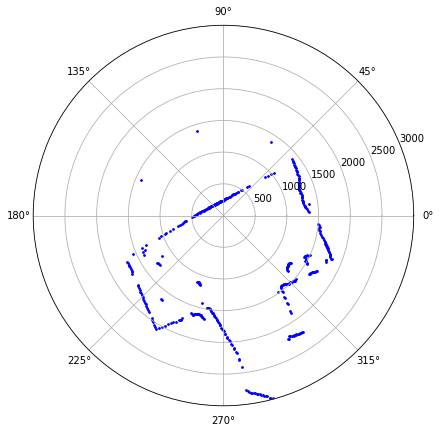

In [62]:
%matplotlib inline
import numpy as np
import matplotlib.pyplot as plt

fig = plt.figure(figsize=(9,7))
ax = plt.subplot(111, polar = True)
ax.scatter(phi, r, c = "blue", s = 3)
ax.set_rmax(3000)
fig.show()